In [1]:
import numpy as np
import pandas as pd
from scipy import io
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn import metrics
from sklearn import linear_model
from sklearn.preprocessing import normalize
from sklearn.preprocessing import minmax_scale
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from math import sqrt
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
from sklearn import svm
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import GridSearchCV
import h5py
%matplotlib inline

In [2]:
# DataFrame

total = 6044
TE_Anom_result = h5py.File("TE_analysis_results.mat")['Tcube_store'][0,:,:]
TE_Uncut_data = h5py.File("TE_analysis_data.mat")['dataMatUncut']
TE_Uncut_data_name = h5py.File("TE_analysis_results.mat")['labCell'][:]

In [3]:
TE_Anom_result.shape

(162, 1)

In [4]:
TE_Uncut_data = np.transpose(TE_Uncut_data)
TE_Uncut_data.shape

(6044, 164)

In [5]:
# number of variables and aggregation scales
numVars = 18
numAggr = 5

#TE_Uncut_data = TE_Uncut_data[:,:]

StreamFlow = TE_Uncut_data[:,1]
TE_Uncut_data = TE_Uncut_data[:,2:164]
TE_Uncut_data = np.concatenate((TE_Uncut_data[:,0::9], TE_Uncut_data[:,1::9], 
                                TE_Uncut_data[:,2::9], TE_Uncut_data[:,3::9],
                                TE_Uncut_data[:,4::9]), axis=1)
TE_Uncut_data_name = TE_Uncut_data_name[2:164].reshape(-1, 1)
TE_Uncut_data_name = np.concatenate((TE_Uncut_data_name[0::9], TE_Uncut_data_name[1::9],
                                     TE_Uncut_data_name[2::9], TE_Uncut_data_name[3::9],
                                     TE_Uncut_data_name[4::9]), axis=0)

TE_Anom_result = np.concatenate((TE_Anom_result[0::9,:], TE_Anom_result[1::9,:], 
                                 TE_Anom_result[2::9,:], TE_Anom_result[3::9,:],
                                 TE_Anom_result[4::9,:]), axis=0)
TE_Anom_result_max_lag = np.argmax(TE_Anom_result[:,:180], axis=1)
shift_lags = np.max(TE_Anom_result_max_lag)

In [6]:
TE_Uncut_data.shape

(6044, 90)

In [7]:
StreamFlow.shape

(6044,)

In [8]:
with open('labelCell.txt', 'r') as myfile:
    TE_Uncut_data_name=myfile.read().split('\t')
len(TE_Uncut_data_name)

164

In [9]:
colname = [name[0][0] for name in TE_Uncut_data_name]
colname_withlags = colname + ['Lagged ' + name for name in colname]
colname_withlags = colname_withlags[numVars*numAggr:]
colname_withlags

["'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "'",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '",
 "Lagged '

In [10]:
colname_withlags = TE_Uncut_data_name

In [11]:
# X
X_withlag = TE_Uncut_data[shift_lags:,:]

for i in range(TE_Uncut_data.shape[1]):
    X_withlag = np.concatenate((X_withlag, TE_Uncut_data[(shift_lags - TE_Anom_result_max_lag[i]):(total-TE_Anom_result_max_lag[i]), i].reshape(-1,1)), axis=1)
X_withlag = X_withlag[:,numVars*numAggr:]    

In [12]:
X_withlag.shape

(6044, 90)

In [13]:
# y
y = StreamFlow[shift_lags:]

In [14]:
y.shape

(6044,)

In [15]:
total_withlag = X_withlag.shape[0]

In [16]:
total_withlag

6044

In [17]:
# rescale data
X_withlag_scaled = minmax_scale(X_withlag, feature_range=(0, 1), axis=0, copy=True)

# separate train and test data
train_length = int(total_withlag * 0.8)
train_X = X_withlag_scaled[:train_length,:]
train_y = y[:train_length]
test_X = X_withlag_scaled[train_length:,:]
test_y = y[train_length:]
test_X.shape[1]

90

In [18]:
# define k-fold and number of parallel jobs
nFold = 5
nJobs = 1

In [19]:
# setup coarse parameter search (spaced at 0.5 log2 intervals)
C_list_coarse = list(np.logspace(-8, 4, num=25, endpoint=True, base=2.0, dtype=None))
E_list_coarse = list(np.logspace(-8, 4, num=25, endpoint=True, base=2.0, dtype=None))
G_list_coarse = list(np.logspace(-8, 4, num=25, endpoint=True, base=2.0, dtype=None))
TE_Anom_SVR = svm.SVR(kernel="rbf",max_iter=-1)
SVR_params = {'C':C_list_coarse, 'epsilon':E_list_coarse, 'gamma':G_list_coarse}# GridSearchCV(estimator, param_grid, scoring=None, fit_params=None, n_jobs=None, iid=’warn’, refit=True, cv=’warn’, verbose=0, pre_dispatch=‘2*n_jobs’, error_score=’raise-deprecating’, return_train_score=’warn’)
SVR_params

{'C': [0.00390625,
  0.005524271728019903,
  0.0078125,
  0.011048543456039806,
  0.015625,
  0.02209708691207961,
  0.03125,
  0.04419417382415922,
  0.0625,
  0.08838834764831845,
  0.125,
  0.1767766952966369,
  0.25,
  0.3535533905932738,
  0.5,
  0.7071067811865476,
  1.0,
  1.4142135623730951,
  2.0,
  2.8284271247461903,
  4.0,
  5.656854249492381,
  8.0,
  11.313708498984761,
  16.0],
 'epsilon': [0.00390625,
  0.005524271728019903,
  0.0078125,
  0.011048543456039806,
  0.015625,
  0.02209708691207961,
  0.03125,
  0.04419417382415922,
  0.0625,
  0.08838834764831845,
  0.125,
  0.1767766952966369,
  0.25,
  0.3535533905932738,
  0.5,
  0.7071067811865476,
  1.0,
  1.4142135623730951,
  2.0,
  2.8284271247461903,
  4.0,
  5.656854249492381,
  8.0,
  11.313708498984761,
  16.0],
 'gamma': [0.00390625,
  0.005524271728019903,
  0.0078125,
  0.011048543456039806,
  0.015625,
  0.02209708691207961,
  0.03125,
  0.04419417382415922,
  0.0625,
  0.08838834764831845,
  0.125,
  0.176

In [20]:
# do coarse parameter space search
# GridSearchCV(estimator, param_grid, scoring=None, fit_params=None, n_jobs=None, iid=’warn’, refit=True, cv=’warn’, verbose=0, pre_dispatch=‘2*n_jobs’, error_score=’raise-deprecating’, return_train_score=’warn’)
TE_Anom_SVR_coarse = GridSearchCV(TE_Anom_SVR, SVR_params, cv=nFold, n_jobs=nJobs, refit=True, verbose=3, return_train_score=True)
TE_Anom_SVR_coarse.fit(train_X, train_y)

Fitting 5 folds for each of 15625 candidates, totalling 78125 fits
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.00390625 ..............
[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.00390625, score=0.346851417025863, total=   1.4s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.00390625 ..............


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.4s remaining:    0.0s


[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.00390625, score=0.23381172604061043, total=   1.4s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.00390625 ..............


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    4.9s remaining:    0.0s


[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.00390625, score=0.4094270883744403, total=   1.4s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.00390625 ..............
[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.00390625, score=0.1454422892634959, total=   1.4s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.00390625 ..............
[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.00390625, score=0.4514531277662154, total=   1.5s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.005524271728019903 ....
[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.005524271728019903, score=0.3724934152065682, total=   1.4s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.005524271728019903 ....
[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.005524271728019903, score=0.26145509555398794, total=   1.5s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.005524271728019903 ....
[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.005524271728019903, score=0.43768398453021373, total=   1.4s
[CV] C=0.00390625, epsilo

[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.125, score=0.5747155752511245, total=   1.3s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.125 ...................
[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.125, score=0.4691144427264152, total=   1.2s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.125 ...................
[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.125, score=0.6543114326146288, total=   1.3s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.125 ...................
[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.125, score=0.49675659843805015, total=   1.2s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.125 ...................
[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.125, score=0.7211015833584933, total=   1.3s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.1767766952966369 ......
[CV]  C=0.00390625, epsilon=0.00390625, gamma=0.1767766952966369, score=0.5848442617084634, total=   1.2s
[CV] C=0.00390625, epsilon=0.00390625, gamma=0.1767766952966369 ......
[C

[CV]  C=0.00390625, epsilon=0.00390625, gamma=2.8284271247461903, score=0.3679913841543231, total=   1.2s
[CV] C=0.00390625, epsilon=0.00390625, gamma=4.0 .....................
[CV]  C=0.00390625, epsilon=0.00390625, gamma=4.0, score=0.133414918878348, total=   1.3s
[CV] C=0.00390625, epsilon=0.00390625, gamma=4.0 .....................
[CV]  C=0.00390625, epsilon=0.00390625, gamma=4.0, score=0.06706200801915552, total=   1.3s
[CV] C=0.00390625, epsilon=0.00390625, gamma=4.0 .....................
[CV]  C=0.00390625, epsilon=0.00390625, gamma=4.0, score=0.2520373498977585, total=   1.3s
[CV] C=0.00390625, epsilon=0.00390625, gamma=4.0 .....................
[CV]  C=0.00390625, epsilon=0.00390625, gamma=4.0, score=-0.07833508787032484, total=   1.2s
[CV] C=0.00390625, epsilon=0.00390625, gamma=4.0 .....................
[CV]  C=0.00390625, epsilon=0.00390625, gamma=4.0, score=0.27052761032096784, total=   1.3s
[CV] C=0.00390625, epsilon=0.00390625, gamma=5.656854249492381 .......
[CV]  C=0.

[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=0.015625, score=0.34436755342287506, total=   1.3s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=0.015625 ......
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=0.015625, score=0.5208031532825153, total=   1.2s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=0.015625 ......
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=0.015625, score=0.30158274514150707, total=   1.2s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=0.015625 ......
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=0.015625, score=0.572156581133622, total=   1.3s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.4827037021702931, total=   1.2s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.37504082

[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.45138073203758167, total=   1.0s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.6705844938675737, total=   1.1s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.5104823106039282, total=   1.0s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.7319717648510771, total=   1.1s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=0.5 ...........
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=0.5, score=0.5660069147344173, total=   1.0s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=0.5 ...........
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=0.5, score=

[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=8.0, score=-0.025008811814798193, total=   1.6s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=8.0 ...........
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=8.0, score=0.0758856724362843, total=   1.6s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=8.0 ...........
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=8.0, score=-0.24608541257128524, total=   1.5s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=8.0 ...........
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=8.0, score=0.11030704989397522, total=   1.7s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=11.313708498984761 
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=11.313708498984761, score=-0.04561177434120367, total=   1.6s
[CV] C=0.00390625, epsilon=0.005524271728019903, gamma=11.313708498984761 
[CV]  C=0.00390625, epsilon=0.005524271728019903, gamma=11.313708498984761, score=-0.055254388018249674, tota

[CV]  C=0.00390625, epsilon=0.0078125, gamma=0.03125, score=0.38382239526822626, total=   1.0s
[CV] C=0.00390625, epsilon=0.0078125, gamma=0.03125 ..................
[CV]  C=0.00390625, epsilon=0.0078125, gamma=0.03125, score=0.6408109423136457, total=   1.1s
[CV] C=0.00390625, epsilon=0.0078125, gamma=0.04419417382415922 ......
[CV]  C=0.00390625, epsilon=0.0078125, gamma=0.04419417382415922, score=0.5310525923733027, total=   1.1s
[CV] C=0.00390625, epsilon=0.0078125, gamma=0.04419417382415922 ......
[CV]  C=0.00390625, epsilon=0.0078125, gamma=0.04419417382415922, score=0.4290336761882544, total=   1.1s
[CV] C=0.00390625, epsilon=0.0078125, gamma=0.04419417382415922 ......
[CV]  C=0.00390625, epsilon=0.0078125, gamma=0.04419417382415922, score=0.6069162858067358, total=   1.0s
[CV] C=0.00390625, epsilon=0.0078125, gamma=0.04419417382415922 ......
[CV]  C=0.00390625, epsilon=0.0078125, gamma=0.04419417382415922, score=0.4214557948666052, total=   1.0s
[CV] C=0.00390625, epsilon=0.007

[CV]  C=0.00390625, epsilon=0.0078125, gamma=1.0, score=0.5778527597627068, total=   0.9s
[CV] C=0.00390625, epsilon=0.0078125, gamma=1.0 ......................
[CV]  C=0.00390625, epsilon=0.0078125, gamma=1.0, score=0.4023087967011951, total=   0.8s
[CV] C=0.00390625, epsilon=0.0078125, gamma=1.0 ......................
[CV]  C=0.00390625, epsilon=0.0078125, gamma=1.0, score=0.6343454093279193, total=   0.9s
[CV] C=0.00390625, epsilon=0.0078125, gamma=1.4142135623730951 .......
[CV]  C=0.00390625, epsilon=0.0078125, gamma=1.4142135623730951, score=0.4201571664701013, total=   0.9s
[CV] C=0.00390625, epsilon=0.0078125, gamma=1.4142135623730951 .......
[CV]  C=0.00390625, epsilon=0.0078125, gamma=1.4142135623730951, score=0.27605062410907166, total=   0.9s
[CV] C=0.00390625, epsilon=0.0078125, gamma=1.4142135623730951 .......
[CV]  C=0.00390625, epsilon=0.0078125, gamma=1.4142135623730951, score=0.5151655667273447, total=   0.9s
[CV] C=0.00390625, epsilon=0.0078125, gamma=1.4142135623730

[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=0.005524271728019903, score=0.2655009392699207, total=   1.1s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=0.005524271728019903 
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=0.005524271728019903, score=0.44350517245338483, total=   1.1s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=0.005524271728019903 
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=0.005524271728019903, score=0.20053027548121638, total=   1.1s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=0.005524271728019903 
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=0.005524271728019903, score=0.4830527290150367, total=   1.1s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=0.0078125 .....
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=0.0078125, score=0.401319434062955, total=   1.1s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=0.0078125 .....
[CV]  C=0.00390625, epsilon=0.01104854345603980

[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=0.125, score=0.4685734895635223, total=   0.9s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=0.125 .........
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=0.125, score=0.6575009748103491, total=   0.8s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=0.125 .........
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=0.125, score=0.4962082556195609, total=   0.8s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=0.125 .........
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=0.125, score=0.7221034165215072, total=   0.9s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=0.1767766952966369 
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.585858986814221, total=   0.8s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=0.1767766952966369 
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.46939244705761696, total= 

[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=2.8284271247461903, score=0.35429201461781534, total=   0.9s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=2.8284271247461903, score=0.05691101771293383, total=   0.8s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=2.8284271247461903, score=0.3695468478850139, total=   0.9s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=4.0 ...........
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=4.0, score=0.13698505723626175, total=   1.0s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=4.0 ...........
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=4.0, score=0.07396738732790664, total=   1.1s
[CV] C=0.00390625, epsilon=0.011048543456039806, gamma=4.0 ...........
[CV]  C=0.00390625, epsilon=0.011048543456039806, gamma=4.0, score=0.25945706667533

[CV]  C=0.00390625, epsilon=0.015625, gamma=0.011048543456039806, score=0.5418440892620229, total=   1.0s
[CV] C=0.00390625, epsilon=0.015625, gamma=0.015625 ..................
[CV]  C=0.00390625, epsilon=0.015625, gamma=0.015625, score=0.4583085759679252, total=   0.9s
[CV] C=0.00390625, epsilon=0.015625, gamma=0.015625 ..................
[CV]  C=0.00390625, epsilon=0.015625, gamma=0.015625, score=0.3459749157046422, total=   0.9s
[CV] C=0.00390625, epsilon=0.015625, gamma=0.015625 ..................
[CV]  C=0.00390625, epsilon=0.015625, gamma=0.015625, score=0.529963334103788, total=   0.9s
[CV] C=0.00390625, epsilon=0.015625, gamma=0.015625 ..................
[CV]  C=0.00390625, epsilon=0.015625, gamma=0.015625, score=0.31518338555930614, total=   0.9s
[CV] C=0.00390625, epsilon=0.015625, gamma=0.015625 ..................
[CV]  C=0.00390625, epsilon=0.015625, gamma=0.015625, score=0.5744924262600695, total=   1.0s
[CV] C=0.00390625, epsilon=0.015625, gamma=0.02209708691207961 ......

[CV]  C=0.00390625, epsilon=0.015625, gamma=0.3535533905932738, score=0.5150379823333484, total=   0.6s
[CV] C=0.00390625, epsilon=0.015625, gamma=0.3535533905932738 ........
[CV]  C=0.00390625, epsilon=0.015625, gamma=0.3535533905932738, score=0.7290990052439701, total=   0.7s
[CV] C=0.00390625, epsilon=0.015625, gamma=0.5 .......................
[CV]  C=0.00390625, epsilon=0.015625, gamma=0.5, score=0.5681805682293166, total=   0.7s
[CV] C=0.00390625, epsilon=0.015625, gamma=0.5 .......................
[CV]  C=0.00390625, epsilon=0.015625, gamma=0.5, score=0.4272458636961774, total=   0.7s
[CV] C=0.00390625, epsilon=0.015625, gamma=0.5 .......................
[CV]  C=0.00390625, epsilon=0.015625, gamma=0.5, score=0.6658966660120822, total=   0.7s
[CV] C=0.00390625, epsilon=0.015625, gamma=0.5 .......................
[CV]  C=0.00390625, epsilon=0.015625, gamma=0.5, score=0.5012681748708324, total=   0.6s
[CV] C=0.00390625, epsilon=0.015625, gamma=0.5 .......................
[CV]  C=0.

[CV]  C=0.00390625, epsilon=0.015625, gamma=11.313708498984761, score=0.038619474832896294, total=   1.5s
[CV] C=0.00390625, epsilon=0.015625, gamma=11.313708498984761 ........
[CV]  C=0.00390625, epsilon=0.015625, gamma=11.313708498984761, score=-0.26620120587240637, total=   1.4s
[CV] C=0.00390625, epsilon=0.015625, gamma=11.313708498984761 ........
[CV]  C=0.00390625, epsilon=0.015625, gamma=11.313708498984761, score=0.06855677239250746, total=   1.5s
[CV] C=0.00390625, epsilon=0.015625, gamma=16.0 ......................
[CV]  C=0.00390625, epsilon=0.015625, gamma=16.0, score=-0.056903572876286335, total=   1.4s
[CV] C=0.00390625, epsilon=0.015625, gamma=16.0 ......................
[CV]  C=0.00390625, epsilon=0.015625, gamma=16.0, score=-0.06197435926480055, total=   1.4s
[CV] C=0.00390625, epsilon=0.015625, gamma=16.0 ......................
[CV]  C=0.00390625, epsilon=0.015625, gamma=16.0, score=0.0019133225939920173, total=   1.4s
[CV] C=0.00390625, epsilon=0.015625, gamma=16.0 ..

[CV]  C=0.00390625, epsilon=0.02209708691207961, gamma=0.04419417382415922, score=0.43021091547673695, total=   0.7s
[CV] C=0.00390625, epsilon=0.02209708691207961, gamma=0.04419417382415922 
[CV]  C=0.00390625, epsilon=0.02209708691207961, gamma=0.04419417382415922, score=0.6588178492177351, total=   0.8s
[CV] C=0.00390625, epsilon=0.02209708691207961, gamma=0.0625 .........
[CV]  C=0.00390625, epsilon=0.02209708691207961, gamma=0.0625, score=0.5508155968101105, total=   0.6s
[CV] C=0.00390625, epsilon=0.02209708691207961, gamma=0.0625 .........
[CV]  C=0.00390625, epsilon=0.02209708691207961, gamma=0.0625, score=0.44614699596710977, total=   0.7s
[CV] C=0.00390625, epsilon=0.02209708691207961, gamma=0.0625 .........
[CV]  C=0.00390625, epsilon=0.02209708691207961, gamma=0.0625, score=0.6301043696276885, total=   0.7s
[CV] C=0.00390625, epsilon=0.02209708691207961, gamma=0.0625 .........
[CV]  C=0.00390625, epsilon=0.02209708691207961, gamma=0.0625, score=0.46239359465766483, total=  

[CV]  C=0.00390625, epsilon=0.02209708691207961, gamma=1.0, score=0.6315677873105945, total=   0.7s
[CV] C=0.00390625, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.00390625, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.41024576599307083, total=   0.6s
[CV] C=0.00390625, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.00390625, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.28388734494041523, total=   0.7s
[CV] C=0.00390625, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.00390625, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.5254944180227616, total=   0.7s
[CV] C=0.00390625, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.00390625, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.32529238831229823, total=   0.6s
[CV] C=0.00390625, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.00390625, epsilon=0.02209708691207961, gamma=1.4142135623

[CV]  C=0.00390625, epsilon=0.03125, gamma=0.005524271728019903, score=0.3921794376015097, total=   0.8s
[CV] C=0.00390625, epsilon=0.03125, gamma=0.005524271728019903 .......
[CV]  C=0.00390625, epsilon=0.03125, gamma=0.005524271728019903, score=0.277658539268821, total=   0.8s
[CV] C=0.00390625, epsilon=0.03125, gamma=0.005524271728019903 .......
[CV]  C=0.00390625, epsilon=0.03125, gamma=0.005524271728019903, score=0.4698420020516425, total=   0.8s
[CV] C=0.00390625, epsilon=0.03125, gamma=0.005524271728019903 .......
[CV]  C=0.00390625, epsilon=0.03125, gamma=0.005524271728019903, score=0.22067024131300672, total=   0.7s
[CV] C=0.00390625, epsilon=0.03125, gamma=0.005524271728019903 .......
[CV]  C=0.00390625, epsilon=0.03125, gamma=0.005524271728019903, score=0.4868488309287552, total=   0.9s
[CV] C=0.00390625, epsilon=0.03125, gamma=0.0078125 ..................
[CV]  C=0.00390625, epsilon=0.03125, gamma=0.0078125, score=0.42145120351982324, total=   0.8s
[CV] C=0.00390625, epsilo

[CV]  C=0.00390625, epsilon=0.03125, gamma=0.125, score=0.7057206253808759, total=   0.6s
[CV] C=0.00390625, epsilon=0.03125, gamma=0.1767766952966369 .........
[CV]  C=0.00390625, epsilon=0.03125, gamma=0.1767766952966369, score=0.5826837176492135, total=   0.5s
[CV] C=0.00390625, epsilon=0.03125, gamma=0.1767766952966369 .........
[CV]  C=0.00390625, epsilon=0.03125, gamma=0.1767766952966369, score=0.46447507766131396, total=   0.5s
[CV] C=0.00390625, epsilon=0.03125, gamma=0.1767766952966369 .........
[CV]  C=0.00390625, epsilon=0.03125, gamma=0.1767766952966369, score=0.6789707502876735, total=   0.6s
[CV] C=0.00390625, epsilon=0.03125, gamma=0.1767766952966369 .........
[CV]  C=0.00390625, epsilon=0.03125, gamma=0.1767766952966369, score=0.5214236625288311, total=   0.5s
[CV] C=0.00390625, epsilon=0.03125, gamma=0.1767766952966369 .........
[CV]  C=0.00390625, epsilon=0.03125, gamma=0.1767766952966369, score=0.7132776377837836, total=   0.6s
[CV] C=0.00390625, epsilon=0.03125, gam

[CV]  C=0.00390625, epsilon=0.03125, gamma=4.0, score=0.2580604459288167, total=   1.0s
[CV] C=0.00390625, epsilon=0.03125, gamma=5.656854249492381 ..........
[CV]  C=0.00390625, epsilon=0.03125, gamma=5.656854249492381, score=0.0730765828028771, total=   1.0s
[CV] C=0.00390625, epsilon=0.03125, gamma=5.656854249492381 ..........
[CV]  C=0.00390625, epsilon=0.03125, gamma=5.656854249492381, score=0.04413240319434841, total=   1.1s
[CV] C=0.00390625, epsilon=0.03125, gamma=5.656854249492381 ..........
[CV]  C=0.00390625, epsilon=0.03125, gamma=5.656854249492381, score=0.17720086313812566, total=   1.1s
[CV] C=0.00390625, epsilon=0.03125, gamma=5.656854249492381 ..........
[CV]  C=0.00390625, epsilon=0.03125, gamma=5.656854249492381, score=-0.10766566337098783, total=   1.0s
[CV] C=0.00390625, epsilon=0.03125, gamma=5.656854249492381 ..........
[CV]  C=0.00390625, epsilon=0.03125, gamma=5.656854249492381, score=0.17958492029705772, total=   1.2s
[CV] C=0.00390625, epsilon=0.03125, gamma=

[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.383937037741625, total=   0.6s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=0.02209708691207961 
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.5773191480709342, total=   0.6s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=0.02209708691207961 
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.38776253658555226, total=   0.5s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=0.02209708691207961 
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.5930126792908699, total=   0.6s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=0.03125 ........
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=0.03125, score=0.524622067785153, total=   0.5s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=0.03125 ........
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=0.03125, sc

[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=0.5, score=0.42735613956788837, total=   0.5s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=0.5 ............
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=0.5, score=0.6443861710750236, total=   0.5s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=0.5 ............
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=0.5, score=0.5067160949989719, total=   0.4s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=0.5 ............
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=0.5, score=0.6665997424375187, total=   0.5s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=0.7071067811865476 
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=0.7071067811865476, score=0.5108389112563776, total=   0.4s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=0.7071067811865476 
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=0.7071067811865476, score=0.3968662363065516, total=   0.5s
[CV] C=0

[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.0713528029947672, total=   1.1s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=11.313708498984761 
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=11.313708498984761, score=-0.1726717832637341, total=   1.1s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=11.313708498984761 
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.07269707863140895, total=   1.2s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=16.0 ...........
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=16.0, score=-0.010459801960503334, total=   1.1s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=16.0 ...........
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=16.0, score=-0.020531528237838215, total=   1.1s
[CV] C=0.00390625, epsilon=0.04419417382415922, gamma=16.0 ...........
[CV]  C=0.00390625, epsilon=0.04419417382415922, gamma=16.0, score=0.040164894810697

[CV]  C=0.00390625, epsilon=0.0625, gamma=0.0625, score=0.5277937875482305, total=   0.3s
[CV] C=0.00390625, epsilon=0.0625, gamma=0.0625 ......................
[CV]  C=0.00390625, epsilon=0.0625, gamma=0.0625, score=0.4305916543020008, total=   0.4s
[CV] C=0.00390625, epsilon=0.0625, gamma=0.0625 ......................
[CV]  C=0.00390625, epsilon=0.0625, gamma=0.0625, score=0.6120113897955886, total=   0.4s
[CV] C=0.00390625, epsilon=0.0625, gamma=0.0625 ......................
[CV]  C=0.00390625, epsilon=0.0625, gamma=0.0625, score=0.47281683969343224, total=   0.3s
[CV] C=0.00390625, epsilon=0.0625, gamma=0.0625 ......................
[CV]  C=0.00390625, epsilon=0.0625, gamma=0.0625, score=0.6019427038987379, total=   0.4s
[CV] C=0.00390625, epsilon=0.0625, gamma=0.08838834764831845 .........
[CV]  C=0.00390625, epsilon=0.0625, gamma=0.08838834764831845, score=0.5335200311659634, total=   0.3s
[CV] C=0.00390625, epsilon=0.0625, gamma=0.08838834764831845 .........
[CV]  C=0.00390625, 

[CV]  C=0.00390625, epsilon=0.0625, gamma=2.0, score=0.2696985797481972, total=   0.5s
[CV] C=0.00390625, epsilon=0.0625, gamma=2.0 .........................
[CV]  C=0.00390625, epsilon=0.0625, gamma=2.0, score=0.22537481534748194, total=   0.6s
[CV] C=0.00390625, epsilon=0.0625, gamma=2.0 .........................
[CV]  C=0.00390625, epsilon=0.0625, gamma=2.0, score=0.37791006065230537, total=   0.6s
[CV] C=0.00390625, epsilon=0.0625, gamma=2.0 .........................
[CV]  C=0.00390625, epsilon=0.0625, gamma=2.0, score=0.2288386708488166, total=   0.5s
[CV] C=0.00390625, epsilon=0.0625, gamma=2.0 .........................
[CV]  C=0.00390625, epsilon=0.0625, gamma=2.0, score=0.3419489892908256, total=   0.6s
[CV] C=0.00390625, epsilon=0.0625, gamma=2.8284271247461903 ..........
[CV]  C=0.00390625, epsilon=0.0625, gamma=2.8284271247461903, score=0.1864454086051329, total=   0.6s
[CV] C=0.00390625, epsilon=0.0625, gamma=2.8284271247461903 ..........
[CV]  C=0.00390625, epsilon=0.0625,

[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=0.0078125, score=0.32430876109252227, total=   0.5s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=0.011048543456039806 
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.3951080913655459, total=   0.4s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=0.011048543456039806 
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.31156454191188976, total=   0.4s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=0.011048543456039806 
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.4405982960807612, total=   0.4s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=0.011048543456039806 
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.3118982260724995, total=   0.4s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=0.011048543456039806 
[CV]  C=0.00390625, epsilon=0.08838834764831

[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=0.1767766952966369, score=0.4804023698852605, total=   0.3s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=0.25 ...........
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=0.25, score=0.44271198655830596, total=   0.2s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=0.25 ...........
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=0.25, score=0.39170514056496686, total=   0.3s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=0.25 ...........
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=0.25, score=0.529306304007154, total=   0.3s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=0.25 ...........
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=0.25, score=0.4932384490613484, total=   0.2s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=0.25 ...........
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=0.25, score=0.47266832366146616, total=   0.3s
[CV] C=0.00390625, epsi

[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=5.656854249492381, score=0.03767251152144835, total=   0.6s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=5.656854249492381 
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=5.656854249492381, score=0.06399795307691547, total=   0.6s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=5.656854249492381 
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=5.656854249492381, score=0.07491685983532659, total=   0.6s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=5.656854249492381 
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=5.656854249492381, score=-0.001596529161588256, total=   0.5s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=5.656854249492381 
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=5.656854249492381, score=-0.005433100301557081, total=   0.6s
[CV] C=0.00390625, epsilon=0.08838834764831845, gamma=8.0 ............
[CV]  C=0.00390625, epsilon=0.08838834764831845, gamma=8.0

[CV]  C=0.00390625, epsilon=0.125, gamma=0.02209708691207961, score=0.3330383480880541, total=   0.2s
[CV] C=0.00390625, epsilon=0.125, gamma=0.02209708691207961 ..........
[CV]  C=0.00390625, epsilon=0.125, gamma=0.02209708691207961, score=0.1042569865907561, total=   0.3s
[CV] C=0.00390625, epsilon=0.125, gamma=0.03125 ......................
[CV]  C=0.00390625, epsilon=0.125, gamma=0.03125, score=0.3109098746532635, total=   0.3s
[CV] C=0.00390625, epsilon=0.125, gamma=0.03125 ......................
[CV]  C=0.00390625, epsilon=0.125, gamma=0.03125, score=0.28315308344109036, total=   0.3s
[CV] C=0.00390625, epsilon=0.125, gamma=0.03125 ......................
[CV]  C=0.00390625, epsilon=0.125, gamma=0.03125, score=0.28397503441960326, total=   0.3s
[CV] C=0.00390625, epsilon=0.125, gamma=0.03125 ......................
[CV]  C=0.00390625, epsilon=0.125, gamma=0.03125, score=0.362590964378919, total=   0.2s
[CV] C=0.00390625, epsilon=0.125, gamma=0.03125 ......................
[CV]  C=0

[CV]  C=0.00390625, epsilon=0.125, gamma=0.7071067811865476, score=0.37588272354341556, total=   0.2s
[CV] C=0.00390625, epsilon=0.125, gamma=0.7071067811865476 ...........
[CV]  C=0.00390625, epsilon=0.125, gamma=0.7071067811865476, score=-0.009994762207861774, total=   0.2s
[CV] C=0.00390625, epsilon=0.125, gamma=1.0 ..........................
[CV]  C=0.00390625, epsilon=0.125, gamma=1.0, score=0.13299247013391113, total=   0.2s
[CV] C=0.00390625, epsilon=0.125, gamma=1.0 ..........................
[CV]  C=0.00390625, epsilon=0.125, gamma=1.0, score=0.21171338342700474, total=   0.2s
[CV] C=0.00390625, epsilon=0.125, gamma=1.0 ..........................
[CV]  C=0.00390625, epsilon=0.125, gamma=1.0, score=0.12709535819603057, total=   0.2s
[CV] C=0.00390625, epsilon=0.125, gamma=1.0 ..........................
[CV]  C=0.00390625, epsilon=0.125, gamma=1.0, score=0.33401350763075, total=   0.2s
[CV] C=0.00390625, epsilon=0.125, gamma=1.0 ..........................
[CV]  C=0.00390625, eps

[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=0.00390625, score=0.08718128486555654, total=   0.3s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=0.00390625 ......
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=0.00390625, score=-0.8519748553278335, total=   0.5s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=-0.21526920840570507, total=   0.4s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=-0.03320118658649451, total=   0.4s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=-0.5015166406938116, total=   0.5s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=0.005524

[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.24558748800265792, total=   0.1s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=0.08838834764831845 
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=-0.6489971474466371, total=   0.2s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=0.125 ...........
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=0.125, score=-0.13890799546814514, total=   0.2s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=0.125 ...........
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=0.125, score=0.052425163193014934, total=   0.1s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=0.125 ...........
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=0.125, score=-0.3130553982817361, total=   0.2s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=0.125 ...........
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=0.125, score=0.25568965584258685, total=   0.1s


[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=2.0, score=-0.9139145318018733, total=   0.2s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.3777009240960045, total=   0.2s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.09373913005055612, total=   0.2s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.6156600378354886, total=   0.2s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=0.04849362626645792, total=   0.2s
[CV] C=0.00390625, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=0.1767766952966369, gamma=2.8284271247461903, 

[CV]  C=0.00390625, epsilon=0.25, gamma=0.011048543456039806, score=-1.7443215912141063, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=0.011048543456039806 ..........
[CV]  C=0.00390625, epsilon=0.25, gamma=0.011048543456039806, score=-0.15627108560341618, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=0.011048543456039806 ..........
[CV]  C=0.00390625, epsilon=0.25, gamma=0.011048543456039806, score=-2.3860137341906977, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=0.015625 ......................
[CV]  C=0.00390625, epsilon=0.25, gamma=0.015625, score=-1.0410218711345256, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=0.015625 ......................
[CV]  C=0.00390625, epsilon=0.25, gamma=0.015625, score=-0.4831980180613651, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=0.015625 ......................
[CV]  C=0.00390625, epsilon=0.25, gamma=0.015625, score=-1.7153132403458842, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=0.015625 ..............

[CV]  C=0.00390625, epsilon=0.25, gamma=0.3535533905932738, score=-0.13464163578717359, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=0.3535533905932738 ............
[CV]  C=0.00390625, epsilon=0.25, gamma=0.3535533905932738, score=-2.4574819308803186, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=0.5 ...........................
[CV]  C=0.00390625, epsilon=0.25, gamma=0.5, score=-1.1546243121469812, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=0.5 ...........................
[CV]  C=0.00390625, epsilon=0.25, gamma=0.5, score=-0.488960471320359, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=0.5 ...........................
[CV]  C=0.00390625, epsilon=0.25, gamma=0.5, score=-1.7806906422350952, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=0.5 ...........................
[CV]  C=0.00390625, epsilon=0.25, gamma=0.5, score=-0.14108344135028084, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=0.5 ...........................
[CV]  C=0.00390625, epsilon

[CV]  C=0.00390625, epsilon=0.25, gamma=11.313708498984761, score=-0.1856947064644634, total=   0.1s
[CV] C=0.00390625, epsilon=0.25, gamma=11.313708498984761 ............
[CV]  C=0.00390625, epsilon=0.25, gamma=11.313708498984761, score=-2.2556119281061204, total=   0.2s
[CV] C=0.00390625, epsilon=0.25, gamma=16.0 ..........................
[CV]  C=0.00390625, epsilon=0.25, gamma=16.0, score=-1.0091635655956792, total=   0.2s
[CV] C=0.00390625, epsilon=0.25, gamma=16.0 ..........................
[CV]  C=0.00390625, epsilon=0.25, gamma=16.0, score=-0.47534060355154867, total=   0.2s
[CV] C=0.00390625, epsilon=0.25, gamma=16.0 ..........................
[CV]  C=0.00390625, epsilon=0.25, gamma=16.0, score=-1.700394766589055, total=   0.2s
[CV] C=0.00390625, epsilon=0.25, gamma=16.0 ..........................
[CV]  C=0.00390625, epsilon=0.25, gamma=16.0, score=-0.18017217377031414, total=   0.2s
[CV] C=0.00390625, epsilon=0.25, gamma=16.0 ..........................
[CV]  C=0.00390625, eps

[CV]  C=0.00390625, epsilon=0.3535533905932738, gamma=0.0625, score=-1.5500420218515876, total=   0.0s
[CV] C=0.00390625, epsilon=0.3535533905932738, gamma=0.0625 ..........
[CV]  C=0.00390625, epsilon=0.3535533905932738, gamma=0.0625, score=-4.623554492978016, total=   0.1s
[CV] C=0.00390625, epsilon=0.3535533905932738, gamma=0.0625 ..........
[CV]  C=0.00390625, epsilon=0.3535533905932738, gamma=0.0625, score=-0.9619373243526331, total=   0.0s
[CV] C=0.00390625, epsilon=0.3535533905932738, gamma=0.0625 ..........
[CV]  C=0.00390625, epsilon=0.3535533905932738, gamma=0.0625, score=-5.859051382916511, total=   0.1s
[CV] C=0.00390625, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=0.00390625, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-3.093137789800775, total=   0.1s
[CV] C=0.00390625, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=0.00390625, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-1.5703663805663215, total=   0.0

[CV]  C=0.00390625, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-5.838797095394317, total=   0.1s
[CV] C=0.00390625, epsilon=0.3535533905932738, gamma=2.0 .............
[CV]  C=0.00390625, epsilon=0.3535533905932738, gamma=2.0, score=-2.9777251647828513, total=   0.1s
[CV] C=0.00390625, epsilon=0.3535533905932738, gamma=2.0 .............
[CV]  C=0.00390625, epsilon=0.3535533905932738, gamma=2.0, score=-1.5218495434311432, total=   0.1s
[CV] C=0.00390625, epsilon=0.3535533905932738, gamma=2.0 .............
[CV]  C=0.00390625, epsilon=0.3535533905932738, gamma=2.0, score=-4.674529325818339, total=   0.1s
[CV] C=0.00390625, epsilon=0.3535533905932738, gamma=2.0 .............
[CV]  C=0.00390625, epsilon=0.3535533905932738, gamma=2.0, score=-0.9271884305940602, total=   0.0s
[CV] C=0.00390625, epsilon=0.3535533905932738, gamma=2.0 .............
[CV]  C=0.00390625, epsilon=0.3535533905932738, gamma=2.0, score=-5.807590438139392, total=   0.1s
[CV] C=0.00390625, epsilon=0.3535

[CV]  C=0.00390625, epsilon=0.5, gamma=0.011048543456039806, score=-6.840148377676369, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=0.011048543456039806 ...........
[CV]  C=0.00390625, epsilon=0.5, gamma=0.011048543456039806, score=-3.713445759895845, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=0.011048543456039806 ...........
[CV]  C=0.00390625, epsilon=0.5, gamma=0.011048543456039806, score=-10.523168196810618, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=0.011048543456039806 ...........
[CV]  C=0.00390625, epsilon=0.5, gamma=0.011048543456039806, score=-2.770781200768146, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=0.011048543456039806 ...........
[CV]  C=0.00390625, epsilon=0.5, gamma=0.011048543456039806, score=-12.709589111707322, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=0.015625 .......................
[CV]  C=0.00390625, epsilon=0.5, gamma=0.015625, score=-6.870262924429911, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=0.015625 ..

[CV]  C=0.00390625, epsilon=0.5, gamma=0.5, score=-7.1113283164785335, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=0.5 ............................
[CV]  C=0.00390625, epsilon=0.5, gamma=0.5, score=-3.7913346625369853, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=0.5 ............................
[CV]  C=0.00390625, epsilon=0.5, gamma=0.5, score=-10.828740051689552, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=0.5 ............................
[CV]  C=0.00390625, epsilon=0.5, gamma=0.5, score=-2.894315612637189, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=0.5 ............................
[CV]  C=0.00390625, epsilon=0.5, gamma=0.5, score=-13.066520874751776, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=0.7071067811865476 .............
[CV]  C=0.00390625, epsilon=0.5, gamma=0.7071067811865476, score=-7.049471274083609, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=0.7071067811865476 .............
[CV]  C=0.00390625, epsilon=0.5, gamma=0.7071067811

[CV]  C=0.00390625, epsilon=0.5, gamma=16.0, score=-10.484994394305085, total=   0.1s
[CV] C=0.00390625, epsilon=0.5, gamma=16.0 ...........................
[CV]  C=0.00390625, epsilon=0.5, gamma=16.0, score=-2.7266856228194305, total=   0.0s
[CV] C=0.00390625, epsilon=0.5, gamma=16.0 ...........................
[CV]  C=0.00390625, epsilon=0.5, gamma=16.0, score=-12.635186706306428, total=   0.1s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=0.00390625 ......
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=0.00390625, score=-15.500179527015424, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=0.00390625 ......
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=0.00390625, score=-8.772516972142181, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=0.00390625 ......
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=0.00390625, score=-23.629316520072063, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=0.00390625 ...

[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=0.08838834764831845, score=-7.293397017769574, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=0.08838834764831845 
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=0.08838834764831845, score=-28.182303401319924, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=0.125 ...........
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=0.125, score=-15.6884331174532, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=0.125 ...........
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=0.125, score=-8.861401544746162, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=0.125 ...........
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=0.125, score=-23.856382091931284, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=0.125 ...........
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=0.125, score=-7.315627041604956, total=   0.0s
[CV] C=

[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=2.8284271247461903, score=-15.584809637197088, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=2.8284271247461903, score=-8.802177412554844, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=2.8284271247461903, score=-23.76418176468757, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=2.8284271247461903, score=-7.213629660618145, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=2.8284271247461903, score=-28.09250980066818, total=   0.0s
[CV] C=0.00390625, epsilon=0.7071067811865476, gamma=4.0 .............
[CV]  C=0.00390625, epsilon=0.7071067811865476, gamma=4.0, score=-

[CV]  C=0.00390625, epsilon=1.0, gamma=0.08838834764831845, score=-26.971894732112133, total=   0.0s
[CV] C=0.00390625, epsilon=1.0, gamma=0.08838834764831845 ............
[CV]  C=0.00390625, epsilon=1.0, gamma=0.08838834764831845, score=-15.418015457683484, total=   0.0s
[CV] C=0.00390625, epsilon=1.0, gamma=0.08838834764831845 ............
[CV]  C=0.00390625, epsilon=1.0, gamma=0.08838834764831845, score=-40.62927815973975, total=   0.0s
[CV] C=0.00390625, epsilon=1.0, gamma=0.08838834764831845 ............
[CV]  C=0.00390625, epsilon=1.0, gamma=0.08838834764831845, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=1.0, gamma=0.08838834764831845 ............
[CV]  C=0.00390625, epsilon=1.0, gamma=0.08838834764831845, score=-47.578552415512235, total=   0.0s
[CV] C=0.00390625, epsilon=1.0, gamma=0.125 ..........................
[CV]  C=0.00390625, epsilon=1.0, gamma=0.125, score=-26.971894732112133, total=   0.0s
[CV] C=0.00390625, epsilon=1.0, gamma=0.125 ..........

[CV]  C=0.00390625, epsilon=1.0, gamma=11.313708498984761, score=-15.418015457683484, total=   0.0s
[CV] C=0.00390625, epsilon=1.0, gamma=11.313708498984761 .............
[CV]  C=0.00390625, epsilon=1.0, gamma=11.313708498984761, score=-40.62927815973975, total=   0.0s
[CV] C=0.00390625, epsilon=1.0, gamma=11.313708498984761 .............
[CV]  C=0.00390625, epsilon=1.0, gamma=11.313708498984761, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=1.0, gamma=11.313708498984761 .............
[CV]  C=0.00390625, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=0.00390625, epsilon=1.0, gamma=16.0 ...........................
[CV]  C=0.00390625, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.00390625, epsilon=1.0, gamma=16.0 ...........................
[CV]  C=0.00390625, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.00390625, epsilon=1.0, gamma=16.0 ...........................
[CV

[CV]  C=0.00390625, epsilon=1.4142135623730951, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=0.00390625, epsilon=1.4142135623730951, gamma=0.25 ............
[CV]  C=0.00390625, epsilon=1.4142135623730951, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=1.4142135623730951, gamma=0.25 ............
[CV]  C=0.00390625, epsilon=1.4142135623730951, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=0.00390625, epsilon=1.4142135623730951, gamma=0.3535533905932738 
[CV]  C=0.00390625, epsilon=1.4142135623730951, gamma=0.3535533905932738, score=-26.971894732112133, total=   0.0s
[CV] C=0.00390625, epsilon=1.4142135623730951, gamma=0.3535533905932738 
[CV]  C=0.00390625, epsilon=1.4142135623730951, gamma=0.3535533905932738, score=-15.418015457683484, total=   0.0s
[CV] C=0.00390625, epsilon=1.4142135623730951, gamma=0.3535533905932738 
[CV]  C=0.00390625, epsilon=1.4142135623730951, gamma=0.3535533905932738, score=-40.62927815973975, total= 

[CV]  C=0.00390625, epsilon=2.0, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=2.0, gamma=0.005524271728019903 ...........
[CV]  C=0.00390625, epsilon=2.0, gamma=0.005524271728019903, score=-47.578552415512235, total=   0.0s
[CV] C=0.00390625, epsilon=2.0, gamma=0.0078125 ......................
[CV]  C=0.00390625, epsilon=2.0, gamma=0.0078125, score=-26.971894732112133, total=   0.0s
[CV] C=0.00390625, epsilon=2.0, gamma=0.0078125 ......................
[CV]  C=0.00390625, epsilon=2.0, gamma=0.0078125, score=-15.418015457683484, total=   0.0s
[CV] C=0.00390625, epsilon=2.0, gamma=0.0078125 ......................
[CV]  C=0.00390625, epsilon=2.0, gamma=0.0078125, score=-40.62927815973975, total=   0.0s
[CV] C=0.00390625, epsilon=2.0, gamma=0.0078125 ......................
[CV]  C=0.00390625, epsilon=2.0, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=2.0, gamma=0.0078125 ......................
[CV]  C

[CV]  C=0.00390625, epsilon=2.0, gamma=1.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.00390625, epsilon=2.0, gamma=1.0 ............................
[CV]  C=0.00390625, epsilon=2.0, gamma=1.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.00390625, epsilon=2.0, gamma=1.0 ............................
[CV]  C=0.00390625, epsilon=2.0, gamma=1.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.00390625, epsilon=2.0, gamma=1.0 ............................
[CV]  C=0.00390625, epsilon=2.0, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=2.0, gamma=1.0 ............................
[CV]  C=0.00390625, epsilon=2.0, gamma=1.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.00390625, epsilon=2.0, gamma=1.4142135623730951 .............
[CV]  C=0.00390625, epsilon=2.0, gamma=1.4142135623730951, score=-26.971894732112133, total=   0.0s
[CV] C=0.00390625, epsilon=2.0, gamma=1.4142135623730951 .............
[CV]  C=0.00390625, epsilon=2.0, gamma=1.414213562

[CV]  C=0.00390625, epsilon=2.8284271247461903, gamma=0.015625, score=-47.578552415512235, total=   0.0s
[CV] C=0.00390625, epsilon=2.8284271247461903, gamma=0.02209708691207961 
[CV]  C=0.00390625, epsilon=2.8284271247461903, gamma=0.02209708691207961, score=-26.971894732112133, total=   0.0s
[CV] C=0.00390625, epsilon=2.8284271247461903, gamma=0.02209708691207961 
[CV]  C=0.00390625, epsilon=2.8284271247461903, gamma=0.02209708691207961, score=-15.418015457683484, total=   0.0s
[CV] C=0.00390625, epsilon=2.8284271247461903, gamma=0.02209708691207961 
[CV]  C=0.00390625, epsilon=2.8284271247461903, gamma=0.02209708691207961, score=-40.62927815973975, total=   0.0s
[CV] C=0.00390625, epsilon=2.8284271247461903, gamma=0.02209708691207961 
[CV]  C=0.00390625, epsilon=2.8284271247461903, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=2.8284271247461903, gamma=0.02209708691207961 
[CV]  C=0.00390625, epsilon=2.8284271247461903, gamma=0.022097

[CV]  C=0.00390625, epsilon=2.8284271247461903, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=2.8284271247461903, gamma=2.0 .............
[CV]  C=0.00390625, epsilon=2.8284271247461903, gamma=2.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.00390625, epsilon=2.8284271247461903, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=2.8284271247461903, gamma=2.8284271247461903, score=-26.971894732112133, total=   0.0s
[CV] C=0.00390625, epsilon=2.8284271247461903, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=2.8284271247461903, gamma=2.8284271247461903, score=-15.418015457683484, total=   0.0s
[CV] C=0.00390625, epsilon=2.8284271247461903, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=2.8284271247461903, gamma=2.8284271247461903, score=-40.62927815973975, total=   0.0s
[CV] C=0.00390625, epsilon=2.8284271247461903, gamma=2.8284271247461903 
[CV]  C=0.00390625, epsilon=2.8284271247461903, gamma=2.8284271247461903, score=-12.806349571

[CV]  C=0.00390625, epsilon=4.0, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=0.00390625, epsilon=4.0, gamma=0.04419417382415922 ............
[CV]  C=0.00390625, epsilon=4.0, gamma=0.04419417382415922, score=-40.629278159739734, total=   0.0s
[CV] C=0.00390625, epsilon=4.0, gamma=0.04419417382415922 ............
[CV]  C=0.00390625, epsilon=4.0, gamma=0.04419417382415922, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=4.0, gamma=0.04419417382415922 ............
[CV]  C=0.00390625, epsilon=4.0, gamma=0.04419417382415922, score=-47.57855241551223, total=   0.0s
[CV] C=0.00390625, epsilon=4.0, gamma=0.0625 .........................
[CV]  C=0.00390625, epsilon=4.0, gamma=0.0625, score=-26.971894732112126, total=   0.0s
[CV] C=0.00390625, epsilon=4.0, gamma=0.0625 .........................
[CV]  C=0.00390625, epsilon=4.0, gamma=0.0625, score=-15.418015457683481, total=   0.0s
[CV] C=0.00390625, epsilon=4.0, gamma=0.0625 .....................

[CV]  C=0.00390625, epsilon=4.0, gamma=4.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.00390625, epsilon=4.0, gamma=5.656854249492381 ..............
[CV]  C=0.00390625, epsilon=4.0, gamma=5.656854249492381, score=-26.971894732112126, total=   0.0s
[CV] C=0.00390625, epsilon=4.0, gamma=5.656854249492381 ..............
[CV]  C=0.00390625, epsilon=4.0, gamma=5.656854249492381, score=-15.418015457683481, total=   0.0s
[CV] C=0.00390625, epsilon=4.0, gamma=5.656854249492381 ..............
[CV]  C=0.00390625, epsilon=4.0, gamma=5.656854249492381, score=-40.629278159739734, total=   0.0s
[CV] C=0.00390625, epsilon=4.0, gamma=5.656854249492381 ..............
[CV]  C=0.00390625, epsilon=4.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=4.0, gamma=5.656854249492381 ..............
[CV]  C=0.00390625, epsilon=4.0, gamma=5.656854249492381, score=-47.57855241551223, total=   0.0s
[CV] C=0.00390625, epsilon=4.0, gamma=8.0 .........................

[CV]  C=0.00390625, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-40.629278159739734, total=   0.0s
[CV] C=0.00390625, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.00390625, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.00390625, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-47.57855241551223, total=   0.0s
[CV] C=0.00390625, epsilon=5.656854249492381, gamma=0.125 ............
[CV]  C=0.00390625, epsilon=5.656854249492381, gamma=0.125, score=-26.971894732112126, total=   0.0s
[CV] C=0.00390625, epsilon=5.656854249492381, gamma=0.125 ............
[CV]  C=0.00390625, epsilon=5.656854249492381, gamma=0.125, score=-15.418015457683481, total=   0.0s
[CV] C=0.00390625, epsilon=5.656854249492381, gamma=0.125 ............
[CV]  C=0.00390625, epsilon=5.656854249492381, gamma=0.125, score=-40.629278159739734, total=  

[CV]  C=0.00390625, epsilon=5.656854249492381, gamma=11.313708498984761, score=-40.629278159739734, total=   0.0s
[CV] C=0.00390625, epsilon=5.656854249492381, gamma=11.313708498984761 
[CV]  C=0.00390625, epsilon=5.656854249492381, gamma=11.313708498984761, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=5.656854249492381, gamma=11.313708498984761 
[CV]  C=0.00390625, epsilon=5.656854249492381, gamma=11.313708498984761, score=-47.57855241551223, total=   0.0s
[CV] C=0.00390625, epsilon=5.656854249492381, gamma=16.0 .............
[CV]  C=0.00390625, epsilon=5.656854249492381, gamma=16.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.00390625, epsilon=5.656854249492381, gamma=16.0 .............
[CV]  C=0.00390625, epsilon=5.656854249492381, gamma=16.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.00390625, epsilon=5.656854249492381, gamma=16.0 .............
[CV]  C=0.00390625, epsilon=5.656854249492381, gamma=16.0, score=-40.629278159739734, total=   0.0s
[C

[CV]  C=0.00390625, epsilon=8.0, gamma=0.25, score=-26.971894732112126, total=   0.0s
[CV] C=0.00390625, epsilon=8.0, gamma=0.25 ...........................
[CV]  C=0.00390625, epsilon=8.0, gamma=0.25, score=-15.418015457683481, total=   0.0s
[CV] C=0.00390625, epsilon=8.0, gamma=0.25 ...........................
[CV]  C=0.00390625, epsilon=8.0, gamma=0.25, score=-40.629278159739734, total=   0.0s
[CV] C=0.00390625, epsilon=8.0, gamma=0.25 ...........................
[CV]  C=0.00390625, epsilon=8.0, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=0.00390625, epsilon=8.0, gamma=0.25 ...........................
[CV]  C=0.00390625, epsilon=8.0, gamma=0.25, score=-47.57855241551223, total=   0.0s
[CV] C=0.00390625, epsilon=8.0, gamma=0.3535533905932738 .............
[CV]  C=0.00390625, epsilon=8.0, gamma=0.3535533905932738, score=-26.971894732112126, total=   0.0s
[CV] C=0.00390625, epsilon=8.0, gamma=0.3535533905932738 .............
[CV]  C=0.00390625, epsilon=8.0, gamma=0.3535

[CV]  C=0.00390625, epsilon=11.313708498984761, gamma=0.00390625, score=-12.806349571021057, total=   0.0s
[CV] C=0.00390625, epsilon=11.313708498984761, gamma=0.00390625 ......
[CV]  C=0.00390625, epsilon=11.313708498984761, gamma=0.00390625, score=-47.57855241551223, total=   0.0s
[CV] C=0.00390625, epsilon=11.313708498984761, gamma=0.005524271728019903 
[CV]  C=0.00390625, epsilon=11.313708498984761, gamma=0.005524271728019903, score=-26.971894732112126, total=   0.0s
[CV] C=0.00390625, epsilon=11.313708498984761, gamma=0.005524271728019903 
[CV]  C=0.00390625, epsilon=11.313708498984761, gamma=0.005524271728019903, score=-15.418015457683481, total=   0.0s
[CV] C=0.00390625, epsilon=11.313708498984761, gamma=0.005524271728019903 
[CV]  C=0.00390625, epsilon=11.313708498984761, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=0.00390625, epsilon=11.313708498984761, gamma=0.005524271728019903 
[CV]  C=0.00390625, epsilon=11.313708498984761, gamma=0.005524271

[CV]  C=0.00390625, epsilon=11.313708498984761, gamma=0.5, score=-12.806349571021057, total=   0.0s
[CV] C=0.00390625, epsilon=11.313708498984761, gamma=0.5 .............
[CV]  C=0.00390625, epsilon=11.313708498984761, gamma=0.5, score=-47.57855241551223, total=   0.0s
[CV] C=0.00390625, epsilon=11.313708498984761, gamma=0.7071067811865476 
[CV]  C=0.00390625, epsilon=11.313708498984761, gamma=0.7071067811865476, score=-26.971894732112126, total=   0.0s
[CV] C=0.00390625, epsilon=11.313708498984761, gamma=0.7071067811865476 
[CV]  C=0.00390625, epsilon=11.313708498984761, gamma=0.7071067811865476, score=-15.418015457683481, total=   0.0s
[CV] C=0.00390625, epsilon=11.313708498984761, gamma=0.7071067811865476 
[CV]  C=0.00390625, epsilon=11.313708498984761, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=0.00390625, epsilon=11.313708498984761, gamma=0.7071067811865476 
[CV]  C=0.00390625, epsilon=11.313708498984761, gamma=0.7071067811865476, score=-12.806349571

[CV]  C=0.00390625, epsilon=16.0, gamma=0.011048543456039806, score=-12.806349571021089, total=   0.0s
[CV] C=0.00390625, epsilon=16.0, gamma=0.011048543456039806 ..........
[CV]  C=0.00390625, epsilon=16.0, gamma=0.011048543456039806, score=-47.57855241551223, total=   0.0s
[CV] C=0.00390625, epsilon=16.0, gamma=0.015625 ......................
[CV]  C=0.00390625, epsilon=16.0, gamma=0.015625, score=-26.971894732112126, total=   0.0s
[CV] C=0.00390625, epsilon=16.0, gamma=0.015625 ......................
[CV]  C=0.00390625, epsilon=16.0, gamma=0.015625, score=-15.418015457683481, total=   0.0s
[CV] C=0.00390625, epsilon=16.0, gamma=0.015625 ......................
[CV]  C=0.00390625, epsilon=16.0, gamma=0.015625, score=-40.629278159739734, total=   0.0s
[CV] C=0.00390625, epsilon=16.0, gamma=0.015625 ......................
[CV]  C=0.00390625, epsilon=16.0, gamma=0.015625, score=-12.806349571021089, total=   0.0s
[CV] C=0.00390625, epsilon=16.0, gamma=0.015625 ......................
[CV] 

[CV]  C=0.00390625, epsilon=16.0, gamma=1.4142135623730951, score=-12.806349571021089, total=   0.0s
[CV] C=0.00390625, epsilon=16.0, gamma=1.4142135623730951 ............
[CV]  C=0.00390625, epsilon=16.0, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=0.00390625, epsilon=16.0, gamma=2.0 ...........................
[CV]  C=0.00390625, epsilon=16.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.00390625, epsilon=16.0, gamma=2.0 ...........................
[CV]  C=0.00390625, epsilon=16.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.00390625, epsilon=16.0, gamma=2.0 ...........................
[CV]  C=0.00390625, epsilon=16.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.00390625, epsilon=16.0, gamma=2.0 ...........................
[CV]  C=0.00390625, epsilon=16.0, gamma=2.0, score=-12.806349571021089, total=   0.0s
[CV] C=0.00390625, epsilon=16.0, gamma=2.0 ...........................
[CV]  C=0.00390625, epsilon=1

[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=0.0078125, score=0.48587856523094064, total=   1.4s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=0.0078125 .....
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=0.0078125, score=0.2579053731520289, total=   1.3s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=0.0078125 .....
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=0.0078125, score=0.5314878907635785, total=   1.4s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=0.011048543456039806 
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=0.011048543456039806, score=0.44681698525592484, total=   1.3s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=0.011048543456039806 
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=0.011048543456039806, score=0.3406248765292751, total=   1.4s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=0.011048543456039806 
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=0.0110485434

[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=0.1767766952966369, score=0.6872606898824458, total=   1.1s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=0.1767766952966369 
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=0.1767766952966369, score=0.54514752323603, total=   1.1s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=0.1767766952966369 
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=0.1767766952966369, score=0.7557033073833852, total=   1.2s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=0.25 ..........
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=0.25, score=0.6020213013058627, total=   1.2s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=0.25 ..........
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=0.25, score=0.4820736210933064, total=   1.1s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=0.25 ..........
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=0.25, score=0.6974426203957937,

[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=4.0, score=-0.02208738776562269, total=   1.1s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=4.0 ...........
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=4.0, score=0.3071908445570562, total=   1.3s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=5.656854249492381 
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=5.656854249492381, score=0.08119694111642362, total=   1.4s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=5.656854249492381 
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=5.656854249492381, score=0.03699776022332746, total=   1.4s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=5.656854249492381 
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=5.656854249492381, score=0.19495305418061415, total=   1.4s
[CV] C=0.005524271728019903, epsilon=0.00390625, gamma=5.656854249492381 
[CV]  C=0.005524271728019903, epsilon=0.00390625, gamma=5.656854249492381, score=

[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.015625, score=0.3719770130875988, total=   1.3s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.015625 
[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.015625, score=0.5431241624747922, total=   1.3s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.015625 
[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.015625, score=0.33510110618248423, total=   1.2s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.015625 
[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.015625, score=0.6029317317962773, total=   1.3s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.5039937253726903, total=   1.2s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.0

[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.25, score=0.5505921713214689, total=   1.1s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.25 
[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.25, score=0.7588425411001282, total=   1.3s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.6001526517662964, total=   1.2s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.4727194965206311, total=   1.2s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.6998324743862738, total=   1.2s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=0.35355

[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=5.656854249492381, score=0.08222374844588776, total=   1.7s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=5.656854249492381 
[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=5.656854249492381, score=0.03882696597528523, total=   1.7s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=5.656854249492381 
[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=5.656854249492381, score=0.19728681112234703, total=   1.7s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=5.656854249492381 
[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=5.656854249492381, score=-0.12810559035307656, total=   1.5s
[CV] C=0.005524271728019903, epsilon=0.005524271728019903, gamma=5.656854249492381 
[CV]  C=0.005524271728019903, epsilon=0.005524271728019903, gamma=5.656854249492381, score=0.2139023771738442, total=   1.7s
[CV] C=0.005524271728019903, epsil

[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=0.015625, score=0.6021949050281812, total=   1.4s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=0.02209708691207961, score=0.5031914308702121, total=   1.3s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=0.02209708691207961, score=0.4029632704056313, total=   1.3s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=0.02209708691207961, score=0.573428410309611, total=   1.2s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=0.02209708691207961, score=0.37982342017523407, total=   1.1s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=0

[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=0.3535533905932738, score=0.7566038584339568, total=   1.0s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=0.5 ............
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=0.5, score=0.5872791860701829, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=0.5 ............
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=0.5, score=0.4514055101058335, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=0.5 ............
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=0.5, score=0.6864434463961238, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=0.5 ............
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=0.5, score=0.5373175506960606, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=0.5 ............
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=0.5, score=0.7431708609904739, total=   0.9s
[CV] C=0.005524271728019903, e

[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=11.313708498984761, score=-0.022801717692898963, total=   1.6s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=11.313708498984761, score=-0.0352446301951419, total=   1.6s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=11.313708498984761, score=0.049190088828408585, total=   1.6s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=11.313708498984761, score=-0.2629864592310269, total=   1.5s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.0078125, gamma=11.313708498984761, score=0.08113345750481216, total=   1.6s
[CV] C=0.005524271728019903, epsilon=0.0078125, gamma=16.0 ...........
[CV]  C=0.005524271728019903, epsilon=0.0078125, g

[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.03125, score=0.6025252116408484, total=   1.0s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.03125, score=0.4192321020738186, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.03125, score=0.663089293598659, total=   1.0s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.04419417382415922 
[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.04419417382415922, score=0.5496846303873901, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.04419417382415922 
[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.04419417382415922, score=0.45161931033438335, total=   1.0s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.04419417382415

[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.5, score=0.7430210021977519, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.5605958418038242, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.4200508248304811, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.66577817871596, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.5089993038596742, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.01104854

[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=11.313708498984761, score=-0.031105070607138297, total=   1.4s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.05464976753411788, total=   1.4s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=11.313708498984761, score=-0.2530615974454322, total=   1.4s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.08401889412227748, total=   1.5s
[CV] C=0.005524271728019903, epsilon=0.011048543456039806, gamma=16.0 
[CV]  C=0.005524271728019903, epsilon=0.011048543456039806, gamma=16.0, score=-0.05067222478524602, total=   1.4s
[CV] C=0.005524271728019903, epsilon=0.01104854345

[CV]  C=0.005524271728019903, epsilon=0.015625, gamma=0.04419417382415922, score=0.4504865980836229, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=0.005524271728019903, epsilon=0.015625, gamma=0.04419417382415922, score=0.6264886920359076, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=0.005524271728019903, epsilon=0.015625, gamma=0.04419417382415922, score=0.4613647829090286, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=0.005524271728019903, epsilon=0.015625, gamma=0.04419417382415922, score=0.6862401515627218, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.015625, gamma=0.0625 ..........
[CV]  C=0.005524271728019903, epsilon=0.015625, gamma=0.0625, score=0.5668761847299384, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.015625, gamma=0.0625 ..........
[CV]  C=0.005524271728019903, epsilon=0.015625, gamma=0.0625, score=0.4688

[CV]  C=0.005524271728019903, epsilon=0.015625, gamma=1.0, score=0.6252909214811526, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.015625, gamma=1.0 .............
[CV]  C=0.005524271728019903, epsilon=0.015625, gamma=1.0, score=0.46540682225838637, total=   0.6s
[CV] C=0.005524271728019903, epsilon=0.015625, gamma=1.0 .............
[CV]  C=0.005524271728019903, epsilon=0.015625, gamma=1.0, score=0.6716245358791996, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.015625, gamma=1.4142135623730951 
[CV]  C=0.005524271728019903, epsilon=0.015625, gamma=1.4142135623730951, score=0.44286523335377365, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.015625, gamma=1.4142135623730951 
[CV]  C=0.005524271728019903, epsilon=0.015625, gamma=1.4142135623730951, score=0.3143434579900187, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.015625, gamma=1.4142135623730951 
[CV]  C=0.005524271728019903, epsilon=0.015625, gamma=1.4142135623730951, score=0.5664689672953087, total=   0.7

[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.00390625, score=0.2119671033483076, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.00390625, score=0.48701276215391565, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.40957864369107494, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.2961583525874162, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.48438241771518686, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.022097086

[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.0625, score=0.7080165051883521, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.5812410180125763, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.47939274351897565, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.668462603222709, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.5162527518379523, total=   0.6s
[CV] C=0.005524271728019903, epsilon=0.0220

[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.319854603903834, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.5675977468007265, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.38828881865113996, total=   0.6s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.5961102413037762, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=2.0 ..
[CV]  C=0.005524271728019903, epsilon=0.02209708691207961, gamma=2.0, score=0.3502629008706519, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.02209708691207961, gamma=2.0

[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=0.00390625, score=0.4873719306172162, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=0.005524271728019903, score=0.4208213836568726, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=0.005524271728019903, score=0.30395285580818665, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=0.005524271728019903, score=0.4976441751639964, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=0.005524271728019903, score=0.26314588078751056, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=0.00552427

[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=0.125, score=0.5907515052065933, total=   0.6s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=0.125 ............
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=0.125, score=0.48350982893750644, total=   0.6s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=0.125 ............
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=0.125, score=0.6895799361914384, total=   0.6s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=0.125 ............
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=0.125, score=0.5419181842769604, total=   0.6s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=0.125 ............
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=0.125, score=0.7299483755056126, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=0.1767766952966369 
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=0.1767766952966369, score=0.5970967118885286, total=   0.5s
[CV] C=0.005524271728019903, e

[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=2.8284271247461903, score=0.39554486057145855, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=2.8284271247461903, score=0.1474064484751676, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=2.8284271247461903, score=0.3828261918878886, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=4.0 ..............
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=4.0, score=0.16344336096715806, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=4.0 ..............
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=4.0, score=0.11922346963532794, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.03125, gamma=4.0 ..............
[CV]  C=0.005524271728019903, epsilon=0.03125, gamma=4.0, score=0.3014980313172815, total=   0.9s
[CV] C=

[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.5530438873050624, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.35398658609163813, total=   0.6s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.5688142012599169, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.015625, score=0.5018395801390383, total=   0.6s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.015625, score=0.38256019477441805, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.0

[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.7166330243291426, total=   0.5s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.25 .
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.25, score=0.5776242380938856, total=   0.4s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.25 .
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.25, score=0.4731246715707036, total=   0.4s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.25 .
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.25, score=0.6980370559380982, total=   0.5s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.25 .
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.25, score=0.5589527543706041, total=   0.4s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.25 .
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=0.25, score

[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=4.0, score=0.28565391428150655, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=4.0 ..
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=4.0, score=0.04570866037812926, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=4.0 ..
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=4.0, score=0.2550193444388761, total=   0.9s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.0921049759754158, total=   1.0s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=0.005524271728019903, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.07441526902492257, total=   1.1s
[CV] C=0.005524271728019903, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=0.005524271728019903

[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=0.015625, score=0.38497285240621093, total=   0.5s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=0.015625 ..........
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=0.015625, score=0.5777435334955947, total=   0.5s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=0.015625 ..........
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=0.015625, score=0.3987470026842912, total=   0.4s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=0.015625 ..........
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=0.015625, score=0.5672084115138152, total=   0.5s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=0.02209708691207961, score=0.5295636944411379, total=   0.4s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=0.02209708691207961, score=0.40785533447021827, total=   0.4s
[CV] C=

[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=0.3535533905932738, score=0.5473553606379937, total=   0.4s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=0.3535533905932738 
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=0.3535533905932738, score=0.6403809741456854, total=   0.5s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=0.5 ...............
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=0.5, score=0.5093074599256354, total=   0.4s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=0.5 ...............
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=0.5, score=0.43049214693504206, total=   0.4s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=0.5 ...............
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=0.5, score=0.6297705109527167, total=   0.5s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=0.5 ...............
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=0.5, score=0.5335911508533495, total=   0.4s
[CV] C=0.005524271728019903, eps

[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=11.313708498984761, score=0.02467730876390961, total=   1.1s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=11.313708498984761, score=0.024960705493447533, total=   1.1s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=11.313708498984761, score=0.07590861959724149, total=   1.1s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=11.313708498984761, score=-0.1047813388744998, total=   1.1s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=11.313708498984761, score=0.044662105471963365, total=   1.2s
[CV] C=0.005524271728019903, epsilon=0.0625, gamma=16.0 ..............
[CV]  C=0.005524271728019903, epsilon=0.0625, gamma=16.0, score=0.010334033611

[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.03125, score=0.56157461022862, total=   0.4s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.03125, score=0.44485508244099964, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.03125, score=0.5367980617280393, total=   0.4s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.5023610585474647, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.4131425290368964, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  

[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.5, score=0.4409827567615948, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.38266531809160337, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.358200752819127, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.4801320141913885, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.4796733397582494, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.088388347648318

[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.03159040795492474, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.019733666540098227, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.05109913885136419, total=   0.6s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.050085346927622565, total=   0.8s
[CV] C=0.005524271728019903, epsilon=0.08838834764831845, gamma=16.0 .
[CV]  C=0.005524271728019903, epsilon=0.08838834764831845, gamma=16.0, score=0.0017109667732657652, total=   0.7s
[CV] C=0.005524271728019903, epsilon=0.0883883476483184

[CV]  C=0.005524271728019903, epsilon=0.125, gamma=0.04419417382415922, score=0.34146356085045726, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.125, gamma=0.04419417382415922 
[CV]  C=0.005524271728019903, epsilon=0.125, gamma=0.04419417382415922, score=0.42201414509797164, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.125, gamma=0.04419417382415922 
[CV]  C=0.005524271728019903, epsilon=0.125, gamma=0.04419417382415922, score=0.2376587036518456, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.125, gamma=0.0625 .............
[CV]  C=0.005524271728019903, epsilon=0.125, gamma=0.0625, score=0.2980506294967177, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.125, gamma=0.0625 .............
[CV]  C=0.005524271728019903, epsilon=0.125, gamma=0.0625, score=0.3128636000111136, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.125, gamma=0.0625 .............
[CV]  C=0.005524271728019903, epsilon=0.125, gamma=0.0625, score=0.3206264580720579, total=   0.3s
[CV] C=0.0

[CV]  C=0.005524271728019903, epsilon=0.125, gamma=1.0, score=-0.04010814254337581, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.125, gamma=1.4142135623730951 .
[CV]  C=0.005524271728019903, epsilon=0.125, gamma=1.4142135623730951, score=0.08109547541031759, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.125, gamma=1.4142135623730951 .
[CV]  C=0.005524271728019903, epsilon=0.125, gamma=1.4142135623730951, score=0.19169403577967015, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.125, gamma=1.4142135623730951 .
[CV]  C=0.005524271728019903, epsilon=0.125, gamma=1.4142135623730951, score=0.09093531083084472, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.125, gamma=1.4142135623730951 .
[CV]  C=0.005524271728019903, epsilon=0.125, gamma=1.4142135623730951, score=0.3105090680945757, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.125, gamma=1.4142135623730951 .
[CV]  C=0.005524271728019903, epsilon=0.125, gamma=1.4142135623730951, score=-0.10230149523090602, t

[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=-0.01239745158552985, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=-0.4579350284440822, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.12699848447623574, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=-0.7825921606848034, total=   0.3s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.0078125 
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.0078125, score=-0.15917596461364525, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.176776

[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=-0.5890345589448607, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.125 .
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.125, score=-0.13067091646972306, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.125 .
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.125, score=0.06754660571433058, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.125 .
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.125, score=-0.28325544678348424, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.125 .
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.125, score=0.2742418829078501, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.125 .
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=0.125,

[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=2.0, score=-0.5779725287490085, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=2.0 ...
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=2.0, score=0.10544220511213176, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=2.0 ...
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=2.0, score=-0.930611486375442, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.39113380462264336, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.005524271728019903, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.08971396848864033, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.005524271728019903

[CV]  C=0.005524271728019903, epsilon=0.25, gamma=0.0078125, score=-1.7348483448512098, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=0.0078125 ...........
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=0.0078125, score=-0.15260726095539323, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=0.0078125 ...........
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=0.0078125, score=-2.3798710417333644, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=0.011048543456039806 
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=0.011048543456039806, score=-1.0255791959058325, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=0.011048543456039806 
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=0.011048543456039806, score=-0.47863246461026826, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=0.011048543456039806 
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=0.011048543456039806, score=-1.6966347974727043, total=   0.1

[CV]  C=0.005524271728019903, epsilon=0.25, gamma=0.25, score=-1.116023613363137, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=0.25 ................
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=0.25, score=-0.46589951648186423, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=0.25 ................
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=0.25, score=-1.7032028457150585, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=0.25 ................
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=0.25, score=-0.13177319963486345, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=0.25 ................
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=0.25, score=-2.3772911691976617, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=0.3535533905932738 ..
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=0.3535533905932738, score=-1.1437914571993941, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.25, gamma

[CV]  C=0.005524271728019903, epsilon=0.25, gamma=5.656854249492381, score=-2.3964420865427614, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=8.0 .................
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=8.0, score=-1.1041237829594728, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=8.0 .................
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=8.0, score=-0.5032186996949277, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=8.0 .................
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=8.0, score=-1.8058137873298086, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=8.0 .................
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=8.0, score=-0.20028770348686775, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=8.0 .................
[CV]  C=0.005524271728019903, epsilon=0.25, gamma=8.0, score=-2.344669110727687, total=   0.2s
[CV] C=0.005524271728019903, epsilon=0.25, gamma=11.313

[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.9307595625561821, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-5.7083107155228605, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.03125, score=-2.9864434189305533, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.03125, score=-1.5101904220600106, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.03125, score=-4.546011323001914, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.005524271728019903, epsil

[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.5, score=-4.785517776291114, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.5 ...
[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.5, score=-0.9971217443893715, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.5 ...
[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.5, score=-6.075404902150063, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-3.1726135467328973, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.581565894422606, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, ep

[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-2.8193629234004693, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-1.4553310716240957, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-4.493190892342759, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-0.8810619479670971, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.005524271728019903, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-5.582403469946926, total=   0.1s
[CV] C=0.005524271728019903, epsilon=0.353553

[CV]  C=0.005524271728019903, epsilon=0.5, gamma=0.04419417382415922, score=-13.011078424911712, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.5, gamma=0.0625 ...............
[CV]  C=0.005524271728019903, epsilon=0.5, gamma=0.0625, score=-7.246831967086805, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.5, gamma=0.0625 ...............
[CV]  C=0.005524271728019903, epsilon=0.5, gamma=0.0625, score=-3.7929638037647764, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.5, gamma=0.0625 ...............
[CV]  C=0.005524271728019903, epsilon=0.5, gamma=0.0625, score=-10.818784737832301, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.5, gamma=0.0625 ...............
[CV]  C=0.005524271728019903, epsilon=0.5, gamma=0.0625, score=-2.9787985762794422, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.5, gamma=0.0625 ...............
[CV]  C=0.005524271728019903, epsilon=0.5, gamma=0.0625, score=-13.12063269360889, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.5, gamm

[CV]  C=0.005524271728019903, epsilon=0.5, gamma=2.0, score=-3.755535642227317, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.5, gamma=2.0 ..................
[CV]  C=0.005524271728019903, epsilon=0.5, gamma=2.0, score=-10.793704988849019, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.5, gamma=2.0 ..................
[CV]  C=0.005524271728019903, epsilon=0.5, gamma=2.0, score=-2.8307970762258874, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.5, gamma=2.0 ..................
[CV]  C=0.005524271728019903, epsilon=0.5, gamma=2.0, score=-12.974799240395207, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.5, gamma=2.8284271247461903 ...
[CV]  C=0.005524271728019903, epsilon=0.5, gamma=2.8284271247461903, score=-6.950498039817908, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.5, gamma=2.8284271247461903 ...
[CV]  C=0.005524271728019903, epsilon=0.5, gamma=2.8284271247461903, score=-3.7430162155947295, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.5, gamma

[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.015625, score=-15.571922782989567, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.015625 
[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.015625, score=-8.811795557810031, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.015625 
[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.015625, score=-23.689343365172775, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.015625 
[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.015625, score=-7.236091347440793, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.015625 
[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.015625, score=-28.011615992629956, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=0.70710678118

[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.5, score=-7.3241249477859895, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.5 ...
[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.5, score=-28.309114687383673, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-15.691318112353688, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-8.878973374330073, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-23.887254476549046, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV

[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=16.0, score=-15.526806981072932, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=16.0 ..
[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=16.0, score=-8.778016207086143, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=16.0 ..
[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=16.0, score=-23.678209497919763, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=16.0 ..
[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=16.0, score=-7.180088519475628, total=   0.0s
[CV] C=0.005524271728019903, epsilon=0.7071067811865476, gamma=16.0 ..
[CV]  C=0.005524271728019903, epsilon=0.7071067811865476, gamma=16.0, score=-27.986499853554793, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.0, gamma=0.00390625 ...........
[CV]  C=0.005524271728019903, epsilon=1.0, gamma=0.00390625, score=-26.971894732112133, tota

[CV]  C=0.005524271728019903, epsilon=1.0, gamma=0.08838834764831845, score=-47.578552415512235, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.0, gamma=0.125 ................
[CV]  C=0.005524271728019903, epsilon=1.0, gamma=0.125, score=-26.971894732112133, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.0, gamma=0.125 ................
[CV]  C=0.005524271728019903, epsilon=1.0, gamma=0.125, score=-15.418015457683484, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.0, gamma=0.125 ................
[CV]  C=0.005524271728019903, epsilon=1.0, gamma=0.125, score=-40.62927815973975, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.0, gamma=0.125 ................
[CV]  C=0.005524271728019903, epsilon=1.0, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.0, gamma=0.125 ................
[CV]  C=0.005524271728019903, epsilon=1.0, gamma=0.125, score=-47.578552415512235, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.0, gamma=0.

[CV]  C=0.005524271728019903, epsilon=1.4142135623730951, gamma=0.00390625, score=-40.62927815973975, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.4142135623730951, gamma=0.00390625 
[CV]  C=0.005524271728019903, epsilon=1.4142135623730951, gamma=0.00390625, score=-12.806349571021075, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.4142135623730951, gamma=0.00390625 
[CV]  C=0.005524271728019903, epsilon=1.4142135623730951, gamma=0.00390625, score=-47.578552415512235, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.4142135623730951, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=1.4142135623730951, gamma=0.005524271728019903, score=-26.971894732112133, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.4142135623730951, gamma=0.005524271728019903 
[CV]  C=0.005524271728019903, epsilon=1.4142135623730951, gamma=0.005524271728019903, score=-15.418015457683484, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.4142135623730951, gamma=0.00552427172

[CV]  C=0.005524271728019903, epsilon=1.4142135623730951, gamma=1.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.4142135623730951, gamma=1.0 ...
[CV]  C=0.005524271728019903, epsilon=1.4142135623730951, gamma=1.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.4142135623730951, gamma=1.0 ...
[CV]  C=0.005524271728019903, epsilon=1.4142135623730951, gamma=1.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.4142135623730951, gamma=1.0 ...
[CV]  C=0.005524271728019903, epsilon=1.4142135623730951, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.4142135623730951, gamma=1.0 ...
[CV]  C=0.005524271728019903, epsilon=1.4142135623730951, gamma=1.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.005524271728019903, epsilon=1.4142135623730951, gamma=1.4142135623730951 
[CV]  C=0.005524271728019903, epsilon=1.4142135623730951, gamma=1.4142135623730951, 

[CV]  C=0.005524271728019903, epsilon=2.0, gamma=0.03125, score=-12.806349571021075, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.0, gamma=0.03125 ..............
[CV]  C=0.005524271728019903, epsilon=2.0, gamma=0.03125, score=-47.578552415512235, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.0, gamma=0.04419417382415922 ..
[CV]  C=0.005524271728019903, epsilon=2.0, gamma=0.04419417382415922, score=-26.971894732112133, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.0, gamma=0.04419417382415922 ..
[CV]  C=0.005524271728019903, epsilon=2.0, gamma=0.04419417382415922, score=-15.418015457683484, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.0, gamma=0.04419417382415922 ..
[CV]  C=0.005524271728019903, epsilon=2.0, gamma=0.04419417382415922, score=-40.62927815973975, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.0, gamma=0.04419417382415922 ..
[CV]  C=0.005524271728019903, epsilon=2.0, gamma=0.04419417382415922, score=-12.806349571021075, total=   0.0s
[CV]

[CV]  C=0.005524271728019903, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.0, gamma=8.0 ..................
[CV]  C=0.005524271728019903, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.0, gamma=8.0 ..................
[CV]  C=0.005524271728019903, epsilon=2.0, gamma=8.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.0, gamma=8.0 ..................
[CV]  C=0.005524271728019903, epsilon=2.0, gamma=8.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.0, gamma=8.0 ..................
[CV]  C=0.005524271728019903, epsilon=2.0, gamma=8.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.0, gamma=8.0 ..................
[CV]  C=0.005524271728019903, epsilon=2.0, gamma=8.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.0, gamma=11.31370849898

[CV]  C=0.005524271728019903, epsilon=2.8284271247461903, gamma=0.25, score=-15.418015457683484, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.8284271247461903, gamma=0.25 ..
[CV]  C=0.005524271728019903, epsilon=2.8284271247461903, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.8284271247461903, gamma=0.25 ..
[CV]  C=0.005524271728019903, epsilon=2.8284271247461903, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.8284271247461903, gamma=0.25 ..
[CV]  C=0.005524271728019903, epsilon=2.8284271247461903, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=0.005524271728019903, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-26.971894732112133, total=   0.0s
[CV] C=0.005524271728019903, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=0.005524271728019903, epsilon=2.8284271247461

[CV]  C=0.005524271728019903, epsilon=4.0, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=0.005524271728019903, epsilon=4.0, gamma=0.0078125 ............
[CV]  C=0.005524271728019903, epsilon=4.0, gamma=0.0078125, score=-47.57855241551223, total=   0.0s
[CV] C=0.005524271728019903, epsilon=4.0, gamma=0.011048543456039806 .
[CV]  C=0.005524271728019903, epsilon=4.0, gamma=0.011048543456039806, score=-26.971894732112126, total=   0.0s
[CV] C=0.005524271728019903, epsilon=4.0, gamma=0.011048543456039806 .
[CV]  C=0.005524271728019903, epsilon=4.0, gamma=0.011048543456039806, score=-15.418015457683481, total=   0.0s
[CV] C=0.005524271728019903, epsilon=4.0, gamma=0.011048543456039806 .
[CV]  C=0.005524271728019903, epsilon=4.0, gamma=0.011048543456039806, score=-40.629278159739734, total=   0.0s
[CV] C=0.005524271728019903, epsilon=4.0, gamma=0.011048543456039806 .
[CV]  C=0.005524271728019903, epsilon=4.0, gamma=0.011048543456039806, score=-12.806349571021075, total=   0

[CV]  C=0.005524271728019903, epsilon=4.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.005524271728019903, epsilon=4.0, gamma=2.0 ..................
[CV]  C=0.005524271728019903, epsilon=4.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.005524271728019903, epsilon=4.0, gamma=2.0 ..................
[CV]  C=0.005524271728019903, epsilon=4.0, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.005524271728019903, epsilon=4.0, gamma=2.0 ..................
[CV]  C=0.005524271728019903, epsilon=4.0, gamma=2.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.005524271728019903, epsilon=4.0, gamma=2.8284271247461903 ...
[CV]  C=0.005524271728019903, epsilon=4.0, gamma=2.8284271247461903, score=-26.971894732112126, total=   0.0s
[CV] C=0.005524271728019903, epsilon=4.0, gamma=2.8284271247461903 ...
[CV]  C=0.005524271728019903, epsilon=4.0, gamma=2.8284271247461903, score=-15.418015457683481, total=   0.0s
[CV] C=0.005524271728019903, epsilon=4.0, gamm

[CV]  C=0.005524271728019903, epsilon=5.656854249492381, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=0.005524271728019903, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.005524271728019903, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=0.005524271728019903, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.005524271728019903, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-15.418015457683481, total=   0.0s
[CV] C=0.005524271728019903, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.005524271728019903, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-40.629278159739734, total=   0.0s
[CV] C=0.005524271728019903, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.005524271728019903, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-12.806349571021075, total=   0.0s
[CV] C=0.005524271728019903, epsilon=5.656854249492381, g

[CV]  C=0.005524271728019903, epsilon=5.656854249492381, gamma=16.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.005524271728019903, epsilon=5.656854249492381, gamma=16.0 ...
[CV]  C=0.005524271728019903, epsilon=5.656854249492381, gamma=16.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.005524271728019903, epsilon=5.656854249492381, gamma=16.0 ...
[CV]  C=0.005524271728019903, epsilon=5.656854249492381, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.005524271728019903, epsilon=5.656854249492381, gamma=16.0 ...
[CV]  C=0.005524271728019903, epsilon=5.656854249492381, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.005524271728019903, epsilon=8.0, gamma=0.00390625 ...........
[CV]  C=0.005524271728019903, epsilon=8.0, gamma=0.00390625, score=-26.971894732112126, total=   0.0s
[CV] C=0.005524271728019903, epsilon=8.0, gamma=0.00390625 ...........
[CV]  C=0.005524271728019903, epsilon=8.0, gamma=0.00390625, score=-15.418015457683481, total=   0.0s
[C

[CV]  C=0.005524271728019903, epsilon=8.0, gamma=0.5, score=-40.629278159739734, total=   0.0s
[CV] C=0.005524271728019903, epsilon=8.0, gamma=0.5 ..................
[CV]  C=0.005524271728019903, epsilon=8.0, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=0.005524271728019903, epsilon=8.0, gamma=0.5 ..................
[CV]  C=0.005524271728019903, epsilon=8.0, gamma=0.5, score=-47.57855241551223, total=   0.0s
[CV] C=0.005524271728019903, epsilon=8.0, gamma=0.7071067811865476 ...
[CV]  C=0.005524271728019903, epsilon=8.0, gamma=0.7071067811865476, score=-26.971894732112126, total=   0.0s
[CV] C=0.005524271728019903, epsilon=8.0, gamma=0.7071067811865476 ...
[CV]  C=0.005524271728019903, epsilon=8.0, gamma=0.7071067811865476, score=-15.418015457683481, total=   0.0s
[CV] C=0.005524271728019903, epsilon=8.0, gamma=0.7071067811865476 ...
[CV]  C=0.005524271728019903, epsilon=8.0, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=0.005524271728019903, ep

[CV]  C=0.005524271728019903, epsilon=11.313708498984761, gamma=0.015625, score=-12.806349571021057, total=   0.0s
[CV] C=0.005524271728019903, epsilon=11.313708498984761, gamma=0.015625 
[CV]  C=0.005524271728019903, epsilon=11.313708498984761, gamma=0.015625, score=-47.57855241551223, total=   0.0s
[CV] C=0.005524271728019903, epsilon=11.313708498984761, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=11.313708498984761, gamma=0.02209708691207961, score=-26.971894732112126, total=   0.0s
[CV] C=0.005524271728019903, epsilon=11.313708498984761, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=11.313708498984761, gamma=0.02209708691207961, score=-15.418015457683481, total=   0.0s
[CV] C=0.005524271728019903, epsilon=11.313708498984761, gamma=0.02209708691207961 
[CV]  C=0.005524271728019903, epsilon=11.313708498984761, gamma=0.02209708691207961, score=-40.629278159739734, total=   0.0s
[CV] C=0.005524271728019903, epsilon=11.313708498984761, gamma=0.022

[CV]  C=0.005524271728019903, epsilon=11.313708498984761, gamma=2.8284271247461903, score=-47.57855241551223, total=   0.0s
[CV] C=0.005524271728019903, epsilon=11.313708498984761, gamma=4.0 ...
[CV]  C=0.005524271728019903, epsilon=11.313708498984761, gamma=4.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.005524271728019903, epsilon=11.313708498984761, gamma=4.0 ...
[CV]  C=0.005524271728019903, epsilon=11.313708498984761, gamma=4.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.005524271728019903, epsilon=11.313708498984761, gamma=4.0 ...
[CV]  C=0.005524271728019903, epsilon=11.313708498984761, gamma=4.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.005524271728019903, epsilon=11.313708498984761, gamma=4.0 ...
[CV]  C=0.005524271728019903, epsilon=11.313708498984761, gamma=4.0, score=-12.806349571021057, total=   0.0s
[CV] C=0.005524271728019903, epsilon=11.313708498984761, gamma=4.0 ...
[CV]  C=0.005524271728019903, epsilon=11.313708498984761, gamma=4.0, score=-47.57

[CV]  C=0.005524271728019903, epsilon=16.0, gamma=0.125, score=-26.971894732112126, total=   0.0s
[CV] C=0.005524271728019903, epsilon=16.0, gamma=0.125 ...............
[CV]  C=0.005524271728019903, epsilon=16.0, gamma=0.125, score=-15.418015457683481, total=   0.0s
[CV] C=0.005524271728019903, epsilon=16.0, gamma=0.125 ...............
[CV]  C=0.005524271728019903, epsilon=16.0, gamma=0.125, score=-40.629278159739734, total=   0.0s
[CV] C=0.005524271728019903, epsilon=16.0, gamma=0.125 ...............
[CV]  C=0.005524271728019903, epsilon=16.0, gamma=0.125, score=-12.806349571021089, total=   0.0s
[CV] C=0.005524271728019903, epsilon=16.0, gamma=0.125 ...............
[CV]  C=0.005524271728019903, epsilon=16.0, gamma=0.125, score=-47.57855241551223, total=   0.0s
[CV] C=0.005524271728019903, epsilon=16.0, gamma=0.1767766952966369 ..
[CV]  C=0.005524271728019903, epsilon=16.0, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=0.005524271728019903, epsilon=16.0, ga

[CV]  C=0.0078125, epsilon=0.00390625, gamma=0.00390625, score=0.39459812657145765, total=   1.5s
[CV] C=0.0078125, epsilon=0.00390625, gamma=0.00390625 ...............
[CV]  C=0.0078125, epsilon=0.00390625, gamma=0.00390625, score=0.2859761084640696, total=   1.5s
[CV] C=0.0078125, epsilon=0.00390625, gamma=0.00390625 ...............
[CV]  C=0.0078125, epsilon=0.00390625, gamma=0.00390625, score=0.4626880298054026, total=   1.5s
[CV] C=0.0078125, epsilon=0.00390625, gamma=0.00390625 ...............
[CV]  C=0.0078125, epsilon=0.00390625, gamma=0.00390625, score=0.22143916628985416, total=   1.4s
[CV] C=0.0078125, epsilon=0.00390625, gamma=0.00390625 ...............
[CV]  C=0.0078125, epsilon=0.00390625, gamma=0.00390625, score=0.5008387340660705, total=   1.5s
[CV] C=0.0078125, epsilon=0.00390625, gamma=0.005524271728019903 .....
[CV]  C=0.0078125, epsilon=0.00390625, gamma=0.005524271728019903, score=0.4157537322068805, total=   1.4s
[CV] C=0.0078125, epsilon=0.00390625, gamma=0.00552

[CV]  C=0.0078125, epsilon=0.00390625, gamma=0.08838834764831845, score=0.5410791795432983, total=   1.2s
[CV] C=0.0078125, epsilon=0.00390625, gamma=0.08838834764831845 ......
[CV]  C=0.0078125, epsilon=0.00390625, gamma=0.08838834764831845, score=0.7482367947118876, total=   1.3s
[CV] C=0.0078125, epsilon=0.00390625, gamma=0.125 ....................
[CV]  C=0.0078125, epsilon=0.00390625, gamma=0.125, score=0.6053014130824945, total=   1.3s
[CV] C=0.0078125, epsilon=0.00390625, gamma=0.125 ....................
[CV]  C=0.0078125, epsilon=0.00390625, gamma=0.125, score=0.5042444569633902, total=   1.3s
[CV] C=0.0078125, epsilon=0.00390625, gamma=0.125 ....................
[CV]  C=0.0078125, epsilon=0.00390625, gamma=0.125, score=0.6961623354742374, total=   1.3s
[CV] C=0.0078125, epsilon=0.00390625, gamma=0.125 ....................
[CV]  C=0.0078125, epsilon=0.00390625, gamma=0.125, score=0.5613985285332408, total=   1.2s
[CV] C=0.0078125, epsilon=0.00390625, gamma=0.125 ...............

[CV]  C=0.0078125, epsilon=0.00390625, gamma=2.8284271247461903, score=0.43346445101615616, total=   1.1s
[CV] C=0.0078125, epsilon=0.00390625, gamma=2.8284271247461903 .......
[CV]  C=0.0078125, epsilon=0.00390625, gamma=2.8284271247461903, score=0.18122042661581683, total=   1.1s
[CV] C=0.0078125, epsilon=0.00390625, gamma=2.8284271247461903 .......
[CV]  C=0.0078125, epsilon=0.00390625, gamma=2.8284271247461903, score=0.44186258642732296, total=   1.2s
[CV] C=0.0078125, epsilon=0.00390625, gamma=4.0 ......................
[CV]  C=0.0078125, epsilon=0.00390625, gamma=4.0, score=0.19197130213510216, total=   1.3s
[CV] C=0.0078125, epsilon=0.00390625, gamma=4.0 ......................
[CV]  C=0.0078125, epsilon=0.00390625, gamma=4.0, score=0.12468770400222827, total=   1.3s
[CV] C=0.0078125, epsilon=0.00390625, gamma=4.0 ......................
[CV]  C=0.0078125, epsilon=0.00390625, gamma=4.0, score=0.3408095190225878, total=   1.3s
[CV] C=0.0078125, epsilon=0.00390625, gamma=4.0 .......

[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.5951714075140507, total=   1.4s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=0.015625 .......
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=0.015625, score=0.4975706211023056, total=   1.3s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=0.015625 .......
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=0.015625, score=0.39940064232546546, total=   1.3s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=0.015625 .......
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=0.015625, score=0.5670802487458202, total=   1.3s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=0.015625 .......
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=0.015625, score=0.36680522340745103, total=   1.3s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=0.015625 .......
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=0.015625, score=0.6302276375545558, total=   1.4s
[

[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.6141015642174221, total=   1.1s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.4900477190051507, total=   1.0s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.728433431134897, total=   1.0s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.5842273797767679, total=   1.0s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.7754991480112239, total=   1.2s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=0.5 ............
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=0.5,

[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=8.0, score=0.01596633693223315, total=   2.2s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=8.0 ............
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=8.0, score=0.145364858523782, total=   2.3s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=8.0 ............
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=8.0, score=-0.1717215325454058, total=   2.2s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=8.0 ............
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=8.0, score=0.16219134359083576, total=   2.6s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=11.313708498984761 
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=11.313708498984761, score=-0.0052405709634606445, total=   2.7s
[CV] C=0.0078125, epsilon=0.005524271728019903, gamma=11.313708498984761 
[CV]  C=0.0078125, epsilon=0.005524271728019903, gamma=11.313708498984761, score=-0.020086636394005986, total=   3.0s


[CV]  C=0.0078125, epsilon=0.0078125, gamma=0.03125, score=0.6874070103892503, total=   1.5s
[CV] C=0.0078125, epsilon=0.0078125, gamma=0.04419417382415922 .......
[CV]  C=0.0078125, epsilon=0.0078125, gamma=0.04419417382415922, score=0.5625686585932081, total=   1.4s
[CV] C=0.0078125, epsilon=0.0078125, gamma=0.04419417382415922 .......
[CV]  C=0.0078125, epsilon=0.0078125, gamma=0.04419417382415922, score=0.474806219350731, total=   1.4s
[CV] C=0.0078125, epsilon=0.0078125, gamma=0.04419417382415922 .......
[CV]  C=0.0078125, epsilon=0.0078125, gamma=0.04419417382415922, score=0.641794556971565, total=   1.4s
[CV] C=0.0078125, epsilon=0.0078125, gamma=0.04419417382415922 .......
[CV]  C=0.0078125, epsilon=0.0078125, gamma=0.04419417382415922, score=0.48871155878507666, total=   1.3s
[CV] C=0.0078125, epsilon=0.0078125, gamma=0.04419417382415922 .......
[CV]  C=0.0078125, epsilon=0.0078125, gamma=0.04419417382415922, score=0.7079644707493997, total=   1.5s
[CV] C=0.0078125, epsilon=0.

[CV]  C=0.0078125, epsilon=0.0078125, gamma=1.0, score=0.5108417915815646, total=   1.1s
[CV] C=0.0078125, epsilon=0.0078125, gamma=1.0 .......................
[CV]  C=0.0078125, epsilon=0.0078125, gamma=1.0, score=0.7031003844986713, total=   1.3s
[CV] C=0.0078125, epsilon=0.0078125, gamma=1.4142135623730951 ........
[CV]  C=0.0078125, epsilon=0.0078125, gamma=1.4142135623730951, score=0.47065457377464137, total=   1.2s
[CV] C=0.0078125, epsilon=0.0078125, gamma=1.4142135623730951 ........
[CV]  C=0.0078125, epsilon=0.0078125, gamma=1.4142135623730951, score=0.3410765297889956, total=   1.2s
[CV] C=0.0078125, epsilon=0.0078125, gamma=1.4142135623730951 ........
[CV]  C=0.0078125, epsilon=0.0078125, gamma=1.4142135623730951, score=0.5960285668911096, total=   1.2s
[CV] C=0.0078125, epsilon=0.0078125, gamma=1.4142135623730951 ........
[CV]  C=0.0078125, epsilon=0.0078125, gamma=1.4142135623730951, score=0.4383657625545787, total=   1.2s
[CV] C=0.0078125, epsilon=0.0078125, gamma=1.41421

[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=0.005524271728019903, score=0.4888570584763632, total=   1.8s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=0.005524271728019903 
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=0.005524271728019903, score=0.263614725786109, total=   1.8s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=0.005524271728019903 
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=0.005524271728019903, score=0.5332691351360719, total=   1.9s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=0.0078125 ......
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=0.0078125, score=0.44397306606226145, total=   1.8s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=0.0078125 ......
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=0.0078125, score=0.33688796897548134, total=   2.0s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=0.0078125 ......
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=0.0078125, score

[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=0.125, score=0.7007416542625742, total=   1.4s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=0.125 ..........
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=0.125, score=0.562799922504542, total=   1.3s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=0.125 ..........
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=0.125, score=0.7616782213569173, total=   1.5s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=0.1767766952966369 
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.6145816050632604, total=   1.4s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=0.1767766952966369 
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.5043853050103215, total=   1.4s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=0.1767766952966369 
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.7201192876551508, 

[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=2.8284271247461903, score=0.1914962404551135, total=   1.1s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=2.8284271247461903 
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=2.8284271247461903, score=0.4412352653306417, total=   1.3s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=4.0 ............
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=4.0, score=0.19336571777465517, total=   1.5s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=4.0 ............
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=4.0, score=0.13151087825186025, total=   1.5s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=4.0 ............
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=4.0, score=0.3468969476494791, total=   1.5s
[CV] C=0.0078125, epsilon=0.011048543456039806, gamma=4.0 ............
[CV]  C=0.0078125, epsilon=0.011048543456039806, gamma=4.0, score=0.05055226491207576, total=   1.5s
[CV] C=0.

[CV]  C=0.0078125, epsilon=0.015625, gamma=0.015625, score=0.49935403226680697, total=   1.5s
[CV] C=0.0078125, epsilon=0.015625, gamma=0.015625 ...................
[CV]  C=0.0078125, epsilon=0.015625, gamma=0.015625, score=0.39672644241065846, total=   1.5s
[CV] C=0.0078125, epsilon=0.015625, gamma=0.015625 ...................
[CV]  C=0.0078125, epsilon=0.015625, gamma=0.015625, score=0.5697874475483575, total=   1.5s
[CV] C=0.0078125, epsilon=0.015625, gamma=0.015625 ...................
[CV]  C=0.0078125, epsilon=0.015625, gamma=0.015625, score=0.37566223073294736, total=   1.4s
[CV] C=0.0078125, epsilon=0.015625, gamma=0.015625 ...................
[CV]  C=0.0078125, epsilon=0.015625, gamma=0.015625, score=0.6275631018071695, total=   1.7s
[CV] C=0.0078125, epsilon=0.015625, gamma=0.02209708691207961 ........
[CV]  C=0.0078125, epsilon=0.015625, gamma=0.02209708691207961, score=0.5242888635171175, total=   1.4s
[CV] C=0.0078125, epsilon=0.015625, gamma=0.02209708691207961 ........
[C

[CV]  C=0.0078125, epsilon=0.015625, gamma=0.3535533905932738, score=0.7741401060040425, total=   1.1s
[CV] C=0.0078125, epsilon=0.015625, gamma=0.5 ........................
[CV]  C=0.0078125, epsilon=0.015625, gamma=0.5, score=0.6027022150805733, total=   0.9s
[CV] C=0.0078125, epsilon=0.015625, gamma=0.5 ........................
[CV]  C=0.0078125, epsilon=0.015625, gamma=0.5, score=0.4732587556988319, total=   0.9s
[CV] C=0.0078125, epsilon=0.015625, gamma=0.5 ........................
[CV]  C=0.0078125, epsilon=0.015625, gamma=0.5, score=0.721280876611047, total=   1.0s
[CV] C=0.0078125, epsilon=0.015625, gamma=0.5 ........................
[CV]  C=0.0078125, epsilon=0.015625, gamma=0.5, score=0.5723389519731528, total=   0.9s
[CV] C=0.0078125, epsilon=0.015625, gamma=0.5 ........................
[CV]  C=0.0078125, epsilon=0.015625, gamma=0.5, score=0.7625568587068214, total=   1.0s
[CV] C=0.0078125, epsilon=0.015625, gamma=0.7071067811865476 .........
[CV]  C=0.0078125, epsilon=0.015

[CV]  C=0.0078125, epsilon=0.015625, gamma=11.313708498984761, score=0.10483472809715311, total=   2.0s
[CV] C=0.0078125, epsilon=0.015625, gamma=16.0 .......................
[CV]  C=0.0078125, epsilon=0.015625, gamma=16.0, score=-0.026870733084055853, total=   1.9s
[CV] C=0.0078125, epsilon=0.015625, gamma=16.0 .......................
[CV]  C=0.0078125, epsilon=0.015625, gamma=16.0, score=-0.03481595924916281, total=   1.9s
[CV] C=0.0078125, epsilon=0.015625, gamma=16.0 .......................
[CV]  C=0.0078125, epsilon=0.015625, gamma=16.0, score=0.039623567022249895, total=   1.9s
[CV] C=0.0078125, epsilon=0.015625, gamma=16.0 .......................
[CV]  C=0.0078125, epsilon=0.015625, gamma=16.0, score=-0.25315586928686495, total=   2.0s
[CV] C=0.0078125, epsilon=0.015625, gamma=16.0 .......................
[CV]  C=0.0078125, epsilon=0.015625, gamma=16.0, score=0.06257842873603281, total=   2.2s
[CV] C=0.0078125, epsilon=0.02209708691207961, gamma=0.00390625 ......
[CV]  C=0.00781

[CV]  C=0.0078125, epsilon=0.02209708691207961, gamma=0.0625, score=0.5821502935136742, total=   1.0s
[CV] C=0.0078125, epsilon=0.02209708691207961, gamma=0.0625 ..........
[CV]  C=0.0078125, epsilon=0.02209708691207961, gamma=0.0625, score=0.48723879830714156, total=   1.0s
[CV] C=0.0078125, epsilon=0.02209708691207961, gamma=0.0625 ..........
[CV]  C=0.0078125, epsilon=0.02209708691207961, gamma=0.0625, score=0.6683445095444789, total=   1.0s
[CV] C=0.0078125, epsilon=0.02209708691207961, gamma=0.0625 ..........
[CV]  C=0.0078125, epsilon=0.02209708691207961, gamma=0.0625, score=0.5229016975741156, total=   0.9s
[CV] C=0.0078125, epsilon=0.02209708691207961, gamma=0.0625 ..........
[CV]  C=0.0078125, epsilon=0.02209708691207961, gamma=0.0625, score=0.7253662372360082, total=   1.0s
[CV] C=0.0078125, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=0.0078125, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.5946642547378782, total=   0.9s
[CV] C=0.0078125

[CV]  C=0.0078125, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.35102488224331985, total=   1.1s
[CV] C=0.0078125, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.0078125, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.6053686276690542, total=   1.2s
[CV] C=0.0078125, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.0078125, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.4483915230022682, total=   1.0s
[CV] C=0.0078125, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.0078125, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.6284326088901397, total=   1.2s
[CV] C=0.0078125, epsilon=0.02209708691207961, gamma=2.0 .............
[CV]  C=0.0078125, epsilon=0.02209708691207961, gamma=2.0, score=0.3732439007447264, total=   1.2s
[CV] C=0.0078125, epsilon=0.02209708691207961, gamma=2.0 .............
[CV]  C=0.0078125, epsilon=0.02209708691207961, gamma=2.0, score=0.2856189324269901

[CV]  C=0.0078125, epsilon=0.03125, gamma=0.005524271728019903, score=0.30149259748037704, total=   1.2s
[CV] C=0.0078125, epsilon=0.03125, gamma=0.005524271728019903 ........
[CV]  C=0.0078125, epsilon=0.03125, gamma=0.005524271728019903, score=0.5442937653806974, total=   1.4s
[CV] C=0.0078125, epsilon=0.03125, gamma=0.0078125 ...................
[CV]  C=0.0078125, epsilon=0.03125, gamma=0.0078125, score=0.4645950940852235, total=   1.2s
[CV] C=0.0078125, epsilon=0.03125, gamma=0.0078125 ...................
[CV]  C=0.0078125, epsilon=0.03125, gamma=0.0078125, score=0.3520074575895764, total=   1.4s
[CV] C=0.0078125, epsilon=0.03125, gamma=0.0078125 ...................
[CV]  C=0.0078125, epsilon=0.03125, gamma=0.0078125, score=0.5381084434176213, total=   1.3s
[CV] C=0.0078125, epsilon=0.03125, gamma=0.0078125 ...................
[CV]  C=0.0078125, epsilon=0.03125, gamma=0.0078125, score=0.33267349167754645, total=   1.3s
[CV] C=0.0078125, epsilon=0.03125, gamma=0.0078125 ............

[CV]  C=0.0078125, epsilon=0.03125, gamma=0.1767766952966369, score=0.7265241786288251, total=   0.7s
[CV] C=0.0078125, epsilon=0.03125, gamma=0.1767766952966369 ..........
[CV]  C=0.0078125, epsilon=0.03125, gamma=0.1767766952966369, score=0.5838756768340728, total=   0.6s
[CV] C=0.0078125, epsilon=0.03125, gamma=0.1767766952966369 ..........
[CV]  C=0.0078125, epsilon=0.03125, gamma=0.1767766952966369, score=0.7597378928989025, total=   0.7s
[CV] C=0.0078125, epsilon=0.03125, gamma=0.25 ........................
[CV]  C=0.0078125, epsilon=0.03125, gamma=0.25, score=0.6087650305263766, total=   0.6s
[CV] C=0.0078125, epsilon=0.03125, gamma=0.25 ........................
[CV]  C=0.0078125, epsilon=0.03125, gamma=0.25, score=0.49458675678418695, total=   0.6s
[CV] C=0.0078125, epsilon=0.03125, gamma=0.25 ........................
[CV]  C=0.0078125, epsilon=0.03125, gamma=0.25, score=0.7326579786088679, total=   0.7s
[CV] C=0.0078125, epsilon=0.03125, gamma=0.25 ........................
[CV

[CV]  C=0.0078125, epsilon=0.03125, gamma=5.656854249492381, score=0.24456582364741286, total=   2.3s
[CV] C=0.0078125, epsilon=0.03125, gamma=5.656854249492381 ...........
[CV]  C=0.0078125, epsilon=0.03125, gamma=5.656854249492381, score=-0.02797938353060725, total=   2.1s
[CV] C=0.0078125, epsilon=0.03125, gamma=5.656854249492381 ...........
[CV]  C=0.0078125, epsilon=0.03125, gamma=5.656854249492381, score=0.2217414154698463, total=   2.4s
[CV] C=0.0078125, epsilon=0.03125, gamma=8.0 .........................
[CV]  C=0.0078125, epsilon=0.03125, gamma=8.0, score=0.05882626692503745, total=   2.7s
[CV] C=0.0078125, epsilon=0.03125, gamma=8.0 .........................
[CV]  C=0.0078125, epsilon=0.03125, gamma=8.0, score=0.04302143845903417, total=   2.7s
[CV] C=0.0078125, epsilon=0.03125, gamma=8.0 .........................
[CV]  C=0.0078125, epsilon=0.03125, gamma=8.0, score=0.1613824708081406, total=   2.6s
[CV] C=0.0078125, epsilon=0.03125, gamma=8.0 .........................
[CV] 

[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.6437786471201026, total=   0.9s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=0.03125 .........
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=0.03125, score=0.5606542069996532, total=   0.8s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=0.03125 .........
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=0.03125, score=0.45218156374786583, total=   0.9s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=0.03125 .........
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=0.03125, score=0.6368333515916635, total=   1.0s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=0.03125 .........
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=0.03125, score=0.48131350057332273, total=   0.9s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=0.03125 .........
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=0.03125, score=0.672374047531431, total=   1.1s
[CV] C=0.00781

[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=0.7071067811865476, score=0.534612152599841, total=   0.6s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=0.7071067811865476 
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=0.7071067811865476, score=0.4390915370012536, total=   0.6s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=0.7071067811865476 
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=0.7071067811865476, score=0.6764979324779362, total=   0.6s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=0.7071067811865476 
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=0.7071067811865476, score=0.5544215153044385, total=   0.6s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=0.7071067811865476 
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=0.7071067811865476, score=0.6918610247814792, total=   0.6s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=1.0 .............
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=1.0, score=0.4

[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=16.0, score=0.0008237468246873326, total=   2.2s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=16.0 ............
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=16.0, score=0.06371400958464779, total=   2.2s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=16.0 ............
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=16.0, score=-0.16266620379257124, total=   2.1s
[CV] C=0.0078125, epsilon=0.04419417382415922, gamma=16.0 ............
[CV]  C=0.0078125, epsilon=0.04419417382415922, gamma=16.0, score=0.055441573324383486, total=   2.4s
[CV] C=0.0078125, epsilon=0.0625, gamma=0.00390625 ...................
[CV]  C=0.0078125, epsilon=0.0625, gamma=0.00390625, score=0.4180766697705379, total=   1.1s
[CV] C=0.0078125, epsilon=0.0625, gamma=0.00390625 ...................
[CV]  C=0.0078125, epsilon=0.0625, gamma=0.00390625, score=0.3125101562212217, total=   1.2s
[CV] C=0.0078125, epsilon=0.0625, gamma=0.00390625 

[CV]  C=0.0078125, epsilon=0.0625, gamma=0.08838834764831845, score=0.5581564861668685, total=   0.5s
[CV] C=0.0078125, epsilon=0.0625, gamma=0.08838834764831845 ..........
[CV]  C=0.0078125, epsilon=0.0625, gamma=0.08838834764831845, score=0.4748324926755472, total=   0.5s
[CV] C=0.0078125, epsilon=0.0625, gamma=0.08838834764831845 ..........
[CV]  C=0.0078125, epsilon=0.0625, gamma=0.08838834764831845, score=0.6678138025462976, total=   0.5s
[CV] C=0.0078125, epsilon=0.0625, gamma=0.08838834764831845 ..........
[CV]  C=0.0078125, epsilon=0.0625, gamma=0.08838834764831845, score=0.5570727738889624, total=   0.4s
[CV] C=0.0078125, epsilon=0.0625, gamma=0.08838834764831845 ..........
[CV]  C=0.0078125, epsilon=0.0625, gamma=0.08838834764831845, score=0.6721864524545649, total=   0.5s
[CV] C=0.0078125, epsilon=0.0625, gamma=0.125 ........................
[CV]  C=0.0078125, epsilon=0.0625, gamma=0.125, score=0.56074703604492, total=   0.4s
[CV] C=0.0078125, epsilon=0.0625, gamma=0.125 ...

[CV]  C=0.0078125, epsilon=0.0625, gamma=2.8284271247461903, score=0.21781618425781868, total=   0.8s
[CV] C=0.0078125, epsilon=0.0625, gamma=2.8284271247461903 ...........
[CV]  C=0.0078125, epsilon=0.0625, gamma=2.8284271247461903, score=0.21732843801213705, total=   0.8s
[CV] C=0.0078125, epsilon=0.0625, gamma=2.8284271247461903 ...........
[CV]  C=0.0078125, epsilon=0.0625, gamma=2.8284271247461903, score=0.35926904445261254, total=   0.8s
[CV] C=0.0078125, epsilon=0.0625, gamma=2.8284271247461903 ...........
[CV]  C=0.0078125, epsilon=0.0625, gamma=2.8284271247461903, score=0.21936571965718152, total=   0.8s
[CV] C=0.0078125, epsilon=0.0625, gamma=2.8284271247461903 ...........
[CV]  C=0.0078125, epsilon=0.0625, gamma=2.8284271247461903, score=0.2971977189433647, total=   0.9s
[CV] C=0.0078125, epsilon=0.0625, gamma=4.0 ..........................
[CV]  C=0.0078125, epsilon=0.0625, gamma=4.0, score=0.1450885318049817, total=   1.0s
[CV] C=0.0078125, epsilon=0.0625, gamma=4.0 ......

[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.3989002094510432, total=   0.4s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=0.011048543456039806 
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.46241361564716743, total=   0.5s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=0.015625 ........
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=0.015625, score=0.4956797314490967, total=   0.5s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=0.015625 ........
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=0.015625, score=0.38569447144631785, total=   0.5s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=0.015625 ........
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=0.015625, score=0.565152316617935, total=   0.5s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=0.015625 ........
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=0.015625, score=0.4270406821992605, total=

[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=0.25, score=0.5280805137688731, total=   0.4s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=0.3535533905932738 
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.45299449374556183, total=   0.4s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=0.3535533905932738 
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.4116764836676228, total=   0.4s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=0.3535533905932738 
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.5669768805941156, total=   0.4s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=0.3535533905932738 
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.5462215535681705, total=   0.3s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=0.3535533905932738 
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=0.3535533905932738, scor

[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=8.0, score=0.015952738889752904, total=   1.8s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=8.0 .............
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=8.0, score=0.05698977211242884, total=   1.9s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=8.0 .............
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=8.0, score=0.04478364909155963, total=   1.9s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=8.0 .............
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=8.0, score=-0.004697281254808061, total=   1.6s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=8.0 .............
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=8.0, score=-0.047402580998796795, total=   1.9s
[CV] C=0.0078125, epsilon=0.08838834764831845, gamma=11.313708498984761 
[CV]  C=0.0078125, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.003948079481721489, total=   1.8s
[CV] C=0.0078125, epsi

[CV]  C=0.0078125, epsilon=0.125, gamma=0.03125, score=0.33043672826682646, total=   0.3s
[CV] C=0.0078125, epsilon=0.125, gamma=0.04419417382415922 ...........
[CV]  C=0.0078125, epsilon=0.125, gamma=0.04419417382415922, score=0.37371628846575333, total=   0.3s
[CV] C=0.0078125, epsilon=0.125, gamma=0.04419417382415922 ...........
[CV]  C=0.0078125, epsilon=0.125, gamma=0.04419417382415922, score=0.3528889792193717, total=   0.3s
[CV] C=0.0078125, epsilon=0.125, gamma=0.04419417382415922 ...........
[CV]  C=0.0078125, epsilon=0.125, gamma=0.04419417382415922, score=0.39989994996353884, total=   0.3s
[CV] C=0.0078125, epsilon=0.125, gamma=0.04419417382415922 ...........
[CV]  C=0.0078125, epsilon=0.125, gamma=0.04419417382415922, score=0.45516332589079195, total=   0.2s
[CV] C=0.0078125, epsilon=0.125, gamma=0.04419417382415922 ...........
[CV]  C=0.0078125, epsilon=0.125, gamma=0.04419417382415922, score=0.3139228499498856, total=   0.3s
[CV] C=0.0078125, epsilon=0.125, gamma=0.0625 .

[CV]  C=0.0078125, epsilon=0.125, gamma=1.0, score=-0.02185644992767455, total=   0.3s
[CV] C=0.0078125, epsilon=0.125, gamma=1.4142135623730951 ............
[CV]  C=0.0078125, epsilon=0.125, gamma=1.4142135623730951, score=0.08106937674646442, total=   0.3s
[CV] C=0.0078125, epsilon=0.125, gamma=1.4142135623730951 ............
[CV]  C=0.0078125, epsilon=0.125, gamma=1.4142135623730951, score=0.20781426756300447, total=   0.3s
[CV] C=0.0078125, epsilon=0.125, gamma=1.4142135623730951 ............
[CV]  C=0.0078125, epsilon=0.125, gamma=1.4142135623730951, score=0.1096839985115633, total=   0.3s
[CV] C=0.0078125, epsilon=0.125, gamma=1.4142135623730951 ............
[CV]  C=0.0078125, epsilon=0.125, gamma=1.4142135623730951, score=0.34084266059007173, total=   0.3s
[CV] C=0.0078125, epsilon=0.125, gamma=1.4142135623730951 ............
[CV]  C=0.0078125, epsilon=0.125, gamma=1.4142135623730951, score=-0.09196523337841289, total=   0.3s
[CV] C=0.0078125, epsilon=0.125, gamma=2.0 ..........

[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.15022856212744973, total=   0.3s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=-0.7267532465839951, total=   0.4s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=0.0078125 ........
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=0.0078125, score=-0.1126585328826557, total=   0.4s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=0.0078125 ........
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=0.0078125, score=0.029640707741502178, total=   0.3s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=0.0078125 ........
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=0.0078125, score=-0.35466695600440556, total=   0.4s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=0.0078125 ........
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=0.0078125, score=0.1684326158514161, tot

[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=0.125, score=-0.5680777610210221, total=   0.3s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=0.1767766952966369 
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=0.1767766952966369, score=-0.1243195878705119, total=   0.2s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=0.1767766952966369 
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=0.1767766952966369, score=0.0737390482643081, total=   0.2s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=0.1767766952966369 
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=0.1767766952966369, score=-0.25017554877805837, total=   0.2s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=0.1767766952966369 
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=0.1767766952966369, score=0.2898238412493863, total=   0.2s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=0.1767766952966369 
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=0.1767766952966369, score=-0.58

[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=4.0, score=-0.42399679038142524, total=   0.4s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=4.0 ..............
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=4.0, score=-0.10976040027757472, total=   0.4s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=4.0 ..............
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=4.0, score=-0.664212292246374, total=   0.4s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=4.0 ..............
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=4.0, score=0.03094376306646618, total=   0.3s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=4.0 ..............
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=4.0, score=-1.0086179168835145, total=   0.4s
[CV] C=0.0078125, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=0.0078125, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-0.427423256063886, total=   0.5s
[CV] C=0.0078125, epsilon=0.176776695

[CV]  C=0.0078125, epsilon=0.25, gamma=0.015625, score=-2.2255839342207793, total=   0.2s
[CV] C=0.0078125, epsilon=0.25, gamma=0.02209708691207961 ............
[CV]  C=0.0078125, epsilon=0.25, gamma=0.02209708691207961, score=-0.9271930600376779, total=   0.1s
[CV] C=0.0078125, epsilon=0.25, gamma=0.02209708691207961 ............
[CV]  C=0.0078125, epsilon=0.25, gamma=0.02209708691207961, score=-0.39513238414974006, total=   0.1s
[CV] C=0.0078125, epsilon=0.25, gamma=0.02209708691207961 ............
[CV]  C=0.0078125, epsilon=0.25, gamma=0.02209708691207961, score=-1.529353338918186, total=   0.2s
[CV] C=0.0078125, epsilon=0.25, gamma=0.02209708691207961 ............
[CV]  C=0.0078125, epsilon=0.25, gamma=0.02209708691207961, score=-0.11027006245817517, total=   0.1s
[CV] C=0.0078125, epsilon=0.25, gamma=0.02209708691207961 ............
[CV]  C=0.0078125, epsilon=0.25, gamma=0.02209708691207961, score=-2.1491349612905353, total=   0.2s
[CV] C=0.0078125, epsilon=0.25, gamma=0.03125 ...

[CV]  C=0.0078125, epsilon=0.25, gamma=0.5, score=-2.4908817569389874, total=   0.1s
[CV] C=0.0078125, epsilon=0.25, gamma=0.7071067811865476 .............
[CV]  C=0.0078125, epsilon=0.25, gamma=0.7071067811865476, score=-1.2248332912083288, total=   0.1s
[CV] C=0.0078125, epsilon=0.25, gamma=0.7071067811865476 .............
[CV]  C=0.0078125, epsilon=0.25, gamma=0.7071067811865476, score=-0.4845416108238987, total=   0.1s
[CV] C=0.0078125, epsilon=0.25, gamma=0.7071067811865476 .............
[CV]  C=0.0078125, epsilon=0.25, gamma=0.7071067811865476, score=-1.8191180247502148, total=   0.1s
[CV] C=0.0078125, epsilon=0.25, gamma=0.7071067811865476 .............
[CV]  C=0.0078125, epsilon=0.25, gamma=0.7071067811865476, score=-0.14433403777951015, total=   0.1s
[CV] C=0.0078125, epsilon=0.25, gamma=0.7071067811865476 .............
[CV]  C=0.0078125, epsilon=0.25, gamma=0.7071067811865476, score=-2.5393862729708236, total=   0.1s
[CV] C=0.0078125, epsilon=0.25, gamma=1.0 .................

[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=0.00390625, score=-1.4693171539892478, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=0.00390625 .......
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=0.00390625, score=-4.5146796050397295, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=0.00390625 .......
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.8849001855960361, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=0.00390625 .......
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=0.00390625, score=-5.659941343814222, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=0.005524271728019903 
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=0.005524271728019903, score=-2.9530688797740847, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=0.005524271728019903 
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=0.005524271728019903, score=-1.477951353649431,

[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-1.0492033380569805, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-5.95348478648422, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=0.125 ............
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=0.125, score=-3.15374037773522, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=0.125 ............
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=0.125, score=-1.6133641211095138, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=0.125 ............
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=0.125, score=-4.683342355854702, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=0.125 ............
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=0.125, score=-1.0587016697340426, total=   0.1s
[CV] C=0.00781

[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-3.0552154683398163, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=2.8284271247461903 
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-1.542972976565149, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=2.8284271247461903 
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-4.757398823280862, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=2.8284271247461903 
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-0.9544111739908462, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=2.8284271247461903 
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-5.911413066183831, total=   0.1s
[CV] C=0.0078125, epsilon=0.3535533905932738, gamma=4.0 ..............
[CV]  C=0.0078125, epsilon=0.3535533905932738, gamma=4.0, score=-3.0116621

[CV]  C=0.0078125, epsilon=0.5, gamma=0.011048543456039806, score=-12.800797689227318, total=   0.1s
[CV] C=0.0078125, epsilon=0.5, gamma=0.015625 ........................
[CV]  C=0.0078125, epsilon=0.5, gamma=0.015625, score=-7.012195841563882, total=   0.1s
[CV] C=0.0078125, epsilon=0.5, gamma=0.015625 ........................
[CV]  C=0.0078125, epsilon=0.5, gamma=0.015625, score=-3.7496625925991647, total=   0.0s
[CV] C=0.0078125, epsilon=0.5, gamma=0.015625 ........................
[CV]  C=0.0078125, epsilon=0.5, gamma=0.015625, score=-10.613840462033123, total=   0.1s
[CV] C=0.0078125, epsilon=0.5, gamma=0.015625 ........................
[CV]  C=0.0078125, epsilon=0.5, gamma=0.015625, score=-2.8447655276585864, total=   0.1s
[CV] C=0.0078125, epsilon=0.5, gamma=0.015625 ........................
[CV]  C=0.0078125, epsilon=0.5, gamma=0.015625, score=-12.843476987371384, total=   0.1s
[CV] C=0.0078125, epsilon=0.5, gamma=0.02209708691207961 .............
[CV]  C=0.0078125, epsilon=0.

[CV]  C=0.0078125, epsilon=0.5, gamma=0.5, score=-7.2655100785051285, total=   0.0s
[CV] C=0.0078125, epsilon=0.5, gamma=0.5 .............................
[CV]  C=0.0078125, epsilon=0.5, gamma=0.5, score=-3.864093790299195, total=   0.0s
[CV] C=0.0078125, epsilon=0.5, gamma=0.5 .............................
[CV]  C=0.0078125, epsilon=0.5, gamma=0.5, score=-10.991380909241665, total=   0.0s
[CV] C=0.0078125, epsilon=0.5, gamma=0.5 .............................
[CV]  C=0.0078125, epsilon=0.5, gamma=0.5, score=-2.9985306028894527, total=   0.0s
[CV] C=0.0078125, epsilon=0.5, gamma=0.5 .............................
[CV]  C=0.0078125, epsilon=0.5, gamma=0.5, score=-13.299118898632363, total=   0.0s
[CV] C=0.0078125, epsilon=0.5, gamma=0.7071067811865476 ..............
[CV]  C=0.0078125, epsilon=0.5, gamma=0.7071067811865476, score=-7.205651183958436, total=   0.0s
[CV] C=0.0078125, epsilon=0.5, gamma=0.7071067811865476 ..............
[CV]  C=0.0078125, epsilon=0.5, gamma=0.7071067811865476,

[CV]  C=0.0078125, epsilon=0.5, gamma=16.0, score=-10.55254734638033, total=   0.1s
[CV] C=0.0078125, epsilon=0.5, gamma=16.0 ............................
[CV]  C=0.0078125, epsilon=0.5, gamma=16.0, score=-2.7449973548997804, total=   0.1s
[CV] C=0.0078125, epsilon=0.5, gamma=16.0 ............................
[CV]  C=0.0078125, epsilon=0.5, gamma=16.0, score=-12.714251856171746, total=   0.1s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=0.00390625 .......
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=0.00390625, score=-15.518398105104737, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=0.00390625 .......
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=0.00390625, score=-8.789362697614882, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=0.00390625 .......
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=0.00390625, score=-23.65168168917393, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=0.00390625 .......
[CV]

[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=0.08838834764831845, score=-28.40658817563888, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=0.125 ............
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=0.125, score=-15.900662472421514, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=0.125 ............
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=0.125, score=-8.94076207879948, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=0.125 ............
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=0.125, score=-24.046357457577525, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=0.125 ............
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=0.125, score=-7.4591608220007855, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=0.125 ............
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=0.125, score=-28.50777602788658, total=   0.0s
[CV] C=0.0078125, epsilon=0.7

[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=2.8284271247461903, score=-7.253713465146717, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=2.8284271247461903 
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=2.8284271247461903, score=-28.21688030271316, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=4.0 ..............
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=4.0, score=-15.63015259115944, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=4.0 ..............
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=4.0, score=-8.823831539032703, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=4.0 ..............
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=4.0, score=-23.841589253475984, total=   0.0s
[CV] C=0.0078125, epsilon=0.7071067811865476, gamma=4.0 ..............
[CV]  C=0.0078125, epsilon=0.7071067811865476, gamma=4.0, score=-7.239049634502034, total=   0.0s
[CV] C=0.0078125, epsilon

[CV]  C=0.0078125, epsilon=1.0, gamma=0.04419417382415922, score=-26.971894732112133, total=   0.0s
[CV] C=0.0078125, epsilon=1.0, gamma=0.04419417382415922 .............
[CV]  C=0.0078125, epsilon=1.0, gamma=0.04419417382415922, score=-15.418015457683484, total=   0.0s
[CV] C=0.0078125, epsilon=1.0, gamma=0.04419417382415922 .............
[CV]  C=0.0078125, epsilon=1.0, gamma=0.04419417382415922, score=-40.62927815973975, total=   0.0s
[CV] C=0.0078125, epsilon=1.0, gamma=0.04419417382415922 .............
[CV]  C=0.0078125, epsilon=1.0, gamma=0.04419417382415922, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=1.0, gamma=0.04419417382415922 .............
[CV]  C=0.0078125, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=0.0078125, epsilon=1.0, gamma=0.0625 ..........................
[CV]  C=0.0078125, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=0.0078125, epsilon=1.0, gamma=0.0625 ...............

[CV]  C=0.0078125, epsilon=1.0, gamma=1.4142135623730951, score=-47.578552415512235, total=   0.0s
[CV] C=0.0078125, epsilon=1.0, gamma=2.0 .............................
[CV]  C=0.0078125, epsilon=1.0, gamma=2.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.0078125, epsilon=1.0, gamma=2.0 .............................
[CV]  C=0.0078125, epsilon=1.0, gamma=2.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.0078125, epsilon=1.0, gamma=2.0 .............................
[CV]  C=0.0078125, epsilon=1.0, gamma=2.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.0078125, epsilon=1.0, gamma=2.0 .............................
[CV]  C=0.0078125, epsilon=1.0, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=1.0, gamma=2.0 .............................
[CV]  C=0.0078125, epsilon=1.0, gamma=2.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.0078125, epsilon=1.0, gamma=2.8284271247461903 ..............
[CV]  C=0.0078125, epsilon=1.0, gamma=2.8284271247461903

[CV]  C=0.0078125, epsilon=1.4142135623730951, gamma=0.011048543456039806, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=1.4142135623730951, gamma=0.011048543456039806 
[CV]  C=0.0078125, epsilon=1.4142135623730951, gamma=0.011048543456039806, score=-47.578552415512235, total=   0.0s
[CV] C=0.0078125, epsilon=1.4142135623730951, gamma=0.015625 .........
[CV]  C=0.0078125, epsilon=1.4142135623730951, gamma=0.015625, score=-26.971894732112133, total=   0.0s
[CV] C=0.0078125, epsilon=1.4142135623730951, gamma=0.015625 .........
[CV]  C=0.0078125, epsilon=1.4142135623730951, gamma=0.015625, score=-15.418015457683484, total=   0.0s
[CV] C=0.0078125, epsilon=1.4142135623730951, gamma=0.015625 .........
[CV]  C=0.0078125, epsilon=1.4142135623730951, gamma=0.015625, score=-40.62927815973975, total=   0.0s
[CV] C=0.0078125, epsilon=1.4142135623730951, gamma=0.015625 .........
[CV]  C=0.0078125, epsilon=1.4142135623730951, gamma=0.015625, score=-12.806349571021075, total=   

[CV]  C=0.0078125, epsilon=1.4142135623730951, gamma=0.5, score=-40.62927815973975, total=   0.0s
[CV] C=0.0078125, epsilon=1.4142135623730951, gamma=0.5 ..............
[CV]  C=0.0078125, epsilon=1.4142135623730951, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=1.4142135623730951, gamma=0.5 ..............
[CV]  C=0.0078125, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=0.0078125, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=0.0078125, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=0.0078125, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=0.0078125, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=0.0078125, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=0.0078125, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] 

[CV]  C=0.0078125, epsilon=2.0, gamma=0.00390625, score=-15.418015457683484, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=0.00390625 ......................
[CV]  C=0.0078125, epsilon=2.0, gamma=0.00390625, score=-40.62927815973975, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=0.00390625 ......................
[CV]  C=0.0078125, epsilon=2.0, gamma=0.00390625, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=0.00390625 ......................
[CV]  C=0.0078125, epsilon=2.0, gamma=0.00390625, score=-47.578552415512235, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=0.005524271728019903 ............
[CV]  C=0.0078125, epsilon=2.0, gamma=0.005524271728019903, score=-26.971894732112133, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=0.005524271728019903 ............
[CV]  C=0.0078125, epsilon=2.0, gamma=0.005524271728019903, score=-15.418015457683484, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=0.005524271728019903 ............
[CV]  C=0

[CV]  C=0.0078125, epsilon=2.0, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=0.125 ...........................
[CV]  C=0.0078125, epsilon=2.0, gamma=0.125, score=-47.578552415512235, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=0.1767766952966369 ..............
[CV]  C=0.0078125, epsilon=2.0, gamma=0.1767766952966369, score=-26.971894732112133, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=0.1767766952966369 ..............
[CV]  C=0.0078125, epsilon=2.0, gamma=0.1767766952966369, score=-15.418015457683484, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=0.1767766952966369 ..............
[CV]  C=0.0078125, epsilon=2.0, gamma=0.1767766952966369, score=-40.62927815973975, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=0.1767766952966369 ..............
[CV]  C=0.0078125, epsilon=2.0, gamma=0.1767766952966369, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=0.1767766952966369 ..............
[CV]  C

[CV]  C=0.0078125, epsilon=2.0, gamma=4.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=5.656854249492381 ...............
[CV]  C=0.0078125, epsilon=2.0, gamma=5.656854249492381, score=-26.971894732112133, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=5.656854249492381 ...............
[CV]  C=0.0078125, epsilon=2.0, gamma=5.656854249492381, score=-15.418015457683484, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=5.656854249492381 ...............
[CV]  C=0.0078125, epsilon=2.0, gamma=5.656854249492381, score=-40.62927815973975, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=5.656854249492381 ...............
[CV]  C=0.0078125, epsilon=2.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=5.656854249492381 ...............
[CV]  C=0.0078125, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=0.0078125, epsilon=2.0, gamma=8.0 .............................
[

[CV]  C=0.0078125, epsilon=2.8284271247461903, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=0.0078125, epsilon=2.8284271247461903, gamma=0.03125 ..........
[CV]  C=0.0078125, epsilon=2.8284271247461903, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=0.0078125, epsilon=2.8284271247461903, gamma=0.03125 ..........
[CV]  C=0.0078125, epsilon=2.8284271247461903, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=0.0078125, epsilon=2.8284271247461903, gamma=0.03125 ..........
[CV]  C=0.0078125, epsilon=2.8284271247461903, gamma=0.03125, score=-40.62927815973975, total=   0.0s
[CV] C=0.0078125, epsilon=2.8284271247461903, gamma=0.03125 ..........
[CV]  C=0.0078125, epsilon=2.8284271247461903, gamma=0.03125, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=2.8284271247461903, gamma=0.03125 ..........
[CV]  C=0.0078125, epsilon=2.8284271247461903, gamma=0.03125, score=-47.578552415512235, total=   0.0s
[CV] C=0.0078125

[CV]  C=0.0078125, epsilon=2.8284271247461903, gamma=1.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.0078125, epsilon=2.8284271247461903, gamma=1.0 ..............
[CV]  C=0.0078125, epsilon=2.8284271247461903, gamma=1.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.0078125, epsilon=2.8284271247461903, gamma=1.0 ..............
[CV]  C=0.0078125, epsilon=2.8284271247461903, gamma=1.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.0078125, epsilon=2.8284271247461903, gamma=1.0 ..............
[CV]  C=0.0078125, epsilon=2.8284271247461903, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=2.8284271247461903, gamma=1.0 ..............
[CV]  C=0.0078125, epsilon=2.8284271247461903, gamma=1.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.0078125, epsilon=2.8284271247461903, gamma=1.4142135623730951 
[CV]  C=0.0078125, epsilon=2.8284271247461903, gamma=1.4142135623730951, score=-26.971894732112133, total=   0.0s
[CV] C=0.0078125, epsilon=2.82842712

[CV]  C=0.0078125, epsilon=4.0, gamma=0.00390625, score=-47.57855241551223, total=   0.0s
[CV] C=0.0078125, epsilon=4.0, gamma=0.005524271728019903 ............
[CV]  C=0.0078125, epsilon=4.0, gamma=0.005524271728019903, score=-26.971894732112126, total=   0.0s
[CV] C=0.0078125, epsilon=4.0, gamma=0.005524271728019903 ............
[CV]  C=0.0078125, epsilon=4.0, gamma=0.005524271728019903, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=4.0, gamma=0.005524271728019903 ............
[CV]  C=0.0078125, epsilon=4.0, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=0.0078125, epsilon=4.0, gamma=0.005524271728019903 ............
[CV]  C=0.0078125, epsilon=4.0, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=4.0, gamma=0.005524271728019903 ............
[CV]  C=0.0078125, epsilon=4.0, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=0.0078125, epsilon=4.0, gamma=0.0078125 ....

[CV]  C=0.0078125, epsilon=4.0, gamma=0.3535533905932738, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=4.0, gamma=0.3535533905932738 ..............
[CV]  C=0.0078125, epsilon=4.0, gamma=0.3535533905932738, score=-47.57855241551223, total=   0.0s
[CV] C=0.0078125, epsilon=4.0, gamma=0.5 .............................
[CV]  C=0.0078125, epsilon=4.0, gamma=0.5, score=-26.971894732112126, total=   0.0s
[CV] C=0.0078125, epsilon=4.0, gamma=0.5 .............................
[CV]  C=0.0078125, epsilon=4.0, gamma=0.5, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=4.0, gamma=0.5 .............................
[CV]  C=0.0078125, epsilon=4.0, gamma=0.5, score=-40.629278159739734, total=   0.0s
[CV] C=0.0078125, epsilon=4.0, gamma=0.5 .............................
[CV]  C=0.0078125, epsilon=4.0, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=4.0, gamma=0.5 .............................
[CV]  C=0.0078125, epsilon=4.0, gamma=0.5

[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=0.005524271728019903 
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=0.005524271728019903 
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=0.0078125 .........
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=0.0078125 .........
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=0.0078125 .........
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=0.0078125, score=-40.629278159739734,

[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-40.629278159739734, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-47.57855241551223, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=0.25 ..............
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=0.25, score=-26.9718947321121

[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=4.0 ...............
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=4.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=5.656854249492381 .
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=5.656854249492381, score=-26.971894732112126, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=5.656854249492381 .
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=5.656854249492381, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=5.656854249492381 .
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=5.656854249492381, score=-40.629278159739734, total=   0.0s
[CV] C=0.0078125, epsilon=5.656854249492381, gamma=5.656854249492381 .
[CV]  C=0.0078125, epsilon=5.656854249492381, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[C

[CV]  C=0.0078125, epsilon=8.0, gamma=0.0625, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=8.0, gamma=0.0625 ..........................
[CV]  C=0.0078125, epsilon=8.0, gamma=0.0625, score=-40.629278159739734, total=   0.0s
[CV] C=0.0078125, epsilon=8.0, gamma=0.0625 ..........................
[CV]  C=0.0078125, epsilon=8.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=8.0, gamma=0.0625 ..........................
[CV]  C=0.0078125, epsilon=8.0, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=0.0078125, epsilon=8.0, gamma=0.08838834764831845 .............
[CV]  C=0.0078125, epsilon=8.0, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=0.0078125, epsilon=8.0, gamma=0.08838834764831845 .............
[CV]  C=0.0078125, epsilon=8.0, gamma=0.08838834764831845, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=8.0, gamma=0.08838834764831845 .............
[CV]  C=0.0078125, epsilon=

[CV]  C=0.0078125, epsilon=8.0, gamma=4.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=8.0, gamma=4.0 .............................
[CV]  C=0.0078125, epsilon=8.0, gamma=4.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.0078125, epsilon=8.0, gamma=4.0 .............................
[CV]  C=0.0078125, epsilon=8.0, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.0078125, epsilon=8.0, gamma=4.0 .............................
[CV]  C=0.0078125, epsilon=8.0, gamma=4.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.0078125, epsilon=8.0, gamma=5.656854249492381 ...............
[CV]  C=0.0078125, epsilon=8.0, gamma=5.656854249492381, score=-26.971894732112126, total=   0.0s
[CV] C=0.0078125, epsilon=8.0, gamma=5.656854249492381 ...............
[CV]  C=0.0078125, epsilon=8.0, gamma=5.656854249492381, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=8.0, gamma=5.656854249492381 ...............
[CV]  C=0.0078125, epsilon=8.0, gamma=5.656

[CV]  C=0.0078125, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.0078125, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-40.629278159739734, total=   0.0s
[CV] C=0.0078125, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.0078125, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-12.806349571021057, total=   0.0s
[CV] C=0.0078125, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.0078125, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-47.57855241551223, total=   0.0s
[CV] C=0.0078125, epsilon=11.313708498984761, gamma=0.0625 ...........
[CV]  C=0.0078125, epsilon=11.313708498984761, gamma=0.0625, score=-26.971894732112126, total=   0.0s
[CV] C=0.0078125, epsilon=11.313708498984761, gamma=0.0625 ...........
[CV]  C=0.0078125, epsilon=11.313708498984761, gamma=0.0625, score=-15.4180154

[CV]  C=0.0078125, epsilon=11.313708498984761, gamma=2.8284271247461903, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=11.313708498984761, gamma=2.8284271247461903 
[CV]  C=0.0078125, epsilon=11.313708498984761, gamma=2.8284271247461903, score=-40.629278159739734, total=   0.0s
[CV] C=0.0078125, epsilon=11.313708498984761, gamma=2.8284271247461903 
[CV]  C=0.0078125, epsilon=11.313708498984761, gamma=2.8284271247461903, score=-12.806349571021057, total=   0.0s
[CV] C=0.0078125, epsilon=11.313708498984761, gamma=2.8284271247461903 
[CV]  C=0.0078125, epsilon=11.313708498984761, gamma=2.8284271247461903, score=-47.57855241551223, total=   0.0s
[CV] C=0.0078125, epsilon=11.313708498984761, gamma=4.0 ..............
[CV]  C=0.0078125, epsilon=11.313708498984761, gamma=4.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.0078125, epsilon=11.313708498984761, gamma=4.0 ..............
[CV]  C=0.0078125, epsilon=11.313708498984761, gamma=4.0, score=-15.418015457683481, tot

[CV]  C=0.0078125, epsilon=16.0, gamma=0.03125, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=16.0, gamma=0.03125 ........................
[CV]  C=0.0078125, epsilon=16.0, gamma=0.03125, score=-40.629278159739734, total=   0.0s
[CV] C=0.0078125, epsilon=16.0, gamma=0.03125 ........................
[CV]  C=0.0078125, epsilon=16.0, gamma=0.03125, score=-12.806349571021089, total=   0.0s
[CV] C=0.0078125, epsilon=16.0, gamma=0.03125 ........................
[CV]  C=0.0078125, epsilon=16.0, gamma=0.03125, score=-47.57855241551223, total=   0.0s
[CV] C=0.0078125, epsilon=16.0, gamma=0.04419417382415922 ............
[CV]  C=0.0078125, epsilon=16.0, gamma=0.04419417382415922, score=-26.971894732112126, total=   0.0s
[CV] C=0.0078125, epsilon=16.0, gamma=0.04419417382415922 ............
[CV]  C=0.0078125, epsilon=16.0, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=16.0, gamma=0.04419417382415922 ............
[CV]  C=0.0078125

[CV]  C=0.0078125, epsilon=16.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=16.0, gamma=2.0 ............................
[CV]  C=0.0078125, epsilon=16.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.0078125, epsilon=16.0, gamma=2.0 ............................
[CV]  C=0.0078125, epsilon=16.0, gamma=2.0, score=-12.806349571021089, total=   0.0s
[CV] C=0.0078125, epsilon=16.0, gamma=2.0 ............................
[CV]  C=0.0078125, epsilon=16.0, gamma=2.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.0078125, epsilon=16.0, gamma=2.8284271247461903 .............
[CV]  C=0.0078125, epsilon=16.0, gamma=2.8284271247461903, score=-26.971894732112126, total=   0.0s
[CV] C=0.0078125, epsilon=16.0, gamma=2.8284271247461903 .............
[CV]  C=0.0078125, epsilon=16.0, gamma=2.8284271247461903, score=-15.418015457683481, total=   0.0s
[CV] C=0.0078125, epsilon=16.0, gamma=2.8284271247461903 .............
[CV]  C=0.0078125, epsilon=16.0, ga

[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=0.011048543456039806, score=0.48976769737011777, total=   1.9s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=0.011048543456039806 
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=0.011048543456039806, score=0.3940989508964563, total=   2.0s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=0.011048543456039806 
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=0.011048543456039806, score=0.5607263050811563, total=   2.0s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=0.011048543456039806 
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=0.011048543456039806, score=0.3556328005289098, total=   2.0s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=0.011048543456039806 
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=0.011048543456039806, score=0.6235735016130445, total=   2.1s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=0.015625 ......
[CV]  C=0.011048543456039806, 

[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=0.25, score=0.6268918755120614, total=   1.7s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=0.25 ..........
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=0.25, score=0.5082867343510062, total=   1.7s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=0.25 ..........
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=0.25, score=0.7478427922568021, total=   1.7s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=0.25 ..........
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=0.25, score=0.6067527523649658, total=   1.8s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=0.25 ..........
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=0.25, score=0.794368371907928, total=   2.0s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=0.3535533905932738 
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=0.3535533905932738, score=0.6260461089516047, total=   1.8s
[CV] C=0.0110485

[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=5.656854249492381, score=0.08890661124122323, total=   2.4s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=5.656854249492381 
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=5.656854249492381, score=0.2824220829771559, total=   2.5s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=5.656854249492381 
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=5.656854249492381, score=-0.0322669120027963, total=   2.3s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=5.656854249492381 
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=5.656854249492381, score=0.2729970931967357, total=   2.7s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=8.0 ...........
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=8.0, score=0.06497174656884452, total=   3.2s
[CV] C=0.011048543456039806, epsilon=0.00390625, gamma=8.0 ...........
[CV]  C=0.011048543456039806, epsilon=0.00390625, gamma=8.0, score=0.037

[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.015625, score=0.6544319666355355, total=   2.5s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.5393945386709171, total=   2.6s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.45195422299720983, total=   2.6s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6164344914600842, total=   2.5s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.4437635423565243, total=   2.2s
[CV] C=0.011048543456039806, ep

[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.49916344869301055, total=   0.9s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.7481077171714277, total=   0.9s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.6082416873335614, total=   0.9s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.791681730817531, total=   1.0s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.5 .
[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=0.5, score=0.6159257501610569, total=   0.9s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, 

[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=5.656854249492381, score=-0.028732532673346963, total=   1.1s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=5.656854249492381 
[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=5.656854249492381, score=0.27242028906349325, total=   1.3s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=8.0 .
[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=8.0, score=0.06582240249618265, total=   1.4s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=8.0 .
[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=8.0, score=0.038925279645435795, total=   1.4s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=8.0 .
[CV]  C=0.011048543456039806, epsilon=0.005524271728019903, gamma=8.0, score=0.18242116504932482, total=   1.4s
[CV] C=0.011048543456039806, epsilon=0.005524271728019903, gamma=8.0 .
[CV]  C=0.011048543456039806, epsilon=0.0

[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=0.02209708691207961, score=0.6158370691333492, total=   1.0s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=0.02209708691207961 
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=0.02209708691207961, score=0.4437849537793765, total=   1.0s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=0.02209708691207961 
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=0.02209708691207961, score=0.684463778328258, total=   1.1s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=0.03125 ........
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=0.03125, score=0.5601794648512768, total=   1.0s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=0.03125 ........
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=0.03125, score=0.47329311066026303, total=   1.0s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=0.03125 ........
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=0.03125, score=0.637528169

[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=0.5, score=0.6053128356999697, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=0.5 ............
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=0.5, score=0.7825579744465854, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=0.7071067811865476 
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=0.7071067811865476, score=0.5958352128563971, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=0.7071067811865476 
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=0.7071067811865476, score=0.46066525601158087, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=0.7071067811865476 
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=0.7071067811865476, score=0.7256881139661204, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=0.7071067811865476 
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=0.7071067811865476, score=0.5899

[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=11.313708498984761, score=0.12071303141794432, total=   1.5s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=16.0 ...........
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=16.0, score=-0.019770421552118167, total=   1.4s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=16.0 ...........
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=16.0, score=-0.028422642619900348, total=   1.4s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=16.0 ...........
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=16.0, score=0.05205553089491277, total=   1.4s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=16.0 ...........
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=16.0, score=-0.24753037754583238, total=   1.4s
[CV] C=0.011048543456039806, epsilon=0.0078125, gamma=16.0 ...........
[CV]  C=0.011048543456039806, epsilon=0.0078125, gamma=16.0, score=0.07410985234584466, total=   1.4s
[CV] C=0.01104

[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=0.04419417382415922, score=0.492208424509699, total=   0.9s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=0.04419417382415922 
[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=0.04419417382415922, score=0.6609079068010475, total=   0.9s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=0.04419417382415922 
[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=0.04419417382415922, score=0.5183073708430563, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=0.04419417382415922 
[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=0.04419417382415922, score=0.729309626964763, total=   0.9s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=0.0625 
[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=0.0625, score=0.5954494540489768, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.0110485434

[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.5882947118616755, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.7625250193095361, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=1.0 .
[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=1.0, score=0.553957509290651, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=1.0 .
[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=1.0, score=0.42799359822398414, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=1.0 .
[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=1.0, score=0.6913611804984086, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=1.0 .
[CV]  C=0.011048543456039806, epsilon=0.011048

[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=16.0, score=-0.0161102201458736, total=   1.3s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=16.0 
[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=16.0, score=-0.024466629997070832, total=   1.3s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=16.0 
[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=16.0, score=0.05599586521971378, total=   1.3s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=16.0 
[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=16.0, score=-0.23804160841715283, total=   1.3s
[CV] C=0.011048543456039806, epsilon=0.011048543456039806, gamma=16.0 
[CV]  C=0.011048543456039806, epsilon=0.011048543456039806, gamma=16.0, score=0.07545813699016402, total=   1.4s
[CV] C=0.011048543456039806, epsilon=0.015625, gamma=0.00390625 ......
[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=0.00390625, score=0.423

[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=0.0625, score=0.5963395782246483, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.015625, gamma=0.0625 ..........
[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=0.0625, score=0.5063500618013956, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.015625, gamma=0.0625 ..........
[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=0.0625, score=0.6832920306761088, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.015625, gamma=0.0625 ..........
[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=0.0625, score=0.5504353665142969, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.015625, gamma=0.0625 ..........
[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=0.0625, score=0.7476909265895413, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.015625, gamma=0.08838834764831845 
[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=0.08838834764831845, score=0.6099077076924337, total=   0.7s
[CV] C=0.01104854

[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=1.4142135623730951, score=0.38157925618361643, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.015625, gamma=1.4142135623730951 
[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=1.4142135623730951, score=0.6437302929929529, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.015625, gamma=1.4142135623730951 
[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=1.4142135623730951, score=0.4968916396063986, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.015625, gamma=1.4142135623730951 
[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=1.4142135623730951, score=0.6631622914249966, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.015625, gamma=2.0 .............
[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=2.0, score=0.39911431359724886, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.015625, gamma=2.0 .............
[CV]  C=0.011048543456039806, epsilon=0.015625, gamma=2.0, score=0.316498019412483

[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.5254213226335346, total=   0.9s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.3144822112935841, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.565370183265193, total=   0.9s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.0078125 
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.0078125, score=0.4763683382438329, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.0078125 
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.0078125, score=0.3693992021288056, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.

[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.5769486935145813, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.7632963452173058, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.125 
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.125, score=0.6128174600572931, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.125 
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.125, score=0.5127749363183288, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.125 
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.125, score=0.7293266587216964, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=0.125 
[CV]  C=0.011048543456039806, epsilon=0.022

[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=2.0, score=0.39405336548959485, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=2.0 ..
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=2.0, score=0.32154495579248343, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=2.0 ..
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=2.0, score=0.5686341721263567, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=2.0 ..
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=2.0, score=0.39764472055979494, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=2.0 ..
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=2.0, score=0.5691302610305273, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.02209708691207961, gamma=2.8284271247461903 
[CV]  C=0.011048543456039806, epsilon=0.02209708691207961, gamma=2.828427124746

[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=0.005524271728019903, score=0.3306714365358786, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=0.005524271728019903, score=0.5669050817725007, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=0.0078125 ........
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=0.0078125, score=0.48250590004943933, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=0.0078125 ........
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=0.0078125, score=0.371742209943578, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=0.0078125 ........
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=0.0078125, score=0.5529117005236677, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=0.0078125 ........
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=0.0078125, score=0.3627664593065678, total=   0

[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=0.125, score=0.7713085873197777, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=0.1767766952966369 
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=0.1767766952966369, score=0.6179569150926634, total=   0.4s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=0.1767766952966369 
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=0.1767766952966369, score=0.5124561015987985, total=   0.4s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=0.1767766952966369 
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=0.1767766952966369, score=0.7482384242571776, total=   0.4s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=0.1767766952966369 
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=0.1767766952966369, score=0.6084199675865629, total=   0.4s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=0.1767766952966369 
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=0.1767766952966369, score=0.7801702

[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=4.0, score=0.17656384296353445, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=4.0 ..............
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=4.0, score=0.37643900248139095, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=4.0 ..............
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=4.0, score=0.13294783334291171, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=4.0 ..............
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=4.0, score=0.3354026025146878, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=5.656854249492381 
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=5.656854249492381, score=0.12831091193406197, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.03125, gamma=5.656854249492381 
[CV]  C=0.011048543456039806, epsilon=0.03125, gamma=5.656854249492381, score=0.11115269116460234, total=   0.9s
[CV] C=0.011048543456039

[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.015625, score=0.5376743281750662, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.015625, score=0.4273731086029499, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.015625, score=0.6073059688158167, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.015625, score=0.44593574147765436, total=   0.4s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.015625, score=0.6405608366728581, total=   0.5s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.02209708691207961 
[CV]  C=0.011048543456039806, epsilon=0.044

[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.25, score=0.7416055969194548, total=   0.3s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.25 .
[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.25, score=0.6144226827728889, total=   0.3s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.25 .
[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.25, score=0.7618562395819627, total=   0.3s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.5942108742572897, total=   0.3s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.4942474954028408, total=   0.3s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=0.0110485434560

[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.11815071250704003, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.1152618088160462, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.25674918295000804, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.031186477013330882, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=0.011048543456039806, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.20447288596587687, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.0441

[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=0.015625, score=0.6288540044323567, total=   0.4s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=0.02209708691207961 
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=0.02209708691207961, score=0.560483418323664, total=   0.3s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=0.02209708691207961 
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=0.02209708691207961, score=0.44937717323568616, total=   0.4s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=0.02209708691207961 
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=0.02209708691207961, score=0.6341099658121322, total=   0.4s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=0.02209708691207961 
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=0.02209708691207961, score=0.49000098040045903, total=   0.3s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=0.02209708691207961 
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=0.02209708691207961, score=0.6552

[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=0.5, score=0.4609382951076855, total=   0.3s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=0.5 ...............
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=0.5, score=0.6794334649675307, total=   0.3s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=0.5 ...............
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=0.5, score=0.5964666378295806, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=0.5 ...............
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=0.5, score=0.6718179671850921, total=   0.3s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=0.7071067811865476 
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=0.7071067811865476, score=0.49348534665610655, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=0.7071067811865476 
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=0.7071067811865476, score=0.4423648952803013, total=   0.3s
[CV] C=0.011048543456039806, eps

[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=11.313708498984761, score=-0.06556219976427502, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=11.313708498984761 
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=11.313708498984761, score=0.03646095462102117, total=   0.9s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=16.0 ..............
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=16.0, score=0.015909394830042944, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=16.0 ..............
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=16.0, score=0.024492612624409715, total=   0.8s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=16.0 ..............
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=16.0, score=0.05806554593918356, total=   0.9s
[CV] C=0.011048543456039806, epsilon=0.0625, gamma=16.0 ..............
[CV]  C=0.011048543456039806, epsilon=0.0625, gamma=16.0, score=-0.09722305871078674, total=   0.8s
[CV] C=0.0110485434

[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.5282433326259055, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.4539572309717006, total=   0.3s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.6231002931993559, total=   0.3s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.533218573200958, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.6282055100352077, total=   0.3s
[CV] C=0.011048543456039806, ep

[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.5270441633199208, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.5387169202139239, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.45306168657420903, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=1.0 ..
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=1.0, score=0.35245160457413505, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=1.0 ..
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=1.0, score=0.36679752361938045, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=1.0 ..
[CV]  C=0.01104854345

[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.08189373374231845, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=16.0 .
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=16.0, score=-0.007349223933196258, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=16.0 .
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=16.0, score=0.02677781684806679, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=16.0 .
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=16.0, score=-0.006820733238912968, total=   0.7s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=16.0 .
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=16.0, score=-0.04654497016625747, total=   0.6s
[CV] C=0.011048543456039806, epsilon=0.08838834764831845, gamma=16.0 .
[CV]  C=0.011048543456039806, epsilon=0.08838834764831845, gamma=

[CV]  C=0.011048543456039806, epsilon=0.125, gamma=0.0625, score=0.33477704606052305, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.125, gamma=0.0625 .............
[CV]  C=0.011048543456039806, epsilon=0.125, gamma=0.0625, score=0.3488587796023582, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.125, gamma=0.0625 .............
[CV]  C=0.011048543456039806, epsilon=0.125, gamma=0.0625, score=0.3990290283933623, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.125, gamma=0.0625 .............
[CV]  C=0.011048543456039806, epsilon=0.125, gamma=0.0625, score=0.48533570464641135, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.125, gamma=0.0625 .............
[CV]  C=0.011048543456039806, epsilon=0.125, gamma=0.0625, score=0.28213748657253357, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.125, gamma=0.08838834764831845 
[CV]  C=0.011048543456039806, epsilon=0.125, gamma=0.08838834764831845, score=0.32596635911695415, total=   0.2s
[CV] C=0.011048543456039806, epsil

[CV]  C=0.011048543456039806, epsilon=0.125, gamma=1.4142135623730951, score=0.1288510849572322, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.125, gamma=1.4142135623730951 .
[CV]  C=0.011048543456039806, epsilon=0.125, gamma=1.4142135623730951, score=0.3710318851867874, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.125, gamma=1.4142135623730951 .
[CV]  C=0.011048543456039806, epsilon=0.125, gamma=1.4142135623730951, score=-0.08070871218569464, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.125, gamma=2.0 ................
[CV]  C=0.011048543456039806, epsilon=0.125, gamma=2.0, score=0.01570242012604528, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.125, gamma=2.0 ................
[CV]  C=0.011048543456039806, epsilon=0.125, gamma=2.0, score=0.18105938501829655, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.125, gamma=2.0 ................
[CV]  C=0.011048543456039806, epsilon=0.125, gamma=2.0, score=0.05563706602024033, total=   0.2s
[CV] C=0.0110485434

[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.17125128719084004, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=-0.6660128282746447, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.0078125 
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.0078125, score=-0.06227719099445128, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.0078125 
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.0078125, score=0.06504730879503684, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.0078125 
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.0078125, score=-0.26940351828315023, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.0078125 
[CV]  C=0.01104

[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.125, score=-0.0931791441312495, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.125 .
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.125, score=0.09060116672929386, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.125 .
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.125, score=-0.20433870909912843, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.125 .
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.125, score=0.3088893207850083, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.125 .
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.125, score=-0.51324379871862, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.1767766952966369 
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=0.176776695

[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=2.0, score=0.1482931543433671, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=2.0 ...
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=2.0, score=-0.9744693080235161, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.43008574277223843, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.07722395158133555, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.011048543456039806, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.6340036235473665, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[

[CV]  C=0.011048543456039806, epsilon=0.25, gamma=0.0078125, score=-0.12292671166288292, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=0.0078125 ...........
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=0.0078125, score=-2.218774316581267, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=0.011048543456039806 
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=0.011048543456039806, score=-0.9146626374578167, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=0.011048543456039806 
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=0.011048543456039806, score=-0.41544554899002906, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=0.011048543456039806 
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=0.011048543456039806, score=-1.5320248469096875, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=0.011048543456039806 
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=0.011048543456039806, score=-0.11321525920387843, t

[CV]  C=0.011048543456039806, epsilon=0.25, gamma=0.25, score=-1.1307924561715406, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=0.25 ................
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=0.25, score=-0.4577805007139079, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=0.25 ................
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=0.25, score=-1.669572983613223, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=0.25 ................
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=0.25, score=-0.1501645488340404, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=0.25 ................
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=0.25, score=-2.310923762758089, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=0.3535533905932738 ..
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=0.3535533905932738, score=-1.1667848436676334, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=0.

[CV]  C=0.011048543456039806, epsilon=0.25, gamma=5.656854249492381, score=-0.22814244055921962, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=5.656854249492381 ...
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=5.656854249492381, score=-2.5309771358954563, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=8.0 .................
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=8.0, score=-1.1866843108554224, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=8.0 .................
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=8.0, score=-0.5329220616821511, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=8.0 .................
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=8.0, score=-1.9077963317553936, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.25, gamma=8.0 .................
[CV]  C=0.011048543456039806, epsilon=0.25, gamma=8.0, score=-0.22058202180830122, total=   0.2s
[CV] C=0.011048543456039806, epsilon=0.

[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-5.620147702855821, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.03125, score=-2.9643630251395128, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.03125, score=-1.4921383370527956, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.03125, score=-4.376526741629421, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.03125, score=-0.9661940054553978, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, ga

[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.5, score=-1.6321522734193552, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.5 ...
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.5, score=-4.824260680194133, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.5 ...
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.5, score=-1.06299708186389, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.5 ...
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.5, score=-6.210870867892778, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-3.2970872840849865, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, ga

[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=8.0, score=-5.80052775372396, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-2.9210732514448576, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-1.490427625363584, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-4.621005103291656, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.011048543456039806, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-0.90947454873241, total=   0.1s
[CV] C=0.011048543456039806, epsilon=0.3535533905932738, gamma=1

[CV]  C=0.011048543456039806, epsilon=0.5, gamma=0.04419417382415922, score=-3.8297943276348683, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.5, gamma=0.04419417382415922 ..
[CV]  C=0.011048543456039806, epsilon=0.5, gamma=0.04419417382415922, score=-10.77695277636564, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.5, gamma=0.04419417382415922 ..
[CV]  C=0.011048543456039806, epsilon=0.5, gamma=0.04419417382415922, score=-3.0218423806566976, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.5, gamma=0.04419417382415922 ..
[CV]  C=0.011048543456039806, epsilon=0.5, gamma=0.04419417382415922, score=-13.131104488529145, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.5, gamma=0.0625 ...............
[CV]  C=0.011048543456039806, epsilon=0.5, gamma=0.0625, score=-7.3818691755586645, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.5, gamma=0.0625 ...............
[CV]  C=0.011048543456039806, epsilon=0.5, gamma=0.0625, score=-3.8431205374685145, total=   0.0s
[CV] C

[CV]  C=0.011048543456039806, epsilon=0.5, gamma=1.4142135623730951, score=-10.98824188539814, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.5, gamma=1.4142135623730951 ...
[CV]  C=0.011048543456039806, epsilon=0.5, gamma=1.4142135623730951, score=-2.9353229612019054, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.5, gamma=1.4142135623730951 ...
[CV]  C=0.011048543456039806, epsilon=0.5, gamma=1.4142135623730951, score=-13.237385808473032, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.5, gamma=2.0 ..................
[CV]  C=0.011048543456039806, epsilon=0.5, gamma=2.0, score=-7.158107089082039, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.5, gamma=2.0 ..................
[CV]  C=0.011048543456039806, epsilon=0.5, gamma=2.0, score=-3.8057751612241404, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.5, gamma=2.0 ..................
[CV]  C=0.011048543456039806, epsilon=0.5, gamma=2.0, score=-10.976349160590617, total=   0.0s
[CV] C=0.011048543456039806, eps

[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.0078125, score=-23.687849882822704, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.0078125 
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.0078125, score=-7.235491745212664, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.0078125 
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.0078125, score=-28.006689687860955, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.011048543456039806 
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-15.613810964484626, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.011048543456039806 
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-8.822204309701002, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.01104854345603980

[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-24.209199145629913, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.3535533905932738 
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-7.530667818667439, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.3535533905932738 
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-28.71872220209697, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.5 ...
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.5, score=-15.935106204307449, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.5 ...
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.5, score=-9.005220880397033, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=0.5 ...
[CV]  C=0.011048543456039806,

[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=8.0, score=-8.810352141183335, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=8.0 ...
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=8.0, score=-23.807501593136728, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=8.0 ...
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=8.0, score=-7.223246132947082, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=8.0 ...
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=8.0, score=-28.143132921232873, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-15.584394926645983, total=   0.0s
[CV] C=0.011048543456039806, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=0.011048543456039806, epsilon=0.7071067811865476, 

[CV]  C=0.011048543456039806, epsilon=1.0, gamma=0.1767766952966369, score=-12.806349571021075, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.0, gamma=0.1767766952966369 ...
[CV]  C=0.011048543456039806, epsilon=1.0, gamma=0.1767766952966369, score=-47.578552415512235, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.0, gamma=0.25 .................
[CV]  C=0.011048543456039806, epsilon=1.0, gamma=0.25, score=-26.971894732112133, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.0, gamma=0.25 .................
[CV]  C=0.011048543456039806, epsilon=1.0, gamma=0.25, score=-15.418015457683484, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.0, gamma=0.25 .................
[CV]  C=0.011048543456039806, epsilon=1.0, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.0, gamma=0.25 .................
[CV]  C=0.011048543456039806, epsilon=1.0, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.0, 

[CV]  C=0.011048543456039806, epsilon=1.4142135623730951, gamma=0.0078125, score=-40.62927815973975, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.4142135623730951, gamma=0.0078125 
[CV]  C=0.011048543456039806, epsilon=1.4142135623730951, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.4142135623730951, gamma=0.0078125 
[CV]  C=0.011048543456039806, epsilon=1.4142135623730951, gamma=0.0078125, score=-47.578552415512235, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.4142135623730951, gamma=0.011048543456039806 
[CV]  C=0.011048543456039806, epsilon=1.4142135623730951, gamma=0.011048543456039806, score=-26.971894732112133, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.4142135623730951, gamma=0.011048543456039806 
[CV]  C=0.011048543456039806, epsilon=1.4142135623730951, gamma=0.011048543456039806, score=-15.418015457683484, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.4142135623730951, gamma=0.0110485434560398

[CV]  C=0.011048543456039806, epsilon=1.4142135623730951, gamma=2.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.4142135623730951, gamma=2.0 ...
[CV]  C=0.011048543456039806, epsilon=1.4142135623730951, gamma=2.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.4142135623730951, gamma=2.0 ...
[CV]  C=0.011048543456039806, epsilon=1.4142135623730951, gamma=2.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.4142135623730951, gamma=2.0 ...
[CV]  C=0.011048543456039806, epsilon=1.4142135623730951, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.4142135623730951, gamma=2.0 ...
[CV]  C=0.011048543456039806, epsilon=1.4142135623730951, gamma=2.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.011048543456039806, epsilon=1.4142135623730951, gamma=2.8284271247461903 
[CV]  C=0.011048543456039806, epsilon=1.4142135623730951, gamma=2.8284271247461903, 

[CV]  C=0.011048543456039806, epsilon=2.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.0, gamma=0.08838834764831845 ..
[CV]  C=0.011048543456039806, epsilon=2.0, gamma=0.08838834764831845, score=-26.971894732112133, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.0, gamma=0.08838834764831845 ..
[CV]  C=0.011048543456039806, epsilon=2.0, gamma=0.08838834764831845, score=-15.418015457683484, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.0, gamma=0.08838834764831845 ..
[CV]  C=0.011048543456039806, epsilon=2.0, gamma=0.08838834764831845, score=-40.62927815973975, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.0, gamma=0.08838834764831845 ..
[CV]  C=0.011048543456039806, epsilon=2.0, gamma=0.08838834764831845, score=-12.806349571021075, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.0, gamma=0.08838834764831845 ..
[CV]  C=0.011048543456039806, epsilon=2.0, gamma=0.08838834764831845, score=-47.578552415512235, total= 

[CV]  C=0.011048543456039806, epsilon=2.0, gamma=16.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.8284271247461903, gamma=0.00390625 
[CV]  C=0.011048543456039806, epsilon=2.8284271247461903, gamma=0.00390625, score=-26.971894732112133, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.8284271247461903, gamma=0.00390625 
[CV]  C=0.011048543456039806, epsilon=2.8284271247461903, gamma=0.00390625, score=-15.418015457683484, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.8284271247461903, gamma=0.00390625 
[CV]  C=0.011048543456039806, epsilon=2.8284271247461903, gamma=0.00390625, score=-40.62927815973975, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.8284271247461903, gamma=0.00390625 
[CV]  C=0.011048543456039806, epsilon=2.8284271247461903, gamma=0.00390625, score=-12.806349571021075, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.8284271247461903, gamma=0.00390625 
[CV]  C=0.011048543456039806, epsilon=2.8284271247461903, gamm

[CV]  C=0.011048543456039806, epsilon=2.8284271247461903, gamma=0.7071067811865476, score=-47.578552415512235, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.8284271247461903, gamma=1.0 ...
[CV]  C=0.011048543456039806, epsilon=2.8284271247461903, gamma=1.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.8284271247461903, gamma=1.0 ...
[CV]  C=0.011048543456039806, epsilon=2.8284271247461903, gamma=1.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.8284271247461903, gamma=1.0 ...
[CV]  C=0.011048543456039806, epsilon=2.8284271247461903, gamma=1.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.8284271247461903, gamma=1.0 ...
[CV]  C=0.011048543456039806, epsilon=2.8284271247461903, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.011048543456039806, epsilon=2.8284271247461903, gamma=1.0 ...
[CV]  C=0.011048543456039806, epsilon=2.8284271247461903, gamma=1.0, score=-47.57

[CV]  C=0.011048543456039806, epsilon=4.0, gamma=0.03125, score=-47.57855241551223, total=   0.0s
[CV] C=0.011048543456039806, epsilon=4.0, gamma=0.04419417382415922 ..
[CV]  C=0.011048543456039806, epsilon=4.0, gamma=0.04419417382415922, score=-26.971894732112126, total=   0.0s
[CV] C=0.011048543456039806, epsilon=4.0, gamma=0.04419417382415922 ..
[CV]  C=0.011048543456039806, epsilon=4.0, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=0.011048543456039806, epsilon=4.0, gamma=0.04419417382415922 ..
[CV]  C=0.011048543456039806, epsilon=4.0, gamma=0.04419417382415922, score=-40.629278159739734, total=   0.0s
[CV] C=0.011048543456039806, epsilon=4.0, gamma=0.04419417382415922 ..
[CV]  C=0.011048543456039806, epsilon=4.0, gamma=0.04419417382415922, score=-12.806349571021075, total=   0.0s
[CV] C=0.011048543456039806, epsilon=4.0, gamma=0.04419417382415922 ..
[CV]  C=0.011048543456039806, epsilon=4.0, gamma=0.04419417382415922, score=-47.57855241551223, total= 

[CV]  C=0.011048543456039806, epsilon=4.0, gamma=8.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.011048543456039806, epsilon=4.0, gamma=11.313708498984761 ...
[CV]  C=0.011048543456039806, epsilon=4.0, gamma=11.313708498984761, score=-26.971894732112126, total=   0.0s
[CV] C=0.011048543456039806, epsilon=4.0, gamma=11.313708498984761 ...
[CV]  C=0.011048543456039806, epsilon=4.0, gamma=11.313708498984761, score=-15.418015457683481, total=   0.0s
[CV] C=0.011048543456039806, epsilon=4.0, gamma=11.313708498984761 ...
[CV]  C=0.011048543456039806, epsilon=4.0, gamma=11.313708498984761, score=-40.629278159739734, total=   0.0s
[CV] C=0.011048543456039806, epsilon=4.0, gamma=11.313708498984761 ...
[CV]  C=0.011048543456039806, epsilon=4.0, gamma=11.313708498984761, score=-12.806349571021075, total=   0.0s
[CV] C=0.011048543456039806, epsilon=4.0, gamma=11.313708498984761 ...
[CV]  C=0.011048543456039806, epsilon=4.0, gamma=11.313708498984761, score=-47.57855241551223, total=   0.0s
[C

[CV]  C=0.011048543456039806, epsilon=5.656854249492381, gamma=0.3535533905932738, score=-47.57855241551223, total=   0.0s
[CV] C=0.011048543456039806, epsilon=5.656854249492381, gamma=0.5 ....
[CV]  C=0.011048543456039806, epsilon=5.656854249492381, gamma=0.5, score=-26.971894732112126, total=   0.0s
[CV] C=0.011048543456039806, epsilon=5.656854249492381, gamma=0.5 ....
[CV]  C=0.011048543456039806, epsilon=5.656854249492381, gamma=0.5, score=-15.418015457683481, total=   0.0s
[CV] C=0.011048543456039806, epsilon=5.656854249492381, gamma=0.5 ....
[CV]  C=0.011048543456039806, epsilon=5.656854249492381, gamma=0.5, score=-40.629278159739734, total=   0.0s
[CV] C=0.011048543456039806, epsilon=5.656854249492381, gamma=0.5 ....
[CV]  C=0.011048543456039806, epsilon=5.656854249492381, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=0.011048543456039806, epsilon=5.656854249492381, gamma=0.5 ....
[CV]  C=0.011048543456039806, epsilon=5.656854249492381, gamma=0.5, score=-47.57855241

[CV]  C=0.011048543456039806, epsilon=8.0, gamma=0.015625, score=-12.806349571021075, total=   0.0s
[CV] C=0.011048543456039806, epsilon=8.0, gamma=0.015625 .............
[CV]  C=0.011048543456039806, epsilon=8.0, gamma=0.015625, score=-47.57855241551223, total=   0.0s
[CV] C=0.011048543456039806, epsilon=8.0, gamma=0.02209708691207961 ..
[CV]  C=0.011048543456039806, epsilon=8.0, gamma=0.02209708691207961, score=-26.971894732112126, total=   0.0s
[CV] C=0.011048543456039806, epsilon=8.0, gamma=0.02209708691207961 ..
[CV]  C=0.011048543456039806, epsilon=8.0, gamma=0.02209708691207961, score=-15.418015457683481, total=   0.0s
[CV] C=0.011048543456039806, epsilon=8.0, gamma=0.02209708691207961 ..
[CV]  C=0.011048543456039806, epsilon=8.0, gamma=0.02209708691207961, score=-40.629278159739734, total=   0.0s
[CV] C=0.011048543456039806, epsilon=8.0, gamma=0.02209708691207961 ..
[CV]  C=0.011048543456039806, epsilon=8.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[C

[CV]  C=0.011048543456039806, epsilon=8.0, gamma=4.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.011048543456039806, epsilon=8.0, gamma=4.0 ..................
[CV]  C=0.011048543456039806, epsilon=8.0, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.011048543456039806, epsilon=8.0, gamma=4.0 ..................
[CV]  C=0.011048543456039806, epsilon=8.0, gamma=4.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.011048543456039806, epsilon=8.0, gamma=5.656854249492381 ....
[CV]  C=0.011048543456039806, epsilon=8.0, gamma=5.656854249492381, score=-26.971894732112126, total=   0.0s
[CV] C=0.011048543456039806, epsilon=8.0, gamma=5.656854249492381 ....
[CV]  C=0.011048543456039806, epsilon=8.0, gamma=5.656854249492381, score=-15.418015457683481, total=   0.0s
[CV] C=0.011048543456039806, epsilon=8.0, gamma=5.656854249492381 ....
[CV]  C=0.011048543456039806, epsilon=8.0, gamma=5.656854249492381, score=-40.629278159739734, total=   0.0s
[CV] C=0.011048543456039806, epsil

[CV]  C=0.011048543456039806, epsilon=11.313708498984761, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=0.011048543456039806, epsilon=11.313708498984761, gamma=0.1767766952966369 
[CV]  C=0.011048543456039806, epsilon=11.313708498984761, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=0.011048543456039806, epsilon=11.313708498984761, gamma=0.1767766952966369 
[CV]  C=0.011048543456039806, epsilon=11.313708498984761, gamma=0.1767766952966369, score=-40.629278159739734, total=   0.0s
[CV] C=0.011048543456039806, epsilon=11.313708498984761, gamma=0.1767766952966369 
[CV]  C=0.011048543456039806, epsilon=11.313708498984761, gamma=0.1767766952966369, score=-12.806349571021057, total=   0.0s
[CV] C=0.011048543456039806, epsilon=11.313708498984761, gamma=0.1767766952966369 
[CV]  C=0.011048543456039806, epsilon=11.313708498984761, gamma=0.1767766952966369, score=-47.57855241551223, total=   0.0s
[CV] C=0.011048543456039806, epsilon=11.3137

[CV]  C=0.011048543456039806, epsilon=16.0, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=0.011048543456039806, epsilon=16.0, gamma=0.0078125 ...........
[CV]  C=0.011048543456039806, epsilon=16.0, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=0.011048543456039806, epsilon=16.0, gamma=0.0078125 ...........
[CV]  C=0.011048543456039806, epsilon=16.0, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=0.011048543456039806, epsilon=16.0, gamma=0.0078125 ...........
[CV]  C=0.011048543456039806, epsilon=16.0, gamma=0.0078125, score=-40.629278159739734, total=   0.0s
[CV] C=0.011048543456039806, epsilon=16.0, gamma=0.0078125 ...........
[CV]  C=0.011048543456039806, epsilon=16.0, gamma=0.0078125, score=-12.806349571021089, total=   0.0s
[CV] C=0.011048543456039806, epsilon=16.0, gamma=0.0078125 ...........
[CV]  C=0.011048543456039806, epsilon=16.0, gamma=0.0078125, score=-47.57855241551223, total=   0.0s
[CV] C=0.011048543456039

[CV]  C=0.011048543456039806, epsilon=16.0, gamma=1.4142135623730951, score=-12.806349571021089, total=   0.0s
[CV] C=0.011048543456039806, epsilon=16.0, gamma=1.4142135623730951 ..
[CV]  C=0.011048543456039806, epsilon=16.0, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=0.011048543456039806, epsilon=16.0, gamma=2.0 .................
[CV]  C=0.011048543456039806, epsilon=16.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.011048543456039806, epsilon=16.0, gamma=2.0 .................
[CV]  C=0.011048543456039806, epsilon=16.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.011048543456039806, epsilon=16.0, gamma=2.0 .................
[CV]  C=0.011048543456039806, epsilon=16.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.011048543456039806, epsilon=16.0, gamma=2.0 .................
[CV]  C=0.011048543456039806, epsilon=16.0, gamma=2.0, score=-12.806349571021089, total=   0.0s
[CV] C=0.011048543456039806, epsilon=16.

[CV]  C=0.015625, epsilon=0.00390625, gamma=0.0078125, score=0.38597341672856433, total=   1.4s
[CV] C=0.015625, epsilon=0.00390625, gamma=0.0078125 .................
[CV]  C=0.015625, epsilon=0.00390625, gamma=0.0078125, score=0.5522868096515192, total=   1.3s
[CV] C=0.015625, epsilon=0.00390625, gamma=0.0078125 .................
[CV]  C=0.015625, epsilon=0.00390625, gamma=0.0078125, score=0.3429481361461465, total=   1.3s
[CV] C=0.015625, epsilon=0.00390625, gamma=0.0078125 .................
[CV]  C=0.015625, epsilon=0.00390625, gamma=0.0078125, score=0.6145719085946866, total=   1.3s
[CV] C=0.015625, epsilon=0.00390625, gamma=0.011048543456039806 ......
[CV]  C=0.015625, epsilon=0.00390625, gamma=0.011048543456039806, score=0.5092597228456923, total=   1.3s
[CV] C=0.015625, epsilon=0.00390625, gamma=0.011048543456039806 ......
[CV]  C=0.015625, epsilon=0.00390625, gamma=0.011048543456039806, score=0.4196724945844722, total=   1.3s
[CV] C=0.015625, epsilon=0.00390625, gamma=0.0110485

[CV]  C=0.015625, epsilon=0.00390625, gamma=0.25, score=0.6371324060922046, total=   1.1s
[CV] C=0.015625, epsilon=0.00390625, gamma=0.25 ......................
[CV]  C=0.015625, epsilon=0.00390625, gamma=0.25, score=0.5189305345361587, total=   1.0s
[CV] C=0.015625, epsilon=0.00390625, gamma=0.25 ......................
[CV]  C=0.015625, epsilon=0.00390625, gamma=0.25, score=0.7666147528200766, total=   1.0s
[CV] C=0.015625, epsilon=0.00390625, gamma=0.25 ......................
[CV]  C=0.015625, epsilon=0.00390625, gamma=0.25, score=0.6317596704634335, total=   1.0s
[CV] C=0.015625, epsilon=0.00390625, gamma=0.25 ......................
[CV]  C=0.015625, epsilon=0.00390625, gamma=0.25, score=0.8096321517588241, total=   1.1s
[CV] C=0.015625, epsilon=0.00390625, gamma=0.3535533905932738 ........
[CV]  C=0.015625, epsilon=0.00390625, gamma=0.3535533905932738, score=0.6375816232146262, total=   1.0s
[CV] C=0.015625, epsilon=0.00390625, gamma=0.3535533905932738 ........
[CV]  C=0.015625, ep

[CV]  C=0.015625, epsilon=0.00390625, gamma=5.656854249492381, score=0.296530652164515, total=   1.3s
[CV] C=0.015625, epsilon=0.00390625, gamma=8.0 .......................
[CV]  C=0.015625, epsilon=0.00390625, gamma=8.0, score=0.08593030338338381, total=   1.5s
[CV] C=0.015625, epsilon=0.00390625, gamma=8.0 .......................
[CV]  C=0.015625, epsilon=0.00390625, gamma=8.0, score=0.06072445565568918, total=   1.5s
[CV] C=0.015625, epsilon=0.00390625, gamma=8.0 .......................
[CV]  C=0.015625, epsilon=0.00390625, gamma=8.0, score=0.21812929401318004, total=   1.5s
[CV] C=0.015625, epsilon=0.00390625, gamma=8.0 .......................
[CV]  C=0.015625, epsilon=0.00390625, gamma=8.0, score=-0.08957218491405161, total=   1.4s
[CV] C=0.015625, epsilon=0.00390625, gamma=8.0 .......................
[CV]  C=0.015625, epsilon=0.00390625, gamma=8.0, score=0.20814555697982087, total=   1.5s
[CV] C=0.015625, epsilon=0.00390625, gamma=11.313708498984761 ........
[CV]  C=0.015625, eps

[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=0.03125, score=0.4942631093953829, total=   1.1s
[CV] C=0.015625, epsilon=0.005524271728019903, gamma=0.03125 .........
[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=0.03125, score=0.6571825015351473, total=   1.1s
[CV] C=0.015625, epsilon=0.005524271728019903, gamma=0.03125 .........
[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=0.03125, score=0.5112653874659837, total=   1.1s
[CV] C=0.015625, epsilon=0.005524271728019903, gamma=0.03125 .........
[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=0.03125, score=0.7248779177424438, total=   1.1s
[CV] C=0.015625, epsilon=0.005524271728019903, gamma=0.04419417382415922 
[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=0.04419417382415922, score=0.5936714226335256, total=   1.1s
[CV] C=0.015625, epsilon=0.005524271728019903, gamma=0.04419417382415922 
[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=0.04419417382415922, score=0.5089644762244769, total=   1.

[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.753493835784036, total=   0.8s
[CV] C=0.015625, epsilon=0.005524271728019903, gamma=0.7071067811865476 
[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.6194301695269347, total=   0.8s
[CV] C=0.015625, epsilon=0.005524271728019903, gamma=0.7071067811865476 
[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.7762789555981574, total=   0.9s
[CV] C=0.015625, epsilon=0.005524271728019903, gamma=1.0 .............
[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=1.0, score=0.5686660726906949, total=   0.8s
[CV] C=0.015625, epsilon=0.005524271728019903, gamma=1.0 .............
[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=1.0, score=0.44847210408077776, total=   0.8s
[CV] C=0.015625, epsilon=0.005524271728019903, gamma=1.0 .............
[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=1.0, score=0.7208321322428694, total=   0.8s
[C

[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=16.0, score=-0.21963030934358407, total=   1.4s
[CV] C=0.015625, epsilon=0.005524271728019903, gamma=16.0 ............
[CV]  C=0.015625, epsilon=0.005524271728019903, gamma=16.0, score=0.08758330739555908, total=   1.5s
[CV] C=0.015625, epsilon=0.0078125, gamma=0.00390625 .................
[CV]  C=0.015625, epsilon=0.0078125, gamma=0.00390625, score=0.43383738363253915, total=   1.2s
[CV] C=0.015625, epsilon=0.0078125, gamma=0.00390625 .................
[CV]  C=0.015625, epsilon=0.0078125, gamma=0.00390625, score=0.3302973224584066, total=   1.2s
[CV] C=0.015625, epsilon=0.0078125, gamma=0.00390625 .................
[CV]  C=0.015625, epsilon=0.0078125, gamma=0.00390625, score=0.5043421139405362, total=   1.2s
[CV] C=0.015625, epsilon=0.0078125, gamma=0.00390625 .................
[CV]  C=0.015625, epsilon=0.0078125, gamma=0.00390625, score=0.2779019354065536, total=   1.1s
[CV] C=0.015625, epsilon=0.0078125, gamma=0.00390625 ........

[CV]  C=0.015625, epsilon=0.0078125, gamma=0.08838834764831845, score=0.7193892651666889, total=   0.9s
[CV] C=0.015625, epsilon=0.0078125, gamma=0.08838834764831845 ........
[CV]  C=0.015625, epsilon=0.0078125, gamma=0.08838834764831845, score=0.5928363979513098, total=   0.9s
[CV] C=0.015625, epsilon=0.0078125, gamma=0.08838834764831845 ........
[CV]  C=0.015625, epsilon=0.0078125, gamma=0.08838834764831845, score=0.7828661174351336, total=   1.0s
[CV] C=0.015625, epsilon=0.0078125, gamma=0.125 ......................
[CV]  C=0.015625, epsilon=0.0078125, gamma=0.125, score=0.6295205486106522, total=   0.9s
[CV] C=0.015625, epsilon=0.0078125, gamma=0.125 ......................
[CV]  C=0.015625, epsilon=0.0078125, gamma=0.125, score=0.5260072766763804, total=   0.9s
[CV] C=0.015625, epsilon=0.0078125, gamma=0.125 ......................
[CV]  C=0.015625, epsilon=0.0078125, gamma=0.125, score=0.7456735748032275, total=   0.9s
[CV] C=0.015625, epsilon=0.0078125, gamma=0.125 ...............

[CV]  C=0.015625, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5219728179372627, total=   0.8s
[CV] C=0.015625, epsilon=0.0078125, gamma=2.8284271247461903 .........
[CV]  C=0.015625, epsilon=0.0078125, gamma=2.8284271247461903, score=0.31249445070129056, total=   0.7s
[CV] C=0.015625, epsilon=0.0078125, gamma=2.8284271247461903 .........
[CV]  C=0.015625, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5030004315100889, total=   0.8s
[CV] C=0.015625, epsilon=0.0078125, gamma=4.0 ........................
[CV]  C=0.015625, epsilon=0.0078125, gamma=4.0, score=0.23448464624969212, total=   0.9s
[CV] C=0.015625, epsilon=0.0078125, gamma=4.0 ........................
[CV]  C=0.015625, epsilon=0.0078125, gamma=4.0, score=0.19239645228317392, total=   0.9s
[CV] C=0.015625, epsilon=0.0078125, gamma=4.0 ........................
[CV]  C=0.015625, epsilon=0.0078125, gamma=4.0, score=0.42835671405888065, total=   0.9s
[CV] C=0.015625, epsilon=0.0078125, gamma=4.0 ......................

[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=0.015625, score=0.5353073670274995, total=   0.9s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=0.015625 ........
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=0.015625, score=0.44490928285855014, total=   1.0s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=0.015625 ........
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=0.015625, score=0.6094599979725743, total=   0.9s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=0.015625 ........
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=0.015625, score=0.4354517926113996, total=   0.9s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=0.015625 ........
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=0.015625, score=0.6774578212084936, total=   1.0s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.5559355132883488, total=   0.9s
[CV] C

[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.5109161208877766, total=   0.7s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=0.3535533905932738 
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.7779263436585007, total=   0.7s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=0.3535533905932738 
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.6368355143486943, total=   0.6s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=0.3535533905932738 
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.8076539083336681, total=   0.7s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=0.5 .............
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=0.5, score=0.6295628362203853, total=   0.6s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=0.5 .............
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=0.5, score=0.4978595513770677,

[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=8.0, score=0.22102007295668646, total=   1.2s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=8.0 .............
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=8.0, score=-0.07504733461324253, total=   1.2s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=8.0 .............
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=8.0, score=0.20411860824846284, total=   1.3s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.03737673485324988, total=   1.3s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.02545090647368975, total=   1.3s
[CV] C=0.015625, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=0.015625, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.13682047867299862, total= 

[CV]  C=0.015625, epsilon=0.015625, gamma=0.04419417382415922, score=0.5953156116194094, total=   0.7s
[CV] C=0.015625, epsilon=0.015625, gamma=0.04419417382415922 .........
[CV]  C=0.015625, epsilon=0.015625, gamma=0.04419417382415922, score=0.5079240062645043, total=   0.7s
[CV] C=0.015625, epsilon=0.015625, gamma=0.04419417382415922 .........
[CV]  C=0.015625, epsilon=0.015625, gamma=0.04419417382415922, score=0.6785761071274949, total=   0.7s
[CV] C=0.015625, epsilon=0.015625, gamma=0.04419417382415922 .........
[CV]  C=0.015625, epsilon=0.015625, gamma=0.04419417382415922, score=0.5513944203061076, total=   0.7s
[CV] C=0.015625, epsilon=0.015625, gamma=0.04419417382415922 .........
[CV]  C=0.015625, epsilon=0.015625, gamma=0.04419417382415922, score=0.7480291943974923, total=   0.8s
[CV] C=0.015625, epsilon=0.015625, gamma=0.0625 ......................
[CV]  C=0.015625, epsilon=0.015625, gamma=0.0625, score=0.609977617733221, total=   0.7s
[CV] C=0.015625, epsilon=0.015625, gamma=

[CV]  C=0.015625, epsilon=0.015625, gamma=1.4142135623730951, score=0.4982045874895024, total=   0.5s
[CV] C=0.015625, epsilon=0.015625, gamma=1.4142135623730951 ..........
[CV]  C=0.015625, epsilon=0.015625, gamma=1.4142135623730951, score=0.4131497457969523, total=   0.5s
[CV] C=0.015625, epsilon=0.015625, gamma=1.4142135623730951 ..........
[CV]  C=0.015625, epsilon=0.015625, gamma=1.4142135623730951, score=0.6741162772138993, total=   0.5s
[CV] C=0.015625, epsilon=0.015625, gamma=1.4142135623730951 ..........
[CV]  C=0.015625, epsilon=0.015625, gamma=1.4142135623730951, score=0.5457534184306261, total=   0.5s
[CV] C=0.015625, epsilon=0.015625, gamma=1.4142135623730951 ..........
[CV]  C=0.015625, epsilon=0.015625, gamma=1.4142135623730951, score=0.6852800347982821, total=   0.6s
[CV] C=0.015625, epsilon=0.015625, gamma=2.0 .........................
[CV]  C=0.015625, epsilon=0.015625, gamma=2.0, score=0.4139587419792758, total=   0.5s
[CV] C=0.015625, epsilon=0.015625, gamma=2.0 ...

[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.5878040993456223, total=   0.9s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=0.0078125 ........
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=0.0078125, score=0.4937367838125628, total=   0.8s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=0.0078125 ........
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=0.0078125, score=0.3886549577294516, total=   0.8s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=0.0078125 ........
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=0.0078125, score=0.5622341999392904, total=   0.8s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=0.0078125 ........
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=0.0078125, score=0.37210341056478413, total=   0.7s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=0.0078125 ........
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=0.0078125, score=0.6141282950656017, total=   0.8s
[CV] C=0.

[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.6358240183171227, total=   0.5s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=0.1767766952966369 
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.5241620952982918, total=   0.5s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=0.1767766952966369 
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.7658065135069501, total=   0.5s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=0.1767766952966369 
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.6269145930619923, total=   0.5s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=0.1767766952966369 
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.7986339173393113, total=   0.5s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=0.25 .............
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=0.25, score=0.640949194

[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=4.0, score=0.42129452009148083, total=   0.7s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=4.0 ..............
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=4.0, score=0.17880911869623828, total=   0.7s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=4.0 ..............
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=4.0, score=0.3757664482592188, total=   0.7s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=5.656854249492381 
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=5.656854249492381, score=0.14749749450978267, total=   0.8s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=5.656854249492381 
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=5.656854249492381, score=0.13125203370737437, total=   0.9s
[CV] C=0.015625, epsilon=0.02209708691207961, gamma=5.656854249492381 
[CV]  C=0.015625, epsilon=0.02209708691207961, gamma=5.656854249492381, score=0.31931806141779606, total=   0.9s
[CV] C=0.0

[CV]  C=0.015625, epsilon=0.03125, gamma=0.02209708691207961, score=0.5650895438502206, total=   0.5s
[CV] C=0.015625, epsilon=0.03125, gamma=0.02209708691207961 ..........
[CV]  C=0.015625, epsilon=0.03125, gamma=0.02209708691207961, score=0.46928075586375967, total=   0.6s
[CV] C=0.015625, epsilon=0.03125, gamma=0.02209708691207961 ..........
[CV]  C=0.015625, epsilon=0.03125, gamma=0.02209708691207961, score=0.6411194057914704, total=   0.6s
[CV] C=0.015625, epsilon=0.03125, gamma=0.02209708691207961 ..........
[CV]  C=0.015625, epsilon=0.03125, gamma=0.02209708691207961, score=0.4961214143433632, total=   0.5s
[CV] C=0.015625, epsilon=0.03125, gamma=0.02209708691207961 ..........
[CV]  C=0.015625, epsilon=0.03125, gamma=0.02209708691207961, score=0.6979718517842584, total=   0.6s
[CV] C=0.015625, epsilon=0.03125, gamma=0.03125 ......................
[CV]  C=0.015625, epsilon=0.03125, gamma=0.03125, score=0.5813601874612377, total=   0.5s
[CV] C=0.015625, epsilon=0.03125, gamma=0.03

[CV]  C=0.015625, epsilon=0.03125, gamma=0.7071067811865476, score=0.5803007759734169, total=   0.3s
[CV] C=0.015625, epsilon=0.03125, gamma=0.7071067811865476 ...........
[CV]  C=0.015625, epsilon=0.03125, gamma=0.7071067811865476, score=0.4864196248169912, total=   0.3s
[CV] C=0.015625, epsilon=0.03125, gamma=0.7071067811865476 ...........
[CV]  C=0.015625, epsilon=0.03125, gamma=0.7071067811865476, score=0.7463394707565344, total=   0.4s
[CV] C=0.015625, epsilon=0.03125, gamma=0.7071067811865476 ...........
[CV]  C=0.015625, epsilon=0.03125, gamma=0.7071067811865476, score=0.6225183387896576, total=   0.3s
[CV] C=0.015625, epsilon=0.03125, gamma=0.7071067811865476 ...........
[CV]  C=0.015625, epsilon=0.03125, gamma=0.7071067811865476, score=0.7692405409260886, total=   0.4s
[CV] C=0.015625, epsilon=0.03125, gamma=1.0 ..........................
[CV]  C=0.015625, epsilon=0.03125, gamma=1.0, score=0.5341847097521581, total=   0.3s
[CV] C=0.015625, epsilon=0.03125, gamma=1.0 ..........

[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=0.00390625, score=0.4761593036897723, total=   0.5s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=0.00390625 .......
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=0.00390625, score=0.3577233445612167, total=   0.6s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=0.00390625 .......
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=0.00390625, score=0.5480716970072304, total=   0.6s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=0.00390625 .......
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=0.00390625, score=0.3524872344054425, total=   0.5s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=0.00390625 .......
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=0.00390625, score=0.5649862674950545, total=   0.6s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=0.005524271728019903 
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=0.005524271728019903, score=0.49428070738606056, total=   0.5s
[

[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.5120098282242639, total=   0.4s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=0.08838834764831845 
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.7245365799157397, total=   0.4s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=0.08838834764831845 
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.6077610991273349, total=   0.3s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=0.08838834764831845 
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.7629107554949337, total=   0.4s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=0.125 ............
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=0.125, score=0.613471835978275, total=   0.3s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=0.125 ............
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=0.125, score=0.5144864930152567

[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=2.0, score=0.4587948430174171, total=   0.3s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=2.0 ..............
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=2.0, score=0.5287582571516063, total=   0.4s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=2.8284271247461903 
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.27986369754701657, total=   0.4s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=2.8284271247461903 
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.2873015680103448, total=   0.4s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=2.8284271247461903 
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.477353778773447, total=   0.4s
[CV] C=0.015625, epsilon=0.04419417382415922, gamma=2.8284271247461903 
[CV]  C=0.015625, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.3283064061829336, total= 

[CV]  C=0.015625, epsilon=0.0625, gamma=0.011048543456039806, score=0.42584075165994206, total=   0.4s
[CV] C=0.015625, epsilon=0.0625, gamma=0.011048543456039806 ..........
[CV]  C=0.015625, epsilon=0.0625, gamma=0.011048543456039806, score=0.6074005215990336, total=   0.4s
[CV] C=0.015625, epsilon=0.0625, gamma=0.011048543456039806 ..........
[CV]  C=0.015625, epsilon=0.0625, gamma=0.011048543456039806, score=0.4603954245600726, total=   0.3s
[CV] C=0.015625, epsilon=0.0625, gamma=0.011048543456039806 ..........
[CV]  C=0.015625, epsilon=0.0625, gamma=0.011048543456039806, score=0.6224808094192522, total=   0.4s
[CV] C=0.015625, epsilon=0.0625, gamma=0.015625 ......................
[CV]  C=0.015625, epsilon=0.0625, gamma=0.015625, score=0.5571196212920994, total=   0.4s
[CV] C=0.015625, epsilon=0.0625, gamma=0.015625 ......................
[CV]  C=0.015625, epsilon=0.0625, gamma=0.015625, score=0.44729851117867486, total=   0.4s
[CV] C=0.015625, epsilon=0.0625, gamma=0.015625 .......

[CV]  C=0.015625, epsilon=0.0625, gamma=0.3535533905932738, score=0.4813234918436074, total=   0.2s
[CV] C=0.015625, epsilon=0.0625, gamma=0.3535533905932738 ............
[CV]  C=0.015625, epsilon=0.0625, gamma=0.3535533905932738, score=0.7215472796788523, total=   0.2s
[CV] C=0.015625, epsilon=0.0625, gamma=0.3535533905932738 ............
[CV]  C=0.015625, epsilon=0.0625, gamma=0.3535533905932738, score=0.6240264392466777, total=   0.2s
[CV] C=0.015625, epsilon=0.0625, gamma=0.3535533905932738 ............
[CV]  C=0.015625, epsilon=0.0625, gamma=0.3535533905932738, score=0.7106256560531133, total=   0.2s
[CV] C=0.015625, epsilon=0.0625, gamma=0.5 ...........................
[CV]  C=0.015625, epsilon=0.0625, gamma=0.5, score=0.5372227488449688, total=   0.2s
[CV] C=0.015625, epsilon=0.0625, gamma=0.5 ...........................
[CV]  C=0.015625, epsilon=0.0625, gamma=0.5, score=0.4739730401721268, total=   0.2s
[CV] C=0.015625, epsilon=0.0625, gamma=0.5 ...........................
[CV]

[CV]  C=0.015625, epsilon=0.0625, gamma=11.313708498984761, score=0.05560182822225245, total=   0.9s
[CV] C=0.015625, epsilon=0.0625, gamma=11.313708498984761 ............
[CV]  C=0.015625, epsilon=0.0625, gamma=11.313708498984761, score=0.09410805424649338, total=   0.9s
[CV] C=0.015625, epsilon=0.0625, gamma=11.313708498984761 ............
[CV]  C=0.015625, epsilon=0.0625, gamma=11.313708498984761, score=-0.044270403412153936, total=   0.8s
[CV] C=0.015625, epsilon=0.0625, gamma=11.313708498984761 ............
[CV]  C=0.015625, epsilon=0.0625, gamma=11.313708498984761, score=0.026751844565305216, total=   0.9s
[CV] C=0.015625, epsilon=0.0625, gamma=16.0 ..........................
[CV]  C=0.015625, epsilon=0.0625, gamma=16.0, score=0.01633840449557722, total=   0.9s
[CV] C=0.015625, epsilon=0.0625, gamma=16.0 ..........................
[CV]  C=0.015625, epsilon=0.0625, gamma=16.0, score=0.03294967939807958, total=   0.9s
[CV] C=0.015625, epsilon=0.0625, gamma=16.0 ....................

[CV]  C=0.015625, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.5607295166352029, total=   0.2s
[CV] C=0.015625, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.015625, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.6482746303176332, total=   0.3s
[CV] C=0.015625, epsilon=0.08838834764831845, gamma=0.0625 ...........
[CV]  C=0.015625, epsilon=0.08838834764831845, gamma=0.0625, score=0.5184714773132062, total=   0.2s
[CV] C=0.015625, epsilon=0.08838834764831845, gamma=0.0625 ...........
[CV]  C=0.015625, epsilon=0.08838834764831845, gamma=0.0625, score=0.4621707330685997, total=   0.2s
[CV] C=0.015625, epsilon=0.08838834764831845, gamma=0.0625 ...........
[CV]  C=0.015625, epsilon=0.08838834764831845, gamma=0.0625, score=0.6414879793263151, total=   0.2s
[CV] C=0.015625, epsilon=0.08838834764831845, gamma=0.0625 ...........
[CV]  C=0.015625, epsilon=0.08838834764831845, gamma=0.0625, score=0.5750901235892464, total=   0.2s
[CV] C=0.01

[CV]  C=0.015625, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.29603244709287624, total=   0.2s
[CV] C=0.015625, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=0.015625, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.35115262647528833, total=   0.2s
[CV] C=0.015625, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=0.015625, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.44309647511469985, total=   0.2s
[CV] C=0.015625, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=0.015625, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.48883177762981733, total=   0.2s
[CV] C=0.015625, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=0.015625, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.3415734895465709, total=   0.2s
[CV] C=0.015625, epsilon=0.08838834764831845, gamma=2.0 ..............
[CV]  C=0.015625, epsilon=0.08838834764831845, gamma=2.0, score=0.217334

[CV]  C=0.015625, epsilon=0.125, gamma=0.005524271728019903, score=0.35021553023218366, total=   0.3s
[CV] C=0.015625, epsilon=0.125, gamma=0.005524271728019903 ...........
[CV]  C=0.015625, epsilon=0.125, gamma=0.005524271728019903, score=0.3520000941444875, total=   0.2s
[CV] C=0.015625, epsilon=0.125, gamma=0.005524271728019903 ...........
[CV]  C=0.015625, epsilon=0.125, gamma=0.005524271728019903, score=0.1943600090032411, total=   0.3s
[CV] C=0.015625, epsilon=0.125, gamma=0.0078125 ......................
[CV]  C=0.015625, epsilon=0.125, gamma=0.0078125, score=0.38816019613423447, total=   0.2s
[CV] C=0.015625, epsilon=0.125, gamma=0.0078125 ......................
[CV]  C=0.015625, epsilon=0.125, gamma=0.0078125, score=0.3322418876153922, total=   0.2s
[CV] C=0.015625, epsilon=0.125, gamma=0.0078125 ......................
[CV]  C=0.015625, epsilon=0.125, gamma=0.0078125, score=0.4116023723471285, total=   0.2s
[CV] C=0.015625, epsilon=0.125, gamma=0.0078125 ......................

[CV]  C=0.015625, epsilon=0.125, gamma=0.1767766952966369, score=0.40061876551013675, total=   0.1s
[CV] C=0.015625, epsilon=0.125, gamma=0.1767766952966369 .............
[CV]  C=0.015625, epsilon=0.125, gamma=0.1767766952966369, score=0.506425963403556, total=   0.1s
[CV] C=0.015625, epsilon=0.125, gamma=0.1767766952966369 .............
[CV]  C=0.015625, epsilon=0.125, gamma=0.1767766952966369, score=0.2748790982446846, total=   0.2s
[CV] C=0.015625, epsilon=0.125, gamma=0.25 ...........................
[CV]  C=0.015625, epsilon=0.125, gamma=0.25, score=0.2811429309159085, total=   0.1s
[CV] C=0.015625, epsilon=0.125, gamma=0.25 ...........................
[CV]  C=0.015625, epsilon=0.125, gamma=0.25, score=0.3265554302820758, total=   0.1s
[CV] C=0.015625, epsilon=0.125, gamma=0.25 ...........................
[CV]  C=0.015625, epsilon=0.125, gamma=0.25, score=0.37809235147942, total=   0.1s
[CV] C=0.015625, epsilon=0.125, gamma=0.25 ...........................
[CV]  C=0.015625, epsilo

[CV]  C=0.015625, epsilon=0.125, gamma=5.656854249492381, score=0.08783744411648575, total=   0.4s
[CV] C=0.015625, epsilon=0.125, gamma=5.656854249492381 ..............
[CV]  C=0.015625, epsilon=0.125, gamma=5.656854249492381, score=-0.3800126305727298, total=   0.4s
[CV] C=0.015625, epsilon=0.125, gamma=8.0 ............................
[CV]  C=0.015625, epsilon=0.125, gamma=8.0, score=-0.14024623870540354, total=   0.5s
[CV] C=0.015625, epsilon=0.125, gamma=8.0 ............................
[CV]  C=0.015625, epsilon=0.125, gamma=8.0, score=0.014410357486364768, total=   0.6s
[CV] C=0.015625, epsilon=0.125, gamma=8.0 ............................
[CV]  C=0.015625, epsilon=0.125, gamma=8.0, score=-0.20244575323931002, total=   0.5s
[CV] C=0.015625, epsilon=0.125, gamma=8.0 ............................
[CV]  C=0.015625, epsilon=0.125, gamma=8.0, score=0.044922809764138205, total=   0.5s
[CV] C=0.015625, epsilon=0.125, gamma=8.0 ............................
[CV]  C=0.015625, epsilon=0.125,

[CV]  C=0.015625, epsilon=0.1767766952966369, gamma=0.03125, score=0.2034864615707539, total=   0.1s
[CV] C=0.015625, epsilon=0.1767766952966369, gamma=0.03125 ...........
[CV]  C=0.015625, epsilon=0.1767766952966369, gamma=0.03125, score=0.0193207245260677, total=   0.1s
[CV] C=0.015625, epsilon=0.1767766952966369, gamma=0.03125 ...........
[CV]  C=0.015625, epsilon=0.1767766952966369, gamma=0.03125, score=0.343481005828322, total=   0.1s
[CV] C=0.015625, epsilon=0.1767766952966369, gamma=0.03125 ...........
[CV]  C=0.015625, epsilon=0.1767766952966369, gamma=0.03125, score=-0.18874410577539957, total=   0.1s
[CV] C=0.015625, epsilon=0.1767766952966369, gamma=0.04419417382415922 
[CV]  C=0.015625, epsilon=0.1767766952966369, gamma=0.04419417382415922, score=0.020465170333448746, total=   0.1s
[CV] C=0.015625, epsilon=0.1767766952966369, gamma=0.04419417382415922 
[CV]  C=0.015625, epsilon=0.1767766952966369, gamma=0.04419417382415922, score=0.17371750052948287, total=   0.1s
[CV] C=0.

[CV]  C=0.015625, epsilon=0.1767766952966369, gamma=0.7071067811865476, score=-0.7789087248804833, total=   0.1s
[CV] C=0.015625, epsilon=0.1767766952966369, gamma=1.0 ...............
[CV]  C=0.015625, epsilon=0.1767766952966369, gamma=1.0, score=-0.32371002232077184, total=   0.1s
[CV] C=0.015625, epsilon=0.1767766952966369, gamma=1.0 ...............
[CV]  C=0.015625, epsilon=0.1767766952966369, gamma=1.0, score=0.03353174712375573, total=   0.1s
[CV] C=0.015625, epsilon=0.1767766952966369, gamma=1.0 ...............
[CV]  C=0.015625, epsilon=0.1767766952966369, gamma=1.0, score=-0.4459851561147654, total=   0.1s
[CV] C=0.015625, epsilon=0.1767766952966369, gamma=1.0 ...............
[CV]  C=0.015625, epsilon=0.1767766952966369, gamma=1.0, score=0.25895654504792265, total=   0.1s
[CV] C=0.015625, epsilon=0.1767766952966369, gamma=1.0 ...............
[CV]  C=0.015625, epsilon=0.1767766952966369, gamma=1.0, score=-0.8378223326010732, total=   0.1s
[CV] C=0.015625, epsilon=0.17677669529663

[CV]  C=0.015625, epsilon=0.25, gamma=0.00390625, score=-0.47578636408708236, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=0.00390625 ......................
[CV]  C=0.015625, epsilon=0.25, gamma=0.00390625, score=-1.6662890121734413, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=0.00390625 ......................
[CV]  C=0.015625, epsilon=0.25, gamma=0.00390625, score=-0.13882848096406364, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=0.00390625 ......................
[CV]  C=0.015625, epsilon=0.25, gamma=0.00390625, score=-2.2728272993115324, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=0.005524271728019903 ............
[CV]  C=0.015625, epsilon=0.25, gamma=0.005524271728019903, score=-0.9478108982386498, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=0.005524271728019903 ............
[CV]  C=0.015625, epsilon=0.25, gamma=0.005524271728019903, score=-0.4465719640826884, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=0.005524271728019903 ............
[CV]  

[CV]  C=0.015625, epsilon=0.25, gamma=0.125, score=-0.12893035137025421, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=0.125 ...........................
[CV]  C=0.015625, epsilon=0.25, gamma=0.125, score=-2.1874030027697624, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=0.1767766952966369 ..............
[CV]  C=0.015625, epsilon=0.25, gamma=0.1767766952966369, score=-1.0875769331361798, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=0.1767766952966369 ..............
[CV]  C=0.015625, epsilon=0.25, gamma=0.1767766952966369, score=-0.446813675815938, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=0.1767766952966369 ..............
[CV]  C=0.015625, epsilon=0.25, gamma=0.1767766952966369, score=-1.5818546231782933, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=0.1767766952966369 ..............
[CV]  C=0.015625, epsilon=0.25, gamma=0.1767766952966369, score=-0.15028523930382054, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=0.1767766952966369 ..............
[CV] 

[CV]  C=0.015625, epsilon=0.25, gamma=4.0, score=-2.6661670923604492, total=   0.1s
[CV] C=0.015625, epsilon=0.25, gamma=5.656854249492381 ...............
[CV]  C=0.015625, epsilon=0.25, gamma=5.656854249492381, score=-1.2762556502354214, total=   0.2s
[CV] C=0.015625, epsilon=0.25, gamma=5.656854249492381 ...............
[CV]  C=0.015625, epsilon=0.25, gamma=5.656854249492381, score=-0.5544812685640559, total=   0.2s
[CV] C=0.015625, epsilon=0.25, gamma=5.656854249492381 ...............
[CV]  C=0.015625, epsilon=0.25, gamma=5.656854249492381, score=-1.997152332171717, total=   0.2s
[CV] C=0.015625, epsilon=0.25, gamma=5.656854249492381 ...............
[CV]  C=0.015625, epsilon=0.25, gamma=5.656854249492381, score=-0.241674334581816, total=   0.2s
[CV] C=0.015625, epsilon=0.25, gamma=5.656854249492381 ...............
[CV]  C=0.015625, epsilon=0.25, gamma=5.656854249492381, score=-2.614170908005299, total=   0.2s
[CV] C=0.015625, epsilon=0.25, gamma=8.0 .............................
[CV

[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.946994140560944, total=   0.0s
[CV] C=0.015625, epsilon=0.3535533905932738, gamma=0.02209708691207961 
[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-5.472141698013982, total=   0.1s
[CV] C=0.015625, epsilon=0.3535533905932738, gamma=0.03125 ...........
[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=0.03125, score=-2.9157254406061592, total=   0.0s
[CV] C=0.015625, epsilon=0.3535533905932738, gamma=0.03125 ...........
[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=0.03125, score=-1.4708128692630624, total=   0.0s
[CV] C=0.015625, epsilon=0.3535533905932738, gamma=0.03125 ...........
[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=0.03125, score=-4.261386221966842, total=   0.1s
[CV] C=0.015625, epsilon=0.3535533905932738, gamma=0.03125 ...........
[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=0.03125, score=-0.9721854689961911, total=   0.0s
[CV] C=0.01

[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.637976014020622, total=   0.0s
[CV] C=0.015625, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-4.917907578921014, total=   0.0s
[CV] C=0.015625, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.0953312557378996, total=   0.0s
[CV] C=0.015625, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-6.289825937620369, total=   0.0s
[CV] C=0.015625, epsilon=0.3535533905932738, gamma=1.0 ...............
[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=1.0, score=-3.360048833826271, total=   0.0s
[CV] C=0.015625, epsilon=0.3535533905932738, gamma=1.0 ...............
[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=1.0, score=-1.6167092498038032, total=   0.0s
[

[CV]  C=0.015625, epsilon=0.3535533905932738, gamma=16.0, score=-5.740809700042766, total=   0.2s
[CV] C=0.015625, epsilon=0.5, gamma=0.00390625 .......................
[CV]  C=0.015625, epsilon=0.5, gamma=0.00390625, score=-6.8785202545065545, total=   0.0s
[CV] C=0.015625, epsilon=0.5, gamma=0.00390625 .......................
[CV]  C=0.015625, epsilon=0.5, gamma=0.00390625, score=-3.7192105892701735, total=   0.0s
[CV] C=0.015625, epsilon=0.5, gamma=0.00390625 .......................
[CV]  C=0.015625, epsilon=0.5, gamma=0.00390625, score=-10.55039534687273, total=   0.0s
[CV] C=0.015625, epsilon=0.5, gamma=0.00390625 .......................
[CV]  C=0.015625, epsilon=0.5, gamma=0.00390625, score=-2.791062032612838, total=   0.0s
[CV] C=0.015625, epsilon=0.5, gamma=0.00390625 .......................
[CV]  C=0.015625, epsilon=0.5, gamma=0.00390625, score=-12.752250009638747, total=   0.0s
[CV] C=0.015625, epsilon=0.5, gamma=0.005524271728019903 .............
[CV]  C=0.015625, epsilon=0.

[CV]  C=0.015625, epsilon=0.5, gamma=0.125, score=-13.580599135665613, total=   0.0s
[CV] C=0.015625, epsilon=0.5, gamma=0.1767766952966369 ...............
[CV]  C=0.015625, epsilon=0.5, gamma=0.1767766952966369, score=-7.583014027881637, total=   0.0s
[CV] C=0.015625, epsilon=0.5, gamma=0.1767766952966369 ...............
[CV]  C=0.015625, epsilon=0.5, gamma=0.1767766952966369, score=-4.012493053959484, total=   0.0s
[CV] C=0.015625, epsilon=0.5, gamma=0.1767766952966369 ...............
[CV]  C=0.015625, epsilon=0.5, gamma=0.1767766952966369, score=-11.131607374306746, total=   0.0s
[CV] C=0.015625, epsilon=0.5, gamma=0.1767766952966369 ...............
[CV]  C=0.015625, epsilon=0.5, gamma=0.1767766952966369, score=-3.2644593445340613, total=   0.0s
[CV] C=0.015625, epsilon=0.5, gamma=0.1767766952966369 ...............
[CV]  C=0.015625, epsilon=0.5, gamma=0.1767766952966369, score=-13.618494747289631, total=   0.0s
[CV] C=0.015625, epsilon=0.5, gamma=0.25 .............................
[

[CV]  C=0.015625, epsilon=0.5, gamma=5.656854249492381, score=-7.0635717263947, total=   0.1s
[CV] C=0.015625, epsilon=0.5, gamma=5.656854249492381 ................
[CV]  C=0.015625, epsilon=0.5, gamma=5.656854249492381, score=-3.7705820488119652, total=   0.0s
[CV] C=0.015625, epsilon=0.5, gamma=5.656854249492381 ................
[CV]  C=0.015625, epsilon=0.5, gamma=5.656854249492381, score=-10.876835925842798, total=   0.1s
[CV] C=0.015625, epsilon=0.5, gamma=5.656854249492381 ................
[CV]  C=0.015625, epsilon=0.5, gamma=5.656854249492381, score=-2.852862447409611, total=   0.1s
[CV] C=0.015625, epsilon=0.5, gamma=5.656854249492381 ................
[CV]  C=0.015625, epsilon=0.5, gamma=5.656854249492381, score=-13.074667557043309, total=   0.1s
[CV] C=0.015625, epsilon=0.5, gamma=8.0 ..............................
[CV]  C=0.015625, epsilon=0.5, gamma=8.0, score=-7.000231886194601, total=   0.1s
[CV] C=0.015625, epsilon=0.5, gamma=8.0 ..............................
[CV]  C=0.0

[CV]  C=0.015625, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-28.458858489023683, total=   0.0s
[CV] C=0.015625, epsilon=0.7071067811865476, gamma=0.0625 ............
[CV]  C=0.015625, epsilon=0.7071067811865476, gamma=0.0625, score=-16.121791965866922, total=   0.0s
[CV] C=0.015625, epsilon=0.7071067811865476, gamma=0.0625 ............
[CV]  C=0.015625, epsilon=0.7071067811865476, gamma=0.0625, score=-9.003168935228508, total=   0.0s
[CV] C=0.015625, epsilon=0.7071067811865476, gamma=0.0625 ............
[CV]  C=0.015625, epsilon=0.7071067811865476, gamma=0.0625, score=-24.157802262147456, total=   0.0s
[CV] C=0.015625, epsilon=0.7071067811865476, gamma=0.0625 ............
[CV]  C=0.015625, epsilon=0.7071067811865476, gamma=0.0625, score=-7.588159750834738, total=   0.0s
[CV] C=0.015625, epsilon=0.7071067811865476, gamma=0.0625 ............
[CV]  C=0.015625, epsilon=0.7071067811865476, gamma=0.0625, score=-28.635964003648105, total=   0.0s
[CV] C=0.015625, epsilon=0.7

[CV]  C=0.015625, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-8.954894058332144, total=   0.0s
[CV] C=0.015625, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=0.015625, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-24.229247773875965, total=   0.0s
[CV] C=0.015625, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=0.015625, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-7.402891502741805, total=   0.0s
[CV] C=0.015625, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=0.015625, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-28.632026738027477, total=   0.0s
[CV] C=0.015625, epsilon=0.7071067811865476, gamma=2.0 ...............
[CV]  C=0.015625, epsilon=0.7071067811865476, gamma=2.0, score=-15.864659458669452, total=   0.0s
[CV] C=0.015625, epsilon=0.7071067811865476, gamma=2.0 ...............
[CV]  C=0.015625, epsilon=0.7071067811865476, gamma=2.0, score=-8.917651410541502, total=   0.0s


[CV]  C=0.015625, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=0.015625, epsilon=1.0, gamma=0.0625 ...........................
[CV]  C=0.015625, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=0.015625, epsilon=1.0, gamma=0.0625 ...........................
[CV]  C=0.015625, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=0.015625, epsilon=1.0, gamma=0.0625 ...........................
[CV]  C=0.015625, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=1.0, gamma=0.0625 ...........................
[CV]  C=0.015625, epsilon=1.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=0.015625, epsilon=1.0, gamma=0.08838834764831845 ..............
[CV]  C=0.015625, epsilon=1.0, gamma=0.08838834764831845, score=-26.971894732112133, total=   0.0s
[CV] C=0.015625, epsilon=1.0, gamma=0.08838834764831845 ..............
[CV]  C=0.015625, epsilon=1.0, gamma=0.0883883

[CV]  C=0.015625, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.015625, epsilon=1.0, gamma=16.0 .............................
[CV]  C=0.015625, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.015625, epsilon=1.0, gamma=16.0 .............................
[CV]  C=0.015625, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.015625, epsilon=1.0, gamma=16.0 .............................
[CV]  C=0.015625, epsilon=1.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=1.0, gamma=16.0 .............................
[CV]  C=0.015625, epsilon=1.0, gamma=16.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.015625, epsilon=1.4142135623730951, gamma=0.00390625 ........
[CV]  C=0.015625, epsilon=1.4142135623730951, gamma=0.00390625, score=-26.971894732112133, total=   0.0s
[CV] C=0.015625, epsilon=1.4142135623730951, gamma=0.00390625 ........
[CV]  C=0.015625, epsilon=1.4142135623730951, gamm

[CV]  C=0.015625, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=0.015625, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=0.015625, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=0.015625, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=0.015625, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=0.015625, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=0.015625, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] C=0.015625, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=0.015625, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=0.015625, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-47.57855241551223

[CV]  C=0.015625, epsilon=2.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=2.0, gamma=0.02209708691207961 ..............
[CV]  C=0.015625, epsilon=2.0, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=0.015625, epsilon=2.0, gamma=0.03125 ..........................
[CV]  C=0.015625, epsilon=2.0, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=0.015625, epsilon=2.0, gamma=0.03125 ..........................
[CV]  C=0.015625, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=0.015625, epsilon=2.0, gamma=0.03125 ..........................
[CV]  C=0.015625, epsilon=2.0, gamma=0.03125, score=-40.62927815973975, total=   0.0s
[CV] C=0.015625, epsilon=2.0, gamma=0.03125 ..........................
[CV]  C=0.015625, epsilon=2.0, gamma=0.03125, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=2.0, gamma=0.03125 ..........................
[CV]  C=0.015625, epsilon=2.0

[CV]  C=0.015625, epsilon=2.0, gamma=5.656854249492381, score=-40.62927815973975, total=   0.0s
[CV] C=0.015625, epsilon=2.0, gamma=5.656854249492381 ................
[CV]  C=0.015625, epsilon=2.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=2.0, gamma=5.656854249492381 ................
[CV]  C=0.015625, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=0.015625, epsilon=2.0, gamma=8.0 ..............................
[CV]  C=0.015625, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.015625, epsilon=2.0, gamma=8.0 ..............................
[CV]  C=0.015625, epsilon=2.0, gamma=8.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.015625, epsilon=2.0, gamma=8.0 ..............................
[CV]  C=0.015625, epsilon=2.0, gamma=8.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.015625, epsilon=2.0, gamma=8.0 ..............................
[CV]  C=0.015625, epsilon=2.0, gamma

[CV]  C=0.015625, epsilon=2.8284271247461903, gamma=0.25, score=-26.971894732112133, total=   0.0s
[CV] C=0.015625, epsilon=2.8284271247461903, gamma=0.25 ..............
[CV]  C=0.015625, epsilon=2.8284271247461903, gamma=0.25, score=-15.418015457683484, total=   0.0s
[CV] C=0.015625, epsilon=2.8284271247461903, gamma=0.25 ..............
[CV]  C=0.015625, epsilon=2.8284271247461903, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=0.015625, epsilon=2.8284271247461903, gamma=0.25 ..............
[CV]  C=0.015625, epsilon=2.8284271247461903, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=2.8284271247461903, gamma=0.25 ..............
[CV]  C=0.015625, epsilon=2.8284271247461903, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=0.015625, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=0.015625, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-26.971894732112133, total=   0.0s
[CV] C=0.015625, epsilon=2.82842712474

[CV]  C=0.015625, epsilon=4.0, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=4.0, gamma=0.0078125 ........................
[CV]  C=0.015625, epsilon=4.0, gamma=0.0078125, score=-47.57855241551223, total=   0.0s
[CV] C=0.015625, epsilon=4.0, gamma=0.011048543456039806 .............
[CV]  C=0.015625, epsilon=4.0, gamma=0.011048543456039806, score=-26.971894732112126, total=   0.0s
[CV] C=0.015625, epsilon=4.0, gamma=0.011048543456039806 .............
[CV]  C=0.015625, epsilon=4.0, gamma=0.011048543456039806, score=-15.418015457683481, total=   0.0s
[CV] C=0.015625, epsilon=4.0, gamma=0.011048543456039806 .............
[CV]  C=0.015625, epsilon=4.0, gamma=0.011048543456039806, score=-40.629278159739734, total=   0.0s
[CV] C=0.015625, epsilon=4.0, gamma=0.011048543456039806 .............
[CV]  C=0.015625, epsilon=4.0, gamma=0.011048543456039806, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=4.0, gamma=0.011048543456039806 ...........

[CV]  C=0.015625, epsilon=4.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.015625, epsilon=4.0, gamma=2.0 ..............................
[CV]  C=0.015625, epsilon=4.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.015625, epsilon=4.0, gamma=2.0 ..............................
[CV]  C=0.015625, epsilon=4.0, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=4.0, gamma=2.0 ..............................
[CV]  C=0.015625, epsilon=4.0, gamma=2.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.015625, epsilon=4.0, gamma=2.8284271247461903 ...............
[CV]  C=0.015625, epsilon=4.0, gamma=2.8284271247461903, score=-26.971894732112126, total=   0.0s
[CV] C=0.015625, epsilon=4.0, gamma=2.8284271247461903 ...............
[CV]  C=0.015625, epsilon=4.0, gamma=2.8284271247461903, score=-15.418015457683481, total=   0.0s
[CV] C=0.015625, epsilon=4.0, gamma=2.8284271247461903 ...............
[CV]  C=0.015625, epsilon=4.0, gamma=2.82842712

[CV]  C=0.015625, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=0.015625, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.015625, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-15.418015457683481, total=   0.0s
[CV] C=0.015625, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.015625, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-40.629278159739734, total=   0.0s
[CV] C=0.015625, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.015625, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.015625, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-47.57855241551223, total=   0.0s
[CV] C=0.015625, epsilon=5.656854249492381, gamma=0.125 ..............
[CV]  C=0.015625, epsilon=5.656854249492381, gamma=0.125, score=-26.9718947321121

[CV]  C=0.015625, epsilon=5.656854249492381, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.015625, epsilon=8.0, gamma=0.00390625 .......................
[CV]  C=0.015625, epsilon=8.0, gamma=0.00390625, score=-26.971894732112126, total=   0.0s
[CV] C=0.015625, epsilon=8.0, gamma=0.00390625 .......................
[CV]  C=0.015625, epsilon=8.0, gamma=0.00390625, score=-15.418015457683481, total=   0.0s
[CV] C=0.015625, epsilon=8.0, gamma=0.00390625 .......................
[CV]  C=0.015625, epsilon=8.0, gamma=0.00390625, score=-40.629278159739734, total=   0.0s
[CV] C=0.015625, epsilon=8.0, gamma=0.00390625 .......................
[CV]  C=0.015625, epsilon=8.0, gamma=0.00390625, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=8.0, gamma=0.00390625 .......................
[CV]  C=0.015625, epsilon=8.0, gamma=0.00390625, score=-47.57855241551223, total=   0.0s
[CV] C=0.015625, epsilon=8.0, gamma=0.005524271728019903 .............
[CV]  C=0.015625, epsilon=8.

[CV]  C=0.015625, epsilon=8.0, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=8.0, gamma=0.7071067811865476 ...............
[CV]  C=0.015625, epsilon=8.0, gamma=0.7071067811865476, score=-47.57855241551223, total=   0.0s
[CV] C=0.015625, epsilon=8.0, gamma=1.0 ..............................
[CV]  C=0.015625, epsilon=8.0, gamma=1.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.015625, epsilon=8.0, gamma=1.0 ..............................
[CV]  C=0.015625, epsilon=8.0, gamma=1.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.015625, epsilon=8.0, gamma=1.0 ..............................
[CV]  C=0.015625, epsilon=8.0, gamma=1.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.015625, epsilon=8.0, gamma=1.0 ..............................
[CV]  C=0.015625, epsilon=8.0, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.015625, epsilon=8.0, gamma=1.0 ..............................
[CV]  C=0.015625, epsilon=8.0, gamma=1.0, score

[CV]  C=0.015625, epsilon=11.313708498984761, gamma=0.03125, score=-12.806349571021057, total=   0.0s
[CV] C=0.015625, epsilon=11.313708498984761, gamma=0.03125 ...........
[CV]  C=0.015625, epsilon=11.313708498984761, gamma=0.03125, score=-47.57855241551223, total=   0.0s
[CV] C=0.015625, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.015625, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-26.971894732112126, total=   0.0s
[CV] C=0.015625, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.015625, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=0.015625, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.015625, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-40.629278159739734, total=   0.0s
[CV] C=0.015625, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.015625, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-12.8063495710210

[CV]  C=0.015625, epsilon=11.313708498984761, gamma=8.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.015625, epsilon=11.313708498984761, gamma=8.0 ...............
[CV]  C=0.015625, epsilon=11.313708498984761, gamma=8.0, score=-12.806349571021057, total=   0.0s
[CV] C=0.015625, epsilon=11.313708498984761, gamma=8.0 ...............
[CV]  C=0.015625, epsilon=11.313708498984761, gamma=8.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.015625, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.015625, epsilon=11.313708498984761, gamma=11.313708498984761, score=-26.971894732112126, total=   0.0s
[CV] C=0.015625, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.015625, epsilon=11.313708498984761, gamma=11.313708498984761, score=-15.418015457683481, total=   0.0s
[CV] C=0.015625, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.015625, epsilon=11.313708498984761, gamma=11.313708498984761, score=-40.629278159739734, total=   0.0s
[CV] C=0.0156

[CV]  C=0.015625, epsilon=16.0, gamma=0.3535533905932738, score=-40.629278159739734, total=   0.0s
[CV] C=0.015625, epsilon=16.0, gamma=0.3535533905932738 ..............
[CV]  C=0.015625, epsilon=16.0, gamma=0.3535533905932738, score=-12.806349571021089, total=   0.0s
[CV] C=0.015625, epsilon=16.0, gamma=0.3535533905932738 ..............
[CV]  C=0.015625, epsilon=16.0, gamma=0.3535533905932738, score=-47.57855241551223, total=   0.0s
[CV] C=0.015625, epsilon=16.0, gamma=0.5 .............................
[CV]  C=0.015625, epsilon=16.0, gamma=0.5, score=-26.971894732112126, total=   0.0s
[CV] C=0.015625, epsilon=16.0, gamma=0.5 .............................
[CV]  C=0.015625, epsilon=16.0, gamma=0.5, score=-15.418015457683481, total=   0.0s
[CV] C=0.015625, epsilon=16.0, gamma=0.5 .............................
[CV]  C=0.015625, epsilon=16.0, gamma=0.5, score=-40.629278159739734, total=   0.0s
[CV] C=0.015625, epsilon=16.0, gamma=0.5 .............................
[CV]  C=0.015625, epsilon=

[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=0.00390625, score=0.4491187623310132, total=   1.3s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=0.00390625 .....
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=0.00390625, score=0.35014842642432065, total=   1.4s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=0.00390625 .....
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=0.00390625, score=0.5209244156732218, total=   1.4s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=0.00390625 .....
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=0.00390625, score=0.29857131789441893, total=   1.3s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=0.00390625 .....
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=0.00390625, score=0.5734121049236162, total=   1.4s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=0.005524271728019903, score=0.4725635788134474, 

[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6292360142535687, total=   1.2s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=0.08838834764831845, score=0.5330399021990913, total=   1.1s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=0.08838834764831845, score=0.7344401372930638, total=   1.1s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6116576306390912, total=   1.1s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=0.08838834764831845, score=0.7991669279015483, total=   1.2s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=0.125 ..........
[CV]  C=0.02209708691207961, epsilon=0.00390625, 

[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=2.0, score=0.3753739823449056, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=2.0 ............
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=2.0, score=0.6308857911913999, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=2.0 ............
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=2.0, score=0.5034134800594299, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=2.0 ............
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=2.0, score=0.6243089055010502, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=2.8284271247461903, score=0.3436013505838128, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=0.02209708691207961, epsilon=0.00390625, gamma=2.8284271247461903, score=0.30318033947202727, total=   0.9s
[CV] C=0

[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.0078125, score=0.4119386055644684, total=   1.3s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.0078125, score=0.5747681548024592, total=   1.2s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.0078125, score=0.3752779105514681, total=   1.2s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.0078125, score=0.6395236262637557, total=   1.2s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.5269301833739621, total=   1.2s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=0.02

[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.125, score=0.6309000896115602, total=   1.0s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.125 
[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.125, score=0.8130715800843276, total=   1.1s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.6435275469257611, total=   1.0s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.5336522600117173, total=   1.0s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.7782155201739729, total=   1.0s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=0.176776695296

[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.3047929519035557, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.5519797336579468, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.36935357777456224, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.523496479419086, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=4.0 ..
[CV]  C=0.02209708691207961, epsilon=0.005524271728019903, gamma=4.0, score=0.24917200714923937, total=   1.0s
[CV] C=0.02209708691207961, epsilon=0.005524271728019903, gamma=4.

[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=0.0078125, score=0.641141108264753, total=   1.2s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=0.011048543456039806, score=0.527564983895533, total=   1.1s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=0.011048543456039806, score=0.43945120342350424, total=   1.1s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=0.011048543456039806, score=0.6009705142533941, total=   1.1s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=0.011048543456039806, score=0.4191247329921278, total=   1.1s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=0.0

[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=0.25, score=0.6530604870070402, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=0.25 ............
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=0.25, score=0.5245228484398976, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=0.25 ............
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=0.25, score=0.7917214449180122, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=0.25 ............
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=0.25, score=0.6510268140475808, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=0.25 ............
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=0.25, score=0.8247240038724346, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=0.3535533905932738, score=0.6513238554855441, total=   0.8s
[CV] C=0.02209708691207961, e

[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=5.656854249492381, score=0.3579309732770901, total=   1.0s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=5.656854249492381 
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=5.656854249492381, score=0.07935784787636291, total=   1.0s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=5.656854249492381 
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=5.656854249492381, score=0.3123781935077605, total=   1.1s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=8.0 .............
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=8.0, score=0.10283231409403348, total=   1.2s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=8.0 .............
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=8.0, score=0.08754926227564597, total=   1.2s
[CV] C=0.02209708691207961, epsilon=0.0078125, gamma=8.0 .............
[CV]  C=0.02209708691207961, epsilon=0.0078125, gamma=8.0, score=0.25215784308903066, total=   1.2s
[CV

[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.5750423510826461, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.4922615612830089, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6533689115545362, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.509682069839283, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.7231040327510495, total=   0.9s
[CV] C=0.02209708691207961, eps

[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.7999821730213313, total=   0.6s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.3535533905932738 
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.6548930028268602, total=   0.6s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.3535533905932738 
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.8222896254551263, total=   0.7s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.5 ..
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.5, score=0.6414044163467867, total=   0.6s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.5 ..
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.5, score=0.5081763602240074, total=   0.6s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=0.5 ..
[CV]  C=0.02209708691207

[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.3085967572431454, total=   1.0s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=8.0, score=0.10244493412181543, total=   1.2s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=8.0, score=0.090197307889881, total=   1.2s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=8.0, score=0.25193985590245194, total=   1.2s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=8.0, score=-0.03046970089300949, total=   1.1s
[CV] C=0.02209708691207961, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.02209708691207961, epsilon=0.011048543456039806, gamma=8.0, score=0.

[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=0.02209708691207961, score=0.7230678225986791, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=0.03125, score=0.5914198579909069, total=   0.7s
[CV] C=0.02209708691207961, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=0.03125, score=0.5081259349249254, total=   0.7s
[CV] C=0.02209708691207961, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=0.03125, score=0.6732141195332435, total=   0.7s
[CV] C=0.02209708691207961, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=0.03125, score=0.547010007003903, total=   0.7s
[CV] C=0.02209708691207961, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=0.03125, score=0.7448489085601756, total=   0.8s
[CV] C=0.0220970869120

[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=0.7071067811865476, score=0.49674952540560885, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.015625, gamma=0.7071067811865476 
[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=0.7071067811865476, score=0.7804565918258154, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.015625, gamma=0.7071067811865476 
[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=0.7071067811865476, score=0.6477927409213614, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.015625, gamma=0.7071067811865476 
[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=0.7071067811865476, score=0.797644927071876, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.015625, gamma=1.0 ..............
[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=1.0, score=0.5654584900421037, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.015625, gamma=1.0 ..............
[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=1.0, score=0.47480635151310724, total= 

[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=16.0, score=-0.15886168333682016, total=   1.3s
[CV] C=0.02209708691207961, epsilon=0.015625, gamma=16.0 .............
[CV]  C=0.02209708691207961, epsilon=0.015625, gamma=16.0, score=0.093107155258223, total=   1.3s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.00390625, score=0.47029402070901505, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.00390625, score=0.36335998597299646, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.00390625, score=0.5370781913922844, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.00390625, scor

[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.0625, score=0.6156971486668152, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.0625 
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.0625, score=0.5231092846516682, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.0625 
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.0625, score=0.7215131306340758, total=   0.6s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.0625 
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.0625, score=0.6052810855234149, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.0625 
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.0625, score=0.7787250766446379, total=   0.6s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=0.088388

[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=1.0, score=0.6254704387204741, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=1.0 ...
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=1.0, score=0.7560781163623809, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.4921865323185853, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.43697181303844435, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.02209708691207961, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.6989458630529359, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  

[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=0.00390625, score=0.36773999672726454, total=   0.7s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=0.00390625 ........
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=0.00390625, score=0.5451839210727545, total=   0.7s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=0.00390625 ........
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=0.00390625, score=0.3575019168290452, total=   0.6s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=0.00390625 ........
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=0.00390625, score=0.585455165619251, total=   0.7s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=0.005524271728019903, score=0.49709357623866846, total=   0.6s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=0.005524271728019903, score=0.38991997447159, total=   0.7

[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=0.08838834764831845, score=0.7513464798195224, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=0.08838834764831845 
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=0.08838834764831845, score=0.6245912638852722, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=0.08838834764831845 
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=0.08838834764831845, score=0.7920941704362534, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=0.125 .............
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=0.125, score=0.6336957354301365, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=0.125 .............
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=0.125, score=0.5256157951198959, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=0.125 .............
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=0.125, score=0.7750739663155838, total=   0.4s
[CV] C=

[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=2.0, score=0.5908234709662814, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=2.8284271247461903, score=0.31082469384019296, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=2.8284271247461903, score=0.3143093279081328, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=2.8284271247461903, score=0.5345305605813113, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=2.8284271247461903, score=0.3811808236325932, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.02209708691207961, epsilon=0.03125, gamma=2.8284271247461903, score=0.4789794513427905, t

[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.0078125, score=0.6296239112863227, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.5492301093200702, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.4445612007292382, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.6148907386708022, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.46717696612625237, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.04

[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.5191998408375726, total=   0.3s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.1767766952966369 
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.7743961994155804, total=   0.3s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.1767766952966369 
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.6482976899978055, total=   0.3s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.1767766952966369 
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.7960103639373768, total=   0.3s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.25 ..
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.25, score=0.6201618615125086, total=   0.3s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=0.25 ..
[CV

[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.43119389461153124, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=4.0, score=0.20104018473719332, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=4.0, score=0.23512056186442154, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=4.0, score=0.40300422359455146, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=4.0, score=0.2353976567151456, total=   0.5s
[CV] C=0.02209708691207961, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.02209708691207961, epsilon=0.04419417382415922, gamma=4.0, score=0.3186

[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=0.011048543456039806, score=0.4835743130635006, total=   0.3s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=0.011048543456039806, score=0.6422870507982182, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=0.015625 ...........
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=0.015625, score=0.5671956617294053, total=   0.3s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=0.015625 ...........
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=0.015625, score=0.4656068714352062, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=0.015625 ...........
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=0.015625, score=0.6388338201421604, total=   0.4s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=0.015625 ...........
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=0.015625, score=0.514074540274035, total=   0.3s
[CV] C=0.022097

[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=0.3535533905932738, score=0.5678274238211751, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=0.3535533905932738 .
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=0.3535533905932738, score=0.4906617369145395, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=0.3535533905932738 .
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=0.3535533905932738, score=0.7487236666753394, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=0.3535533905932738 .
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=0.3535533905932738, score=0.642685670990937, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=0.3535533905932738 .
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=0.3535533905932738, score=0.7303250049718163, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=0.5 ................
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=0.5, score=0.5449188324594108, total=   

[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=8.0, score=0.15476029862057672, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=8.0 ................
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=8.0, score=0.0329498564316727, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=8.0 ................
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=8.0, score=0.05858858952875978, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=11.313708498984761 .
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=11.313708498984761, score=0.029431876994879702, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=11.313708498984761 .
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=11.313708498984761, score=0.06510350499103923, total=   0.9s
[CV] C=0.02209708691207961, epsilon=0.0625, gamma=11.313708498984761 .
[CV]  C=0.02209708691207961, epsilon=0.0625, gamma=11.313708498984761, score=0.09486990685821395, total=   0.9s
[CV] C=0.022097086

[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.03125, score=0.5738797774495761, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.03125, score=0.4829844855027804, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.03125, score=0.6789988039301862, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.03125, score=0.5686582150539587, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.03125, score=0.6831935093370218, total=   0.3s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma

[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.5, score=0.5886415446163922, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.5 ...
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.5, score=0.528611280842636, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.40134347161391537, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.4208983913073418, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.5632197733991782, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C

[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.05127759296854073, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=11.313708498984761 
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.006988434891158857, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=11.313708498984761 
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.007621298418634792, total=   0.7s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=11.313708498984761 
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.1328415715865563, total=   0.8s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=16.0 ..
[CV]  C=0.02209708691207961, epsilon=0.08838834764831845, gamma=16.0, score=-0.026290473235795146, total=   0.7s
[CV] C=0.02209708691207961, epsilon=0.08838834764831845, gamma=1

[CV]  C=0.02209708691207961, epsilon=0.125, gamma=0.04419417382415922, score=0.48797433239731625, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.125, gamma=0.04419417382415922 .
[CV]  C=0.02209708691207961, epsilon=0.125, gamma=0.04419417382415922, score=0.5226407976404224, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.125, gamma=0.04419417382415922 .
[CV]  C=0.02209708691207961, epsilon=0.125, gamma=0.04419417382415922, score=0.43858816032155745, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.125, gamma=0.0625 ..............
[CV]  C=0.02209708691207961, epsilon=0.125, gamma=0.0625, score=0.37487032535754994, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.125, gamma=0.0625 ..............
[CV]  C=0.02209708691207961, epsilon=0.125, gamma=0.0625, score=0.3674194203693547, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.125, gamma=0.0625 ..............
[CV]  C=0.02209708691207961, epsilon=0.125, gamma=0.0625, score=0.48660486224994604, total=   0.2s
[CV] C=0.02209

[CV]  C=0.02209708691207961, epsilon=0.125, gamma=1.0, score=0.025284815165645402, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.125, gamma=1.4142135623730951 ..
[CV]  C=0.02209708691207961, epsilon=0.125, gamma=1.4142135623730951, score=0.07431798181702365, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.125, gamma=1.4142135623730951 ..
[CV]  C=0.02209708691207961, epsilon=0.125, gamma=1.4142135623730951, score=0.2587090059269668, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.125, gamma=1.4142135623730951 ..
[CV]  C=0.02209708691207961, epsilon=0.125, gamma=1.4142135623730951, score=0.1594252968147858, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.125, gamma=1.4142135623730951 ..
[CV]  C=0.02209708691207961, epsilon=0.125, gamma=1.4142135623730951, score=0.43012720304954205, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.125, gamma=1.4142135623730951 ..
[CV]  C=0.02209708691207961, epsilon=0.125, gamma=1.4142135623730951, score=-0.05671975311180044, total=  

[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.12300595368566115, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=-0.1407444812978127, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.23948819291227177, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=-0.4129516820232806, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.0078125 
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.0078125, score=0.06801715715010881, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, 

[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.3551879910255572, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.08838834764831845 
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=-0.34857736908671577, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.125, score=-0.06791862999621845, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.125, score=0.10824867846913777, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.125, score=-0.0906295615812085, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.02209708691207961, epsilon=0.1767766952

[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=2.0, score=-0.018737789082794665, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=2.0 ....
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=2.0, score=-0.5885273903254478, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=2.0 ....
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=2.0, score=0.19088485467828342, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=2.0 ....
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=2.0, score=-1.006800784802985, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.4871723043241927, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.02209708691207961, epsilon=0.1767766952966369, gamma

[CV]  C=0.02209708691207961, epsilon=0.25, gamma=0.0078125, score=-0.33097864259959686, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=0.0078125 ............
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=0.0078125, score=-1.3477008778525201, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=0.0078125 ............
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=0.0078125, score=-0.08782416425260875, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=0.0078125 ............
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=0.0078125, score=-1.940093136040626, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=0.011048543456039806 .
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=0.011048543456039806, score=-0.7927981019203804, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=0.011048543456039806 .
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=0.011048543456039806, score=-0.2701459425593058, total=   0.1s
[CV] C=0.0220970

[CV]  C=0.02209708691207961, epsilon=0.25, gamma=0.1767766952966369, score=-0.1506867945296515, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=0.1767766952966369 ...
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=0.1767766952966369, score=-2.155846095659857, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=0.25 .................
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=0.25, score=-1.1654504079538373, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=0.25 .................
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=0.25, score=-0.4550343868539201, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=0.25 .................
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=0.25, score=-1.6231078696927934, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=0.25 .................
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=0.25, score=-0.17228526395418897, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.25,

[CV]  C=0.02209708691207961, epsilon=0.25, gamma=5.656854249492381, score=-0.5695652377649296, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=5.656854249492381 ....
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=5.656854249492381, score=-2.0602024790226414, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=5.656854249492381 ....
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=5.656854249492381, score=-0.2554793464369951, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=5.656854249492381 ....
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=5.656854249492381, score=-2.7064811005261014, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=8.0 ..................
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=8.0, score=-1.2946397611486686, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.25, gamma=8.0 ..................
[CV]  C=0.02209708691207961, epsilon=0.25, gamma=8.0, score=-0.567380646878227, total=   0.2s
[CV] C=0.02209708691

[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.9553795769615867, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.02209708691207961 
[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-5.3058284968194025, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.03125, score=-2.8649100285556615, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.03125, score=-1.4524960184219298, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.03125, score=-4.228766300974427, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.02209708691207961, epsilon=0.353553

[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.5, score=-6.271250351753607, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-3.3950825546949046, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.648267537470396, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-4.944986971042885, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.1247162129056232, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=0.707106

[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-4.785919895418077, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-0.9464513218187657, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-5.911623924951158, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=16.0 ...
[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=16.0, score=-2.991102267737407, total=   0.2s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=16.0 ...
[CV]  C=0.02209708691207961, epsilon=0.3535533905932738, gamma=16.0, score=-1.5168261143549397, total=   0.1s
[CV] C=0.02209708691207961, epsilon=0.3535533905932738, gamma=16.0 ...
[CV]  C=0.02209708691207961, epsil

[CV]  C=0.02209708691207961, epsilon=0.5, gamma=0.0625, score=-3.9526503430368503, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.5, gamma=0.0625 ................
[CV]  C=0.02209708691207961, epsilon=0.5, gamma=0.0625, score=-10.933854590452464, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.5, gamma=0.0625 ................
[CV]  C=0.02209708691207961, epsilon=0.5, gamma=0.0625, score=-3.2415595793049192, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.5, gamma=0.0625 ................
[CV]  C=0.02209708691207961, epsilon=0.5, gamma=0.0625, score=-13.360177587497706, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.5, gamma=0.08838834764831845 ...
[CV]  C=0.02209708691207961, epsilon=0.5, gamma=0.08838834764831845, score=-7.547712913776252, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.5, gamma=0.08838834764831845 ...
[CV]  C=0.02209708691207961, epsilon=0.5, gamma=0.08838834764831845, score=-4.00864257879943, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.5,

[CV]  C=0.02209708691207961, epsilon=0.5, gamma=2.0, score=-7.305826897585277, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.5, gamma=2.0 ...................
[CV]  C=0.02209708691207961, epsilon=0.5, gamma=2.0, score=-3.8623972259062986, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.5, gamma=2.0 ...................
[CV]  C=0.02209708691207961, epsilon=0.5, gamma=2.0, score=-11.149051625344446, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.5, gamma=2.0 ...................
[CV]  C=0.02209708691207961, epsilon=0.5, gamma=2.0, score=-2.9793438077560808, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.5, gamma=2.0 ...................
[CV]  C=0.02209708691207961, epsilon=0.5, gamma=2.0, score=-13.42666339744879, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.5, gamma=2.8284271247461903 ....
[CV]  C=0.02209708691207961, epsilon=0.5, gamma=2.8284271247461903, score=-7.235339386540993, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.5, gamma=2.8284271247461903 ...

[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-15.73204587261855, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-8.844753257648643, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-23.768288721425467, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-7.311382439128974, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.011048543456039806 
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-28.12553385965777, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.

[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-7.807253661269331, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.3535533905932738 
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-29.243251297335924, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.5 ....
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.5, score=-16.343767277338582, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.5 ....
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.5, score=-9.223388787918124, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.5 ....
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.5, score=-24.605973832506404, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=0.5 ....
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamm

[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=8.0, score=-7.267700901762082, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=8.0 ....
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=8.0, score=-28.287654322439668, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-15.66565991087638, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-8.827296025194919, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=0.02209708691207961, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-23.871257289720635, total=   0.0s
[CV] C=0.02209708691207961, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=0.0220

[CV]  C=0.02209708691207961, epsilon=1.0, gamma=0.04419417382415922, score=-12.806349571021075, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.0, gamma=0.04419417382415922 ...
[CV]  C=0.02209708691207961, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.0, gamma=0.0625 ................
[CV]  C=0.02209708691207961, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.0, gamma=0.0625 ................
[CV]  C=0.02209708691207961, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.0, gamma=0.0625 ................
[CV]  C=0.02209708691207961, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.0, gamma=0.0625 ................
[CV]  C=0.02209708691207961, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.

[CV]  C=0.02209708691207961, epsilon=1.0, gamma=11.313708498984761, score=-15.418015457683484, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.0, gamma=11.313708498984761 ....
[CV]  C=0.02209708691207961, epsilon=1.0, gamma=11.313708498984761, score=-40.62927815973975, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.0, gamma=11.313708498984761 ....
[CV]  C=0.02209708691207961, epsilon=1.0, gamma=11.313708498984761, score=-12.806349571021075, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.0, gamma=11.313708498984761 ....
[CV]  C=0.02209708691207961, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.0, gamma=16.0 ..................
[CV]  C=0.02209708691207961, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.0, gamma=16.0 ..................
[CV]  C=0.02209708691207961, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.02209708691

[CV]  C=0.02209708691207961, epsilon=1.4142135623730951, gamma=0.3535533905932738, score=-47.578552415512235, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.4142135623730951, gamma=0.5 ....
[CV]  C=0.02209708691207961, epsilon=1.4142135623730951, gamma=0.5, score=-26.971894732112133, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.4142135623730951, gamma=0.5 ....
[CV]  C=0.02209708691207961, epsilon=1.4142135623730951, gamma=0.5, score=-15.418015457683484, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.4142135623730951, gamma=0.5 ....
[CV]  C=0.02209708691207961, epsilon=1.4142135623730951, gamma=0.5, score=-40.62927815973975, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.4142135623730951, gamma=0.5 ....
[CV]  C=0.02209708691207961, epsilon=1.4142135623730951, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=0.02209708691207961, epsilon=1.4142135623730951, gamma=0.5 ....
[CV]  C=0.02209708691207961, epsilon=1.4142135623730951, gamma=0.5, score=-47.57855241

[CV]  C=0.02209708691207961, epsilon=2.0, gamma=0.015625, score=-12.806349571021075, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.0, gamma=0.015625 ..............
[CV]  C=0.02209708691207961, epsilon=2.0, gamma=0.015625, score=-47.578552415512235, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.0, gamma=0.02209708691207961 ...
[CV]  C=0.02209708691207961, epsilon=2.0, gamma=0.02209708691207961, score=-26.971894732112133, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.0, gamma=0.02209708691207961 ...
[CV]  C=0.02209708691207961, epsilon=2.0, gamma=0.02209708691207961, score=-15.418015457683484, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.0, gamma=0.02209708691207961 ...
[CV]  C=0.02209708691207961, epsilon=2.0, gamma=0.02209708691207961, score=-40.62927815973975, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.0, gamma=0.02209708691207961 ...
[CV]  C=0.02209708691207961, epsilon=2.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=0

[CV]  C=0.02209708691207961, epsilon=2.0, gamma=4.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.0, gamma=4.0 ...................
[CV]  C=0.02209708691207961, epsilon=2.0, gamma=4.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.0, gamma=4.0 ...................
[CV]  C=0.02209708691207961, epsilon=2.0, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.0, gamma=4.0 ...................
[CV]  C=0.02209708691207961, epsilon=2.0, gamma=4.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.0, gamma=5.656854249492381 .....
[CV]  C=0.02209708691207961, epsilon=2.0, gamma=5.656854249492381, score=-26.971894732112133, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.0, gamma=5.656854249492381 .....
[CV]  C=0.02209708691207961, epsilon=2.0, gamma=5.656854249492381, score=-15.418015457683484, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.0, gamma=5.65685

[CV]  C=0.02209708691207961, epsilon=2.8284271247461903, gamma=0.125, score=-47.578552415512235, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.8284271247461903, gamma=0.1767766952966369 
[CV]  C=0.02209708691207961, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-26.971894732112133, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.8284271247461903, gamma=0.1767766952966369 
[CV]  C=0.02209708691207961, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-15.418015457683484, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.8284271247461903, gamma=0.1767766952966369 
[CV]  C=0.02209708691207961, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-40.62927815973975, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.8284271247461903, gamma=0.1767766952966369 
[CV]  C=0.02209708691207961, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-12.806349571021075, total=   0.0s
[CV] C=0.02209708691207961, epsilon=2.8284271247461903, gamma=0.17

[CV]  C=0.02209708691207961, epsilon=4.0, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=0.02209708691207961, epsilon=4.0, gamma=0.005524271728019903 ..
[CV]  C=0.02209708691207961, epsilon=4.0, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=0.02209708691207961, epsilon=4.0, gamma=0.0078125 .............
[CV]  C=0.02209708691207961, epsilon=4.0, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=0.02209708691207961, epsilon=4.0, gamma=0.0078125 .............
[CV]  C=0.02209708691207961, epsilon=4.0, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=0.02209708691207961, epsilon=4.0, gamma=0.0078125 .............
[CV]  C=0.02209708691207961, epsilon=4.0, gamma=0.0078125, score=-40.629278159739734, total=   0.0s
[CV] C=0.02209708691207961, epsilon=4.0, gamma=0.0078125 .............
[CV]  C=0.02209708691207961, epsilon=4.0, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=0.022097086912079

[CV]  C=0.02209708691207961, epsilon=4.0, gamma=1.4142135623730951, score=-40.629278159739734, total=   0.0s
[CV] C=0.02209708691207961, epsilon=4.0, gamma=1.4142135623730951 ....
[CV]  C=0.02209708691207961, epsilon=4.0, gamma=1.4142135623730951, score=-12.806349571021075, total=   0.0s
[CV] C=0.02209708691207961, epsilon=4.0, gamma=1.4142135623730951 ....
[CV]  C=0.02209708691207961, epsilon=4.0, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=0.02209708691207961, epsilon=4.0, gamma=2.0 ...................
[CV]  C=0.02209708691207961, epsilon=4.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.02209708691207961, epsilon=4.0, gamma=2.0 ...................
[CV]  C=0.02209708691207961, epsilon=4.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.02209708691207961, epsilon=4.0, gamma=2.0 ...................
[CV]  C=0.02209708691207961, epsilon=4.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.02209708691207961, epsilon=4

[CV]  C=0.02209708691207961, epsilon=5.656854249492381, gamma=0.0625, score=-15.418015457683481, total=   0.0s
[CV] C=0.02209708691207961, epsilon=5.656854249492381, gamma=0.0625 ..
[CV]  C=0.02209708691207961, epsilon=5.656854249492381, gamma=0.0625, score=-40.629278159739734, total=   0.0s
[CV] C=0.02209708691207961, epsilon=5.656854249492381, gamma=0.0625 ..
[CV]  C=0.02209708691207961, epsilon=5.656854249492381, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=0.02209708691207961, epsilon=5.656854249492381, gamma=0.0625 ..
[CV]  C=0.02209708691207961, epsilon=5.656854249492381, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=0.02209708691207961, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.02209708691207961, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=0.02209708691207961, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.02209708691207961, epsilon=5.656854249492381, 

[CV]  C=0.02209708691207961, epsilon=5.656854249492381, gamma=16.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.02209708691207961, epsilon=5.656854249492381, gamma=16.0 ....
[CV]  C=0.02209708691207961, epsilon=5.656854249492381, gamma=16.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.02209708691207961, epsilon=5.656854249492381, gamma=16.0 ....
[CV]  C=0.02209708691207961, epsilon=5.656854249492381, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.02209708691207961, epsilon=5.656854249492381, gamma=16.0 ....
[CV]  C=0.02209708691207961, epsilon=5.656854249492381, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.02209708691207961, epsilon=8.0, gamma=0.00390625 ............
[CV]  C=0.02209708691207961, epsilon=8.0, gamma=0.00390625, score=-26.971894732112126, total=   0.0s
[CV] C=0.02209708691207961, epsilon=8.0, gamma=0.00390625 ............
[CV]  C=0.02209708691207961, epsilon=8.0, gamma=0.00390625, score=-15.418015457683481, total=   0.0s
[CV] C=0

[CV]  C=0.02209708691207961, epsilon=8.0, gamma=0.5, score=-47.57855241551223, total=   0.0s
[CV] C=0.02209708691207961, epsilon=8.0, gamma=0.7071067811865476 ....
[CV]  C=0.02209708691207961, epsilon=8.0, gamma=0.7071067811865476, score=-26.971894732112126, total=   0.0s
[CV] C=0.02209708691207961, epsilon=8.0, gamma=0.7071067811865476 ....
[CV]  C=0.02209708691207961, epsilon=8.0, gamma=0.7071067811865476, score=-15.418015457683481, total=   0.0s
[CV] C=0.02209708691207961, epsilon=8.0, gamma=0.7071067811865476 ....
[CV]  C=0.02209708691207961, epsilon=8.0, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=0.02209708691207961, epsilon=8.0, gamma=0.7071067811865476 ....
[CV]  C=0.02209708691207961, epsilon=8.0, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=0.02209708691207961, epsilon=8.0, gamma=0.7071067811865476 ....
[CV]  C=0.02209708691207961, epsilon=8.0, gamma=0.7071067811865476, score=-47.57855241551223, total=   0.0s
[CV] C=0

[CV]  C=0.02209708691207961, epsilon=11.313708498984761, gamma=0.02209708691207961, score=-40.629278159739734, total=   0.0s
[CV] C=0.02209708691207961, epsilon=11.313708498984761, gamma=0.02209708691207961 
[CV]  C=0.02209708691207961, epsilon=11.313708498984761, gamma=0.02209708691207961, score=-12.806349571021057, total=   0.0s
[CV] C=0.02209708691207961, epsilon=11.313708498984761, gamma=0.02209708691207961 
[CV]  C=0.02209708691207961, epsilon=11.313708498984761, gamma=0.02209708691207961, score=-47.57855241551223, total=   0.0s
[CV] C=0.02209708691207961, epsilon=11.313708498984761, gamma=0.03125 
[CV]  C=0.02209708691207961, epsilon=11.313708498984761, gamma=0.03125, score=-26.971894732112126, total=   0.0s
[CV] C=0.02209708691207961, epsilon=11.313708498984761, gamma=0.03125 
[CV]  C=0.02209708691207961, epsilon=11.313708498984761, gamma=0.03125, score=-15.418015457683481, total=   0.0s
[CV] C=0.02209708691207961, epsilon=11.313708498984761, gamma=0.03125 
[CV]  C=0.02209708691

[CV]  C=0.02209708691207961, epsilon=11.313708498984761, gamma=5.656854249492381, score=-15.418015457683481, total=   0.0s
[CV] C=0.02209708691207961, epsilon=11.313708498984761, gamma=5.656854249492381 
[CV]  C=0.02209708691207961, epsilon=11.313708498984761, gamma=5.656854249492381, score=-40.629278159739734, total=   0.0s
[CV] C=0.02209708691207961, epsilon=11.313708498984761, gamma=5.656854249492381 
[CV]  C=0.02209708691207961, epsilon=11.313708498984761, gamma=5.656854249492381, score=-12.806349571021057, total=   0.0s
[CV] C=0.02209708691207961, epsilon=11.313708498984761, gamma=5.656854249492381 
[CV]  C=0.02209708691207961, epsilon=11.313708498984761, gamma=5.656854249492381, score=-47.57855241551223, total=   0.0s
[CV] C=0.02209708691207961, epsilon=11.313708498984761, gamma=8.0 ....
[CV]  C=0.02209708691207961, epsilon=11.313708498984761, gamma=8.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.02209708691207961, epsilon=11.313708498984761, gamma=8.0 ....
[CV]  C=0.02209

[CV]  C=0.02209708691207961, epsilon=16.0, gamma=0.25, score=-26.971894732112126, total=   0.0s
[CV] C=0.02209708691207961, epsilon=16.0, gamma=0.25 .................
[CV]  C=0.02209708691207961, epsilon=16.0, gamma=0.25, score=-15.418015457683481, total=   0.0s
[CV] C=0.02209708691207961, epsilon=16.0, gamma=0.25 .................
[CV]  C=0.02209708691207961, epsilon=16.0, gamma=0.25, score=-40.629278159739734, total=   0.0s
[CV] C=0.02209708691207961, epsilon=16.0, gamma=0.25 .................
[CV]  C=0.02209708691207961, epsilon=16.0, gamma=0.25, score=-12.806349571021089, total=   0.0s
[CV] C=0.02209708691207961, epsilon=16.0, gamma=0.25 .................
[CV]  C=0.02209708691207961, epsilon=16.0, gamma=0.25, score=-47.57855241551223, total=   0.0s
[CV] C=0.02209708691207961, epsilon=16.0, gamma=0.3535533905932738 ...
[CV]  C=0.02209708691207961, epsilon=16.0, gamma=0.3535533905932738, score=-26.971894732112126, total=   0.0s
[CV] C=0.02209708691207961, epsilon=16.0, gamma=0.353553

[CV]  C=0.03125, epsilon=0.00390625, gamma=0.00390625, score=0.4660133754251871, total=   1.3s
[CV] C=0.03125, epsilon=0.00390625, gamma=0.00390625 .................
[CV]  C=0.03125, epsilon=0.00390625, gamma=0.00390625, score=0.3736981886037012, total=   1.4s
[CV] C=0.03125, epsilon=0.00390625, gamma=0.00390625 .................
[CV]  C=0.03125, epsilon=0.00390625, gamma=0.00390625, score=0.53889508641573, total=   1.3s
[CV] C=0.03125, epsilon=0.00390625, gamma=0.00390625 .................
[CV]  C=0.03125, epsilon=0.00390625, gamma=0.00390625, score=0.32398538779848673, total=   1.3s
[CV] C=0.03125, epsilon=0.00390625, gamma=0.00390625 .................
[CV]  C=0.03125, epsilon=0.00390625, gamma=0.00390625, score=0.5997377164971411, total=   1.3s
[CV] C=0.03125, epsilon=0.00390625, gamma=0.005524271728019903 .......
[CV]  C=0.03125, epsilon=0.00390625, gamma=0.005524271728019903, score=0.49197216837269564, total=   1.3s
[CV] C=0.03125, epsilon=0.00390625, gamma=0.005524271728019903 ..

[CV]  C=0.03125, epsilon=0.00390625, gamma=0.08838834764831845, score=0.8126469187003393, total=   1.2s
[CV] C=0.03125, epsilon=0.00390625, gamma=0.125 ......................
[CV]  C=0.03125, epsilon=0.00390625, gamma=0.125, score=0.6455446974453143, total=   1.1s
[CV] C=0.03125, epsilon=0.00390625, gamma=0.125 ......................
[CV]  C=0.03125, epsilon=0.00390625, gamma=0.125, score=0.5440538412028827, total=   1.1s
[CV] C=0.03125, epsilon=0.00390625, gamma=0.125 ......................
[CV]  C=0.03125, epsilon=0.00390625, gamma=0.125, score=0.7771142332015996, total=   1.1s
[CV] C=0.03125, epsilon=0.00390625, gamma=0.125 ......................
[CV]  C=0.03125, epsilon=0.00390625, gamma=0.125, score=0.6496813210012929, total=   1.1s
[CV] C=0.03125, epsilon=0.00390625, gamma=0.125 ......................
[CV]  C=0.03125, epsilon=0.00390625, gamma=0.125, score=0.823546863521346, total=   1.2s
[CV] C=0.03125, epsilon=0.00390625, gamma=0.1767766952966369 .........
[CV]  C=0.03125, epsi

[CV]  C=0.03125, epsilon=0.00390625, gamma=2.8284271247461903, score=0.54002421078194, total=   0.9s
[CV] C=0.03125, epsilon=0.00390625, gamma=4.0 ........................
[CV]  C=0.03125, epsilon=0.00390625, gamma=4.0, score=0.2594123403985722, total=   1.1s
[CV] C=0.03125, epsilon=0.00390625, gamma=4.0 ........................
[CV]  C=0.03125, epsilon=0.00390625, gamma=4.0, score=0.25040271414076964, total=   1.1s
[CV] C=0.03125, epsilon=0.00390625, gamma=4.0 ........................
[CV]  C=0.03125, epsilon=0.00390625, gamma=4.0, score=0.48860387857872367, total=   1.1s
[CV] C=0.03125, epsilon=0.00390625, gamma=4.0 ........................
[CV]  C=0.03125, epsilon=0.00390625, gamma=4.0, score=0.26345506720938217, total=   1.0s
[CV] C=0.03125, epsilon=0.00390625, gamma=4.0 ........................
[CV]  C=0.03125, epsilon=0.00390625, gamma=4.0, score=0.4319547541109986, total=   1.1s
[CV] C=0.03125, epsilon=0.00390625, gamma=5.656854249492381 ..........
[CV]  C=0.03125, epsilon=0.003

[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=0.015625, score=0.6480315799353636, total=   1.1s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=0.015625 .........
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=0.015625, score=0.49809137860486713, total=   1.1s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=0.015625 .........
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=0.015625, score=0.7152292156227953, total=   1.2s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.5894020337139934, total=   1.1s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.507246872160013, total=   1.1s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6698684741728509, to

[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.6749234265941447, total=   0.8s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=0.3535533905932738 
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.8300472814409743, total=   0.9s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=0.5 ..............
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=0.5, score=0.6475437353278886, total=   0.8s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=0.5 ..............
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=0.5, score=0.516110956113387, total=   0.8s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=0.5 ..............
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=0.5, score=0.8131148972644779, total=   0.8s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=0.5 ..............
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=0.5, score=0.6752936762790059, total=   0.8s
[CV] C=0.03125, epsilon=0.0

[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=11.313708498984761, score=0.06442034805121677, total=   1.6s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=11.313708498984761 
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=11.313708498984761, score=0.06228505774151305, total=   1.5s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=11.313708498984761 
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=11.313708498984761, score=0.1857334803267332, total=   1.5s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=11.313708498984761 
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=11.313708498984761, score=-0.08489771341555397, total=   1.5s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=11.313708498984761 
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=11.313708498984761, score=0.1534686913181531, total=   1.5s
[CV] C=0.03125, epsilon=0.005524271728019903, gamma=16.0 .............
[CV]  C=0.03125, epsilon=0.005524271728019903, gamma=16.0, score=0.02706

[CV]  C=0.03125, epsilon=0.0078125, gamma=0.04419417382415922, score=0.5914023850466867, total=   0.9s
[CV] C=0.03125, epsilon=0.0078125, gamma=0.04419417382415922 .........
[CV]  C=0.03125, epsilon=0.0078125, gamma=0.04419417382415922, score=0.7767557452331554, total=   1.0s
[CV] C=0.03125, epsilon=0.0078125, gamma=0.0625 ......................
[CV]  C=0.03125, epsilon=0.0078125, gamma=0.0625, score=0.630642451475772, total=   0.9s
[CV] C=0.03125, epsilon=0.0078125, gamma=0.0625 ......................
[CV]  C=0.03125, epsilon=0.0078125, gamma=0.0625, score=0.5350551885143597, total=   0.9s
[CV] C=0.03125, epsilon=0.0078125, gamma=0.0625 ......................
[CV]  C=0.03125, epsilon=0.0078125, gamma=0.0625, score=0.734436272784148, total=   0.9s
[CV] C=0.03125, epsilon=0.0078125, gamma=0.0625 ......................
[CV]  C=0.03125, epsilon=0.0078125, gamma=0.0625, score=0.6153256654314564, total=   0.9s
[CV] C=0.03125, epsilon=0.0078125, gamma=0.0625 ......................
[CV]  C=0.

[CV]  C=0.03125, epsilon=0.0078125, gamma=1.4142135623730951, score=0.610843786225943, total=   0.6s
[CV] C=0.03125, epsilon=0.0078125, gamma=1.4142135623730951 ..........
[CV]  C=0.03125, epsilon=0.0078125, gamma=1.4142135623730951, score=0.7240919048934643, total=   0.7s
[CV] C=0.03125, epsilon=0.0078125, gamma=2.0 .........................
[CV]  C=0.03125, epsilon=0.0078125, gamma=2.0, score=0.44233812755587654, total=   0.7s
[CV] C=0.03125, epsilon=0.0078125, gamma=2.0 .........................
[CV]  C=0.03125, epsilon=0.0078125, gamma=2.0, score=0.40104420381596484, total=   0.7s
[CV] C=0.03125, epsilon=0.0078125, gamma=2.0 .........................
[CV]  C=0.03125, epsilon=0.0078125, gamma=2.0, score=0.6599004182003001, total=   0.7s
[CV] C=0.03125, epsilon=0.0078125, gamma=2.0 .........................
[CV]  C=0.03125, epsilon=0.0078125, gamma=2.0, score=0.5428702816473379, total=   0.6s
[CV] C=0.03125, epsilon=0.0078125, gamma=2.0 .........................
[CV]  C=0.03125, epsi

[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=0.0078125, score=0.5939591105365977, total=   1.0s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=0.0078125 ........
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=0.0078125, score=0.41001572031850275, total=   0.9s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=0.0078125 ........
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=0.0078125, score=0.6613759928792504, total=   1.0s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.5468021826750505, total=   0.9s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.4602606028895327, total=   1.0s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.6200962418

[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.6626648577395001, total=   0.7s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=0.1767766952966369 
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.8319411615744299, total=   0.8s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=0.25 .............
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=0.25, score=0.6657034466363936, total=   0.6s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=0.25 .............
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=0.25, score=0.5331356146918422, total=   0.7s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=0.25 .............
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=0.25, score=0.8124269327593397, total=   0.7s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=0.25 .............
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=0.25, score=0.6696343103148663, total=   0.6s
[CV] C=0.03125, epsilo

[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.17513370923958937, total=   0.9s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=5.656854249492381 
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.1772457345145314, total=   0.9s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=5.656854249492381 
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.3836154405001505, total=   1.0s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=5.656854249492381 
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.12921900041378154, total=   0.9s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=5.656854249492381 
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.31886747465259924, total=   1.0s
[CV] C=0.03125, epsilon=0.011048543456039806, gamma=8.0 ..............
[CV]  C=0.03125, epsilon=0.011048543456039806, gamma=8.0, score=0.1127271284095644

[CV]  C=0.03125, epsilon=0.015625, gamma=0.02209708691207961, score=0.5414052194156852, total=   0.7s
[CV] C=0.03125, epsilon=0.015625, gamma=0.02209708691207961 ..........
[CV]  C=0.03125, epsilon=0.015625, gamma=0.02209708691207961, score=0.7403573295512329, total=   0.8s
[CV] C=0.03125, epsilon=0.015625, gamma=0.03125 ......................
[CV]  C=0.03125, epsilon=0.015625, gamma=0.03125, score=0.6068130432180452, total=   0.7s
[CV] C=0.03125, epsilon=0.015625, gamma=0.03125 ......................
[CV]  C=0.03125, epsilon=0.015625, gamma=0.03125, score=0.5200161579964586, total=   0.8s
[CV] C=0.03125, epsilon=0.015625, gamma=0.03125 ......................
[CV]  C=0.03125, epsilon=0.015625, gamma=0.03125, score=0.6915895210074923, total=   0.8s
[CV] C=0.03125, epsilon=0.015625, gamma=0.03125 ......................
[CV]  C=0.03125, epsilon=0.015625, gamma=0.03125, score=0.573594525200603, total=   0.7s
[CV] C=0.03125, epsilon=0.015625, gamma=0.03125 ......................
[CV]  C=0.0

[CV]  C=0.03125, epsilon=0.015625, gamma=0.7071067811865476, score=0.6691585688217252, total=   0.4s
[CV] C=0.03125, epsilon=0.015625, gamma=0.7071067811865476 ...........
[CV]  C=0.03125, epsilon=0.015625, gamma=0.7071067811865476, score=0.8103135424893667, total=   0.5s
[CV] C=0.03125, epsilon=0.015625, gamma=1.0 ..........................
[CV]  C=0.03125, epsilon=0.015625, gamma=1.0, score=0.5676408426118752, total=   0.5s
[CV] C=0.03125, epsilon=0.015625, gamma=1.0 ..........................
[CV]  C=0.03125, epsilon=0.015625, gamma=1.0, score=0.4932043764460282, total=   0.5s
[CV] C=0.03125, epsilon=0.015625, gamma=1.0 ..........................
[CV]  C=0.03125, epsilon=0.015625, gamma=1.0, score=0.7709813892728128, total=   0.5s
[CV] C=0.03125, epsilon=0.015625, gamma=1.0 ..........................
[CV]  C=0.03125, epsilon=0.015625, gamma=1.0, score=0.6473337786101281, total=   0.4s
[CV] C=0.03125, epsilon=0.015625, gamma=1.0 ..........................
[CV]  C=0.03125, epsilon=0.0

[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=0.00390625, score=0.35805957802581223, total=   0.8s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=0.00390625 ........
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=0.00390625, score=0.6045012082575781, total=   0.9s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.5035593522562808, total=   0.8s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.4066290110368531, total=   0.8s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.5724034675267712, total=   0.8s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.3893

[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.8047075395357317, total=   0.6s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=0.125 .............
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=0.125, score=0.6489710223369911, total=   0.5s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=0.125 .............
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=0.125, score=0.5376228343359151, total=   0.5s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=0.125 .............
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=0.125, score=0.7855581065463145, total=   0.5s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=0.125 .............
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=0.125, score=0.6519901453886314, total=   0.5s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=0.125 .............
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=0.125, score=0.8172781604630025, total=   0.6s
[CV] C=0.03125, epsilon=0.02209708691

[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.33925639867211077, total=   0.5s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=2.8284271247461903 
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.5710231517686712, total=   0.5s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=2.8284271247461903 
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.42412109715783075, total=   0.5s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=2.8284271247461903 
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.5148872468892661, total=   0.5s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=4.0 ...............
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=4.0, score=0.24037625474213767, total=   0.6s
[CV] C=0.03125, epsilon=0.02209708691207961, gamma=4.0 ...............
[CV]  C=0.03125, epsilon=0.02209708691207961, gamma=4.0, score=0.25981498561899263, total=   0.6s

[CV]  C=0.03125, epsilon=0.03125, gamma=0.011048543456039806, score=0.68610343191037, total=   0.6s
[CV] C=0.03125, epsilon=0.03125, gamma=0.015625 ......................
[CV]  C=0.03125, epsilon=0.03125, gamma=0.015625, score=0.575010918468583, total=   0.5s
[CV] C=0.03125, epsilon=0.03125, gamma=0.015625 ......................
[CV]  C=0.03125, epsilon=0.03125, gamma=0.015625, score=0.4841047582013053, total=   0.6s
[CV] C=0.03125, epsilon=0.03125, gamma=0.015625 ......................
[CV]  C=0.03125, epsilon=0.03125, gamma=0.015625, score=0.6505737003924306, total=   0.6s
[CV] C=0.03125, epsilon=0.03125, gamma=0.015625 ......................
[CV]  C=0.03125, epsilon=0.03125, gamma=0.015625, score=0.5164045855898032, total=   0.5s
[CV] C=0.03125, epsilon=0.03125, gamma=0.015625 ......................
[CV]  C=0.03125, epsilon=0.03125, gamma=0.015625, score=0.7139852398447981, total=   0.6s
[CV] C=0.03125, epsilon=0.03125, gamma=0.02209708691207961 ...........
[CV]  C=0.03125, epsilon=

[CV]  C=0.03125, epsilon=0.03125, gamma=0.3535533905932738, score=0.8272170944848891, total=   0.3s
[CV] C=0.03125, epsilon=0.03125, gamma=0.5 ...........................
[CV]  C=0.03125, epsilon=0.03125, gamma=0.5, score=0.6208446802910779, total=   0.3s
[CV] C=0.03125, epsilon=0.03125, gamma=0.5 ...........................
[CV]  C=0.03125, epsilon=0.03125, gamma=0.5, score=0.5247064771859874, total=   0.3s
[CV] C=0.03125, epsilon=0.03125, gamma=0.5 ...........................
[CV]  C=0.03125, epsilon=0.03125, gamma=0.5, score=0.8092844939171286, total=   0.3s
[CV] C=0.03125, epsilon=0.03125, gamma=0.5 ...........................
[CV]  C=0.03125, epsilon=0.03125, gamma=0.5, score=0.6783137618005544, total=   0.3s
[CV] C=0.03125, epsilon=0.03125, gamma=0.5 ...........................
[CV]  C=0.03125, epsilon=0.03125, gamma=0.5, score=0.8199395996530217, total=   0.3s
[CV] C=0.03125, epsilon=0.03125, gamma=0.7071067811865476 ............
[CV]  C=0.03125, epsilon=0.03125, gamma=0.7071067

[CV]  C=0.03125, epsilon=0.03125, gamma=16.0, score=0.02970421687458569, total=   1.2s
[CV] C=0.03125, epsilon=0.03125, gamma=16.0 ..........................
[CV]  C=0.03125, epsilon=0.03125, gamma=16.0, score=0.04295580793594744, total=   1.2s
[CV] C=0.03125, epsilon=0.03125, gamma=16.0 ..........................
[CV]  C=0.03125, epsilon=0.03125, gamma=16.0, score=0.1089293176946663, total=   1.2s
[CV] C=0.03125, epsilon=0.03125, gamma=16.0 ..........................
[CV]  C=0.03125, epsilon=0.03125, gamma=16.0, score=-0.09232779110714717, total=   1.2s
[CV] C=0.03125, epsilon=0.03125, gamma=16.0 ..........................
[CV]  C=0.03125, epsilon=0.03125, gamma=16.0, score=0.0633737803812402, total=   1.3s
[CV] C=0.03125, epsilon=0.04419417382415922, gamma=0.00390625 ........
[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=0.00390625, score=0.5090913148091051, total=   0.5s
[CV] C=0.03125, epsilon=0.04419417382415922, gamma=0.00390625 ........
[CV]  C=0.03125, epsilon=0.044194173

[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=0.0625, score=0.7409831310349704, total=   0.4s
[CV] C=0.03125, epsilon=0.04419417382415922, gamma=0.0625 ............
[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=0.0625, score=0.6318592510483532, total=   0.3s
[CV] C=0.03125, epsilon=0.04419417382415922, gamma=0.0625 ............
[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=0.0625, score=0.785442246874822, total=   0.4s
[CV] C=0.03125, epsilon=0.04419417382415922, gamma=0.08838834764831845 
[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.6292843793774718, total=   0.3s
[CV] C=0.03125, epsilon=0.04419417382415922, gamma=0.08838834764831845 
[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.5236657186425882, total=   0.3s
[CV] C=0.03125, epsilon=0.04419417382415922, gamma=0.08838834764831845 
[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.7648977290930938, total=   0.3s
[CV]

[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=1.4142135623730951, score=0.6605011457942797, total=   0.3s
[CV] C=0.03125, epsilon=0.04419417382415922, gamma=2.0 ...............
[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=2.0, score=0.3800670115243848, total=   0.3s
[CV] C=0.03125, epsilon=0.04419417382415922, gamma=2.0 ...............
[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=2.0, score=0.4042591720892409, total=   0.3s
[CV] C=0.03125, epsilon=0.04419417382415922, gamma=2.0 ...............
[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=2.0, score=0.608983571266866, total=   0.3s
[CV] C=0.03125, epsilon=0.04419417382415922, gamma=2.0 ...............
[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=2.0, score=0.5353403306411938, total=   0.3s
[CV] C=0.03125, epsilon=0.04419417382415922, gamma=2.0 ...............
[CV]  C=0.03125, epsilon=0.04419417382415922, gamma=2.0, score=0.5626105543618505, total=   0.3s
[CV] C=0.03125, epsilon=0.04419417382415922, gamm

[CV]  C=0.03125, epsilon=0.0625, gamma=0.0078125, score=0.6104355763571113, total=   0.4s
[CV] C=0.03125, epsilon=0.0625, gamma=0.0078125 ......................
[CV]  C=0.03125, epsilon=0.0625, gamma=0.0078125, score=0.4816949249815248, total=   0.3s
[CV] C=0.03125, epsilon=0.0625, gamma=0.0078125 ......................
[CV]  C=0.03125, epsilon=0.0625, gamma=0.0078125, score=0.6370979221533338, total=   0.4s
[CV] C=0.03125, epsilon=0.0625, gamma=0.011048543456039806 ...........
[CV]  C=0.03125, epsilon=0.0625, gamma=0.011048543456039806, score=0.5639626878935604, total=   0.4s
[CV] C=0.03125, epsilon=0.0625, gamma=0.011048543456039806 ...........
[CV]  C=0.03125, epsilon=0.0625, gamma=0.011048543456039806, score=0.4606712465577663, total=   0.4s
[CV] C=0.03125, epsilon=0.0625, gamma=0.011048543456039806 ...........
[CV]  C=0.03125, epsilon=0.0625, gamma=0.011048543456039806, score=0.6298183192635183, total=   0.4s
[CV] C=0.03125, epsilon=0.0625, gamma=0.011048543456039806 ...........
[

[CV]  C=0.03125, epsilon=0.0625, gamma=0.25, score=0.7765275491800303, total=   0.2s
[CV] C=0.03125, epsilon=0.0625, gamma=0.25 ...........................
[CV]  C=0.03125, epsilon=0.0625, gamma=0.25, score=0.6625054592826873, total=   0.2s
[CV] C=0.03125, epsilon=0.0625, gamma=0.25 ...........................
[CV]  C=0.03125, epsilon=0.0625, gamma=0.25, score=0.7641799408560638, total=   0.2s
[CV] C=0.03125, epsilon=0.0625, gamma=0.3535533905932738 .............
[CV]  C=0.03125, epsilon=0.0625, gamma=0.3535533905932738, score=0.5683970770502653, total=   0.2s
[CV] C=0.03125, epsilon=0.0625, gamma=0.3535533905932738 .............
[CV]  C=0.03125, epsilon=0.0625, gamma=0.3535533905932738, score=0.5021374021243551, total=   0.2s
[CV] C=0.03125, epsilon=0.0625, gamma=0.3535533905932738 .............
[CV]  C=0.03125, epsilon=0.0625, gamma=0.3535533905932738, score=0.7675620295278133, total=   0.2s
[CV] C=0.03125, epsilon=0.0625, gamma=0.3535533905932738 .............
[CV]  C=0.03125, epsil

[CV]  C=0.03125, epsilon=0.0625, gamma=8.0, score=0.057902897363037775, total=   0.8s
[CV] C=0.03125, epsilon=0.0625, gamma=8.0 ............................
[CV]  C=0.03125, epsilon=0.0625, gamma=8.0, score=0.04197177848851219, total=   0.9s
[CV] C=0.03125, epsilon=0.0625, gamma=11.313708498984761 .............
[CV]  C=0.03125, epsilon=0.0625, gamma=11.313708498984761, score=0.02228708274499669, total=   0.9s
[CV] C=0.03125, epsilon=0.0625, gamma=11.313708498984761 .............
[CV]  C=0.03125, epsilon=0.0625, gamma=11.313708498984761, score=0.07394428874272341, total=   0.9s
[CV] C=0.03125, epsilon=0.0625, gamma=11.313708498984761 .............
[CV]  C=0.03125, epsilon=0.0625, gamma=11.313708498984761, score=0.09046590986494807, total=   0.9s
[CV] C=0.03125, epsilon=0.0625, gamma=11.313708498984761 .............
[CV]  C=0.03125, epsilon=0.0625, gamma=11.313708498984761, score=-0.0017081197238737464, total=   0.9s
[CV] C=0.03125, epsilon=0.0625, gamma=11.313708498984761 .............


[CV]  C=0.03125, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.5763842737658267, total=   0.2s
[CV] C=0.03125, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.03125, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.4885178325412045, total=   0.2s
[CV] C=0.03125, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.03125, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.6859610320927816, total=   0.2s
[CV] C=0.03125, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.03125, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.6073783188092992, total=   0.2s
[CV] C=0.03125, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.03125, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.688468624076256, total=   0.2s
[CV] C=0.03125, epsilon=0.08838834764831845, gamma=0.0625 ............
[CV]  C=0.03125, epsilon=0.08838834764831845, gamma=0.0625, score=0.544089537

[CV]  C=0.03125, epsilon=0.08838834764831845, gamma=1.0, score=0.5346071090091323, total=   0.2s
[CV] C=0.03125, epsilon=0.08838834764831845, gamma=1.0 ...............
[CV]  C=0.03125, epsilon=0.08838834764831845, gamma=1.0, score=0.57615601431495, total=   0.2s
[CV] C=0.03125, epsilon=0.08838834764831845, gamma=1.0 ...............
[CV]  C=0.03125, epsilon=0.08838834764831845, gamma=1.0, score=0.4529367049157438, total=   0.2s
[CV] C=0.03125, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=0.03125, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.2913840024545701, total=   0.2s
[CV] C=0.03125, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=0.03125, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.3831830303010111, total=   0.2s
[CV] C=0.03125, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=0.03125, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.4750008389186543, total=   0.2s
[CV] C=0.03125, epsi

[CV]  C=0.03125, epsilon=0.125, gamma=0.00390625, score=0.32088801419113755, total=   0.2s
[CV] C=0.03125, epsilon=0.125, gamma=0.005524271728019903 ............
[CV]  C=0.03125, epsilon=0.125, gamma=0.005524271728019903, score=0.4422620025900133, total=   0.2s
[CV] C=0.03125, epsilon=0.125, gamma=0.005524271728019903 ............
[CV]  C=0.03125, epsilon=0.125, gamma=0.005524271728019903, score=0.3831192517214126, total=   0.2s
[CV] C=0.03125, epsilon=0.125, gamma=0.005524271728019903 ............
[CV]  C=0.03125, epsilon=0.125, gamma=0.005524271728019903, score=0.5030134147633984, total=   0.2s
[CV] C=0.03125, epsilon=0.125, gamma=0.005524271728019903 ............
[CV]  C=0.03125, epsilon=0.125, gamma=0.005524271728019903, score=0.43399736201195094, total=   0.2s
[CV] C=0.03125, epsilon=0.125, gamma=0.005524271728019903 ............
[CV]  C=0.03125, epsilon=0.125, gamma=0.005524271728019903, score=0.4138382936741926, total=   0.2s
[CV] C=0.03125, epsilon=0.125, gamma=0.0078125 ......

[CV]  C=0.03125, epsilon=0.125, gamma=0.125, score=0.39245250948783905, total=   0.1s
[CV] C=0.03125, epsilon=0.125, gamma=0.1767766952966369 ..............
[CV]  C=0.03125, epsilon=0.125, gamma=0.1767766952966369, score=0.32984124307283935, total=   0.1s
[CV] C=0.03125, epsilon=0.125, gamma=0.1767766952966369 ..............
[CV]  C=0.03125, epsilon=0.125, gamma=0.1767766952966369, score=0.34187001343866463, total=   0.1s
[CV] C=0.03125, epsilon=0.125, gamma=0.1767766952966369 ..............
[CV]  C=0.03125, epsilon=0.125, gamma=0.1767766952966369, score=0.46095530079671376, total=   0.1s
[CV] C=0.03125, epsilon=0.125, gamma=0.1767766952966369 ..............
[CV]  C=0.03125, epsilon=0.125, gamma=0.1767766952966369, score=0.5385798598725966, total=   0.1s
[CV] C=0.03125, epsilon=0.125, gamma=0.1767766952966369 ..............
[CV]  C=0.03125, epsilon=0.125, gamma=0.1767766952966369, score=0.3565237485086401, total=   0.1s
[CV] C=0.03125, epsilon=0.125, gamma=0.25 ........................

[CV]  C=0.03125, epsilon=0.125, gamma=5.656854249492381, score=-0.17055971963770422, total=   0.4s
[CV] C=0.03125, epsilon=0.125, gamma=5.656854249492381 ...............
[CV]  C=0.03125, epsilon=0.125, gamma=5.656854249492381, score=0.05391813485768093, total=   0.5s
[CV] C=0.03125, epsilon=0.125, gamma=5.656854249492381 ...............
[CV]  C=0.03125, epsilon=0.125, gamma=5.656854249492381, score=-0.18185430562257188, total=   0.5s
[CV] C=0.03125, epsilon=0.125, gamma=5.656854249492381 ...............
[CV]  C=0.03125, epsilon=0.125, gamma=5.656854249492381, score=0.11029926389573265, total=   0.4s
[CV] C=0.03125, epsilon=0.125, gamma=5.656854249492381 ...............
[CV]  C=0.03125, epsilon=0.125, gamma=5.656854249492381, score=-0.4394450806276029, total=   0.5s
[CV] C=0.03125, epsilon=0.125, gamma=8.0 .............................
[CV]  C=0.03125, epsilon=0.125, gamma=8.0, score=-0.18910461518678945, total=   0.6s
[CV] C=0.03125, epsilon=0.125, gamma=8.0 ...........................

[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=0.02209708691207961, score=0.3971139103995389, total=   0.1s
[CV] C=0.03125, epsilon=0.1767766952966369, gamma=0.02209708691207961 
[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=0.02209708691207961, score=0.008676096249958909, total=   0.1s
[CV] C=0.03125, epsilon=0.1767766952966369, gamma=0.03125 ............
[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=0.03125, score=0.17863639045928814, total=   0.1s
[CV] C=0.03125, epsilon=0.1767766952966369, gamma=0.03125 ............
[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=0.03125, score=0.24927320061724367, total=   0.1s
[CV] C=0.03125, epsilon=0.1767766952966369, gamma=0.03125 ............
[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=0.03125, score=0.12783589603078016, total=   0.1s
[CV] C=0.03125, epsilon=0.1767766952966369, gamma=0.03125 ............
[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=0.03125, score=0.403241106230543, total=   0.1s
[CV] C=0.03125, e

[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=0.7071067811865476, score=0.06832182860574398, total=   0.1s
[CV] C=0.03125, epsilon=0.1767766952966369, gamma=0.7071067811865476 .
[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=0.7071067811865476, score=-0.3794495878787507, total=   0.1s
[CV] C=0.03125, epsilon=0.1767766952966369, gamma=0.7071067811865476 .
[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=0.7071067811865476, score=0.2711586369179162, total=   0.1s
[CV] C=0.03125, epsilon=0.1767766952966369, gamma=0.7071067811865476 .
[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=0.7071067811865476, score=-0.7685415067599981, total=   0.1s
[CV] C=0.03125, epsilon=0.1767766952966369, gamma=1.0 ................
[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=1.0, score=-0.3682354905595562, total=   0.1s
[CV] C=0.03125, epsilon=0.1767766952966369, gamma=1.0 ................
[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=1.0, score=0.05022521689620485, total=   0.1s
[CV]

[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=16.0, score=-0.02148732960784594, total=   0.4s
[CV] C=0.03125, epsilon=0.1767766952966369, gamma=16.0 ...............
[CV]  C=0.03125, epsilon=0.1767766952966369, gamma=16.0, score=-1.1795675549003972, total=   0.5s
[CV] C=0.03125, epsilon=0.25, gamma=0.00390625 .......................
[CV]  C=0.03125, epsilon=0.25, gamma=0.00390625, score=-0.8761321817884576, total=   0.1s
[CV] C=0.03125, epsilon=0.25, gamma=0.00390625 .......................
[CV]  C=0.03125, epsilon=0.25, gamma=0.00390625, score=-0.3912298495224622, total=   0.1s
[CV] C=0.03125, epsilon=0.25, gamma=0.00390625 .......................
[CV]  C=0.03125, epsilon=0.25, gamma=0.00390625, score=-1.4490334103854559, total=   0.1s
[CV] C=0.03125, epsilon=0.25, gamma=0.00390625 .......................
[CV]  C=0.03125, epsilon=0.25, gamma=0.00390625, score=-0.10864536123205992, total=   0.1s
[CV] C=0.03125, epsilon=0.25, gamma=0.00390625 .......................
[CV]  C=0.03125,

[CV]  C=0.03125, epsilon=0.25, gamma=0.08838834764831845, score=-0.08297326204045108, total=   0.0s
[CV] C=0.03125, epsilon=0.25, gamma=0.08838834764831845 ..............
[CV]  C=0.03125, epsilon=0.25, gamma=0.08838834764831845, score=-1.9652039596910282, total=   0.1s
[CV] C=0.03125, epsilon=0.25, gamma=0.125 ............................
[CV]  C=0.03125, epsilon=0.25, gamma=0.125, score=-1.013543746339479, total=   0.1s
[CV] C=0.03125, epsilon=0.25, gamma=0.125 ............................
[CV]  C=0.03125, epsilon=0.25, gamma=0.125, score=-0.4231240673021815, total=   0.1s
[CV] C=0.03125, epsilon=0.25, gamma=0.125 ............................
[CV]  C=0.03125, epsilon=0.25, gamma=0.125, score=-1.4152281455642117, total=   0.1s
[CV] C=0.03125, epsilon=0.25, gamma=0.125 ............................
[CV]  C=0.03125, epsilon=0.25, gamma=0.125, score=-0.12242373581174261, total=   0.0s
[CV] C=0.03125, epsilon=0.25, gamma=0.125 ............................
[CV]  C=0.03125, epsilon=0.25, gamm

[CV]  C=0.03125, epsilon=0.25, gamma=2.8284271247461903, score=-2.8451264472983677, total=   0.1s
[CV] C=0.03125, epsilon=0.25, gamma=4.0 ..............................
[CV]  C=0.03125, epsilon=0.25, gamma=4.0, score=-1.4262467894466522, total=   0.2s
[CV] C=0.03125, epsilon=0.25, gamma=4.0 ..............................
[CV]  C=0.03125, epsilon=0.25, gamma=4.0, score=-0.5769429584548624, total=   0.2s
[CV] C=0.03125, epsilon=0.25, gamma=4.0 ..............................
[CV]  C=0.03125, epsilon=0.25, gamma=4.0, score=-2.1277804427876603, total=   0.2s
[CV] C=0.03125, epsilon=0.25, gamma=4.0 ..............................
[CV]  C=0.03125, epsilon=0.25, gamma=4.0, score=-0.25635463353388865, total=   0.1s
[CV] C=0.03125, epsilon=0.25, gamma=4.0 ..............................
[CV]  C=0.03125, epsilon=0.25, gamma=4.0, score=-2.8339270442135973, total=   0.2s
[CV] C=0.03125, epsilon=0.25, gamma=5.656854249492381 ................
[CV]  C=0.03125, epsilon=0.25, gamma=5.656854249492381, scor

[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=0.015625, score=-5.20468608097867, total=   0.0s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=0.02209708691207961 
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-2.742500857007426, total=   0.0s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=0.02209708691207961 
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-1.397230246573769, total=   0.0s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=0.02209708691207961 
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-4.049867450934891, total=   0.0s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=0.02209708691207961 
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.9590308112261706, total=   0.0s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=0.02209708691207961 
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-5.233116596790094

[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=0.5, score=-1.6556336235691687, total=   0.0s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=0.5 ................
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=0.5, score=-4.903278255405902, total=   0.0s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=0.5 ................
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=0.5, score=-1.2263287267520586, total=   0.0s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=0.5 ................
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=0.5, score=-6.2936478983678485, total=   0.0s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=0.7071067811865476 .
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-3.4463437917151927, total=   0.0s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=0.7071067811865476 .
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.6573828337705607, total=   0.0s
[CV] C=0.03125, epsilon=0.35355339

[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-0.9661166915036306, total=   0.1s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=11.313708498984761 .
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-6.015646669087986, total=   0.2s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=16.0 ...............
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=16.0, score=-3.0562942407915115, total=   0.2s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=16.0 ...............
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=16.0, score=-1.5390775748137844, total=   0.2s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=16.0 ...............
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=16.0, score=-4.802662309420221, total=   0.2s
[CV] C=0.03125, epsilon=0.3535533905932738, gamma=16.0 ...............
[CV]  C=0.03125, epsilon=0.3535533905932738, gamma=16.0, score=-0.9436544922494614, total=   0.2s
[CV] C=0.03125, epsilon=0.35355

[CV]  C=0.03125, epsilon=0.5, gamma=0.0625, score=-3.2598988043499686, total=   0.0s
[CV] C=0.03125, epsilon=0.5, gamma=0.0625 ............................
[CV]  C=0.03125, epsilon=0.5, gamma=0.0625, score=-13.319324433341835, total=   0.0s
[CV] C=0.03125, epsilon=0.5, gamma=0.08838834764831845 ...............
[CV]  C=0.03125, epsilon=0.5, gamma=0.08838834764831845, score=-7.570702812851348, total=   0.0s
[CV] C=0.03125, epsilon=0.5, gamma=0.08838834764831845 ...............
[CV]  C=0.03125, epsilon=0.5, gamma=0.08838834764831845, score=-4.0473106976950595, total=   0.0s
[CV] C=0.03125, epsilon=0.5, gamma=0.08838834764831845 ...............
[CV]  C=0.03125, epsilon=0.5, gamma=0.08838834764831845, score=-11.079909388645104, total=   0.0s
[CV] C=0.03125, epsilon=0.5, gamma=0.08838834764831845 ...............
[CV]  C=0.03125, epsilon=0.5, gamma=0.08838834764831845, score=-3.3132584608782643, total=   0.0s
[CV] C=0.03125, epsilon=0.5, gamma=0.08838834764831845 ...............
[CV]  C=0.031

[CV]  C=0.03125, epsilon=0.5, gamma=2.8284271247461903, score=-2.98925539579919, total=   0.0s
[CV] C=0.03125, epsilon=0.5, gamma=2.8284271247461903 ................
[CV]  C=0.03125, epsilon=0.5, gamma=2.8284271247461903, score=-13.483273106794831, total=   0.0s
[CV] C=0.03125, epsilon=0.5, gamma=4.0 ...............................
[CV]  C=0.03125, epsilon=0.5, gamma=4.0, score=-7.262679569327367, total=   0.1s
[CV] C=0.03125, epsilon=0.5, gamma=4.0 ...............................
[CV]  C=0.03125, epsilon=0.5, gamma=4.0, score=-3.836736159554587, total=   0.0s
[CV] C=0.03125, epsilon=0.5, gamma=4.0 ...............................
[CV]  C=0.03125, epsilon=0.5, gamma=4.0, score=-11.125111344548804, total=   0.1s
[CV] C=0.03125, epsilon=0.5, gamma=4.0 ...............................
[CV]  C=0.03125, epsilon=0.5, gamma=4.0, score=-2.953918284877371, total=   0.1s
[CV] C=0.03125, epsilon=0.5, gamma=4.0 ...............................
[CV]  C=0.03125, epsilon=0.5, gamma=4.0, score=-13.369178

[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-23.988346361956665, total=   0.0s
[CV] C=0.03125, epsilon=0.7071067811865476, gamma=0.02209708691207961 
[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-7.506608032807993, total=   0.0s
[CV] C=0.03125, epsilon=0.7071067811865476, gamma=0.02209708691207961 
[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-28.430021250685897, total=   0.0s
[CV] C=0.03125, epsilon=0.7071067811865476, gamma=0.03125 ............
[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=0.03125, score=-16.318947090618288, total=   0.0s
[CV] C=0.03125, epsilon=0.7071067811865476, gamma=0.03125 ............
[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=0.03125, score=-9.000483824321499, total=   0.0s
[CV] C=0.03125, epsilon=0.7071067811865476, gamma=0.03125 ............
[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=0.03125, score=-24.11163416717971, total=   0.0s
[CV] C

[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-9.271639875699332, total=   0.0s
[CV] C=0.03125, epsilon=0.7071067811865476, gamma=0.7071067811865476 .
[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-24.64285530060986, total=   0.0s
[CV] C=0.03125, epsilon=0.7071067811865476, gamma=0.7071067811865476 .
[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-7.7109012294863994, total=   0.0s
[CV] C=0.03125, epsilon=0.7071067811865476, gamma=0.7071067811865476 .
[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-29.248678905628267, total=   0.0s
[CV] C=0.03125, epsilon=0.7071067811865476, gamma=1.0 ................
[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=1.0, score=-16.240158725873343, total=   0.0s
[CV] C=0.03125, epsilon=0.7071067811865476, gamma=1.0 ................
[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=1.0, score=-9.174511254811055, total=   0.0s
[CV] C

[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=16.0, score=-7.24247190428962, total=   0.1s
[CV] C=0.03125, epsilon=0.7071067811865476, gamma=16.0 ...............
[CV]  C=0.03125, epsilon=0.7071067811865476, gamma=16.0, score=-28.229615020012687, total=   0.1s
[CV] C=0.03125, epsilon=1.0, gamma=0.00390625 ........................
[CV]  C=0.03125, epsilon=1.0, gamma=0.00390625, score=-26.971894732112133, total=   0.0s
[CV] C=0.03125, epsilon=1.0, gamma=0.00390625 ........................
[CV]  C=0.03125, epsilon=1.0, gamma=0.00390625, score=-15.418015457683484, total=   0.0s
[CV] C=0.03125, epsilon=1.0, gamma=0.00390625 ........................
[CV]  C=0.03125, epsilon=1.0, gamma=0.00390625, score=-40.62927815973975, total=   0.0s
[CV] C=0.03125, epsilon=1.0, gamma=0.00390625 ........................
[CV]  C=0.03125, epsilon=1.0, gamma=0.00390625, score=-12.806349571021075, total=   0.0s
[CV] C=0.03125, epsilon=1.0, gamma=0.00390625 ........................
[CV]  C=0.03125, epsilon=

[CV]  C=0.03125, epsilon=1.0, gamma=0.25, score=-26.971894732112133, total=   0.0s
[CV] C=0.03125, epsilon=1.0, gamma=0.25 ..............................
[CV]  C=0.03125, epsilon=1.0, gamma=0.25, score=-15.418015457683484, total=   0.0s
[CV] C=0.03125, epsilon=1.0, gamma=0.25 ..............................
[CV]  C=0.03125, epsilon=1.0, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=0.03125, epsilon=1.0, gamma=0.25 ..............................
[CV]  C=0.03125, epsilon=1.0, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=0.03125, epsilon=1.0, gamma=0.25 ..............................
[CV]  C=0.03125, epsilon=1.0, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=0.03125, epsilon=1.0, gamma=0.3535533905932738 ................
[CV]  C=0.03125, epsilon=1.0, gamma=0.3535533905932738, score=-26.971894732112133, total=   0.0s
[CV] C=0.03125, epsilon=1.0, gamma=0.3535533905932738 ................
[CV]  C=0.03125, epsilon=1.0, gamma=0.3535533905932738, score=-

[CV]  C=0.03125, epsilon=1.4142135623730951, gamma=0.011048543456039806, score=-26.971894732112133, total=   0.0s
[CV] C=0.03125, epsilon=1.4142135623730951, gamma=0.011048543456039806 
[CV]  C=0.03125, epsilon=1.4142135623730951, gamma=0.011048543456039806, score=-15.418015457683484, total=   0.0s
[CV] C=0.03125, epsilon=1.4142135623730951, gamma=0.011048543456039806 
[CV]  C=0.03125, epsilon=1.4142135623730951, gamma=0.011048543456039806, score=-40.62927815973975, total=   0.0s
[CV] C=0.03125, epsilon=1.4142135623730951, gamma=0.011048543456039806 
[CV]  C=0.03125, epsilon=1.4142135623730951, gamma=0.011048543456039806, score=-12.806349571021075, total=   0.0s
[CV] C=0.03125, epsilon=1.4142135623730951, gamma=0.011048543456039806 
[CV]  C=0.03125, epsilon=1.4142135623730951, gamma=0.011048543456039806, score=-47.578552415512235, total=   0.0s
[CV] C=0.03125, epsilon=1.4142135623730951, gamma=0.015625 ...........
[CV]  C=0.03125, epsilon=1.4142135623730951, gamma=0.015625, score=-26.9

[CV]  C=0.03125, epsilon=1.4142135623730951, gamma=2.8284271247461903, score=-26.971894732112133, total=   0.0s
[CV] C=0.03125, epsilon=1.4142135623730951, gamma=2.8284271247461903 .
[CV]  C=0.03125, epsilon=1.4142135623730951, gamma=2.8284271247461903, score=-15.418015457683484, total=   0.0s
[CV] C=0.03125, epsilon=1.4142135623730951, gamma=2.8284271247461903 .
[CV]  C=0.03125, epsilon=1.4142135623730951, gamma=2.8284271247461903, score=-40.62927815973975, total=   0.0s
[CV] C=0.03125, epsilon=1.4142135623730951, gamma=2.8284271247461903 .
[CV]  C=0.03125, epsilon=1.4142135623730951, gamma=2.8284271247461903, score=-12.806349571021075, total=   0.0s
[CV] C=0.03125, epsilon=1.4142135623730951, gamma=2.8284271247461903 .
[CV]  C=0.03125, epsilon=1.4142135623730951, gamma=2.8284271247461903, score=-47.578552415512235, total=   0.0s
[CV] C=0.03125, epsilon=1.4142135623730951, gamma=4.0 ................
[CV]  C=0.03125, epsilon=1.4142135623730951, gamma=4.0, score=-26.971894732112133, tot

[CV]  C=0.03125, epsilon=2.0, gamma=0.125, score=-26.971894732112133, total=   0.0s
[CV] C=0.03125, epsilon=2.0, gamma=0.125 .............................
[CV]  C=0.03125, epsilon=2.0, gamma=0.125, score=-15.418015457683484, total=   0.0s
[CV] C=0.03125, epsilon=2.0, gamma=0.125 .............................
[CV]  C=0.03125, epsilon=2.0, gamma=0.125, score=-40.62927815973975, total=   0.0s
[CV] C=0.03125, epsilon=2.0, gamma=0.125 .............................
[CV]  C=0.03125, epsilon=2.0, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=0.03125, epsilon=2.0, gamma=0.125 .............................
[CV]  C=0.03125, epsilon=2.0, gamma=0.125, score=-47.578552415512235, total=   0.0s
[CV] C=0.03125, epsilon=2.0, gamma=0.1767766952966369 ................
[CV]  C=0.03125, epsilon=2.0, gamma=0.1767766952966369, score=-26.971894732112133, total=   0.0s
[CV] C=0.03125, epsilon=2.0, gamma=0.1767766952966369 ................
[CV]  C=0.03125, epsilon=2.0, gamma=0.1767766952966369, sc

[CV]  C=0.03125, epsilon=2.8284271247461903, gamma=0.00390625, score=-47.578552415512235, total=   0.0s
[CV] C=0.03125, epsilon=2.8284271247461903, gamma=0.005524271728019903 
[CV]  C=0.03125, epsilon=2.8284271247461903, gamma=0.005524271728019903, score=-26.971894732112133, total=   0.0s
[CV] C=0.03125, epsilon=2.8284271247461903, gamma=0.005524271728019903 
[CV]  C=0.03125, epsilon=2.8284271247461903, gamma=0.005524271728019903, score=-15.418015457683484, total=   0.0s
[CV] C=0.03125, epsilon=2.8284271247461903, gamma=0.005524271728019903 
[CV]  C=0.03125, epsilon=2.8284271247461903, gamma=0.005524271728019903, score=-40.62927815973975, total=   0.0s
[CV] C=0.03125, epsilon=2.8284271247461903, gamma=0.005524271728019903 
[CV]  C=0.03125, epsilon=2.8284271247461903, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=0.03125, epsilon=2.8284271247461903, gamma=0.005524271728019903 
[CV]  C=0.03125, epsilon=2.8284271247461903, gamma=0.005524271728019903, score=-4

[CV]  C=0.03125, epsilon=2.8284271247461903, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.03125, epsilon=2.8284271247461903, gamma=1.0 ................
[CV]  C=0.03125, epsilon=2.8284271247461903, gamma=1.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.03125, epsilon=2.8284271247461903, gamma=1.4142135623730951 .
[CV]  C=0.03125, epsilon=2.8284271247461903, gamma=1.4142135623730951, score=-26.971894732112133, total=   0.0s
[CV] C=0.03125, epsilon=2.8284271247461903, gamma=1.4142135623730951 .
[CV]  C=0.03125, epsilon=2.8284271247461903, gamma=1.4142135623730951, score=-15.418015457683484, total=   0.0s
[CV] C=0.03125, epsilon=2.8284271247461903, gamma=1.4142135623730951 .
[CV]  C=0.03125, epsilon=2.8284271247461903, gamma=1.4142135623730951, score=-40.62927815973975, total=   0.0s
[CV] C=0.03125, epsilon=2.8284271247461903, gamma=1.4142135623730951 .
[CV]  C=0.03125, epsilon=2.8284271247461903, gamma=1.4142135623730951, score=-12.806349571021075, total=   0.0s
[CV]

[CV]  C=0.03125, epsilon=4.0, gamma=0.03125, score=-47.57855241551223, total=   0.0s
[CV] C=0.03125, epsilon=4.0, gamma=0.04419417382415922 ...............
[CV]  C=0.03125, epsilon=4.0, gamma=0.04419417382415922, score=-26.971894732112126, total=   0.0s
[CV] C=0.03125, epsilon=4.0, gamma=0.04419417382415922 ...............
[CV]  C=0.03125, epsilon=4.0, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=0.03125, epsilon=4.0, gamma=0.04419417382415922 ...............
[CV]  C=0.03125, epsilon=4.0, gamma=0.04419417382415922, score=-40.629278159739734, total=   0.0s
[CV] C=0.03125, epsilon=4.0, gamma=0.04419417382415922 ...............
[CV]  C=0.03125, epsilon=4.0, gamma=0.04419417382415922, score=-12.806349571021075, total=   0.0s
[CV] C=0.03125, epsilon=4.0, gamma=0.04419417382415922 ...............
[CV]  C=0.03125, epsilon=4.0, gamma=0.04419417382415922, score=-47.57855241551223, total=   0.0s
[CV] C=0.03125, epsilon=4.0, gamma=0.0625 ............................


[CV]  C=0.03125, epsilon=4.0, gamma=8.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.03125, epsilon=4.0, gamma=8.0 ...............................
[CV]  C=0.03125, epsilon=4.0, gamma=8.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.03125, epsilon=4.0, gamma=8.0 ...............................
[CV]  C=0.03125, epsilon=4.0, gamma=8.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.03125, epsilon=4.0, gamma=8.0 ...............................
[CV]  C=0.03125, epsilon=4.0, gamma=8.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.03125, epsilon=4.0, gamma=8.0 ...............................
[CV]  C=0.03125, epsilon=4.0, gamma=8.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.03125, epsilon=4.0, gamma=11.313708498984761 ................
[CV]  C=0.03125, epsilon=4.0, gamma=11.313708498984761, score=-26.971894732112126, total=   0.0s
[CV] C=0.03125, epsilon=4.0, gamma=11.313708498984761 ................
[CV]  C=0.03125, epsilon=4.0, gamma=11.313708498984761, score=-15.41

[CV]  C=0.03125, epsilon=5.656854249492381, gamma=0.25, score=-15.418015457683481, total=   0.0s
[CV] C=0.03125, epsilon=5.656854249492381, gamma=0.25 ................
[CV]  C=0.03125, epsilon=5.656854249492381, gamma=0.25, score=-40.629278159739734, total=   0.0s
[CV] C=0.03125, epsilon=5.656854249492381, gamma=0.25 ................
[CV]  C=0.03125, epsilon=5.656854249492381, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=0.03125, epsilon=5.656854249492381, gamma=0.25 ................
[CV]  C=0.03125, epsilon=5.656854249492381, gamma=0.25, score=-47.57855241551223, total=   0.0s
[CV] C=0.03125, epsilon=5.656854249492381, gamma=0.3535533905932738 ..
[CV]  C=0.03125, epsilon=5.656854249492381, gamma=0.3535533905932738, score=-26.971894732112126, total=   0.0s
[CV] C=0.03125, epsilon=5.656854249492381, gamma=0.3535533905932738 ..
[CV]  C=0.03125, epsilon=5.656854249492381, gamma=0.3535533905932738, score=-15.418015457683481, total=   0.0s
[CV] C=0.03125, epsilon=5.6568542494

[CV]  C=0.03125, epsilon=8.0, gamma=0.0078125, score=-40.629278159739734, total=   0.0s
[CV] C=0.03125, epsilon=8.0, gamma=0.0078125 .........................
[CV]  C=0.03125, epsilon=8.0, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=0.03125, epsilon=8.0, gamma=0.0078125 .........................
[CV]  C=0.03125, epsilon=8.0, gamma=0.0078125, score=-47.57855241551223, total=   0.0s
[CV] C=0.03125, epsilon=8.0, gamma=0.011048543456039806 ..............
[CV]  C=0.03125, epsilon=8.0, gamma=0.011048543456039806, score=-26.971894732112126, total=   0.0s
[CV] C=0.03125, epsilon=8.0, gamma=0.011048543456039806 ..............
[CV]  C=0.03125, epsilon=8.0, gamma=0.011048543456039806, score=-15.418015457683481, total=   0.0s
[CV] C=0.03125, epsilon=8.0, gamma=0.011048543456039806 ..............
[CV]  C=0.03125, epsilon=8.0, gamma=0.011048543456039806, score=-40.629278159739734, total=   0.0s
[CV] C=0.03125, epsilon=8.0, gamma=0.011048543456039806 ..............
[CV]  C=0.0312

[CV]  C=0.03125, epsilon=8.0, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=0.03125, epsilon=8.0, gamma=2.0 ...............................
[CV]  C=0.03125, epsilon=8.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.03125, epsilon=8.0, gamma=2.0 ...............................
[CV]  C=0.03125, epsilon=8.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.03125, epsilon=8.0, gamma=2.0 ...............................
[CV]  C=0.03125, epsilon=8.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.03125, epsilon=8.0, gamma=2.0 ...............................
[CV]  C=0.03125, epsilon=8.0, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.03125, epsilon=8.0, gamma=2.0 ...............................
[CV]  C=0.03125, epsilon=8.0, gamma=2.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.03125, epsilon=8.0, gamma=2.8284271247461903 ................
[CV]  C=0.03125, epsilon=8.0, gamma=2.8284271247461903, score=-26.971

[CV]  C=0.03125, epsilon=11.313708498984761, gamma=0.0625, score=-26.971894732112126, total=   0.0s
[CV] C=0.03125, epsilon=11.313708498984761, gamma=0.0625 .............
[CV]  C=0.03125, epsilon=11.313708498984761, gamma=0.0625, score=-15.418015457683481, total=   0.0s
[CV] C=0.03125, epsilon=11.313708498984761, gamma=0.0625 .............
[CV]  C=0.03125, epsilon=11.313708498984761, gamma=0.0625, score=-40.629278159739734, total=   0.0s
[CV] C=0.03125, epsilon=11.313708498984761, gamma=0.0625 .............
[CV]  C=0.03125, epsilon=11.313708498984761, gamma=0.0625, score=-12.806349571021057, total=   0.0s
[CV] C=0.03125, epsilon=11.313708498984761, gamma=0.0625 .............
[CV]  C=0.03125, epsilon=11.313708498984761, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=0.03125, epsilon=11.313708498984761, gamma=0.08838834764831845 
[CV]  C=0.03125, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=0.03125, epsilon=11.313708

[CV]  C=0.03125, epsilon=11.313708498984761, gamma=11.313708498984761, score=-47.57855241551223, total=   0.0s
[CV] C=0.03125, epsilon=11.313708498984761, gamma=16.0 ...............
[CV]  C=0.03125, epsilon=11.313708498984761, gamma=16.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.03125, epsilon=11.313708498984761, gamma=16.0 ...............
[CV]  C=0.03125, epsilon=11.313708498984761, gamma=16.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.03125, epsilon=11.313708498984761, gamma=16.0 ...............
[CV]  C=0.03125, epsilon=11.313708498984761, gamma=16.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.03125, epsilon=11.313708498984761, gamma=16.0 ...............
[CV]  C=0.03125, epsilon=11.313708498984761, gamma=16.0, score=-12.806349571021057, total=   0.0s
[CV] C=0.03125, epsilon=11.313708498984761, gamma=16.0 ...............
[CV]  C=0.03125, epsilon=11.313708498984761, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.03125, epsilon=16.0, gamma=0.0039062

[CV]  C=0.03125, epsilon=16.0, gamma=0.5, score=-47.57855241551223, total=   0.0s
[CV] C=0.03125, epsilon=16.0, gamma=0.7071067811865476 ...............
[CV]  C=0.03125, epsilon=16.0, gamma=0.7071067811865476, score=-26.971894732112126, total=   0.0s
[CV] C=0.03125, epsilon=16.0, gamma=0.7071067811865476 ...............
[CV]  C=0.03125, epsilon=16.0, gamma=0.7071067811865476, score=-15.418015457683481, total=   0.0s
[CV] C=0.03125, epsilon=16.0, gamma=0.7071067811865476 ...............
[CV]  C=0.03125, epsilon=16.0, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=0.03125, epsilon=16.0, gamma=0.7071067811865476 ...............
[CV]  C=0.03125, epsilon=16.0, gamma=0.7071067811865476, score=-12.806349571021089, total=   0.0s
[CV] C=0.03125, epsilon=16.0, gamma=0.7071067811865476 ...............
[CV]  C=0.03125, epsilon=16.0, gamma=0.7071067811865476, score=-47.57855241551223, total=   0.0s
[CV] C=0.03125, epsilon=16.0, gamma=1.0 ..............................
[CV

[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=0.00390625, score=0.4844664663479103, total=   1.3s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=0.00390625 .....
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=0.00390625, score=0.39797892870158935, total=   1.4s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=0.00390625 .....
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=0.00390625, score=0.5635345520902528, total=   1.3s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=0.00390625 .....
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=0.00390625, score=0.35178701765115716, total=   1.3s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=0.00390625 .....
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=0.00390625, score=0.6240131048010574, total=   1.4s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=0.005524271728019903, score=0.5101897442378234, 

[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6453363952382187, total=   1.1s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=0.08838834764831845, score=0.5486083323994504, total=   1.1s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=0.08838834764831845, score=0.7722159025765879, total=   1.1s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6509308316798743, total=   1.1s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=0.08838834764831845, score=0.8239375051625585, total=   1.2s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=0.125 ..........
[CV]  C=0.04419417382415922, epsilon=0.00390625, 

[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=2.0, score=0.41766357049267544, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=2.0 ............
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=2.0, score=0.675458569018553, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=2.0 ............
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=2.0, score=0.5663364242895743, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=2.0 ............
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=2.0, score=0.6594584768125769, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=2.8284271247461903, score=0.36002224094944474, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0.00390625, gamma=2.8284271247461903, score=0.35192850460231107, total=   0.9s
[CV] C=

[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.0078125, score=0.4534383535552016, total=   1.2s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.0078125, score=0.6143384698433647, total=   1.2s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.0078125, score=0.43874186418481564, total=   1.1s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.0078125, score=0.6809831466368024, total=   1.2s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.5620426283333821, total=   1.2s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=0.0

[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.125, score=0.6659005320159662, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.125 
[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.125, score=0.8329234696001812, total=   1.0s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.6677348880769578, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.5344165541025165, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.8121555930321698, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=0.176776695296

[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.3532025638169709, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.6015015140402667, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.4576763263718057, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.5536239053894467, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=4.0 ..
[CV]  C=0.04419417382415922, epsilon=0.005524271728019903, gamma=4.0, score=0.2653051134198816, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.005524271728019903, gamma=4.0

[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=0.011048543456039806, score=0.5622490862818663, total=   1.0s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=0.011048543456039806, score=0.48045207534298645, total=   1.0s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=0.011048543456039806, score=0.6403283321679951, total=   1.0s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=0.011048543456039806, score=0.4874624782725225, total=   1.0s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=0.011048543456039806, score=0.7091183422082058, total=   1.1s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=0.015625 ........
[CV]  C=0.04419417382415922, epsilon=0.0078125, 

[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=0.25, score=0.5321853038814878, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=0.25 ............
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=0.25, score=0.8249444933219323, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=0.25 ............
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=0.25, score=0.6840827458565006, total=   0.7s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=0.25 ............
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=0.25, score=0.8443245950624121, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=0.3535533905932738, score=0.6687574729740855, total=   0.7s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=0.3535533905932738, score=0.5300708760303712, total=   0.7s
[CV] C=0.0441

[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=5.656854249492381, score=0.4088667692122695, total=   1.1s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=5.656854249492381 
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=5.656854249492381, score=0.16191732391352498, total=   1.0s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=5.656854249492381 
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=5.656854249492381, score=0.3278486920159956, total=   1.1s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=8.0 .............
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=8.0, score=0.11994527715495262, total=   1.3s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=8.0 .............
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=8.0, score=0.13207925836092016, total=   1.3s
[CV] C=0.04419417382415922, epsilon=0.0078125, gamma=8.0 .............
[CV]  C=0.04419417382415922, epsilon=0.0078125, gamma=8.0, score=0.2974857751057723, total=   1.4s
[CV]

[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6047428778577131, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.5180483465198245, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6839318450111966, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.5641886511532186, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.754741867516524, total=   1.0s
[CV] C=0.04419417382415922, eps

[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.8330883984870333, total=   0.6s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.3535533905932738 
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.6915045569708489, total=   0.6s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.3535533905932738 
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.8434685149655085, total=   0.6s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.5 ..
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.5, score=0.6544818789410549, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.5 ..
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.5, score=0.5315904632781292, total=   0.6s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=0.5 ..
[CV]  C=0.04419417382415

[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.3223149488524528, total=   1.0s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=8.0, score=0.11747275646802635, total=   1.2s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=8.0, score=0.13369838673863144, total=   1.3s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=8.0, score=0.29491457794245557, total=   1.3s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=8.0, score=0.04828791608371996, total=   1.2s
[CV] C=0.04419417382415922, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.04419417382415922, epsilon=0.011048543456039806, gamma=8.0, score=0

[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=0.02209708691207961, score=0.7560089890483536, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=0.03125, score=0.6169069127485047, total=   0.7s
[CV] C=0.04419417382415922, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=0.03125, score=0.5273719198494287, total=   0.7s
[CV] C=0.04419417382415922, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=0.03125, score=0.7079572094115854, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=0.03125, score=0.5955368704728523, total=   0.7s
[CV] C=0.04419417382415922, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=0.03125, score=0.7729962322731057, total=   0.8s
[CV] C=0.044194173824

[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=0.7071067811865476, score=0.5246002251872247, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.015625, gamma=0.7071067811865476 
[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=0.7071067811865476, score=0.816525938187756, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.015625, gamma=0.7071067811865476 
[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=0.7071067811865476, score=0.6840789086643924, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.015625, gamma=0.7071067811865476 
[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=0.7071067811865476, score=0.824272317790771, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.015625, gamma=1.0 ..............
[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=1.0, score=0.5729744582069167, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.015625, gamma=1.0 ..............
[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=1.0, score=0.5059374132201389, total=   0

[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=16.0, score=-0.09044102079867211, total=   1.3s
[CV] C=0.04419417382415922, epsilon=0.015625, gamma=16.0 .............
[CV]  C=0.04419417382415922, epsilon=0.015625, gamma=16.0, score=0.08234739534419623, total=   1.4s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.00390625, score=0.5006031482797002, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.00390625, score=0.40196576275100904, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.00390625, score=0.5683150993265971, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.00390625, sco

[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.0625, score=0.63662999496223, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.0625 
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.0625, score=0.5377259634572948, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.0625 
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.0625, score=0.7633635500711482, total=   0.6s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.0625 
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.0625, score=0.6386633867911908, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.0625 
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.0625, score=0.8033870661141408, total=   0.6s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=0.08838834

[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=1.0, score=0.6694082339214444, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=1.0 ...
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=1.0, score=0.787542399889545, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.5024579779739903, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.47804296757526665, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.04419417382415922, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.7360324968883472, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C

[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=0.00390625, score=0.4055708293660232, total=   0.7s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=0.00390625 ........
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=0.00390625, score=0.5754743676074288, total=   0.7s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=0.00390625 ........
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=0.00390625, score=0.40359836083655487, total=   0.6s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=0.00390625 ........
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=0.00390625, score=0.6237083495026414, total=   0.7s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=0.005524271728019903, score=0.5307882780974956, total=   0.6s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=0.005524271728019903, score=0.42874051764168425, total=   

[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=0.08838834764831845, score=0.7877303955858639, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=0.08838834764831845 
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=0.08838834764831845, score=0.6550873301810233, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=0.08838834764831845 
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=0.08838834764831845, score=0.8152550164357447, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=0.125 .............
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=0.125, score=0.6505231595483827, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=0.125 .............
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=0.125, score=0.5351785878793675, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=0.125 .............
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=0.125, score=0.8014668732665116, total=   0.4s
[CV] C=

[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=2.0, score=0.6236637413078105, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=2.8284271247461903, score=0.3206803129095006, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=2.8284271247461903, score=0.3609667151393988, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=2.8284271247461903, score=0.5742593147230026, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=2.8284271247461903, score=0.458293607968102, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0.03125, gamma=2.8284271247461903, score=0.5017282220692838, tot

[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.0078125, score=0.6732723264672323, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.5756320067174858, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.4789973614624427, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.6427365851298935, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.5218004127113696, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.044

[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.5264242154696677, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.1767766952966369 
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.8109157437101735, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.1767766952966369 
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.6806852784842747, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.1767766952966369 
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.8252182299184343, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.25 ..
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.25, score=0.6239735992393315, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=0.25 ..
[CV

[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.44996810535950854, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=4.0, score=0.20244499512713474, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=4.0, score=0.27547225877774195, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=4.0, score=0.4412238271381955, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=4.0, score=0.30771066538247116, total=   0.5s
[CV] C=0.04419417382415922, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.04419417382415922, epsilon=0.04419417382415922, gamma=4.0, score=0.3243

[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=0.011048543456039806, score=0.532742603553821, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=0.011048543456039806 
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=0.011048543456039806, score=0.6819428815264316, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=0.015625 ...........
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=0.015625, score=0.5840166064235658, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=0.015625 ...........
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=0.015625, score=0.4909694626731804, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=0.015625 ...........
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=0.015625, score=0.6601978481719007, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=0.015625 ...........
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=0.015625, score=0.5613845239912871, total=   0.3s
[CV] C=0.044194

[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=0.3535533905932738, score=0.5671665674120816, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=0.3535533905932738 .
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=0.3535533905932738, score=0.5102019833377138, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=0.3535533905932738 .
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=0.3535533905932738, score=0.7798319153205269, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=0.3535533905932738 .
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=0.3535533905932738, score=0.6783473973242524, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=0.3535533905932738 .
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=0.3535533905932738, score=0.7664135847932689, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=0.5 ................
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=0.5, score=0.5440093945193683, total=  

[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=8.0, score=0.155422816528477, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=8.0 ................
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=8.0, score=0.07923038397954729, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=8.0 ................
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=8.0, score=0.018496907677382546, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=11.313708498984761 .
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=11.313708498984761, score=0.009461923558899743, total=   1.0s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=11.313708498984761 .
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=11.313708498984761, score=0.08094015959448642, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.0625, gamma=11.313708498984761 .
[CV]  C=0.04419417382415922, epsilon=0.0625, gamma=11.313708498984761, score=0.0805189239605647, total=   1.0s
[CV] C=0.0441941738

[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.03125, score=0.5978312213307666, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.03125, score=0.4999736497757853, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.03125, score=0.7069185034160721, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.03125, score=0.6096619241848926, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.03125, score=0.7152492695239352, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma

[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.5, score=0.6263750626264075, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.5 ...
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.5, score=0.5658387061746193, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.39456636436104164, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.45166994364076857, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.5941907084542026, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV] 

[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.05510743399452311, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=11.313708498984761 
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.04631273826981208, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=11.313708498984761 
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.03599653786716295, total=   0.8s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=11.313708498984761 
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.2155159472262007, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=16.0 ..
[CV]  C=0.04419417382415922, epsilon=0.08838834764831845, gamma=16.0, score=-0.06668923506674562, total=   0.9s
[CV] C=0.04419417382415922, epsilon=0.08838834764831845, gamma=16.0

[CV]  C=0.04419417382415922, epsilon=0.125, gamma=0.04419417382415922, score=0.5758806225884486, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.125, gamma=0.04419417382415922 .
[CV]  C=0.04419417382415922, epsilon=0.125, gamma=0.04419417382415922, score=0.5641716280934556, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.125, gamma=0.04419417382415922 .
[CV]  C=0.04419417382415922, epsilon=0.125, gamma=0.04419417382415922, score=0.5243529093583276, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.125, gamma=0.0625 ..............
[CV]  C=0.04419417382415922, epsilon=0.125, gamma=0.0625, score=0.40314682602800034, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.125, gamma=0.0625 ..............
[CV]  C=0.04419417382415922, epsilon=0.125, gamma=0.0625, score=0.38287170525773706, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.125, gamma=0.0625 ..............
[CV]  C=0.04419417382415922, epsilon=0.125, gamma=0.0625, score=0.556028654390441, total=   0.2s
[CV] C=0.04419417

[CV]  C=0.04419417382415922, epsilon=0.125, gamma=1.0, score=0.04333673120858528, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.125, gamma=1.4142135623730951 ..
[CV]  C=0.04419417382415922, epsilon=0.125, gamma=1.4142135623730951, score=0.047345886163177475, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.125, gamma=1.4142135623730951 ..
[CV]  C=0.04419417382415922, epsilon=0.125, gamma=1.4142135623730951, score=0.2867850183746722, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.125, gamma=1.4142135623730951 ..
[CV]  C=0.04419417382415922, epsilon=0.125, gamma=1.4142135623730951, score=0.1699428564590959, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.125, gamma=1.4142135623730951 ..
[CV]  C=0.04419417382415922, epsilon=0.125, gamma=1.4142135623730951, score=0.4639211726233752, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.125, gamma=1.4142135623730951 ..
[CV]  C=0.04419417382415922, epsilon=0.125, gamma=1.4142135623730951, score=-0.0457442546300848, total=   0

[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.23723764990493168, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.10093964019873847, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.3245446338971649, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=-0.11694409509575587, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.0078125 
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.0078125, score=0.1998477118063725, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, g

[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=-0.14023809124522058, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.125, score=-0.03717629586537141, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.125, score=0.11880823760009707, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.125, score=0.013008256751786407, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.125, score=0.3696587558300063, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=0.125, scor

[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=2.0, score=-0.6112950039360425, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=2.0 ....
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=2.0, score=0.22160363303668773, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=2.0 ....
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=2.0, score=-1.0438922041671153, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.558498950543614, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.0511773816944503, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.04419417382415922, epsilon=0

[CV]  C=0.04419417382415922, epsilon=0.25, gamma=0.0078125, score=-0.1935538789015634, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=0.0078125 ............
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=0.0078125, score=-0.9971085434553357, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=0.0078125 ............
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=0.0078125, score=-0.0228095697097912, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=0.0078125 ............
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=0.0078125, score=-1.5143123424426224, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=0.011048543456039806 .
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=0.011048543456039806, score=-0.5975636389675765, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=0.011048543456039806 .
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=0.011048543456039806, score=-0.16504951643277121, total=   0.1s
[CV] C=0.0441941

[CV]  C=0.04419417382415922, epsilon=0.25, gamma=0.25, score=-1.1785109760649966, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=0.25 .................
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=0.25, score=-0.4518109998094833, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=0.25 .................
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=0.25, score=-1.5559984154116324, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=0.25 .................
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=0.25, score=-0.17258684465983443, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=0.25 .................
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=0.25, score=-2.158606851142853, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=0.3535533905932738 ...
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=0.3535533905932738, score=-1.248656296431212, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=0.353553

[CV]  C=0.04419417382415922, epsilon=0.25, gamma=5.656854249492381, score=-0.2839503889111443, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=5.656854249492381 ....
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=5.656854249492381, score=-2.9083956023873845, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=8.0 ..................
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=8.0, score=-1.4248179091365603, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=8.0 ..................
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=8.0, score=-0.6091319529204651, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=8.0 ..................
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=8.0, score=-2.189617749075917, total=   0.4s
[CV] C=0.04419417382415922, epsilon=0.25, gamma=8.0 ..................
[CV]  C=0.04419417382415922, epsilon=0.25, gamma=8.0, score=-0.28203193544919825, total=   0.3s
[CV] C=0.04419417382415922, epsilon=0.25, gamma

[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.9387550193729657, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.02209708691207961 
[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-5.045056048809577, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.03125, score=-2.720593139615426, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.03125, score=-1.3924846324788174, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.03125, score=-4.09964957735653, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=0.353553390

[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.5, score=-1.2400731461867425, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.5 ....
[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.5, score=-6.321575653278553, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-3.4990135126454716, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.6689318457836069, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-5.010016946589472, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.044

[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-1.5810085063889825, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-4.969850337928734, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-0.9923451705839315, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-6.127302614350149, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=16.0 ...
[CV]  C=0.04419417382415922, epsilon=0.3535533905932738, gamma=16.0, score=-3.123038328421927, total=   0.2s
[CV] C=0.04419417382415922, epsilon=0.3535533905932738, gamma=16.0 ...
[CV]  C=0

[CV]  C=0.04419417382415922, epsilon=0.5, gamma=0.0625, score=-3.3039478885036857, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.5, gamma=0.0625 ................
[CV]  C=0.04419417382415922, epsilon=0.5, gamma=0.0625, score=-13.340025712426732, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.5, gamma=0.08838834764831845 ...
[CV]  C=0.04419417382415922, epsilon=0.5, gamma=0.08838834764831845, score=-7.573599205216875, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.5, gamma=0.08838834764831845 ...
[CV]  C=0.04419417382415922, epsilon=0.5, gamma=0.08838834764831845, score=-4.114944181008506, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.5, gamma=0.08838834764831845 ...
[CV]  C=0.04419417382415922, epsilon=0.5, gamma=0.08838834764831845, score=-11.042796244004634, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.5, gamma=0.08838834764831845 ...
[CV]  C=0.04419417382415922, epsilon=0.5, gamma=0.08838834764831845, score=-3.388036716646349, total=   0.0s
[CV] C=0.04419

[CV]  C=0.04419417382415922, epsilon=0.5, gamma=2.0, score=-13.720933188552605, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.5, gamma=2.8284271247461903 ....
[CV]  C=0.04419417382415922, epsilon=0.5, gamma=2.8284271247461903, score=-7.436837902790313, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.5, gamma=2.8284271247461903 ....
[CV]  C=0.04419417382415922, epsilon=0.5, gamma=2.8284271247461903, score=-3.9009821760596397, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.5, gamma=2.8284271247461903 ....
[CV]  C=0.04419417382415922, epsilon=0.5, gamma=2.8284271247461903, score=-11.31835726239443, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.5, gamma=2.8284271247461903 ....
[CV]  C=0.04419417382415922, epsilon=0.5, gamma=2.8284271247461903, score=-3.037344569433328, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.5, gamma=2.8284271247461903 ....
[CV]  C=0.04419417382415922, epsilon=0.5, gamma=2.8284271247461903, score=-13.624439073787086, total=   0.1s
[CV] C=0.

[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-16.346786764096287, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.02209708691207961 
[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-8.998500245113442, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.02209708691207961 
[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-24.084861361251676, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.02209708691207961 
[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-7.638393038516997, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.02209708691207961 
[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-28.564825776065558, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.7071067

[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.5, score=-24.85789408358511, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.5 ....
[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.5, score=-7.860861995333409, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.5 ....
[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.5, score=-29.582996857356406, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-16.459198475800108, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-9.312332780482969, total=   0.0s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=0.04419417382415922, epsilon=0.7

[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-24.043429549906733, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-7.29786670039259, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-28.41258724863089, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=16.0 ...
[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=16.0, score=-15.732324345448356, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=16.0 ...
[CV]  C=0.04419417382415922, epsilon=0.7071067811865476, gamma=16.0, score=-8.846607100613916, total=   0.1s
[CV] C=0.04419417382415922, epsilon=0.7071067811865476, gamma=16.0 ...
[CV]  C=0.04419417382415922, epsilo

[CV]  C=0.04419417382415922, epsilon=1.0, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.0, gamma=0.7071067811865476 ....
[CV]  C=0.04419417382415922, epsilon=1.0, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.0, gamma=0.7071067811865476 ....
[CV]  C=0.04419417382415922, epsilon=1.0, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.0, gamma=0.7071067811865476 ....
[CV]  C=0.04419417382415922, epsilon=1.0, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.0, gamma=0.7071067811865476 ....
[CV]  C=0.04419417382415922, epsilon=1.0, gamma=0.7071067811865476, score=-47.578552415512235, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.0, gamma=1.0 ...................
[CV]  C=0.04419417382415922, epsilon=1.0, gamma=1.0, score=-26.971894732112133, total=   0.0s
[CV] C=

[CV]  C=0.04419417382415922, epsilon=1.4142135623730951, gamma=0.02209708691207961, score=-40.62927815973975, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.4142135623730951, gamma=0.02209708691207961 
[CV]  C=0.04419417382415922, epsilon=1.4142135623730951, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.4142135623730951, gamma=0.02209708691207961 
[CV]  C=0.04419417382415922, epsilon=1.4142135623730951, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.4142135623730951, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=1.4142135623730951, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.4142135623730951, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=1.4142135623730951, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.4142135623730951, gamma=0.03125 
[CV]  C=0.04419417382

[CV]  C=0.04419417382415922, epsilon=1.4142135623730951, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.4142135623730951, gamma=4.0 ....
[CV]  C=0.04419417382415922, epsilon=1.4142135623730951, gamma=4.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.4142135623730951, gamma=5.656854249492381 
[CV]  C=0.04419417382415922, epsilon=1.4142135623730951, gamma=5.656854249492381, score=-26.971894732112133, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.4142135623730951, gamma=5.656854249492381 
[CV]  C=0.04419417382415922, epsilon=1.4142135623730951, gamma=5.656854249492381, score=-15.418015457683484, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.4142135623730951, gamma=5.656854249492381 
[CV]  C=0.04419417382415922, epsilon=1.4142135623730951, gamma=5.656854249492381, score=-40.62927815973975, total=   0.0s
[CV] C=0.04419417382415922, epsilon=1.4142135623730951, gamma=5.656854249492381 
[CV]  C=0.044194173

[CV]  C=0.04419417382415922, epsilon=2.0, gamma=0.125, score=-47.578552415512235, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.0, gamma=0.1767766952966369 ....
[CV]  C=0.04419417382415922, epsilon=2.0, gamma=0.1767766952966369, score=-26.971894732112133, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.0, gamma=0.1767766952966369 ....
[CV]  C=0.04419417382415922, epsilon=2.0, gamma=0.1767766952966369, score=-15.418015457683484, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.0, gamma=0.1767766952966369 ....
[CV]  C=0.04419417382415922, epsilon=2.0, gamma=0.1767766952966369, score=-40.62927815973975, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.0, gamma=0.1767766952966369 ....
[CV]  C=0.04419417382415922, epsilon=2.0, gamma=0.1767766952966369, score=-12.806349571021075, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.0, gamma=0.1767766952966369 ....
[CV]  C=0.04419417382415922, epsilon=2.0, gamma=0.1767766952966369, score=-47.578552415512235, total=   0.0s
[CV] 

[CV]  C=0.04419417382415922, epsilon=2.8284271247461903, gamma=0.00390625, score=-47.578552415512235, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.8284271247461903, gamma=0.005524271728019903 
[CV]  C=0.04419417382415922, epsilon=2.8284271247461903, gamma=0.005524271728019903, score=-26.971894732112133, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.8284271247461903, gamma=0.005524271728019903 
[CV]  C=0.04419417382415922, epsilon=2.8284271247461903, gamma=0.005524271728019903, score=-15.418015457683484, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.8284271247461903, gamma=0.005524271728019903 
[CV]  C=0.04419417382415922, epsilon=2.8284271247461903, gamma=0.005524271728019903, score=-40.62927815973975, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.8284271247461903, gamma=0.005524271728019903 
[CV]  C=0.04419417382415922, epsilon=2.8284271247461903, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.8284271

[CV]  C=0.04419417382415922, epsilon=2.8284271247461903, gamma=1.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.8284271247461903, gamma=1.0 ....
[CV]  C=0.04419417382415922, epsilon=2.8284271247461903, gamma=1.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.8284271247461903, gamma=1.0 ....
[CV]  C=0.04419417382415922, epsilon=2.8284271247461903, gamma=1.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.8284271247461903, gamma=1.0 ....
[CV]  C=0.04419417382415922, epsilon=2.8284271247461903, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.8284271247461903, gamma=1.0 ....
[CV]  C=0.04419417382415922, epsilon=2.8284271247461903, gamma=1.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.04419417382415922, epsilon=2.8284271247461903, gamma=1.4142135623730951 
[CV]  C=0.04419417382415922, epsilon=2.8284271247461903, gamma=1.4142135623730951, score=-

[CV]  C=0.04419417382415922, epsilon=4.0, gamma=0.03125, score=-26.971894732112126, total=   0.0s
[CV] C=0.04419417382415922, epsilon=4.0, gamma=0.03125 ...............
[CV]  C=0.04419417382415922, epsilon=4.0, gamma=0.03125, score=-15.418015457683481, total=   0.0s
[CV] C=0.04419417382415922, epsilon=4.0, gamma=0.03125 ...............
[CV]  C=0.04419417382415922, epsilon=4.0, gamma=0.03125, score=-40.629278159739734, total=   0.0s
[CV] C=0.04419417382415922, epsilon=4.0, gamma=0.03125 ...............
[CV]  C=0.04419417382415922, epsilon=4.0, gamma=0.03125, score=-12.806349571021075, total=   0.0s
[CV] C=0.04419417382415922, epsilon=4.0, gamma=0.03125 ...............
[CV]  C=0.04419417382415922, epsilon=4.0, gamma=0.03125, score=-47.57855241551223, total=   0.0s
[CV] C=0.04419417382415922, epsilon=4.0, gamma=0.04419417382415922 ...
[CV]  C=0.04419417382415922, epsilon=4.0, gamma=0.04419417382415922, score=-26.971894732112126, total=   0.0s
[CV] C=0.04419417382415922, epsilon=4.0, gamma

[CV]  C=0.04419417382415922, epsilon=4.0, gamma=4.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.04419417382415922, epsilon=4.0, gamma=5.656854249492381 .....
[CV]  C=0.04419417382415922, epsilon=4.0, gamma=5.656854249492381, score=-26.971894732112126, total=   0.0s
[CV] C=0.04419417382415922, epsilon=4.0, gamma=5.656854249492381 .....
[CV]  C=0.04419417382415922, epsilon=4.0, gamma=5.656854249492381, score=-15.418015457683481, total=   0.0s
[CV] C=0.04419417382415922, epsilon=4.0, gamma=5.656854249492381 .....
[CV]  C=0.04419417382415922, epsilon=4.0, gamma=5.656854249492381, score=-40.629278159739734, total=   0.0s
[CV] C=0.04419417382415922, epsilon=4.0, gamma=5.656854249492381 .....
[CV]  C=0.04419417382415922, epsilon=4.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=0.04419417382415922, epsilon=4.0, gamma=5.656854249492381 .....
[CV]  C=0.04419417382415922, epsilon=4.0, gamma=5.656854249492381, score=-47.57855241551223, total=   0.0s
[CV] C=0.0441

[CV]  C=0.04419417382415922, epsilon=5.656854249492381, gamma=0.125, score=-47.57855241551223, total=   0.0s
[CV] C=0.04419417382415922, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=0.04419417382415922, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=0.04419417382415922, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=0.04419417382415922, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=0.04419417382415922, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=0.04419417382415922, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-40.629278159739734, total=   0.0s
[CV] C=0.04419417382415922, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=0.04419417382415922, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-12.806349571021075, total=   0.0s
[CV] C=0.04419417382415922, epsilon=5.656854249492381, gamma=0.176776695296

[CV]  C=0.04419417382415922, epsilon=8.0, gamma=0.005524271728019903, score=-26.971894732112126, total=   0.0s
[CV] C=0.04419417382415922, epsilon=8.0, gamma=0.005524271728019903 ..
[CV]  C=0.04419417382415922, epsilon=8.0, gamma=0.005524271728019903, score=-15.418015457683481, total=   0.0s
[CV] C=0.04419417382415922, epsilon=8.0, gamma=0.005524271728019903 ..
[CV]  C=0.04419417382415922, epsilon=8.0, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=0.04419417382415922, epsilon=8.0, gamma=0.005524271728019903 ..
[CV]  C=0.04419417382415922, epsilon=8.0, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=0.04419417382415922, epsilon=8.0, gamma=0.005524271728019903 ..
[CV]  C=0.04419417382415922, epsilon=8.0, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=0.04419417382415922, epsilon=8.0, gamma=0.0078125 .............
[CV]  C=0.04419417382415922, epsilon=8.0, gamma=0.0078125, score=-26.971894732112126, total

[CV]  C=0.04419417382415922, epsilon=8.0, gamma=0.7071067811865476, score=-47.57855241551223, total=   0.0s
[CV] C=0.04419417382415922, epsilon=8.0, gamma=1.0 ...................
[CV]  C=0.04419417382415922, epsilon=8.0, gamma=1.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.04419417382415922, epsilon=8.0, gamma=1.0 ...................
[CV]  C=0.04419417382415922, epsilon=8.0, gamma=1.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.04419417382415922, epsilon=8.0, gamma=1.0 ...................
[CV]  C=0.04419417382415922, epsilon=8.0, gamma=1.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.04419417382415922, epsilon=8.0, gamma=1.0 ...................
[CV]  C=0.04419417382415922, epsilon=8.0, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.04419417382415922, epsilon=8.0, gamma=1.0 ...................
[CV]  C=0.04419417382415922, epsilon=8.0, gamma=1.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.04419417382415922, epsilon=8.0, gamma=1.4142135623730951 ..

[CV]  C=0.04419417382415922, epsilon=11.313708498984761, gamma=0.02209708691207961, score=-12.806349571021057, total=   0.0s
[CV] C=0.04419417382415922, epsilon=11.313708498984761, gamma=0.02209708691207961 
[CV]  C=0.04419417382415922, epsilon=11.313708498984761, gamma=0.02209708691207961, score=-47.57855241551223, total=   0.0s
[CV] C=0.04419417382415922, epsilon=11.313708498984761, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=11.313708498984761, gamma=0.03125, score=-26.971894732112126, total=   0.0s
[CV] C=0.04419417382415922, epsilon=11.313708498984761, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=11.313708498984761, gamma=0.03125, score=-15.418015457683481, total=   0.0s
[CV] C=0.04419417382415922, epsilon=11.313708498984761, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=11.313708498984761, gamma=0.03125, score=-40.629278159739734, total=   0.0s
[CV] C=0.04419417382415922, epsilon=11.313708498984761, gamma=0.03125 
[CV]  C=0.04419417382415922, epsilon=11.31370

[CV]  C=0.04419417382415922, epsilon=11.313708498984761, gamma=4.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.04419417382415922, epsilon=11.313708498984761, gamma=4.0 ....
[CV]  C=0.04419417382415922, epsilon=11.313708498984761, gamma=4.0, score=-12.806349571021057, total=   0.0s
[CV] C=0.04419417382415922, epsilon=11.313708498984761, gamma=4.0 ....
[CV]  C=0.04419417382415922, epsilon=11.313708498984761, gamma=4.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.04419417382415922, epsilon=11.313708498984761, gamma=5.656854249492381 
[CV]  C=0.04419417382415922, epsilon=11.313708498984761, gamma=5.656854249492381, score=-26.971894732112126, total=   0.0s
[CV] C=0.04419417382415922, epsilon=11.313708498984761, gamma=5.656854249492381 
[CV]  C=0.04419417382415922, epsilon=11.313708498984761, gamma=5.656854249492381, score=-15.418015457683481, total=   0.0s
[CV] C=0.04419417382415922, epsilon=11.313708498984761, gamma=5.656854249492381 
[CV]  C=0.04419417382415922, epsilon=11.313

[CV]  C=0.04419417382415922, epsilon=16.0, gamma=0.125, score=-15.418015457683481, total=   0.0s
[CV] C=0.04419417382415922, epsilon=16.0, gamma=0.125 ................
[CV]  C=0.04419417382415922, epsilon=16.0, gamma=0.125, score=-40.629278159739734, total=   0.0s
[CV] C=0.04419417382415922, epsilon=16.0, gamma=0.125 ................
[CV]  C=0.04419417382415922, epsilon=16.0, gamma=0.125, score=-12.806349571021089, total=   0.0s
[CV] C=0.04419417382415922, epsilon=16.0, gamma=0.125 ................
[CV]  C=0.04419417382415922, epsilon=16.0, gamma=0.125, score=-47.57855241551223, total=   0.0s
[CV] C=0.04419417382415922, epsilon=16.0, gamma=0.1767766952966369 ...
[CV]  C=0.04419417382415922, epsilon=16.0, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=0.04419417382415922, epsilon=16.0, gamma=0.1767766952966369 ...
[CV]  C=0.04419417382415922, epsilon=16.0, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=0.04419417382415922, epsilon=16

[CV]  C=0.0625, epsilon=0.00390625, gamma=0.00390625, score=0.5041733251020168, total=   1.3s
[CV] C=0.0625, epsilon=0.00390625, gamma=0.00390625 ..................
[CV]  C=0.0625, epsilon=0.00390625, gamma=0.00390625, score=0.41768981522739546, total=   1.4s
[CV] C=0.0625, epsilon=0.00390625, gamma=0.00390625 ..................
[CV]  C=0.0625, epsilon=0.00390625, gamma=0.00390625, score=0.5854089962772732, total=   1.4s
[CV] C=0.0625, epsilon=0.00390625, gamma=0.00390625 ..................
[CV]  C=0.0625, epsilon=0.00390625, gamma=0.00390625, score=0.3790963392360214, total=   1.3s
[CV] C=0.0625, epsilon=0.00390625, gamma=0.00390625 ..................
[CV]  C=0.0625, epsilon=0.00390625, gamma=0.00390625, score=0.6454765685797911, total=   1.4s
[CV] C=0.0625, epsilon=0.00390625, gamma=0.005524271728019903 ........
[CV]  C=0.0625, epsilon=0.00390625, gamma=0.005524271728019903, score=0.5272063394129113, total=   1.3s
[CV] C=0.0625, epsilon=0.00390625, gamma=0.005524271728019903 ........

[CV]  C=0.0625, epsilon=0.00390625, gamma=0.08838834764831845, score=0.8312372664110943, total=   1.2s
[CV] C=0.0625, epsilon=0.00390625, gamma=0.125 .......................
[CV]  C=0.0625, epsilon=0.00390625, gamma=0.125, score=0.6681055078570848, total=   1.1s
[CV] C=0.0625, epsilon=0.00390625, gamma=0.125 .......................
[CV]  C=0.0625, epsilon=0.00390625, gamma=0.125, score=0.538501087908319, total=   1.0s
[CV] C=0.0625, epsilon=0.00390625, gamma=0.125 .......................
[CV]  C=0.0625, epsilon=0.00390625, gamma=0.125, score=0.8084251794482886, total=   1.1s
[CV] C=0.0625, epsilon=0.00390625, gamma=0.125 .......................
[CV]  C=0.0625, epsilon=0.00390625, gamma=0.125, score=0.6765916450312941, total=   1.1s
[CV] C=0.0625, epsilon=0.00390625, gamma=0.125 .......................
[CV]  C=0.0625, epsilon=0.00390625, gamma=0.125, score=0.8392859327736809, total=   1.1s
[CV] C=0.0625, epsilon=0.00390625, gamma=0.1767766952966369 ..........
[CV]  C=0.0625, epsilon=0.0

[CV]  C=0.0625, epsilon=0.00390625, gamma=2.8284271247461903, score=0.5684361722759268, total=   0.9s
[CV] C=0.0625, epsilon=0.00390625, gamma=4.0 .........................
[CV]  C=0.0625, epsilon=0.00390625, gamma=4.0, score=0.26995263471400255, total=   1.1s
[CV] C=0.0625, epsilon=0.00390625, gamma=4.0 .........................
[CV]  C=0.0625, epsilon=0.00390625, gamma=4.0, score=0.2931766962865968, total=   1.1s
[CV] C=0.0625, epsilon=0.00390625, gamma=4.0 .........................
[CV]  C=0.0625, epsilon=0.00390625, gamma=4.0, score=0.5280268206470913, total=   1.1s
[CV] C=0.0625, epsilon=0.00390625, gamma=4.0 .........................
[CV]  C=0.0625, epsilon=0.00390625, gamma=4.0, score=0.33836483064075784, total=   1.1s
[CV] C=0.0625, epsilon=0.00390625, gamma=4.0 .........................
[CV]  C=0.0625, epsilon=0.00390625, gamma=4.0, score=0.448958631196789, total=   1.2s
[CV] C=0.0625, epsilon=0.00390625, gamma=5.656854249492381 ...........
[CV]  C=0.0625, epsilon=0.00390625, 

[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=0.015625, score=0.6832051253538896, total=   1.1s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=0.015625 ..........
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=0.015625, score=0.5554826220499804, total=   1.1s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=0.015625 ..........
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=0.015625, score=0.7482847925500109, total=   1.2s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6136296900865696, total=   1.1s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.5266896853643939, total=   1.1s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.703196827905017, total=   1.1

[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.8476238428516738, total=   0.9s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=0.5 ...............
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=0.5, score=0.6579155485003403, total=   0.8s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=0.5 ...............
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=0.5, score=0.531667876109811, total=   0.8s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=0.5 ...............
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=0.5, score=0.8448381001033182, total=   0.8s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=0.5 ...............
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=0.5, score=0.6996040844727749, total=   0.7s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=0.5 ...............
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=0.5, score=0.8426652214089424, total=   0.8s
[CV] C=0.0625, epsilon=0.005524271728019903, gamm

[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=11.313708498984761, score=0.09869410489879227, total=   1.6s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=11.313708498984761 
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=11.313708498984761, score=0.21205060136873777, total=   1.6s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=11.313708498984761 
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=11.313708498984761, score=-0.014802601034099805, total=   1.7s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=11.313708498984761 
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=11.313708498984761, score=0.1397869457661135, total=   1.6s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=16.0 ..............
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=16.0, score=0.0408114719677144, total=   1.6s
[CV] C=0.0625, epsilon=0.005524271728019903, gamma=16.0 ..............
[CV]  C=0.0625, epsilon=0.005524271728019903, gamma=16.0, score=0.061180119675368516, total=  

[CV]  C=0.0625, epsilon=0.0078125, gamma=0.0625, score=0.646907040216234, total=   0.9s
[CV] C=0.0625, epsilon=0.0078125, gamma=0.0625 .......................
[CV]  C=0.0625, epsilon=0.0078125, gamma=0.0625, score=0.5494580035962531, total=   0.9s
[CV] C=0.0625, epsilon=0.0078125, gamma=0.0625 .......................
[CV]  C=0.0625, epsilon=0.0078125, gamma=0.0625, score=0.7714173406718837, total=   0.9s
[CV] C=0.0625, epsilon=0.0078125, gamma=0.0625 .......................
[CV]  C=0.0625, epsilon=0.0078125, gamma=0.0625, score=0.6501593062706907, total=   0.9s
[CV] C=0.0625, epsilon=0.0078125, gamma=0.0625 .......................
[CV]  C=0.0625, epsilon=0.0078125, gamma=0.0625, score=0.8219467920484493, total=   1.0s
[CV] C=0.0625, epsilon=0.0078125, gamma=0.08838834764831845 ..........
[CV]  C=0.0625, epsilon=0.0078125, gamma=0.08838834764831845, score=0.6588727016848531, total=   0.9s
[CV] C=0.0625, epsilon=0.0078125, gamma=0.08838834764831845 ..........
[CV]  C=0.0625, epsilon=0.00

[CV]  C=0.0625, epsilon=0.0078125, gamma=2.0, score=0.45062392981408556, total=   0.6s
[CV] C=0.0625, epsilon=0.0078125, gamma=2.0 ..........................
[CV]  C=0.0625, epsilon=0.0078125, gamma=2.0, score=0.44289249460295366, total=   0.6s
[CV] C=0.0625, epsilon=0.0078125, gamma=2.0 ..........................
[CV]  C=0.0625, epsilon=0.0078125, gamma=2.0, score=0.6873930734452287, total=   0.6s
[CV] C=0.0625, epsilon=0.0078125, gamma=2.0 ..........................
[CV]  C=0.0625, epsilon=0.0078125, gamma=2.0, score=0.5967128760739775, total=   0.6s
[CV] C=0.0625, epsilon=0.0078125, gamma=2.0 ..........................
[CV]  C=0.0625, epsilon=0.0078125, gamma=2.0, score=0.6749104997770285, total=   0.6s
[CV] C=0.0625, epsilon=0.0078125, gamma=2.8284271247461903 ...........
[CV]  C=0.0625, epsilon=0.0078125, gamma=2.8284271247461903, score=0.359391658906159, total=   0.7s
[CV] C=0.0625, epsilon=0.0078125, gamma=2.8284271247461903 ...........
[CV]  C=0.0625, epsilon=0.0078125, gamma=2

[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=0.0078125, score=0.703679744971311, total=   1.0s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.5816771445570255, total=   0.9s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.49615593363568694, total=   0.9s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.6567717324337331, total=   0.9s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.5205095220702682, total=   0.8s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=0.011048543456039806, sc

[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=0.25, score=0.6797818941591223, total=   0.6s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=0.25 ..............
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=0.25, score=0.5347006342444509, total=   0.6s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=0.25 ..............
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=0.25, score=0.838838697432214, total=   0.6s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=0.25 ..............
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=0.25, score=0.7003112825729161, total=   0.6s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=0.25 ..............
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=0.25, score=0.853492302583422, total=   0.7s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=0.3535533905932738 
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.6762114685474387, total=   0.6s
[CV] C=0.0625, epsilon=0.011048543456039806, 

[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.4221765563290596, total=   1.0s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=5.656854249492381 .
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.19391696733449226, total=   0.9s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=5.656854249492381 .
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.321112001293122, total=   1.0s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=8.0 ...............
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=8.0, score=0.11705540835521733, total=   1.3s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=8.0 ...............
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=8.0, score=0.1510103133925298, total=   1.3s
[CV] C=0.0625, epsilon=0.011048543456039806, gamma=8.0 ...............
[CV]  C=0.0625, epsilon=0.011048543456039806, gamma=8.0, score=0.3077664893417489, total=   1.3s
[CV] C=0.0625, epsil

[CV]  C=0.0625, epsilon=0.015625, gamma=0.03125, score=0.5337389005930098, total=   0.7s
[CV] C=0.0625, epsilon=0.015625, gamma=0.03125 .......................
[CV]  C=0.0625, epsilon=0.015625, gamma=0.03125, score=0.7262558917106497, total=   0.7s
[CV] C=0.0625, epsilon=0.015625, gamma=0.03125 .......................
[CV]  C=0.0625, epsilon=0.015625, gamma=0.03125, score=0.614678701536026, total=   0.6s
[CV] C=0.0625, epsilon=0.015625, gamma=0.03125 .......................
[CV]  C=0.0625, epsilon=0.015625, gamma=0.03125, score=0.7863511571041757, total=   0.8s
[CV] C=0.0625, epsilon=0.015625, gamma=0.04419417382415922 ...........
[CV]  C=0.0625, epsilon=0.015625, gamma=0.04419417382415922, score=0.6342532215848422, total=   0.6s
[CV] C=0.0625, epsilon=0.015625, gamma=0.04419417382415922 ...........
[CV]  C=0.0625, epsilon=0.015625, gamma=0.04419417382415922, score=0.5405663440223789, total=   0.7s
[CV] C=0.0625, epsilon=0.015625, gamma=0.04419417382415922 ...........
[CV]  C=0.0625, e

[CV]  C=0.0625, epsilon=0.015625, gamma=1.0, score=0.5162584828114605, total=   0.4s
[CV] C=0.0625, epsilon=0.015625, gamma=1.0 ...........................
[CV]  C=0.0625, epsilon=0.015625, gamma=1.0, score=0.7979412939539042, total=   0.4s
[CV] C=0.0625, epsilon=0.015625, gamma=1.0 ...........................
[CV]  C=0.0625, epsilon=0.015625, gamma=1.0, score=0.6808694689276596, total=   0.4s
[CV] C=0.0625, epsilon=0.015625, gamma=1.0 ...........................
[CV]  C=0.0625, epsilon=0.015625, gamma=1.0, score=0.8051274673912161, total=   0.4s
[CV] C=0.0625, epsilon=0.015625, gamma=1.4142135623730951 ............
[CV]  C=0.0625, epsilon=0.015625, gamma=1.4142135623730951, score=0.5150190790049962, total=   0.4s
[CV] C=0.0625, epsilon=0.015625, gamma=1.4142135623730951 ............
[CV]  C=0.0625, epsilon=0.015625, gamma=1.4142135623730951, score=0.4932019699578291, total=   0.4s
[CV] C=0.0625, epsilon=0.015625, gamma=1.4142135623730951 ............
[CV]  C=0.0625, epsilon=0.015625, 

[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.44769084905294204, total=   0.8s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.610757244633288, total=   0.8s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.44516485760545677, total=   0.7s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.6766293327418237, total=   0.8s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=0.0078125 ..........
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=0.0078125, score=0.5619279893966502, total=   0.7s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=0.0078125 ..........
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=0.0078125, score=0.4727086293352549,

[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=0.125, score=0.6802247417519627, total=   0.4s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=0.125 ..............
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=0.125, score=0.8402888227391517, total=   0.5s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=0.1767766952966369 .
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.6704698426099911, total=   0.4s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=0.1767766952966369 .
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.541077203343699, total=   0.4s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=0.1767766952966369 .
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.8299935231258638, total=   0.4s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=0.1767766952966369 .
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.6916156773248103, total=   0.4s
[CV] C

[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=4.0, score=0.24475373007904955, total=   0.6s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=4.0 ................
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=4.0, score=0.29955220592028187, total=   0.6s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=4.0 ................
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=4.0, score=0.511586885507473, total=   0.6s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=4.0 ................
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=4.0, score=0.3452926131088242, total=   0.6s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=4.0 ................
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=4.0, score=0.41036874781259364, total=   0.6s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=5.656854249492381 ..
[CV]  C=0.0625, epsilon=0.02209708691207961, gamma=5.656854249492381, score=0.16423158359232914, total=   0.7s
[CV] C=0.0625, epsilon=0.02209708691207961, gamma=5.

[CV]  C=0.0625, epsilon=0.03125, gamma=0.015625, score=0.7553569746400586, total=   0.5s
[CV] C=0.0625, epsilon=0.03125, gamma=0.02209708691207961 ............
[CV]  C=0.0625, epsilon=0.03125, gamma=0.02209708691207961, score=0.6073296232213967, total=   0.4s
[CV] C=0.0625, epsilon=0.03125, gamma=0.02209708691207961 ............
[CV]  C=0.0625, epsilon=0.03125, gamma=0.02209708691207961, score=0.5234592709623871, total=   0.5s
[CV] C=0.0625, epsilon=0.03125, gamma=0.02209708691207961 ............
[CV]  C=0.0625, epsilon=0.03125, gamma=0.02209708691207961, score=0.70194115255806, total=   0.5s
[CV] C=0.0625, epsilon=0.03125, gamma=0.02209708691207961 ............
[CV]  C=0.0625, epsilon=0.03125, gamma=0.02209708691207961, score=0.6037201054123289, total=   0.4s
[CV] C=0.0625, epsilon=0.03125, gamma=0.02209708691207961 ............
[CV]  C=0.0625, epsilon=0.03125, gamma=0.02209708691207961, score=0.7741365468021004, total=   0.5s
[CV] C=0.0625, epsilon=0.03125, gamma=0.03125 ............

[CV]  C=0.0625, epsilon=0.03125, gamma=0.7071067811865476, score=0.5968250164434646, total=   0.3s
[CV] C=0.0625, epsilon=0.03125, gamma=0.7071067811865476 .............
[CV]  C=0.0625, epsilon=0.03125, gamma=0.7071067811865476, score=0.5312723614939325, total=   0.3s
[CV] C=0.0625, epsilon=0.03125, gamma=0.7071067811865476 .............
[CV]  C=0.0625, epsilon=0.03125, gamma=0.7071067811865476, score=0.8133784885516151, total=   0.3s
[CV] C=0.0625, epsilon=0.03125, gamma=0.7071067811865476 .............
[CV]  C=0.0625, epsilon=0.03125, gamma=0.7071067811865476, score=0.69881067571954, total=   0.3s
[CV] C=0.0625, epsilon=0.03125, gamma=0.7071067811865476 .............
[CV]  C=0.0625, epsilon=0.03125, gamma=0.7071067811865476, score=0.8217412465559442, total=   0.3s
[CV] C=0.0625, epsilon=0.03125, gamma=1.0 ............................
[CV]  C=0.0625, epsilon=0.03125, gamma=1.0, score=0.5484072384848937, total=   0.3s
[CV] C=0.0625, epsilon=0.03125, gamma=1.0 ..........................

[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=0.00390625, score=0.431018444714915, total=   0.5s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=0.00390625 .........
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=0.00390625, score=0.5976035054483806, total=   0.5s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=0.00390625 .........
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=0.00390625, score=0.45324076881174863, total=   0.5s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=0.00390625 .........
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=0.00390625, score=0.6412869618442969, total=   0.6s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=0.005524271728019903 
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=0.005524271728019903, score=0.5551951598085342, total=   0.5s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=0.005524271728019903 
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=0.005524271728019903, score=0.4523346239708794, total=   0.5s
[CV] 

[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.6702250164211515, total=   0.3s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=0.08838834764831845 
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.8188018658664863, total=   0.3s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=0.125 ..............
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=0.125, score=0.6353413035008469, total=   0.2s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=0.125 ..............
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=0.125, score=0.5264791073579077, total=   0.3s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=0.125 ..............
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=0.125, score=0.811708390503077, total=   0.3s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=0.125 ..............
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=0.125, score=0.6830033952024758, total=   0.2s
[CV] C=0.0625, epsilon=0.04419

[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.2904800052934545, total=   0.3s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=2.8284271247461903 .
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.3719613282835562, total=   0.3s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=2.8284271247461903 .
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.5509595772518632, total=   0.4s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=2.8284271247461903 .
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.49218574634011575, total=   0.3s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=2.8284271247461903 .
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.4553789364226539, total=   0.4s
[CV] C=0.0625, epsilon=0.04419417382415922, gamma=4.0 ................
[CV]  C=0.0625, epsilon=0.04419417382415922, gamma=4.0, score=0.19895554410700964, total=

[CV]  C=0.0625, epsilon=0.0625, gamma=0.011048543456039806, score=0.557230116371979, total=   0.3s
[CV] C=0.0625, epsilon=0.0625, gamma=0.011048543456039806 ............
[CV]  C=0.0625, epsilon=0.0625, gamma=0.011048543456039806, score=0.6987032442853381, total=   0.4s
[CV] C=0.0625, epsilon=0.0625, gamma=0.015625 ........................
[CV]  C=0.0625, epsilon=0.0625, gamma=0.015625, score=0.5918867346076462, total=   0.3s
[CV] C=0.0625, epsilon=0.0625, gamma=0.015625 ........................
[CV]  C=0.0625, epsilon=0.0625, gamma=0.015625, score=0.5011510845278984, total=   0.3s
[CV] C=0.0625, epsilon=0.0625, gamma=0.015625 ........................
[CV]  C=0.0625, epsilon=0.0625, gamma=0.015625, score=0.6719202330919279, total=   0.3s
[CV] C=0.0625, epsilon=0.0625, gamma=0.015625 ........................
[CV]  C=0.0625, epsilon=0.0625, gamma=0.015625, score=0.5837678763498899, total=   0.3s
[CV] C=0.0625, epsilon=0.0625, gamma=0.015625 ........................
[CV]  C=0.0625, epsilon

[CV]  C=0.0625, epsilon=0.0625, gamma=0.3535533905932738, score=0.7765462102765053, total=   0.2s
[CV] C=0.0625, epsilon=0.0625, gamma=0.5 .............................
[CV]  C=0.0625, epsilon=0.0625, gamma=0.5, score=0.5460464072787062, total=   0.2s
[CV] C=0.0625, epsilon=0.0625, gamma=0.5 .............................
[CV]  C=0.0625, epsilon=0.0625, gamma=0.5, score=0.5205247453574467, total=   0.2s
[CV] C=0.0625, epsilon=0.0625, gamma=0.5 .............................
[CV]  C=0.0625, epsilon=0.0625, gamma=0.5, score=0.7656560276074058, total=   0.2s
[CV] C=0.0625, epsilon=0.0625, gamma=0.5 .............................
[CV]  C=0.0625, epsilon=0.0625, gamma=0.5, score=0.6855792191604213, total=   0.2s
[CV] C=0.0625, epsilon=0.0625, gamma=0.5 .............................
[CV]  C=0.0625, epsilon=0.0625, gamma=0.5, score=0.7548518747511128, total=   0.2s
[CV] C=0.0625, epsilon=0.0625, gamma=0.7071067811865476 ..............
[CV]  C=0.0625, epsilon=0.0625, gamma=0.7071067811865476, sco

[CV]  C=0.0625, epsilon=0.0625, gamma=16.0, score=-0.022685664839579456, total=   1.0s
[CV] C=0.0625, epsilon=0.0625, gamma=16.0 ............................
[CV]  C=0.0625, epsilon=0.0625, gamma=16.0, score=0.054505346745860606, total=   1.1s
[CV] C=0.0625, epsilon=0.0625, gamma=16.0 ............................
[CV]  C=0.0625, epsilon=0.0625, gamma=16.0, score=0.013314622505845142, total=   1.1s
[CV] C=0.0625, epsilon=0.0625, gamma=16.0 ............................
[CV]  C=0.0625, epsilon=0.0625, gamma=16.0, score=-0.0038392654249470577, total=   1.0s
[CV] C=0.0625, epsilon=0.0625, gamma=16.0 ............................
[CV]  C=0.0625, epsilon=0.0625, gamma=16.0, score=-0.11459212097203508, total=   1.1s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=0.00390625 .........
[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=0.00390625, score=0.5408995358742896, total=   0.3s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=0.00390625 .........
[CV]  C=0.0625, epsilon=0.088388347648

[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=0.0625, score=0.7388317516657431, total=   0.2s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=0.0625 .............
[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=0.0625, score=0.6444653256887858, total=   0.2s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=0.0625 .............
[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=0.0625, score=0.734725161482423, total=   0.2s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=0.08838834764831845 
[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.557470156107742, total=   0.2s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=0.08838834764831845 
[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.46716563085888607, total=   0.2s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=0.08838834764831845 
[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.7444017355458712, total=   0.2s
[CV] C=0.0625

[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.3910070219427047, total=   0.2s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=2.0 ................
[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=2.0, score=0.20314072579504083, total=   0.2s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=2.0 ................
[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=2.0, score=0.3665416245253347, total=   0.2s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=2.0 ................
[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=2.0, score=0.41379318725782255, total=   0.2s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=2.0 ................
[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=2.0, score=0.5297688168700689, total=   0.2s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=2.0 ................
[CV]  C=0.0625, epsilon=0.08838834764831845, gamma=2.0, score=0.27529434106865114, total=   0.2s
[CV] C=0.0625, epsilon=0.08838834764831845, gamma=2

[CV]  C=0.0625, epsilon=0.125, gamma=0.0078125, score=0.6320665280564324, total=   0.2s
[CV] C=0.0625, epsilon=0.125, gamma=0.0078125 ........................
[CV]  C=0.0625, epsilon=0.125, gamma=0.0078125, score=0.5238478491966427, total=   0.2s
[CV] C=0.0625, epsilon=0.125, gamma=0.0078125 ........................
[CV]  C=0.0625, epsilon=0.125, gamma=0.0078125, score=0.5838809789012687, total=   0.2s
[CV] C=0.0625, epsilon=0.125, gamma=0.011048543456039806 .............
[CV]  C=0.0625, epsilon=0.125, gamma=0.011048543456039806, score=0.5404066361668083, total=   0.2s
[CV] C=0.0625, epsilon=0.125, gamma=0.011048543456039806 .............
[CV]  C=0.0625, epsilon=0.125, gamma=0.011048543456039806, score=0.45713484376078134, total=   0.2s
[CV] C=0.0625, epsilon=0.125, gamma=0.011048543456039806 .............
[CV]  C=0.0625, epsilon=0.125, gamma=0.011048543456039806, score=0.6589322160338145, total=   0.2s
[CV] C=0.0625, epsilon=0.125, gamma=0.011048543456039806 .............
[CV]  C=0.06

[CV]  C=0.0625, epsilon=0.125, gamma=0.25, score=0.3520223817512459, total=   0.1s
[CV] C=0.0625, epsilon=0.125, gamma=0.3535533905932738 ...............
[CV]  C=0.0625, epsilon=0.125, gamma=0.3535533905932738, score=0.25039814164259155, total=   0.1s
[CV] C=0.0625, epsilon=0.125, gamma=0.3535533905932738 ...............
[CV]  C=0.0625, epsilon=0.125, gamma=0.3535533905932738, score=0.3639195374159099, total=   0.1s
[CV] C=0.0625, epsilon=0.125, gamma=0.3535533905932738 ...............
[CV]  C=0.0625, epsilon=0.125, gamma=0.3535533905932738, score=0.43443453170664303, total=   0.1s
[CV] C=0.0625, epsilon=0.125, gamma=0.3535533905932738 ...............
[CV]  C=0.0625, epsilon=0.125, gamma=0.3535533905932738, score=0.5480823383748308, total=   0.1s
[CV] C=0.0625, epsilon=0.125, gamma=0.3535533905932738 ...............
[CV]  C=0.0625, epsilon=0.125, gamma=0.3535533905932738, score=0.2500550278793813, total=   0.1s
[CV] C=0.0625, epsilon=0.125, gamma=0.5 ..............................
[CV]

[CV]  C=0.0625, epsilon=0.125, gamma=11.313708498984761, score=-0.25613278601834266, total=   0.7s
[CV] C=0.0625, epsilon=0.125, gamma=11.313708498984761 ...............
[CV]  C=0.0625, epsilon=0.125, gamma=11.313708498984761, score=-0.022712255736819342, total=   0.7s
[CV] C=0.0625, epsilon=0.125, gamma=11.313708498984761 ...............
[CV]  C=0.0625, epsilon=0.125, gamma=11.313708498984761, score=-0.34953674542290347, total=   0.7s
[CV] C=0.0625, epsilon=0.125, gamma=11.313708498984761 ...............
[CV]  C=0.0625, epsilon=0.125, gamma=11.313708498984761, score=0.039229934336514116, total=   0.7s
[CV] C=0.0625, epsilon=0.125, gamma=11.313708498984761 ...............
[CV]  C=0.0625, epsilon=0.125, gamma=11.313708498984761, score=-0.6211521400800708, total=   0.8s
[CV] C=0.0625, epsilon=0.125, gamma=16.0 .............................
[CV]  C=0.0625, epsilon=0.125, gamma=16.0, score=-0.25167188027721243, total=   0.8s
[CV] C=0.0625, epsilon=0.125, gamma=16.0 ........................

[CV]  C=0.0625, epsilon=0.1767766952966369, gamma=0.04419417382415922, score=0.423697211803662, total=   0.1s
[CV] C=0.0625, epsilon=0.1767766952966369, gamma=0.04419417382415922 .
[CV]  C=0.0625, epsilon=0.1767766952966369, gamma=0.04419417382415922, score=0.10076142523412712, total=   0.1s
[CV] C=0.0625, epsilon=0.1767766952966369, gamma=0.0625 ..............
[CV]  C=0.0625, epsilon=0.1767766952966369, gamma=0.0625, score=0.04840254052372317, total=   0.1s
[CV] C=0.0625, epsilon=0.1767766952966369, gamma=0.0625 ..............
[CV]  C=0.0625, epsilon=0.1767766952966369, gamma=0.0625, score=0.1715533334482212, total=   0.1s
[CV] C=0.0625, epsilon=0.1767766952966369, gamma=0.0625 ..............
[CV]  C=0.0625, epsilon=0.1767766952966369, gamma=0.0625, score=0.13155396606702785, total=   0.1s
[CV] C=0.0625, epsilon=0.1767766952966369, gamma=0.0625 ..............
[CV]  C=0.0625, epsilon=0.1767766952966369, gamma=0.0625, score=0.4142658652991312, total=   0.1s
[CV] C=0.0625, epsilon=0.1767

[CV]  C=0.0625, epsilon=0.1767766952966369, gamma=1.4142135623730951, score=0.03027459350682793, total=   0.1s
[CV] C=0.0625, epsilon=0.1767766952966369, gamma=1.4142135623730951 ..
[CV]  C=0.0625, epsilon=0.1767766952966369, gamma=1.4142135623730951, score=-0.53924838953498, total=   0.1s
[CV] C=0.0625, epsilon=0.1767766952966369, gamma=1.4142135623730951 ..
[CV]  C=0.0625, epsilon=0.1767766952966369, gamma=1.4142135623730951, score=0.23654156170102122, total=   0.1s
[CV] C=0.0625, epsilon=0.1767766952966369, gamma=1.4142135623730951 ..
[CV]  C=0.0625, epsilon=0.1767766952966369, gamma=1.4142135623730951, score=-0.9519653922945113, total=   0.1s
[CV] C=0.0625, epsilon=0.1767766952966369, gamma=2.0 .................
[CV]  C=0.0625, epsilon=0.1767766952966369, gamma=2.0, score=-0.548601980670977, total=   0.1s
[CV] C=0.0625, epsilon=0.1767766952966369, gamma=2.0 .................
[CV]  C=0.0625, epsilon=0.1767766952966369, gamma=2.0, score=-0.006570570974067546, total=   0.2s
[CV] C=0.0

[CV]  C=0.0625, epsilon=0.25, gamma=0.005524271728019903, score=-1.4625535833706982, total=   0.1s
[CV] C=0.0625, epsilon=0.25, gamma=0.0078125 .........................
[CV]  C=0.0625, epsilon=0.25, gamma=0.0078125, score=-0.556511742768939, total=   0.1s
[CV] C=0.0625, epsilon=0.25, gamma=0.0078125 .........................
[CV]  C=0.0625, epsilon=0.25, gamma=0.0078125, score=-0.14651966267762306, total=   0.1s
[CV] C=0.0625, epsilon=0.25, gamma=0.0078125 .........................
[CV]  C=0.0625, epsilon=0.25, gamma=0.0078125, score=-0.8600660968310991, total=   0.1s
[CV] C=0.0625, epsilon=0.25, gamma=0.0078125 .........................
[CV]  C=0.0625, epsilon=0.25, gamma=0.0078125, score=0.011417982497343604, total=   0.1s
[CV] C=0.0625, epsilon=0.25, gamma=0.0078125 .........................
[CV]  C=0.0625, epsilon=0.25, gamma=0.0078125, score=-1.2935068651619903, total=   0.1s
[CV] C=0.0625, epsilon=0.25, gamma=0.011048543456039806 ..............
[CV]  C=0.0625, epsilon=0.25, gamm

[CV]  C=0.0625, epsilon=0.25, gamma=0.25, score=-0.44900116451409233, total=   0.0s
[CV] C=0.0625, epsilon=0.25, gamma=0.25 ..............................
[CV]  C=0.0625, epsilon=0.25, gamma=0.25, score=-1.5101013305591051, total=   0.1s
[CV] C=0.0625, epsilon=0.25, gamma=0.25 ..............................
[CV]  C=0.0625, epsilon=0.25, gamma=0.25, score=-0.16047346183962152, total=   0.0s
[CV] C=0.0625, epsilon=0.25, gamma=0.25 ..............................
[CV]  C=0.0625, epsilon=0.25, gamma=0.25, score=-2.1138372779302386, total=   0.1s
[CV] C=0.0625, epsilon=0.25, gamma=0.3535533905932738 ................
[CV]  C=0.0625, epsilon=0.25, gamma=0.3535533905932738, score=-1.27839076817871, total=   0.1s
[CV] C=0.0625, epsilon=0.25, gamma=0.3535533905932738 ................
[CV]  C=0.0625, epsilon=0.25, gamma=0.3535533905932738, score=-0.4602993024096001, total=   0.0s
[CV] C=0.0625, epsilon=0.25, gamma=0.3535533905932738 ................
[CV]  C=0.0625, epsilon=0.25, gamma=0.3535533905

[CV]  C=0.0625, epsilon=0.25, gamma=8.0, score=-0.3006144987761459, total=   0.3s
[CV] C=0.0625, epsilon=0.25, gamma=8.0 ...............................
[CV]  C=0.0625, epsilon=0.25, gamma=8.0, score=-2.9819758417652196, total=   0.4s
[CV] C=0.0625, epsilon=0.25, gamma=11.313708498984761 ................
[CV]  C=0.0625, epsilon=0.25, gamma=11.313708498984761, score=-1.4452625813958218, total=   0.4s
[CV] C=0.0625, epsilon=0.25, gamma=11.313708498984761 ................
[CV]  C=0.0625, epsilon=0.25, gamma=11.313708498984761, score=-0.6268675328010809, total=   0.3s
[CV] C=0.0625, epsilon=0.25, gamma=11.313708498984761 ................
[CV]  C=0.0625, epsilon=0.25, gamma=11.313708498984761, score=-2.2434841397959087, total=   0.4s
[CV] C=0.0625, epsilon=0.25, gamma=11.313708498984761 ................
[CV]  C=0.0625, epsilon=0.25, gamma=11.313708498984761, score=-0.28786541690016176, total=   0.3s
[CV] C=0.0625, epsilon=0.25, gamma=11.313708498984761 ................
[CV]  C=0.0625, epsil

[CV]  C=0.0625, epsilon=0.3535533905932738, gamma=0.04419417382415922, score=-5.225718317016435, total=   0.0s
[CV] C=0.0625, epsilon=0.3535533905932738, gamma=0.0625 ..............
[CV]  C=0.0625, epsilon=0.3535533905932738, gamma=0.0625, score=-2.923251240389949, total=   0.0s
[CV] C=0.0625, epsilon=0.3535533905932738, gamma=0.0625 ..............
[CV]  C=0.0625, epsilon=0.3535533905932738, gamma=0.0625, score=-1.5252880073129935, total=   0.0s
[CV] C=0.0625, epsilon=0.3535533905932738, gamma=0.0625 ..............
[CV]  C=0.0625, epsilon=0.3535533905932738, gamma=0.0625, score=-4.157019033720063, total=   0.0s
[CV] C=0.0625, epsilon=0.3535533905932738, gamma=0.0625 ..............
[CV]  C=0.0625, epsilon=0.3535533905932738, gamma=0.0625, score=-1.0186482024753842, total=   0.0s
[CV] C=0.0625, epsilon=0.3535533905932738, gamma=0.0625 ..............
[CV]  C=0.0625, epsilon=0.3535533905932738, gamma=0.0625, score=-5.408747539823672, total=   0.0s
[CV] C=0.0625, epsilon=0.3535533905932738,

[CV]  C=0.0625, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-5.175354721844628, total=   0.1s
[CV] C=0.0625, epsilon=0.3535533905932738, gamma=1.4142135623730951 ..
[CV]  C=0.0625, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-1.1557670670590543, total=   0.1s
[CV] C=0.0625, epsilon=0.3535533905932738, gamma=1.4142135623730951 ..
[CV]  C=0.0625, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-6.57734292704339, total=   0.1s
[CV] C=0.0625, epsilon=0.3535533905932738, gamma=2.0 .................
[CV]  C=0.0625, epsilon=0.3535533905932738, gamma=2.0, score=-3.5622680341759576, total=   0.1s
[CV] C=0.0625, epsilon=0.3535533905932738, gamma=2.0 .................
[CV]  C=0.0625, epsilon=0.3535533905932738, gamma=2.0, score=-1.6654804286450724, total=   0.1s
[CV] C=0.0625, epsilon=0.3535533905932738, gamma=2.0 .................
[CV]  C=0.0625, epsilon=0.3535533905932738, gamma=2.0, score=-5.230176766373588, total=   0.1s
[CV] C=0.0625, epsilon=0.353

[CV]  C=0.0625, epsilon=0.5, gamma=0.0078125, score=-10.488037731801823, total=   0.0s
[CV] C=0.0625, epsilon=0.5, gamma=0.0078125 ..........................
[CV]  C=0.0625, epsilon=0.5, gamma=0.0078125, score=-2.9743660681761153, total=   0.0s
[CV] C=0.0625, epsilon=0.5, gamma=0.0078125 ..........................
[CV]  C=0.0625, epsilon=0.5, gamma=0.0078125, score=-12.826052097190923, total=   0.0s
[CV] C=0.0625, epsilon=0.5, gamma=0.011048543456039806 ...............
[CV]  C=0.0625, epsilon=0.5, gamma=0.011048543456039806, score=-7.1194292845662615, total=   0.0s
[CV] C=0.0625, epsilon=0.5, gamma=0.011048543456039806 ...............
[CV]  C=0.0625, epsilon=0.5, gamma=0.011048543456039806, score=-3.792543844400022, total=   0.0s
[CV] C=0.0625, epsilon=0.5, gamma=0.011048543456039806 ...............
[CV]  C=0.0625, epsilon=0.5, gamma=0.011048543456039806, score=-10.410835860694526, total=   0.0s
[CV] C=0.0625, epsilon=0.5, gamma=0.011048543456039806 ...............
[CV]  C=0.0625, epsi

[CV]  C=0.0625, epsilon=0.5, gamma=0.3535533905932738, score=-11.44004833832187, total=   0.0s
[CV] C=0.0625, epsilon=0.5, gamma=0.3535533905932738 .................
[CV]  C=0.0625, epsilon=0.5, gamma=0.3535533905932738, score=-3.5863904704948473, total=   0.0s
[CV] C=0.0625, epsilon=0.5, gamma=0.3535533905932738 .................
[CV]  C=0.0625, epsilon=0.5, gamma=0.3535533905932738, score=-14.102382663924573, total=   0.0s
[CV] C=0.0625, epsilon=0.5, gamma=0.5 ................................
[CV]  C=0.0625, epsilon=0.5, gamma=0.5, score=-7.940211316838139, total=   0.0s
[CV] C=0.0625, epsilon=0.5, gamma=0.5 ................................
[CV]  C=0.0625, epsilon=0.5, gamma=0.5, score=-4.188920613989292, total=   0.0s
[CV] C=0.0625, epsilon=0.5, gamma=0.5 ................................
[CV]  C=0.0625, epsilon=0.5, gamma=0.5, score=-11.5271277919434, total=   0.0s
[CV] C=0.0625, epsilon=0.5, gamma=0.5 ................................
[CV]  C=0.0625, epsilon=0.5, gamma=0.5, score=-3

[CV]  C=0.0625, epsilon=0.5, gamma=11.313708498984761, score=-13.343320662924832, total=   0.1s
[CV] C=0.0625, epsilon=0.5, gamma=16.0 ...............................
[CV]  C=0.0625, epsilon=0.5, gamma=16.0, score=-7.166847123440711, total=   0.1s
[CV] C=0.0625, epsilon=0.5, gamma=16.0 ...............................
[CV]  C=0.0625, epsilon=0.5, gamma=16.0, score=-3.7836355962596677, total=   0.1s
[CV] C=0.0625, epsilon=0.5, gamma=16.0 ...............................
[CV]  C=0.0625, epsilon=0.5, gamma=16.0, score=-11.016159717881713, total=   0.2s
[CV] C=0.0625, epsilon=0.5, gamma=16.0 ...............................
[CV]  C=0.0625, epsilon=0.5, gamma=16.0, score=-2.8828666348233902, total=   0.2s
[CV] C=0.0625, epsilon=0.5, gamma=16.0 ...............................
[CV]  C=0.0625, epsilon=0.5, gamma=16.0, score=-13.23619180046425, total=   0.2s
[CV] C=0.0625, epsilon=0.7071067811865476, gamma=0.00390625 ..........
[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=0.00390625, score=-1

[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=0.125, score=-9.5097708513732, total=   0.0s
[CV] C=0.0625, epsilon=0.7071067811865476, gamma=0.125 ...............
[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=0.125, score=-24.891556573037207, total=   0.0s
[CV] C=0.0625, epsilon=0.7071067811865476, gamma=0.125 ...............
[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=0.125, score=-8.233183052781458, total=   0.0s
[CV] C=0.0625, epsilon=0.7071067811865476, gamma=0.125 ...............
[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=0.125, score=-29.58870395687713, total=   0.0s
[CV] C=0.0625, epsilon=0.7071067811865476, gamma=0.1767766952966369 ..
[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=0.1767766952966369, score=-17.049805443581082, total=   0.0s
[CV] C=0.0625, epsilon=0.7071067811865476, gamma=0.1767766952966369 ..
[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=0.1767766952966369, score=-9.519036727278086, total=   0.0s
[CV] C=0.0625, epsilon=0.707106781186

[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=4.0, score=-24.46188644856343, total=   0.0s
[CV] C=0.0625, epsilon=0.7071067811865476, gamma=4.0 .................
[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=4.0, score=-7.466733202327889, total=   0.0s
[CV] C=0.0625, epsilon=0.7071067811865476, gamma=4.0 .................
[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=4.0, score=-28.882674296684442, total=   0.1s
[CV] C=0.0625, epsilon=0.7071067811865476, gamma=5.656854249492381 ...
[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=5.656854249492381, score=-16.030795697465535, total=   0.0s
[CV] C=0.0625, epsilon=0.7071067811865476, gamma=5.656854249492381 ...
[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=5.656854249492381, score=-8.971211941718376, total=   0.0s
[CV] C=0.0625, epsilon=0.7071067811865476, gamma=5.656854249492381 ...
[CV]  C=0.0625, epsilon=0.7071067811865476, gamma=5.656854249492381, score=-24.36244645941791, total=   0.1s
[CV] C=0.0625, epsilon=0.707106

[CV]  C=0.0625, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=0.0625, epsilon=1.0, gamma=0.0625 .............................
[CV]  C=0.0625, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=0.0625, epsilon=1.0, gamma=0.0625 .............................
[CV]  C=0.0625, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=0.0625, epsilon=1.0, gamma=0.0625 .............................
[CV]  C=0.0625, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=0.0625, epsilon=1.0, gamma=0.0625 .............................
[CV]  C=0.0625, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=0.0625, epsilon=1.0, gamma=0.0625 .............................
[CV]  C=0.0625, epsilon=1.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=0.0625, epsilon=1.0, gamma=0.08838834764831845 ................
[CV]  C=0.0625, epsilon=1.0, gamma=0.08838834764831845, sc

[CV]  C=0.0625, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=0.0625, epsilon=1.0, gamma=16.0 ...............................
[CV]  C=0.0625, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.0625, epsilon=1.0, gamma=16.0 ...............................
[CV]  C=0.0625, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.0625, epsilon=1.0, gamma=16.0 ...............................
[CV]  C=0.0625, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.0625, epsilon=1.0, gamma=16.0 ...............................
[CV]  C=0.0625, epsilon=1.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.0625, epsilon=1.0, gamma=16.0 ...............................
[CV]  C=0.0625, epsilon=1.0, gamma=16.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.0625, epsilon=1.4142135623730951, gamma=0.00390625 ..........
[CV]  C=0.0625, epsilon=1.4142135623730951, gamma=0.00390625, score=-

[CV]  C=0.0625, epsilon=1.4142135623730951, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=0.0625, epsilon=1.4142135623730951, gamma=0.5 .................
[CV]  C=0.0625, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=0.0625, epsilon=1.4142135623730951, gamma=0.7071067811865476 ..
[CV]  C=0.0625, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=0.0625, epsilon=1.4142135623730951, gamma=0.7071067811865476 ..
[CV]  C=0.0625, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=0.0625, epsilon=1.4142135623730951, gamma=0.7071067811865476 ..
[CV]  C=0.0625, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] C=0.0625, epsilon=1.4142135623730951, gamma=0.7071067811865476 ..
[CV]  C=0.0625, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=0.0

[CV]  C=0.0625, epsilon=2.0, gamma=0.02209708691207961, score=-15.418015457683484, total=   0.0s
[CV] C=0.0625, epsilon=2.0, gamma=0.02209708691207961 ................
[CV]  C=0.0625, epsilon=2.0, gamma=0.02209708691207961, score=-40.62927815973975, total=   0.0s
[CV] C=0.0625, epsilon=2.0, gamma=0.02209708691207961 ................
[CV]  C=0.0625, epsilon=2.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=0.0625, epsilon=2.0, gamma=0.02209708691207961 ................
[CV]  C=0.0625, epsilon=2.0, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=0.0625, epsilon=2.0, gamma=0.03125 ............................
[CV]  C=0.0625, epsilon=2.0, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=0.0625, epsilon=2.0, gamma=0.03125 ............................
[CV]  C=0.0625, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=0.0625, epsilon=2.0, gamma=0.03125 ............................
[CV]  C=0.0625, e

[CV]  C=0.0625, epsilon=2.0, gamma=5.656854249492381, score=-15.418015457683484, total=   0.0s
[CV] C=0.0625, epsilon=2.0, gamma=5.656854249492381 ..................
[CV]  C=0.0625, epsilon=2.0, gamma=5.656854249492381, score=-40.62927815973975, total=   0.0s
[CV] C=0.0625, epsilon=2.0, gamma=5.656854249492381 ..................
[CV]  C=0.0625, epsilon=2.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=0.0625, epsilon=2.0, gamma=5.656854249492381 ..................
[CV]  C=0.0625, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=0.0625, epsilon=2.0, gamma=8.0 ................................
[CV]  C=0.0625, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.0625, epsilon=2.0, gamma=8.0 ................................
[CV]  C=0.0625, epsilon=2.0, gamma=8.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.0625, epsilon=2.0, gamma=8.0 ................................
[CV]  C=0.0625, epsilon=2.0, gamm

[CV]  C=0.0625, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-47.578552415512235, total=   0.0s
[CV] C=0.0625, epsilon=2.8284271247461903, gamma=0.25 ................
[CV]  C=0.0625, epsilon=2.8284271247461903, gamma=0.25, score=-26.971894732112133, total=   0.0s
[CV] C=0.0625, epsilon=2.8284271247461903, gamma=0.25 ................
[CV]  C=0.0625, epsilon=2.8284271247461903, gamma=0.25, score=-15.418015457683484, total=   0.0s
[CV] C=0.0625, epsilon=2.8284271247461903, gamma=0.25 ................
[CV]  C=0.0625, epsilon=2.8284271247461903, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=0.0625, epsilon=2.8284271247461903, gamma=0.25 ................
[CV]  C=0.0625, epsilon=2.8284271247461903, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=0.0625, epsilon=2.8284271247461903, gamma=0.25 ................
[CV]  C=0.0625, epsilon=2.8284271247461903, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=0.0625, epsilon=2.8284271247461903, gamma=0

[CV]  C=0.0625, epsilon=4.0, gamma=0.0078125, score=-40.629278159739734, total=   0.0s
[CV] C=0.0625, epsilon=4.0, gamma=0.0078125 ..........................
[CV]  C=0.0625, epsilon=4.0, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=0.0625, epsilon=4.0, gamma=0.0078125 ..........................
[CV]  C=0.0625, epsilon=4.0, gamma=0.0078125, score=-47.57855241551223, total=   0.0s
[CV] C=0.0625, epsilon=4.0, gamma=0.011048543456039806 ...............
[CV]  C=0.0625, epsilon=4.0, gamma=0.011048543456039806, score=-26.971894732112126, total=   0.0s
[CV] C=0.0625, epsilon=4.0, gamma=0.011048543456039806 ...............
[CV]  C=0.0625, epsilon=4.0, gamma=0.011048543456039806, score=-15.418015457683481, total=   0.0s
[CV] C=0.0625, epsilon=4.0, gamma=0.011048543456039806 ...............
[CV]  C=0.0625, epsilon=4.0, gamma=0.011048543456039806, score=-40.629278159739734, total=   0.0s
[CV] C=0.0625, epsilon=4.0, gamma=0.011048543456039806 ...............
[CV]  C=0.0625, epsi

[CV]  C=0.0625, epsilon=4.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.0625, epsilon=4.0, gamma=2.0 ................................
[CV]  C=0.0625, epsilon=4.0, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.0625, epsilon=4.0, gamma=2.0 ................................
[CV]  C=0.0625, epsilon=4.0, gamma=2.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.0625, epsilon=4.0, gamma=2.8284271247461903 .................
[CV]  C=0.0625, epsilon=4.0, gamma=2.8284271247461903, score=-26.971894732112126, total=   0.0s
[CV] C=0.0625, epsilon=4.0, gamma=2.8284271247461903 .................
[CV]  C=0.0625, epsilon=4.0, gamma=2.8284271247461903, score=-15.418015457683481, total=   0.0s
[CV] C=0.0625, epsilon=4.0, gamma=2.8284271247461903 .................
[CV]  C=0.0625, epsilon=4.0, gamma=2.8284271247461903, score=-40.629278159739734, total=   0.0s
[CV] C=0.0625, epsilon=4.0, gamma=2.8284271247461903 .................
[CV]  C=0.0625, epsilon=4.0, gamma=2.8284271

[CV]  C=0.0625, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-40.629278159739734, total=   0.0s
[CV] C=0.0625, epsilon=5.656854249492381, gamma=0.08838834764831845 ..
[CV]  C=0.0625, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-12.806349571021075, total=   0.0s
[CV] C=0.0625, epsilon=5.656854249492381, gamma=0.08838834764831845 ..
[CV]  C=0.0625, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-47.57855241551223, total=   0.0s
[CV] C=0.0625, epsilon=5.656854249492381, gamma=0.125 ................
[CV]  C=0.0625, epsilon=5.656854249492381, gamma=0.125, score=-26.971894732112126, total=   0.0s
[CV] C=0.0625, epsilon=5.656854249492381, gamma=0.125 ................
[CV]  C=0.0625, epsilon=5.656854249492381, gamma=0.125, score=-15.418015457683481, total=   0.0s
[CV] C=0.0625, epsilon=5.656854249492381, gamma=0.125 ................
[CV]  C=0.0625, epsilon=5.656854249492381, gamma=0.125, score=-40.629278159739734, total=   0.0s
[CV] C=0.0625, epsilon

[CV]  C=0.0625, epsilon=8.0, gamma=0.00390625, score=-40.629278159739734, total=   0.0s
[CV] C=0.0625, epsilon=8.0, gamma=0.00390625 .........................
[CV]  C=0.0625, epsilon=8.0, gamma=0.00390625, score=-12.806349571021075, total=   0.0s
[CV] C=0.0625, epsilon=8.0, gamma=0.00390625 .........................
[CV]  C=0.0625, epsilon=8.0, gamma=0.00390625, score=-47.57855241551223, total=   0.0s
[CV] C=0.0625, epsilon=8.0, gamma=0.005524271728019903 ...............
[CV]  C=0.0625, epsilon=8.0, gamma=0.005524271728019903, score=-26.971894732112126, total=   0.0s
[CV] C=0.0625, epsilon=8.0, gamma=0.005524271728019903 ...............
[CV]  C=0.0625, epsilon=8.0, gamma=0.005524271728019903, score=-15.418015457683481, total=   0.0s
[CV] C=0.0625, epsilon=8.0, gamma=0.005524271728019903 ...............
[CV]  C=0.0625, epsilon=8.0, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=0.0625, epsilon=8.0, gamma=0.005524271728019903 ...............
[CV]  C=0.0625, e

[CV]  C=0.0625, epsilon=8.0, gamma=1.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.0625, epsilon=8.0, gamma=1.0 ................................
[CV]  C=0.0625, epsilon=8.0, gamma=1.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.0625, epsilon=8.0, gamma=1.0 ................................
[CV]  C=0.0625, epsilon=8.0, gamma=1.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.0625, epsilon=8.0, gamma=1.0 ................................
[CV]  C=0.0625, epsilon=8.0, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.0625, epsilon=8.0, gamma=1.0 ................................
[CV]  C=0.0625, epsilon=8.0, gamma=1.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.0625, epsilon=8.0, gamma=1.4142135623730951 .................
[CV]  C=0.0625, epsilon=8.0, gamma=1.4142135623730951, score=-26.971894732112126, total=   0.0s
[CV] C=0.0625, epsilon=8.0, gamma=1.4142135623730951 .................
[CV]  C=0.0625, epsilon=8.0, gamma=1.4142135623730951, score=-15.418015457

[CV]  C=0.0625, epsilon=11.313708498984761, gamma=0.03125, score=-12.806349571021057, total=   0.0s
[CV] C=0.0625, epsilon=11.313708498984761, gamma=0.03125 .............
[CV]  C=0.0625, epsilon=11.313708498984761, gamma=0.03125, score=-47.57855241551223, total=   0.0s
[CV] C=0.0625, epsilon=11.313708498984761, gamma=0.04419417382415922 .
[CV]  C=0.0625, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-26.971894732112126, total=   0.0s
[CV] C=0.0625, epsilon=11.313708498984761, gamma=0.04419417382415922 .
[CV]  C=0.0625, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=0.0625, epsilon=11.313708498984761, gamma=0.04419417382415922 .
[CV]  C=0.0625, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-40.629278159739734, total=   0.0s
[CV] C=0.0625, epsilon=11.313708498984761, gamma=0.04419417382415922 .
[CV]  C=0.0625, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-12.806349571021057, total=   0.0

[CV]  C=0.0625, epsilon=11.313708498984761, gamma=8.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.0625, epsilon=11.313708498984761, gamma=8.0 .................
[CV]  C=0.0625, epsilon=11.313708498984761, gamma=8.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.0625, epsilon=11.313708498984761, gamma=8.0 .................
[CV]  C=0.0625, epsilon=11.313708498984761, gamma=8.0, score=-12.806349571021057, total=   0.0s
[CV] C=0.0625, epsilon=11.313708498984761, gamma=8.0 .................
[CV]  C=0.0625, epsilon=11.313708498984761, gamma=8.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.0625, epsilon=11.313708498984761, gamma=11.313708498984761 ..
[CV]  C=0.0625, epsilon=11.313708498984761, gamma=11.313708498984761, score=-26.971894732112126, total=   0.0s
[CV] C=0.0625, epsilon=11.313708498984761, gamma=11.313708498984761 ..
[CV]  C=0.0625, epsilon=11.313708498984761, gamma=11.313708498984761, score=-15.418015457683481, total=   0.0s
[CV] C=0.0625, epsilon=11.31370849898476

[CV]  C=0.0625, epsilon=16.0, gamma=0.25, score=-47.57855241551223, total=   0.0s
[CV] C=0.0625, epsilon=16.0, gamma=0.3535533905932738 ................
[CV]  C=0.0625, epsilon=16.0, gamma=0.3535533905932738, score=-26.971894732112126, total=   0.0s
[CV] C=0.0625, epsilon=16.0, gamma=0.3535533905932738 ................
[CV]  C=0.0625, epsilon=16.0, gamma=0.3535533905932738, score=-15.418015457683481, total=   0.0s
[CV] C=0.0625, epsilon=16.0, gamma=0.3535533905932738 ................
[CV]  C=0.0625, epsilon=16.0, gamma=0.3535533905932738, score=-40.629278159739734, total=   0.0s
[CV] C=0.0625, epsilon=16.0, gamma=0.3535533905932738 ................
[CV]  C=0.0625, epsilon=16.0, gamma=0.3535533905932738, score=-12.806349571021089, total=   0.0s
[CV] C=0.0625, epsilon=16.0, gamma=0.3535533905932738 ................
[CV]  C=0.0625, epsilon=16.0, gamma=0.3535533905932738, score=-47.57855241551223, total=   0.0s
[CV] C=0.0625, epsilon=16.0, gamma=0.5 ...............................
[CV]  C=

[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=0.00390625, score=0.5199388330150934, total=   1.3s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=0.00390625 .....
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=0.00390625, score=0.43712921925040016, total=   1.3s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=0.00390625 .....
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=0.00390625, score=0.603992729791077, total=   1.3s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=0.00390625 .....
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=0.00390625, score=0.4075133878323288, total=   1.3s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=0.00390625 .....
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=0.00390625, score=0.6655048670541688, total=   1.3s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=0.005524271728019903, score=0.5466542218336161, to

[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6668202723916961, total=   1.1s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=0.08838834764831845, score=0.5436303911959189, total=   1.1s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=0.08838834764831845, score=0.8007453714441772, total=   1.1s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6761935802957219, total=   1.1s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=0.08838834764831845, score=0.8372293665529578, total=   1.2s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=0.125 ..........
[CV]  C=0.08838834764831845, epsilon=0.00390625, 

[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=2.0, score=0.4523842573524542, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=2.0 ............
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=2.0, score=0.6911510579225385, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=2.0 ............
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=2.0, score=0.6232542194139556, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=2.0 ............
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=2.0, score=0.6904178819329799, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=2.8284271247461903, score=0.36765990744726235, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.00390625, gamma=2.8284271247461903, score=0.38560657090782313, total=   0.9s
[CV] C=

[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.0078125, score=0.489144542595693, total=   1.1s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.0078125, score=0.6541324130723334, total=   1.2s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.0078125, score=0.5053335901215821, total=   1.1s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.0078125, score=0.7195867811197065, total=   1.2s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.5959124311267561, total=   1.1s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=0.088

[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.125, score=0.6919434137425365, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.125 
[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.125, score=0.847546262462627, total=   1.0s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.6799056658748708, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.5255952151004714, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.8337670712442795, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=0.1767766952966

[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.3871496616207796, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.6215180439631587, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.5235230540248867, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.5769107149668191, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=4.0 ..
[CV]  C=0.08838834764831845, epsilon=0.005524271728019903, gamma=4.0, score=0.2699939399407095, total=   1.0s
[CV] C=0.08838834764831845, epsilon=0.005524271728019903, gamma=4.0

[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=0.011048543456039806, score=0.5961612592239591, total=   1.0s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=0.011048543456039806, score=0.5108418638302379, total=   1.0s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=0.011048543456039806, score=0.6766548589039726, total=   1.1s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=0.011048543456039806, score=0.5442734581524631, total=   1.0s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=0.011048543456039806, score=0.7426533005846265, total=   1.1s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=0.015625 ........
[CV]  C=0.08838834764831845, epsilon=0.0078125, g

[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=0.25, score=0.5317777417767111, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=0.25 ............
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=0.25, score=0.8426238491900508, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=0.25 ............
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=0.25, score=0.7106878091454183, total=   0.7s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=0.25 ............
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=0.25, score=0.8571154901253131, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=0.3535533905932738, score=0.6773753935809765, total=   0.7s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=0.3535533905932738, score=0.5351690399964859, total=   0.7s
[CV] C=0.0883

[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=5.656854249492381, score=0.4396170573281759, total=   1.1s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=5.656854249492381 
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=5.656854249492381, score=0.21856436500151763, total=   1.0s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=5.656854249492381 
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=5.656854249492381, score=0.32425453205730487, total=   1.1s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=8.0 .............
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=8.0, score=0.11691792431726178, total=   1.4s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=8.0 .............
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=8.0, score=0.16412221014347594, total=   1.4s
[CV] C=0.08838834764831845, epsilon=0.0078125, gamma=8.0 .............
[CV]  C=0.08838834764831845, epsilon=0.0078125, gamma=8.0, score=0.32149506501803815, total=   1.4s
[C

[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6227215241178394, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.5335645135311986, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.7165778452205952, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6045118077889149, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.7808207063512181, total=   0.9s
[CV] C=0.08838834764831845, ep

[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.8543592275719216, total=   0.6s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.3535533905932738 
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.7059525859609883, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.3535533905932738 
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.8562663842633813, total=   0.6s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.5 ..
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.5, score=0.6629246791001447, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.5 ..
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.5, score=0.5350498553929571, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=0.5 ..
[CV]  C=0.08838834764831

[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.31724727748970616, total=   1.0s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=8.0, score=0.11314090946440225, total=   1.3s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=8.0, score=0.16458216889955368, total=   1.3s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=8.0, score=0.3170314472607656, total=   1.3s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=8.0, score=0.09846217811625368, total=   1.2s
[CV] C=0.08838834764831845, epsilon=0.011048543456039806, gamma=8.0 ..
[CV]  C=0.08838834764831845, epsilon=0.011048543456039806, gamma=8.0, score=0

[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=0.02209708691207961, score=0.7788631270423498, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=0.03125, score=0.6284034938681313, total=   0.7s
[CV] C=0.08838834764831845, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=0.03125, score=0.5381842899110336, total=   0.7s
[CV] C=0.08838834764831845, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=0.03125, score=0.7438847990148176, total=   0.7s
[CV] C=0.08838834764831845, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=0.03125, score=0.6288797051064211, total=   0.7s
[CV] C=0.08838834764831845, epsilon=0.015625, gamma=0.03125 ..........
[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=0.03125, score=0.7959914303991806, total=   0.8s
[CV] C=0.088388347648

[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=0.7071067811865476, score=0.5383661515702973, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.015625, gamma=0.7071067811865476 
[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=0.7071067811865476, score=0.8362689582131145, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.015625, gamma=0.7071067811865476 
[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=0.7071067811865476, score=0.6920029872966076, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.015625, gamma=0.7071067811865476 
[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=0.7071067811865476, score=0.8377721209912407, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.015625, gamma=1.0 ..............
[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=1.0, score=0.5814226375857964, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.015625, gamma=1.0 ..............
[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=1.0, score=0.5300226699463781, total=  

[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=16.0, score=-0.033413465745980364, total=   1.4s
[CV] C=0.08838834764831845, epsilon=0.015625, gamma=16.0 .............
[CV]  C=0.08838834764831845, epsilon=0.015625, gamma=16.0, score=0.03649389242979695, total=   1.5s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.00390625, score=0.5347381596871352, total=   0.7s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.00390625, score=0.44087023145597465, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.00390625, score=0.6038422294245365, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.00390625, sc

[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.0625, score=0.6575858965704904, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.0625 
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.0625, score=0.5417804046781187, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.0625 
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.0625, score=0.7910711531572177, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.0625 
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.0625, score=0.6643211593133138, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.0625 
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.0625, score=0.8247996734331801, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=0.088388

[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=1.0, score=0.6814675132187382, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=1.0 ...
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=1.0, score=0.8074620769999521, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.5031569221542657, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.5059748615066441, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.08838834764831845, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.7500223659652023, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C

[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=0.00390625, score=0.44196188509342527, total=   0.7s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=0.00390625 ........
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=0.00390625, score=0.6045102758832857, total=   0.7s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=0.00390625 ........
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=0.00390625, score=0.4488287870713381, total=   0.6s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=0.00390625 ........
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=0.00390625, score=0.6662535283858658, total=   0.7s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=0.005524271728019903, score=0.5622861551847381, total=   0.6s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=0.005524271728019903, score=0.4674268806826782, total=   0

[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=0.08838834764831845, score=0.8112011137710381, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=0.08838834764831845 
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=0.08838834764831845, score=0.6828004026888508, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=0.08838834764831845 
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=0.08838834764831845, score=0.8336961454819569, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=0.125 .............
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=0.125, score=0.6569920752490495, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=0.125 .............
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=0.125, score=0.5451011503986529, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=0.125 .............
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=0.125, score=0.8286004807742992, total=   0.4s
[CV] C=

[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=2.0, score=0.6460583841632441, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=2.8284271247461903, score=0.3180563914111413, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=2.8284271247461903, score=0.3929229825632423, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=2.8284271247461903, score=0.5942418104038452, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=2.8284271247461903, score=0.525854663044246, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.03125, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.03125, gamma=2.8284271247461903, score=0.5166705288854998, tot

[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.0078125, score=0.712592233915236, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.5941705916218747, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.5051753685978536, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.6693157077244626, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.5749428329797959, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.0441

[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.5425779736942481, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.1767766952966369 
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.8387054850924694, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.1767766952966369 
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.7056582214554153, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.1767766952966369 
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.8485478515886654, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.25 ..
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.25, score=0.6346163451108177, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=0.25 ..
[CV

[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.45956033198265056, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=4.0, score=0.19356733431677087, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=4.0, score=0.30603616245230547, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=4.0, score=0.4585323976898744, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=4.0, score=0.37212372504677205, total=   0.5s
[CV] C=0.08838834764831845, epsilon=0.04419417382415922, gamma=4.0 ...
[CV]  C=0.08838834764831845, epsilon=0.04419417382415922, gamma=4.0, score=0.3189

[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=0.011048543456039806, score=0.5777318372578196, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=0.011048543456039806, score=0.7168688192837827, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=0.015625 ...........
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=0.015625, score=0.6051283258386537, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=0.015625 ...........
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=0.015625, score=0.510234538960183, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=0.015625 ...........
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=0.015625, score=0.6850122105106143, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=0.015625 ...........
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=0.015625, score=0.6036484906496749, total=   0.3s
[CV] C=0.088388

[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=0.3535533905932738, score=0.577174852229274, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=0.3535533905932738 .
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=0.3535533905932738, score=0.5318860593543264, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=0.3535533905932738 .
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=0.3535533905932738, score=0.7942367646679813, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=0.3535533905932738 .
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=0.3535533905932738, score=0.6934776640134375, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=0.3535533905932738 .
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=0.3535533905932738, score=0.7836387337807154, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=0.5 ................
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=0.5, score=0.5502868366494795, total=   

[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=8.0, score=0.14340339359795107, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=8.0 ................
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=8.0, score=0.11111660904038743, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=8.0 ................
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=8.0, score=-0.03716855009832454, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=11.313708498984761 .
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=11.313708498984761, score=-0.02923350821455184, total=   1.0s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=11.313708498984761 .
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=11.313708498984761, score=0.08796647017312276, total=   1.0s
[CV] C=0.08838834764831845, epsilon=0.0625, gamma=11.313708498984761 .
[CV]  C=0.08838834764831845, epsilon=0.0625, gamma=11.313708498984761, score=0.04814821606820896, total=   1.0s
[CV] C=0.0883883

[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.03125, score=0.6077638868715529, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.03125, score=0.5055566972978964, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.03125, score=0.7361069335078543, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.03125, score=0.6390758486864186, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.03125 
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.03125, score=0.7508163375156816, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma

[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.5, score=0.5880986412033806, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.39052217394161154, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.488925775669757, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.6162194019674692, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.7071067811865476 
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=0.7071067811865476, score=0.6208582788271697, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=

[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.09643129623321056, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=11.313708498984761 
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.05393110473425233, total=   0.8s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=11.313708498984761 
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.30752941242949966, total=   0.9s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=16.0 ..
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=16.0, score=-0.12496772041591318, total=   1.0s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=16.0 ..
[CV]  C=0.08838834764831845, epsilon=0.08838834764831845, gamma=16.0, score=0.021778362161447018, total=   1.0s
[CV] C=0.08838834764831845, epsilon=0.08838834764831845, gamma=16.0 ..
[CV]  C=0.0883883476

[CV]  C=0.08838834764831845, epsilon=0.125, gamma=0.04419417382415922, score=0.6283134877734221, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.125, gamma=0.0625 ..............
[CV]  C=0.08838834764831845, epsilon=0.125, gamma=0.0625, score=0.4222166055012651, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.125, gamma=0.0625 ..............
[CV]  C=0.08838834764831845, epsilon=0.125, gamma=0.0625, score=0.3805794367740003, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.125, gamma=0.0625 ..............
[CV]  C=0.08838834764831845, epsilon=0.125, gamma=0.0625, score=0.6667646472379631, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.125, gamma=0.0625 ..............
[CV]  C=0.08838834764831845, epsilon=0.125, gamma=0.0625, score=0.5868221558663802, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.125, gamma=0.0625 ..............
[CV]  C=0.08838834764831845, epsilon=0.125, gamma=0.0625, score=0.5891821083972939, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.125, g

[CV]  C=0.08838834764831845, epsilon=0.125, gamma=1.4142135623730951, score=0.1671860645200407, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.125, gamma=1.4142135623730951 ..
[CV]  C=0.08838834764831845, epsilon=0.125, gamma=1.4142135623730951, score=0.4643568776344424, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.125, gamma=1.4142135623730951 ..
[CV]  C=0.08838834764831845, epsilon=0.125, gamma=1.4142135623730951, score=-0.04221401117608403, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.125, gamma=2.0 .................
[CV]  C=0.08838834764831845, epsilon=0.125, gamma=2.0, score=-0.06556035690071615, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.125, gamma=2.0 .................
[CV]  C=0.08838834764831845, epsilon=0.125, gamma=2.0, score=0.2570815247051592, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.125, gamma=2.0 .................
[CV]  C=0.08838834764831845, epsilon=0.125, gamma=2.0, score=0.07636787024785341, total=   0.2s
[CV] C=0.0883883476483184

[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.40410950882904184, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.14814171948911667, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.0078125 
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.0078125, score=0.29811883553318985, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.0078125 
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.0078125, score=0.31983637187769354, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.0078125 
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.0078125, score=0.3346138580916034, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.0078125 
[CV]  C=0.08838834764831845,

[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.125, score=-0.014998997459227061, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.125, score=0.11979275601475581, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.125, score=0.16699537102519546, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.125, score=0.42142706242530803, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.125 ..
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.125, score=-0.027856406681681767, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.1767766952966369 
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=0.1767766952

[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=2.0, score=0.21092079053000767, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=2.0 ....
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=2.0, score=-1.0862125532689042, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.646641784614447, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.05359047350527568, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.08838834764831845, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.7480476680159691, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.0

[CV]  C=0.08838834764831845, epsilon=0.25, gamma=0.0078125, score=0.06453444576170086, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=0.0078125 ............
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=0.0078125, score=-1.1445015978727722, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=0.011048543456039806 .
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=0.011048543456039806, score=-0.4048770365480891, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=0.011048543456039806 .
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=0.011048543456039806, score=-0.07081600127560761, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=0.011048543456039806 .
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=0.011048543456039806, score=-0.6139031218852979, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=0.011048543456039806 .
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=0.011048543456039806, score=0.09636129170360541, total=  

[CV]  C=0.08838834764831845, epsilon=0.25, gamma=0.25, score=-1.2008696860484496, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=0.25 .................
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=0.25, score=-0.4514843974998075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=0.25 .................
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=0.25, score=-1.478553406933957, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=0.25 .................
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=0.25, score=-0.1466259270877055, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=0.25 .................
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=0.25, score=-2.0864457912804957, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=0.3535533905932738 ...
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=0.3535533905932738, score=-1.3103943342335387, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=0.353553

[CV]  C=0.08838834764831845, epsilon=0.25, gamma=5.656854249492381, score=-0.3159834544732689, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=5.656854249492381 ....
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=5.656854249492381, score=-3.1328921369141014, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=8.0 ..................
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=8.0, score=-1.5723045167067282, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=8.0 ..................
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=8.0, score=-0.6518124513744126, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=8.0 ..................
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=8.0, score=-2.356013408583016, total=   0.4s
[CV] C=0.08838834764831845, epsilon=0.25, gamma=8.0 ..................
[CV]  C=0.08838834764831845, epsilon=0.25, gamma=8.0, score=-0.32091813409660763, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.25, gamma

[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-4.666820350538203, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.03125, score=-2.5414170819647453, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.03125, score=-1.3295146398460322, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.03125, score=-3.702776215500564, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.03125, score=-0.8810132216718746, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.03125 
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.03125

[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.5, score=-4.965570557075816, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.5 ....
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.5, score=-1.3081804347729298, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.5 ....
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.5, score=-6.380781641774611, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-3.5964289443927036, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.6851075097259043, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.08838834764831845, epsilon=0.

[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-3.3558039358897993, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-1.6294394092413391, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-5.179316026383124, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-1.0476344282366172, total=   0.2s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738, gamma=11.313708498984761 
[CV]  C=0.08838834764831845, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-6.377249989835575, total=   0.3s
[CV] C=0.08838834764831845, epsilon=0.3535533905932738

[CV]  C=0.08838834764831845, epsilon=0.5, gamma=0.04419417382415922, score=-3.265353342060661, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.5, gamma=0.04419417382415922 ...
[CV]  C=0.08838834764831845, epsilon=0.5, gamma=0.04419417382415922, score=-12.89546756499261, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.5, gamma=0.0625 ................
[CV]  C=0.08838834764831845, epsilon=0.5, gamma=0.0625, score=-7.45637180648451, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.5, gamma=0.0625 ................
[CV]  C=0.08838834764831845, epsilon=0.5, gamma=0.0625, score=-4.088543928350001, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.5, gamma=0.0625 ................
[CV]  C=0.08838834764831845, epsilon=0.5, gamma=0.0625, score=-10.77722409756778, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.5, gamma=0.0625 ................
[CV]  C=0.08838834764831845, epsilon=0.5, gamma=0.0625, score=-3.359399123074617, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.5, gam

[CV]  C=0.08838834764831845, epsilon=0.5, gamma=1.4142135623730951, score=-11.682887460468695, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.5, gamma=1.4142135623730951 ....
[CV]  C=0.08838834764831845, epsilon=0.5, gamma=1.4142135623730951, score=-3.328450123090241, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.5, gamma=1.4142135623730951 ....
[CV]  C=0.08838834764831845, epsilon=0.5, gamma=1.4142135623730951, score=-14.213534989391954, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.5, gamma=2.0 ...................
[CV]  C=0.08838834764831845, epsilon=0.5, gamma=2.0, score=-7.704441750063216, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.5, gamma=2.0 ...................
[CV]  C=0.08838834764831845, epsilon=0.5, gamma=2.0, score=-4.024437414392196, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.5, gamma=2.0 ...................
[CV]  C=0.08838834764831845, epsilon=0.5, gamma=2.0, score=-11.61223547080943, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.5,

[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.0078125, score=-7.526560347717864, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.0078125 
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.0078125, score=-28.36558286606704, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-16.276013336322386, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-8.98848401288943, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.011048543456039806 
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-23.988358861537286, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.0110485

[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.25, score=-8.456544468097707, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.25 ...
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.25, score=-30.093054446672657, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.3535533905932738 
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-17.171720342046516, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.3535533905932738 
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-9.624649350755996, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.3535533905932738 
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-25.305277987428184, total=   0.0s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=0.3535533905932738 
[CV]  C=0.0

[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=5.656854249492381, score=-7.449472534942467, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=5.656854249492381 
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=5.656854249492381, score=-28.863900666466495, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=8.0 ....
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=8.0, score=-16.028566576877985, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=8.0 ....
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=8.0, score=-8.961009806704055, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=8.0 ....
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=8.0, score=-24.34522412961133, total=   0.1s
[CV] C=0.08838834764831845, epsilon=0.7071067811865476, gamma=8.0 ....
[CV]  C=0.08838834764831845, epsilon=0.7071067811865476, gamma=8.

[CV]  C=0.08838834764831845, epsilon=1.0, gamma=0.08838834764831845, score=-12.806349571021075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.0, gamma=0.08838834764831845 ...
[CV]  C=0.08838834764831845, epsilon=1.0, gamma=0.08838834764831845, score=-47.578552415512235, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.0, gamma=0.125 .................
[CV]  C=0.08838834764831845, epsilon=1.0, gamma=0.125, score=-26.971894732112133, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.0, gamma=0.125 .................
[CV]  C=0.08838834764831845, epsilon=1.0, gamma=0.125, score=-15.418015457683484, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.0, gamma=0.125 .................
[CV]  C=0.08838834764831845, epsilon=1.0, gamma=0.125, score=-40.62927815973975, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.0, gamma=0.125 .................
[CV]  C=0.08838834764831845, epsilon=1.0, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.0, g

[CV]  C=0.08838834764831845, epsilon=1.4142135623730951, gamma=0.00390625, score=-15.418015457683484, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.4142135623730951, gamma=0.00390625 
[CV]  C=0.08838834764831845, epsilon=1.4142135623730951, gamma=0.00390625, score=-40.62927815973975, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.4142135623730951, gamma=0.00390625 
[CV]  C=0.08838834764831845, epsilon=1.4142135623730951, gamma=0.00390625, score=-12.806349571021075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.4142135623730951, gamma=0.00390625 
[CV]  C=0.08838834764831845, epsilon=1.4142135623730951, gamma=0.00390625, score=-47.578552415512235, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.4142135623730951, gamma=0.005524271728019903 
[CV]  C=0.08838834764831845, epsilon=1.4142135623730951, gamma=0.005524271728019903, score=-26.971894732112133, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.4142135623730951, gamma=0.005524271728019903 
[CV]  C=0.08838834764

[CV]  C=0.08838834764831845, epsilon=1.4142135623730951, gamma=1.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.4142135623730951, gamma=1.0 ....
[CV]  C=0.08838834764831845, epsilon=1.4142135623730951, gamma=1.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.4142135623730951, gamma=1.0 ....
[CV]  C=0.08838834764831845, epsilon=1.4142135623730951, gamma=1.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.4142135623730951, gamma=1.0 ....
[CV]  C=0.08838834764831845, epsilon=1.4142135623730951, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.4142135623730951, gamma=1.0 ....
[CV]  C=0.08838834764831845, epsilon=1.4142135623730951, gamma=1.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.08838834764831845, epsilon=1.4142135623730951, gamma=1.4142135623730951 
[CV]  C=0.08838834764831845, epsilon=1.4142135623730951, gamma=1.4142135623730951, score=-

[CV]  C=0.08838834764831845, epsilon=2.0, gamma=0.03125, score=-47.578552415512235, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.0, gamma=0.04419417382415922 ...
[CV]  C=0.08838834764831845, epsilon=2.0, gamma=0.04419417382415922, score=-26.971894732112133, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.0, gamma=0.04419417382415922 ...
[CV]  C=0.08838834764831845, epsilon=2.0, gamma=0.04419417382415922, score=-15.418015457683484, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.0, gamma=0.04419417382415922 ...
[CV]  C=0.08838834764831845, epsilon=2.0, gamma=0.04419417382415922, score=-40.62927815973975, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.0, gamma=0.04419417382415922 ...
[CV]  C=0.08838834764831845, epsilon=2.0, gamma=0.04419417382415922, score=-12.806349571021075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.0, gamma=0.04419417382415922 ...
[CV]  C=0.08838834764831845, epsilon=2.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0

[CV]  C=0.08838834764831845, epsilon=2.0, gamma=8.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.0, gamma=11.313708498984761 ....
[CV]  C=0.08838834764831845, epsilon=2.0, gamma=11.313708498984761, score=-26.971894732112133, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.0, gamma=11.313708498984761 ....
[CV]  C=0.08838834764831845, epsilon=2.0, gamma=11.313708498984761, score=-15.418015457683484, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.0, gamma=11.313708498984761 ....
[CV]  C=0.08838834764831845, epsilon=2.0, gamma=11.313708498984761, score=-40.62927815973975, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.0, gamma=11.313708498984761 ....
[CV]  C=0.08838834764831845, epsilon=2.0, gamma=11.313708498984761, score=-12.806349571021075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.0, gamma=11.313708498984761 ....
[CV]  C=0.08838834764831845, epsilon=2.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=

[CV]  C=0.08838834764831845, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-12.806349571021075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=0.08838834764831845, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-47.578552415512235, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.8284271247461903, gamma=0.5 ....
[CV]  C=0.08838834764831845, epsilon=2.8284271247461903, gamma=0.5, score=-26.971894732112133, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.8284271247461903, gamma=0.5 ....
[CV]  C=0.08838834764831845, epsilon=2.8284271247461903, gamma=0.5, score=-15.418015457683484, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.8284271247461903, gamma=0.5 ....
[CV]  C=0.08838834764831845, epsilon=2.8284271247461903, gamma=0.5, score=-40.62927815973975, total=   0.0s
[CV] C=0.08838834764831845, epsilon=2.8284271247461903, gamma=0.5 ....
[CV]  C=0.08838834764831845, epsilon=2.8284271247461903, gam

[CV]  C=0.08838834764831845, epsilon=4.0, gamma=0.015625, score=-15.418015457683481, total=   0.0s
[CV] C=0.08838834764831845, epsilon=4.0, gamma=0.015625 ..............
[CV]  C=0.08838834764831845, epsilon=4.0, gamma=0.015625, score=-40.629278159739734, total=   0.0s
[CV] C=0.08838834764831845, epsilon=4.0, gamma=0.015625 ..............
[CV]  C=0.08838834764831845, epsilon=4.0, gamma=0.015625, score=-12.806349571021075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=4.0, gamma=0.015625 ..............
[CV]  C=0.08838834764831845, epsilon=4.0, gamma=0.015625, score=-47.57855241551223, total=   0.0s
[CV] C=0.08838834764831845, epsilon=4.0, gamma=0.02209708691207961 ...
[CV]  C=0.08838834764831845, epsilon=4.0, gamma=0.02209708691207961, score=-26.971894732112126, total=   0.0s
[CV] C=0.08838834764831845, epsilon=4.0, gamma=0.02209708691207961 ...
[CV]  C=0.08838834764831845, epsilon=4.0, gamma=0.02209708691207961, score=-15.418015457683481, total=   0.0s
[CV] C=0.08838834764831845, ep

[CV]  C=0.08838834764831845, epsilon=4.0, gamma=4.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.08838834764831845, epsilon=4.0, gamma=4.0 ...................
[CV]  C=0.08838834764831845, epsilon=4.0, gamma=4.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.08838834764831845, epsilon=4.0, gamma=4.0 ...................
[CV]  C=0.08838834764831845, epsilon=4.0, gamma=4.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.08838834764831845, epsilon=4.0, gamma=4.0 ...................
[CV]  C=0.08838834764831845, epsilon=4.0, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=4.0, gamma=4.0 ...................
[CV]  C=0.08838834764831845, epsilon=4.0, gamma=4.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.08838834764831845, epsilon=4.0, gamma=5.656854249492381 .....
[CV]  C=0.08838834764831845, epsilon=4.0, gamma=5.656854249492381, score=-26.971894732112126, total=   0.0s
[CV] C=0.08838834764831845, epsilon=4.0, gamma=5.656854249492381 ...

[CV]  C=0.08838834764831845, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=0.08838834764831845, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=0.08838834764831845, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=0.08838834764831845, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=0.08838834764831845, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-40.629278159739734, total=   0.0s
[CV] C=0.08838834764831845, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=0.08838834764831845, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-12.806349571021075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=0.08838834764831845, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-47.57855241551223, total=   0.0s
[CV] C=0.08838834764831845, epsilon=5.656854249492381, gamma=0

[CV]  C=0.08838834764831845, epsilon=8.0, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=0.08838834764831845, epsilon=8.0, gamma=0.0078125 .............
[CV]  C=0.08838834764831845, epsilon=8.0, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=0.08838834764831845, epsilon=8.0, gamma=0.0078125 .............
[CV]  C=0.08838834764831845, epsilon=8.0, gamma=0.0078125, score=-40.629278159739734, total=   0.0s
[CV] C=0.08838834764831845, epsilon=8.0, gamma=0.0078125 .............
[CV]  C=0.08838834764831845, epsilon=8.0, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=8.0, gamma=0.0078125 .............
[CV]  C=0.08838834764831845, epsilon=8.0, gamma=0.0078125, score=-47.57855241551223, total=   0.0s
[CV] C=0.08838834764831845, epsilon=8.0, gamma=0.011048543456039806 ..
[CV]  C=0.08838834764831845, epsilon=8.0, gamma=0.011048543456039806, score=-26.971894732112126, total=   0.0s
[CV] C=0.08838834764831845, epsilon

[CV]  C=0.08838834764831845, epsilon=8.0, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=0.08838834764831845, epsilon=8.0, gamma=2.0 ...................
[CV]  C=0.08838834764831845, epsilon=8.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.08838834764831845, epsilon=8.0, gamma=2.0 ...................
[CV]  C=0.08838834764831845, epsilon=8.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.08838834764831845, epsilon=8.0, gamma=2.0 ...................
[CV]  C=0.08838834764831845, epsilon=8.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.08838834764831845, epsilon=8.0, gamma=2.0 ...................
[CV]  C=0.08838834764831845, epsilon=8.0, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.08838834764831845, epsilon=8.0, gamma=2.0 ...................
[CV]  C=0.08838834764831845, epsilon=8.0, gamma=2.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.08838834764831845, epsilon=8.0, gamma=2.8284271247461903 ..

[CV]  C=0.08838834764831845, epsilon=11.313708498984761, gamma=0.0625, score=-12.806349571021057, total=   0.0s
[CV] C=0.08838834764831845, epsilon=11.313708498984761, gamma=0.0625 .
[CV]  C=0.08838834764831845, epsilon=11.313708498984761, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=0.08838834764831845, epsilon=11.313708498984761, gamma=0.08838834764831845 
[CV]  C=0.08838834764831845, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=0.08838834764831845, epsilon=11.313708498984761, gamma=0.08838834764831845 
[CV]  C=0.08838834764831845, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-15.418015457683481, total=   0.0s
[CV] C=0.08838834764831845, epsilon=11.313708498984761, gamma=0.08838834764831845 
[CV]  C=0.08838834764831845, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-40.629278159739734, total=   0.0s
[CV] C=0.08838834764831845, epsilon=11.313708498984761, gamma=0.08838834764831845 

[CV]  C=0.08838834764831845, epsilon=11.313708498984761, gamma=16.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.08838834764831845, epsilon=11.313708498984761, gamma=16.0 ...
[CV]  C=0.08838834764831845, epsilon=11.313708498984761, gamma=16.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.08838834764831845, epsilon=11.313708498984761, gamma=16.0 ...
[CV]  C=0.08838834764831845, epsilon=11.313708498984761, gamma=16.0, score=-12.806349571021057, total=   0.0s
[CV] C=0.08838834764831845, epsilon=11.313708498984761, gamma=16.0 ...
[CV]  C=0.08838834764831845, epsilon=11.313708498984761, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.08838834764831845, epsilon=16.0, gamma=0.00390625 ...........
[CV]  C=0.08838834764831845, epsilon=16.0, gamma=0.00390625, score=-26.971894732112126, total=   0.0s
[CV] C=0.08838834764831845, epsilon=16.0, gamma=0.00390625 ...........
[CV]  C=0.08838834764831845, epsilon=16.0, gamma=0.00390625, score=-15.418015457683481, total=   0.0s
[C

[CV]  C=0.08838834764831845, epsilon=16.0, gamma=0.7071067811865476, score=-15.418015457683481, total=   0.0s
[CV] C=0.08838834764831845, epsilon=16.0, gamma=0.7071067811865476 ...
[CV]  C=0.08838834764831845, epsilon=16.0, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=0.08838834764831845, epsilon=16.0, gamma=0.7071067811865476 ...
[CV]  C=0.08838834764831845, epsilon=16.0, gamma=0.7071067811865476, score=-12.806349571021089, total=   0.0s
[CV] C=0.08838834764831845, epsilon=16.0, gamma=0.7071067811865476 ...
[CV]  C=0.08838834764831845, epsilon=16.0, gamma=0.7071067811865476, score=-47.57855241551223, total=   0.0s
[CV] C=0.08838834764831845, epsilon=16.0, gamma=1.0 ..................
[CV]  C=0.08838834764831845, epsilon=16.0, gamma=1.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.08838834764831845, epsilon=16.0, gamma=1.0 ..................
[CV]  C=0.08838834764831845, epsilon=16.0, gamma=1.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.0883883

[CV]  C=0.125, epsilon=0.00390625, gamma=0.00390625, score=0.5377250932958884, total=   1.3s
[CV] C=0.125, epsilon=0.00390625, gamma=0.00390625 ...................
[CV]  C=0.125, epsilon=0.00390625, gamma=0.00390625, score=0.45496939282093896, total=   1.3s
[CV] C=0.125, epsilon=0.00390625, gamma=0.00390625 ...................
[CV]  C=0.125, epsilon=0.00390625, gamma=0.00390625, score=0.6251356136500166, total=   1.3s
[CV] C=0.125, epsilon=0.00390625, gamma=0.00390625 ...................
[CV]  C=0.125, epsilon=0.00390625, gamma=0.00390625, score=0.4432292410961631, total=   1.3s
[CV] C=0.125, epsilon=0.00390625, gamma=0.00390625 ...................
[CV]  C=0.125, epsilon=0.00390625, gamma=0.00390625, score=0.6845012324227928, total=   1.3s
[CV] C=0.125, epsilon=0.00390625, gamma=0.005524271728019903 .........
[CV]  C=0.125, epsilon=0.00390625, gamma=0.005524271728019903, score=0.5649432557805325, total=   1.3s
[CV] C=0.125, epsilon=0.00390625, gamma=0.005524271728019903 .........
[CV] 

[CV]  C=0.125, epsilon=0.00390625, gamma=0.08838834764831845, score=0.8437862832198366, total=   1.1s
[CV] C=0.125, epsilon=0.00390625, gamma=0.125 ........................
[CV]  C=0.125, epsilon=0.00390625, gamma=0.125, score=0.6793864256846867, total=   1.0s
[CV] C=0.125, epsilon=0.00390625, gamma=0.125 ........................
[CV]  C=0.125, epsilon=0.00390625, gamma=0.125, score=0.5241690848655696, total=   1.0s
[CV] C=0.125, epsilon=0.00390625, gamma=0.125 ........................
[CV]  C=0.125, epsilon=0.00390625, gamma=0.125, score=0.8228753301828584, total=   1.0s
[CV] C=0.125, epsilon=0.00390625, gamma=0.125 ........................
[CV]  C=0.125, epsilon=0.00390625, gamma=0.125, score=0.7004290650381733, total=   1.0s
[CV] C=0.125, epsilon=0.00390625, gamma=0.125 ........................
[CV]  C=0.125, epsilon=0.00390625, gamma=0.125, score=0.8539021593265681, total=   1.1s
[CV] C=0.125, epsilon=0.00390625, gamma=0.1767766952966369 ...........
[CV]  C=0.125, epsilon=0.0039062

[CV]  C=0.125, epsilon=0.00390625, gamma=2.8284271247461903, score=0.5857117231238951, total=   1.0s
[CV] C=0.125, epsilon=0.00390625, gamma=4.0 ..........................
[CV]  C=0.125, epsilon=0.00390625, gamma=4.0, score=0.27079313602909805, total=   1.2s
[CV] C=0.125, epsilon=0.00390625, gamma=4.0 ..........................
[CV]  C=0.125, epsilon=0.00390625, gamma=4.0, score=0.32144033050533005, total=   1.2s
[CV] C=0.125, epsilon=0.00390625, gamma=4.0 ..........................
[CV]  C=0.125, epsilon=0.00390625, gamma=4.0, score=0.54833203992223, total=   1.2s
[CV] C=0.125, epsilon=0.00390625, gamma=4.0 ..........................
[CV]  C=0.125, epsilon=0.00390625, gamma=4.0, score=0.39999144278640386, total=   1.1s
[CV] C=0.125, epsilon=0.00390625, gamma=4.0 ..........................
[CV]  C=0.125, epsilon=0.00390625, gamma=4.0, score=0.45445295222554194, total=   1.2s
[CV] C=0.125, epsilon=0.00390625, gamma=5.656854249492381 ............
[CV]  C=0.125, epsilon=0.00390625, gamma=

[CV]  C=0.125, epsilon=0.005524271728019903, gamma=0.015625, score=0.7133765039970874, total=   1.1s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=0.015625 ...........
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=0.015625, score=0.5948593895758397, total=   1.1s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=0.015625 ...........
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=0.015625, score=0.7714699796767404, total=   1.2s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6243838888919732, total=   1.1s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.5404222989253231, total=   1.1s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=0.02209708691207961 
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.7329676393868272, total=   1.1s
[CV] C

[CV]  C=0.125, epsilon=0.005524271728019903, gamma=0.3535533905932738, score=0.8525729814033196, total=   0.8s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=0.5 ................
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=0.5, score=0.6659185898551072, total=   0.8s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=0.5 ................
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=0.5, score=0.5303434256003293, total=   0.8s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=0.5 ................
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=0.5, score=0.854963751912442, total=   0.8s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=0.5 ................
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=0.5, score=0.6914412558190552, total=   0.7s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=0.5 ................
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=0.5, score=0.8465602468416998, total=   0.8s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=0.707

[CV]  C=0.125, epsilon=0.005524271728019903, gamma=11.313708498984761, score=0.21647658055933638, total=   1.7s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=11.313708498984761 .
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=11.313708498984761, score=0.02843249170021778, total=   1.7s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=11.313708498984761 .
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=11.313708498984761, score=0.10183457739290613, total=   1.7s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=16.0 ...............
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=16.0, score=0.02952116453328646, total=   1.7s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=16.0 ...............
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=16.0, score=0.08255220349556736, total=   1.7s
[CV] C=0.125, epsilon=0.005524271728019903, gamma=16.0 ...............
[CV]  C=0.125, epsilon=0.005524271728019903, gamma=16.0, score=0.13359913003370516, total=   1.7s
[CV] C=0.125, e

[CV]  C=0.125, epsilon=0.0078125, gamma=0.0625, score=0.5497995349532161, total=   0.9s
[CV] C=0.125, epsilon=0.0078125, gamma=0.0625 ........................
[CV]  C=0.125, epsilon=0.0078125, gamma=0.0625, score=0.802370410665601, total=   0.9s
[CV] C=0.125, epsilon=0.0078125, gamma=0.0625 ........................
[CV]  C=0.125, epsilon=0.0078125, gamma=0.0625, score=0.6770113956556532, total=   0.8s
[CV] C=0.125, epsilon=0.0078125, gamma=0.0625 ........................
[CV]  C=0.125, epsilon=0.0078125, gamma=0.0625, score=0.8370266351786008, total=   1.0s
[CV] C=0.125, epsilon=0.0078125, gamma=0.08838834764831845 ...........
[CV]  C=0.125, epsilon=0.0078125, gamma=0.08838834764831845, score=0.6745306006936376, total=   0.8s
[CV] C=0.125, epsilon=0.0078125, gamma=0.08838834764831845 ...........
[CV]  C=0.125, epsilon=0.0078125, gamma=0.08838834764831845, score=0.5338011396312125, total=   0.8s
[CV] C=0.125, epsilon=0.0078125, gamma=0.08838834764831845 ...........
[CV]  C=0.125, epsilo

[CV]  C=0.125, epsilon=0.0078125, gamma=2.0, score=0.4670880969298945, total=   0.6s
[CV] C=0.125, epsilon=0.0078125, gamma=2.0 ...........................
[CV]  C=0.125, epsilon=0.0078125, gamma=2.0, score=0.6954827738124205, total=   0.6s
[CV] C=0.125, epsilon=0.0078125, gamma=2.0 ...........................
[CV]  C=0.125, epsilon=0.0078125, gamma=2.0, score=0.6369517626023505, total=   0.6s
[CV] C=0.125, epsilon=0.0078125, gamma=2.0 ...........................
[CV]  C=0.125, epsilon=0.0078125, gamma=2.0, score=0.6948222092562372, total=   0.7s
[CV] C=0.125, epsilon=0.0078125, gamma=2.8284271247461903 ............
[CV]  C=0.125, epsilon=0.0078125, gamma=2.8284271247461903, score=0.35981076499662895, total=   0.7s
[CV] C=0.125, epsilon=0.0078125, gamma=2.8284271247461903 ............
[CV]  C=0.125, epsilon=0.0078125, gamma=2.8284271247461903, score=0.4026556981877478, total=   0.7s
[CV] C=0.125, epsilon=0.0078125, gamma=2.8284271247461903 ............
[CV]  C=0.125, epsilon=0.0078125,

[CV]  C=0.125, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.6081439563460118, total=   0.9s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.5199427999435642, total=   0.9s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.6928388042331384, total=   0.9s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.5708387521519299, total=   0.8s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.7591916107430702, total=   0.9s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=0.015625 ...........
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=0.015625, score=0.6190536

[CV]  C=0.125, epsilon=0.011048543456039806, gamma=0.25, score=0.8491298201525583, total=   0.6s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=0.25 ...............
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=0.25, score=0.7153852243187601, total=   0.5s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=0.25 ...............
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=0.25, score=0.8614331680438656, total=   0.6s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=0.3535533905932738 .
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.6809495508421446, total=   0.5s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=0.3535533905932738 .
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.5328041647115723, total=   0.6s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=0.3535533905932738 .
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.8528629592008833, total=   0.5s
[CV] C=0.125, epsilon

[CV]  C=0.125, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.30947593599395873, total=   1.0s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=8.0 ................
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=8.0, score=0.10582493682283878, total=   1.3s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=8.0 ................
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=8.0, score=0.17517341282124677, total=   1.3s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=8.0 ................
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=8.0, score=0.3234937518926837, total=   1.3s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=8.0 ................
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=8.0, score=0.11706699670131339, total=   1.3s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=8.0 ................
[CV]  C=0.125, epsilon=0.011048543456039806, gamma=8.0, score=0.18837856101793982, total=   1.4s
[CV] C=0.125, epsilon=0.011048543456039806, gamma=

[CV]  C=0.125, epsilon=0.015625, gamma=0.03125, score=0.6439664822139006, total=   0.6s
[CV] C=0.125, epsilon=0.015625, gamma=0.03125 ........................
[CV]  C=0.125, epsilon=0.015625, gamma=0.03125, score=0.808564295465595, total=   0.7s
[CV] C=0.125, epsilon=0.015625, gamma=0.04419417382415922 ............
[CV]  C=0.125, epsilon=0.015625, gamma=0.04419417382415922, score=0.6507684980186257, total=   0.6s
[CV] C=0.125, epsilon=0.015625, gamma=0.04419417382415922 ............
[CV]  C=0.125, epsilon=0.015625, gamma=0.04419417382415922, score=0.5467468932710677, total=   0.6s
[CV] C=0.125, epsilon=0.015625, gamma=0.04419417382415922 ............
[CV]  C=0.125, epsilon=0.015625, gamma=0.04419417382415922, score=0.7852603301517792, total=   0.7s
[CV] C=0.125, epsilon=0.015625, gamma=0.04419417382415922 ............
[CV]  C=0.125, epsilon=0.015625, gamma=0.04419417382415922, score=0.663799701443142, total=   0.6s
[CV] C=0.125, epsilon=0.015625, gamma=0.04419417382415922 ............


[CV]  C=0.125, epsilon=0.015625, gamma=1.0, score=0.817149836121645, total=   0.4s
[CV] C=0.125, epsilon=0.015625, gamma=1.4142135623730951 .............
[CV]  C=0.125, epsilon=0.015625, gamma=1.4142135623730951, score=0.514205272907179, total=   0.4s
[CV] C=0.125, epsilon=0.015625, gamma=1.4142135623730951 .............
[CV]  C=0.125, epsilon=0.015625, gamma=1.4142135623730951, score=0.5168653089327898, total=   0.4s
[CV] C=0.125, epsilon=0.015625, gamma=1.4142135623730951 .............
[CV]  C=0.125, epsilon=0.015625, gamma=1.4142135623730951, score=0.7576383666039056, total=   0.4s
[CV] C=0.125, epsilon=0.015625, gamma=1.4142135623730951 .............
[CV]  C=0.125, epsilon=0.015625, gamma=1.4142135623730951, score=0.6672820612211539, total=   0.4s
[CV] C=0.125, epsilon=0.015625, gamma=1.4142135623730951 .............
[CV]  C=0.125, epsilon=0.015625, gamma=1.4142135623730951, score=0.769782771005327, total=   0.4s
[CV] C=0.125, epsilon=0.015625, gamma=2.0 ...........................

[CV]  C=0.125, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.7175140358646834, total=   0.7s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=0.0078125 ...........
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=0.0078125, score=0.589623979083074, total=   0.6s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=0.0078125 ...........
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=0.0078125, score=0.5017157873456324, total=   0.7s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=0.0078125 ...........
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=0.0078125, score=0.6618130202728301, total=   0.7s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=0.0078125 ...........
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=0.0078125, score=0.5415762079123863, total=   0.6s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=0.0078125 ...........
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=0.0078125, score=0.7391990030077381, total=   0.7s
[CV] C=0.125, epsilon=0.02209

[CV]  C=0.125, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.5498669239861722, total=   0.4s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=0.1767766952966369 ..
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.8387971921790663, total=   0.4s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=0.1767766952966369 ..
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.7090145814182096, total=   0.4s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=0.1767766952966369 ..
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.8604777210182063, total=   0.4s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=0.25 ................
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=0.25, score=0.6749731966113488, total=   0.3s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=0.25 ................
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=0.25, score=0.5481251102407205, total=   0.4s
[CV] C=0.125,

[CV]  C=0.125, epsilon=0.02209708691207961, gamma=4.0, score=0.4094145530356246, total=   0.6s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=5.656854249492381 ...
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=5.656854249492381, score=0.1527069111961179, total=   0.8s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=5.656854249492381 ...
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=5.656854249492381, score=0.24391250435000855, total=   0.8s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=5.656854249492381 ...
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=5.656854249492381, score=0.42029510837377065, total=   0.9s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=5.656854249492381 ...
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=5.656854249492381, score=0.2448829539986932, total=   0.8s
[CV] C=0.125, epsilon=0.02209708691207961, gamma=5.656854249492381 ...
[CV]  C=0.125, epsilon=0.02209708691207961, gamma=5.656854249492381, score=0.2733506772638802, total=   0.9s
[CV

[CV]  C=0.125, epsilon=0.03125, gamma=0.02209708691207961, score=0.63682002167946, total=   0.4s
[CV] C=0.125, epsilon=0.03125, gamma=0.02209708691207961 .............
[CV]  C=0.125, epsilon=0.03125, gamma=0.02209708691207961, score=0.795304142444532, total=   0.5s
[CV] C=0.125, epsilon=0.03125, gamma=0.03125 .........................
[CV]  C=0.125, epsilon=0.03125, gamma=0.03125, score=0.6371428103773438, total=   0.4s
[CV] C=0.125, epsilon=0.03125, gamma=0.03125 .........................
[CV]  C=0.125, epsilon=0.03125, gamma=0.03125, score=0.534564145009014, total=   0.4s
[CV] C=0.125, epsilon=0.03125, gamma=0.03125 .........................
[CV]  C=0.125, epsilon=0.03125, gamma=0.03125, score=0.7608619164795888, total=   0.5s
[CV] C=0.125, epsilon=0.03125, gamma=0.03125 .........................
[CV]  C=0.125, epsilon=0.03125, gamma=0.03125, score=0.6489170191513036, total=   0.4s
[CV] C=0.125, epsilon=0.03125, gamma=0.03125 .........................
[CV]  C=0.125, epsilon=0.03125, 

[CV]  C=0.125, epsilon=0.03125, gamma=0.7071067811865476, score=0.8254239714296011, total=   0.3s
[CV] C=0.125, epsilon=0.03125, gamma=1.0 .............................
[CV]  C=0.125, epsilon=0.03125, gamma=1.0, score=0.5415551366357652, total=   0.3s
[CV] C=0.125, epsilon=0.03125, gamma=1.0 .............................
[CV]  C=0.125, epsilon=0.03125, gamma=1.0, score=0.5443223796979028, total=   0.3s
[CV] C=0.125, epsilon=0.03125, gamma=1.0 .............................
[CV]  C=0.125, epsilon=0.03125, gamma=1.0, score=0.7885977646996992, total=   0.3s
[CV] C=0.125, epsilon=0.03125, gamma=1.0 .............................
[CV]  C=0.125, epsilon=0.03125, gamma=1.0, score=0.6817987618388028, total=   0.3s
[CV] C=0.125, epsilon=0.03125, gamma=1.0 .............................
[CV]  C=0.125, epsilon=0.03125, gamma=1.0, score=0.7986759292878602, total=   0.3s
[CV] C=0.125, epsilon=0.03125, gamma=1.4142135623730951 ..............
[CV]  C=0.125, epsilon=0.03125, gamma=1.4142135623730951, sco

[CV]  C=0.125, epsilon=0.04419417382415922, gamma=0.005524271728019903, score=0.5789004676525891, total=   0.4s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=0.005524271728019903 
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=0.005524271728019903, score=0.4823735910071935, total=   0.5s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=0.005524271728019903 
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=0.005524271728019903, score=0.6402260614614412, total=   0.5s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=0.005524271728019903 
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=0.005524271728019903, score=0.5307432939999334, total=   0.4s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=0.005524271728019903 
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=0.005524271728019903, score=0.705249753191246, total=   0.5s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=0.0078125 ...........
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=0.0078125, score=0.5902815321829756,

[CV]  C=0.125, epsilon=0.04419417382415922, gamma=0.125, score=0.8370653306242332, total=   0.3s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=0.125 ...............
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=0.125, score=0.7037683180394454, total=   0.2s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=0.125 ...............
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=0.125, score=0.8503718309936115, total=   0.3s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=0.1767766952966369 ..
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.6423147595865788, total=   0.2s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=0.1767766952966369 ..
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.5433664929695847, total=   0.2s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=0.1767766952966369 ..
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.8458058269950366, total=   0.3s
[CV] C=0.125, epsilon=0.

[CV]  C=0.125, epsilon=0.04419417382415922, gamma=4.0, score=0.1843417199264198, total=   0.5s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=4.0 .................
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=4.0, score=0.31526736055668414, total=   0.5s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=4.0 .................
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=4.0, score=0.4589266549520745, total=   0.5s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=4.0 .................
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=4.0, score=0.3986213426296614, total=   0.5s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=4.0 .................
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=4.0, score=0.31476447616229264, total=   0.5s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=5.656854249492381 ...
[CV]  C=0.125, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.10088217393668919, total=   0.6s
[CV] C=0.125, epsilon=0.04419417382415922, gamma=5.6568542

[CV]  C=0.125, epsilon=0.0625, gamma=0.015625, score=0.7567004910779912, total=   0.3s
[CV] C=0.125, epsilon=0.0625, gamma=0.02209708691207961 ..............
[CV]  C=0.125, epsilon=0.0625, gamma=0.02209708691207961, score=0.6277293799547579, total=   0.3s
[CV] C=0.125, epsilon=0.0625, gamma=0.02209708691207961 ..............
[CV]  C=0.125, epsilon=0.0625, gamma=0.02209708691207961, score=0.5174700882803892, total=   0.3s
[CV] C=0.125, epsilon=0.0625, gamma=0.02209708691207961 ..............
[CV]  C=0.125, epsilon=0.0625, gamma=0.02209708691207961, score=0.7198942416122964, total=   0.3s
[CV] C=0.125, epsilon=0.0625, gamma=0.02209708691207961 ..............
[CV]  C=0.125, epsilon=0.0625, gamma=0.02209708691207961, score=0.6433282072638897, total=   0.2s
[CV] C=0.125, epsilon=0.0625, gamma=0.02209708691207961 ..............
[CV]  C=0.125, epsilon=0.0625, gamma=0.02209708691207961, score=0.7785197812879266, total=   0.3s
[CV] C=0.125, epsilon=0.0625, gamma=0.03125 ........................

[CV]  C=0.125, epsilon=0.0625, gamma=0.7071067811865476, score=0.5080082130260427, total=   0.2s
[CV] C=0.125, epsilon=0.0625, gamma=0.7071067811865476 ...............
[CV]  C=0.125, epsilon=0.0625, gamma=0.7071067811865476, score=0.5524818962078519, total=   0.2s
[CV] C=0.125, epsilon=0.0625, gamma=0.7071067811865476 ...............
[CV]  C=0.125, epsilon=0.0625, gamma=0.7071067811865476, score=0.7470489400166704, total=   0.2s
[CV] C=0.125, epsilon=0.0625, gamma=0.7071067811865476 ...............
[CV]  C=0.125, epsilon=0.0625, gamma=0.7071067811865476, score=0.6721097638698408, total=   0.1s
[CV] C=0.125, epsilon=0.0625, gamma=0.7071067811865476 ...............
[CV]  C=0.125, epsilon=0.0625, gamma=0.7071067811865476, score=0.7382311657340436, total=   0.2s
[CV] C=0.125, epsilon=0.0625, gamma=1.0 ..............................
[CV]  C=0.125, epsilon=0.0625, gamma=1.0, score=0.4527023046628337, total=   0.2s
[CV] C=0.125, epsilon=0.0625, gamma=1.0 ..............................
[CV]  C

[CV]  C=0.125, epsilon=0.08838834764831845, gamma=0.00390625, score=0.4578663967992397, total=   0.3s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=0.00390625 ..........
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=0.00390625, score=0.6117216850110294, total=   0.3s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=0.00390625 ..........
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=0.00390625, score=0.5312678441949161, total=   0.2s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=0.00390625 ..........
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=0.00390625, score=0.6270315069744223, total=   0.3s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=0.005524271728019903 
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=0.005524271728019903, score=0.5661374871746856, total=   0.3s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=0.005524271728019903 
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=0.005524271728019903, score=0.47155150001896395, total=   0.3s
[CV] C=0.125

[CV]  C=0.125, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.6742202547848173, total=   0.1s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=0.08838834764831845 .
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.7749366139378275, total=   0.2s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=0.125 ...............
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=0.125, score=0.5490694900478009, total=   0.1s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=0.125 ...............
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=0.125, score=0.47426639132658527, total=   0.1s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=0.125 ...............
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=0.125, score=0.7844954947405156, total=   0.1s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=0.125 ...............
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=0.125, score=0.6830814823509272, total=   0.1s
[CV] C=0.125, epsilon=0.0883883476

[CV]  C=0.125, epsilon=0.08838834764831845, gamma=2.8284271247461903, score=0.31777661516996136, total=   0.3s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=2.8284271247461903 ..
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=2.8284271247461903, score=0.31081226258545236, total=   0.3s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=2.8284271247461903 ..
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=2.8284271247461903, score=0.4699935180065279, total=   0.2s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=2.8284271247461903 ..
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=2.8284271247461903, score=0.12158364042042336, total=   0.3s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=4.0 .................
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=4.0, score=-0.000143452383435827, total=   0.4s
[CV] C=0.125, epsilon=0.08838834764831845, gamma=4.0 .................
[CV]  C=0.125, epsilon=0.08838834764831845, gamma=4.0, score=0.24091317931217004, total=   0.4s
[CV] C=0

[CV]  C=0.125, epsilon=0.125, gamma=0.015625, score=0.567198311140195, total=   0.1s
[CV] C=0.125, epsilon=0.125, gamma=0.015625 ..........................
[CV]  C=0.125, epsilon=0.125, gamma=0.015625, score=0.4740514998972087, total=   0.1s
[CV] C=0.125, epsilon=0.125, gamma=0.015625 ..........................
[CV]  C=0.125, epsilon=0.125, gamma=0.015625, score=0.7122944766263755, total=   0.1s
[CV] C=0.125, epsilon=0.125, gamma=0.015625 ..........................
[CV]  C=0.125, epsilon=0.125, gamma=0.015625, score=0.5897379882419285, total=   0.1s
[CV] C=0.125, epsilon=0.125, gamma=0.015625 ..........................
[CV]  C=0.125, epsilon=0.125, gamma=0.015625, score=0.6569143002610683, total=   0.2s
[CV] C=0.125, epsilon=0.125, gamma=0.02209708691207961 ...............
[CV]  C=0.125, epsilon=0.125, gamma=0.02209708691207961, score=0.5704709188900228, total=   0.1s
[CV] C=0.125, epsilon=0.125, gamma=0.02209708691207961 ...............
[CV]  C=0.125, epsilon=0.125, gamma=0.0220970869

[CV]  C=0.125, epsilon=0.125, gamma=0.5, score=0.377909904086541, total=   0.1s
[CV] C=0.125, epsilon=0.125, gamma=0.5 ...............................
[CV]  C=0.125, epsilon=0.125, gamma=0.5, score=0.3956496565770852, total=   0.1s
[CV] C=0.125, epsilon=0.125, gamma=0.5 ...............................
[CV]  C=0.125, epsilon=0.125, gamma=0.5, score=0.5266537637098501, total=   0.1s
[CV] C=0.125, epsilon=0.125, gamma=0.5 ...............................
[CV]  C=0.125, epsilon=0.125, gamma=0.5, score=0.20763043469019302, total=   0.1s
[CV] C=0.125, epsilon=0.125, gamma=0.7071067811865476 ................
[CV]  C=0.125, epsilon=0.125, gamma=0.7071067811865476, score=0.1426850171354097, total=   0.1s
[CV] C=0.125, epsilon=0.125, gamma=0.7071067811865476 ................
[CV]  C=0.125, epsilon=0.125, gamma=0.7071067811865476, score=0.36725700628882163, total=   0.1s
[CV] C=0.125, epsilon=0.125, gamma=0.7071067811865476 ................
[CV]  C=0.125, epsilon=0.125, gamma=0.7071067811865476, s

[CV]  C=0.125, epsilon=0.125, gamma=16.0, score=0.02415300325689529, total=   0.8s
[CV] C=0.125, epsilon=0.125, gamma=16.0 ..............................
[CV]  C=0.125, epsilon=0.125, gamma=16.0, score=-0.7655121808734057, total=   0.9s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=0.00390625 ...........
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=0.00390625, score=0.2688687081125548, total=   0.1s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=0.00390625 ...........
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=0.00390625, score=0.30248663989494984, total=   0.1s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=0.00390625 ...........
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=0.00390625, score=0.2898051161794645, total=   0.1s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=0.00390625 ...........
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=0.00390625, score=0.40871942083998347, total=   0.1s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=0.00390625 ...........
[C

[CV]  C=0.125, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.14249191839710096, total=   0.1s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=0.08838834764831845 ..
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.3155447658494376, total=   0.1s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=0.08838834764831845 ..
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.4547807037352543, total=   0.1s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=0.08838834764831845 ..
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.16805851373206723, total=   0.1s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=0.125 ................
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=0.125, score=0.010869832483177189, total=   0.1s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=0.125 ................
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=0.125, score=0.1168679886761389, total=   0.1s
[CV] C=0.

[CV]  C=0.125, epsilon=0.1767766952966369, gamma=2.0, score=-1.1140714990304401, total=   0.2s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=2.8284271247461903 ...
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.6837717520393942, total=   0.2s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=2.8284271247461903 ...
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.05578002486361311, total=   0.2s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=2.8284271247461903 ...
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.7769157092720169, total=   0.2s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=2.8284271247461903 ...
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=0.16150973035106742, total=   0.2s
[CV] C=0.125, epsilon=0.1767766952966369, gamma=2.8284271247461903 ...
[CV]  C=0.125, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-1.2625439106968321, total=   0.2s

[CV]  C=0.125, epsilon=0.25, gamma=0.015625, score=-0.2956173200018051, total=   0.1s
[CV] C=0.125, epsilon=0.25, gamma=0.015625 ...........................
[CV]  C=0.125, epsilon=0.25, gamma=0.015625, score=-0.03353916177880678, total=   0.1s
[CV] C=0.125, epsilon=0.25, gamma=0.015625 ...........................
[CV]  C=0.125, epsilon=0.25, gamma=0.015625, score=-0.43065290560396163, total=   0.1s
[CV] C=0.125, epsilon=0.25, gamma=0.015625 ...........................
[CV]  C=0.125, epsilon=0.25, gamma=0.015625, score=0.1885663649324295, total=   0.0s
[CV] C=0.125, epsilon=0.25, gamma=0.015625 ...........................
[CV]  C=0.125, epsilon=0.25, gamma=0.015625, score=-0.8040551294223272, total=   0.1s
[CV] C=0.125, epsilon=0.25, gamma=0.02209708691207961 ................
[CV]  C=0.125, epsilon=0.25, gamma=0.02209708691207961, score=-0.29469306209652135, total=   0.1s
[CV] C=0.125, epsilon=0.25, gamma=0.02209708691207961 ................
[CV]  C=0.125, epsilon=0.25, gamma=0.02209708

[CV]  C=0.125, epsilon=0.25, gamma=0.5, score=-1.779101676357449, total=   0.1s
[CV] C=0.125, epsilon=0.25, gamma=0.5 ................................
[CV]  C=0.125, epsilon=0.25, gamma=0.5, score=-0.22829187949979057, total=   0.0s
[CV] C=0.125, epsilon=0.25, gamma=0.5 ................................
[CV]  C=0.125, epsilon=0.25, gamma=0.5, score=-2.502822730387382, total=   0.1s
[CV] C=0.125, epsilon=0.25, gamma=0.7071067811865476 .................
[CV]  C=0.125, epsilon=0.25, gamma=0.7071067811865476, score=-1.4765297593207114, total=   0.1s
[CV] C=0.125, epsilon=0.25, gamma=0.7071067811865476 .................
[CV]  C=0.125, epsilon=0.25, gamma=0.7071067811865476, score=-0.4802095427128749, total=   0.1s
[CV] C=0.125, epsilon=0.25, gamma=0.7071067811865476 .................
[CV]  C=0.125, epsilon=0.25, gamma=0.7071067811865476, score=-1.8976332893155554, total=   0.1s
[CV] C=0.125, epsilon=0.25, gamma=0.7071067811865476 .................
[CV]  C=0.125, epsilon=0.25, gamma=0.7071067

[CV]  C=0.125, epsilon=0.25, gamma=16.0, score=-3.11199647238627, total=   0.5s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=0.00390625 ...........
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=0.00390625, score=-2.5646935894915237, total=   0.1s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=0.00390625 ...........
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=0.00390625, score=-1.312975235214143, total=   0.0s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=0.00390625 ...........
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=0.00390625, score=-3.726321519825091, total=   0.1s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=0.00390625 ...........
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.9046082834752289, total=   0.0s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=0.00390625 ...........
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=0.00390625, score=-4.932139238675367, total=   0.0s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=0.00552427

[CV]  C=0.125, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-4.900597534085613, total=   0.0s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=0.125 ................
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=0.125, score=-3.123216129127486, total=   0.0s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=0.125 ................
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=0.125, score=-1.6163777690883636, total=   0.0s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=0.125 ................
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=0.125, score=-4.166123794553214, total=   0.0s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=0.125 ................
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=0.125, score=-1.1658296400346861, total=   0.0s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=0.125 ................
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=0.125, score=-5.261042883240131, total=   0.0s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=0.176

[CV]  C=0.125, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-5.376390150596623, total=   0.1s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=2.8284271247461903 ...
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-1.1561835067222175, total=   0.1s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=2.8284271247461903 ...
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-6.7515548341813245, total=   0.1s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=4.0 ..................
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=4.0, score=-3.630956363366353, total=   0.2s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=4.0 ..................
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=4.0, score=-1.700718128516244, total=   0.1s
[CV] C=0.125, epsilon=0.3535533905932738, gamma=4.0 ..................
[CV]  C=0.125, epsilon=0.3535533905932738, gamma=4.0, score=-5.408711012126802, total=   0.2s
[CV] C=0.125, epsilon=0.3535533905

[CV]  C=0.125, epsilon=0.5, gamma=0.015625, score=-3.080019818013011, total=   0.0s
[CV] C=0.125, epsilon=0.5, gamma=0.015625 ............................
[CV]  C=0.125, epsilon=0.5, gamma=0.015625, score=-12.274145735481707, total=   0.0s
[CV] C=0.125, epsilon=0.5, gamma=0.02209708691207961 .................
[CV]  C=0.125, epsilon=0.5, gamma=0.02209708691207961, score=-6.928486011056483, total=   0.0s
[CV] C=0.125, epsilon=0.5, gamma=0.02209708691207961 .................
[CV]  C=0.125, epsilon=0.5, gamma=0.02209708691207961, score=-3.8996186490627527, total=   0.0s
[CV] C=0.125, epsilon=0.5, gamma=0.02209708691207961 .................
[CV]  C=0.125, epsilon=0.5, gamma=0.02209708691207961, score=-10.220078078708315, total=   0.0s
[CV] C=0.125, epsilon=0.5, gamma=0.02209708691207961 .................
[CV]  C=0.125, epsilon=0.5, gamma=0.02209708691207961, score=-3.0825322654075524, total=   0.0s
[CV] C=0.125, epsilon=0.5, gamma=0.02209708691207961 .................
[CV]  C=0.125, epsilon

[CV]  C=0.125, epsilon=0.5, gamma=0.7071067811865476, score=-3.6784066014068104, total=   0.0s
[CV] C=0.125, epsilon=0.5, gamma=0.7071067811865476 ..................
[CV]  C=0.125, epsilon=0.5, gamma=0.7071067811865476, score=-14.499036663905184, total=   0.0s
[CV] C=0.125, epsilon=0.5, gamma=1.0 .................................
[CV]  C=0.125, epsilon=0.5, gamma=1.0, score=-8.007472339480008, total=   0.0s
[CV] C=0.125, epsilon=0.5, gamma=1.0 .................................
[CV]  C=0.125, epsilon=0.5, gamma=1.0, score=-4.2182988830520465, total=   0.0s
[CV] C=0.125, epsilon=0.5, gamma=1.0 .................................
[CV]  C=0.125, epsilon=0.5, gamma=1.0, score=-11.80999947021915, total=   0.0s
[CV] C=0.125, epsilon=0.5, gamma=1.0 .................................
[CV]  C=0.125, epsilon=0.5, gamma=1.0, score=-3.552328429665504, total=   0.0s
[CV] C=0.125, epsilon=0.5, gamma=1.0 .................................
[CV]  C=0.125, epsilon=0.5, gamma=1.0, score=-14.5474807262372, tot

[CV]  C=0.125, epsilon=0.7071067811865476, gamma=0.0078125, score=-23.937918237211534, total=   0.0s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=0.0078125 ............
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=0.0078125, score=-7.656800869513463, total=   0.0s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=0.0078125 ............
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=0.0078125, score=-28.43076494794062, total=   0.0s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=0.011048543456039806 .
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-16.28299584032498, total=   0.0s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=0.011048543456039806 .
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-9.051336171608511, total=   0.0s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=0.011048543456039806 .
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-23.94958336848072, total=   0.0s
[CV] C=0.12

[CV]  C=0.125, epsilon=0.7071067811865476, gamma=0.25, score=-25.31117331875742, total=   0.0s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=0.25 .................
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=0.25, score=-8.688582904919068, total=   0.0s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=0.25 .................
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=0.25, score=-30.286474915047037, total=   0.0s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=0.3535533905932738 ...
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-17.2916170866115, total=   0.0s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=0.3535533905932738 ...
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-9.698328230401671, total=   0.0s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=0.3535533905932738 ...
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-25.42703808227428, total=   0.0s
[CV] C=0.125, epsilon=0.707106781

[CV]  C=0.125, epsilon=0.7071067811865476, gamma=8.0, score=-24.465333043923213, total=   0.1s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=8.0 ..................
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=8.0, score=-7.436469193088793, total=   0.1s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=8.0 ..................
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=8.0, score=-28.868422874877457, total=   0.1s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=11.313708498984761 ...
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-16.026785151519576, total=   0.1s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=11.313708498984761 ...
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-8.954916202790962, total=   0.1s
[CV] C=0.125, epsilon=0.7071067811865476, gamma=11.313708498984761 ...
[CV]  C=0.125, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-24.338846291949082, total=   0.1s
[CV] C=0.125, epsilon=0.70710678

[CV]  C=0.125, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=0.125, epsilon=1.0, gamma=0.0625 ..............................
[CV]  C=0.125, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=0.125, epsilon=1.0, gamma=0.0625 ..............................
[CV]  C=0.125, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=0.125, epsilon=1.0, gamma=0.0625 ..............................
[CV]  C=0.125, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=0.125, epsilon=1.0, gamma=0.0625 ..............................
[CV]  C=0.125, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=1.0, gamma=0.0625 ..............................
[CV]  C=0.125, epsilon=1.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=0.125, epsilon=1.0, gamma=0.08838834764831845 .................
[CV]  C=0.125, epsilon=1.0, gamma=0.08838834764831845, score=-26

[CV]  C=0.125, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=0.125, epsilon=1.0, gamma=16.0 ................................
[CV]  C=0.125, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.125, epsilon=1.0, gamma=16.0 ................................
[CV]  C=0.125, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.125, epsilon=1.0, gamma=16.0 ................................
[CV]  C=0.125, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.125, epsilon=1.0, gamma=16.0 ................................
[CV]  C=0.125, epsilon=1.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=1.0, gamma=16.0 ................................
[CV]  C=0.125, epsilon=1.0, gamma=16.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.125, epsilon=1.4142135623730951, gamma=0.00390625 ...........
[CV]  C=0.125, epsilon=1.4142135623730951, gamma=0.00390625, score=-26.9718

[CV]  C=0.125, epsilon=1.4142135623730951, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=1.4142135623730951, gamma=0.5 ..................
[CV]  C=0.125, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=0.125, epsilon=1.4142135623730951, gamma=0.7071067811865476 ...
[CV]  C=0.125, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=0.125, epsilon=1.4142135623730951, gamma=0.7071067811865476 ...
[CV]  C=0.125, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=0.125, epsilon=1.4142135623730951, gamma=0.7071067811865476 ...
[CV]  C=0.125, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] C=0.125, epsilon=1.4142135623730951, gamma=0.7071067811865476 ...
[CV]  C=0.125, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, ep

[CV]  C=0.125, epsilon=2.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=2.0, gamma=0.02209708691207961 .................
[CV]  C=0.125, epsilon=2.0, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=0.125, epsilon=2.0, gamma=0.03125 .............................
[CV]  C=0.125, epsilon=2.0, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=0.125, epsilon=2.0, gamma=0.03125 .............................
[CV]  C=0.125, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=0.125, epsilon=2.0, gamma=0.03125 .............................
[CV]  C=0.125, epsilon=2.0, gamma=0.03125, score=-40.62927815973975, total=   0.0s
[CV] C=0.125, epsilon=2.0, gamma=0.03125 .............................
[CV]  C=0.125, epsilon=2.0, gamma=0.03125, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=2.0, gamma=0.03125 .............................
[CV]  C=0.125, epsilon=2.0, gamma=0.03125, scor

[CV]  C=0.125, epsilon=2.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=2.0, gamma=5.656854249492381 ...................
[CV]  C=0.125, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=0.125, epsilon=2.0, gamma=8.0 .................................
[CV]  C=0.125, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.125, epsilon=2.0, gamma=8.0 .................................
[CV]  C=0.125, epsilon=2.0, gamma=8.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.125, epsilon=2.0, gamma=8.0 .................................
[CV]  C=0.125, epsilon=2.0, gamma=8.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.125, epsilon=2.0, gamma=8.0 .................................
[CV]  C=0.125, epsilon=2.0, gamma=8.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=2.0, gamma=8.0 .................................
[CV]  C=0.125, epsilon=2.0, gamma=8.0, score=-47.578552415512235, t

[CV]  C=0.125, epsilon=2.8284271247461903, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=2.8284271247461903, gamma=0.25 .................
[CV]  C=0.125, epsilon=2.8284271247461903, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=0.125, epsilon=2.8284271247461903, gamma=0.3535533905932738 ...
[CV]  C=0.125, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-26.971894732112133, total=   0.0s
[CV] C=0.125, epsilon=2.8284271247461903, gamma=0.3535533905932738 ...
[CV]  C=0.125, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-15.418015457683484, total=   0.0s
[CV] C=0.125, epsilon=2.8284271247461903, gamma=0.3535533905932738 ...
[CV]  C=0.125, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-40.62927815973975, total=   0.0s
[CV] C=0.125, epsilon=2.8284271247461903, gamma=0.3535533905932738 ...
[CV]  C=0.125, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, 

[CV]  C=0.125, epsilon=4.0, gamma=0.011048543456039806, score=-40.629278159739734, total=   0.0s
[CV] C=0.125, epsilon=4.0, gamma=0.011048543456039806 ................
[CV]  C=0.125, epsilon=4.0, gamma=0.011048543456039806, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=4.0, gamma=0.011048543456039806 ................
[CV]  C=0.125, epsilon=4.0, gamma=0.011048543456039806, score=-47.57855241551223, total=   0.0s
[CV] C=0.125, epsilon=4.0, gamma=0.015625 ............................
[CV]  C=0.125, epsilon=4.0, gamma=0.015625, score=-26.971894732112126, total=   0.0s
[CV] C=0.125, epsilon=4.0, gamma=0.015625 ............................
[CV]  C=0.125, epsilon=4.0, gamma=0.015625, score=-15.418015457683481, total=   0.0s
[CV] C=0.125, epsilon=4.0, gamma=0.015625 ............................
[CV]  C=0.125, epsilon=4.0, gamma=0.015625, score=-40.629278159739734, total=   0.0s
[CV] C=0.125, epsilon=4.0, gamma=0.015625 ............................
[CV]  C=0.125, epsilon=4.0, g

[CV]  C=0.125, epsilon=4.0, gamma=2.8284271247461903, score=-15.418015457683481, total=   0.0s
[CV] C=0.125, epsilon=4.0, gamma=2.8284271247461903 ..................
[CV]  C=0.125, epsilon=4.0, gamma=2.8284271247461903, score=-40.629278159739734, total=   0.0s
[CV] C=0.125, epsilon=4.0, gamma=2.8284271247461903 ..................
[CV]  C=0.125, epsilon=4.0, gamma=2.8284271247461903, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=4.0, gamma=2.8284271247461903 ..................
[CV]  C=0.125, epsilon=4.0, gamma=2.8284271247461903, score=-47.57855241551223, total=   0.0s
[CV] C=0.125, epsilon=4.0, gamma=4.0 .................................
[CV]  C=0.125, epsilon=4.0, gamma=4.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.125, epsilon=4.0, gamma=4.0 .................................
[CV]  C=0.125, epsilon=4.0, gamma=4.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.125, epsilon=4.0, gamma=4.0 .................................
[CV]  C=0.125, epsilon=4.0, gamma=4

[CV]  C=0.125, epsilon=5.656854249492381, gamma=0.125, score=-15.418015457683481, total=   0.0s
[CV] C=0.125, epsilon=5.656854249492381, gamma=0.125 .................
[CV]  C=0.125, epsilon=5.656854249492381, gamma=0.125, score=-40.629278159739734, total=   0.0s
[CV] C=0.125, epsilon=5.656854249492381, gamma=0.125 .................
[CV]  C=0.125, epsilon=5.656854249492381, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=5.656854249492381, gamma=0.125 .................
[CV]  C=0.125, epsilon=5.656854249492381, gamma=0.125, score=-47.57855241551223, total=   0.0s
[CV] C=0.125, epsilon=5.656854249492381, gamma=0.1767766952966369 ....
[CV]  C=0.125, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=0.125, epsilon=5.656854249492381, gamma=0.1767766952966369 ....
[CV]  C=0.125, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=0.125, epsilon=5.656854249492381, gam

[CV]  C=0.125, epsilon=8.0, gamma=0.00390625, score=-47.57855241551223, total=   0.0s
[CV] C=0.125, epsilon=8.0, gamma=0.005524271728019903 ................
[CV]  C=0.125, epsilon=8.0, gamma=0.005524271728019903, score=-26.971894732112126, total=   0.0s
[CV] C=0.125, epsilon=8.0, gamma=0.005524271728019903 ................
[CV]  C=0.125, epsilon=8.0, gamma=0.005524271728019903, score=-15.418015457683481, total=   0.0s
[CV] C=0.125, epsilon=8.0, gamma=0.005524271728019903 ................
[CV]  C=0.125, epsilon=8.0, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=0.125, epsilon=8.0, gamma=0.005524271728019903 ................
[CV]  C=0.125, epsilon=8.0, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=8.0, gamma=0.005524271728019903 ................
[CV]  C=0.125, epsilon=8.0, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=0.125, epsilon=8.0, gamma=0.0078125 ...........................
[CV]

[CV]  C=0.125, epsilon=8.0, gamma=1.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.125, epsilon=8.0, gamma=1.0 .................................
[CV]  C=0.125, epsilon=8.0, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.125, epsilon=8.0, gamma=1.0 .................................
[CV]  C=0.125, epsilon=8.0, gamma=1.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.125, epsilon=8.0, gamma=1.4142135623730951 ..................
[CV]  C=0.125, epsilon=8.0, gamma=1.4142135623730951, score=-26.971894732112126, total=   0.0s
[CV] C=0.125, epsilon=8.0, gamma=1.4142135623730951 ..................
[CV]  C=0.125, epsilon=8.0, gamma=1.4142135623730951, score=-15.418015457683481, total=   0.0s
[CV] C=0.125, epsilon=8.0, gamma=1.4142135623730951 ..................
[CV]  C=0.125, epsilon=8.0, gamma=1.4142135623730951, score=-40.629278159739734, total=   0.0s
[CV] C=0.125, epsilon=8.0, gamma=1.4142135623730951 ..................
[CV]  C=0.125, epsilon=8.0, gamma=1.41421356237309

[CV]  C=0.125, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-26.971894732112126, total=   0.0s
[CV] C=0.125, epsilon=11.313708498984761, gamma=0.04419417382415922 ..
[CV]  C=0.125, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=0.125, epsilon=11.313708498984761, gamma=0.04419417382415922 ..
[CV]  C=0.125, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-40.629278159739734, total=   0.0s
[CV] C=0.125, epsilon=11.313708498984761, gamma=0.04419417382415922 ..
[CV]  C=0.125, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-12.806349571021057, total=   0.0s
[CV] C=0.125, epsilon=11.313708498984761, gamma=0.04419417382415922 ..
[CV]  C=0.125, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-47.57855241551223, total=   0.0s
[CV] C=0.125, epsilon=11.313708498984761, gamma=0.0625 ...............
[CV]  C=0.125, epsilon=11.313708498984761, gamma=0.0625, score=-26.971894732112126, total= 

[CV]  C=0.125, epsilon=11.313708498984761, gamma=8.0, score=-12.806349571021057, total=   0.0s
[CV] C=0.125, epsilon=11.313708498984761, gamma=8.0 ..................
[CV]  C=0.125, epsilon=11.313708498984761, gamma=8.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.125, epsilon=11.313708498984761, gamma=11.313708498984761 ...
[CV]  C=0.125, epsilon=11.313708498984761, gamma=11.313708498984761, score=-26.971894732112126, total=   0.0s
[CV] C=0.125, epsilon=11.313708498984761, gamma=11.313708498984761 ...
[CV]  C=0.125, epsilon=11.313708498984761, gamma=11.313708498984761, score=-15.418015457683481, total=   0.0s
[CV] C=0.125, epsilon=11.313708498984761, gamma=11.313708498984761 ...
[CV]  C=0.125, epsilon=11.313708498984761, gamma=11.313708498984761, score=-40.629278159739734, total=   0.0s
[CV] C=0.125, epsilon=11.313708498984761, gamma=11.313708498984761 ...
[CV]  C=0.125, epsilon=11.313708498984761, gamma=11.313708498984761, score=-12.806349571021057, total=   0.0s
[CV] C=0.125, ep

[CV]  C=0.125, epsilon=16.0, gamma=0.3535533905932738, score=-15.418015457683481, total=   0.0s
[CV] C=0.125, epsilon=16.0, gamma=0.3535533905932738 .................
[CV]  C=0.125, epsilon=16.0, gamma=0.3535533905932738, score=-40.629278159739734, total=   0.0s
[CV] C=0.125, epsilon=16.0, gamma=0.3535533905932738 .................
[CV]  C=0.125, epsilon=16.0, gamma=0.3535533905932738, score=-12.806349571021089, total=   0.0s
[CV] C=0.125, epsilon=16.0, gamma=0.3535533905932738 .................
[CV]  C=0.125, epsilon=16.0, gamma=0.3535533905932738, score=-47.57855241551223, total=   0.0s
[CV] C=0.125, epsilon=16.0, gamma=0.5 ................................
[CV]  C=0.125, epsilon=16.0, gamma=0.5, score=-26.971894732112126, total=   0.0s
[CV] C=0.125, epsilon=16.0, gamma=0.5 ................................
[CV]  C=0.125, epsilon=16.0, gamma=0.5, score=-15.418015457683481, total=   0.0s
[CV] C=0.125, epsilon=16.0, gamma=0.5 ................................
[CV]  C=0.125, epsilon=16.0, 

[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=0.00390625, score=0.5572584480119147, total=   1.3s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=0.00390625, score=0.47037519502492353, total=   1.3s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=0.00390625, score=0.6462957532833642, total=   1.3s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=0.00390625, score=0.4779598668536402, total=   1.3s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=0.00390625, score=0.7036810760844454, total=   1.3s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=0.005524271728019903, score=0.5846135152506788, total=  

[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=0.08838834764831845, score=0.5251967456801423, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=0.08838834764831845, score=0.8172065215111768, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6974792582363817, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=0.08838834764831845, score=0.8498971395091373, total=   1.2s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=0.125 ...........
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=0.125, score=0.6772904161583296, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=0.125 ...........
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=0.125, score=0.514685

[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=2.0, score=0.6946456391598953, total=   1.0s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=2.0 .............
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=2.0, score=0.6407811474118466, total=   0.9s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=2.0 .............
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=2.0, score=0.7002499660416533, total=   1.0s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=2.8284271247461903, score=0.36278039535812945, total=   1.0s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=2.8284271247461903, score=0.4100964876349166, total=   1.0s
[CV] C=0.1767766952966369, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=0.1767766952966369, epsilon=0.00390625, gamma=2.8284271247461903, score=0.6268450042227514, total=   1.0s

[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.0078125, score=0.6910977314442109, total=   1.2s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.0078125, score=0.5570596241045314, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.0078125, score=0.7493866812612053, total=   1.2s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.6125968753900501, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.5265109056518857, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.011048543456039806 


[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.125, score=0.857656220104691, total=   1.0s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.6816612792689947, total=   0.9s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.5160198274833201, total=   0.9s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.8326936106476566, total=   0.9s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.714414601996104, total=   0.9s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=

[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.6268309924382515, total=   0.9s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.5589428587684879, total=   0.8s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.5841685868330874, total=   0.9s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=4.0, score=0.26372675551071934, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=0.1767766952966369, epsilon=0.005524271728019903, gamma=4.0, score=0.3340125720384284, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=0.1767766952966369, ep

[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=0.011048543456039806, score=0.5267851706198909, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=0.011048543456039806, score=0.7090400846591074, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=0.011048543456039806, score=0.5899027889655145, total=   1.0s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=0.011048543456039806, score=0.7661475638880951, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=0.015625 .........
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=0.015625, score=0.6225405582078469, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=0.015625 .........
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=0.015625, score=0.53

[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=0.25, score=0.8452575148044894, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=0.25 .............
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=0.25, score=0.7125923459158552, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=0.25 .............
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=0.25, score=0.8575588648954264, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=0.3535533905932738, score=0.6819888144962463, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=0.3535533905932738, score=0.5261455111080894, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=0.3535533905932738, score=0.8537508969876362, total=   0.7s
[CV] C

[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=5.656854249492381, score=0.3087420379770312, total=   1.2s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=8.0, score=0.10233639019225016, total=   1.5s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=8.0, score=0.18310587908034381, total=   1.5s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=8.0, score=0.3324421500790421, total=   1.5s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=8.0, score=0.13167767765760763, total=   1.4s
[CV] C=0.1767766952966369, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=0.1767766952966369, epsilon=0.0078125, gamma=8.0, score=0.182032652029817, total=   1.5s
[CV] C=0.1767766952966369, epsilon=0.0078

[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.7485596532914647, total=   0.8s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6388452747785889, total=   0.8s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.8002325804259165, total=   0.9s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.03125, score=0.642261318671909, total=   0.8s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.03125, score=0.5492907630887159, total=   0.8s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=0.176776

[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.854785519806224, total=   0.6s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.5, score=0.6653532837727221, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.5, score=0.5350187034062168, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.5, score=0.8557029511322055, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.5, score=0.6866060363057193, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=0.5, score=0.847668870

[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=8.0, score=0.3261220585809387, total=   1.3s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=8.0 ...
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=8.0, score=0.13331070715407733, total=   1.3s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=8.0 ...
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=8.0, score=0.17190054949690214, total=   1.4s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.04539507119631547, total=   1.5s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=0.1767766952966369, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.12723624978505688, total=   1.5s
[CV] C=0.1767766952966369, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=0.1767766952966369, ep

[CV]  C=0.1767766952966369, epsilon=0.015625, gamma=0.03125, score=0.7757361821002848, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.015625, gamma=0.03125 ...........
[CV]  C=0.1767766952966369, epsilon=0.015625, gamma=0.03125, score=0.6589012268585495, total=   0.6s
[CV] C=0.1767766952966369, epsilon=0.015625, gamma=0.03125 ...........
[CV]  C=0.1767766952966369, epsilon=0.015625, gamma=0.03125, score=0.8176740086296401, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=0.1767766952966369, epsilon=0.015625, gamma=0.04419417382415922, score=0.6608975711254735, total=   0.6s
[CV] C=0.1767766952966369, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=0.1767766952966369, epsilon=0.015625, gamma=0.04419417382415922, score=0.5459896611759327, total=   0.6s
[CV] C=0.1767766952966369, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=0.1767766952966369, epsilon=0.015625, gamma=0.04419417382415922, score=0.8002560216880235, total=   0.6s


[CV]  C=0.1767766952966369, epsilon=0.015625, gamma=0.7071067811865476, score=0.8398017589958114, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=0.1767766952966369, epsilon=0.015625, gamma=1.0, score=0.5776781245170965, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=0.1767766952966369, epsilon=0.015625, gamma=1.0, score=0.5489156752925833, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=0.1767766952966369, epsilon=0.015625, gamma=1.0, score=0.8091370376483791, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=0.1767766952966369, epsilon=0.015625, gamma=1.0, score=0.6789304774687495, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=0.1767766952966369, epsilon=0.015625, gamma=1.0, score=0.8187488223175554, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.015625, gam

[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.00390625, score=0.4750345582041409, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.00390625, score=0.632157676420734, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.00390625, score=0.48372556690213814, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.00390625, score=0.7112138557420102, total=   0.8s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.5858667325270015, total=   0.6s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.176776695296636

[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.0625, score=0.6877645339511342, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.0625 .
[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.0625, score=0.8403182100932225, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.6716738012686179, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.5403625481706045, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.8239345173016368, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV

[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.5295997382659877, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.7531840999037499, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.6673984406680914, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.7634132495976083, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=2.0 ....
[CV]  C=0.1767766952966369, epsilon=0.02209708691207961, gamma=2.0, score=0.4128389019835286, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02209708691207961, gamma=2.0 ....
[CV]  C=0.17

[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.005524271728019903, score=0.5890793808476597, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.005524271728019903, score=0.4946256179974698, total=   0.6s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.005524271728019903, score=0.6537423406934085, total=   0.6s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.005524271728019903, score=0.5400817943973026, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.005524271728019903, score=0.733246103991976, total=   0.6s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.0078125 ..........
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.0078125, score=0.6018984

[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.125, score=0.8384357554272734, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.125 ..............
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.125, score=0.7108974068641949, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.125 ..............
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.125, score=0.8543076170083097, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.1767766952966369, score=0.6667442627582183, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.1767766952966369, score=0.5522402284049782, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.1767766952966369, score=0.8508661807102199, total=   0.3s
[CV] C=0.176776695

[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=2.8284271247461903, score=0.5191241582486381, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=4.0 ................
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=4.0, score=0.2098845721515371, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=4.0 ................
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=4.0, score=0.3303331659273704, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=4.0 ................
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=4.0, score=0.500669102351735, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=4.0 ................
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=4.0, score=0.42246314908243454, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=4.0 ................
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=4.0, score=0.37185707587302863, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=5.6

[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.7727655833743483, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.015625, score=0.6287353648426317, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.015625, score=0.5241934615894506, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.015625, score=0.7176837652175487, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.015625, score=0.6386999591941944, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=

[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.25, score=0.8448011573634073, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.25 ...
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.25, score=0.715159922170362, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.25 ...
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.25, score=0.8449931472067045, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.6447218968462904, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.5660202032285546, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=0.1767766952966369, epsilon=0.04

[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.0882399314822444, total=   0.6s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.23773148313250692, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.3405871608171228, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.2570119760157955, total=   0.6s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=0.1767766952966369, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.15722657511842897, total=   0.7s
[CV] C=0.1767766952966369, epsilon=0.04419417382415922, gamma=8.

[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=0.02209708691207961, score=0.6372571734971508, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=0.02209708691207961, score=0.5175676755488225, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=0.02209708691207961, score=0.7348200407514894, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=0.02209708691207961, score=0.6560904942463386, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=0.02209708691207961, score=0.7927798443205671, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=0.03125 .............
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=0.03125, score=0.6384992807273256, total

[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=0.5, score=0.7796585491800938, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=0.5 .................
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=0.5, score=0.6822015352822604, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=0.5 .................
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=0.5, score=0.7730146403411498, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=0.7071067811865476, score=0.504171783471092, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=0.7071067811865476, score=0.5568865463869793, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=0.7071067811865476, score=0.7476216292922293, total=   0.2s
[CV] C=0.1767766952966369, epsi

[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=16.0, score=-0.09861271690623696, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=16.0 ................
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=16.0, score=0.04885178836478887, total=   1.2s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=16.0 ................
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=16.0, score=-0.06989123766828231, total=   1.2s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=16.0 ................
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=16.0, score=0.028245253325579922, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.0625, gamma=16.0 ................
[CV]  C=0.1767766952966369, epsilon=0.0625, gamma=16.0, score=-0.25958480511763504, total=   1.1s
[CV] C=0.1767766952966369, epsilon=0.08838834764831845, gamma=0.00390625 
[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=0.00390625, score=0.5645587478771091, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.0

[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.6636345213091221, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.7901899354823618, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=0.0625, score=0.5694396346943524, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=0.0625, score=0.48093936640682217, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=0.0625, score=0.7686506025630353, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=0.1767766952966369, epsilon=0.0883883476483

[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=1.0, score=0.47661855244003876, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.08838834764831845, gamma=1.0 ....
[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=1.0, score=0.561832502089749, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.08838834764831845, gamma=1.0 ....
[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=1.0, score=0.6149692716793653, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.08838834764831845, gamma=1.0 ....
[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=1.0, score=0.4939784765737856, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.2479279528017948, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=1.414

[CV]  C=0.1767766952966369, epsilon=0.08838834764831845, gamma=16.0, score=-0.45808309519196366, total=   1.0s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=0.00390625, score=0.5353976282121071, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=0.00390625, score=0.457859587462649, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=0.00390625, score=0.645369060432444, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=0.00390625, score=0.5385007027536998, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=0.00390625, score=0.58383896039227, total=   0.2s
[CV] C=0.1767766952966369, epsilo

[CV]  C=0.1767766952966369, epsilon=0.125, gamma=0.08838834764831845, score=0.7258634249059122, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=0.08838834764831845 ..
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=0.08838834764831845, score=0.6358383910922767, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=0.08838834764831845 ..
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=0.08838834764831845, score=0.6697027693292983, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=0.125 ................
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=0.125, score=0.39899585282906247, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=0.125 ................
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=0.125, score=0.37240891329509795, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=0.125 ................
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=0.125, score=0.6899860197065314, total=   0.1s
[CV] C=0.1767766952966369

[CV]  C=0.1767766952966369, epsilon=0.125, gamma=2.8284271247461903, score=-0.1933632342285141, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=2.8284271247461903, score=0.20550707167934068, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=2.8284271247461903, score=-0.05569826597654237, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=2.8284271247461903, score=0.37047666311521177, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=2.8284271247461903, score=-0.35556956023395037, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.125, gamma=4.0 ..................
[CV]  C=0.1767766952966369, epsilon=0.125, gamma=4.0, score=-0.27056294347129106, total=   0.

[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5604117063649661, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.011048543456039806 
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.49936472385356634, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.011048543456039806 
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.48926324163170254, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.015625 
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.015625, score=0.4293400130001295, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.015625 
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.015625, score=0.36279006482316456, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.015625 
[CV]  C=0.176776695296

[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.25, score=0.12345606132337894, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.25, score=-0.03496322863361212, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.25, score=0.3882146189205413, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.25, score=-0.2901263270411456, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.3535533905932738 
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.2573069681093767, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.3535533905932738 
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=0.35

[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=4.0, score=-1.4309429863844425, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-0.7999866231283331, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-0.17521965304134102, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-1.0063668703148885, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=0.1767766952966369, epsilon=0.1767766952966369, gamma=5.656854249492381, score=0.008007323407262401, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.1767766952966369, gamma=5.656854249492381 
[C

[CV]  C=0.1767766952966369, epsilon=0.25, gamma=0.02209708691207961, score=-0.06072123553689268, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=0.1767766952966369, epsilon=0.25, gamma=0.02209708691207961, score=-0.22011167540987242, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=0.1767766952966369, epsilon=0.25, gamma=0.02209708691207961, score=0.22376730006930645, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=0.1767766952966369, epsilon=0.25, gamma=0.02209708691207961, score=-0.40215407261204694, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.25, gamma=0.03125 ...............
[CV]  C=0.1767766952966369, epsilon=0.25, gamma=0.03125, score=-0.3332143397824341, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.25, gamma=0.03125 ...............
[CV]  C=0.1767766952966369, epsilon=0.25, gamma=0.03125, score=-0.14233214682658235, total=   0.0s
[CV] 

[CV]  C=0.1767766952966369, epsilon=0.25, gamma=0.7071067811865476, score=-0.4720284449492345, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=0.1767766952966369, epsilon=0.25, gamma=0.7071067811865476, score=-1.8975027541784546, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=0.1767766952966369, epsilon=0.25, gamma=0.7071067811865476, score=-0.2575272266725037, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=0.1767766952966369, epsilon=0.25, gamma=0.7071067811865476, score=-2.6453926911883525, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.25, gamma=1.0 ...................
[CV]  C=0.1767766952966369, epsilon=0.25, gamma=1.0, score=-1.5616253527223556, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.25, gamma=1.0 ...................
[CV]  C=0.1767766952966369, epsilon=0.25, gamma=1.0, score=-0.4893183113604856, total=   0.1s
[CV] C=0.176776695296

[CV]  C=0.1767766952966369, epsilon=0.25, gamma=16.0, score=-3.226073930275575, total=   0.5s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.00390625, score=-2.455085557595282, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.00390625, score=-1.2836590153431167, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.00390625, score=-3.5985514709668003, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.8797698429186936, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.00390625, score=-4

[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.0625, score=-4.3955786150412175, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-2.8648159567924236, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-1.5540569379807652, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-3.7324618228482125, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-1.0008639252031752, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=0.08

[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-5.297488352983856, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=1.4142135623730951 
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-1.2574204424908135, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=1.4142135623730951 
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-6.7379857202552875, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=2.0 .....
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=2.0, score=-3.771571921306644, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=2.0 .....
[CV]  C=0.1767766952966369, epsilon=0.3535533905932738, gamma=2.0, score=-1.7088864443410925, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.3535533905932738, gamma=2.0 .....
[CV]  C=0.1767766952966369, epsilon=0.3535

[CV]  C=0.1767766952966369, epsilon=0.5, gamma=0.005524271728019903, score=-10.110081745762297, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=0.005524271728019903 ...
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=0.005524271728019903, score=-3.0466761879190685, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=0.005524271728019903 ...
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=0.005524271728019903, score=-12.409477619397586, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=0.0078125, score=-6.868041858192003, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=0.0078125, score=-3.83412244131797, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=0.0078125, score=-9.994600161203646, total=   0.0s
[CV] C=0.1767766952966

[CV]  C=0.1767766952966369, epsilon=0.5, gamma=0.1767766952966369, score=-3.716684715364241, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=0.1767766952966369 .....
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=0.1767766952966369, score=-13.664716814153453, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=0.25 ...................
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=0.25, score=-7.931882968846307, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=0.25 ...................
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=0.25, score=-4.286714617232315, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=0.25 ...................
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=0.25, score=-11.401617967583748, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=0.25 ...................
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=0.25, score=-3.7941259755352714, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=0.25 .....

[CV]  C=0.1767766952966369, epsilon=0.5, gamma=5.656854249492381, score=-11.621711177683249, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=5.656854249492381 ......
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=5.656854249492381, score=-3.1343581147589967, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=5.656854249492381 ......
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=5.656854249492381, score=-13.975538368977842, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=8.0 ....................
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=8.0, score=-7.532548928691201, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=8.0 ....................
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=8.0, score=-3.9268295514258584, total=   0.1s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=8.0 ....................
[CV]  C=0.1767766952966369, epsilon=0.5, gamma=8.0, score=-11.523618268085082, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.5, gamma=

[CV]  C=0.1767766952966369, epsilon=0.7071067811865476, gamma=0.0625, score=-16.831285559556363, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.7071067811865476, gamma=0.0625 ..
[CV]  C=0.1767766952966369, epsilon=0.7071067811865476, gamma=0.0625, score=-9.52340477437992, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.7071067811865476, gamma=0.0625 ..
[CV]  C=0.1767766952966369, epsilon=0.7071067811865476, gamma=0.0625, score=-24.562532986583797, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.7071067811865476, gamma=0.0625 ..
[CV]  C=0.1767766952966369, epsilon=0.7071067811865476, gamma=0.0625, score=-8.417440986632428, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.7071067811865476, gamma=0.0625 ..
[CV]  C=0.1767766952966369, epsilon=0.7071067811865476, gamma=0.0625, score=-29.047016566214676, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.7071067811865476, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=0.7071067811865476, gamma=0.08838834764831845,

[CV]  C=0.1767766952966369, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-17.050140454771977, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=0.1767766952966369, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-9.461893508986327, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=0.1767766952966369, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-25.566396896565433, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=0.1767766952966369, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-8.117912754045177, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=0.1767766952966369, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-30.37261057769398, total=   0.0s
[CV] C=0.1767766952966369, epsilon=0.7071067811865476, gamma=2.0

[CV]  C=0.1767766952966369, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.1767766952966369, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.1767766952966369, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.1767766952966369, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.1767766952966369, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.1767766952966369, epsilon=1.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.0, gamma=0.088388347

[CV]  C=0.1767766952966369, epsilon=1.0, gamma=11.313708498984761, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.0, gamma=11.313708498984761 .....
[CV]  C=0.1767766952966369, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.0, gamma=16.0 ...................
[CV]  C=0.1767766952966369, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.0, gamma=16.0 ...................
[CV]  C=0.1767766952966369, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.0, gamma=16.0 ...................
[CV]  C=0.1767766952966369, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.0, gamma=16.0 ...................
[CV]  C=0.1767766952966369, epsilon=1.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.0, gamma=16.0 ...

[CV]  C=0.1767766952966369, epsilon=1.4142135623730951, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.4142135623730951, gamma=0.25 ....
[CV]  C=0.1767766952966369, epsilon=1.4142135623730951, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.4142135623730951, gamma=0.3535533905932738 
[CV]  C=0.1767766952966369, epsilon=1.4142135623730951, gamma=0.3535533905932738, score=-26.971894732112133, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.4142135623730951, gamma=0.3535533905932738 
[CV]  C=0.1767766952966369, epsilon=1.4142135623730951, gamma=0.3535533905932738, score=-15.418015457683484, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.4142135623730951, gamma=0.3535533905932738 
[CV]  C=0.1767766952966369, epsilon=1.4142135623730951, gamma=0.3535533905932738, score=-40.62927815973975, total=   0.0s
[CV] C=0.1767766952966369, epsilon=1.4142135623730951, gamma=0.3535533905932738 
[CV]  C=0.176776695

[CV]  C=0.1767766952966369, epsilon=2.0, gamma=0.011048543456039806, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.0, gamma=0.011048543456039806 ...
[CV]  C=0.1767766952966369, epsilon=2.0, gamma=0.011048543456039806, score=-47.578552415512235, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.0, gamma=0.015625 ...............
[CV]  C=0.1767766952966369, epsilon=2.0, gamma=0.015625, score=-26.971894732112133, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.0, gamma=0.015625 ...............
[CV]  C=0.1767766952966369, epsilon=2.0, gamma=0.015625, score=-15.418015457683484, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.0, gamma=0.015625 ...............
[CV]  C=0.1767766952966369, epsilon=2.0, gamma=0.015625, score=-40.62927815973975, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.0, gamma=0.015625 ...............
[CV]  C=0.1767766952966369, epsilon=2.0, gamma=0.015625, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon

[CV]  C=0.1767766952966369, epsilon=2.0, gamma=2.8284271247461903, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.0, gamma=2.8284271247461903 .....
[CV]  C=0.1767766952966369, epsilon=2.0, gamma=2.8284271247461903, score=-47.578552415512235, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.0, gamma=4.0 ....................
[CV]  C=0.1767766952966369, epsilon=2.0, gamma=4.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.0, gamma=4.0 ....................
[CV]  C=0.1767766952966369, epsilon=2.0, gamma=4.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.0, gamma=4.0 ....................
[CV]  C=0.1767766952966369, epsilon=2.0, gamma=4.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.0, gamma=4.0 ....................
[CV]  C=0.1767766952966369, epsilon=2.0, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.0, gamma=4.0 ........

[CV]  C=0.1767766952966369, epsilon=2.8284271247461903, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.8284271247461903, gamma=0.125 ...
[CV]  C=0.1767766952966369, epsilon=2.8284271247461903, gamma=0.125, score=-47.578552415512235, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.8284271247461903, gamma=0.1767766952966369 
[CV]  C=0.1767766952966369, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-26.971894732112133, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.8284271247461903, gamma=0.1767766952966369 
[CV]  C=0.1767766952966369, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-15.418015457683484, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.8284271247461903, gamma=0.1767766952966369 
[CV]  C=0.1767766952966369, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-40.62927815973975, total=   0.0s
[CV] C=0.1767766952966369, epsilon=2.8284271247461903, gamma=0.1767766952966369 
[CV]  C=0.1767766

[CV]  C=0.1767766952966369, epsilon=4.0, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=4.0, gamma=0.005524271728019903 ...
[CV]  C=0.1767766952966369, epsilon=4.0, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=0.1767766952966369, epsilon=4.0, gamma=0.0078125 ..............
[CV]  C=0.1767766952966369, epsilon=4.0, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=0.1767766952966369, epsilon=4.0, gamma=0.0078125 ..............
[CV]  C=0.1767766952966369, epsilon=4.0, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=0.1767766952966369, epsilon=4.0, gamma=0.0078125 ..............
[CV]  C=0.1767766952966369, epsilon=4.0, gamma=0.0078125, score=-40.629278159739734, total=   0.0s
[CV] C=0.1767766952966369, epsilon=4.0, gamma=0.0078125 ..............
[CV]  C=0.1767766952966369, epsilon=4.0, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, eps

[CV]  C=0.1767766952966369, epsilon=4.0, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=0.1767766952966369, epsilon=4.0, gamma=2.0 ....................
[CV]  C=0.1767766952966369, epsilon=4.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.1767766952966369, epsilon=4.0, gamma=2.0 ....................
[CV]  C=0.1767766952966369, epsilon=4.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.1767766952966369, epsilon=4.0, gamma=2.0 ....................
[CV]  C=0.1767766952966369, epsilon=4.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.1767766952966369, epsilon=4.0, gamma=2.0 ....................
[CV]  C=0.1767766952966369, epsilon=4.0, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=4.0, gamma=2.0 ....................
[CV]  C=0.1767766952966369, epsilon=4.0, gamma=2.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.1767766952966369, epsilon=4.0, gamma=2.8284271247461903 .....
[CV

[CV]  C=0.1767766952966369, epsilon=5.656854249492381, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=0.1767766952966369, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=0.1767766952966369, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-15.418015457683481, total=   0.0s
[CV] C=0.1767766952966369, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-40.629278159739734, total=   0.0s
[CV] C=0.1767766952966369, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.1767766952966369, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=5.656854249492381, gamma=0.0883883476483

[CV]  C=0.1767766952966369, epsilon=5.656854249492381, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.1767766952966369, epsilon=8.0, gamma=0.00390625 .............
[CV]  C=0.1767766952966369, epsilon=8.0, gamma=0.00390625, score=-26.971894732112126, total=   0.0s
[CV] C=0.1767766952966369, epsilon=8.0, gamma=0.00390625 .............
[CV]  C=0.1767766952966369, epsilon=8.0, gamma=0.00390625, score=-15.418015457683481, total=   0.0s
[CV] C=0.1767766952966369, epsilon=8.0, gamma=0.00390625 .............
[CV]  C=0.1767766952966369, epsilon=8.0, gamma=0.00390625, score=-40.629278159739734, total=   0.0s
[CV] C=0.1767766952966369, epsilon=8.0, gamma=0.00390625 .............
[CV]  C=0.1767766952966369, epsilon=8.0, gamma=0.00390625, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=8.0, gamma=0.00390625 .............
[CV]  C=0.1767766952966369, epsilon=8.0, gamma=0.00390625, score=-47.57855241551223, total=   0.0s
[CV] C=0.1767766952966369, epsilon=8.0,

[CV]  C=0.1767766952966369, epsilon=8.0, gamma=0.7071067811865476, score=-47.57855241551223, total=   0.0s
[CV] C=0.1767766952966369, epsilon=8.0, gamma=1.0 ....................
[CV]  C=0.1767766952966369, epsilon=8.0, gamma=1.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.1767766952966369, epsilon=8.0, gamma=1.0 ....................
[CV]  C=0.1767766952966369, epsilon=8.0, gamma=1.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.1767766952966369, epsilon=8.0, gamma=1.0 ....................
[CV]  C=0.1767766952966369, epsilon=8.0, gamma=1.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.1767766952966369, epsilon=8.0, gamma=1.0 ....................
[CV]  C=0.1767766952966369, epsilon=8.0, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.1767766952966369, epsilon=8.0, gamma=1.0 ....................
[CV]  C=0.1767766952966369, epsilon=8.0, gamma=1.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.1767766952966369, epsilon=8.0, gamma=1.4142135623730951 .....
[CV

[CV]  C=0.1767766952966369, epsilon=11.313708498984761, gamma=0.03125, score=-47.57855241551223, total=   0.0s
[CV] C=0.1767766952966369, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.1767766952966369, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-26.971894732112126, total=   0.0s
[CV] C=0.1767766952966369, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.1767766952966369, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=0.1767766952966369, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.1767766952966369, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-40.629278159739734, total=   0.0s
[CV] C=0.1767766952966369, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.1767766952966369, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-12.806349571021057, total=   0.0s
[CV] C=0.1767766952966369, epsilon=11.313708498984761, gamma=0.04

[CV]  C=0.1767766952966369, epsilon=11.313708498984761, gamma=8.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.1767766952966369, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.1767766952966369, epsilon=11.313708498984761, gamma=11.313708498984761, score=-26.971894732112126, total=   0.0s
[CV] C=0.1767766952966369, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.1767766952966369, epsilon=11.313708498984761, gamma=11.313708498984761, score=-15.418015457683481, total=   0.0s
[CV] C=0.1767766952966369, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.1767766952966369, epsilon=11.313708498984761, gamma=11.313708498984761, score=-40.629278159739734, total=   0.0s
[CV] C=0.1767766952966369, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.1767766952966369, epsilon=11.313708498984761, gamma=11.313708498984761, score=-12.806349571021057, total=   0.0s
[CV] C=0.1767766952966369, epsilon=11.313708498984761, gamma=11.3137084989847

[CV]  C=0.1767766952966369, epsilon=16.0, gamma=0.3535533905932738, score=-47.57855241551223, total=   0.0s
[CV] C=0.1767766952966369, epsilon=16.0, gamma=0.5 ...................
[CV]  C=0.1767766952966369, epsilon=16.0, gamma=0.5, score=-26.971894732112126, total=   0.0s
[CV] C=0.1767766952966369, epsilon=16.0, gamma=0.5 ...................
[CV]  C=0.1767766952966369, epsilon=16.0, gamma=0.5, score=-15.418015457683481, total=   0.0s
[CV] C=0.1767766952966369, epsilon=16.0, gamma=0.5 ...................
[CV]  C=0.1767766952966369, epsilon=16.0, gamma=0.5, score=-40.629278159739734, total=   0.0s
[CV] C=0.1767766952966369, epsilon=16.0, gamma=0.5 ...................
[CV]  C=0.1767766952966369, epsilon=16.0, gamma=0.5, score=-12.806349571021089, total=   0.0s
[CV] C=0.1767766952966369, epsilon=16.0, gamma=0.5 ...................
[CV]  C=0.1767766952966369, epsilon=16.0, gamma=0.5, score=-47.57855241551223, total=   0.0s
[CV] C=0.1767766952966369, epsilon=16.0, gamma=0.7071067811865476 ..

[CV]  C=0.25, epsilon=0.00390625, gamma=0.00390625, score=0.576958018521809, total=   1.3s
[CV] C=0.25, epsilon=0.00390625, gamma=0.00390625 ....................
[CV]  C=0.25, epsilon=0.00390625, gamma=0.00390625, score=0.48483237459856826, total=   1.3s
[CV] C=0.25, epsilon=0.00390625, gamma=0.00390625 ....................
[CV]  C=0.25, epsilon=0.00390625, gamma=0.00390625, score=0.6667516516421188, total=   1.3s
[CV] C=0.25, epsilon=0.00390625, gamma=0.00390625 ....................
[CV]  C=0.25, epsilon=0.00390625, gamma=0.00390625, score=0.5110778686130037, total=   1.3s
[CV] C=0.25, epsilon=0.00390625, gamma=0.00390625 ....................
[CV]  C=0.25, epsilon=0.00390625, gamma=0.00390625, score=0.7200790086400126, total=   1.3s
[CV] C=0.25, epsilon=0.00390625, gamma=0.005524271728019903 ..........
[CV]  C=0.25, epsilon=0.00390625, gamma=0.005524271728019903, score=0.5982446601291815, total=   1.3s
[CV] C=0.25, epsilon=0.00390625, gamma=0.005524271728019903 ..........
[CV]  C=0.25

[CV]  C=0.25, epsilon=0.00390625, gamma=0.125, score=0.6755179116848388, total=   1.1s
[CV] C=0.25, epsilon=0.00390625, gamma=0.125 .........................
[CV]  C=0.25, epsilon=0.00390625, gamma=0.125, score=0.5061151059662159, total=   1.0s
[CV] C=0.25, epsilon=0.00390625, gamma=0.125 .........................
[CV]  C=0.25, epsilon=0.00390625, gamma=0.125, score=0.8198620324525429, total=   1.0s
[CV] C=0.25, epsilon=0.00390625, gamma=0.125 .........................
[CV]  C=0.25, epsilon=0.00390625, gamma=0.125, score=0.7121608838468463, total=   1.0s
[CV] C=0.25, epsilon=0.00390625, gamma=0.125 .........................
[CV]  C=0.25, epsilon=0.00390625, gamma=0.125, score=0.8593276220795073, total=   1.1s
[CV] C=0.25, epsilon=0.00390625, gamma=0.1767766952966369 ............
[CV]  C=0.25, epsilon=0.00390625, gamma=0.1767766952966369, score=0.6808454207069297, total=   1.0s
[CV] C=0.25, epsilon=0.00390625, gamma=0.1767766952966369 ............
[CV]  C=0.25, epsilon=0.00390625, gamma

[CV]  C=0.25, epsilon=0.00390625, gamma=4.0, score=0.3394836967651236, total=   1.3s
[CV] C=0.25, epsilon=0.00390625, gamma=4.0 ...........................
[CV]  C=0.25, epsilon=0.00390625, gamma=4.0, score=0.5518323670342296, total=   1.2s
[CV] C=0.25, epsilon=0.00390625, gamma=4.0 ...........................
[CV]  C=0.25, epsilon=0.00390625, gamma=4.0, score=0.43199047911087746, total=   1.2s
[CV] C=0.25, epsilon=0.00390625, gamma=4.0 ...........................
[CV]  C=0.25, epsilon=0.00390625, gamma=4.0, score=0.44836614509959805, total=   1.3s
[CV] C=0.25, epsilon=0.00390625, gamma=5.656854249492381 .............
[CV]  C=0.25, epsilon=0.00390625, gamma=5.656854249492381, score=0.17343879786034633, total=   1.5s
[CV] C=0.25, epsilon=0.00390625, gamma=5.656854249492381 .............
[CV]  C=0.25, epsilon=0.00390625, gamma=5.656854249492381, score=0.25994292493010696, total=   1.6s
[CV] C=0.25, epsilon=0.00390625, gamma=5.656854249492381 .............
[CV]  C=0.25, epsilon=0.00390625

[CV]  C=0.25, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6289190333130612, total=   1.1s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=0.02209708691207961 .
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.5472023438097043, total=   1.1s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=0.02209708691207961 .
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.7598913050095379, total=   1.1s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=0.02209708691207961 .
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6485686738133043, total=   1.0s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=0.02209708691207961 .
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.807126293695884, total=   1.2s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=0.03125 .............
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=0.03125, score=0.6458238867946042, total=

[CV]  C=0.25, epsilon=0.005524271728019903, gamma=0.5, score=0.8542346407251463, total=   0.8s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=0.5 .................
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=0.5, score=0.6824779336733713, total=   0.8s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=0.5 .................
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=0.5, score=0.8409429230062965, total=   0.9s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=0.7071067811865476 ..
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.6379907475046454, total=   0.8s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=0.7071067811865476 ..
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.5458138460385573, total=   0.8s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=0.7071067811865476 ..
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.8437912458664297, total=   0.8s
[CV] C=0.25, epsilon=0.0055242

[CV]  C=0.25, epsilon=0.005524271728019903, gamma=16.0, score=0.004779164237331157, total=   1.8s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=16.0 ................
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=16.0, score=0.09048039147274944, total=   1.7s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=16.0 ................
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=16.0, score=0.11305003160543037, total=   1.8s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=16.0 ................
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=16.0, score=0.002687782524311899, total=   1.7s
[CV] C=0.25, epsilon=0.005524271728019903, gamma=16.0 ................
[CV]  C=0.25, epsilon=0.005524271728019903, gamma=16.0, score=-0.02644932985056303, total=   1.8s
[CV] C=0.25, epsilon=0.0078125, gamma=0.00390625 .....................
[CV]  C=0.25, epsilon=0.0078125, gamma=0.00390625, score=0.5780579958895142, total=   1.1s
[CV] C=0.25, epsilon=0.0078125, gamma=0.00390625 .................

[CV]  C=0.25, epsilon=0.0078125, gamma=0.08838834764831845, score=0.6766407796852829, total=   0.8s
[CV] C=0.25, epsilon=0.0078125, gamma=0.08838834764831845 ............
[CV]  C=0.25, epsilon=0.0078125, gamma=0.08838834764831845, score=0.5165634381788875, total=   0.8s
[CV] C=0.25, epsilon=0.0078125, gamma=0.08838834764831845 ............
[CV]  C=0.25, epsilon=0.0078125, gamma=0.08838834764831845, score=0.815211717220459, total=   0.8s
[CV] C=0.25, epsilon=0.0078125, gamma=0.08838834764831845 ............
[CV]  C=0.25, epsilon=0.0078125, gamma=0.08838834764831845, score=0.7060664970858094, total=   0.8s
[CV] C=0.25, epsilon=0.0078125, gamma=0.08838834764831845 ............
[CV]  C=0.25, epsilon=0.0078125, gamma=0.08838834764831845, score=0.8565626929769252, total=   0.9s
[CV] C=0.25, epsilon=0.0078125, gamma=0.125 ..........................
[CV]  C=0.25, epsilon=0.0078125, gamma=0.125, score=0.6801564229919961, total=   0.8s
[CV] C=0.25, epsilon=0.0078125, gamma=0.125 ................

[CV]  C=0.25, epsilon=0.0078125, gamma=2.8284271247461903, score=0.4179108195531632, total=   0.7s
[CV] C=0.25, epsilon=0.0078125, gamma=2.8284271247461903 .............
[CV]  C=0.25, epsilon=0.0078125, gamma=2.8284271247461903, score=0.6251268346358585, total=   0.7s
[CV] C=0.25, epsilon=0.0078125, gamma=2.8284271247461903 .............
[CV]  C=0.25, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5650545797560824, total=   0.7s
[CV] C=0.25, epsilon=0.0078125, gamma=2.8284271247461903 .............
[CV]  C=0.25, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5779359716956785, total=   0.7s
[CV] C=0.25, epsilon=0.0078125, gamma=4.0 ............................
[CV]  C=0.25, epsilon=0.0078125, gamma=4.0, score=0.25337458656169765, total=   0.9s
[CV] C=0.25, epsilon=0.0078125, gamma=4.0 ............................
[CV]  C=0.25, epsilon=0.0078125, gamma=4.0, score=0.3404432441427916, total=   0.9s
[CV] C=0.25, epsilon=0.0078125, gamma=4.0 ............................
[CV]  C=0

[CV]  C=0.25, epsilon=0.011048543456039806, gamma=0.015625, score=0.6236668277231592, total=   0.9s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=0.015625 ............
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=0.015625, score=0.5359380801418945, total=   0.9s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=0.015625 ............
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=0.015625, score=0.7404642540617495, total=   0.9s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=0.015625 ............
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=0.015625, score=0.6312811779417861, total=   0.8s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=0.015625 ............
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=0.015625, score=0.7931398407431968, total=   0.9s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=0.02209708691207961 .
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6331634769741521, total=   0.8s
[CV] C=0.25, epsilon=0.01104854345

[CV]  C=0.25, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.849221482177841, total=   0.6s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=0.3535533905932738 ..
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.6885542579481106, total=   0.5s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=0.3535533905932738 ..
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.8497339442141744, total=   0.6s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=0.5 .................
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=0.5, score=0.6639294928003012, total=   0.5s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=0.5 .................
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=0.5, score=0.5349505490090641, total=   0.6s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=0.5 .................
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=0.5, score=0.8567143898261252, total=   0.5s
[CV] C=0.25, epsilon=0.01104854

[CV]  C=0.25, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.03341878186855085, total=   1.5s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=11.313708498984761 ..
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.13123084128739337, total=   1.5s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=11.313708498984761 ..
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.1979131678982019, total=   1.5s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=11.313708498984761 ..
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.05758631974193585, total=   1.5s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=11.313708498984761 ..
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.039199837954518535, total=   1.6s
[CV] C=0.25, epsilon=0.011048543456039806, gamma=16.0 ................
[CV]  C=0.25, epsilon=0.011048543456039806, gamma=16.0, score=-0.0035369356322374475, tota

[CV]  C=0.25, epsilon=0.015625, gamma=0.0625, score=0.6753305739500279, total=   0.6s
[CV] C=0.25, epsilon=0.015625, gamma=0.0625 ..........................
[CV]  C=0.25, epsilon=0.015625, gamma=0.0625, score=0.5395291977147594, total=   0.6s
[CV] C=0.25, epsilon=0.015625, gamma=0.0625 ..........................
[CV]  C=0.25, epsilon=0.015625, gamma=0.0625, score=0.8160857746122673, total=   0.6s
[CV] C=0.25, epsilon=0.015625, gamma=0.0625 ..........................
[CV]  C=0.25, epsilon=0.015625, gamma=0.0625, score=0.6977329670064363, total=   0.6s
[CV] C=0.25, epsilon=0.015625, gamma=0.0625 ..........................
[CV]  C=0.25, epsilon=0.015625, gamma=0.0625, score=0.849950987285059, total=   0.7s
[CV] C=0.25, epsilon=0.015625, gamma=0.08838834764831845 .............
[CV]  C=0.25, epsilon=0.015625, gamma=0.08838834764831845, score=0.6816696546792647, total=   0.5s
[CV] C=0.25, epsilon=0.015625, gamma=0.08838834764831845 .............
[CV]  C=0.25, epsilon=0.015625, gamma=0.088388

[CV]  C=0.25, epsilon=0.015625, gamma=2.0, score=0.48771217898016056, total=   0.4s
[CV] C=0.25, epsilon=0.015625, gamma=2.0 .............................
[CV]  C=0.25, epsilon=0.015625, gamma=2.0, score=0.6877240101016409, total=   0.5s
[CV] C=0.25, epsilon=0.015625, gamma=2.0 .............................
[CV]  C=0.25, epsilon=0.015625, gamma=2.0, score=0.6381577182161682, total=   0.4s
[CV] C=0.25, epsilon=0.015625, gamma=2.0 .............................
[CV]  C=0.25, epsilon=0.015625, gamma=2.0, score=0.6851475048999114, total=   0.5s
[CV] C=0.25, epsilon=0.015625, gamma=2.8284271247461903 ..............
[CV]  C=0.25, epsilon=0.015625, gamma=2.8284271247461903, score=0.3300840658555497, total=   0.5s
[CV] C=0.25, epsilon=0.015625, gamma=2.8284271247461903 ..............
[CV]  C=0.25, epsilon=0.015625, gamma=2.8284271247461903, score=0.4181484733987445, total=   0.5s
[CV] C=0.25, epsilon=0.015625, gamma=2.8284271247461903 ..............
[CV]  C=0.25, epsilon=0.015625, gamma=2.82842

[CV]  C=0.25, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.5271902618483819, total=   0.6s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=0.011048543456039806 .
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.7180742259482054, total=   0.7s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=0.011048543456039806 .
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.6196662800918128, total=   0.6s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=0.011048543456039806 .
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.782447795906894, total=   0.7s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=0.015625 .............
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=0.015625, score=0.6255503849707998, total=   0.5s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=0.015625 .............
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=0.015625, score=0.529475577015742, total=   0.6s
[CV] 

[CV]  C=0.25, epsilon=0.02209708691207961, gamma=0.25, score=0.7034370018193281, total=   0.3s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=0.25 .................
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=0.25, score=0.8580012874872729, total=   0.4s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=0.3535533905932738 ...
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.6766557741434764, total=   0.3s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=0.3535533905932738 ...
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.5394969169130817, total=   0.3s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=0.3535533905932738 ...
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.8464448512359692, total=   0.4s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=0.3535533905932738 ...
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.6853367574656865, total=   0.3s
[CV] C=0.25, epsilo

[CV]  C=0.25, epsilon=0.02209708691207961, gamma=8.0, score=0.1841666260407543, total=   1.2s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=8.0 ..................
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=8.0, score=0.29344617022137065, total=   1.2s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=8.0 ..................
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=8.0, score=0.14703873324931704, total=   1.1s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=8.0 ..................
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=8.0, score=0.11423763458251279, total=   1.2s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=11.313708498984761 ...
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.013134221639270026, total=   1.3s
[CV] C=0.25, epsilon=0.02209708691207961, gamma=11.313708498984761 ...
[CV]  C=0.25, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.12654405097663435, total=   1.3s
[CV] C=0.25, epsilon=0.02209708691207961, gam

[CV]  C=0.25, epsilon=0.03125, gamma=0.04419417382415922, score=0.5296850370501767, total=   0.4s
[CV] C=0.25, epsilon=0.03125, gamma=0.04419417382415922 ..............
[CV]  C=0.25, epsilon=0.03125, gamma=0.04419417382415922, score=0.8032454807993586, total=   0.4s
[CV] C=0.25, epsilon=0.03125, gamma=0.04419417382415922 ..............
[CV]  C=0.25, epsilon=0.03125, gamma=0.04419417382415922, score=0.6829912240206486, total=   0.3s
[CV] C=0.25, epsilon=0.03125, gamma=0.04419417382415922 ..............
[CV]  C=0.25, epsilon=0.03125, gamma=0.04419417382415922, score=0.8333235366082744, total=   0.4s
[CV] C=0.25, epsilon=0.03125, gamma=0.0625 ...........................
[CV]  C=0.25, epsilon=0.03125, gamma=0.0625, score=0.6570434362449036, total=   0.3s
[CV] C=0.25, epsilon=0.03125, gamma=0.0625 ...........................
[CV]  C=0.25, epsilon=0.03125, gamma=0.0625, score=0.5339232252684947, total=   0.3s
[CV] C=0.25, epsilon=0.03125, gamma=0.0625 ...........................
[CV]  C=0.25

[CV]  C=0.25, epsilon=0.03125, gamma=1.4142135623730951, score=0.7294608241984495, total=   0.3s
[CV] C=0.25, epsilon=0.03125, gamma=1.4142135623730951 ...............
[CV]  C=0.25, epsilon=0.03125, gamma=1.4142135623730951, score=0.668645250575606, total=   0.3s
[CV] C=0.25, epsilon=0.03125, gamma=1.4142135623730951 ...............
[CV]  C=0.25, epsilon=0.03125, gamma=1.4142135623730951, score=0.7498761679386428, total=   0.3s
[CV] C=0.25, epsilon=0.03125, gamma=2.0 ..............................
[CV]  C=0.25, epsilon=0.03125, gamma=2.0, score=0.38345827205660465, total=   0.3s
[CV] C=0.25, epsilon=0.03125, gamma=2.0 ..............................
[CV]  C=0.25, epsilon=0.03125, gamma=2.0, score=0.4837845259991783, total=   0.3s
[CV] C=0.25, epsilon=0.03125, gamma=2.0 ..............................
[CV]  C=0.25, epsilon=0.03125, gamma=2.0, score=0.6646363518692272, total=   0.3s
[CV] C=0.25, epsilon=0.03125, gamma=2.0 ..............................
[CV]  C=0.25, epsilon=0.03125, gamma=

[CV]  C=0.25, epsilon=0.04419417382415922, gamma=0.0078125, score=0.6848610502641592, total=   0.4s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=0.0078125 ............
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=0.0078125, score=0.6098192267828866, total=   0.4s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=0.0078125 ............
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=0.0078125, score=0.7683853104186176, total=   0.4s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=0.011048543456039806 .
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.6263194721133514, total=   0.3s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=0.011048543456039806 .
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.5207822558364448, total=   0.4s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=0.011048543456039806 .
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.7085247071088545, total=   0.4s
[CV] C=0.25,

[CV]  C=0.25, epsilon=0.04419417382415922, gamma=0.1767766952966369, score=0.8491564256507625, total=   0.3s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=0.25 .................
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=0.25, score=0.6542557660312659, total=   0.2s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=0.25 .................
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=0.25, score=0.5615129998979599, total=   0.2s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=0.25 .................
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=0.25, score=0.8337916707874132, total=   0.2s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=0.25 .................
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=0.25, score=0.6959997978623356, total=   0.2s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=0.25 .................
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=0.25, score=0.8381536353874993, total=   0.2s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=0.35355339059

[CV]  C=0.25, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.33606663375290413, total=   0.8s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=5.656854249492381 ....
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.2696039340430506, total=   0.7s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=5.656854249492381 ....
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.14158864217729916, total=   0.7s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=8.0 ..................
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=8.0, score=0.006406182858845977, total=   1.0s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=8.0 ..................
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=8.0, score=0.16727179805345693, total=   1.0s
[CV] C=0.25, epsilon=0.04419417382415922, gamma=8.0 ..................
[CV]  C=0.25, epsilon=0.04419417382415922, gamma=8.0, score=0.2057590543367892, total=   1.0s
[CV] C=0.25, epsilon=0.04419417382

[CV]  C=0.25, epsilon=0.0625, gamma=0.03125, score=0.76852880263902, total=   0.2s
[CV] C=0.25, epsilon=0.0625, gamma=0.03125 ...........................
[CV]  C=0.25, epsilon=0.0625, gamma=0.03125, score=0.6759246734379235, total=   0.2s
[CV] C=0.25, epsilon=0.0625, gamma=0.03125 ...........................
[CV]  C=0.25, epsilon=0.0625, gamma=0.03125, score=0.8127323530152779, total=   0.2s
[CV] C=0.25, epsilon=0.0625, gamma=0.04419417382415922 ...............
[CV]  C=0.25, epsilon=0.0625, gamma=0.04419417382415922, score=0.6255423509953226, total=   0.2s
[CV] C=0.25, epsilon=0.0625, gamma=0.04419417382415922 ...............
[CV]  C=0.25, epsilon=0.0625, gamma=0.04419417382415922, score=0.5108959710309707, total=   0.2s
[CV] C=0.25, epsilon=0.0625, gamma=0.04419417382415922 ...............
[CV]  C=0.25, epsilon=0.0625, gamma=0.04419417382415922, score=0.7874807774367215, total=   0.2s
[CV] C=0.25, epsilon=0.0625, gamma=0.04419417382415922 ...............
[CV]  C=0.25, epsilon=0.0625, 

[CV]  C=0.25, epsilon=0.0625, gamma=1.0, score=0.6982586111413086, total=   0.2s
[CV] C=0.25, epsilon=0.0625, gamma=1.4142135623730951 ................
[CV]  C=0.25, epsilon=0.0625, gamma=1.4142135623730951, score=0.3645023769939142, total=   0.2s
[CV] C=0.25, epsilon=0.0625, gamma=1.4142135623730951 ................
[CV]  C=0.25, epsilon=0.0625, gamma=1.4142135623730951, score=0.5032880369352782, total=   0.2s
[CV] C=0.25, epsilon=0.0625, gamma=1.4142135623730951 ................
[CV]  C=0.25, epsilon=0.0625, gamma=1.4142135623730951, score=0.6294051705267408, total=   0.2s
[CV] C=0.25, epsilon=0.0625, gamma=1.4142135623730951 ................
[CV]  C=0.25, epsilon=0.0625, gamma=1.4142135623730951, score=0.6431923646484918, total=   0.2s
[CV] C=0.25, epsilon=0.0625, gamma=1.4142135623730951 ................
[CV]  C=0.25, epsilon=0.0625, gamma=1.4142135623730951, score=0.616288262530214, total=   0.2s
[CV] C=0.25, epsilon=0.0625, gamma=2.0 ...............................
[CV]  C=0.25, 

[CV]  C=0.25, epsilon=0.08838834764831845, gamma=0.0078125, score=0.6008829222810648, total=   0.2s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=0.0078125 ............
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=0.0078125, score=0.49181280243606285, total=   0.2s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=0.0078125 ............
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=0.0078125, score=0.6697103078400666, total=   0.2s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=0.0078125 ............
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=0.0078125, score=0.611031425107257, total=   0.2s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=0.0078125 ............
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=0.0078125, score=0.6935020686886962, total=   0.2s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=0.011048543456039806 .
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.6092069451409093, total=   0.2s
[CV] C=0.25, epsilon=0.08838834764

[CV]  C=0.25, epsilon=0.08838834764831845, gamma=0.1767766952966369, score=0.7656063330909413, total=   0.1s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=0.1767766952966369 ...
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=0.1767766952966369, score=0.6786842149829506, total=   0.1s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=0.1767766952966369 ...
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=0.1767766952966369, score=0.7637227844931829, total=   0.1s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=0.25 .................
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=0.25, score=0.5004819428859135, total=   0.1s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=0.25 .................
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=0.25, score=0.5271281073146123, total=   0.1s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=0.25 .................
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=0.25, score=0.7331287368775262, total=   0.1s
[CV] C=0.25, epsilon=0.0883883476

[CV]  C=0.25, epsilon=0.08838834764831845, gamma=5.656854249492381, score=-0.11998402937593489, total=   0.6s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=5.656854249492381 ....
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=5.656854249492381, score=0.16550891655722488, total=   0.6s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=5.656854249492381 ....
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=5.656854249492381, score=0.05199853736893567, total=   0.6s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=5.656854249492381 ....
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=5.656854249492381, score=0.22664252091370876, total=   0.5s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=5.656854249492381 ....
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=5.656854249492381, score=-0.22469283047738475, total=   0.6s
[CV] C=0.25, epsilon=0.08838834764831845, gamma=8.0 ..................
[CV]  C=0.25, epsilon=0.08838834764831845, gamma=8.0, score=-0.17373491451315637, total=   0.8s
[C

[CV]  C=0.25, epsilon=0.125, gamma=0.03125, score=0.4241835009675387, total=   0.1s
[CV] C=0.25, epsilon=0.125, gamma=0.03125 ............................
[CV]  C=0.25, epsilon=0.125, gamma=0.03125, score=0.7731544449925534, total=   0.1s
[CV] C=0.25, epsilon=0.125, gamma=0.03125 ............................
[CV]  C=0.25, epsilon=0.125, gamma=0.03125, score=0.631434276371521, total=   0.1s
[CV] C=0.25, epsilon=0.125, gamma=0.03125 ............................
[CV]  C=0.25, epsilon=0.125, gamma=0.03125, score=0.7622454647972806, total=   0.1s
[CV] C=0.25, epsilon=0.125, gamma=0.04419417382415922 ................
[CV]  C=0.25, epsilon=0.125, gamma=0.04419417382415922, score=0.49828352252108915, total=   0.1s
[CV] C=0.25, epsilon=0.125, gamma=0.04419417382415922 ................
[CV]  C=0.25, epsilon=0.125, gamma=0.04419417382415922, score=0.40139382955035996, total=   0.1s
[CV] C=0.25, epsilon=0.125, gamma=0.04419417382415922 ................
[CV]  C=0.25, epsilon=0.125, gamma=0.04419417

[CV]  C=0.25, epsilon=0.125, gamma=1.0, score=0.06796396281202699, total=   0.1s
[CV] C=0.25, epsilon=0.125, gamma=1.4142135623730951 .................
[CV]  C=0.25, epsilon=0.125, gamma=1.4142135623730951, score=-0.02744227765091889, total=   0.2s
[CV] C=0.25, epsilon=0.125, gamma=1.4142135623730951 .................
[CV]  C=0.25, epsilon=0.125, gamma=1.4142135623730951, score=0.3236112623126801, total=   0.2s
[CV] C=0.25, epsilon=0.125, gamma=1.4142135623730951 .................
[CV]  C=0.25, epsilon=0.125, gamma=1.4142135623730951, score=0.14881813068457928, total=   0.2s
[CV] C=0.25, epsilon=0.125, gamma=1.4142135623730951 .................
[CV]  C=0.25, epsilon=0.125, gamma=1.4142135623730951, score=0.4644079328584954, total=   0.1s
[CV] C=0.25, epsilon=0.125, gamma=1.4142135623730951 .................
[CV]  C=0.25, epsilon=0.125, gamma=1.4142135623730951, score=-0.05323232600746075, total=   0.2s
[CV] C=0.25, epsilon=0.125, gamma=2.0 ................................
[CV]  C=0.25,

[CV]  C=0.25, epsilon=0.1767766952966369, gamma=0.0078125, score=0.3684862093829777, total=   0.1s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=0.0078125 .............
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=0.0078125, score=0.5781852838979992, total=   0.1s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=0.0078125 .............
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=0.0078125, score=0.5046668230860427, total=   0.1s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=0.0078125 .............
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=0.0078125, score=0.49932546750069895, total=   0.1s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=0.011048543456039806 ..
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.4510199008226849, total=   0.1s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=0.011048543456039806 ..
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.3761931057841811, total=   0.1s
[CV] C=0.25, epsilon=0.17677

[CV]  C=0.25, epsilon=0.1767766952966369, gamma=0.25, score=-0.17678674590708776, total=   0.1s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=0.25 ..................
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=0.25, score=0.14408890053052725, total=   0.1s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=0.25 ..................
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=0.25, score=-0.009009486050509885, total=   0.1s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=0.25 ..................
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=0.25, score=0.41059784733693394, total=   0.1s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=0.25 ..................
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=0.25, score=-0.2385799623727023, total=   0.1s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=0.3535533905932738 ....
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.2421361507655038, total=   0.1s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=0.353553390

[CV]  C=0.25, epsilon=0.1767766952966369, gamma=5.656854249492381, score=0.005650214028879219, total=   0.4s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=5.656854249492381 .....
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-1.5871864894359256, total=   0.5s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=8.0 ...................
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=8.0, score=-0.8435380315817962, total=   0.6s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=8.0 ...................
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=8.0, score=-0.22444403131025048, total=   0.6s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=8.0 ...................
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=8.0, score=-1.1205179085712098, total=   0.7s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=8.0 ...................
[CV]  C=0.25, epsilon=0.1767766952966369, gamma=8.0, score=-0.04201246437053707, total=   0.6s
[CV] C=0.25, epsilon=0.1767766952966369, gamma=8.0

[CV]  C=0.25, epsilon=0.25, gamma=0.03125, score=0.2456059942572829, total=   0.0s
[CV] C=0.25, epsilon=0.25, gamma=0.03125 .............................
[CV]  C=0.25, epsilon=0.25, gamma=0.03125, score=-0.047021484596648566, total=   0.1s
[CV] C=0.25, epsilon=0.25, gamma=0.04419417382415922 .................
[CV]  C=0.25, epsilon=0.25, gamma=0.04419417382415922, score=-0.3898346125421995, total=   0.1s
[CV] C=0.25, epsilon=0.25, gamma=0.04419417382415922 .................
[CV]  C=0.25, epsilon=0.25, gamma=0.04419417382415922, score=-0.21530839308843208, total=   0.0s
[CV] C=0.25, epsilon=0.25, gamma=0.04419417382415922 .................
[CV]  C=0.25, epsilon=0.25, gamma=0.04419417382415922, score=-0.117130588028596, total=   0.1s
[CV] C=0.25, epsilon=0.25, gamma=0.04419417382415922 .................
[CV]  C=0.25, epsilon=0.25, gamma=0.04419417382415922, score=0.2224056564689559, total=   0.0s
[CV] C=0.25, epsilon=0.25, gamma=0.04419417382415922 .................
[CV]  C=0.25, epsilon=

[CV]  C=0.25, epsilon=0.25, gamma=1.4142135623730951, score=-1.6584700356163287, total=   0.1s
[CV] C=0.25, epsilon=0.25, gamma=1.4142135623730951 ..................
[CV]  C=0.25, epsilon=0.25, gamma=1.4142135623730951, score=-0.5122682037473916, total=   0.1s
[CV] C=0.25, epsilon=0.25, gamma=1.4142135623730951 ..................
[CV]  C=0.25, epsilon=0.25, gamma=1.4142135623730951, score=-2.14059922696866, total=   0.1s
[CV] C=0.25, epsilon=0.25, gamma=1.4142135623730951 ..................
[CV]  C=0.25, epsilon=0.25, gamma=1.4142135623730951, score=-0.2692145751224315, total=   0.1s
[CV] C=0.25, epsilon=0.25, gamma=1.4142135623730951 ..................
[CV]  C=0.25, epsilon=0.25, gamma=1.4142135623730951, score=-2.9190334118564105, total=   0.1s
[CV] C=0.25, epsilon=0.25, gamma=2.0 .................................
[CV]  C=0.25, epsilon=0.25, gamma=2.0, score=-1.7220324020058881, total=   0.1s
[CV] C=0.25, epsilon=0.25, gamma=2.0 .................................
[CV]  C=0.25, epsilon

[CV]  C=0.25, epsilon=0.3535533905932738, gamma=0.0078125, score=-1.1357898508992, total=   0.0s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=0.0078125 .............
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=0.0078125, score=-2.998662135260879, total=   0.0s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=0.0078125 .............
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=0.0078125, score=-0.6832481563688009, total=   0.0s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=0.0078125 .............
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=0.0078125, score=-4.130585175772392, total=   0.0s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=0.011048543456039806 ..
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=0.011048543456039806, score=-2.045983253408512, total=   0.0s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=0.011048543456039806 ..
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=0.011048543456039806, score=-1.1256787265322337, total=   0.0s
[CV] C=0.25, epsilon=0.353553

[CV]  C=0.25, epsilon=0.3535533905932738, gamma=0.25, score=-4.619046023344437, total=   0.0s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=0.25 ..................
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=0.25, score=-1.265089425847092, total=   0.0s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=0.25 ..................
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=0.25, score=-5.962095522790633, total=   0.0s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=0.3535533905932738 ....
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=0.3535533905932738, score=-3.552919140739439, total=   0.0s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=0.3535533905932738 ....
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=0.3535533905932738, score=-1.7079858555862257, total=   0.0s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=0.3535533905932738 ....
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=0.3535533905932738, score=-4.846768458671749, total=   0.0s
[CV] C=0.25, epsilon=0.353553390593273

[CV]  C=0.25, epsilon=0.3535533905932738, gamma=8.0, score=-3.652700857063998, total=   0.4s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=8.0 ...................
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=8.0, score=-1.7204077947812542, total=   0.2s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=8.0 ...................
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=8.0, score=-5.534685190813445, total=   0.4s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=8.0 ...................
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=8.0, score=-1.176618211729544, total=   0.3s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=8.0 ...................
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=8.0, score=-6.854371601606688, total=   0.4s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=11.313708498984761 ....
[CV]  C=0.25, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-3.594122781637, total=   0.4s
[CV] C=0.25, epsilon=0.3535533905932738, gamma=11.313708498984761 ....
[CV

[CV]  C=0.25, epsilon=0.5, gamma=0.0625, score=-10.294869633841836, total=   0.0s
[CV] C=0.25, epsilon=0.5, gamma=0.0625 ...............................
[CV]  C=0.25, epsilon=0.5, gamma=0.0625, score=-3.2981551495328034, total=   0.0s
[CV] C=0.25, epsilon=0.5, gamma=0.0625 ...............................
[CV]  C=0.25, epsilon=0.5, gamma=0.0625, score=-12.562749196187967, total=   0.0s
[CV] C=0.25, epsilon=0.5, gamma=0.08838834764831845 ..................
[CV]  C=0.25, epsilon=0.5, gamma=0.08838834764831845, score=-7.472885655396235, total=   0.0s
[CV] C=0.25, epsilon=0.5, gamma=0.08838834764831845 ..................
[CV]  C=0.25, epsilon=0.5, gamma=0.08838834764831845, score=-4.168514291372497, total=   0.0s
[CV] C=0.25, epsilon=0.5, gamma=0.08838834764831845 ..................
[CV]  C=0.25, epsilon=0.5, gamma=0.08838834764831845, score=-10.644293444260489, total=   0.0s
[CV] C=0.25, epsilon=0.5, gamma=0.08838834764831845 ..................
[CV]  C=0.25, epsilon=0.5, gamma=0.0883883476

[CV]  C=0.25, epsilon=0.5, gamma=2.8284271247461903, score=-4.121951138376313, total=   0.1s
[CV] C=0.25, epsilon=0.5, gamma=2.8284271247461903 ...................
[CV]  C=0.25, epsilon=0.5, gamma=2.8284271247461903, score=-11.936293147181479, total=   0.1s
[CV] C=0.25, epsilon=0.5, gamma=2.8284271247461903 ...................
[CV]  C=0.25, epsilon=0.5, gamma=2.8284271247461903, score=-3.3331272402236882, total=   0.1s
[CV] C=0.25, epsilon=0.5, gamma=2.8284271247461903 ...................
[CV]  C=0.25, epsilon=0.5, gamma=2.8284271247461903, score=-14.46038673625087, total=   0.1s
[CV] C=0.25, epsilon=0.5, gamma=4.0 ..................................
[CV]  C=0.25, epsilon=0.5, gamma=4.0, score=-7.797845725877201, total=   0.1s
[CV] C=0.25, epsilon=0.5, gamma=4.0 ..................................
[CV]  C=0.25, epsilon=0.5, gamma=4.0, score=-4.069019892080396, total=   0.1s
[CV] C=0.25, epsilon=0.5, gamma=4.0 ..................................
[CV]  C=0.25, epsilon=0.5, gamma=4.0, score=

[CV]  C=0.25, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-23.768126022823132, total=   0.0s
[CV] C=0.25, epsilon=0.7071067811865476, gamma=0.02209708691207961 ...
[CV]  C=0.25, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-7.992874269137586, total=   0.0s
[CV] C=0.25, epsilon=0.7071067811865476, gamma=0.02209708691207961 ...
[CV]  C=0.25, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-28.10754121995337, total=   0.0s
[CV] C=0.25, epsilon=0.7071067811865476, gamma=0.03125 ...............
[CV]  C=0.25, epsilon=0.7071067811865476, gamma=0.03125, score=-16.38833248991144, total=   0.0s
[CV] C=0.25, epsilon=0.7071067811865476, gamma=0.03125 ...............
[CV]  C=0.25, epsilon=0.7071067811865476, gamma=0.03125, score=-9.366385738752504, total=   0.0s
[CV] C=0.25, epsilon=0.7071067811865476, gamma=0.03125 ...............
[CV]  C=0.25, epsilon=0.7071067811865476, gamma=0.03125, score=-24.010181571784354, total=   0.0s
[CV] C=0.25, epsilon=0.70

[CV]  C=0.25, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-17.39592828798832, total=   0.0s
[CV] C=0.25, epsilon=0.7071067811865476, gamma=0.7071067811865476 ....
[CV]  C=0.25, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-9.814634515798767, total=   0.0s
[CV] C=0.25, epsilon=0.7071067811865476, gamma=0.7071067811865476 ....
[CV]  C=0.25, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-25.75841073452329, total=   0.0s
[CV] C=0.25, epsilon=0.7071067811865476, gamma=0.7071067811865476 ....
[CV]  C=0.25, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-8.66575318054957, total=   0.0s
[CV] C=0.25, epsilon=0.7071067811865476, gamma=0.7071067811865476 ....
[CV]  C=0.25, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-31.00890634522063, total=   0.0s
[CV] C=0.25, epsilon=0.7071067811865476, gamma=1.0 ...................
[CV]  C=0.25, epsilon=0.7071067811865476, gamma=1.0, score=-17.32838048600493, total=   0.0s
[CV] C=0.25, 

[CV]  C=0.25, epsilon=0.7071067811865476, gamma=16.0, score=-7.423652461581591, total=   0.1s
[CV] C=0.25, epsilon=0.7071067811865476, gamma=16.0 ..................
[CV]  C=0.25, epsilon=0.7071067811865476, gamma=16.0, score=-28.919939667585947, total=   0.1s
[CV] C=0.25, epsilon=1.0, gamma=0.00390625 ...........................
[CV]  C=0.25, epsilon=1.0, gamma=0.00390625, score=-26.971894732112133, total=   0.0s
[CV] C=0.25, epsilon=1.0, gamma=0.00390625 ...........................
[CV]  C=0.25, epsilon=1.0, gamma=0.00390625, score=-15.418015457683484, total=   0.0s
[CV] C=0.25, epsilon=1.0, gamma=0.00390625 ...........................
[CV]  C=0.25, epsilon=1.0, gamma=0.00390625, score=-40.62927815973975, total=   0.0s
[CV] C=0.25, epsilon=1.0, gamma=0.00390625 ...........................
[CV]  C=0.25, epsilon=1.0, gamma=0.00390625, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=1.0, gamma=0.00390625 ...........................
[CV]  C=0.25, epsilon=1.0, gamma=0.0039062

[CV]  C=0.25, epsilon=1.0, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=1.0, gamma=0.7071067811865476 ...................
[CV]  C=0.25, epsilon=1.0, gamma=0.7071067811865476, score=-47.578552415512235, total=   0.0s
[CV] C=0.25, epsilon=1.0, gamma=1.0 ..................................
[CV]  C=0.25, epsilon=1.0, gamma=1.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.25, epsilon=1.0, gamma=1.0 ..................................
[CV]  C=0.25, epsilon=1.0, gamma=1.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.25, epsilon=1.0, gamma=1.0 ..................................
[CV]  C=0.25, epsilon=1.0, gamma=1.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.25, epsilon=1.0, gamma=1.0 ..................................
[CV]  C=0.25, epsilon=1.0, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=1.0, gamma=1.0 ..................................
[CV]  C=0.25, epsilon=1.0, gamma=1.0, score=-47.578552415512235, total=

[CV]  C=0.25, epsilon=1.4142135623730951, gamma=0.03125, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=1.4142135623730951, gamma=0.03125 ...............
[CV]  C=0.25, epsilon=1.4142135623730951, gamma=0.03125, score=-47.578552415512235, total=   0.0s
[CV] C=0.25, epsilon=1.4142135623730951, gamma=0.04419417382415922 ...
[CV]  C=0.25, epsilon=1.4142135623730951, gamma=0.04419417382415922, score=-26.971894732112133, total=   0.0s
[CV] C=0.25, epsilon=1.4142135623730951, gamma=0.04419417382415922 ...
[CV]  C=0.25, epsilon=1.4142135623730951, gamma=0.04419417382415922, score=-15.418015457683484, total=   0.0s
[CV] C=0.25, epsilon=1.4142135623730951, gamma=0.04419417382415922 ...
[CV]  C=0.25, epsilon=1.4142135623730951, gamma=0.04419417382415922, score=-40.62927815973975, total=   0.0s
[CV] C=0.25, epsilon=1.4142135623730951, gamma=0.04419417382415922 ...
[CV]  C=0.25, epsilon=1.4142135623730951, gamma=0.04419417382415922, score=-12.806349571021075, total=   0.0s
[CV] C=0.2

[CV]  C=0.25, epsilon=1.4142135623730951, gamma=8.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.25, epsilon=1.4142135623730951, gamma=8.0 ...................
[CV]  C=0.25, epsilon=1.4142135623730951, gamma=8.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=1.4142135623730951, gamma=8.0 ...................
[CV]  C=0.25, epsilon=1.4142135623730951, gamma=8.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.25, epsilon=1.4142135623730951, gamma=11.313708498984761 ....
[CV]  C=0.25, epsilon=1.4142135623730951, gamma=11.313708498984761, score=-26.971894732112133, total=   0.0s
[CV] C=0.25, epsilon=1.4142135623730951, gamma=11.313708498984761 ....
[CV]  C=0.25, epsilon=1.4142135623730951, gamma=11.313708498984761, score=-15.418015457683484, total=   0.0s
[CV] C=0.25, epsilon=1.4142135623730951, gamma=11.313708498984761 ....
[CV]  C=0.25, epsilon=1.4142135623730951, gamma=11.313708498984761, score=-40.62927815973975, total=   0.0s
[CV] C=0.25, epsilon=1.414213562373095

[CV]  C=0.25, epsilon=2.0, gamma=0.3535533905932738, score=-15.418015457683484, total=   0.0s
[CV] C=0.25, epsilon=2.0, gamma=0.3535533905932738 ...................
[CV]  C=0.25, epsilon=2.0, gamma=0.3535533905932738, score=-40.62927815973975, total=   0.0s
[CV] C=0.25, epsilon=2.0, gamma=0.3535533905932738 ...................
[CV]  C=0.25, epsilon=2.0, gamma=0.3535533905932738, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=2.0, gamma=0.3535533905932738 ...................
[CV]  C=0.25, epsilon=2.0, gamma=0.3535533905932738, score=-47.578552415512235, total=   0.0s
[CV] C=0.25, epsilon=2.0, gamma=0.5 ..................................
[CV]  C=0.25, epsilon=2.0, gamma=0.5, score=-26.971894732112133, total=   0.0s
[CV] C=0.25, epsilon=2.0, gamma=0.5 ..................................
[CV]  C=0.25, epsilon=2.0, gamma=0.5, score=-15.418015457683484, total=   0.0s
[CV] C=0.25, epsilon=2.0, gamma=0.5 ..................................
[CV]  C=0.25, epsilon=2.0, gamma=0.5, sco

[CV]  C=0.25, epsilon=2.8284271247461903, gamma=0.015625, score=-26.971894732112133, total=   0.0s
[CV] C=0.25, epsilon=2.8284271247461903, gamma=0.015625 ..............
[CV]  C=0.25, epsilon=2.8284271247461903, gamma=0.015625, score=-15.418015457683484, total=   0.0s
[CV] C=0.25, epsilon=2.8284271247461903, gamma=0.015625 ..............
[CV]  C=0.25, epsilon=2.8284271247461903, gamma=0.015625, score=-40.62927815973975, total=   0.0s
[CV] C=0.25, epsilon=2.8284271247461903, gamma=0.015625 ..............
[CV]  C=0.25, epsilon=2.8284271247461903, gamma=0.015625, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=2.8284271247461903, gamma=0.015625 ..............
[CV]  C=0.25, epsilon=2.8284271247461903, gamma=0.015625, score=-47.578552415512235, total=   0.0s
[CV] C=0.25, epsilon=2.8284271247461903, gamma=0.02209708691207961 ...
[CV]  C=0.25, epsilon=2.8284271247461903, gamma=0.02209708691207961, score=-26.971894732112133, total=   0.0s
[CV] C=0.25, epsilon=2.8284271247461903, 

[CV]  C=0.25, epsilon=2.8284271247461903, gamma=2.8284271247461903, score=-47.578552415512235, total=   0.0s
[CV] C=0.25, epsilon=2.8284271247461903, gamma=4.0 ...................
[CV]  C=0.25, epsilon=2.8284271247461903, gamma=4.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.25, epsilon=2.8284271247461903, gamma=4.0 ...................
[CV]  C=0.25, epsilon=2.8284271247461903, gamma=4.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.25, epsilon=2.8284271247461903, gamma=4.0 ...................
[CV]  C=0.25, epsilon=2.8284271247461903, gamma=4.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.25, epsilon=2.8284271247461903, gamma=4.0 ...................
[CV]  C=0.25, epsilon=2.8284271247461903, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=2.8284271247461903, gamma=4.0 ...................
[CV]  C=0.25, epsilon=2.8284271247461903, gamma=4.0, score=-47.578552415512235, total=   0.0s
[CV] C=0.25, epsilon=2.8284271247461903, gamma=5.656854249492381 ..

[CV]  C=0.25, epsilon=4.0, gamma=0.125, score=-40.629278159739734, total=   0.0s
[CV] C=0.25, epsilon=4.0, gamma=0.125 ................................
[CV]  C=0.25, epsilon=4.0, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=4.0, gamma=0.125 ................................
[CV]  C=0.25, epsilon=4.0, gamma=0.125, score=-47.57855241551223, total=   0.0s
[CV] C=0.25, epsilon=4.0, gamma=0.1767766952966369 ...................
[CV]  C=0.25, epsilon=4.0, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=0.25, epsilon=4.0, gamma=0.1767766952966369 ...................
[CV]  C=0.25, epsilon=4.0, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=0.25, epsilon=4.0, gamma=0.1767766952966369 ...................
[CV]  C=0.25, epsilon=4.0, gamma=0.1767766952966369, score=-40.629278159739734, total=   0.0s
[CV] C=0.25, epsilon=4.0, gamma=0.1767766952966369 ...................
[CV]  C=0.25, epsilon=4.0, gamma=0.176776695296636

[CV]  C=0.25, epsilon=5.656854249492381, gamma=0.005524271728019903, score=-15.418015457683481, total=   0.0s
[CV] C=0.25, epsilon=5.656854249492381, gamma=0.005524271728019903 ...
[CV]  C=0.25, epsilon=5.656854249492381, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=0.25, epsilon=5.656854249492381, gamma=0.005524271728019903 ...
[CV]  C=0.25, epsilon=5.656854249492381, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=5.656854249492381, gamma=0.005524271728019903 ...
[CV]  C=0.25, epsilon=5.656854249492381, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=0.25, epsilon=5.656854249492381, gamma=0.0078125 ..............
[CV]  C=0.25, epsilon=5.656854249492381, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=0.25, epsilon=5.656854249492381, gamma=0.0078125 ..............
[CV]  C=0.25, epsilon=5.656854249492381, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=0

[CV]  C=0.25, epsilon=5.656854249492381, gamma=1.4142135623730951, score=-15.418015457683481, total=   0.0s
[CV] C=0.25, epsilon=5.656854249492381, gamma=1.4142135623730951 .....
[CV]  C=0.25, epsilon=5.656854249492381, gamma=1.4142135623730951, score=-40.629278159739734, total=   0.0s
[CV] C=0.25, epsilon=5.656854249492381, gamma=1.4142135623730951 .....
[CV]  C=0.25, epsilon=5.656854249492381, gamma=1.4142135623730951, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=5.656854249492381, gamma=1.4142135623730951 .....
[CV]  C=0.25, epsilon=5.656854249492381, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=0.25, epsilon=5.656854249492381, gamma=2.0 ....................
[CV]  C=0.25, epsilon=5.656854249492381, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.25, epsilon=5.656854249492381, gamma=2.0 ....................
[CV]  C=0.25, epsilon=5.656854249492381, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.25, epsilon=5.65685

[CV]  C=0.25, epsilon=8.0, gamma=0.0625, score=-26.971894732112126, total=   0.0s
[CV] C=0.25, epsilon=8.0, gamma=0.0625 ...............................
[CV]  C=0.25, epsilon=8.0, gamma=0.0625, score=-15.418015457683481, total=   0.0s
[CV] C=0.25, epsilon=8.0, gamma=0.0625 ...............................
[CV]  C=0.25, epsilon=8.0, gamma=0.0625, score=-40.629278159739734, total=   0.0s
[CV] C=0.25, epsilon=8.0, gamma=0.0625 ...............................
[CV]  C=0.25, epsilon=8.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=8.0, gamma=0.0625 ...............................
[CV]  C=0.25, epsilon=8.0, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=0.25, epsilon=8.0, gamma=0.08838834764831845 ..................
[CV]  C=0.25, epsilon=8.0, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=0.25, epsilon=8.0, gamma=0.08838834764831845 ..................
[CV]  C=0.25, epsilon=8.0, gamma=0.08838834764831845, score=-15.418015

[CV]  C=0.25, epsilon=8.0, gamma=11.313708498984761, score=-47.57855241551223, total=   0.0s
[CV] C=0.25, epsilon=8.0, gamma=16.0 .................................
[CV]  C=0.25, epsilon=8.0, gamma=16.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.25, epsilon=8.0, gamma=16.0 .................................
[CV]  C=0.25, epsilon=8.0, gamma=16.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.25, epsilon=8.0, gamma=16.0 .................................
[CV]  C=0.25, epsilon=8.0, gamma=16.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.25, epsilon=8.0, gamma=16.0 .................................
[CV]  C=0.25, epsilon=8.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.25, epsilon=8.0, gamma=16.0 .................................
[CV]  C=0.25, epsilon=8.0, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.25, epsilon=11.313708498984761, gamma=0.00390625 ............
[CV]  C=0.25, epsilon=11.313708498984761, gamma=0.00390625, score=-26.971894732112

[CV]  C=0.25, epsilon=11.313708498984761, gamma=0.5, score=-12.806349571021057, total=   0.0s
[CV] C=0.25, epsilon=11.313708498984761, gamma=0.5 ...................
[CV]  C=0.25, epsilon=11.313708498984761, gamma=0.5, score=-47.57855241551223, total=   0.0s
[CV] C=0.25, epsilon=11.313708498984761, gamma=0.7071067811865476 ....
[CV]  C=0.25, epsilon=11.313708498984761, gamma=0.7071067811865476, score=-26.971894732112126, total=   0.0s
[CV] C=0.25, epsilon=11.313708498984761, gamma=0.7071067811865476 ....
[CV]  C=0.25, epsilon=11.313708498984761, gamma=0.7071067811865476, score=-15.418015457683481, total=   0.0s
[CV] C=0.25, epsilon=11.313708498984761, gamma=0.7071067811865476 ....
[CV]  C=0.25, epsilon=11.313708498984761, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=0.25, epsilon=11.313708498984761, gamma=0.7071067811865476 ....
[CV]  C=0.25, epsilon=11.313708498984761, gamma=0.7071067811865476, score=-12.806349571021057, total=   0.0s
[CV] C=0.25, epsilon=1

[CV]  C=0.25, epsilon=16.0, gamma=0.02209708691207961, score=-40.629278159739734, total=   0.0s
[CV] C=0.25, epsilon=16.0, gamma=0.02209708691207961 .................
[CV]  C=0.25, epsilon=16.0, gamma=0.02209708691207961, score=-12.806349571021089, total=   0.0s
[CV] C=0.25, epsilon=16.0, gamma=0.02209708691207961 .................
[CV]  C=0.25, epsilon=16.0, gamma=0.02209708691207961, score=-47.57855241551223, total=   0.0s
[CV] C=0.25, epsilon=16.0, gamma=0.03125 .............................
[CV]  C=0.25, epsilon=16.0, gamma=0.03125, score=-26.971894732112126, total=   0.0s
[CV] C=0.25, epsilon=16.0, gamma=0.03125 .............................
[CV]  C=0.25, epsilon=16.0, gamma=0.03125, score=-15.418015457683481, total=   0.0s
[CV] C=0.25, epsilon=16.0, gamma=0.03125 .............................
[CV]  C=0.25, epsilon=16.0, gamma=0.03125, score=-40.629278159739734, total=   0.0s
[CV] C=0.25, epsilon=16.0, gamma=0.03125 .............................
[CV]  C=0.25, epsilon=16.0, gamma=0

[CV]  C=0.25, epsilon=16.0, gamma=5.656854249492381, score=-15.418015457683481, total=   0.0s
[CV] C=0.25, epsilon=16.0, gamma=5.656854249492381 ...................
[CV]  C=0.25, epsilon=16.0, gamma=5.656854249492381, score=-40.629278159739734, total=   0.0s
[CV] C=0.25, epsilon=16.0, gamma=5.656854249492381 ...................
[CV]  C=0.25, epsilon=16.0, gamma=5.656854249492381, score=-12.806349571021089, total=   0.0s
[CV] C=0.25, epsilon=16.0, gamma=5.656854249492381 ...................
[CV]  C=0.25, epsilon=16.0, gamma=5.656854249492381, score=-47.57855241551223, total=   0.0s
[CV] C=0.25, epsilon=16.0, gamma=8.0 .................................
[CV]  C=0.25, epsilon=16.0, gamma=8.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.25, epsilon=16.0, gamma=8.0 .................................
[CV]  C=0.25, epsilon=16.0, gamma=8.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.25, epsilon=16.0, gamma=8.0 .................................
[CV]  C=0.25, epsilon=16.0, gamma=8.0, 

[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=0.02209708691207961, score=0.813989589143016, total=   1.3s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=0.03125 .........
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=0.03125, score=0.653292031908808, total=   1.2s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=0.03125 .........
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=0.03125, score=0.5496008755982424, total=   1.2s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=0.03125 .........
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=0.03125, score=0.7946492000176923, total=   1.1s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=0.03125 .........
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=0.03125, score=0.6726905623527812, total=   1.2s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=0.03125 .........
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=0.03125, score=0.8276496912862424, total=   1.2s
[CV] C=0.35355339

[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=0.7071067811865476, score=0.6362166056098273, total=   1.0s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=0.7071067811865476, score=0.5479518395394352, total=   1.0s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=0.7071067811865476, score=0.8416352368174012, total=   1.0s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=0.7071067811865476, score=0.6796692813206802, total=   0.9s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=0.7071067811865476, score=0.833235905648293, total=   1.0s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=1.0 .............
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=1.0, score=0.5

[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=16.0, score=0.09290442578738134, total=   2.0s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=16.0 ............
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=16.0, score=0.10614335995717118, total=   2.0s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=16.0 ............
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=16.0, score=0.010266044551800024, total=   1.9s
[CV] C=0.3535533905932738, epsilon=0.00390625, gamma=16.0 ............
[CV]  C=0.3535533905932738, epsilon=0.00390625, gamma=16.0, score=-0.047462612545351446, total=   2.0s
[CV] C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.00390625 
[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.00390625, score=0.5942092257340097, total=   1.2s
[CV] C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.00390625 
[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.00390625, score=0.4971967717566578, total=   1.2

[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.04419417382415922, score=0.6884349509206884, total=   1.0s
[CV] C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.04419417382415922 
[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.04419417382415922, score=0.8423723125962588, total=   1.1s
[CV] C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.0625 
[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.0625, score=0.6721566997625155, total=   1.0s
[CV] C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.0625 
[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.0625, score=0.5165569553346199, total=   1.0s
[CV] C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.0625 
[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.0625, score=0.8073190496590672, total=   1.0s
[CV] C=0.3535533905932738, epsilon=0.005524271728019903, gamma=0.0625 
[CV]  C=0.3535533905932738, epsilon=0.00552427

[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=1.0, score=0.5532502389806273, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.005524271728019903, gamma=1.0 ...
[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=1.0, score=0.806257277294955, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.005524271728019903, gamma=1.0 ...
[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=1.0, score=0.6817124762586788, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.005524271728019903, gamma=1.0 ...
[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=1.0, score=0.8197265921656519, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.005524271728019903, gamma=1.4142135623730951 
[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=1.4142135623730951, score=0.5238486124847854, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.005524271728019903, gamma=1.4142135623730951 
[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamm

[CV]  C=0.3535533905932738, epsilon=0.005524271728019903, gamma=16.0, score=-0.05284289055744584, total=   1.8s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=0.00390625 .......
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=0.00390625, score=0.5952374996505478, total=   1.0s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=0.00390625 .......
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=0.00390625, score=0.49777607752048647, total=   1.1s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=0.00390625 .......
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=0.00390625, score=0.6807217807762016, total=   1.1s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=0.00390625 .......
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=0.00390625, score=0.5381738820831223, total=   1.0s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=0.00390625 .......
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=0.00390625, score=0.7410768919992662, total=   1.1s
[CV] C=

[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=0.08838834764831845, score=0.6759312436781986, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=0.08838834764831845 
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=0.08838834764831845, score=0.5088061322071438, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=0.08838834764831845 
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=0.08838834764831845, score=0.8090670484119632, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=0.08838834764831845 
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=0.08838834764831845, score=0.7117944132788405, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=0.08838834764831845 
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=0.08838834764831845, score=0.8569616135154192, total=   0.9s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=0.125 ............
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=0.125, score=0

[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=2.0, score=0.6899388691431511, total=   0.7s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=2.0 ..............
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=2.0, score=0.6401593051652787, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=2.0 ..............
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=2.0, score=0.6969988581603115, total=   0.7s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=2.8284271247461903 
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=2.8284271247461903, score=0.34269036456245205, total=   0.7s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=2.8284271247461903 
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=2.8284271247461903, score=0.42186620202030983, total=   0.7s
[CV] C=0.3535533905932738, epsilon=0.0078125, gamma=2.8284271247461903 
[CV]  C=0.3535533905932738, epsilon=0.0078125, gamma=2.8284271247461903, score=0.6220677935093685, total=   0.7s
[CV] C=

[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.0078125, score=0.7154740515643497, total=   0.9s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.0078125 
[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.0078125, score=0.6020091299316785, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.0078125 
[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.0078125, score=0.7740564176886603, total=   0.9s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.6189498450435466, total=   0.9s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.011048543456039806 
[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.011048543456039806, score=0.5330853072779096, total=   0.9s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.011048543456039806 


[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.125, score=0.8578840173274237, total=   0.7s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.1767766952966369 
[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.6858796465854442, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.1767766952966369 
[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.508275084913687, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.1767766952966369 
[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.8183869132808791, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.1767766952966369 
[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.7016102023225346, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma

[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=2.8284271247461903, score=0.6191018787415329, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=2.8284271247461903 
[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=2.8284271247461903, score=0.5673821906629102, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=2.8284271247461903 
[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=2.8284271247461903, score=0.5684734866021222, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=4.0 ...
[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=4.0, score=0.2408074868935012, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=4.0 ...
[CV]  C=0.3535533905932738, epsilon=0.011048543456039806, gamma=4.0, score=0.34579716378289715, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.011048543456039806, gamma=4.0 ...
[CV]  C=0.3535533905932738, ep

[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=0.011048543456039806, score=0.5334106666727173, total=   0.7s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=0.011048543456039806 
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=0.011048543456039806, score=0.7313279818639999, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=0.011048543456039806 
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=0.011048543456039806, score=0.6278712396826069, total=   0.7s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=0.011048543456039806 
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=0.011048543456039806, score=0.7871914845460473, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=0.015625 ..........
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=0.015625, score=0.6273782971082669, total=   0.7s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=0.015625 ..........
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=0.015625, score=0.53806870893

[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=0.25, score=0.828219149140025, total=   0.5s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=0.25 ..............
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=0.25, score=0.6810668950867729, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=0.25 ..............
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=0.25, score=0.8471518440457809, total=   0.5s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=0.3535533905932738 
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=0.3535533905932738, score=0.6839266227291512, total=   0.5s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=0.3535533905932738 
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=0.3535533905932738, score=0.5295757831828527, total=   0.5s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=0.3535533905932738 
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=0.3535533905932738, score=0.8433225698983648, total=   0.5s
[CV] C=0.3535533

[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=5.656854249492381, score=0.26622099391582943, total=   1.0s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=8.0 ...............
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=8.0, score=0.06871451152310482, total=   1.3s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=8.0 ...............
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=8.0, score=0.19094210695392377, total=   1.3s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=8.0 ...............
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=8.0, score=0.31101992285269897, total=   1.3s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=8.0 ...............
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=8.0, score=0.1552842055577398, total=   1.2s
[CV] C=0.3535533905932738, epsilon=0.015625, gamma=8.0 ...............
[CV]  C=0.3535533905932738, epsilon=0.015625, gamma=8.0, score=0.12418822619822956, total=   1.4s
[CV] C=0.3535533905932738, epsilon=0.015625,

[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.02209708691207961, score=0.6654752209909756, total=   0.5s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.02209708691207961 
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.02209708691207961, score=0.8167468618480431, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.03125 
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.03125, score=0.6539936948449447, total=   0.5s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.03125 
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.03125, score=0.5329504723409904, total=   0.5s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.03125 
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.03125, score=0.7963759153153918, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.03125 
[CV]  C=0.3535533905932738, epsilon=0.02209708691

[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.5, score=0.5559481917217648, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.5 ....
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.5, score=0.8511989689413396, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.5 ....
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.5, score=0.6809451127164594, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.5 ....
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.5, score=0.844045278926824, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.7071067811865476, score=0.6086189028334135, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=0.7071

[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=8.0, score=0.09765696628383103, total=   1.3s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=11.313708498984761 
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=11.313708498984761, score=-0.00137929004590287, total=   1.4s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=11.313708498984761 
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.12878707108228626, total=   1.4s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=11.313708498984761 
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.15854428497424433, total=   1.4s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=11.313708498984761 
[CV]  C=0.3535533905932738, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.07060369268074096, total=   1.4s
[CV] C=0.3535533905932738, epsilon=0.02209708691207961, gamma=11.3

[CV]  C=0.3535533905932738, epsilon=0.03125, gamma=0.04419417382415922, score=0.6503150732999354, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.03125, gamma=0.04419417382415922 
[CV]  C=0.3535533905932738, epsilon=0.03125, gamma=0.04419417382415922, score=0.5278757028500013, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.03125, gamma=0.04419417382415922 
[CV]  C=0.3535533905932738, epsilon=0.03125, gamma=0.04419417382415922, score=0.8099239573187478, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.03125, gamma=0.04419417382415922 
[CV]  C=0.3535533905932738, epsilon=0.03125, gamma=0.04419417382415922, score=0.689524218865326, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.03125, gamma=0.04419417382415922 
[CV]  C=0.3535533905932738, epsilon=0.03125, gamma=0.04419417382415922, score=0.8377447147049312, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.03125, gamma=0.0625 .............
[CV]  C=0.3535533905932738, epsilon=0.03125, gamma=0.0625, score=0.6605928161095459, t

[CV]  C=0.3535533905932738, epsilon=0.03125, gamma=1.0, score=0.7798404940088601, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.03125, gamma=1.0 ................
[CV]  C=0.3535533905932738, epsilon=0.03125, gamma=1.0, score=0.6808986686685444, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.03125, gamma=1.0 ................
[CV]  C=0.3535533905932738, epsilon=0.03125, gamma=1.0, score=0.8030639907067748, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.03125, gamma=1.4142135623730951 .
[CV]  C=0.3535533905932738, epsilon=0.03125, gamma=1.4142135623730951, score=0.45610453192979694, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.03125, gamma=1.4142135623730951 .
[CV]  C=0.3535533905932738, epsilon=0.03125, gamma=1.4142135623730951, score=0.5348732164284622, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.03125, gamma=1.4142135623730951 .
[CV]  C=0.3535533905932738, epsilon=0.03125, gamma=1.4142135623730951, score=0.7229724243389616, total=   0.3s
[CV] C=0.35355339059327

[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.00390625, score=0.7384348700635781, total=   0.5s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.005524271728019903 
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.005524271728019903, score=0.6075335104728705, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.005524271728019903 
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.005524271728019903, score=0.5099214585707061, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.005524271728019903 
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.005524271728019903, score=0.6764461663976333, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.005524271728019903 
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.005524271728019903, score=0.6022707686186479, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.044194173824

[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.537898112794507, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.08838834764831845 
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.8299457653357918, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.08838834764831845 
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.7166420526946347, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.08838834764831845 
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.8523409047718488, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.125 ..
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.125, score=0.6463886786709214, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=0.125 ..
[CV]

[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=1.4142135623730951, score=0.7140224459469686, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=2.0 ....
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=2.0, score=0.3342638819039587, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=2.0 ....
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=2.0, score=0.47693261319259345, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=2.0 ....
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=2.0, score=0.6248705327295458, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=2.0 ....
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=2.0, score=0.6270751566556374, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.04419417382415922, gamma=2.0 ....
[CV]  C=0.3535533905932738, epsilon=0.04419417382415922, gamma=2.0, score=0.6001590524334

[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=0.005524271728019903, score=0.6084552957443277, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=0.005524271728019903 
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=0.005524271728019903, score=0.7355262293102784, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=0.0078125 ...........
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=0.0078125, score=0.6224920444055935, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=0.0078125 ...........
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=0.0078125, score=0.5079955381913798, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=0.0078125 ...........
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=0.0078125, score=0.6931455158345239, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=0.0078125 ...........
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=0.0078125, score=0.6315902214856173, total=   0.3s
[CV] C=0.35355339

[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=0.1767766952966369, score=0.6070037009163837, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=0.1767766952966369 ..
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=0.1767766952966369, score=0.572721143071081, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=0.1767766952966369 ..
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=0.1767766952966369, score=0.8076512786447672, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=0.1767766952966369 ..
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=0.1767766952966369, score=0.6987507525886579, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=0.1767766952966369 ..
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=0.1767766952966369, score=0.8191861251242084, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=0.25 ................
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=0.25, score=0.6119749038580797, total=   0.2s


[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=4.0, score=0.40636053664885063, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=4.0 .................
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=4.0, score=0.1623763828917244, total=   0.5s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=5.656854249492381 ...
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=5.656854249492381, score=-0.00757207469776322, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=5.656854249492381 ...
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=5.656854249492381, score=0.22039782906885408, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=5.656854249492381 ...
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=5.656854249492381, score=0.2281154683257359, total=   0.7s
[CV] C=0.3535533905932738, epsilon=0.0625, gamma=5.656854249492381 ...
[CV]  C=0.3535533905932738, epsilon=0.0625, gamma=5.656854249492381, score=0.26291509868737806, total=   0.7s
[CV] C=0.35355

[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.015625, score=0.6502593529284553, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.015625 
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.015625, score=0.7627293859961074, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.02209708691207961 
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.02209708691207961, score=0.6277153302705836, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.02209708691207961 
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.02209708691207961, score=0.4970686929549774, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.02209708691207961 
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.02209708691207961, score=0.7275693517261969, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.02209708691207961

[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.5343743574979453, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.3535533905932738 
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.6976746201017971, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.3535533905932738 
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.6734566739874509, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.3535533905932738 
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.6754855801702538, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.5 ....
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.5, score=0.442911992831838, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=0.5 ....
[CV]  C=0.353

[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=5.656854249492381, score=-0.24749130624253324, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=8.0 ....
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=8.0, score=-0.19618024486545263, total=   0.9s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=8.0 ....
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=8.0, score=0.09452052211960771, total=   0.9s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=8.0 ....
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=8.0, score=-0.08970869024612416, total=   0.9s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=8.0 ....
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=8.0, score=0.13090089092336588, total=   0.8s
[CV] C=0.3535533905932738, epsilon=0.08838834764831845, gamma=8.0 ....
[CV]  C=0.3535533905932738, epsilon=0.08838834764831845, gamma=8.0, score=-0.383772

[CV]  C=0.3535533905932738, epsilon=0.125, gamma=0.03125, score=0.4155846778458314, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.125, gamma=0.03125 ..............
[CV]  C=0.3535533905932738, epsilon=0.125, gamma=0.03125, score=0.7183698309828765, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.125, gamma=0.03125 ..............
[CV]  C=0.3535533905932738, epsilon=0.125, gamma=0.03125, score=0.6503779398420059, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.125, gamma=0.03125 ..............
[CV]  C=0.3535533905932738, epsilon=0.125, gamma=0.03125, score=0.7543714816897905, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.125, gamma=0.04419417382415922 ..
[CV]  C=0.3535533905932738, epsilon=0.125, gamma=0.04419417382415922, score=0.5104884422192908, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.125, gamma=0.04419417382415922 ..
[CV]  C=0.3535533905932738, epsilon=0.125, gamma=0.04419417382415922, score=0.411354289434282, total=   0.1s
[CV] C=0.3535533905932738, epsilon

[CV]  C=0.3535533905932738, epsilon=0.125, gamma=0.7071067811865476, score=0.17688075035809847, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.125, gamma=1.0 ..................
[CV]  C=0.3535533905932738, epsilon=0.125, gamma=1.0, score=0.058281920555877886, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.125, gamma=1.0 ..................
[CV]  C=0.3535533905932738, epsilon=0.125, gamma=1.0, score=0.3711878363948934, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.125, gamma=1.0 ..................
[CV]  C=0.3535533905932738, epsilon=0.125, gamma=1.0, score=0.25051349163320713, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.125, gamma=1.0 ..................
[CV]  C=0.3535533905932738, epsilon=0.125, gamma=1.0, score=0.5003882831613193, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.125, gamma=1.0 ..................
[CV]  C=0.3535533905932738, epsilon=0.125, gamma=1.0, score=0.07852158408212973, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.125, gamma=1.41421356237

[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.00390625, score=0.4882720828554048, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.00390625 
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.00390625, score=0.41907170611455324, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.45187022606588945, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.3772481168005213, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.005524271728019903 
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.005524271728019903, score=0.5863726185350095, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.0055242717280

[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.552389500646058, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.08838834764831845 
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.5164834529421005, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.08838834764831845 
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.44639827542457555, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.125 ...
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.125, score=0.03585093450792487, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.125 ...
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.125, score=0.17111656565420563, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=0.125 ...
[CV]  C=0.3535533905932738, epsilo

[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=2.0, score=-0.6630905383337806, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=2.0 .....
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=2.0, score=0.014684192340774782, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=2.0 .....
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=2.0, score=-0.7094573028218909, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=2.0 .....
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=2.0, score=0.19447921045356453, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=2.0 .....
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=2.0, score=-1.1719680223614142, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.1767766952966369, gamma=2.8284271247461903 
[CV]  C=0.3535533905932738, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.755

[CV]  C=0.3535533905932738, epsilon=0.25, gamma=0.0078125, score=-0.06306414132274152, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=0.0078125 .............
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=0.0078125, score=0.040149100824465656, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=0.0078125 .............
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=0.0078125, score=-0.043546028933178826, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=0.0078125 .............
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=0.0078125, score=0.2679227419424437, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=0.0078125 .............
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=0.0078125, score=-0.28230473129292166, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=0.011048543456039806 ..
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=0.011048543456039806, score=-0.03179361747845055, total=   0.1s
[CV] C=0.3535533905932738, ep

[CV]  C=0.3535533905932738, epsilon=0.25, gamma=0.25, score=-1.1287803909418268, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=0.25 ..................
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=0.25, score=-0.3637052368672524, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=0.25 ..................
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=0.25, score=-1.2559051228148133, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=0.25 ..................
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=0.25, score=-0.07052181399409818, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=0.25 ..................
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=0.25, score=-1.8321947160302856, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=0.3535533905932738 ....
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=0.3535533905932738, score=-1.2740557782996715, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=0.35355339059

[CV]  C=0.3535533905932738, epsilon=0.25, gamma=5.656854249492381, score=-0.3642873918795584, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=5.656854249492381 .....
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=5.656854249492381, score=-3.414836410693285, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=8.0 ...................
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=8.0, score=-1.799842827611855, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=8.0 ...................
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=8.0, score=-0.7094516419859136, total=   0.5s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=8.0 ...................
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=8.0, score=-2.615006440150117, total=   0.6s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=8.0 ...................
[CV]  C=0.3535533905932738, epsilon=0.25, gamma=8.0, score=-0.3782859169971402, total=   0.5s
[CV] C=0.3535533905932738, epsilon=0.25, gamma=8.0 .....

[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.03125, score=-2.2548974147248315, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.03125 .
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.03125, score=-0.5168318151506175, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.03125 .
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.03125, score=-3.0173337681380996, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.04419417382415922 
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.04419417382415922, score=-2.16207724062927, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.04419417382415922 
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.04419417382415922, score=-1.3664415110781905, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.04419417382415922 
[CV]  C=0.3535533905932738, ep

[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.722488012359043, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-5.141260946706185, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.3552425193548228, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-6.573356791009229, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=1.0 .....
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=1.0, score=-3.845882382806655, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=1.0 .....
[CV]  C=0.353553390

[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-6.873524008713454, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=16.0 ....
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=16.0, score=-3.573619512518215, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=16.0 ....
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=16.0, score=-1.6980833668489168, total=   0.3s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=16.0 ....
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=16.0, score=-5.518176021518766, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=16.0 ....
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=16.0, score=-1.1359307611479155, total=   0.4s
[CV] C=0.3535533905932738, epsilon=0.3535533905932738, gamma=16.0 ....
[CV]  C=0.3535533905932738, epsilon=0.3535533905932738, gamma=16.0, score=-6.797461009442

[CV]  C=0.3535533905932738, epsilon=0.5, gamma=0.0625, score=-12.278085312781736, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.5, gamma=0.08838834764831845 ....
[CV]  C=0.3535533905932738, epsilon=0.5, gamma=0.08838834764831845, score=-7.386178989431704, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.5, gamma=0.08838834764831845 ....
[CV]  C=0.3535533905932738, epsilon=0.5, gamma=0.08838834764831845, score=-4.169041945965267, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.5, gamma=0.08838834764831845 ....
[CV]  C=0.3535533905932738, epsilon=0.5, gamma=0.08838834764831845, score=-10.373931285526417, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.5, gamma=0.08838834764831845 ....
[CV]  C=0.3535533905932738, epsilon=0.5, gamma=0.08838834764831845, score=-3.3999068289273042, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.5, gamma=0.08838834764831845 ....
[CV]  C=0.3535533905932738, epsilon=0.5, gamma=0.08838834764831845, score=-12.591700457409608, total=   0.0s
[CV] C

[CV]  C=0.3535533905932738, epsilon=0.5, gamma=2.0, score=-12.12091929179635, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.5, gamma=2.0 ....................
[CV]  C=0.3535533905932738, epsilon=0.5, gamma=2.0, score=-3.496621156800543, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.5, gamma=2.0 ....................
[CV]  C=0.3535533905932738, epsilon=0.5, gamma=2.0, score=-14.808411047036858, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.5, gamma=2.8284271247461903 .....
[CV]  C=0.3535533905932738, epsilon=0.5, gamma=2.8284271247461903, score=-7.988692520462055, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.5, gamma=2.8284271247461903 .....
[CV]  C=0.3535533905932738, epsilon=0.5, gamma=2.8284271247461903, score=-4.167567269732928, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.5, gamma=2.8284271247461903 .....
[CV]  C=0.3535533905932738, epsilon=0.5, gamma=2.8284271247461903, score=-12.041846576251396, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.5, gamma=

[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-9.30498159582901, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.02209708691207961 
[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-23.695173876270033, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.02209708691207961 
[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-8.001035547210536, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.02209708691207961 
[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-27.847310199695603, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.03125 .
[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.03125, score=-16.23822188053986, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.03125 .
[CV]  C=

[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.5, score=-8.833614671337367, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.5 .....
[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.5, score=-30.893434195646723, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-17.42212783169205, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-9.862477446019058, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-25.757576631423255, total=   0.0s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=0.3535533905932

[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-24.81891056768007, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-7.5288930162630505, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-29.2731729336467, total=   0.2s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=16.0 ....
[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=16.0, score=-16.268951134213818, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=16.0 ....
[CV]  C=0.3535533905932738, epsilon=0.7071067811865476, gamma=16.0, score=-9.032381562265982, total=   0.1s
[CV] C=0.3535533905932738, epsilon=0.7071067811865476, gamma=16.0 ....
[CV]  C=0.3535533905932738, epsilon=0.7071

[CV]  C=0.3535533905932738, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.3535533905932738, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.3535533905932738, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.3535533905932738, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.3535533905932738, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.3535533905932738, epsilon=1.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.0, gamma=0.088388347

[CV]  C=0.3535533905932738, epsilon=1.0, gamma=11.313708498984761, score=-12.806349571021075, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.0, gamma=11.313708498984761 .....
[CV]  C=0.3535533905932738, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.0, gamma=16.0 ...................
[CV]  C=0.3535533905932738, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.0, gamma=16.0 ...................
[CV]  C=0.3535533905932738, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.0, gamma=16.0 ...................
[CV]  C=0.3535533905932738, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.0, gamma=16.0 ...................
[CV]  C=0.3535533905932738, epsilon=1.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.0, gamma=16.0 ...

[CV]  C=0.3535533905932738, epsilon=1.4142135623730951, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.4142135623730951, gamma=0.5 .....
[CV]  C=0.3535533905932738, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=0.3535533905932738, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] C=0.3535533905932738, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=0.35355339059

[CV]  C=0.3535533905932738, epsilon=2.0, gamma=0.02209708691207961, score=-15.418015457683484, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.0, gamma=0.02209708691207961 ....
[CV]  C=0.3535533905932738, epsilon=2.0, gamma=0.02209708691207961, score=-40.62927815973975, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.0, gamma=0.02209708691207961 ....
[CV]  C=0.3535533905932738, epsilon=2.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.0, gamma=0.02209708691207961 ....
[CV]  C=0.3535533905932738, epsilon=2.0, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.0, gamma=0.03125 ................
[CV]  C=0.3535533905932738, epsilon=2.0, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.0, gamma=0.03125 ................
[CV]  C=0.3535533905932738, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=0.3535533

[CV]  C=0.3535533905932738, epsilon=2.0, gamma=5.656854249492381, score=-26.971894732112133, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.0, gamma=5.656854249492381 ......
[CV]  C=0.3535533905932738, epsilon=2.0, gamma=5.656854249492381, score=-15.418015457683484, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.0, gamma=5.656854249492381 ......
[CV]  C=0.3535533905932738, epsilon=2.0, gamma=5.656854249492381, score=-40.62927815973975, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.0, gamma=5.656854249492381 ......
[CV]  C=0.3535533905932738, epsilon=2.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.0, gamma=5.656854249492381 ......
[CV]  C=0.3535533905932738, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.0, gamma=8.0 ....................
[CV]  C=0.3535533905932738, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.353553390

[CV]  C=0.3535533905932738, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-47.578552415512235, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.8284271247461903, gamma=0.25 ....
[CV]  C=0.3535533905932738, epsilon=2.8284271247461903, gamma=0.25, score=-26.971894732112133, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.8284271247461903, gamma=0.25 ....
[CV]  C=0.3535533905932738, epsilon=2.8284271247461903, gamma=0.25, score=-15.418015457683484, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.8284271247461903, gamma=0.25 ....
[CV]  C=0.3535533905932738, epsilon=2.8284271247461903, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.8284271247461903, gamma=0.25 ....
[CV]  C=0.3535533905932738, epsilon=2.8284271247461903, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=0.3535533905932738, epsilon=2.8284271247461903, gamma=0.25 ....
[CV]  C=0.3535533905932738, epsilon=2.8284271247461903, gamma=0.25, score=-47.578552415

[CV]  C=0.3535533905932738, epsilon=4.0, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=0.3535533905932738, epsilon=4.0, gamma=0.0078125 ..............
[CV]  C=0.3535533905932738, epsilon=4.0, gamma=0.0078125, score=-47.57855241551223, total=   0.0s
[CV] C=0.3535533905932738, epsilon=4.0, gamma=0.011048543456039806 ...
[CV]  C=0.3535533905932738, epsilon=4.0, gamma=0.011048543456039806, score=-26.971894732112126, total=   0.0s
[CV] C=0.3535533905932738, epsilon=4.0, gamma=0.011048543456039806 ...
[CV]  C=0.3535533905932738, epsilon=4.0, gamma=0.011048543456039806, score=-15.418015457683481, total=   0.0s
[CV] C=0.3535533905932738, epsilon=4.0, gamma=0.011048543456039806 ...
[CV]  C=0.3535533905932738, epsilon=4.0, gamma=0.011048543456039806, score=-40.629278159739734, total=   0.0s
[CV] C=0.3535533905932738, epsilon=4.0, gamma=0.011048543456039806 ...
[CV]  C=0.3535533905932738, epsilon=4.0, gamma=0.011048543456039806, score=-12.806349571021075, total=   0.0s
[CV] C=0

[CV]  C=0.3535533905932738, epsilon=4.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.3535533905932738, epsilon=4.0, gamma=2.0 ....................
[CV]  C=0.3535533905932738, epsilon=4.0, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.3535533905932738, epsilon=4.0, gamma=2.0 ....................
[CV]  C=0.3535533905932738, epsilon=4.0, gamma=2.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.3535533905932738, epsilon=4.0, gamma=2.8284271247461903 .....
[CV]  C=0.3535533905932738, epsilon=4.0, gamma=2.8284271247461903, score=-26.971894732112126, total=   0.0s
[CV] C=0.3535533905932738, epsilon=4.0, gamma=2.8284271247461903 .....
[CV]  C=0.3535533905932738, epsilon=4.0, gamma=2.8284271247461903, score=-15.418015457683481, total=   0.0s
[CV] C=0.3535533905932738, epsilon=4.0, gamma=2.8284271247461903 .....
[CV]  C=0.3535533905932738, epsilon=4.0, gamma=2.8284271247461903, score=-40.629278159739734, total=   0.0s
[CV] C=0.3535533905932738, epsilon=4.0, gam

[CV]  C=0.3535533905932738, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-15.418015457683481, total=   0.0s
[CV] C=0.3535533905932738, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.3535533905932738, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-40.629278159739734, total=   0.0s
[CV] C=0.3535533905932738, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.3535533905932738, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-12.806349571021075, total=   0.0s
[CV] C=0.3535533905932738, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.3535533905932738, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-47.57855241551223, total=   0.0s
[CV] C=0.3535533905932738, epsilon=5.656854249492381, gamma=0.125 ....
[CV]  C=0.3535533905932738, epsilon=5.656854249492381, gamma=0.125, score=-26.971894732112126, total=   0.0s
[CV] C=0.3535533905932738, epsilon=5.656854249492381, gamma=0.125 ....
[CV]  C=0.35355

[CV]  C=0.3535533905932738, epsilon=8.0, gamma=0.00390625, score=-15.418015457683481, total=   0.0s
[CV] C=0.3535533905932738, epsilon=8.0, gamma=0.00390625 .............
[CV]  C=0.3535533905932738, epsilon=8.0, gamma=0.00390625, score=-40.629278159739734, total=   0.0s
[CV] C=0.3535533905932738, epsilon=8.0, gamma=0.00390625 .............
[CV]  C=0.3535533905932738, epsilon=8.0, gamma=0.00390625, score=-12.806349571021075, total=   0.0s
[CV] C=0.3535533905932738, epsilon=8.0, gamma=0.00390625 .............
[CV]  C=0.3535533905932738, epsilon=8.0, gamma=0.00390625, score=-47.57855241551223, total=   0.0s
[CV] C=0.3535533905932738, epsilon=8.0, gamma=0.005524271728019903 ...
[CV]  C=0.3535533905932738, epsilon=8.0, gamma=0.005524271728019903, score=-26.971894732112126, total=   0.0s
[CV] C=0.3535533905932738, epsilon=8.0, gamma=0.005524271728019903 ...
[CV]  C=0.3535533905932738, epsilon=8.0, gamma=0.005524271728019903, score=-15.418015457683481, total=   0.0s
[CV] C=0.3535533905932738,

[CV]  C=0.3535533905932738, epsilon=8.0, gamma=1.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.3535533905932738, epsilon=8.0, gamma=1.0 ....................
[CV]  C=0.3535533905932738, epsilon=8.0, gamma=1.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.3535533905932738, epsilon=8.0, gamma=1.0 ....................
[CV]  C=0.3535533905932738, epsilon=8.0, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.3535533905932738, epsilon=8.0, gamma=1.0 ....................
[CV]  C=0.3535533905932738, epsilon=8.0, gamma=1.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.3535533905932738, epsilon=8.0, gamma=1.4142135623730951 .....
[CV]  C=0.3535533905932738, epsilon=8.0, gamma=1.4142135623730951, score=-26.971894732112126, total=   0.0s
[CV] C=0.3535533905932738, epsilon=8.0, gamma=1.4142135623730951 .....
[CV]  C=0.3535533905932738, epsilon=8.0, gamma=1.4142135623730951, score=-15.418015457683481, total=   0.0s
[CV] C=0.3535533905932738, epsilon=8.0, gamma=1.4142135623

[CV]  C=0.3535533905932738, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=0.3535533905932738, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.3535533905932738, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-40.629278159739734, total=   0.0s
[CV] C=0.3535533905932738, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.3535533905932738, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-12.806349571021057, total=   0.0s
[CV] C=0.3535533905932738, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.3535533905932738, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-47.57855241551223, total=   0.0s
[CV] C=0.3535533905932738, epsilon=11.313708498984761, gamma=0.0625 ..
[CV]  C=0.3535533905932738, epsilon=11.313708498984761, gamma=0.0625, score=-26.971894732112126, total=   0.0s
[CV] C=0.3535533905932738, epsilon=11.313708498984761, gamma=0.0625 ..
[CV]  

[CV]  C=0.3535533905932738, epsilon=11.313708498984761, gamma=11.313708498984761, score=-26.971894732112126, total=   0.0s
[CV] C=0.3535533905932738, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.3535533905932738, epsilon=11.313708498984761, gamma=11.313708498984761, score=-15.418015457683481, total=   0.0s
[CV] C=0.3535533905932738, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.3535533905932738, epsilon=11.313708498984761, gamma=11.313708498984761, score=-40.629278159739734, total=   0.0s
[CV] C=0.3535533905932738, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.3535533905932738, epsilon=11.313708498984761, gamma=11.313708498984761, score=-12.806349571021057, total=   0.0s
[CV] C=0.3535533905932738, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.3535533905932738, epsilon=11.313708498984761, gamma=11.313708498984761, score=-47.57855241551223, total=   0.0s
[CV] C=0.3535533905932738, epsilon=11.313708498984761, gamma=1

[CV]  C=0.3535533905932738, epsilon=16.0, gamma=0.3535533905932738, score=-12.806349571021089, total=   0.0s
[CV] C=0.3535533905932738, epsilon=16.0, gamma=0.3535533905932738 ....
[CV]  C=0.3535533905932738, epsilon=16.0, gamma=0.3535533905932738, score=-47.57855241551223, total=   0.0s
[CV] C=0.3535533905932738, epsilon=16.0, gamma=0.5 ...................
[CV]  C=0.3535533905932738, epsilon=16.0, gamma=0.5, score=-26.971894732112126, total=   0.0s
[CV] C=0.3535533905932738, epsilon=16.0, gamma=0.5 ...................
[CV]  C=0.3535533905932738, epsilon=16.0, gamma=0.5, score=-15.418015457683481, total=   0.0s
[CV] C=0.3535533905932738, epsilon=16.0, gamma=0.5 ...................
[CV]  C=0.3535533905932738, epsilon=16.0, gamma=0.5, score=-40.629278159739734, total=   0.0s
[CV] C=0.3535533905932738, epsilon=16.0, gamma=0.5 ...................
[CV]  C=0.3535533905932738, epsilon=16.0, gamma=0.5, score=-12.806349571021089, total=   0.0s
[CV] C=0.3535533905932738, epsilon=16.0, gamma=0.5 .

[CV]  C=0.5, epsilon=0.00390625, gamma=0.00390625, score=0.60397080890176, total=   1.3s
[CV] C=0.5, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=0.5, epsilon=0.00390625, gamma=0.00390625, score=0.5061268154781602, total=   1.3s
[CV] C=0.5, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=0.5, epsilon=0.00390625, gamma=0.00390625, score=0.6994184187295132, total=   1.3s
[CV] C=0.5, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=0.5, epsilon=0.00390625, gamma=0.00390625, score=0.5567339289204982, total=   1.2s
[CV] C=0.5, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=0.5, epsilon=0.00390625, gamma=0.00390625, score=0.7470448481971401, total=   1.3s
[CV] C=0.5, epsilon=0.00390625, gamma=0.005524271728019903 ...........
[CV]  C=0.5, epsilon=0.00390625, gamma=0.005524271728019903, score=0.6090610203842282, total=   1.3s
[CV] C=0.5, epsilon=0.00390625, gamma=0.005524271728019903 ...........
[CV]  C=0.5, epsilon

[CV]  C=0.5, epsilon=0.00390625, gamma=0.125, score=0.6764492510700457, total=   1.1s
[CV] C=0.5, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=0.5, epsilon=0.00390625, gamma=0.125, score=0.4877331343730954, total=   1.1s
[CV] C=0.5, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=0.5, epsilon=0.00390625, gamma=0.125, score=0.804767542921357, total=   1.1s
[CV] C=0.5, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=0.5, epsilon=0.00390625, gamma=0.125, score=0.7078932077321722, total=   1.1s
[CV] C=0.5, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=0.5, epsilon=0.00390625, gamma=0.125, score=0.8521506874346628, total=   1.1s
[CV] C=0.5, epsilon=0.00390625, gamma=0.1767766952966369 .............
[CV]  C=0.5, epsilon=0.00390625, gamma=0.1767766952966369, score=0.6841054395099606, total=   1.1s
[CV] C=0.5, epsilon=0.00390625, gamma=0.1767766952966369 .............
[CV]  C=0.5, epsilon=0.00390625, gamma=0.17677

[CV]  C=0.5, epsilon=0.00390625, gamma=4.0, score=0.3502172954819761, total=   1.4s
[CV] C=0.5, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=0.5, epsilon=0.00390625, gamma=4.0, score=0.5492411129309653, total=   1.3s
[CV] C=0.5, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=0.5, epsilon=0.00390625, gamma=4.0, score=0.4432600047406981, total=   1.3s
[CV] C=0.5, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=0.5, epsilon=0.00390625, gamma=4.0, score=0.4386960589044053, total=   1.4s
[CV] C=0.5, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=0.5, epsilon=0.00390625, gamma=5.656854249492381, score=0.1631501184812053, total=   1.7s
[CV] C=0.5, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=0.5, epsilon=0.00390625, gamma=5.656854249492381, score=0.26900690441475794, total=   1.7s
[CV] C=0.5, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=0.5, epsilon=0.00390625, gamma=5.

[CV]  C=0.5, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6441202521778135, total=   1.1s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.5490536815916294, total=   1.1s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.7891493204874895, total=   1.1s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6688317627674004, total=   1.0s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.8227833525207883, total=   1.2s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=0.03125 ..............
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=0.03125, score=0.657680954127934, total=   1.1

[CV]  C=0.5, epsilon=0.005524271728019903, gamma=0.5, score=0.6775643711531545, total=   0.8s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=0.5 ..................
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=0.5, score=0.833343701157147, total=   0.9s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.6314009493914337, total=   0.9s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.5490027885979888, total=   0.9s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.8365865162344721, total=   0.8s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.6776568247363834, total=   0.8s
[CV] C=0.5, epsilon=0.

[CV]  C=0.5, epsilon=0.005524271728019903, gamma=16.0, score=0.0927184935194093, total=   1.8s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=16.0, score=0.0929327223060885, total=   1.9s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=16.0, score=0.018701052558779407, total=   1.8s
[CV] C=0.5, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=0.5, epsilon=0.005524271728019903, gamma=16.0, score=-0.07512269197511645, total=   1.8s
[CV] C=0.5, epsilon=0.0078125, gamma=0.00390625 ......................
[CV]  C=0.5, epsilon=0.0078125, gamma=0.00390625, score=0.604423440659091, total=   1.0s
[CV] C=0.5, epsilon=0.0078125, gamma=0.00390625 ......................
[CV]  C=0.5, epsilon=0.0078125, gamma=0.00390625, score=0.5079876163741757, total=   1.1s
[CV] C=0.5, epsilon=0.0078125, gamma=0.00390625 ......................
[CV]  C=0.5

[CV]  C=0.5, epsilon=0.0078125, gamma=0.08838834764831845, score=0.497437477962991, total=   0.8s
[CV] C=0.5, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=0.5, epsilon=0.0078125, gamma=0.08838834764831845, score=0.7957219090747982, total=   0.9s
[CV] C=0.5, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=0.5, epsilon=0.0078125, gamma=0.08838834764831845, score=0.7120366078609739, total=   0.8s
[CV] C=0.5, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=0.5, epsilon=0.0078125, gamma=0.08838834764831845, score=0.8536511372272221, total=   0.9s
[CV] C=0.5, epsilon=0.0078125, gamma=0.125 ...........................
[CV]  C=0.5, epsilon=0.0078125, gamma=0.125, score=0.6762313865776809, total=   0.8s
[CV] C=0.5, epsilon=0.0078125, gamma=0.125 ...........................
[CV]  C=0.5, epsilon=0.0078125, gamma=0.125, score=0.49377324930736377, total=   0.8s
[CV] C=0.5, epsilon=0.0078125, gamma=0.125 ...........................
[CV]  C=

[CV]  C=0.5, epsilon=0.0078125, gamma=2.8284271247461903, score=0.6200100018689689, total=   0.8s
[CV] C=0.5, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=0.5, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5705550918174191, total=   0.7s
[CV] C=0.5, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=0.5, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5711919302468766, total=   0.8s
[CV] C=0.5, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=0.5, epsilon=0.0078125, gamma=4.0, score=0.24329486412370818, total=   0.9s
[CV] C=0.5, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=0.5, epsilon=0.0078125, gamma=4.0, score=0.35026495947145786, total=   1.0s
[CV] C=0.5, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=0.5, epsilon=0.0078125, gamma=4.0, score=0.5443022577825166, total=   1.0s
[CV] C=0.5, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=0.5, epsilon=0.007812

[CV]  C=0.5, epsilon=0.011048543456039806, gamma=0.015625, score=0.543390543012412, total=   0.9s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=0.015625, score=0.765488849848111, total=   0.8s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=0.015625, score=0.6545579167158551, total=   0.8s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=0.015625, score=0.8081576757068325, total=   0.9s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=0.02209708691207961 ..
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6494608322152062, total=   0.8s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=0.02209708691207961 ..
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.5467811647882628, total=   0.8s
[CV] C=0.5, epsilon=0.011048543

[CV]  C=0.5, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.8362591792811294, total=   0.6s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=0.5, score=0.6543902110493727, total=   0.5s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=0.5, score=0.5373437810642485, total=   0.6s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=0.5, score=0.8516715405963655, total=   0.6s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=0.5, score=0.6772366076228518, total=   0.5s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=0.5, score=0.8407031640199593, total=   0.6s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=0.7071067811865476

[CV]  C=0.5, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.18633444286071799, total=   1.6s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.0721458811442689, total=   1.5s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.001304984530548725, total=   1.6s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=16.0 .................
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=16.0, score=-0.030507964396364162, total=   1.6s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=16.0 .................
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=16.0, score=0.0900939351905744, total=   1.6s
[CV] C=0.5, epsilon=0.011048543456039806, gamma=16.0 .................
[CV]  C=0.5, epsilon=0.011048543456039806, gamma=16.0, score=0.0778708752722388, total=   1.6s
[CV] C=0.5, epsilon=0.01104

[CV]  C=0.5, epsilon=0.015625, gamma=0.0625, score=0.80673956397583, total=   0.6s
[CV] C=0.5, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=0.5, epsilon=0.015625, gamma=0.0625, score=0.7059157548593078, total=   0.5s
[CV] C=0.5, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=0.5, epsilon=0.015625, gamma=0.0625, score=0.8562701629427848, total=   0.6s
[CV] C=0.5, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=0.5, epsilon=0.015625, gamma=0.08838834764831845, score=0.6770545363084322, total=   0.5s
[CV] C=0.5, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=0.5, epsilon=0.015625, gamma=0.08838834764831845, score=0.5191276642206253, total=   0.5s
[CV] C=0.5, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=0.5, epsilon=0.015625, gamma=0.08838834764831845, score=0.8010566806642602, total=   0.6s
[CV] C=0.5, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=0.5, epsilon=0.0156

[CV]  C=0.5, epsilon=0.015625, gamma=2.0, score=0.6372343641057232, total=   0.4s
[CV] C=0.5, epsilon=0.015625, gamma=2.0 ..............................
[CV]  C=0.5, epsilon=0.015625, gamma=2.0, score=0.6811032063572255, total=   0.5s
[CV] C=0.5, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=0.5, epsilon=0.015625, gamma=2.8284271247461903, score=0.31699532099788164, total=   0.5s
[CV] C=0.5, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=0.5, epsilon=0.015625, gamma=2.8284271247461903, score=0.42566416152555475, total=   0.5s
[CV] C=0.5, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=0.5, epsilon=0.015625, gamma=2.8284271247461903, score=0.6102063747773407, total=   0.6s
[CV] C=0.5, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=0.5, epsilon=0.015625, gamma=2.8284271247461903, score=0.5703383165680911, total=   0.5s
[CV] C=0.5, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=0.5, epsilon

[CV]  C=0.5, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.6461273907187453, total=   0.6s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=0.011048543456039806 ..
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.7933948588987624, total=   0.6s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=0.015625, score=0.6331027706293277, total=   0.5s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=0.015625, score=0.5312044520185345, total=   0.6s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=0.015625, score=0.7638650991524248, total=   0.6s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=0.015625, score=0.6621523002155291, total=   0.5s
[CV] C=0.5, epsilon=0.02209708691

[CV]  C=0.5, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.5337014498625434, total=   0.4s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.8355808172764677, total=   0.4s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.6869305288589974, total=   0.3s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.8420387457419121, total=   0.4s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=0.5 ...................
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=0.5, score=0.6461470495135702, total=   0.3s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=0.5 ...................
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=0.5, score=0.5572142747740249, total=   0.4s
[CV] C=0.5, epsilon=0.02209

[CV]  C=0.5, epsilon=0.02209708691207961, gamma=8.0, score=0.08552121135701618, total=   1.2s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=11.313708498984761, score=-0.01197894489655482, total=   1.4s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.12896120892486107, total=   1.3s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.1515208667061665, total=   1.4s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.07612674155464405, total=   1.3s
[CV] C=0.5, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=0.5, epsilon=0.02209708691207961, gamma=11.313708498984761, score=-0.04341677320167724, total=   1.4s
[CV] 

[CV]  C=0.5, epsilon=0.03125, gamma=0.04419417382415922, score=0.8402462382051434, total=   0.4s
[CV] C=0.5, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=0.5, epsilon=0.03125, gamma=0.0625, score=0.6635994487174635, total=   0.3s
[CV] C=0.5, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=0.5, epsilon=0.03125, gamma=0.0625, score=0.532762307910043, total=   0.3s
[CV] C=0.5, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=0.5, epsilon=0.03125, gamma=0.0625, score=0.8142206117574858, total=   0.4s
[CV] C=0.5, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=0.5, epsilon=0.03125, gamma=0.0625, score=0.7080845454360265, total=   0.3s
[CV] C=0.5, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=0.5, epsilon=0.03125, gamma=0.0625, score=0.8470912429326786, total=   0.4s
[CV] C=0.5, epsilon=0.03125, gamma=0.08838834764831845 ...............
[CV]  C=0.5, epsilon=0.03125, gamma=0.08838834764831845, s

[CV]  C=0.5, epsilon=0.03125, gamma=2.0, score=0.48579021567242764, total=   0.3s
[CV] C=0.5, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=0.5, epsilon=0.03125, gamma=2.0, score=0.6542384145042741, total=   0.3s
[CV] C=0.5, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=0.5, epsilon=0.03125, gamma=2.0, score=0.6347221792848736, total=   0.3s
[CV] C=0.5, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=0.5, epsilon=0.03125, gamma=2.0, score=0.6474165067935599, total=   0.3s
[CV] C=0.5, epsilon=0.03125, gamma=2.8284271247461903 ................
[CV]  C=0.5, epsilon=0.03125, gamma=2.8284271247461903, score=0.27920598663342144, total=   0.4s
[CV] C=0.5, epsilon=0.03125, gamma=2.8284271247461903 ................
[CV]  C=0.5, epsilon=0.03125, gamma=2.8284271247461903, score=0.4244937858218823, total=   0.4s
[CV] C=0.5, epsilon=0.03125, gamma=2.8284271247461903 ................
[CV]  C=0.5, epsilon=0.03125, gamma=2.8284271247461903, 

[CV]  C=0.5, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.5198377235910229, total=   0.4s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.7337782151118925, total=   0.4s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.6503238030605113, total=   0.3s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.800892018136436, total=   0.4s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=0.015625 ..............
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=0.015625, score=0.6181168240409205, total=   0.3s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=0.015625 ..............
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=0.015625, score=0.5162369311262396, total=   0.3s
[CV] C=0.5

[CV]  C=0.5, epsilon=0.04419417382415922, gamma=0.25, score=0.8220329634275649, total=   0.2s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.6584809021141667, total=   0.2s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.5710384073495738, total=   0.2s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.8179160807497904, total=   0.2s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.6897461018128899, total=   0.2s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.8197341239405523, total=   0.2s
[CV] C=0.5,

[CV]  C=0.5, epsilon=0.04419417382415922, gamma=8.0, score=0.1890332166357671, total=   1.1s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=8.0 ...................
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=8.0, score=0.15861588071650734, total=   1.0s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=8.0 ...................
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=8.0, score=-0.03564874262498696, total=   1.1s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=11.313708498984761, score=-0.07323920795929695, total=   1.2s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.1090916688173934, total=   1.2s
[CV] C=0.5, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=0.5, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.056818564070048816, total=   1.2s
[CV] C=0.5, epsilon=0.0441941738241

[CV]  C=0.5, epsilon=0.0625, gamma=0.04419417382415922, score=0.786655073713447, total=   0.2s
[CV] C=0.5, epsilon=0.0625, gamma=0.04419417382415922 ................
[CV]  C=0.5, epsilon=0.0625, gamma=0.04419417382415922, score=0.6983668494183364, total=   0.2s
[CV] C=0.5, epsilon=0.0625, gamma=0.04419417382415922 ................
[CV]  C=0.5, epsilon=0.0625, gamma=0.04419417382415922, score=0.8375731167910089, total=   0.2s
[CV] C=0.5, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=0.5, epsilon=0.0625, gamma=0.0625, score=0.5855617737028285, total=   0.2s
[CV] C=0.5, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=0.5, epsilon=0.0625, gamma=0.0625, score=0.5234242365105142, total=   0.2s
[CV] C=0.5, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=0.5, epsilon=0.0625, gamma=0.0625, score=0.7850164055423567, total=   0.2s
[CV] C=0.5, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=0.5, epsilon=0.0625, gamma=0.0

[CV]  C=0.5, epsilon=0.0625, gamma=1.4142135623730951, score=0.6172527665606555, total=   0.2s
[CV] C=0.5, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=0.5, epsilon=0.0625, gamma=2.0, score=0.25956981194141504, total=   0.2s
[CV] C=0.5, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=0.5, epsilon=0.0625, gamma=2.0, score=0.4566614670788675, total=   0.3s
[CV] C=0.5, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=0.5, epsilon=0.0625, gamma=2.0, score=0.5389544718062277, total=   0.3s
[CV] C=0.5, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=0.5, epsilon=0.0625, gamma=2.0, score=0.6047844165197354, total=   0.2s
[CV] C=0.5, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=0.5, epsilon=0.0625, gamma=2.0, score=0.4882130060398517, total=   0.3s
[CV] C=0.5, epsilon=0.0625, gamma=2.8284271247461903 .................
[CV]  C=0.5, epsilon=0.0625, gamma=2.8284271247461903, score=0.164430253598073

[CV]  C=0.5, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.6163899492311615, total=   0.2s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.49129598168466715, total=   0.2s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.714889345288136, total=   0.2s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.647360965021578, total=   0.2s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.7571899450489935, total=   0.2s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=0.015625 ..............
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=0.015625, score=0.6291807065414565, total=   0.2

[CV]  C=0.5, epsilon=0.08838834764831845, gamma=0.25, score=0.738563230481756, total=   0.1s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.49168659080387983, total=   0.1s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.5360710137893034, total=   0.1s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.6848870347146874, total=   0.1s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.6847198573297805, total=   0.1s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.686313130253281, total=   0.1s
[CV] C=0.5, 

[CV]  C=0.5, epsilon=0.08838834764831845, gamma=8.0, score=-0.10554299761402962, total=   0.9s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=8.0 ...................
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=8.0, score=0.13299851659003947, total=   0.9s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=8.0 ...................
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=8.0, score=-0.40775511631966377, total=   0.9s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.25348577337319167, total=   1.1s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.036690095839480574, total=   1.0s
[CV] C=0.5, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=0.5, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.22859935487795546, total=   1.0s
[CV] C=0.5, epsilon=0.088388347

[CV]  C=0.5, epsilon=0.125, gamma=0.04419417382415922, score=0.670700528102719, total=   0.1s
[CV] C=0.5, epsilon=0.125, gamma=0.04419417382415922 .................
[CV]  C=0.5, epsilon=0.125, gamma=0.04419417382415922, score=0.7689743335779975, total=   0.1s
[CV] C=0.5, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=0.5, epsilon=0.125, gamma=0.0625, score=0.4509194705287175, total=   0.1s
[CV] C=0.5, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=0.5, epsilon=0.125, gamma=0.0625, score=0.41143360428398124, total=   0.1s
[CV] C=0.5, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=0.5, epsilon=0.125, gamma=0.0625, score=0.7348514287652796, total=   0.1s
[CV] C=0.5, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=0.5, epsilon=0.125, gamma=0.0625, score=0.6633732827758125, total=   0.1s
[CV] C=0.5, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=0.5, epsilon=0.125, gamma=0.0625, score=0.722512

[CV]  C=0.5, epsilon=0.125, gamma=2.0, score=-0.1404754967113231, total=   0.2s
[CV] C=0.5, epsilon=0.125, gamma=2.0 .................................
[CV]  C=0.5, epsilon=0.125, gamma=2.0, score=0.28115357248953465, total=   0.2s
[CV] C=0.5, epsilon=0.125, gamma=2.0 .................................
[CV]  C=0.5, epsilon=0.125, gamma=2.0, score=0.03022778403359161, total=   0.2s
[CV] C=0.5, epsilon=0.125, gamma=2.0 .................................
[CV]  C=0.5, epsilon=0.125, gamma=2.0, score=0.4275479112365359, total=   0.2s
[CV] C=0.5, epsilon=0.125, gamma=2.0 .................................
[CV]  C=0.5, epsilon=0.125, gamma=2.0, score=-0.2143673638035768, total=   0.2s
[CV] C=0.5, epsilon=0.125, gamma=2.8284271247461903 ..................
[CV]  C=0.5, epsilon=0.125, gamma=2.8284271247461903, score=-0.24145132285844473, total=   0.2s
[CV] C=0.5, epsilon=0.125, gamma=2.8284271247461903 ..................
[CV]  C=0.5, epsilon=0.125, gamma=2.8284271247461903, score=0.2114644301679465,

[CV]  C=0.5, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.6597361980031705, total=   0.1s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=0.011048543456039806 ...
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5445162956868984, total=   0.1s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=0.011048543456039806 ...
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5486220694387602, total=   0.1s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=0.015625, score=0.4531019748626943, total=   0.1s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=0.015625, score=0.3420872589793902, total=   0.1s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=0.015625, score=0.6934521566997616, total=   0.1s
[CV] C=0.5, epsilon=0.17677

[CV]  C=0.5, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.22831726292195018, total=   0.1s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.0677287649259537, total=   0.1s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.4023418964492349, total=   0.1s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.3371802059316493, total=   0.1s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=0.5 ....................
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=0.5, score=-0.27062320310104293, total=   0.1s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=0.5 ....................
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=0.5, score=0.18781090416496182, total=   0.1s
[CV] C=0.5, epsilon=0.17677

[CV]  C=0.5, epsilon=0.1767766952966369, gamma=8.0, score=-1.7368850079330582, total=   0.7s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.8975542699305468, total=   0.7s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.2681903596418951, total=   0.7s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-1.2607283152773965, total=   0.8s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.07213377172673918, total=   0.7s
[CV] C=0.5, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=0.5, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-1.7877571887658283, total=   0.7s
[CV] C=0.5,

[CV]  C=0.5, epsilon=0.25, gamma=0.0625, score=-0.21652232125518767, total=   0.0s
[CV] C=0.5, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=0.5, epsilon=0.25, gamma=0.0625, score=-0.015670255444345527, total=   0.0s
[CV] C=0.5, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=0.5, epsilon=0.25, gamma=0.0625, score=0.2349204133274193, total=   0.0s
[CV] C=0.5, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=0.5, epsilon=0.25, gamma=0.0625, score=-0.210355632886414, total=   0.0s
[CV] C=0.5, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=0.5, epsilon=0.25, gamma=0.08838834764831845, score=-0.5940188097605741, total=   0.0s
[CV] C=0.5, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=0.5, epsilon=0.25, gamma=0.08838834764831845, score=-0.2074781116926414, total=   0.0s
[CV] C=0.5, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=0.5, epsilon=0.25, gamma=0.08838834764831845, s

[CV]  C=0.5, epsilon=0.25, gamma=2.0, score=-3.101314065767869, total=   0.1s
[CV] C=0.5, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=0.5, epsilon=0.25, gamma=2.8284271247461903, score=-1.8003781989141134, total=   0.2s
[CV] C=0.5, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=0.5, epsilon=0.25, gamma=2.8284271247461903, score=-0.6039069592773831, total=   0.2s
[CV] C=0.5, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=0.5, epsilon=0.25, gamma=2.8284271247461903, score=-2.3996360107220225, total=   0.2s
[CV] C=0.5, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=0.5, epsilon=0.25, gamma=2.8284271247461903, score=-0.29461849013786656, total=   0.2s
[CV] C=0.5, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=0.5, epsilon=0.25, gamma=2.8284271247461903, score=-3.2706123654297143, total=   0.2s
[CV] C=0.5, epsilon=0.25, gamma=4.0 ..................................
[CV]  C=0.5, epsilon=0.25

[CV]  C=0.5, epsilon=0.3535533905932738, gamma=0.011048543456039806, score=-2.925350661414228, total=   0.0s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=0.015625, score=-1.5036126801256628, total=   0.0s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=0.015625, score=-1.1082190355199164, total=   0.0s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=0.015625, score=-1.8163994888529258, total=   0.0s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=0.015625, score=-0.4017210399372848, total=   0.0s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=0.015625, score=-2.6321878362816404, total=   0.0s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=

[CV]  C=0.5, epsilon=0.3535533905932738, gamma=0.3535533905932738, score=-1.2412514913487143, total=   0.0s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=0.3535533905932738 .....
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=0.3535533905932738, score=-6.237944254803688, total=   0.0s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=0.5, score=-3.7141872215430984, total=   0.0s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=0.5, score=-1.7301865656026922, total=   0.0s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=0.5, score=-4.9797967651565695, total=   0.0s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=0.5, score=-1.321407583798608, total=   0.0s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=0.5 .........

[CV]  C=0.5, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-5.623354161932511, total=   0.5s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=11.313708498984761 .....
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-1.1914029302814022, total=   0.4s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=11.313708498984761 .....
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-6.951456017966675, total=   0.5s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=16.0, score=-3.6041590730968016, total=   0.5s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=16.0, score=-1.713936456488728, total=   0.3s
[CV] C=0.5, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=0.5, epsilon=0.3535533905932738, gamma=16.0, score=-5.580107422222426, total=   0.5s
[CV] C=0.5, epsilon=0.3535533905932738, gam

[CV]  C=0.5, epsilon=0.5, gamma=0.125, score=-4.2468798127408025, total=   0.0s
[CV] C=0.5, epsilon=0.5, gamma=0.125 .................................
[CV]  C=0.5, epsilon=0.5, gamma=0.125, score=-10.533875627038782, total=   0.0s
[CV] C=0.5, epsilon=0.5, gamma=0.125 .................................
[CV]  C=0.5, epsilon=0.5, gamma=0.125, score=-3.57731948806021, total=   0.0s
[CV] C=0.5, epsilon=0.5, gamma=0.125 .................................
[CV]  C=0.5, epsilon=0.5, gamma=0.125, score=-12.883769052407661, total=   0.0s
[CV] C=0.5, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=0.5, epsilon=0.5, gamma=0.1767766952966369, score=-7.763984394021446, total=   0.0s
[CV] C=0.5, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=0.5, epsilon=0.5, gamma=0.1767766952966369, score=-4.32463054352311, total=   0.0s
[CV] C=0.5, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=0.5, epsilon=0.5, gamma=0.1767766952966369, score=-11.06587220044

[CV]  C=0.5, epsilon=0.5, gamma=4.0, score=-14.606041225022514, total=   0.1s
[CV] C=0.5, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=0.5, epsilon=0.5, gamma=5.656854249492381, score=-7.888063025593488, total=   0.2s
[CV] C=0.5, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=0.5, epsilon=0.5, gamma=5.656854249492381, score=-4.107788734404347, total=   0.1s
[CV] C=0.5, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=0.5, epsilon=0.5, gamma=5.656854249492381, score=-12.007316652012832, total=   0.2s
[CV] C=0.5, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=0.5, epsilon=0.5, gamma=5.656854249492381, score=-3.2775921375398926, total=   0.2s
[CV] C=0.5, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=0.5, epsilon=0.5, gamma=5.656854249492381, score=-14.473841699544687, total=   0.2s
[CV] C=0.5, epsilon=0.5, gamma=8.0 ...................................
[CV]  C=0.5, epsilon=0.5, gamma=8.0, s

[CV]  C=0.5, epsilon=0.7071067811865476, gamma=0.0625, score=-9.454340298032385, total=   0.0s
[CV] C=0.5, epsilon=0.7071067811865476, gamma=0.0625 .................
[CV]  C=0.5, epsilon=0.7071067811865476, gamma=0.0625, score=-24.000710778359352, total=   0.0s
[CV] C=0.5, epsilon=0.7071067811865476, gamma=0.0625 .................
[CV]  C=0.5, epsilon=0.7071067811865476, gamma=0.0625, score=-8.529254230383929, total=   0.0s
[CV] C=0.5, epsilon=0.7071067811865476, gamma=0.0625 .................
[CV]  C=0.5, epsilon=0.7071067811865476, gamma=0.0625, score=-28.264226791544008, total=   0.0s
[CV] C=0.5, epsilon=0.7071067811865476, gamma=0.08838834764831845 ....
[CV]  C=0.5, epsilon=0.7071067811865476, gamma=0.08838834764831845, score=-16.675948078808446, total=   0.0s
[CV] C=0.5, epsilon=0.7071067811865476, gamma=0.08838834764831845 ....
[CV]  C=0.5, epsilon=0.7071067811865476, gamma=0.08838834764831845, score=-9.594822492375961, total=   0.0s
[CV] C=0.5, epsilon=0.7071067811865476, gamma=

[CV]  C=0.5, epsilon=0.7071067811865476, gamma=2.0, score=-9.516272138068869, total=   0.0s
[CV] C=0.5, epsilon=0.7071067811865476, gamma=2.0 ....................
[CV]  C=0.5, epsilon=0.7071067811865476, gamma=2.0, score=-25.699591468474885, total=   0.1s
[CV] C=0.5, epsilon=0.7071067811865476, gamma=2.0 ....................
[CV]  C=0.5, epsilon=0.7071067811865476, gamma=2.0, score=-8.038795520073656, total=   0.0s
[CV] C=0.5, epsilon=0.7071067811865476, gamma=2.0 ....................
[CV]  C=0.5, epsilon=0.7071067811865476, gamma=2.0, score=-30.45391828713279, total=   0.1s
[CV] C=0.5, epsilon=0.7071067811865476, gamma=2.8284271247461903 .....
[CV]  C=0.5, epsilon=0.7071067811865476, gamma=2.8284271247461903, score=-17.0006612804973, total=   0.1s
[CV] C=0.5, epsilon=0.7071067811865476, gamma=2.8284271247461903 .....
[CV]  C=0.5, epsilon=0.7071067811865476, gamma=2.8284271247461903, score=-9.398776523964141, total=   0.1s
[CV] C=0.5, epsilon=0.7071067811865476, gamma=2.828427124746190

[CV]  C=0.5, epsilon=1.0, gamma=0.04419417382415922, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=1.0, gamma=0.04419417382415922 ...................
[CV]  C=0.5, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=0.5, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=0.5, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=0.5, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=0.5, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=0.5, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=0.5, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=0.5, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=0.5, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=0.5, epsilon=1.0, gamma=0.0625, score=-47.5785524155122

[CV]  C=0.5, epsilon=1.0, gamma=11.313708498984761, score=-15.418015457683484, total=   0.0s
[CV] C=0.5, epsilon=1.0, gamma=11.313708498984761 ....................
[CV]  C=0.5, epsilon=1.0, gamma=11.313708498984761, score=-40.62927815973975, total=   0.0s
[CV] C=0.5, epsilon=1.0, gamma=11.313708498984761 ....................
[CV]  C=0.5, epsilon=1.0, gamma=11.313708498984761, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=1.0, gamma=11.313708498984761 ....................
[CV]  C=0.5, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=0.5, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=0.5, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.5, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=0.5, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.5, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=0.5, epsilon=1.0, gamma=16.0, score=-

[CV]  C=0.5, epsilon=1.4142135623730951, gamma=0.5, score=-15.418015457683484, total=   0.0s
[CV] C=0.5, epsilon=1.4142135623730951, gamma=0.5 ....................
[CV]  C=0.5, epsilon=1.4142135623730951, gamma=0.5, score=-40.62927815973975, total=   0.0s
[CV] C=0.5, epsilon=1.4142135623730951, gamma=0.5 ....................
[CV]  C=0.5, epsilon=1.4142135623730951, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=1.4142135623730951, gamma=0.5 ....................
[CV]  C=0.5, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=0.5, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=0.5, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=0.5, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=0.5, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=0.5, epsilon=1.4142135623730951, gamma=0.7071067811

[CV]  C=0.5, epsilon=2.0, gamma=0.02209708691207961, score=-15.418015457683484, total=   0.0s
[CV] C=0.5, epsilon=2.0, gamma=0.02209708691207961 ...................
[CV]  C=0.5, epsilon=2.0, gamma=0.02209708691207961, score=-40.62927815973975, total=   0.0s
[CV] C=0.5, epsilon=2.0, gamma=0.02209708691207961 ...................
[CV]  C=0.5, epsilon=2.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=2.0, gamma=0.02209708691207961 ...................
[CV]  C=0.5, epsilon=2.0, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=0.5, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=0.5, epsilon=2.0, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=0.5, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=0.5, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=0.5, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=0.5, epsilon=2.0, gamma=0.0

[CV]  C=0.5, epsilon=2.0, gamma=5.656854249492381, score=-15.418015457683484, total=   0.0s
[CV] C=0.5, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=0.5, epsilon=2.0, gamma=5.656854249492381, score=-40.62927815973975, total=   0.0s
[CV] C=0.5, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=0.5, epsilon=2.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=0.5, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=0.5, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=0.5, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.5, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=0.5, epsilon=2.0, gamma=8.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.5, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=0.5, epsilon=2.0, gamma=8.0, score=-40.6292

[CV]  C=0.5, epsilon=2.8284271247461903, gamma=0.25, score=-15.418015457683484, total=   0.0s
[CV] C=0.5, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=0.5, epsilon=2.8284271247461903, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=0.5, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=0.5, epsilon=2.8284271247461903, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=0.5, epsilon=2.8284271247461903, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=0.5, epsilon=2.8284271247461903, gamma=0.3535533905932738 .....
[CV]  C=0.5, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-26.971894732112133, total=   0.0s
[CV] C=0.5, epsilon=2.8284271247461903, gamma=0.3535533905932738 .....
[CV]  C=0.5, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-15.418015457683484, total=   0.0s
[CV] C=0.5, epsilon=2.8284271247461903, gamma=0.353553

[CV]  C=0.5, epsilon=4.0, gamma=0.011048543456039806, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=4.0, gamma=0.011048543456039806 ..................
[CV]  C=0.5, epsilon=4.0, gamma=0.011048543456039806, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=0.5, epsilon=4.0, gamma=0.015625, score=-26.971894732112126, total=   0.0s
[CV] C=0.5, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=0.5, epsilon=4.0, gamma=0.015625, score=-15.418015457683481, total=   0.0s
[CV] C=0.5, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=0.5, epsilon=4.0, gamma=0.015625, score=-40.629278159739734, total=   0.0s
[CV] C=0.5, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=0.5, epsilon=4.0, gamma=0.015625, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=0.5, epsilon=4.0, gamma=0.015625, score=-47.5

[CV]  C=0.5, epsilon=4.0, gamma=2.8284271247461903, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=4.0, gamma=4.0 ...................................
[CV]  C=0.5, epsilon=4.0, gamma=4.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.5, epsilon=4.0, gamma=4.0 ...................................
[CV]  C=0.5, epsilon=4.0, gamma=4.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.5, epsilon=4.0, gamma=4.0 ...................................
[CV]  C=0.5, epsilon=4.0, gamma=4.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.5, epsilon=4.0, gamma=4.0 ...................................
[CV]  C=0.5, epsilon=4.0, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=4.0, gamma=4.0 ...................................
[CV]  C=0.5, epsilon=4.0, gamma=4.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=4.0, gamma=5.656854249492381 .....................
[CV]  C=0.5, epsilon=4.0, gamma=5.656854249492381, score=-26.971894732112126, total=   0.0s
[

[CV]  C=0.5, epsilon=5.656854249492381, gamma=0.125, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=5.656854249492381, gamma=0.1767766952966369 ......
[CV]  C=0.5, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=0.5, epsilon=5.656854249492381, gamma=0.1767766952966369 ......
[CV]  C=0.5, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=0.5, epsilon=5.656854249492381, gamma=0.1767766952966369 ......
[CV]  C=0.5, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-40.629278159739734, total=   0.0s
[CV] C=0.5, epsilon=5.656854249492381, gamma=0.1767766952966369 ......
[CV]  C=0.5, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=5.656854249492381, gamma=0.1767766952966369 ......
[CV]  C=0.5, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilo

[CV]  C=0.5, epsilon=8.0, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=8.0, gamma=0.0078125 .............................
[CV]  C=0.5, epsilon=8.0, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=0.5, epsilon=8.0, gamma=0.0078125 .............................
[CV]  C=0.5, epsilon=8.0, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=0.5, epsilon=8.0, gamma=0.0078125 .............................
[CV]  C=0.5, epsilon=8.0, gamma=0.0078125, score=-40.629278159739734, total=   0.0s
[CV] C=0.5, epsilon=8.0, gamma=0.0078125 .............................
[CV]  C=0.5, epsilon=8.0, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=8.0, gamma=0.0078125 .............................
[CV]  C=0.5, epsilon=8.0, gamma=0.0078125, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=8.0, gamma=0.011048543456039806 ..................
[CV]  C=0.5, epsilon=8.0, gamma=0.011048543456039806, score=-

[CV]  C=0.5, epsilon=8.0, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=8.0, gamma=2.0 ...................................
[CV]  C=0.5, epsilon=8.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.5, epsilon=8.0, gamma=2.0 ...................................
[CV]  C=0.5, epsilon=8.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.5, epsilon=8.0, gamma=2.0 ...................................
[CV]  C=0.5, epsilon=8.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.5, epsilon=8.0, gamma=2.0 ...................................
[CV]  C=0.5, epsilon=8.0, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.5, epsilon=8.0, gamma=2.0 ...................................
[CV]  C=0.5, epsilon=8.0, gamma=2.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=8.0, gamma=2.8284271247461903 ....................
[CV]  C=0.5, epsilon=8.0, gamma=2.8284271247461903, score=-26.971894732112126, total=   0.0s


[CV]  C=0.5, epsilon=11.313708498984761, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=11.313708498984761, gamma=0.08838834764831845 ....
[CV]  C=0.5, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=0.5, epsilon=11.313708498984761, gamma=0.08838834764831845 ....
[CV]  C=0.5, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-15.418015457683481, total=   0.0s
[CV] C=0.5, epsilon=11.313708498984761, gamma=0.08838834764831845 ....
[CV]  C=0.5, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-40.629278159739734, total=   0.0s
[CV] C=0.5, epsilon=11.313708498984761, gamma=0.08838834764831845 ....
[CV]  C=0.5, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-12.806349571021057, total=   0.0s
[CV] C=0.5, epsilon=11.313708498984761, gamma=0.08838834764831845 ....
[CV]  C=0.5, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-47.57855241551223, total=   0.0s
[CV] C

[CV]  C=0.5, epsilon=11.313708498984761, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=16.0, gamma=0.00390625 ...........................
[CV]  C=0.5, epsilon=16.0, gamma=0.00390625, score=-26.971894732112126, total=   0.0s
[CV] C=0.5, epsilon=16.0, gamma=0.00390625 ...........................
[CV]  C=0.5, epsilon=16.0, gamma=0.00390625, score=-15.418015457683481, total=   0.0s
[CV] C=0.5, epsilon=16.0, gamma=0.00390625 ...........................
[CV]  C=0.5, epsilon=16.0, gamma=0.00390625, score=-40.629278159739734, total=   0.0s
[CV] C=0.5, epsilon=16.0, gamma=0.00390625 ...........................
[CV]  C=0.5, epsilon=16.0, gamma=0.00390625, score=-12.806349571021089, total=   0.0s
[CV] C=0.5, epsilon=16.0, gamma=0.00390625 ...........................
[CV]  C=0.5, epsilon=16.0, gamma=0.00390625, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=16.0, gamma=0.005524271728019903 .................
[CV]  C=0.5, epsilon=16.0, gamma=0.00552427172801990

[CV]  C=0.5, epsilon=16.0, gamma=0.7071067811865476, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=16.0, gamma=1.0 ..................................
[CV]  C=0.5, epsilon=16.0, gamma=1.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.5, epsilon=16.0, gamma=1.0 ..................................
[CV]  C=0.5, epsilon=16.0, gamma=1.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.5, epsilon=16.0, gamma=1.0 ..................................
[CV]  C=0.5, epsilon=16.0, gamma=1.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.5, epsilon=16.0, gamma=1.0 ..................................
[CV]  C=0.5, epsilon=16.0, gamma=1.0, score=-12.806349571021089, total=   0.0s
[CV] C=0.5, epsilon=16.0, gamma=1.0 ..................................
[CV]  C=0.5, epsilon=16.0, gamma=1.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.5, epsilon=16.0, gamma=1.4142135623730951 ...................
[CV]  C=0.5, epsilon=16.0, gamma=1.4142135623730951, score=-26.971894732112126, total= 

[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=0.005524271728019903, score=0.5276346100934174, total=   1.3s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=0.005524271728019903, score=0.7248847238429825, total=   1.3s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=0.005524271728019903, score=0.6013140541124106, total=   1.2s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=0.005524271728019903, score=0.7662298581613544, total=   1.3s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=0.0078125 .......
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=0.0078125, score=0.612440846933368, total=   1.3s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=0.0078125 .......
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=0.0078125, 

[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=0.125, score=0.46794208957443617, total=   1.2s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=0.125 ...........
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=0.125, score=0.7847720953643941, total=   1.2s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=0.125 ...........
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=0.125, score=0.6979683507150137, total=   1.1s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=0.125 ...........
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=0.125, score=0.8444022583058636, total=   1.2s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=0.1767766952966369 
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=0.1767766952966369, score=0.6805135250774166, total=   1.2s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=0.1767766952966369 
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=0.1767766952966369, score=0.4689074926706741, total=   1.1s
[CV] C=0

[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=2.8284271247461903, score=0.6209008895423149, total=   1.1s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=2.8284271247461903, score=0.5723255373679387, total=   1.0s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=2.8284271247461903, score=0.577862282684876, total=   1.1s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=4.0 .............
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=4.0, score=0.2488398926637545, total=   1.3s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=4.0 .............
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=4.0, score=0.3509788578380495, total=   1.4s
[CV] C=0.7071067811865476, epsilon=0.00390625, gamma=4.0 .............
[CV]  C=0.7071067811865476, epsilon=0.00390625, gamma=4.0, score=0.5483216148359306, total=   1.4s
[CV

[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.7559802669355242, total=   1.1s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.6459004649233406, total=   1.1s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.796332987652247, total=   1.2s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.015625 
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.015625, score=0.6342518646738988, total=   1.1s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.015625 
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.015625, score=0.5445665634340049, total=   1.1s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.015625 
[CV]  

[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.8367606048718409, total=   1.0s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.25 ..
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.25, score=0.6820330966136781, total=   1.0s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.25 ..
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.25, score=0.4731164954767508, total=   1.0s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.25 ..
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.25, score=0.7914684381770722, total=   1.0s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.25 ..
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.25, score=0.6707693653359933, total=   0.9s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.25 ..
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=0.25, score=0.827

[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=4.0, score=0.5463003867783004, total=   1.2s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=4.0, score=0.44653111389523836, total=   1.1s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=4.0, score=0.42997917241103345, total=   1.2s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=5.656854249492381 
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=5.656854249492381, score=0.15479268972749882, total=   1.4s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=5.656854249492381 
[CV]  C=0.7071067811865476, epsilon=0.005524271728019903, gamma=5.656854249492381, score=0.27034470067486505, total=   1.5s
[CV] C=0.7071067811865476, epsilon=0.005524271728019903, gamma=5.656854249492381 
[CV]  C=0.7071067811865476, epsilon

[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=0.015625, score=0.5436799631760305, total=   1.0s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=0.015625 .........
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=0.015625, score=0.7798033032942926, total=   1.0s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=0.015625 .........
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=0.015625, score=0.6620171590553217, total=   0.9s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=0.015625 .........
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=0.015625, score=0.8148042906762977, total=   1.0s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=0.02209708691207961 
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=0.02209708691207961, score=0.6503496581595986, total=   0.9s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=0.02209708691207961 
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=0.02209708691207961, score=0.5395963801837189, total=   0.9s
[

[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=0.3535533905932738, score=0.8290386120246819, total=   0.8s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=0.3535533905932738, score=0.6739262768468832, total=   0.7s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=0.3535533905932738, score=0.8254475891255877, total=   0.8s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=0.5 ..............
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=0.5, score=0.6581739986892654, total=   0.7s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=0.5 ..............
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=0.5, score=0.5247801265062149, total=   0.8s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=0.5 ..............
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=0.5, score=0.8463190591076298, total=   0.7s
[CV] C=0.7

[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=8.0, score=0.13408832272958293, total=   1.7s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=11.313708498984761, score=0.012525113717840708, total=   1.7s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=11.313708498984761, score=0.1368003129985389, total=   1.7s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=11.313708498984761, score=0.1892822450595586, total=   1.7s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=11.313708498984761, score=0.07400176685529192, total=   1.7s
[CV] C=0.7071067811865476, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=0.7071067811865476, epsilon=0.0078125, gamma=11.313708498984761, score=0.00262

[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.03125, score=0.8083929563669578, total=   0.8s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.03125, score=0.6912337968379403, total=   0.8s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.03125, score=0.8419871214424668, total=   0.8s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.04419417382415922 
[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.04419417382415922, score=0.6699671833772517, total=   0.8s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.04419417382415922 
[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.04419417382415922, score=0.5112556991809252, total=   0.7s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.04419417382415922 
[CV]  C=0.70710

[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.6269273612728838, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.5529696594225809, total=   0.6s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.8307812138168915, total=   0.6s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.6752971756236348, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.840048892591885, total=   0.6s
[CV] C=0.7071067811865476, epsilon=0.011048543456

[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.07536859829317066, total=   1.6s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=11.313708498984761, score=-0.00926169087065598, total=   1.6s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=16.0 ..
[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=16.0, score=-0.037813953147482815, total=   1.6s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=16.0 ..
[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=16.0, score=0.08983056440673054, total=   1.6s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=16.0 ..
[CV]  C=0.7071067811865476, epsilon=0.011048543456039806, gamma=16.0, score=0.06874959641483969, total=   1.6s
[CV] C=0.7071067811865476, epsilon=0.011048543456039806, gamma=16.0 ..
[CV]  C=0.7071067811865476, epsilon=0.011048543

[CV]  C=0.7071067811865476, epsilon=0.015625, gamma=0.04419417382415922, score=0.8508726442640933, total=   0.7s
[CV] C=0.7071067811865476, epsilon=0.015625, gamma=0.0625 ............
[CV]  C=0.7071067811865476, epsilon=0.015625, gamma=0.0625, score=0.6748614807203559, total=   0.6s
[CV] C=0.7071067811865476, epsilon=0.015625, gamma=0.0625 ............
[CV]  C=0.7071067811865476, epsilon=0.015625, gamma=0.0625, score=0.5132839765080522, total=   0.6s
[CV] C=0.7071067811865476, epsilon=0.015625, gamma=0.0625 ............
[CV]  C=0.7071067811865476, epsilon=0.015625, gamma=0.0625, score=0.7951816811019903, total=   0.6s
[CV] C=0.7071067811865476, epsilon=0.015625, gamma=0.0625 ............
[CV]  C=0.7071067811865476, epsilon=0.015625, gamma=0.0625, score=0.7072684684528622, total=   0.6s
[CV] C=0.7071067811865476, epsilon=0.015625, gamma=0.0625 ............
[CV]  C=0.7071067811865476, epsilon=0.015625, gamma=0.0625, score=0.8540730989193812, total=   0.7s
[CV] C=0.7071067811865476, epsil

[CV]  C=0.7071067811865476, epsilon=0.015625, gamma=1.4142135623730951, score=0.5348069288362154, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.015625, gamma=1.4142135623730951 
[CV]  C=0.7071067811865476, epsilon=0.015625, gamma=1.4142135623730951, score=0.733284483048858, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.015625, gamma=1.4142135623730951 
[CV]  C=0.7071067811865476, epsilon=0.015625, gamma=1.4142135623730951, score=0.6573841487903463, total=   0.4s
[CV] C=0.7071067811865476, epsilon=0.015625, gamma=1.4142135623730951 
[CV]  C=0.7071067811865476, epsilon=0.015625, gamma=1.4142135623730951, score=0.769849088042313, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.015625, gamma=2.0 ...............
[CV]  C=0.7071067811865476, epsilon=0.015625, gamma=2.0, score=0.400362912671054, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.015625, gamma=2.0 ...............
[CV]  C=0.7071067811865476, epsilon=0.015625, gamma=2.0, score=0.48618999933971524, total=   0.5s
[CV] 

[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.7144783516715674, total=   0.7s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.6167031384889892, total=   0.6s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.7800547020940723, total=   0.7s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.0078125 
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.0078125, score=0.6166811886107233, total=   0.6s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.0078125 
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.0078125, score=0.5238618450985413, total=   0.6s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.0078125 
[CV]  C=0.

[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.8496808234332349, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.125 ..
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.125, score=0.6806623189935441, total=   0.4s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.125 ..
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.125, score=0.5070175911417962, total=   0.4s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.125 ..
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.125, score=0.7844075751558901, total=   0.4s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.125 ..
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.125, score=0.6965928680839087, total=   0.4s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.125 ..
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=0.125, score=0.845

[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=2.0, score=0.6629446980313307, total=   0.4s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=2.0 ....
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=2.0, score=0.6369859631387924, total=   0.4s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=2.0 ....
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=2.0, score=0.6667886739653905, total=   0.4s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=2.8284271247461903 
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.29673867388838504, total=   0.4s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=2.8284271247461903 
[CV]  C=0.7071067811865476, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.42602336025825216, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.02209708691207961, gamma=2.8284271247461903 
[CV]  C=0.7071067811865476, epsilon=0.02

[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=0.0078125, score=0.5238582505191864, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=0.0078125 ..........
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=0.0078125, score=0.7287739331911783, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=0.0078125 ..........
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=0.0078125, score=0.6442860714944236, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=0.0078125 ..........
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=0.0078125, score=0.7924046178531695, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=0.011048543456039806 
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=0.011048543456039806, score=0.6215067646912051, total=   0.4s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=0.011048543456039806 
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=0.011048543456039806, score=0.5241005983416228, total=   0.4s
[CV] C=0.

[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=0.1767766952966369, score=0.6816351765431012, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=0.1767766952966369, score=0.8319636672127138, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=0.25 ...............
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=0.25, score=0.6905007639676439, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=0.25 ...............
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=0.25, score=0.5279304439534045, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=0.25 ...............
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=0.25, score=0.8026743208616773, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=0.25 ...............
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=0.25, score=0.6869066629083858, total=   0.3s
[CV] C=0.7071067811865476, epsilon=

[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=5.656854249492381, score=0.25923909316155513, total=   0.8s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=5.656854249492381 ..
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=5.656854249492381, score=0.373553925574038, total=   0.8s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=5.656854249492381 ..
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=5.656854249492381, score=0.28943169978891214, total=   0.8s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=5.656854249492381 ..
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=5.656854249492381, score=0.18238596739737956, total=   0.8s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=8.0 ................
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=8.0, score=0.01637239902501808, total=   1.1s
[CV] C=0.7071067811865476, epsilon=0.03125, gamma=8.0 ................
[CV]  C=0.7071067811865476, epsilon=0.03125, gamma=8.0, score=0.18254907275011156, total=   1.1s
[CV] C=0.

[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.611605972641456, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.02209708691207961 
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.5055482897180132, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.02209708691207961 
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.7785762318498685, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.02209708691207961 
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.6767447980768693, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.02209708691207961 
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.8266717947736562, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.044194173824

[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.6888831377733479, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.8193836797797908, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.5 ....
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.5, score=0.6126335682844484, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.5 ....
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.5, score=0.567390129201354, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.5 ....
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.5, score=0.8088458257998369, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.5 ....
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=0.

[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=8.0, score=0.169447877817808, total=   1.1s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=8.0 ....
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=8.0, score=0.18310479865036045, total=   1.1s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=8.0 ....
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=8.0, score=0.1598939281395534, total=   1.0s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=8.0 ....
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=8.0, score=-0.04541599246094252, total=   1.1s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=11.313708498984761 
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=11.313708498984761, score=-0.08051100175158732, total=   1.2s
[CV] C=0.7071067811865476, epsilon=0.04419417382415922, gamma=11.313708498984761 
[CV]  C=0.7071067811865476, epsilon=0.04419417382415922, gamma=1

[CV]  C=0.7071067811865476, epsilon=0.0625, gamma=0.03125, score=0.7774325735318116, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.0625, gamma=0.03125 .............
[CV]  C=0.7071067811865476, epsilon=0.0625, gamma=0.03125, score=0.6920764008200613, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.0625, gamma=0.03125 .............
[CV]  C=0.7071067811865476, epsilon=0.0625, gamma=0.03125, score=0.8288400507691345, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.0625, gamma=0.04419417382415922 .
[CV]  C=0.7071067811865476, epsilon=0.0625, gamma=0.04419417382415922, score=0.5934258157336241, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.0625, gamma=0.04419417382415922 .
[CV]  C=0.7071067811865476, epsilon=0.0625, gamma=0.04419417382415922, score=0.5141067763105527, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.0625, gamma=0.04419417382415922 .
[CV]  C=0.7071067811865476, epsilon=0.0625, gamma=0.04419417382415922, score=0.7781947701990074, total=   0.2s
[CV] C=0.707106

[CV]  C=0.7071067811865476, epsilon=0.0625, gamma=0.7071067811865476, score=0.7490758019139471, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.0625, gamma=1.0 .................
[CV]  C=0.7071067811865476, epsilon=0.0625, gamma=1.0, score=0.41057749542775096, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.0625, gamma=1.0 .................
[CV]  C=0.7071067811865476, epsilon=0.0625, gamma=1.0, score=0.5347465441398072, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.0625, gamma=1.0 .................
[CV]  C=0.7071067811865476, epsilon=0.0625, gamma=1.0, score=0.6771912372121462, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.0625, gamma=1.0 .................
[CV]  C=0.7071067811865476, epsilon=0.0625, gamma=1.0, score=0.6497788722480999, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.0625, gamma=1.0 .................
[CV]  C=0.7071067811865476, epsilon=0.0625, gamma=1.0, score=0.7053137041797717, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.0625, gamma=1.41421356

[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.00390625, score=0.6682541714533031, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.00390625 
[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.00390625, score=0.6188040932900389, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.00390625 
[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.00390625, score=0.6960140837768354, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.005524271728019903 
[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.005524271728019903, score=0.611049068898234, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.005524271728019903 
[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.005524271728019903, score=0.48809632149656174, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.005524271728019903 
[CV] 

[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.0625, score=0.7990706974414087, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.08838834764831845 
[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.5198391262249707, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.08838834764831845 
[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.5374801228955477, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.08838834764831845 
[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.7498062657655642, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.08838834764831845 
[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.6893978414875044, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma

[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.4609921350998367, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.585551965642048, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.4127951538024165, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=2.0 ....
[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=2.0, score=0.11999708059312277, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=2.0 ....
[CV]  C=0.7071067811865476, epsilon=0.08838834764831845, gamma=2.0, score=0.39934505185294067, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.08838834764831845, gamma=2.0 ....
[CV]  C=0.7071067811865476, epsilon=0

[CV]  C=0.7071067811865476, epsilon=0.125, gamma=0.005524271728019903, score=0.6598579272212551, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=0.005524271728019903 .
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=0.005524271728019903, score=0.5985878558414168, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=0.005524271728019903 .
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=0.005524271728019903, score=0.6480847374958957, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=0.0078125 ............
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=0.0078125, score=0.5731719834154998, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=0.0078125 ............
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=0.0078125, score=0.46669613515439495, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=0.0078125 ............
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=0.0078125, score=0.6745279700122969, total=   0.1s
[CV] C=0.70

[CV]  C=0.7071067811865476, epsilon=0.125, gamma=0.125, score=0.6437292114711245, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=0.1767766952966369 ...
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=0.1767766952966369, score=0.3731542401606447, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=0.1767766952966369 ...
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=0.1767766952966369, score=0.44638550250544456, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=0.1767766952966369 ...
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=0.1767766952966369, score=0.5824018058180493, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=0.1767766952966369 ...
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=0.1767766952966369, score=0.6635967621976686, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=0.1767766952966369 ...
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=0.1767766952966369, score=0.5839606136470537, total=   0.1s
[CV

[CV]  C=0.7071067811865476, epsilon=0.125, gamma=4.0, score=-0.23115602209840524, total=   0.4s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=4.0 ..................
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=4.0, score=0.2686663169518231, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=4.0 ..................
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=4.0, score=-0.5916609097112044, total=   0.4s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=5.656854249492381 ....
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=5.656854249492381, score=-0.41193250281692007, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=5.656854249492381 ....
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=5.656854249492381, score=0.04892072524549529, total=   0.5s
[CV] C=0.7071067811865476, epsilon=0.125, gamma=5.656854249492381 ....
[CV]  C=0.7071067811865476, epsilon=0.125, gamma=5.656854249492381, score=-0.3644123193150066, total=   0.6s
[CV] C=0.7071067811865476, epsil

[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.015625, score=0.5807040925407814, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.015625 
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.015625, score=0.5522049641238702, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.02209708691207961 
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.02209708691207961, score=0.4679988820468115, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.02209708691207961 
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.02209708691207961, score=0.29845402746284255, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.02209708691207961 
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.02209708691207961, score=0.7201742562707087, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.02209708691207961 
[CV]  C

[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.40458404248814894, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.3535533905932738 
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.30511276980910984, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.5 .....
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.5, score=-0.25697522213319246, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.5 .....
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.5, score=0.20378865201531238, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.5 .....
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.5, score=-0.1983119102123807, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0.5 .....
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=0

[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=8.0, score=-0.23978650522075906, total=   0.6s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=8.0 .....
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=8.0, score=-1.2051101788134027, total=   0.7s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=8.0 .....
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=8.0, score=-0.05377548559676604, total=   0.6s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=8.0 .....
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=8.0, score=-1.7663654203765473, total=   0.7s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=11.313708498984761 
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.9104224258578871, total=   0.8s
[CV] C=0.7071067811865476, epsilon=0.1767766952966369, gamma=11.313708498984761 
[CV]  C=0.7071067811865476, epsilon=0.1767766952966369, gamma=11.313

[CV]  C=0.7071067811865476, epsilon=0.25, gamma=0.03125, score=0.5957702469528326, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.25, gamma=0.03125 ...............
[CV]  C=0.7071067811865476, epsilon=0.25, gamma=0.03125, score=0.3867236239080599, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.25, gamma=0.03125 ...............
[CV]  C=0.7071067811865476, epsilon=0.25, gamma=0.03125, score=0.5034255666893455, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.25, gamma=0.04419417382415922 ...
[CV]  C=0.7071067811865476, epsilon=0.25, gamma=0.04419417382415922, score=0.021300707495210736, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.25, gamma=0.04419417382415922 ...
[CV]  C=0.7071067811865476, epsilon=0.25, gamma=0.04419417382415922, score=-0.13133172911415714, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.25, gamma=0.04419417382415922 ...
[CV]  C=0.7071067811865476, epsilon=0.25, gamma=0.04419417382415922, score=0.5244639516695349, total=   0.1s
[CV] C=0.70710678118654

[CV]  C=0.7071067811865476, epsilon=0.25, gamma=1.0, score=-0.49373208673314095, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.25, gamma=1.0 ...................
[CV]  C=0.7071067811865476, epsilon=0.25, gamma=1.0, score=-2.039147877031014, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.25, gamma=1.0 ...................
[CV]  C=0.7071067811865476, epsilon=0.25, gamma=1.0, score=-0.280834287560747, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.25, gamma=1.0 ...................
[CV]  C=0.7071067811865476, epsilon=0.25, gamma=1.0, score=-2.758384796904653, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.25, gamma=1.4142135623730951 ....
[CV]  C=0.7071067811865476, epsilon=0.25, gamma=1.4142135623730951, score=-1.692889594341569, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.25, gamma=1.4142135623730951 ....
[CV]  C=0.7071067811865476, epsilon=0.25, gamma=1.4142135623730951, score=-0.5224262369512891, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.25, gamma=1.41421

[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.00390625, score=-3.691496739660801, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.005524271728019903 
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.005524271728019903, score=-1.609846986407455, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.005524271728019903 
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.005524271728019903, score=-1.0274235511036847, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.005524271728019903 
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.005524271728019903, score=-2.215229595819057, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.005524271728019903 
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.005524271728019903, score=-0.4806828629643293, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, g

[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-2.924364891452555, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-0.7315153013763451, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-3.7159656237084233, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.125 ...
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.125, score=-2.898684168237448, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.125 ...
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.125, score=-1.6072411220878071, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=0.125 ...
[CV]  C=0.7071067811865476, epsil

[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=2.0, score=-1.766088248509964, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=2.0 .....
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=2.0, score=-5.536942946031039, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=2.0 .....
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=2.0, score=-1.3137025563817581, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=2.0 .....
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=2.0, score=-7.009936544690115, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=2.8284271247461903 
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-3.9397128358659375, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.3535533905932738, gamma=2.8284271247461903 
[CV]  C=0.7071067811865476, epsilon=0.3535533905932738, gamma=2.828427124

[CV]  C=0.7071067811865476, epsilon=0.5, gamma=0.011048543456039806, score=-8.669116384792563, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=0.011048543456039806 ...
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=0.011048543456039806, score=-2.6964530123117805, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=0.011048543456039806 ...
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=0.011048543456039806, score=-10.919956331585825, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=0.015625 ...............
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=0.015625, score=-5.9955194644560486, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=0.015625 ...............
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=0.015625, score=-3.716364440580155, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=0.015625 ...............
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=0.015625, score=-8.554274795672594, total=   0.0s
[CV] C=0.707106781186547

[CV]  C=0.7071067811865476, epsilon=0.5, gamma=0.3535533905932738, score=-8.141001932270283, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=0.3535533905932738 .....
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=0.3535533905932738, score=-4.395194779173686, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=0.3535533905932738 .....
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=0.3535533905932738, score=-11.45555411980286, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=0.3535533905932738 .....
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=0.3535533905932738, score=-3.7993516647673085, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=0.3535533905932738 .....
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=0.3535533905932738, score=-14.286735966960872, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=0.5 ....................
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=0.5, score=-8.273947133534334, total=   0.0s
[CV] C=0.7071067

[CV]  C=0.7071067811865476, epsilon=0.5, gamma=8.0, score=-3.2428624562066943, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=8.0 ....................
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=8.0, score=-14.46599307203693, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=11.313708498984761 .....
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=11.313708498984761, score=-7.759045598201426, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=11.313708498984761 .....
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=11.313708498984761, score=-4.051499411802002, total=   0.2s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=11.313708498984761 .....
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=11.313708498984761, score=-11.906571145535336, total=   0.3s
[CV] C=0.7071067811865476, epsilon=0.5, gamma=11.313708498984761 .....
[CV]  C=0.7071067811865476, epsilon=0.5, gamma=11.313708498984761, score=-3.182451492335943, total=   0.3s
[CV] C=0.7071067811865476, epsi

[CV]  C=0.7071067811865476, epsilon=0.7071067811865476, gamma=0.0625, score=-9.387862977578996, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.7071067811865476, gamma=0.0625 ..
[CV]  C=0.7071067811865476, epsilon=0.7071067811865476, gamma=0.0625, score=-23.828312089670792, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.7071067811865476, gamma=0.0625 ..
[CV]  C=0.7071067811865476, epsilon=0.7071067811865476, gamma=0.0625, score=-8.513560548132842, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.7071067811865476, gamma=0.0625 ..
[CV]  C=0.7071067811865476, epsilon=0.7071067811865476, gamma=0.0625, score=-28.107635225776157, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.7071067811865476, gamma=0.08838834764831845 
[CV]  C=0.7071067811865476, epsilon=0.7071067811865476, gamma=0.08838834764831845, score=-16.517575524464547, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.7071067811865476, gamma=0.08838834764831845 
[CV]  C=0.7071067811865476, epsilon=0.7071067811865476, g

[CV]  C=0.7071067811865476, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-17.28026695945564, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=0.7071067811865476, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-9.670755916953736, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=0.7071067811865476, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-25.84534815500524, total=   0.1s
[CV] C=0.7071067811865476, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=0.7071067811865476, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-8.254492171954674, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=0.7071067811865476, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-30.8051234550138, total=   0.0s
[CV] C=0.7071067811865476, epsilon=0.7071067811865476, gamma=2.0 ..

[CV]  C=0.7071067811865476, epsilon=1.0, gamma=0.04419417382415922, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.0, gamma=0.04419417382415922 ....
[CV]  C=0.7071067811865476, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.7071067811865476, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.7071067811865476, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.7071067811865476, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.0, gamma=0.0625 .................
[CV]  C=0.7071067811865476, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.0, gamm

[CV]  C=0.7071067811865476, epsilon=1.0, gamma=11.313708498984761, score=-26.971894732112133, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.0, gamma=11.313708498984761 .....
[CV]  C=0.7071067811865476, epsilon=1.0, gamma=11.313708498984761, score=-15.418015457683484, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.0, gamma=11.313708498984761 .....
[CV]  C=0.7071067811865476, epsilon=1.0, gamma=11.313708498984761, score=-40.62927815973975, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.0, gamma=11.313708498984761 .....
[CV]  C=0.7071067811865476, epsilon=1.0, gamma=11.313708498984761, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.0, gamma=11.313708498984761 .....
[CV]  C=0.7071067811865476, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.0, gamma=16.0 ...................
[CV]  C=0.7071067811865476, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.707

[CV]  C=0.7071067811865476, epsilon=1.4142135623730951, gamma=0.3535533905932738, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.4142135623730951, gamma=0.3535533905932738 
[CV]  C=0.7071067811865476, epsilon=1.4142135623730951, gamma=0.3535533905932738, score=-47.578552415512235, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.4142135623730951, gamma=0.5 .....
[CV]  C=0.7071067811865476, epsilon=1.4142135623730951, gamma=0.5, score=-26.971894732112133, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.4142135623730951, gamma=0.5 .....
[CV]  C=0.7071067811865476, epsilon=1.4142135623730951, gamma=0.5, score=-15.418015457683484, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.4142135623730951, gamma=0.5 .....
[CV]  C=0.7071067811865476, epsilon=1.4142135623730951, gamma=0.5, score=-40.62927815973975, total=   0.0s
[CV] C=0.7071067811865476, epsilon=1.4142135623730951, gamma=0.5 .....
[CV]  C=0.7071067811865476, epsilon=1.4142135623730951, gamma=0.5,

[CV]  C=0.7071067811865476, epsilon=2.0, gamma=0.015625, score=-26.971894732112133, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.0, gamma=0.015625 ...............
[CV]  C=0.7071067811865476, epsilon=2.0, gamma=0.015625, score=-15.418015457683484, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.0, gamma=0.015625 ...............
[CV]  C=0.7071067811865476, epsilon=2.0, gamma=0.015625, score=-40.62927815973975, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.0, gamma=0.015625 ...............
[CV]  C=0.7071067811865476, epsilon=2.0, gamma=0.015625, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.0, gamma=0.015625 ...............
[CV]  C=0.7071067811865476, epsilon=2.0, gamma=0.015625, score=-47.578552415512235, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.0, gamma=0.02209708691207961 ....
[CV]  C=0.7071067811865476, epsilon=2.0, gamma=0.02209708691207961, score=-26.971894732112133, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.0, gamma=0

[CV]  C=0.7071067811865476, epsilon=2.0, gamma=2.8284271247461903, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.0, gamma=2.8284271247461903 .....
[CV]  C=0.7071067811865476, epsilon=2.0, gamma=2.8284271247461903, score=-47.578552415512235, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.0, gamma=4.0 ....................
[CV]  C=0.7071067811865476, epsilon=2.0, gamma=4.0, score=-26.971894732112133, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.0, gamma=4.0 ....................
[CV]  C=0.7071067811865476, epsilon=2.0, gamma=4.0, score=-15.418015457683484, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.0, gamma=4.0 ....................
[CV]  C=0.7071067811865476, epsilon=2.0, gamma=4.0, score=-40.62927815973975, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.0, gamma=4.0 ....................
[CV]  C=0.7071067811865476, epsilon=2.0, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.0, gamma=4.0 ........

[CV]  C=0.7071067811865476, epsilon=2.8284271247461903, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.8284271247461903, gamma=0.125 ...
[CV]  C=0.7071067811865476, epsilon=2.8284271247461903, gamma=0.125, score=-47.578552415512235, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.8284271247461903, gamma=0.1767766952966369 
[CV]  C=0.7071067811865476, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-26.971894732112133, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.8284271247461903, gamma=0.1767766952966369 
[CV]  C=0.7071067811865476, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-15.418015457683484, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.8284271247461903, gamma=0.1767766952966369 
[CV]  C=0.7071067811865476, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-40.62927815973975, total=   0.0s
[CV] C=0.7071067811865476, epsilon=2.8284271247461903, gamma=0.1767766952966369 
[CV]  C=0.7071067

[CV]  C=0.7071067811865476, epsilon=4.0, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=0.7071067811865476, epsilon=4.0, gamma=0.005524271728019903 ...
[CV]  C=0.7071067811865476, epsilon=4.0, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=4.0, gamma=0.005524271728019903 ...
[CV]  C=0.7071067811865476, epsilon=4.0, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=0.7071067811865476, epsilon=4.0, gamma=0.0078125 ..............
[CV]  C=0.7071067811865476, epsilon=4.0, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=0.7071067811865476, epsilon=4.0, gamma=0.0078125 ..............
[CV]  C=0.7071067811865476, epsilon=4.0, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=0.7071067811865476, epsilon=4.0, gamma=0.0078125 ..............
[CV]  C=0.7071067811865476, epsilon=4.0, gamma=0.0078125, score=-40.629278159739734, total=   0.0s
[CV] C=0.7071067811

[CV]  C=0.7071067811865476, epsilon=4.0, gamma=1.4142135623730951, score=-40.629278159739734, total=   0.0s
[CV] C=0.7071067811865476, epsilon=4.0, gamma=1.4142135623730951 .....
[CV]  C=0.7071067811865476, epsilon=4.0, gamma=1.4142135623730951, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=4.0, gamma=1.4142135623730951 .....
[CV]  C=0.7071067811865476, epsilon=4.0, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=0.7071067811865476, epsilon=4.0, gamma=2.0 ....................
[CV]  C=0.7071067811865476, epsilon=4.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.7071067811865476, epsilon=4.0, gamma=2.0 ....................
[CV]  C=0.7071067811865476, epsilon=4.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.7071067811865476, epsilon=4.0, gamma=2.0 ....................
[CV]  C=0.7071067811865476, epsilon=4.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.7071067811865476, epsilon=4.0, gam

[CV]  C=0.7071067811865476, epsilon=5.656854249492381, gamma=0.0625, score=-15.418015457683481, total=   0.0s
[CV] C=0.7071067811865476, epsilon=5.656854249492381, gamma=0.0625 ...
[CV]  C=0.7071067811865476, epsilon=5.656854249492381, gamma=0.0625, score=-40.629278159739734, total=   0.0s
[CV] C=0.7071067811865476, epsilon=5.656854249492381, gamma=0.0625 ...
[CV]  C=0.7071067811865476, epsilon=5.656854249492381, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=5.656854249492381, gamma=0.0625 ...
[CV]  C=0.7071067811865476, epsilon=5.656854249492381, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=0.7071067811865476, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.7071067811865476, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=0.7071067811865476, epsilon=5.656854249492381, gamma=0.08838834764831845 
[CV]  C=0.7071067811865476, epsilon=5.656854249492381, gamma=0.

[CV]  C=0.7071067811865476, epsilon=5.656854249492381, gamma=16.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.7071067811865476, epsilon=5.656854249492381, gamma=16.0 .....
[CV]  C=0.7071067811865476, epsilon=5.656854249492381, gamma=16.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.7071067811865476, epsilon=5.656854249492381, gamma=16.0 .....
[CV]  C=0.7071067811865476, epsilon=5.656854249492381, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=5.656854249492381, gamma=16.0 .....
[CV]  C=0.7071067811865476, epsilon=5.656854249492381, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.7071067811865476, epsilon=8.0, gamma=0.00390625 .............
[CV]  C=0.7071067811865476, epsilon=8.0, gamma=0.00390625, score=-26.971894732112126, total=   0.0s
[CV] C=0.7071067811865476, epsilon=8.0, gamma=0.00390625 .............
[CV]  C=0.7071067811865476, epsilon=8.0, gamma=0.00390625, score=-15.418015457683481, total=   0.0s
[CV] C=0.70710

[CV]  C=0.7071067811865476, epsilon=8.0, gamma=0.7071067811865476, score=-15.418015457683481, total=   0.0s
[CV] C=0.7071067811865476, epsilon=8.0, gamma=0.7071067811865476 .....
[CV]  C=0.7071067811865476, epsilon=8.0, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=0.7071067811865476, epsilon=8.0, gamma=0.7071067811865476 .....
[CV]  C=0.7071067811865476, epsilon=8.0, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=0.7071067811865476, epsilon=8.0, gamma=0.7071067811865476 .....
[CV]  C=0.7071067811865476, epsilon=8.0, gamma=0.7071067811865476, score=-47.57855241551223, total=   0.0s
[CV] C=0.7071067811865476, epsilon=8.0, gamma=1.0 ....................
[CV]  C=0.7071067811865476, epsilon=8.0, gamma=1.0, score=-26.971894732112126, total=   0.0s
[CV] C=0.7071067811865476, epsilon=8.0, gamma=1.0 ....................
[CV]  C=0.7071067811865476, epsilon=8.0, gamma=1.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.7071067811865476, e

[CV]  C=0.7071067811865476, epsilon=11.313708498984761, gamma=0.03125, score=-15.418015457683481, total=   0.0s
[CV] C=0.7071067811865476, epsilon=11.313708498984761, gamma=0.03125 .
[CV]  C=0.7071067811865476, epsilon=11.313708498984761, gamma=0.03125, score=-40.629278159739734, total=   0.0s
[CV] C=0.7071067811865476, epsilon=11.313708498984761, gamma=0.03125 .
[CV]  C=0.7071067811865476, epsilon=11.313708498984761, gamma=0.03125, score=-12.806349571021057, total=   0.0s
[CV] C=0.7071067811865476, epsilon=11.313708498984761, gamma=0.03125 .
[CV]  C=0.7071067811865476, epsilon=11.313708498984761, gamma=0.03125, score=-47.57855241551223, total=   0.0s
[CV] C=0.7071067811865476, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.7071067811865476, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-26.971894732112126, total=   0.0s
[CV] C=0.7071067811865476, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=0.7071067811865476, epsilon=11.3137084989847

[CV]  C=0.7071067811865476, epsilon=11.313708498984761, gamma=8.0, score=-15.418015457683481, total=   0.0s
[CV] C=0.7071067811865476, epsilon=11.313708498984761, gamma=8.0 .....
[CV]  C=0.7071067811865476, epsilon=11.313708498984761, gamma=8.0, score=-40.629278159739734, total=   0.0s
[CV] C=0.7071067811865476, epsilon=11.313708498984761, gamma=8.0 .....
[CV]  C=0.7071067811865476, epsilon=11.313708498984761, gamma=8.0, score=-12.806349571021057, total=   0.0s
[CV] C=0.7071067811865476, epsilon=11.313708498984761, gamma=8.0 .....
[CV]  C=0.7071067811865476, epsilon=11.313708498984761, gamma=8.0, score=-47.57855241551223, total=   0.0s
[CV] C=0.7071067811865476, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.7071067811865476, epsilon=11.313708498984761, gamma=11.313708498984761, score=-26.971894732112126, total=   0.0s
[CV] C=0.7071067811865476, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=0.7071067811865476, epsilon=11.313708498984761, gamma=11.313708

[CV]  C=0.7071067811865476, epsilon=16.0, gamma=0.3535533905932738, score=-15.418015457683481, total=   0.0s
[CV] C=0.7071067811865476, epsilon=16.0, gamma=0.3535533905932738 ....
[CV]  C=0.7071067811865476, epsilon=16.0, gamma=0.3535533905932738, score=-40.629278159739734, total=   0.0s
[CV] C=0.7071067811865476, epsilon=16.0, gamma=0.3535533905932738 ....
[CV]  C=0.7071067811865476, epsilon=16.0, gamma=0.3535533905932738, score=-12.806349571021089, total=   0.0s
[CV] C=0.7071067811865476, epsilon=16.0, gamma=0.3535533905932738 ....
[CV]  C=0.7071067811865476, epsilon=16.0, gamma=0.3535533905932738, score=-47.57855241551223, total=   0.0s
[CV] C=0.7071067811865476, epsilon=16.0, gamma=0.5 ...................
[CV]  C=0.7071067811865476, epsilon=16.0, gamma=0.5, score=-26.971894732112126, total=   0.0s
[CV] C=0.7071067811865476, epsilon=16.0, gamma=0.5 ...................
[CV]  C=0.7071067811865476, epsilon=16.0, gamma=0.5, score=-15.418015457683481, total=   0.0s
[CV] C=0.7071067811865

[CV]  C=1.0, epsilon=0.00390625, gamma=0.00390625, score=0.6076146041209207, total=   1.3s
[CV] C=1.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=1.0, epsilon=0.00390625, gamma=0.00390625, score=0.5206097550825319, total=   1.3s
[CV] C=1.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=1.0, epsilon=0.00390625, gamma=0.00390625, score=0.7237792917768171, total=   1.3s
[CV] C=1.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=1.0, epsilon=0.00390625, gamma=0.00390625, score=0.5898069360103306, total=   1.2s
[CV] C=1.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=1.0, epsilon=0.00390625, gamma=0.00390625, score=0.761845122283578, total=   1.3s
[CV] C=1.0, epsilon=0.00390625, gamma=0.005524271728019903 ...........
[CV]  C=1.0, epsilon=0.00390625, gamma=0.005524271728019903, score=0.6093045954238936, total=   1.3s
[CV] C=1.0, epsilon=0.00390625, gamma=0.005524271728019903 ...........
[CV]  C=1.0, epsilo

[CV]  C=1.0, epsilon=0.00390625, gamma=0.125, score=0.6720629763146784, total=   1.3s
[CV] C=1.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=1.0, epsilon=0.00390625, gamma=0.125, score=0.4548640571042512, total=   1.3s
[CV] C=1.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=1.0, epsilon=0.00390625, gamma=0.125, score=0.7609551766103332, total=   1.3s
[CV] C=1.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=1.0, epsilon=0.00390625, gamma=0.125, score=0.6879175616591412, total=   1.1s
[CV] C=1.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=1.0, epsilon=0.00390625, gamma=0.125, score=0.8365753915426973, total=   1.3s
[CV] C=1.0, epsilon=0.00390625, gamma=0.1767766952966369 .............
[CV]  C=1.0, epsilon=0.00390625, gamma=0.1767766952966369, score=0.6766062301970515, total=   1.3s
[CV] C=1.0, epsilon=0.00390625, gamma=0.1767766952966369 .............
[CV]  C=1.0, epsilon=0.00390625, gamma=0.1767

[CV]  C=1.0, epsilon=0.00390625, gamma=4.0, score=0.35102680901628724, total=   1.4s
[CV] C=1.0, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=1.0, epsilon=0.00390625, gamma=4.0, score=0.5468882160403402, total=   1.5s
[CV] C=1.0, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=1.0, epsilon=0.00390625, gamma=4.0, score=0.44715897994386106, total=   1.3s
[CV] C=1.0, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=1.0, epsilon=0.00390625, gamma=4.0, score=0.43120289614312335, total=   1.5s
[CV] C=1.0, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=1.0, epsilon=0.00390625, gamma=5.656854249492381, score=0.1566820390965633, total=   1.7s
[CV] C=1.0, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=1.0, epsilon=0.00390625, gamma=5.656854249492381, score=0.270761381252293, total=   1.8s
[CV] C=1.0, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=1.0, epsilon=0.00390625, gamma=5

[CV]  C=1.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6502616109910054, total=   1.1s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.5313617759676157, total=   1.1s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.7949672874333635, total=   1.1s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.680683235850267, total=   1.1s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.834236171834878, total=   1.2s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=0.03125 ..............
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=0.03125, score=0.6586927503210065, total=   1.1s

[CV]  C=1.0, epsilon=0.005524271728019903, gamma=0.5, score=0.8382050930784403, total=   1.0s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=0.5 ..................
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=0.5, score=0.6588513820544407, total=   0.9s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=0.5 ..................
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=0.5, score=0.8256127746520994, total=   1.0s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.6282089423504212, total=   1.0s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.5444271707495449, total=   1.0s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.8265080021630897, total=   1.0s
[CV] C=1.0, epsilon=0.00552427172801

[CV]  C=1.0, epsilon=0.005524271728019903, gamma=16.0, score=-0.02963283455857724, total=   1.8s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=16.0, score=0.09256316448055135, total=   1.8s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=16.0, score=0.08023079094803343, total=   1.9s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=16.0, score=0.024220788970537033, total=   1.8s
[CV] C=1.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=1.0, epsilon=0.005524271728019903, gamma=16.0, score=-0.09578821405242377, total=   1.8s
[CV] C=1.0, epsilon=0.0078125, gamma=0.00390625 ......................
[CV]  C=1.0, epsilon=0.0078125, gamma=0.00390625, score=0.6127175392714659, total=   1.0s
[CV] C=1.0, epsilon=0.0078125, gamma=0.00390625 ......................
[

[CV]  C=1.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.6668413028348241, total=   0.9s
[CV] C=1.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=1.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.4741470601041664, total=   0.9s
[CV] C=1.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=1.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.7692370849276335, total=   0.9s
[CV] C=1.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=1.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.6997828562468759, total=   0.8s
[CV] C=1.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=1.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.8360733935038418, total=   0.9s
[CV] C=1.0, epsilon=0.0078125, gamma=0.125 ...........................
[CV]  C=1.0, epsilon=0.0078125, gamma=0.125, score=0.6731825761843562, total=   0.9s
[CV] C=1.0, epsilon=0.0078125, gamma=0.125 ......................

[CV]  C=1.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.42724321877612303, total=   0.8s
[CV] C=1.0, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=1.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.6197784068214846, total=   0.8s
[CV] C=1.0, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=1.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5733143720015416, total=   0.7s
[CV] C=1.0, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=1.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5669262903212978, total=   0.8s
[CV] C=1.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=1.0, epsilon=0.0078125, gamma=4.0, score=0.2365908303076819, total=   1.0s
[CV] C=1.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=1.0, epsilon=0.0078125, gamma=4.0, score=0.3508520860669898, total=   1.0s
[CV] C=1.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=1.0, ep

[CV]  C=1.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.6430149102161167, total=   0.8s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.539943064075151, total=   0.8s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.7879468975239874, total=   0.8s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.67022230531862, total=   0.8s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.8215987614882723, total=   0.9s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=0.02209708691207961 ..
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6547112634412161, total=   0.8s
[CV] C=1.0, epsilon=0.011048543456039806, g

[CV]  C=1.0, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.6725591382360824, total=   0.6s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=0.3535533905932738 ...
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.8233209917315853, total=   0.7s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=0.5, score=0.6502476855983259, total=   0.6s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=0.5, score=0.5274440027563387, total=   0.6s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=0.5, score=0.8358449927231976, total=   0.6s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=0.5, score=0.6642117489772563, total=   0.5s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=0.5

[CV]  C=1.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.13540234660219064, total=   1.6s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.1766122319651645, total=   1.6s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.07663946545186007, total=   1.5s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=-0.015559053029037262, total=   1.6s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=16.0 .................
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=16.0, score=-0.0408006188951453, total=   1.6s
[CV] C=1.0, epsilon=0.011048543456039806, gamma=16.0 .................
[CV]  C=1.0, epsilon=0.011048543456039806, gamma=16.0, score=0.08970400053880678, total=   1.6s
[CV] C=1.0, 

[CV]  C=1.0, epsilon=0.015625, gamma=0.0625, score=0.5036519586779007, total=   0.6s
[CV] C=1.0, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=1.0, epsilon=0.015625, gamma=0.0625, score=0.7809474521225397, total=   0.6s
[CV] C=1.0, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=1.0, epsilon=0.015625, gamma=0.0625, score=0.7077093441540943, total=   0.5s
[CV] C=1.0, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=1.0, epsilon=0.015625, gamma=0.0625, score=0.8458081562128109, total=   0.7s
[CV] C=1.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=1.0, epsilon=0.015625, gamma=0.08838834764831845, score=0.6753339851701989, total=   0.5s
[CV] C=1.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=1.0, epsilon=0.015625, gamma=0.08838834764831845, score=0.49299603039275186, total=   0.6s
[CV] C=1.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=1.0, epsilon=0.015625, gamma=

[CV]  C=1.0, epsilon=0.015625, gamma=2.0, score=0.6683002026774234, total=   0.5s
[CV] C=1.0, epsilon=0.015625, gamma=2.0 ..............................
[CV]  C=1.0, epsilon=0.015625, gamma=2.0, score=0.6368006182942523, total=   0.4s
[CV] C=1.0, epsilon=0.015625, gamma=2.0 ..............................
[CV]  C=1.0, epsilon=0.015625, gamma=2.0, score=0.678381579944435, total=   0.5s
[CV] C=1.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=1.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.30858210244757467, total=   0.5s
[CV] C=1.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=1.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.42472344526712535, total=   0.5s
[CV] C=1.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=1.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.6059991817328074, total=   0.6s
[CV] C=1.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=1.0, epsilon=0.015625, gamma

[CV]  C=1.0, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.7653541978304327, total=   0.6s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=0.011048543456039806 ..
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.6649855270095942, total=   0.6s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=0.011048543456039806 ..
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.8099220641308161, total=   0.6s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.6398407213932665, total=   0.5s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.5218967628944713, total=   0.5s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.7825461609229283, total=   0.6s
[CV] C=1.0, epsilon=0

[CV]  C=1.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.6732480076571066, total=   0.4s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.5257373817783033, total=   0.4s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.817065626870907, total=   0.4s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.6745589922036441, total=   0.3s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.8380895956639741, total=   0.4s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=0.5 ...................
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=0.5, score=0.642946761915995, total=   0.3s
[CV] C=1.0, ep

[CV]  C=1.0, epsilon=0.02209708691207961, gamma=8.0, score=0.16502531572657853, total=   1.2s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=8.0 ...................
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=8.0, score=0.07045454838648912, total=   1.2s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=-0.02122135435800132, total=   1.4s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.12889811919420346, total=   1.4s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.14033715847058925, total=   1.4s
[CV] C=1.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=1.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.08018457690391112, total=   1.3s
[CV] C=1.0, epsilon=

[CV]  C=1.0, epsilon=0.03125, gamma=0.04419417382415922, score=0.7049845158521303, total=   0.3s
[CV] C=1.0, epsilon=0.03125, gamma=0.04419417382415922 ...............
[CV]  C=1.0, epsilon=0.03125, gamma=0.04419417382415922, score=0.8389144715250569, total=   0.4s
[CV] C=1.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=1.0, epsilon=0.03125, gamma=0.0625, score=0.6595477539531411, total=   0.3s
[CV] C=1.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=1.0, epsilon=0.03125, gamma=0.0625, score=0.5134983012983734, total=   0.3s
[CV] C=1.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=1.0, epsilon=0.03125, gamma=0.0625, score=0.8007130506280254, total=   0.4s
[CV] C=1.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=1.0, epsilon=0.03125, gamma=0.0625, score=0.7143176298584614, total=   0.3s
[CV] C=1.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=1.0, epsilon=0.03125, gamma=0.0625, 

[CV]  C=1.0, epsilon=0.03125, gamma=2.0, score=0.35269203943752014, total=   0.3s
[CV] C=1.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=1.0, epsilon=0.03125, gamma=2.0, score=0.48472260964176933, total=   0.3s
[CV] C=1.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=1.0, epsilon=0.03125, gamma=2.0, score=0.6395587173593099, total=   0.4s
[CV] C=1.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=1.0, epsilon=0.03125, gamma=2.0, score=0.6322562355911946, total=   0.3s
[CV] C=1.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=1.0, epsilon=0.03125, gamma=2.0, score=0.6434772444175384, total=   0.4s
[CV] C=1.0, epsilon=0.03125, gamma=2.8284271247461903 ................
[CV]  C=1.0, epsilon=0.03125, gamma=2.8284271247461903, score=0.26633498659744204, total=   0.4s
[CV] C=1.0, epsilon=0.03125, gamma=2.8284271247461903 ................
[CV]  C=1.0, epsilon=0.03125, gamma=2.8284271247461903, score=0.419115

[CV]  C=1.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.5061685937611913, total=   0.3s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.7467044106973644, total=   0.4s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.6637822011102836, total=   0.3s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.8042801435498051, total=   0.4s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=0.015625 ..............
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=0.015625, score=0.6034984260617589, total=   0.3s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=0.015625 ..............
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=0.015625, score=0.49906143662248426, total=   0.3s
[CV] C=1

[CV]  C=1.0, epsilon=0.04419417382415922, gamma=0.25, score=0.8200698473262757, total=   0.2s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.654588284615512, total=   0.2s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.5565964127044503, total=   0.2s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.7988960276800389, total=   0.2s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.6861573015190101, total=   0.2s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.8183857718181045, total=   0.2s
[CV] C=1.0, 

[CV]  C=1.0, epsilon=0.04419417382415922, gamma=8.0, score=0.178166081534199, total=   1.1s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=8.0 ...................
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=8.0, score=0.160875371476921, total=   1.0s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=8.0 ...................
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=8.0, score=-0.0540091301025134, total=   1.1s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=11.313708498984761, score=-0.0848050660387294, total=   1.2s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.10825606661937458, total=   1.2s
[CV] C=1.0, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=1.0, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.04223807972686833, total=   1.2s
[CV] C=1.0, epsilon=0.04419417382415922,

[CV]  C=1.0, epsilon=0.0625, gamma=0.04419417382415922, score=0.7605138931234553, total=   0.2s
[CV] C=1.0, epsilon=0.0625, gamma=0.04419417382415922 ................
[CV]  C=1.0, epsilon=0.0625, gamma=0.04419417382415922, score=0.7129951868841338, total=   0.2s
[CV] C=1.0, epsilon=0.0625, gamma=0.04419417382415922 ................
[CV]  C=1.0, epsilon=0.0625, gamma=0.04419417382415922, score=0.828582295435194, total=   0.2s
[CV] C=1.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=1.0, epsilon=0.0625, gamma=0.0625, score=0.568938790701413, total=   0.2s
[CV] C=1.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=1.0, epsilon=0.0625, gamma=0.0625, score=0.5542606665572858, total=   0.2s
[CV] C=1.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=1.0, epsilon=0.0625, gamma=0.0625, score=0.7675945317417268, total=   0.2s
[CV] C=1.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=1.0, epsilon=0.0625, gamma=0.06

[CV]  C=1.0, epsilon=0.0625, gamma=1.4142135623730951, score=0.6287178794747321, total=   0.2s
[CV] C=1.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=1.0, epsilon=0.0625, gamma=2.0, score=0.24711220232268138, total=   0.2s
[CV] C=1.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=1.0, epsilon=0.0625, gamma=2.0, score=0.4457712968262088, total=   0.3s
[CV] C=1.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=1.0, epsilon=0.0625, gamma=2.0, score=0.5255513119889318, total=   0.3s
[CV] C=1.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=1.0, epsilon=0.0625, gamma=2.0, score=0.6020773616237709, total=   0.2s
[CV] C=1.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=1.0, epsilon=0.0625, gamma=2.0, score=0.49365249591112514, total=   0.3s
[CV] C=1.0, epsilon=0.0625, gamma=2.8284271247461903 .................
[CV]  C=1.0, epsilon=0.0625, gamma=2.8284271247461903, score=0.15420396203849

[CV]  C=1.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.6177722516372002, total=   0.2s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.4800271587217136, total=   0.2s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.7138692809897976, total=   0.2s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.6626532364700011, total=   0.2s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.779625448379007, total=   0.2s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=0.015625 ..............
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=0.015625, score=0.6061731834973387, total=   0.2

[CV]  C=1.0, epsilon=0.08838834764831845, gamma=0.25, score=0.7441659683295121, total=   0.1s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.5015868158379547, total=   0.1s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.5298689150936873, total=   0.1s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.6702703081418696, total=   0.1s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.6821845115881143, total=   0.1s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.6983454392207868, total=   0.1s
[CV] C=1.0,

[CV]  C=1.0, epsilon=0.08838834764831845, gamma=8.0, score=-0.12309697133712949, total=   0.9s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=8.0 ...................
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=8.0, score=0.1333515711362664, total=   0.8s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=8.0 ...................
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=8.0, score=-0.43532002133047043, total=   0.9s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.2692109373003262, total=   1.1s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.034086826105285906, total=   1.0s
[CV] C=1.0, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=1.0, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.25013139065869705, total=   1.1s
[CV] C=1.0, epsilon=0.08838834764

[CV]  C=1.0, epsilon=0.125, gamma=0.04419417382415922, score=0.66476466468313, total=   0.1s
[CV] C=1.0, epsilon=0.125, gamma=0.04419417382415922 .................
[CV]  C=1.0, epsilon=0.125, gamma=0.04419417382415922, score=0.7483964176032106, total=   0.1s
[CV] C=1.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=1.0, epsilon=0.125, gamma=0.0625, score=0.43198809551739786, total=   0.1s
[CV] C=1.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=1.0, epsilon=0.125, gamma=0.0625, score=0.46440121284625624, total=   0.1s
[CV] C=1.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=1.0, epsilon=0.125, gamma=0.0625, score=0.6734407565318314, total=   0.1s
[CV] C=1.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=1.0, epsilon=0.125, gamma=0.0625, score=0.6554658393009533, total=   0.1s
[CV] C=1.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=1.0, epsilon=0.125, gamma=0.0625, score=0.691330

[CV]  C=1.0, epsilon=0.125, gamma=2.0, score=-0.1526799165483912, total=   0.2s
[CV] C=1.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=1.0, epsilon=0.125, gamma=2.0, score=0.2808691262466618, total=   0.2s
[CV] C=1.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=1.0, epsilon=0.125, gamma=2.0, score=0.013948937335614753, total=   0.2s
[CV] C=1.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=1.0, epsilon=0.125, gamma=2.0, score=0.42617081223944886, total=   0.2s
[CV] C=1.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=1.0, epsilon=0.125, gamma=2.0, score=-0.220754330004318, total=   0.2s
[CV] C=1.0, epsilon=0.125, gamma=2.8284271247461903 ..................
[CV]  C=1.0, epsilon=0.125, gamma=2.8284271247461903, score=-0.2597878830469744, total=   0.3s
[CV] C=1.0, epsilon=0.125, gamma=2.8284271247461903 ..................
[CV]  C=1.0, epsilon=0.125, gamma=2.8284271247461903, score=0.2093369471563189, 

[CV]  C=1.0, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5726435940464726, total=   0.1s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=0.011048543456039806 ...
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5650301935480655, total=   0.1s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=0.011048543456039806 ...
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5485706678888735, total=   0.1s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=0.015625, score=0.45324408698761715, total=   0.1s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=0.015625, score=0.31275293816371297, total=   0.1s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=0.015625, score=0.6106736338874487, total=   0.1s
[CV] C=1.0, epsilon=0.176

[CV]  C=1.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.2614550213553679, total=   0.1s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.04172490718921229, total=   0.1s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.41102455907315594, total=   0.1s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.26359430006458373, total=   0.1s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=0.5 ....................
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=0.5, score=-0.2567680927491096, total=   0.1s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=0.5 ....................
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=0.5, score=0.20599251837797072, total=   0.1s
[CV] C=1.0, epsilon=0.1767

[CV]  C=1.0, epsilon=0.1767766952966369, gamma=8.0, score=-1.7975284556368831, total=   0.7s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.924277483378658, total=   0.8s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.2758613893990596, total=   0.7s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-1.3034275852871637, total=   0.8s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.07896717719607138, total=   0.7s
[CV] C=1.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=1.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-1.8477181694181302, total=   0.7s
[CV] C=1.0, 

[CV]  C=1.0, epsilon=0.25, gamma=0.0625, score=-0.03975526985425981, total=   0.0s
[CV] C=1.0, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=1.0, epsilon=0.25, gamma=0.0625, score=0.33281642390483857, total=   0.0s
[CV] C=1.0, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=1.0, epsilon=0.25, gamma=0.0625, score=0.3059996398509256, total=   0.0s
[CV] C=1.0, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=1.0, epsilon=0.25, gamma=0.0625, score=0.1799293510079698, total=   0.0s
[CV] C=1.0, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=1.0, epsilon=0.25, gamma=0.08838834764831845, score=-0.4150134602440148, total=   0.0s
[CV] C=1.0, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=1.0, epsilon=0.25, gamma=0.08838834764831845, score=-0.005951170621791846, total=   0.0s
[CV] C=1.0, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=1.0, epsilon=0.25, gamma=0.08838834764831845, s

[CV]  C=1.0, epsilon=0.25, gamma=2.0, score=-0.2907246261911023, total=   0.1s
[CV] C=1.0, epsilon=0.25, gamma=2.0 ..................................
[CV]  C=1.0, epsilon=0.25, gamma=2.0, score=-3.1250168890380925, total=   0.1s
[CV] C=1.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=1.0, epsilon=0.25, gamma=2.8284271247461903, score=-1.8530063764038853, total=   0.2s
[CV] C=1.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=1.0, epsilon=0.25, gamma=2.8284271247461903, score=-0.6168091401979467, total=   0.2s
[CV] C=1.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=1.0, epsilon=0.25, gamma=2.8284271247461903, score=-2.4489326677007397, total=   0.2s
[CV] C=1.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=1.0, epsilon=0.25, gamma=2.8284271247461903, score=-0.30573709619638767, total=   0.2s
[CV] C=1.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=1.0, epsilon=0.25, gamma=2.8284

[CV]  C=1.0, epsilon=0.3535533905932738, gamma=0.011048543456039806, score=-1.8937550086381356, total=   0.0s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=0.015625, score=-0.8831760655445591, total=   0.0s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=0.015625, score=-1.0113670064052678, total=   0.0s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=0.015625, score=-1.1251162906986472, total=   0.0s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=0.015625, score=-0.16127520545950125, total=   0.0s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=0.015625, score=-1.7180398765648026, total=   0.0s
[CV] C=1.0, epsilon=0.3535533905932738, gamm

[CV]  C=1.0, epsilon=0.3535533905932738, gamma=0.3535533905932738, score=-6.086754766885792, total=   0.0s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=0.5, score=-3.680098727702676, total=   0.0s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=0.5, score=-1.7401782337898837, total=   0.0s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=0.5, score=-4.926197548330309, total=   0.0s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=0.5, score=-1.281968362152761, total=   0.0s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=0.5, score=-6.248977680562985, total=   0.0s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=0.7071067811865476 .....
[CV]  

[CV]  C=1.0, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-1.229229226292357, total=   0.4s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=11.313708498984761 .....
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-7.11891519071583, total=   0.5s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=16.0, score=-3.6746511129840975, total=   0.5s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=16.0, score=-1.7545029017922324, total=   0.3s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=16.0, score=-5.711478424965051, total=   0.5s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=1.0, epsilon=0.3535533905932738, gamma=16.0, score=-1.196091593747742, total=   0.5s
[CV] C=1.0, epsilon=0.3535533905932738, gamma=16.0 .......

[CV]  C=1.0, epsilon=0.5, gamma=0.125, score=-4.1959707188723705, total=   0.0s
[CV] C=1.0, epsilon=0.5, gamma=0.125 .................................
[CV]  C=1.0, epsilon=0.5, gamma=0.125, score=-9.96124813974193, total=   0.0s
[CV] C=1.0, epsilon=0.5, gamma=0.125 .................................
[CV]  C=1.0, epsilon=0.5, gamma=0.125, score=-3.376201048322502, total=   0.0s
[CV] C=1.0, epsilon=0.5, gamma=0.125 .................................
[CV]  C=1.0, epsilon=0.5, gamma=0.125, score=-12.254930683285103, total=   0.0s
[CV] C=1.0, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=1.0, epsilon=0.5, gamma=0.1767766952966369, score=-7.566626461435545, total=   0.0s
[CV] C=1.0, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=1.0, epsilon=0.5, gamma=0.1767766952966369, score=-4.227385058736931, total=   0.0s
[CV] C=1.0, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=1.0, epsilon=0.5, gamma=0.1767766952966369, score=-10.50098119896

[CV]  C=1.0, epsilon=0.5, gamma=4.0, score=-14.71608852798466, total=   0.2s
[CV] C=1.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=1.0, epsilon=0.5, gamma=5.656854249492381, score=-7.98286980093132, total=   0.2s
[CV] C=1.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=1.0, epsilon=0.5, gamma=5.656854249492381, score=-4.1536159300079145, total=   0.2s
[CV] C=1.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=1.0, epsilon=0.5, gamma=5.656854249492381, score=-12.116577805675508, total=   0.2s
[CV] C=1.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=1.0, epsilon=0.5, gamma=5.656854249492381, score=-3.3010260324774383, total=   0.2s
[CV] C=1.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=1.0, epsilon=0.5, gamma=5.656854249492381, score=-14.604633130458662, total=   0.2s
[CV] C=1.0, epsilon=0.5, gamma=8.0 ...................................
[CV]  C=1.0, epsilon=0.5, gamma=8.0, sc

[CV]  C=1.0, epsilon=0.7071067811865476, gamma=0.0625, score=-16.147979550657674, total=   0.0s
[CV] C=1.0, epsilon=0.7071067811865476, gamma=0.0625 .................
[CV]  C=1.0, epsilon=0.7071067811865476, gamma=0.0625, score=-9.277621170802567, total=   0.0s
[CV] C=1.0, epsilon=0.7071067811865476, gamma=0.0625 .................
[CV]  C=1.0, epsilon=0.7071067811865476, gamma=0.0625, score=-23.313964794751755, total=   0.0s
[CV] C=1.0, epsilon=0.7071067811865476, gamma=0.0625 .................
[CV]  C=1.0, epsilon=0.7071067811865476, gamma=0.0625, score=-8.463237204776824, total=   0.0s
[CV] C=1.0, epsilon=0.7071067811865476, gamma=0.0625 .................
[CV]  C=1.0, epsilon=0.7071067811865476, gamma=0.0625, score=-27.53932326303927, total=   0.0s
[CV] C=1.0, epsilon=0.7071067811865476, gamma=0.08838834764831845 ....
[CV]  C=1.0, epsilon=0.7071067811865476, gamma=0.08838834764831845, score=-16.18251373986181, total=   0.0s
[CV] C=1.0, epsilon=0.7071067811865476, gamma=0.088388347648

[CV]  C=1.0, epsilon=0.7071067811865476, gamma=2.0, score=-17.136453536266956, total=   0.0s
[CV] C=1.0, epsilon=0.7071067811865476, gamma=2.0 ....................
[CV]  C=1.0, epsilon=0.7071067811865476, gamma=2.0, score=-9.516272138068869, total=   0.0s
[CV] C=1.0, epsilon=0.7071067811865476, gamma=2.0 ....................
[CV]  C=1.0, epsilon=0.7071067811865476, gamma=2.0, score=-25.699591468474885, total=   0.1s
[CV] C=1.0, epsilon=0.7071067811865476, gamma=2.0 ....................
[CV]  C=1.0, epsilon=0.7071067811865476, gamma=2.0, score=-8.038795520073656, total=   0.0s
[CV] C=1.0, epsilon=0.7071067811865476, gamma=2.0 ....................
[CV]  C=1.0, epsilon=0.7071067811865476, gamma=2.0, score=-30.45391828713279, total=   0.1s
[CV] C=1.0, epsilon=0.7071067811865476, gamma=2.8284271247461903 .....
[CV]  C=1.0, epsilon=0.7071067811865476, gamma=2.8284271247461903, score=-17.0006612804973, total=   0.1s
[CV] C=1.0, epsilon=0.7071067811865476, gamma=2.8284271247461903 .....
[CV]  

[CV]  C=1.0, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=1.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=1.0, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=1.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=1.0, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=1.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=1.0, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=1.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=1.0, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=1.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=1.0, epsilon=1.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=1.0, epsilon=1.0, gamma=0.08838834764831845 ...................
[CV]  C=1.0, epsilon=1.0, gamma=0.08838834764831845, score=-26.9718947321121

[CV]  C=1.0, epsilon=1.0, gamma=11.313708498984761, score=-40.62927815973975, total=   0.0s
[CV] C=1.0, epsilon=1.0, gamma=11.313708498984761 ....................
[CV]  C=1.0, epsilon=1.0, gamma=11.313708498984761, score=-12.806349571021075, total=   0.0s
[CV] C=1.0, epsilon=1.0, gamma=11.313708498984761 ....................
[CV]  C=1.0, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=1.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=1.0, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=1.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=1.0, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=1.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=1.0, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=1.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=1.0, epsilon=1.0, gamma=16.0, score=-12.806349571021

[CV]  C=1.0, epsilon=1.4142135623730951, gamma=0.5, score=-40.62927815973975, total=   0.0s
[CV] C=1.0, epsilon=1.4142135623730951, gamma=0.5 ....................
[CV]  C=1.0, epsilon=1.4142135623730951, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=1.0, epsilon=1.4142135623730951, gamma=0.5 ....................
[CV]  C=1.0, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=1.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=1.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=1.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=1.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=1.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=1.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] C=1.0, epsilon=1.4142135623730951, gamm

[CV]  C=1.0, epsilon=2.0, gamma=0.02209708691207961, score=-40.62927815973975, total=   0.0s
[CV] C=1.0, epsilon=2.0, gamma=0.02209708691207961 ...................
[CV]  C=1.0, epsilon=2.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=1.0, epsilon=2.0, gamma=0.02209708691207961 ...................
[CV]  C=1.0, epsilon=2.0, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=1.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=1.0, epsilon=2.0, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=1.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=1.0, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=1.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=1.0, epsilon=2.0, gamma=0.03125, score=-40.62927815973975, total=   0.0s
[CV] C=1.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=1.0, epsilon=2.0, gamma=0.03125, score=-

[CV]  C=1.0, epsilon=2.0, gamma=5.656854249492381, score=-40.62927815973975, total=   0.0s
[CV] C=1.0, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=1.0, epsilon=2.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=1.0, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=1.0, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=1.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=1.0, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=1.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=1.0, epsilon=2.0, gamma=8.0, score=-15.418015457683484, total=   0.0s
[CV] C=1.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=1.0, epsilon=2.0, gamma=8.0, score=-40.62927815973975, total=   0.0s
[CV] C=1.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=1.0, epsilon=2.0, gamma=8.0, score=-12.806349571021075, to

[CV]  C=1.0, epsilon=2.8284271247461903, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=1.0, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=1.0, epsilon=2.8284271247461903, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=1.0, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=1.0, epsilon=2.8284271247461903, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=1.0, epsilon=2.8284271247461903, gamma=0.3535533905932738 .....
[CV]  C=1.0, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-26.971894732112133, total=   0.0s
[CV] C=1.0, epsilon=2.8284271247461903, gamma=0.3535533905932738 .....
[CV]  C=1.0, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-15.418015457683484, total=   0.0s
[CV] C=1.0, epsilon=2.8284271247461903, gamma=0.3535533905932738 .....
[CV]  C=1.0, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-40.62927815973975, total=   0.0s
[CV] C=1.0, epsilon=2.8284271247461903, g

[CV]  C=1.0, epsilon=4.0, gamma=0.011048543456039806, score=-40.629278159739734, total=   0.0s
[CV] C=1.0, epsilon=4.0, gamma=0.011048543456039806 ..................
[CV]  C=1.0, epsilon=4.0, gamma=0.011048543456039806, score=-12.806349571021075, total=   0.0s
[CV] C=1.0, epsilon=4.0, gamma=0.011048543456039806 ..................
[CV]  C=1.0, epsilon=4.0, gamma=0.011048543456039806, score=-47.57855241551223, total=   0.0s
[CV] C=1.0, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=1.0, epsilon=4.0, gamma=0.015625, score=-26.971894732112126, total=   0.0s
[CV] C=1.0, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=1.0, epsilon=4.0, gamma=0.015625, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=1.0, epsilon=4.0, gamma=0.015625, score=-40.629278159739734, total=   0.0s
[CV] C=1.0, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=1.0, epsilon=4.0, gamma=0.015625,

[CV]  C=1.0, epsilon=4.0, gamma=2.8284271247461903, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=1.0, epsilon=4.0, gamma=2.8284271247461903, score=-40.629278159739734, total=   0.0s
[CV] C=1.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=1.0, epsilon=4.0, gamma=2.8284271247461903, score=-12.806349571021075, total=   0.0s
[CV] C=1.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=1.0, epsilon=4.0, gamma=2.8284271247461903, score=-47.57855241551223, total=   0.0s
[CV] C=1.0, epsilon=4.0, gamma=4.0 ...................................
[CV]  C=1.0, epsilon=4.0, gamma=4.0, score=-26.971894732112126, total=   0.0s
[CV] C=1.0, epsilon=4.0, gamma=4.0 ...................................
[CV]  C=1.0, epsilon=4.0, gamma=4.0, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=4.0, gamma=4.0 ...................................
[CV]  C=1.0, epsilon=4.0, gamma=4.0, score=-40.

[CV]  C=1.0, epsilon=5.656854249492381, gamma=0.125, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=5.656854249492381, gamma=0.125 ...................
[CV]  C=1.0, epsilon=5.656854249492381, gamma=0.125, score=-40.629278159739734, total=   0.0s
[CV] C=1.0, epsilon=5.656854249492381, gamma=0.125 ...................
[CV]  C=1.0, epsilon=5.656854249492381, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=1.0, epsilon=5.656854249492381, gamma=0.125 ...................
[CV]  C=1.0, epsilon=5.656854249492381, gamma=0.125, score=-47.57855241551223, total=   0.0s
[CV] C=1.0, epsilon=5.656854249492381, gamma=0.1767766952966369 ......
[CV]  C=1.0, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=1.0, epsilon=5.656854249492381, gamma=0.1767766952966369 ......
[CV]  C=1.0, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=5.656854249492381, gamma=0.176776695

[CV]  C=1.0, epsilon=8.0, gamma=0.005524271728019903, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=8.0, gamma=0.005524271728019903 ..................
[CV]  C=1.0, epsilon=8.0, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=1.0, epsilon=8.0, gamma=0.005524271728019903 ..................
[CV]  C=1.0, epsilon=8.0, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=1.0, epsilon=8.0, gamma=0.005524271728019903 ..................
[CV]  C=1.0, epsilon=8.0, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=1.0, epsilon=8.0, gamma=0.0078125 .............................
[CV]  C=1.0, epsilon=8.0, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=1.0, epsilon=8.0, gamma=0.0078125 .............................
[CV]  C=1.0, epsilon=8.0, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=8.0, gamma=0.0078125 .............................
[CV]  C=1.0, epsilon=8.0, g

[CV]  C=1.0, epsilon=8.0, gamma=1.4142135623730951, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=8.0, gamma=1.4142135623730951 ....................
[CV]  C=1.0, epsilon=8.0, gamma=1.4142135623730951, score=-40.629278159739734, total=   0.0s
[CV] C=1.0, epsilon=8.0, gamma=1.4142135623730951 ....................
[CV]  C=1.0, epsilon=8.0, gamma=1.4142135623730951, score=-12.806349571021075, total=   0.0s
[CV] C=1.0, epsilon=8.0, gamma=1.4142135623730951 ....................
[CV]  C=1.0, epsilon=8.0, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=1.0, epsilon=8.0, gamma=2.0 ...................................
[CV]  C=1.0, epsilon=8.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=1.0, epsilon=8.0, gamma=2.0 ...................................
[CV]  C=1.0, epsilon=8.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=8.0, gamma=2.0 ...................................
[CV]  C=1.0, epsilon=8.0, gamma=2.0, score=-40.

[CV]  C=1.0, epsilon=11.313708498984761, gamma=0.0625, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=11.313708498984761, gamma=0.0625 .................
[CV]  C=1.0, epsilon=11.313708498984761, gamma=0.0625, score=-40.629278159739734, total=   0.0s
[CV] C=1.0, epsilon=11.313708498984761, gamma=0.0625 .................
[CV]  C=1.0, epsilon=11.313708498984761, gamma=0.0625, score=-12.806349571021057, total=   0.0s
[CV] C=1.0, epsilon=11.313708498984761, gamma=0.0625 .................
[CV]  C=1.0, epsilon=11.313708498984761, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=1.0, epsilon=11.313708498984761, gamma=0.08838834764831845 ....
[CV]  C=1.0, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=1.0, epsilon=11.313708498984761, gamma=0.08838834764831845 ....
[CV]  C=1.0, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=11.313708498984761, gamm

[CV]  C=1.0, epsilon=11.313708498984761, gamma=16.0, score=-26.971894732112126, total=   0.0s
[CV] C=1.0, epsilon=11.313708498984761, gamma=16.0 ...................
[CV]  C=1.0, epsilon=11.313708498984761, gamma=16.0, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=11.313708498984761, gamma=16.0 ...................
[CV]  C=1.0, epsilon=11.313708498984761, gamma=16.0, score=-40.629278159739734, total=   0.0s
[CV] C=1.0, epsilon=11.313708498984761, gamma=16.0 ...................
[CV]  C=1.0, epsilon=11.313708498984761, gamma=16.0, score=-12.806349571021057, total=   0.0s
[CV] C=1.0, epsilon=11.313708498984761, gamma=16.0 ...................
[CV]  C=1.0, epsilon=11.313708498984761, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=1.0, epsilon=16.0, gamma=0.00390625 ...........................
[CV]  C=1.0, epsilon=16.0, gamma=0.00390625, score=-26.971894732112126, total=   0.0s
[CV] C=1.0, epsilon=16.0, gamma=0.00390625 ...........................
[CV]  C=1.0, epsilo

[CV]  C=1.0, epsilon=16.0, gamma=0.5, score=-47.57855241551223, total=   0.0s
[CV] C=1.0, epsilon=16.0, gamma=0.7071067811865476 ...................
[CV]  C=1.0, epsilon=16.0, gamma=0.7071067811865476, score=-26.971894732112126, total=   0.0s
[CV] C=1.0, epsilon=16.0, gamma=0.7071067811865476 ...................
[CV]  C=1.0, epsilon=16.0, gamma=0.7071067811865476, score=-15.418015457683481, total=   0.0s
[CV] C=1.0, epsilon=16.0, gamma=0.7071067811865476 ...................
[CV]  C=1.0, epsilon=16.0, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=1.0, epsilon=16.0, gamma=0.7071067811865476 ...................
[CV]  C=1.0, epsilon=16.0, gamma=0.7071067811865476, score=-12.806349571021089, total=   0.0s
[CV] C=1.0, epsilon=16.0, gamma=0.7071067811865476 ...................
[CV]  C=1.0, epsilon=16.0, gamma=0.7071067811865476, score=-47.57855241551223, total=   0.0s
[CV] C=1.0, epsilon=16.0, gamma=1.0 ..................................
[CV]  C=1.0, epsilon=16.0, 

[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=0.00390625, score=0.7298220525168566, total=   1.3s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=0.00390625, score=0.6071755477763274, total=   1.3s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=0.00390625, score=0.7672098154824499, total=   1.3s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=0.005524271728019903, score=0.6078665673464179, total=   1.3s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=0.005524271728019903, score=0.5306608405653217, total=   1.3s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=0.005524271728019903, score=0

[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=0.08838834764831845, score=0.7506160660529707, total=   1.3s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6912546100294671, total=   1.2s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=0.08838834764831845, score=0.8333156020056595, total=   1.3s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=0.125 ...........
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=0.125, score=0.6639469631044659, total=   1.3s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=0.125 ...........
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=0.125, score=0.43556561649087994, total=   1.3s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=0.125 ...........
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=0.125, score=0.7318892779680876, tota

[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=2.0, score=0.6368442683118838, total=   1.1s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=2.0 .............
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=2.0, score=0.6956451984844142, total=   1.2s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=2.8284271247461903, score=0.3381936827652694, total=   1.2s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=2.8284271247461903, score=0.4267184654224116, total=   1.2s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=2.8284271247461903, score=0.6229190940131102, total=   1.1s
[CV] C=1.4142135623730951, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=1.4142135623730951, epsilon=0.00390625, gamma=2.8284271247461903, score=0.572158198528810

[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.0078125, score=0.6462306290403881, total=   1.1s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.0078125, score=0.7937858294545603, total=   1.2s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.6309593828155953, total=   1.2s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.5399680603804082, total=   1.1s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.777359027979495, total=   1.1s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0

[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.671823647066877, total=   1.1s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.4371297855321483, total=   1.1s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.7280726317751032, total=   1.1s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.6668746550892561, total=   1.0s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.8118608934949716, total=   1.2s
[CV] C=1.4142135623730951, epsilon=0.005524271728

[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.572341843738623, total=   0.9s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.5697701801574939, total=   1.0s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=4.0, score=0.23985430311950398, total=   1.1s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=4.0, score=0.3512888438268652, total=   1.2s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, gamma=4.0, score=0.5426951410595526, total=   1.2s
[CV] C=1.4142135623730951, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=1.4142135623730951, epsilon=0.005524271728019903, 

[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=0.011048543456039806, score=0.7793164058137121, total=   1.0s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=0.011048543456039806, score=0.6635171347180538, total=   1.0s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=0.011048543456039806, score=0.8124355373168272, total=   1.1s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=0.015625 .........
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=0.015625, score=0.6411089690598029, total=   1.0s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=0.015625 .........
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=0.015625, score=0.5309901979430971, total=   1.0s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=0.015625 .........
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=0.015625, score=0.7898424056195247,

[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=0.25, score=0.6650544919114891, total=   0.8s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=0.25 .............
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=0.25, score=0.7953733597364397, total=   1.0s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=0.3535533905932738, score=0.6665705506379902, total=   0.9s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=0.3535533905932738, score=0.47113761995418707, total=   0.9s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=0.3535533905932738, score=0.8139022557059048, total=   0.9s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=0.3535533905932738, score=0.6597575682432244, tota

[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=8.0, score=0.06830803692837462, total=   1.6s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=8.0, score=0.1967872800704331, total=   1.6s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=8.0, score=0.3162091423325629, total=   1.6s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=8.0, score=0.16505670568358655, total=   1.5s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=8.0, score=0.12333504061410028, total=   1.7s
[CV] C=1.4142135623730951, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=1.4142135623730951, epsilon=0.0078125, gamma=11.313708498984761, score=0.007228647151839019, total=   1.7s
[CV] C=1.4142135623730951, epsilon=0

[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6904456488570314, total=   0.8s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.8404322588287375, total=   0.8s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.03125, score=0.6662184197879142, total=   0.8s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.03125, score=0.49920594395618956, total=   0.8s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.03125, score=0.7877084903684128, total=   0.8s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=1.4142135623730951, epsilon=0.

[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.5, score=0.6531348401347543, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.5, score=0.5171975110603548, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.5, score=0.8311023676312751, total=   0.7s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.5, score=0.6549844154076224, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.5, score=0.8309664763108344, total=   0.7s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=0.7071067811865476, scor

[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=8.0, score=0.16593852639977624, total=   1.3s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=8.0 ...
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=8.0, score=0.11107975025396412, total=   1.5s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.00026354886687462997, total=   1.6s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.13543323929842188, total=   1.6s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=1.4142135623730951, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.17258092950200132, total=   1.6s
[CV] C=1.4142135623730951, epsilon=0.011048543456039806, gamma=11.313708498984761 

[CV]  C=1.4142135623730951, epsilon=0.015625, gamma=0.03125, score=0.6975242424749883, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.015625, gamma=0.03125 ...........
[CV]  C=1.4142135623730951, epsilon=0.015625, gamma=0.03125, score=0.8466368036000319, total=   0.7s
[CV] C=1.4142135623730951, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=1.4142135623730951, epsilon=0.015625, gamma=0.04419417382415922, score=0.666481150766544, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=1.4142135623730951, epsilon=0.015625, gamma=0.04419417382415922, score=0.4992995447850676, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=1.4142135623730951, epsilon=0.015625, gamma=0.04419417382415922, score=0.7760237380849854, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=1.4142135623730951, epsilon=0.015625, gamma=0.04419417382415922, score=0.7029762170949061, to

[CV]  C=1.4142135623730951, epsilon=0.015625, gamma=1.0, score=0.533377229326146, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=1.4142135623730951, epsilon=0.015625, gamma=1.0, score=0.5549911643532115, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=1.4142135623730951, epsilon=0.015625, gamma=1.0, score=0.7632655312775186, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=1.4142135623730951, epsilon=0.015625, gamma=1.0, score=0.642128636940839, total=   0.4s
[CV] C=1.4142135623730951, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=1.4142135623730951, epsilon=0.015625, gamma=1.0, score=0.8095565864612356, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.015625, gamma=1.4142135623730951 
[CV]  C=1.4142135623730951, epsilon=0.015625, gamma=1.4142135623730951, score=0.46334177049269276, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.015625, gamm

[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.00390625, score=0.718209393918821, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.00390625, score=0.6186213183249998, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.00390625, score=0.7775128339749724, total=   0.7s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.6108187074258807, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.519404251167308, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C

[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.0625, score=0.8373857952275547, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.6775076839638734, total=   0.4s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.48169842400966495, total=   0.4s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.7391562843128009, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.688655131581876, total=   0.4s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma

[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.7061466946780507, total=   0.4s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.6493982272298784, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.757135260142224, total=   0.4s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=2.0 ....
[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=2.0, score=0.37144983438348517, total=   0.4s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=2.0 ....
[CV]  C=1.4142135623730951, epsilon=0.02209708691207961, gamma=2.0, score=0.47967915171100556, total=   0.4s
[CV] C=1.4142135623730951, epsilon=0.02209708691207961, gamma=2.0 ....
[CV]  C=1.4142135623730951, epsilon=0

[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=0.005524271728019903, score=0.5141445923848587, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=0.005524271728019903, score=0.7300986045508322, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=0.005524271728019903, score=0.6475365416406399, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=0.005524271728019903, score=0.7904088019223029, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=0.0078125 ..........
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=0.0078125, score=0.6110103641556885, total=   0.4s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=0.0078125 ..........
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=0.0078125, score=0.5174471928384792, 

[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=0.125, score=0.6757271945412677, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=0.125 ..............
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=0.125, score=0.81616287376579, total=   0.4s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=0.1767766952966369, score=0.6913612837946904, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=0.1767766952966369, score=0.496070910522736, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=0.1767766952966369, score=0.7321201715164447, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=0.1767766952966369, score=0.6836949513707529, total=   0.3s
[CV] C=1

[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=4.0, score=0.17284722612996473, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=4.0 ................
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=4.0, score=0.3425122393627573, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=4.0 ................
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=4.0, score=0.477051047736366, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=4.0 ................
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=4.0, score=0.4437283140886111, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=4.0 ................
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=4.0, score=0.33479075339664527, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=5.656854249492381 ..
[CV]  C=1.4142135623730951, epsilon=0.03125, gamma=5.656854249492381, score=0.08319120232771238, total=   0.8s
[CV] C=1.4142135623730951, epsilon=0.03125, gamma=5.6

[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.015625, score=0.6007986242090522, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.015625, score=0.4929065717118577, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.015625, score=0.7697077334815797, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.015625, score=0.6759531780679177, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.015625, score=0.8192435933323009, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.02209708691207961 
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0

[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.25, score=0.6828991408648752, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.25 ...
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.25, score=0.8183652037650109, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.6515185128981626, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.5467927044209786, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.789881495049342, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=1.41421

[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.24646528163914175, total=   0.8s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.307862716252032, total=   0.8s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.28293340475667017, total=   0.7s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.09396136683968581, total=   0.8s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=8.0 ....
[CV]  C=1.4142135623730951, epsilon=0.04419417382415922, gamma=8.0, score=-0.033673724291375384, total=   1.1s
[CV] C=1.4142135623730951, epsilon=0.04419417382415922, gamma=8.0 ....
[CV]  C=1.4142

[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=0.02209708691207961, score=0.49510581664882897, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=0.02209708691207961, score=0.7681915243396124, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=0.02209708691207961, score=0.6901165238018866, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=0.02209708691207961, score=0.8257346105521997, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=0.03125 .............
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=0.03125, score=0.5986271075902714, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=0.03125 .............
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=0.03125, score=0.5052903513596403, total=   0.2s
[C

[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=0.5, score=0.656915474326706, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=0.5 .................
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=0.5, score=0.7690339221974373, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=0.7071067811865476, score=0.45907116954435945, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=0.7071067811865476, score=0.535401382495033, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=0.7071067811865476, score=0.7081426110767408, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=0.7071067811865476, score=0.6489409893392921, total=   0.2s
[CV] C=1.4142135

[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=16.0, score=-0.1916151106244475, total=   1.2s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=16.0 ................
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=16.0, score=0.03635052493604596, total=   1.2s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=16.0 ................
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=16.0, score=-0.17941320167583338, total=   1.3s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=16.0 ................
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=16.0, score=0.04696269835030953, total=   1.2s
[CV] C=1.4142135623730951, epsilon=0.0625, gamma=16.0 ................
[CV]  C=1.4142135623730951, epsilon=0.0625, gamma=16.0, score=-0.4271495175013742, total=   1.3s
[CV] C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.00390625 
[CV]  C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.00390625, score=0.6169286958598208, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.0883

[CV]  C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.7849520768633015, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.0625, score=0.5016207303493203, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.0625, score=0.5501474956434043, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.0625, score=0.7049028732607724, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.0625, score=0.6862678869729605, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=1.4142135623730951, epsilon=0.08838834764831845, gamma=0.0625, score=

[CV]  C=1.4142135623730951, epsilon=0.08838834764831845, gamma=1.0, score=0.5292751076996991, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.08838834764831845, gamma=1.0 ....
[CV]  C=1.4142135623730951, epsilon=0.08838834764831845, gamma=1.0, score=0.6175491303241138, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.08838834764831845, gamma=1.0 ....
[CV]  C=1.4142135623730951, epsilon=0.08838834764831845, gamma=1.0, score=0.5429856351298166, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=1.4142135623730951, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.20467233424781361, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=1.4142135623730951, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.4451923949874675, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=1.4142135623730951, epsilon=0.088

[CV]  C=1.4142135623730951, epsilon=0.125, gamma=0.00390625, score=0.5687809355189326, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=0.00390625, score=0.45782806396424003, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=0.00390625, score=0.6570916678120551, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=0.00390625, score=0.6045629908415483, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=0.00390625, score=0.6504092150783716, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=0.005524271728019903 .
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=0.005524271728019903, score=0.5821503964809451, total=   0.1s
[CV] C=1.4142135623730951, e

[CV]  C=1.4142135623730951, epsilon=0.125, gamma=0.08838834764831845, score=0.5997073820269707, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=0.08838834764831845 ..
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=0.08838834764831845, score=0.6825849247509141, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=0.08838834764831845 ..
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=0.08838834764831845, score=0.6763039947115029, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=0.125 ................
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=0.125, score=0.38044195199830705, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=0.125 ................
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=0.125, score=0.46757331470173624, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=0.125 ................
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=0.125, score=0.5504550735954672, total=   0.1s
[CV] C=1.4142135623730951

[CV]  C=1.4142135623730951, epsilon=0.125, gamma=2.8284271247461903, score=-0.26453866103816837, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=2.8284271247461903, score=0.20880740902188055, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=2.8284271247461903, score=-0.1177921678011844, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=2.8284271247461903, score=0.3667717407930381, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=2.8284271247461903, score=-0.427639223872796, total=   0.3s
[CV] C=1.4142135623730951, epsilon=0.125, gamma=4.0 ..................
[CV]  C=1.4142135623730951, epsilon=0.125, gamma=4.0, score=-0.35750011415792127, total=   0.4s


[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.597121349104083, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.011048543456039806 
[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5781894282298792, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.011048543456039806 
[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5660720851203513, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.015625 
[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.015625, score=0.4615137216099817, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.015625 
[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.015625, score=0.3635549650428762, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.015625 
[CV]  C=1.4142135623730951

[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.25, score=0.1323689787780069, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.25, score=0.481164135053617, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.25, score=0.014907352612465563, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.13017747797929768, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.26893426786820307, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=0.17677

[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-0.9292563615281839, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-0.2008929690365009, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-1.151852062408489, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-0.009947106997397759, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=1.4142135623730951, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-1.733121937629212, total=   0.5s
[CV] C=1.4142135623730951, epsilon=0.1767766952966369, gamma=8.0 .....

[CV]  C=1.4142135623730951, epsilon=0.25, gamma=0.02209708691207961, score=0.09824525516534299, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=1.4142135623730951, epsilon=0.25, gamma=0.02209708691207961, score=0.4611688408856107, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=1.4142135623730951, epsilon=0.25, gamma=0.02209708691207961, score=0.4343977925174058, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=1.4142135623730951, epsilon=0.25, gamma=0.02209708691207961, score=0.09765279065515908, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.25, gamma=0.03125 ...............
[CV]  C=1.4142135623730951, epsilon=0.25, gamma=0.03125, score=0.2524418566176787, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.25, gamma=0.03125 ...............
[CV]  C=1.4142135623730951, epsilon=0.25, gamma=0.03125, score=0.08585262425102613, total=   0.0s
[CV] C=1.414

[CV]  C=1.4142135623730951, epsilon=0.25, gamma=0.7071067811865476, score=-1.4617013555595602, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=1.4142135623730951, epsilon=0.25, gamma=0.7071067811865476, score=-0.46335824835389183, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=1.4142135623730951, epsilon=0.25, gamma=0.7071067811865476, score=-1.8493577264780705, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=1.4142135623730951, epsilon=0.25, gamma=0.7071067811865476, score=-0.21121707691474456, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=1.4142135623730951, epsilon=0.25, gamma=0.7071067811865476, score=-2.480958324272664, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.25, gamma=1.0 ...................
[CV]  C=1.4142135623730951, epsilon=0.25, gamma=1.0, score=-1.5979921876208298, total=   0.1s
[CV] 

[CV]  C=1.4142135623730951, epsilon=0.25, gamma=16.0, score=-0.3941270979615181, total=   0.6s
[CV] C=1.4142135623730951, epsilon=0.25, gamma=16.0 ..................
[CV]  C=1.4142135623730951, epsilon=0.25, gamma=16.0, score=-3.6010879176502, total=   0.7s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.00390625, score=-1.3129885629924787, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.9899593463746879, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.00390625, score=-1.5864965351638562, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.3551175835833056, tota

[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.0625, score=-2.7668587327736445, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-2.5196569817950225, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-1.4354032079813068, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-2.7693311893352264, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-0.510751608311812, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=0.088

[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-5.417186857354812, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=1.4142135623730951 
[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-1.3350208090013247, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=1.4142135623730951 
[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-6.834594593955722, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=2.0 .....
[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=2.0, score=-4.023853898324913, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=2.0 .....
[CV]  C=1.4142135623730951, epsilon=0.3535533905932738, gamma=2.0, score=-1.7807608220499413, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.3535533905932738, gamma=2.0 .....
[CV]  C=1.4142135623730951, epsilon=0.35355

[CV]  C=1.4142135623730951, epsilon=0.5, gamma=0.005524271728019903, score=-2.5750498861185767, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=0.005524271728019903 ...
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=0.005524271728019903, score=-10.559348957714954, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=0.0078125, score=-5.576781676709923, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=0.0078125, score=-3.6240721356004517, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=0.0078125, score=-7.956290107942891, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=0.0078125, score=-2.5527827322612704, total=   0.0s
[CV] C=1.4142135623730951, epsi

[CV]  C=1.4142135623730951, epsilon=0.5, gamma=0.1767766952966369, score=-4.056111784175451, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=0.1767766952966369 .....
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=0.1767766952966369, score=-10.306205763851292, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=0.1767766952966369 .....
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=0.1767766952966369, score=-3.4758141621096765, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=0.1767766952966369 .....
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=0.1767766952966369, score=-12.879283750010579, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=0.25 ...................
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=0.25, score=-7.756555589689354, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=0.25 ...................
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=0.25, score=-4.1962450154195565, total=   0.0s
[CV] C=1.4142135623730951, 

[CV]  C=1.4142135623730951, epsilon=0.5, gamma=4.0, score=-14.71608852798466, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=5.656854249492381 ......
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=5.656854249492381, score=-7.98286980093132, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=5.656854249492381 ......
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=5.656854249492381, score=-4.1536159300079145, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=5.656854249492381 ......
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=5.656854249492381, score=-12.116577805675508, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=5.656854249492381 ......
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=5.656854249492381, score=-3.3010260324774383, total=   0.2s
[CV] C=1.4142135623730951, epsilon=0.5, gamma=5.656854249492381 ......
[CV]  C=1.4142135623730951, epsilon=0.5, gamma=5.656854249492381, score=-14.604633130458662, total=   0.2s
[CV] C=1.41421356237

[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-21.707295666588415, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.02209708691207961 
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-7.928484983082469, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.02209708691207961 
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.02209708691207961, score=-25.699443757840314, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.03125 .
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.03125, score=-15.086170789954798, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.03125 .
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.03125, score=-8.99018037198163, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.03125 .
[CV]  C=1.4142135623730951, ep

[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.5, score=-17.347105967708117, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.5 .....
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.5, score=-9.912481742160448, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.5 .....
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.5, score=-25.551197073528755, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.5 .....
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.5, score=-8.833614671337367, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.5 .....
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.5, score=-30.7893488679914, total=   0.0s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-17.4298450

[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=8.0, score=-29.498006209974996, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-16.423967061170718, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-9.088716434117757, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-24.825421326417658, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=1.4142135623730951, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-7.5288930162630505, total=   0.1s
[CV] C=1.4142135623730951, epsilon=0.7071067811865476, gamma=11.3137084989847

[CV]  C=1.4142135623730951, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.0, gamma=0.0625 .................
[CV]  C=1.4142135623730951, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.0, gamma=0.0625 .................
[CV]  C=1.4142135623730951, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.0, gamma=0.0625 .................
[CV]  C=1.4142135623730951, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.0, gamma=0.0625 .................
[CV]  C=1.4142135623730951, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.0, gamma=0.0625 .................
[CV]  C=1.4142135623730951, epsilon=1.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.0, gamma=0.088388347

[CV]  C=1.4142135623730951, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.0, gamma=16.0 ...................
[CV]  C=1.4142135623730951, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.0, gamma=16.0 ...................
[CV]  C=1.4142135623730951, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.0, gamma=16.0 ...................
[CV]  C=1.4142135623730951, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.0, gamma=16.0 ...................
[CV]  C=1.4142135623730951, epsilon=1.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.0, gamma=16.0 ...................
[CV]  C=1.4142135623730951, epsilon=1.0, gamma=16.0, score=-47.578552415512235, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.4142135623730951, gamma=0.00390

[CV]  C=1.4142135623730951, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=1.4142135623730951, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=1.4142135623730951, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=1.4142135623730951, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=1.4142135623730951, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=1.4142135623730951, gamma=0.70710678118654

[CV]  C=1.4142135623730951, epsilon=2.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.0, gamma=0.02209708691207961 ....
[CV]  C=1.4142135623730951, epsilon=2.0, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.0, gamma=0.03125 ................
[CV]  C=1.4142135623730951, epsilon=2.0, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.0, gamma=0.03125 ................
[CV]  C=1.4142135623730951, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.0, gamma=0.03125 ................
[CV]  C=1.4142135623730951, epsilon=2.0, gamma=0.03125, score=-40.62927815973975, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.0, gamma=0.03125 ................
[CV]  C=1.4142135623730951, epsilon=2.0, gamma=0.03125, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.0, 

[CV]  C=1.4142135623730951, epsilon=2.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.0, gamma=5.656854249492381 ......
[CV]  C=1.4142135623730951, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.0, gamma=8.0 ....................
[CV]  C=1.4142135623730951, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.0, gamma=8.0 ....................
[CV]  C=1.4142135623730951, epsilon=2.0, gamma=8.0, score=-15.418015457683484, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.0, gamma=8.0 ....................
[CV]  C=1.4142135623730951, epsilon=2.0, gamma=8.0, score=-40.62927815973975, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.0, gamma=8.0 ....................
[CV]  C=1.4142135623730951, epsilon=2.0, gamma=8.0, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.0, gamma=8.0 ..........

[CV]  C=1.4142135623730951, epsilon=2.8284271247461903, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.8284271247461903, gamma=0.25 ....
[CV]  C=1.4142135623730951, epsilon=2.8284271247461903, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.8284271247461903, gamma=0.25 ....
[CV]  C=1.4142135623730951, epsilon=2.8284271247461903, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-26.971894732112133, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-15.418015457683484, total=   0.0s
[CV] C=1.4142135623730951, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=1.4142135623730951, epsilon=2.82842

[CV]  C=1.4142135623730951, epsilon=4.0, gamma=0.011048543456039806, score=-40.629278159739734, total=   0.0s
[CV] C=1.4142135623730951, epsilon=4.0, gamma=0.011048543456039806 ...
[CV]  C=1.4142135623730951, epsilon=4.0, gamma=0.011048543456039806, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=4.0, gamma=0.011048543456039806 ...
[CV]  C=1.4142135623730951, epsilon=4.0, gamma=0.011048543456039806, score=-47.57855241551223, total=   0.0s
[CV] C=1.4142135623730951, epsilon=4.0, gamma=0.015625 ...............
[CV]  C=1.4142135623730951, epsilon=4.0, gamma=0.015625, score=-26.971894732112126, total=   0.0s
[CV] C=1.4142135623730951, epsilon=4.0, gamma=0.015625 ...............
[CV]  C=1.4142135623730951, epsilon=4.0, gamma=0.015625, score=-15.418015457683481, total=   0.0s
[CV] C=1.4142135623730951, epsilon=4.0, gamma=0.015625 ...............
[CV]  C=1.4142135623730951, epsilon=4.0, gamma=0.015625, score=-40.629278159739734, total=   0.0s
[CV] C=1.4142135623730

[CV]  C=1.4142135623730951, epsilon=4.0, gamma=2.8284271247461903, score=-40.629278159739734, total=   0.0s
[CV] C=1.4142135623730951, epsilon=4.0, gamma=2.8284271247461903 .....
[CV]  C=1.4142135623730951, epsilon=4.0, gamma=2.8284271247461903, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=4.0, gamma=2.8284271247461903 .....
[CV]  C=1.4142135623730951, epsilon=4.0, gamma=2.8284271247461903, score=-47.57855241551223, total=   0.0s
[CV] C=1.4142135623730951, epsilon=4.0, gamma=4.0 ....................
[CV]  C=1.4142135623730951, epsilon=4.0, gamma=4.0, score=-26.971894732112126, total=   0.0s
[CV] C=1.4142135623730951, epsilon=4.0, gamma=4.0 ....................
[CV]  C=1.4142135623730951, epsilon=4.0, gamma=4.0, score=-15.418015457683481, total=   0.0s
[CV] C=1.4142135623730951, epsilon=4.0, gamma=4.0 ....................
[CV]  C=1.4142135623730951, epsilon=4.0, gamma=4.0, score=-40.629278159739734, total=   0.0s
[CV] C=1.4142135623730951, epsilon=4.0, gam

[CV]  C=1.4142135623730951, epsilon=5.656854249492381, gamma=0.125, score=-40.629278159739734, total=   0.0s
[CV] C=1.4142135623730951, epsilon=5.656854249492381, gamma=0.125 ....
[CV]  C=1.4142135623730951, epsilon=5.656854249492381, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=5.656854249492381, gamma=0.125 ....
[CV]  C=1.4142135623730951, epsilon=5.656854249492381, gamma=0.125, score=-47.57855241551223, total=   0.0s
[CV] C=1.4142135623730951, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=1.4142135623730951, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=1.4142135623730951, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=1.4142135623730951, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=1.4142135623730951, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=1.4142135623730951, epsilon=5.6568542494

[CV]  C=1.4142135623730951, epsilon=8.0, gamma=0.005524271728019903, score=-15.418015457683481, total=   0.0s
[CV] C=1.4142135623730951, epsilon=8.0, gamma=0.005524271728019903 ...
[CV]  C=1.4142135623730951, epsilon=8.0, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=1.4142135623730951, epsilon=8.0, gamma=0.005524271728019903 ...
[CV]  C=1.4142135623730951, epsilon=8.0, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=8.0, gamma=0.005524271728019903 ...
[CV]  C=1.4142135623730951, epsilon=8.0, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=1.4142135623730951, epsilon=8.0, gamma=0.0078125 ..............
[CV]  C=1.4142135623730951, epsilon=8.0, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=1.4142135623730951, epsilon=8.0, gamma=0.0078125 ..............
[CV]  C=1.4142135623730951, epsilon=8.0, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=1

[CV]  C=1.4142135623730951, epsilon=8.0, gamma=1.4142135623730951, score=-15.418015457683481, total=   0.0s
[CV] C=1.4142135623730951, epsilon=8.0, gamma=1.4142135623730951 .....
[CV]  C=1.4142135623730951, epsilon=8.0, gamma=1.4142135623730951, score=-40.629278159739734, total=   0.0s
[CV] C=1.4142135623730951, epsilon=8.0, gamma=1.4142135623730951 .....
[CV]  C=1.4142135623730951, epsilon=8.0, gamma=1.4142135623730951, score=-12.806349571021075, total=   0.0s
[CV] C=1.4142135623730951, epsilon=8.0, gamma=1.4142135623730951 .....
[CV]  C=1.4142135623730951, epsilon=8.0, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=1.4142135623730951, epsilon=8.0, gamma=2.0 ....................
[CV]  C=1.4142135623730951, epsilon=8.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=1.4142135623730951, epsilon=8.0, gamma=2.0 ....................
[CV]  C=1.4142135623730951, epsilon=8.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=1.4142135623730951, e

[CV]  C=1.4142135623730951, epsilon=11.313708498984761, gamma=0.0625, score=-15.418015457683481, total=   0.0s
[CV] C=1.4142135623730951, epsilon=11.313708498984761, gamma=0.0625 ..
[CV]  C=1.4142135623730951, epsilon=11.313708498984761, gamma=0.0625, score=-40.629278159739734, total=   0.0s
[CV] C=1.4142135623730951, epsilon=11.313708498984761, gamma=0.0625 ..
[CV]  C=1.4142135623730951, epsilon=11.313708498984761, gamma=0.0625, score=-12.806349571021057, total=   0.0s
[CV] C=1.4142135623730951, epsilon=11.313708498984761, gamma=0.0625 ..
[CV]  C=1.4142135623730951, epsilon=11.313708498984761, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=1.4142135623730951, epsilon=11.313708498984761, gamma=0.08838834764831845 
[CV]  C=1.4142135623730951, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=1.4142135623730951, epsilon=11.313708498984761, gamma=0.08838834764831845 
[CV]  C=1.4142135623730951, epsilon=11.313708498984761, 

[CV]  C=1.4142135623730951, epsilon=11.313708498984761, gamma=11.313708498984761, score=-47.57855241551223, total=   0.0s
[CV] C=1.4142135623730951, epsilon=11.313708498984761, gamma=16.0 ....
[CV]  C=1.4142135623730951, epsilon=11.313708498984761, gamma=16.0, score=-26.971894732112126, total=   0.0s
[CV] C=1.4142135623730951, epsilon=11.313708498984761, gamma=16.0 ....
[CV]  C=1.4142135623730951, epsilon=11.313708498984761, gamma=16.0, score=-15.418015457683481, total=   0.0s
[CV] C=1.4142135623730951, epsilon=11.313708498984761, gamma=16.0 ....
[CV]  C=1.4142135623730951, epsilon=11.313708498984761, gamma=16.0, score=-40.629278159739734, total=   0.0s
[CV] C=1.4142135623730951, epsilon=11.313708498984761, gamma=16.0 ....
[CV]  C=1.4142135623730951, epsilon=11.313708498984761, gamma=16.0, score=-12.806349571021057, total=   0.0s
[CV] C=1.4142135623730951, epsilon=11.313708498984761, gamma=16.0 ....
[CV]  C=1.4142135623730951, epsilon=11.313708498984761, gamma=16.0, score=-47.578552415

[CV]  C=1.4142135623730951, epsilon=16.0, gamma=0.5, score=-12.806349571021089, total=   0.0s
[CV] C=1.4142135623730951, epsilon=16.0, gamma=0.5 ...................
[CV]  C=1.4142135623730951, epsilon=16.0, gamma=0.5, score=-47.57855241551223, total=   0.0s
[CV] C=1.4142135623730951, epsilon=16.0, gamma=0.7071067811865476 ....
[CV]  C=1.4142135623730951, epsilon=16.0, gamma=0.7071067811865476, score=-26.971894732112126, total=   0.0s
[CV] C=1.4142135623730951, epsilon=16.0, gamma=0.7071067811865476 ....
[CV]  C=1.4142135623730951, epsilon=16.0, gamma=0.7071067811865476, score=-15.418015457683481, total=   0.0s
[CV] C=1.4142135623730951, epsilon=16.0, gamma=0.7071067811865476 ....
[CV]  C=1.4142135623730951, epsilon=16.0, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=1.4142135623730951, epsilon=16.0, gamma=0.7071067811865476 ....
[CV]  C=1.4142135623730951, epsilon=16.0, gamma=0.7071067811865476, score=-12.806349571021089, total=   0.0s
[CV] C=1.4142135623730

[CV]  C=2.0, epsilon=0.00390625, gamma=0.00390625, score=0.6039848143862429, total=   1.3s
[CV] C=2.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=2.0, epsilon=0.00390625, gamma=0.00390625, score=0.5279148310337294, total=   1.3s
[CV] C=2.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=2.0, epsilon=0.00390625, gamma=0.00390625, score=0.7337340945418667, total=   1.3s
[CV] C=2.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=2.0, epsilon=0.00390625, gamma=0.00390625, score=0.6202864414562146, total=   1.3s
[CV] C=2.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=2.0, epsilon=0.00390625, gamma=0.00390625, score=0.7708449538645169, total=   1.3s
[CV] C=2.0, epsilon=0.00390625, gamma=0.005524271728019903 ...........
[CV]  C=2.0, epsilon=0.00390625, gamma=0.005524271728019903, score=0.6057226649878171, total=   1.3s
[CV] C=2.0, epsilon=0.00390625, gamma=0.005524271728019903 ...........
[CV]  C=2.0, epsil

[CV]  C=2.0, epsilon=0.00390625, gamma=0.125, score=0.6554785554830795, total=   1.5s
[CV] C=2.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=2.0, epsilon=0.00390625, gamma=0.125, score=0.421465198324729, total=   1.5s
[CV] C=2.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=2.0, epsilon=0.00390625, gamma=0.125, score=0.6975095364667161, total=   1.5s
[CV] C=2.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=2.0, epsilon=0.00390625, gamma=0.125, score=0.662305221814703, total=   1.4s
[CV] C=2.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=2.0, epsilon=0.00390625, gamma=0.125, score=0.808708752007819, total=   1.5s
[CV] C=2.0, epsilon=0.00390625, gamma=0.1767766952966369 .............
[CV]  C=2.0, epsilon=0.00390625, gamma=0.1767766952966369, score=0.6630866117288388, total=   1.6s
[CV] C=2.0, epsilon=0.00390625, gamma=0.1767766952966369 .............
[CV]  C=2.0, epsilon=0.00390625, gamma=0.1767766

[CV]  C=2.0, epsilon=0.00390625, gamma=4.0, score=0.3517851353798398, total=   1.4s
[CV] C=2.0, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=2.0, epsilon=0.00390625, gamma=4.0, score=0.54391073232054, total=   1.4s
[CV] C=2.0, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=2.0, epsilon=0.00390625, gamma=4.0, score=0.44763553375696247, total=   1.3s
[CV] C=2.0, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=2.0, epsilon=0.00390625, gamma=4.0, score=0.4263329626111022, total=   1.5s
[CV] C=2.0, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=2.0, epsilon=0.00390625, gamma=5.656854249492381, score=0.15345357915716373, total=   1.7s
[CV] C=2.0, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=2.0, epsilon=0.00390625, gamma=5.656854249492381, score=0.27168191058333446, total=   1.7s
[CV] C=2.0, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=2.0, epsilon=0.00390625, gamma=5.

[CV]  C=2.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6542306807120328, total=   1.2s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.4984142434412084, total=   1.1s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.7841899035264944, total=   1.1s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6921263267839166, total=   1.1s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.8391088221258071, total=   1.3s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=0.03125 ..............
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=0.03125, score=0.6594863711918981, total=   1.

[CV]  C=2.0, epsilon=0.005524271728019903, gamma=0.5, score=0.8247925149978088, total=   1.2s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=0.5 ..................
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=0.5, score=0.6415051132040401, total=   1.1s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=0.5 ..................
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=0.5, score=0.8108180230751121, total=   1.2s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.616112672907408, total=   1.1s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.5306031571872971, total=   1.1s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.8051696334902002, total=   1.1s
[CV] C=2.0, epsilon=0.005524271728019

[CV]  C=2.0, epsilon=0.005524271728019903, gamma=16.0, score=-0.03311580134451231, total=   1.8s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=16.0, score=0.09241229637330395, total=   1.8s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=16.0, score=0.07444901372751678, total=   1.9s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=16.0, score=0.026596072159665862, total=   1.8s
[CV] C=2.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=2.0, epsilon=0.005524271728019903, gamma=16.0, score=-0.1053836461796438, total=   1.9s
[CV] C=2.0, epsilon=0.0078125, gamma=0.00390625 ......................
[CV]  C=2.0, epsilon=0.0078125, gamma=0.00390625, score=0.6043912403371097, total=   1.1s
[CV] C=2.0, epsilon=0.0078125, gamma=0.00390625 ......................
[C

[CV]  C=2.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.6615544566549842, total=   1.0s
[CV] C=2.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=2.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.43333978434810705, total=   1.0s
[CV] C=2.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=2.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.7167144768647695, total=   1.0s
[CV] C=2.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=2.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.6742708941812527, total=   1.0s
[CV] C=2.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=2.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.8153179687949513, total=   1.0s
[CV] C=2.0, epsilon=0.0078125, gamma=0.125 ...........................
[CV]  C=2.0, epsilon=0.0078125, gamma=0.125, score=0.6599915539188284, total=   1.0s
[CV] C=2.0, epsilon=0.0078125, gamma=0.125 .....................

[CV]  C=2.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.4258353358591806, total=   0.8s
[CV] C=2.0, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=2.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.6151186095783854, total=   0.8s
[CV] C=2.0, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=2.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5715447273821537, total=   0.8s
[CV] C=2.0, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=2.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.563710723731182, total=   0.8s
[CV] C=2.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=2.0, epsilon=0.0078125, gamma=4.0, score=0.2329098966391907, total=   1.0s
[CV] C=2.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=2.0, epsilon=0.0078125, gamma=4.0, score=0.351381360269552, total=   1.0s
[CV] C=2.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=2.0, epsil

[CV]  C=2.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.6495981622142027, total=   0.8s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.5161854328986238, total=   0.8s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.7967039294142793, total=   0.9s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.6836919565397361, total=   0.8s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.8333474022276108, total=   0.9s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=0.02209708691207961 ..
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.658129097059808, total=   0.8s
[CV] C=2.0, epsilon=0.011048543456039806,

[CV]  C=2.0, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.6465769967970406, total=   0.6s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=0.3535533905932738 ...
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.8056617454670605, total=   0.7s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=0.5, score=0.6471852822620074, total=   0.7s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=0.5, score=0.5042688933697671, total=   0.7s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=0.5, score=0.822178687330344, total=   0.7s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=0.5, score=0.6411859902645707, total=   0.6s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=0.5 

[CV]  C=2.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.13545923732000564, total=   1.6s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.1714770932616222, total=   1.7s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.07858090875890489, total=   1.6s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=-0.024388001567306805, total=   1.7s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=16.0 .................
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=16.0, score=-0.04462785335377873, total=   1.7s
[CV] C=2.0, epsilon=0.011048543456039806, gamma=16.0 .................
[CV]  C=2.0, epsilon=0.011048543456039806, gamma=16.0, score=0.08950662250322661, total=   1.7s
[CV] C=2.0,

[CV]  C=2.0, epsilon=0.015625, gamma=0.0625, score=0.47861595632049975, total=   0.6s
[CV] C=2.0, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=2.0, epsilon=0.015625, gamma=0.0625, score=0.7421681460679065, total=   0.7s
[CV] C=2.0, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=2.0, epsilon=0.015625, gamma=0.0625, score=0.6913191258072785, total=   0.6s
[CV] C=2.0, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=2.0, epsilon=0.015625, gamma=0.0625, score=0.8191191650663872, total=   0.7s
[CV] C=2.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=2.0, epsilon=0.015625, gamma=0.08838834764831845, score=0.6658301506916835, total=   0.6s
[CV] C=2.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=2.0, epsilon=0.015625, gamma=0.08838834764831845, score=0.4482358260665387, total=   0.6s
[CV] C=2.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=2.0, epsilon=0.015625, gamma=

[CV]  C=2.0, epsilon=0.015625, gamma=2.0, score=0.664722120092346, total=   0.6s
[CV] C=2.0, epsilon=0.015625, gamma=2.0 ..............................
[CV]  C=2.0, epsilon=0.015625, gamma=2.0, score=0.6332350526546177, total=   0.5s
[CV] C=2.0, epsilon=0.015625, gamma=2.0 ..............................
[CV]  C=2.0, epsilon=0.015625, gamma=2.0, score=0.6731335408961434, total=   0.6s
[CV] C=2.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=2.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.30416563678276753, total=   0.6s
[CV] C=2.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=2.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.4234994473977863, total=   0.6s
[CV] C=2.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=2.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.598585594505028, total=   0.6s
[CV] C=2.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=2.0, epsilon=0.015625, gamma=2

[CV]  C=2.0, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.7820454648547368, total=   0.7s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=0.011048543456039806 ..
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.6752261066177194, total=   0.6s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=0.011048543456039806 ..
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.8205636883827961, total=   0.6s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.6448851532681341, total=   0.5s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.5102616960942812, total=   0.5s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.7889687681957511, total=   0.6s
[CV] C=2.0, epsilon=0

[CV]  C=2.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.6666167647452766, total=   0.4s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.49296588382411966, total=   0.4s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.794299599958882, total=   0.4s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.6483231710027995, total=   0.4s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.8268346889578462, total=   0.4s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=0.5 ...................
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=0.5, score=0.6212469525182597, total=   0.4s
[CV] C=2.0, 

[CV]  C=2.0, epsilon=0.02209708691207961, gamma=8.0, score=0.16614460050447, total=   1.1s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=8.0 ...................
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=8.0, score=0.06296744774805307, total=   1.3s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=-0.025467335066198027, total=   1.4s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.12876673901602054, total=   1.4s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.13423051016376086, total=   1.4s
[CV] C=2.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=2.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.08203888428344386, total=   1.4s
[CV] C=2.0, epsilon=0.

[CV]  C=2.0, epsilon=0.03125, gamma=0.04419417382415922, score=0.7099171340218229, total=   0.3s
[CV] C=2.0, epsilon=0.03125, gamma=0.04419417382415922 ...............
[CV]  C=2.0, epsilon=0.03125, gamma=0.04419417382415922, score=0.8332808539017761, total=   0.4s
[CV] C=2.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=2.0, epsilon=0.03125, gamma=0.0625, score=0.6676897207819829, total=   0.3s
[CV] C=2.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=2.0, epsilon=0.03125, gamma=0.0625, score=0.4962709690998019, total=   0.3s
[CV] C=2.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=2.0, epsilon=0.03125, gamma=0.0625, score=0.7481313556019618, total=   0.4s
[CV] C=2.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=2.0, epsilon=0.03125, gamma=0.0625, score=0.6957175910576157, total=   0.3s
[CV] C=2.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=2.0, epsilon=0.03125, gamma=0.0625, 

[CV]  C=2.0, epsilon=0.03125, gamma=2.0, score=0.34491415926247915, total=   0.3s
[CV] C=2.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=2.0, epsilon=0.03125, gamma=2.0, score=0.47351661108808035, total=   0.4s
[CV] C=2.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=2.0, epsilon=0.03125, gamma=2.0, score=0.6272021827326393, total=   0.4s
[CV] C=2.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=2.0, epsilon=0.03125, gamma=2.0, score=0.6270494749872981, total=   0.3s
[CV] C=2.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=2.0, epsilon=0.03125, gamma=2.0, score=0.6394249264514753, total=   0.4s
[CV] C=2.0, epsilon=0.03125, gamma=2.8284271247461903 ................
[CV]  C=2.0, epsilon=0.03125, gamma=2.8284271247461903, score=0.2616147061594728, total=   0.4s
[CV] C=2.0, epsilon=0.03125, gamma=2.8284271247461903 ................
[CV]  C=2.0, epsilon=0.03125, gamma=2.8284271247461903, score=0.4181831

[CV]  C=2.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.48977044268780584, total=   0.3s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.7588179817327798, total=   0.4s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.672578460009567, total=   0.3s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.8137176252822474, total=   0.4s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=0.015625 ..............
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=0.015625, score=0.6090159509230044, total=   0.3s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=0.015625 ..............
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=0.015625, score=0.49139673294816844, total=   0.3s
[CV] C=2

[CV]  C=2.0, epsilon=0.04419417382415922, gamma=0.25, score=0.8131222325439187, total=   0.3s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.6450670360297669, total=   0.2s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.5189796482808304, total=   0.2s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.7702471833892772, total=   0.2s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.6633796015583366, total=   0.2s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.8054182023923089, total=   0.2s
[CV] C=2.0,

[CV]  C=2.0, epsilon=0.04419417382415922, gamma=8.0, score=0.1716671526976965, total=   1.1s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=8.0 ...................
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=8.0, score=0.16194402474475988, total=   1.0s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=8.0 ...................
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=8.0, score=-0.06490580367997967, total=   1.1s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=11.313708498984761, score=-0.09033199841400852, total=   1.2s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.10772951929962526, total=   1.2s
[CV] C=2.0, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=2.0, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.03416850044569464, total=   1.2s
[CV] C=2.0, epsilon=0.0441941738241

[CV]  C=2.0, epsilon=0.0625, gamma=0.04419417382415922, score=0.7430870817504518, total=   0.2s
[CV] C=2.0, epsilon=0.0625, gamma=0.04419417382415922 ................
[CV]  C=2.0, epsilon=0.0625, gamma=0.04419417382415922, score=0.7138218874362208, total=   0.2s
[CV] C=2.0, epsilon=0.0625, gamma=0.04419417382415922 ................
[CV]  C=2.0, epsilon=0.0625, gamma=0.04419417382415922, score=0.8173457396192745, total=   0.2s
[CV] C=2.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=2.0, epsilon=0.0625, gamma=0.0625, score=0.5675276248427056, total=   0.2s
[CV] C=2.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=2.0, epsilon=0.0625, gamma=0.0625, score=0.5607499478621896, total=   0.2s
[CV] C=2.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=2.0, epsilon=0.0625, gamma=0.0625, score=0.7326470734290982, total=   0.2s
[CV] C=2.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=2.0, epsilon=0.0625, gamma=0.

[CV]  C=2.0, epsilon=0.0625, gamma=1.4142135623730951, score=0.6311654840787605, total=   0.2s
[CV] C=2.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=2.0, epsilon=0.0625, gamma=2.0, score=0.23769745739137393, total=   0.2s
[CV] C=2.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=2.0, epsilon=0.0625, gamma=2.0, score=0.44184387855794993, total=   0.3s
[CV] C=2.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=2.0, epsilon=0.0625, gamma=2.0, score=0.5138585907768305, total=   0.3s
[CV] C=2.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=2.0, epsilon=0.0625, gamma=2.0, score=0.5997076072832994, total=   0.2s
[CV] C=2.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=2.0, epsilon=0.0625, gamma=2.0, score=0.49471378057358967, total=   0.3s
[CV] C=2.0, epsilon=0.0625, gamma=2.8284271247461903 .................
[CV]  C=2.0, epsilon=0.0625, gamma=2.8284271247461903, score=0.1476489595281

[CV]  C=2.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.5842148160035443, total=   0.2s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.46575056467158277, total=   0.2s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.7030771481002454, total=   0.2s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.6761373302408205, total=   0.1s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.7875871195638894, total=   0.2s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=0.015625 ..............
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=0.015625, score=0.5839560870290555, total=   0

[CV]  C=2.0, epsilon=0.08838834764831845, gamma=0.25, score=0.7244763761343367, total=   0.1s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.49939260944245295, total=   0.1s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.5294684756776284, total=   0.1s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.64331492780693, total=   0.2s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.6496859740406873, total=   0.1s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.694022588257389, total=   0.2s
[CV] C=2.0, e

[CV]  C=2.0, epsilon=0.08838834764831845, gamma=8.0, score=-0.13463009270755988, total=   0.9s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=8.0 ...................
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=8.0, score=0.13340228448469438, total=   0.9s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=8.0 ...................
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=8.0, score=-0.453383035111399, total=   0.9s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.27760263100443616, total=   1.1s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.03267420899164697, total=   1.1s
[CV] C=2.0, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=2.0, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.2622151705190805, total=   1.1s
[CV] C=2.0, epsilon=0.0883883476483

[CV]  C=2.0, epsilon=0.125, gamma=0.04419417382415922, score=0.7177764823295889, total=   0.1s
[CV] C=2.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=2.0, epsilon=0.125, gamma=0.0625, score=0.4063885273590504, total=   0.1s
[CV] C=2.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=2.0, epsilon=0.125, gamma=0.0625, score=0.48594273878934136, total=   0.1s
[CV] C=2.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=2.0, epsilon=0.125, gamma=0.0625, score=0.6171753107289528, total=   0.1s
[CV] C=2.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=2.0, epsilon=0.125, gamma=0.0625, score=0.6690795381024468, total=   0.1s
[CV] C=2.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=2.0, epsilon=0.125, gamma=0.0625, score=0.6986590936872392, total=   0.1s
[CV] C=2.0, epsilon=0.125, gamma=0.08838834764831845 .................
[CV]  C=2.0, epsilon=0.125, gamma=0.08838834764831845, score=0.38444

[CV]  C=2.0, epsilon=0.125, gamma=2.0, score=0.2812398029958585, total=   0.2s
[CV] C=2.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=2.0, epsilon=0.125, gamma=2.0, score=0.006463204244199883, total=   0.2s
[CV] C=2.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=2.0, epsilon=0.125, gamma=2.0, score=0.42766508694437205, total=   0.2s
[CV] C=2.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=2.0, epsilon=0.125, gamma=2.0, score=-0.21015620342179742, total=   0.2s
[CV] C=2.0, epsilon=0.125, gamma=2.8284271247461903 ..................
[CV]  C=2.0, epsilon=0.125, gamma=2.8284271247461903, score=-0.2679661184996458, total=   0.3s
[CV] C=2.0, epsilon=0.125, gamma=2.8284271247461903 ..................
[CV]  C=2.0, epsilon=0.125, gamma=2.8284271247461903, score=0.2070480751181737, total=   0.3s
[CV] C=2.0, epsilon=0.125, gamma=2.8284271247461903 ..................
[CV]  C=2.0, epsilon=0.125, gamma=2.8284271247461903, score=-0.1

[CV]  C=2.0, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.6063211947709019, total=   0.1s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=0.011048543456039806 ...
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5927485306523499, total=   0.1s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=0.011048543456039806 ...
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5607807370679725, total=   0.1s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=0.015625, score=0.47741829124600965, total=   0.1s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=0.015625, score=0.3736732525431329, total=   0.1s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=0.015625, score=0.6312570657231985, total=   0.1s
[CV] C=2.0, epsilon=0.1767

[CV]  C=2.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.11596157319505539, total=   0.1s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.273801633674165, total=   0.1s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.03945153290776737, total=   0.1s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.43286433053321566, total=   0.1s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.2061453103008244, total=   0.1s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=0.5 ....................
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=0.5, score=-0.21866606479020098, total=   0.1s
[CV] C=2.0,

[CV]  C=2.0, epsilon=0.1767766952966369, gamma=8.0, score=-0.05970962577864847, total=   0.6s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=8.0 ....................
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=8.0, score=-1.8211741684013658, total=   0.7s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.9358727233356539, total=   0.8s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.27924915256286553, total=   0.7s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-1.3193758526852384, total=   0.8s
[CV] C=2.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=2.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.08114955317215222, total=   0.7s
[CV] C=2.0, epsilon=0.17

[CV]  C=2.0, epsilon=0.25, gamma=0.04419417382415922, score=0.26853395684603854, total=   0.0s
[CV] C=2.0, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=2.0, epsilon=0.25, gamma=0.0625, score=-0.013197564896291649, total=   0.0s
[CV] C=2.0, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=2.0, epsilon=0.25, gamma=0.0625, score=0.15267695356429822, total=   0.0s
[CV] C=2.0, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=2.0, epsilon=0.25, gamma=0.0625, score=0.45787561287652345, total=   0.0s
[CV] C=2.0, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=2.0, epsilon=0.25, gamma=0.0625, score=0.3248656640447741, total=   0.0s
[CV] C=2.0, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=2.0, epsilon=0.25, gamma=0.0625, score=0.32749704860498385, total=   0.0s
[CV] C=2.0, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=2.0, epsilon=0.25, gamma=0.08838834764831845, score=-0.34885

[CV]  C=2.0, epsilon=0.25, gamma=2.0, score=-0.5725474201290808, total=   0.1s
[CV] C=2.0, epsilon=0.25, gamma=2.0 ..................................
[CV]  C=2.0, epsilon=0.25, gamma=2.0, score=-2.3208674392894646, total=   0.2s
[CV] C=2.0, epsilon=0.25, gamma=2.0 ..................................
[CV]  C=2.0, epsilon=0.25, gamma=2.0, score=-0.2920888682170901, total=   0.1s
[CV] C=2.0, epsilon=0.25, gamma=2.0 ..................................
[CV]  C=2.0, epsilon=0.25, gamma=2.0, score=-3.1098945673843676, total=   0.1s
[CV] C=2.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=2.0, epsilon=0.25, gamma=2.8284271247461903, score=-1.858490568087364, total=   0.2s
[CV] C=2.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=2.0, epsilon=0.25, gamma=2.8284271247461903, score=-0.6218353985628253, total=   0.2s
[CV] C=2.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=2.0, epsilon=0.25, gamma=2.8284271247461903, score=-2.460481542

[CV]  C=2.0, epsilon=0.3535533905932738, gamma=0.015625, score=-0.42688376451666366, total=   0.0s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=0.015625, score=-0.7497117926008894, total=   0.0s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=0.015625, score=-0.22759288868855942, total=   0.0s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=0.015625, score=-0.07971084413515817, total=   0.0s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=0.015625, score=-0.7718848164228882, total=   0.0s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=0.02209708691207961 ....
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.27938690657452425, total=   0.0s
[CV] C=2.0, epsilon=0.3535533905932738, ga

[CV]  C=2.0, epsilon=0.3535533905932738, gamma=0.5, score=-1.6829425511503857, total=   0.0s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=0.5, score=-4.707293126934019, total=   0.0s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=0.5, score=-1.2001698039472455, total=   0.0s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=0.5, score=-5.774278708482366, total=   0.0s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=0.7071067811865476 .....
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-3.7496831693233093, total=   0.0s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=0.7071067811865476 .....
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.7531793970869651, total=   0.0s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=0.70710678118

[CV]  C=2.0, epsilon=0.3535533905932738, gamma=11.313708498984761, score=-7.122242910982475, total=   0.5s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=16.0, score=-3.677118697834173, total=   0.5s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=16.0, score=-1.7563749114449472, total=   0.4s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=16.0, score=-5.715130443015716, total=   0.5s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=16.0, score=-1.1961989807105908, total=   0.5s
[CV] C=2.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=2.0, epsilon=0.3535533905932738, gamma=16.0, score=-7.042596819059973, total=   0.5s
[CV] C=2.0, epsilon=0.5, gamma=0.00390625 ............................


[CV]  C=2.0, epsilon=0.5, gamma=0.125, score=-6.976320636268407, total=   0.0s
[CV] C=2.0, epsilon=0.5, gamma=0.125 .................................
[CV]  C=2.0, epsilon=0.5, gamma=0.125, score=-3.7414897372160763, total=   0.0s
[CV] C=2.0, epsilon=0.5, gamma=0.125 .................................
[CV]  C=2.0, epsilon=0.5, gamma=0.125, score=-9.26772592230074, total=   0.0s
[CV] C=2.0, epsilon=0.5, gamma=0.125 .................................
[CV]  C=2.0, epsilon=0.5, gamma=0.125, score=-3.1212532491560214, total=   0.0s
[CV] C=2.0, epsilon=0.5, gamma=0.125 .................................
[CV]  C=2.0, epsilon=0.5, gamma=0.125, score=-11.598772457089519, total=   0.0s
[CV] C=2.0, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=2.0, epsilon=0.5, gamma=0.1767766952966369, score=-7.307161077125373, total=   0.0s
[CV] C=2.0, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=2.0, epsilon=0.5, gamma=0.1767766952966369, score=-3.914429957854638, total= 

[CV]  C=2.0, epsilon=0.5, gamma=4.0, score=-3.3591846118660373, total=   0.1s
[CV] C=2.0, epsilon=0.5, gamma=4.0 ...................................
[CV]  C=2.0, epsilon=0.5, gamma=4.0, score=-14.71608852798466, total=   0.2s
[CV] C=2.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=2.0, epsilon=0.5, gamma=5.656854249492381, score=-7.98286980093132, total=   0.2s
[CV] C=2.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=2.0, epsilon=0.5, gamma=5.656854249492381, score=-4.1536159300079145, total=   0.2s
[CV] C=2.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=2.0, epsilon=0.5, gamma=5.656854249492381, score=-12.116577805675508, total=   0.2s
[CV] C=2.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=2.0, epsilon=0.5, gamma=5.656854249492381, score=-3.3010260324774383, total=   0.2s
[CV] C=2.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=2.0, epsilon=0.5, gamma=5.656854249492381, sc

[CV]  C=2.0, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-8.190444270058359, total=   0.0s
[CV] C=2.0, epsilon=0.7071067811865476, gamma=0.04419417382415922 ....
[CV]  C=2.0, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-25.905582797123515, total=   0.0s
[CV] C=2.0, epsilon=0.7071067811865476, gamma=0.0625 .................
[CV]  C=2.0, epsilon=0.7071067811865476, gamma=0.0625, score=-15.157057340201428, total=   0.0s
[CV] C=2.0, epsilon=0.7071067811865476, gamma=0.0625 .................
[CV]  C=2.0, epsilon=0.7071067811865476, gamma=0.0625, score=-8.848979215948916, total=   0.0s
[CV] C=2.0, epsilon=0.7071067811865476, gamma=0.0625 .................
[CV]  C=2.0, epsilon=0.7071067811865476, gamma=0.0625, score=-21.995558775470908, total=   0.0s
[CV] C=2.0, epsilon=0.7071067811865476, gamma=0.0625 .................
[CV]  C=2.0, epsilon=0.7071067811865476, gamma=0.0625, score=-8.272338996306054, total=   0.0s
[CV] C=2.0, epsilon=0.7071067811865476, gamma=

[CV]  C=2.0, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-9.670755916953736, total=   0.0s
[CV] C=2.0, epsilon=0.7071067811865476, gamma=1.4142135623730951 .....
[CV]  C=2.0, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-25.84534815500524, total=   0.1s
[CV] C=2.0, epsilon=0.7071067811865476, gamma=1.4142135623730951 .....
[CV]  C=2.0, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-8.254492171954674, total=   0.0s
[CV] C=2.0, epsilon=0.7071067811865476, gamma=1.4142135623730951 .....
[CV]  C=2.0, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-30.8051234550138, total=   0.0s
[CV] C=2.0, epsilon=0.7071067811865476, gamma=2.0 ....................
[CV]  C=2.0, epsilon=0.7071067811865476, gamma=2.0, score=-17.136453536266956, total=   0.0s
[CV] C=2.0, epsilon=0.7071067811865476, gamma=2.0 ....................
[CV]  C=2.0, epsilon=0.7071067811865476, gamma=2.0, score=-9.516272138068869, total=   0.0s
[CV] C=2.0, epsilon=0.70710678118

[CV]  C=2.0, epsilon=1.0, gamma=0.04419417382415922, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=1.0, gamma=0.04419417382415922 ...................
[CV]  C=2.0, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=2.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=2.0, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=2.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=2.0, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=2.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=2.0, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=2.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=2.0, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=2.0, epsilon=1.0, gamma=0.0625, score=-47.5785524155122

[CV]  C=2.0, epsilon=1.0, gamma=11.313708498984761, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=1.0, gamma=11.313708498984761 ....................
[CV]  C=2.0, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=2.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=2.0, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=2.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=2.0, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=2.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=2.0, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=2.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=2.0, epsilon=1.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=2.0, epsilon=1.0, gamma=16.0, score=-47.578552415512235, total=  

[CV]  C=2.0, epsilon=1.4142135623730951, gamma=0.5, score=-15.418015457683484, total=   0.0s
[CV] C=2.0, epsilon=1.4142135623730951, gamma=0.5 ....................
[CV]  C=2.0, epsilon=1.4142135623730951, gamma=0.5, score=-40.62927815973975, total=   0.0s
[CV] C=2.0, epsilon=1.4142135623730951, gamma=0.5 ....................
[CV]  C=2.0, epsilon=1.4142135623730951, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=1.4142135623730951, gamma=0.5 ....................
[CV]  C=2.0, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=2.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=2.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=2.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=2.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=2.0, epsilon=1.4142135623730951, gamma=0.7071067811

[CV]  C=2.0, epsilon=2.0, gamma=0.02209708691207961, score=-15.418015457683484, total=   0.0s
[CV] C=2.0, epsilon=2.0, gamma=0.02209708691207961 ...................
[CV]  C=2.0, epsilon=2.0, gamma=0.02209708691207961, score=-40.62927815973975, total=   0.0s
[CV] C=2.0, epsilon=2.0, gamma=0.02209708691207961 ...................
[CV]  C=2.0, epsilon=2.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=2.0, gamma=0.02209708691207961 ...................
[CV]  C=2.0, epsilon=2.0, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=2.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=2.0, epsilon=2.0, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=2.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=2.0, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=2.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=2.0, epsilon=2.0, gamma=0.0

[CV]  C=2.0, epsilon=2.0, gamma=5.656854249492381, score=-15.418015457683484, total=   0.0s
[CV] C=2.0, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=2.0, epsilon=2.0, gamma=5.656854249492381, score=-40.62927815973975, total=   0.0s
[CV] C=2.0, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=2.0, epsilon=2.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=2.0, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=2.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=2.0, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=2.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=2.0, epsilon=2.0, gamma=8.0, score=-15.418015457683484, total=   0.0s
[CV] C=2.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=2.0, epsilon=2.0, gamma=8.0, score=-40.6292

[CV]  C=2.0, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-47.578552415512235, total=   0.0s
[CV] C=2.0, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=2.0, epsilon=2.8284271247461903, gamma=0.25, score=-26.971894732112133, total=   0.0s
[CV] C=2.0, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=2.0, epsilon=2.8284271247461903, gamma=0.25, score=-15.418015457683484, total=   0.0s
[CV] C=2.0, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=2.0, epsilon=2.8284271247461903, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=2.0, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=2.0, epsilon=2.8284271247461903, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=2.0, epsilon=2.8284271247461903, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=2.0, epsilon=2.8284271247461903, gamma=0.3535533905932738 ...

[CV]  C=2.0, epsilon=4.0, gamma=0.0078125, score=-47.57855241551223, total=   0.0s
[CV] C=2.0, epsilon=4.0, gamma=0.011048543456039806 ..................
[CV]  C=2.0, epsilon=4.0, gamma=0.011048543456039806, score=-26.971894732112126, total=   0.0s
[CV] C=2.0, epsilon=4.0, gamma=0.011048543456039806 ..................
[CV]  C=2.0, epsilon=4.0, gamma=0.011048543456039806, score=-15.418015457683481, total=   0.0s
[CV] C=2.0, epsilon=4.0, gamma=0.011048543456039806 ..................
[CV]  C=2.0, epsilon=4.0, gamma=0.011048543456039806, score=-40.629278159739734, total=   0.0s
[CV] C=2.0, epsilon=4.0, gamma=0.011048543456039806 ..................
[CV]  C=2.0, epsilon=4.0, gamma=0.011048543456039806, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=4.0, gamma=0.011048543456039806 ..................
[CV]  C=2.0, epsilon=4.0, gamma=0.011048543456039806, score=-47.57855241551223, total=   0.0s
[CV] C=2.0, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=2.0, epsi

[CV]  C=2.0, epsilon=4.0, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=4.0, gamma=2.0 ...................................
[CV]  C=2.0, epsilon=4.0, gamma=2.0, score=-47.57855241551223, total=   0.0s
[CV] C=2.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=2.0, epsilon=4.0, gamma=2.8284271247461903, score=-26.971894732112126, total=   0.0s
[CV] C=2.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=2.0, epsilon=4.0, gamma=2.8284271247461903, score=-15.418015457683481, total=   0.0s
[CV] C=2.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=2.0, epsilon=4.0, gamma=2.8284271247461903, score=-40.629278159739734, total=   0.0s
[CV] C=2.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=2.0, epsilon=4.0, gamma=2.8284271247461903, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=2.0, epsilon=4.0, gamma=2.8284271247461

[CV]  C=2.0, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-40.629278159739734, total=   0.0s
[CV] C=2.0, epsilon=5.656854249492381, gamma=0.08838834764831845 .....
[CV]  C=2.0, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=5.656854249492381, gamma=0.08838834764831845 .....
[CV]  C=2.0, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-47.57855241551223, total=   0.0s
[CV] C=2.0, epsilon=5.656854249492381, gamma=0.125 ...................
[CV]  C=2.0, epsilon=5.656854249492381, gamma=0.125, score=-26.971894732112126, total=   0.0s
[CV] C=2.0, epsilon=5.656854249492381, gamma=0.125 ...................
[CV]  C=2.0, epsilon=5.656854249492381, gamma=0.125, score=-15.418015457683481, total=   0.0s
[CV] C=2.0, epsilon=5.656854249492381, gamma=0.125 ...................
[CV]  C=2.0, epsilon=5.656854249492381, gamma=0.125, score=-40.629278159739734, total=   0.0s
[CV] C=2.0, epsilon=5.656854249492381, g

[CV]  C=2.0, epsilon=8.0, gamma=0.00390625, score=-40.629278159739734, total=   0.0s
[CV] C=2.0, epsilon=8.0, gamma=0.00390625 ............................
[CV]  C=2.0, epsilon=8.0, gamma=0.00390625, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=8.0, gamma=0.00390625 ............................
[CV]  C=2.0, epsilon=8.0, gamma=0.00390625, score=-47.57855241551223, total=   0.0s
[CV] C=2.0, epsilon=8.0, gamma=0.005524271728019903 ..................
[CV]  C=2.0, epsilon=8.0, gamma=0.005524271728019903, score=-26.971894732112126, total=   0.0s
[CV] C=2.0, epsilon=8.0, gamma=0.005524271728019903 ..................
[CV]  C=2.0, epsilon=8.0, gamma=0.005524271728019903, score=-15.418015457683481, total=   0.0s
[CV] C=2.0, epsilon=8.0, gamma=0.005524271728019903 ..................
[CV]  C=2.0, epsilon=8.0, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=2.0, epsilon=8.0, gamma=0.005524271728019903 ..................
[CV]  C=2.0, epsilon=8.0, gamma=0.0

[CV]  C=2.0, epsilon=8.0, gamma=1.0, score=-40.629278159739734, total=   0.0s
[CV] C=2.0, epsilon=8.0, gamma=1.0 ...................................
[CV]  C=2.0, epsilon=8.0, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=2.0, epsilon=8.0, gamma=1.0 ...................................
[CV]  C=2.0, epsilon=8.0, gamma=1.0, score=-47.57855241551223, total=   0.0s
[CV] C=2.0, epsilon=8.0, gamma=1.4142135623730951 ....................
[CV]  C=2.0, epsilon=8.0, gamma=1.4142135623730951, score=-26.971894732112126, total=   0.0s
[CV] C=2.0, epsilon=8.0, gamma=1.4142135623730951 ....................
[CV]  C=2.0, epsilon=8.0, gamma=1.4142135623730951, score=-15.418015457683481, total=   0.0s
[CV] C=2.0, epsilon=8.0, gamma=1.4142135623730951 ....................
[CV]  C=2.0, epsilon=8.0, gamma=1.4142135623730951, score=-40.629278159739734, total=   0.0s
[CV] C=2.0, epsilon=8.0, gamma=1.4142135623730951 ....................
[CV]  C=2.0, epsilon=8.0, gamma=1.4142135623730951, score=-12.

[CV]  C=2.0, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=2.0, epsilon=11.313708498984761, gamma=0.04419417382415922 ....
[CV]  C=2.0, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-40.629278159739734, total=   0.0s
[CV] C=2.0, epsilon=11.313708498984761, gamma=0.04419417382415922 ....
[CV]  C=2.0, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-12.806349571021057, total=   0.0s
[CV] C=2.0, epsilon=11.313708498984761, gamma=0.04419417382415922 ....
[CV]  C=2.0, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-47.57855241551223, total=   0.0s
[CV] C=2.0, epsilon=11.313708498984761, gamma=0.0625 .................
[CV]  C=2.0, epsilon=11.313708498984761, gamma=0.0625, score=-26.971894732112126, total=   0.0s
[CV] C=2.0, epsilon=11.313708498984761, gamma=0.0625 .................
[CV]  C=2.0, epsilon=11.313708498984761, gamma=0.0625, score=-15.418015457683481, total=   0.0s
[CV] C=2.0, epsilo

[CV]  C=2.0, epsilon=11.313708498984761, gamma=11.313708498984761, score=-26.971894732112126, total=   0.0s
[CV] C=2.0, epsilon=11.313708498984761, gamma=11.313708498984761 .....
[CV]  C=2.0, epsilon=11.313708498984761, gamma=11.313708498984761, score=-15.418015457683481, total=   0.0s
[CV] C=2.0, epsilon=11.313708498984761, gamma=11.313708498984761 .....
[CV]  C=2.0, epsilon=11.313708498984761, gamma=11.313708498984761, score=-40.629278159739734, total=   0.0s
[CV] C=2.0, epsilon=11.313708498984761, gamma=11.313708498984761 .....
[CV]  C=2.0, epsilon=11.313708498984761, gamma=11.313708498984761, score=-12.806349571021057, total=   0.0s
[CV] C=2.0, epsilon=11.313708498984761, gamma=11.313708498984761 .....
[CV]  C=2.0, epsilon=11.313708498984761, gamma=11.313708498984761, score=-47.57855241551223, total=   0.0s
[CV] C=2.0, epsilon=11.313708498984761, gamma=16.0 ...................
[CV]  C=2.0, epsilon=11.313708498984761, gamma=16.0, score=-26.971894732112126, total=   0.0s
[CV] C=2.0, 

[CV]  C=2.0, epsilon=16.0, gamma=0.3535533905932738, score=-47.57855241551223, total=   0.0s
[CV] C=2.0, epsilon=16.0, gamma=0.5 ..................................
[CV]  C=2.0, epsilon=16.0, gamma=0.5, score=-26.971894732112126, total=   0.0s
[CV] C=2.0, epsilon=16.0, gamma=0.5 ..................................
[CV]  C=2.0, epsilon=16.0, gamma=0.5, score=-15.418015457683481, total=   0.0s
[CV] C=2.0, epsilon=16.0, gamma=0.5 ..................................
[CV]  C=2.0, epsilon=16.0, gamma=0.5, score=-40.629278159739734, total=   0.0s
[CV] C=2.0, epsilon=16.0, gamma=0.5 ..................................
[CV]  C=2.0, epsilon=16.0, gamma=0.5, score=-12.806349571021089, total=   0.0s
[CV] C=2.0, epsilon=16.0, gamma=0.5 ..................................
[CV]  C=2.0, epsilon=16.0, gamma=0.5, score=-47.57855241551223, total=   0.0s
[CV] C=2.0, epsilon=16.0, gamma=0.7071067811865476 ...................
[CV]  C=2.0, epsilon=16.0, gamma=0.7071067811865476, score=-26.971894732112126, total= 

[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=0.00390625, score=0.6001797035294767, total=   1.3s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=0.00390625, score=0.5262392975444867, total=   1.3s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=0.00390625, score=0.7416496474884188, total=   1.3s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=0.00390625, score=0.6288670856057869, total=   1.3s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=0.00390625, score=0.7765698115394519, total=   1.3s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=0.005524271728019903, score=0.6078156166156305, total=   

[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=0.08838834764831845, score=0.40669332722897833, total=   1.5s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6868031331664493, total=   1.6s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6632621888126633, total=   1.5s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=0.08838834764831845, score=0.8069379196979336, total=   1.6s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=0.125 ...........
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=0.125, score=0.6501574468413235, total=   1.6s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=0.125 ...........
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=0.125, score=0.40153

[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=2.0, score=0.6863872908657471, total=   1.3s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=2.0 .............
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=2.0, score=0.6344053142162329, total=   1.1s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=2.0 .............
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=2.0, score=0.6944550252010772, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=2.8284271247461903, score=0.33209756461219764, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=2.8284271247461903, score=0.4263972262632609, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=2.8284271247461903, epsilon=0.00390625, gamma=2.8284271247461903, score=0.6198098253489168, total=   1.2s

[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.0078125, score=0.7738408617799775, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.0078125, score=0.6612489778179542, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.0078125, score=0.8082571475187106, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.6372040180951566, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.5279761931184113, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.011048543456039806 


[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.125, score=0.7875027296939674, total=   1.4s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.659198257459273, total=   1.4s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.3875479821653256, total=   1.4s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.682049655496606, total=   1.3s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.657967045171514, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=0

[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.6163120792533652, total=   1.0s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.5708478117530045, total=   0.9s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.5691331548993608, total=   1.0s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=4.0, score=0.23739825227810252, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=2.8284271247461903, epsilon=0.005524271728019903, gamma=4.0, score=0.3522351728780234, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=2.8284271247461903, ep

[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=0.011048543456039806, score=0.5232564316272575, total=   1.0s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=0.011048543456039806, score=0.7866558058834849, total=   1.0s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=0.011048543456039806, score=0.6747536647258643, total=   1.0s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=0.011048543456039806, score=0.8247776791315491, total=   1.1s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=0.015625 .........
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=0.015625, score=0.6483137086754995, total=   1.0s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=0.015625 .........
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=0.015625, score=0.50

[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=0.25, score=0.7493503597787967, total=   1.0s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=0.25 .............
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=0.25, score=0.6418259338649306, total=   1.0s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=0.25 .............
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=0.25, score=0.7589014160531147, total=   1.1s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=0.3535533905932738, score=0.6595216736632921, total=   1.0s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=0.3535533905932738, score=0.4326005154137027, total=   1.0s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=0.3535533905932738, score=0.7996423442667651, total=   1.0s
[CV] C

[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=5.656854249492381, score=0.26536425205737135, total=   1.3s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=8.0, score=0.06724692482010708, total=   1.6s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=8.0, score=0.196777124648167, total=   1.6s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=8.0, score=0.31547765242622827, total=   1.6s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=8.0, score=0.1652353785585311, total=   1.5s
[CV] C=2.8284271247461903, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=2.8284271247461903, epsilon=0.0078125, gamma=8.0, score=0.1219126415152042, total=   1.7s
[CV] C=2.8284271247461903, epsilon=0.0078

[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.7744047703807373, total=   0.8s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6953003068475289, total=   0.8s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.8418701731955783, total=   0.9s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.03125, score=0.6614374946867363, total=   0.9s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.03125, score=0.4759406282356915, total=   0.8s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=2.82842

[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.791339106135935, total=   0.8s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.5, score=0.6397026086482336, total=   0.7s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.5, score=0.4959316673342841, total=   0.7s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.5, score=0.8052189910152625, total=   0.8s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.5, score=0.6010635919739943, total=   0.6s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=0.5, score=0.808521657

[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=8.0, score=0.306596055210966, total=   1.5s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=8.0 ...
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=8.0, score=0.1660863631686652, total=   1.3s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=8.0 ...
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=8.0, score=0.10943593205649649, total=   1.5s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=11.313708498984761, score=-0.000739997407582127, total=   1.6s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=2.8284271247461903, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.13546879269779089, total=   1.6s
[CV] C=2.8284271247461903, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=2.8284271247461903, ep

[CV]  C=2.8284271247461903, epsilon=0.015625, gamma=0.03125, score=0.7589471610010818, total=   0.7s
[CV] C=2.8284271247461903, epsilon=0.015625, gamma=0.03125 ...........
[CV]  C=2.8284271247461903, epsilon=0.015625, gamma=0.03125, score=0.6988580367602246, total=   0.6s
[CV] C=2.8284271247461903, epsilon=0.015625, gamma=0.03125 ...........
[CV]  C=2.8284271247461903, epsilon=0.015625, gamma=0.03125, score=0.8396355109242548, total=   0.7s
[CV] C=2.8284271247461903, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=2.8284271247461903, epsilon=0.015625, gamma=0.04419417382415922, score=0.6649189248732186, total=   0.6s
[CV] C=2.8284271247461903, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=2.8284271247461903, epsilon=0.015625, gamma=0.04419417382415922, score=0.47313723038132766, total=   0.6s
[CV] C=2.8284271247461903, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=2.8284271247461903, epsilon=0.015625, gamma=0.04419417382415922, score=0.7397693849903697, total=   0.7s

[CV]  C=2.8284271247461903, epsilon=0.015625, gamma=0.7071067811865476, score=0.8166046498186321, total=   0.6s
[CV] C=2.8284271247461903, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=2.8284271247461903, epsilon=0.015625, gamma=1.0, score=0.520425331021075, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=2.8284271247461903, epsilon=0.015625, gamma=1.0, score=0.5414103701493673, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=2.8284271247461903, epsilon=0.015625, gamma=1.0, score=0.7415679716445296, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=2.8284271247461903, epsilon=0.015625, gamma=1.0, score=0.6317499205977748, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=2.8284271247461903, epsilon=0.015625, gamma=1.0, score=0.797535475593687, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.015625, gamma

[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.00390625, score=0.5115698535601747, total=   0.6s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.00390625, score=0.7366707168246214, total=   0.7s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.00390625, score=0.6472021613957448, total=   0.6s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.00390625, score=0.7894510223439559, total=   0.7s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.6137923460433692, total=   0.6s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=2.828427124746190

[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.0625, score=0.6822574548415756, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.0625 .
[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.0625, score=0.8118809779668448, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.6715019098699484, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.4463069335456177, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.6252662838353358, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV

[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.5052107681133728, total=   0.4s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.6949517219208237, total=   0.4s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.6432735899114078, total=   0.4s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.7499727469621866, total=   0.4s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=2.0 ....
[CV]  C=2.8284271247461903, epsilon=0.02209708691207961, gamma=2.0, score=0.3652164165242326, total=   0.4s
[CV] C=2.8284271247461903, epsilon=0.02209708691207961, gamma=2.0 ....
[CV]  C=2.82

[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=0.005524271728019903, score=0.6011321075909015, total=   0.4s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=0.005524271728019903, score=0.5049925937840916, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=0.005524271728019903, score=0.7390812586396469, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=0.005524271728019903, score=0.6596220863885403, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=0.005524271728019903, score=0.8028487350720179, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=0.0078125 ..........
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=0.0078125, score=0.611870

[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=0.125, score=0.4592468083307748, total=   0.4s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=0.125 ..............
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=0.125, score=0.6446456545860186, total=   0.4s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=0.125 ..............
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=0.125, score=0.6773312481079694, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=0.125 ..............
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=0.125, score=0.7980549623840327, total=   0.4s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=0.1767766952966369, score=0.6896597798564261, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=0.1767766952966369, score=0.4758470784115068, total=   0.3s
[CV] C=2.8284271247461903, epsi

[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=2.8284271247461903, score=0.5669094599597211, total=   0.4s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=2.8284271247461903 .
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=2.8284271247461903, score=0.4962732659107491, total=   0.4s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=4.0 ................
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=4.0, score=0.1699934358466062, total=   0.6s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=4.0 ................
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=4.0, score=0.34275525867856316, total=   0.6s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=4.0 ................
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=4.0, score=0.47283756395861787, total=   0.6s
[CV] C=2.8284271247461903, epsilon=0.03125, gamma=4.0 ................
[CV]  C=2.8284271247461903, epsilon=0.03125, gamma=4.0, score=0.44480576501990765, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0

[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.676966923323824, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.011048543456039806 
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.8122619563542652, total=   0.4s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.015625, score=0.6121495891918629, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.015625, score=0.48628538171669605, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.015625, score=0.7805397123661916, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=2.8284271247461903, epsilon=0.0

[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.25, score=0.4961419234212642, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.25 ...
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.25, score=0.7468662497612952, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.25 ...
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.25, score=0.6569941706524762, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.25 ...
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.25, score=0.8036847332825487, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.6360241335644417, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=0

[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=4.0, score=0.26291450577468056, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.03715333806564047, total=   0.7s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.24624868669611144, total=   0.8s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.30595560645305, total=   0.8s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=2.8284271247461903, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.28349699905208725, total=   0.7s
[CV] C=2.8284271247461903, epsilon=0.04419417382415922, gamma=5.65685424949238

[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=0.015625, score=0.8175745619260516, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=0.02209708691207961, score=0.5918041972689163, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=0.02209708691207961, score=0.49482009067796723, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=0.02209708691207961, score=0.730972179626241, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=0.02209708691207961, score=0.7030738886794718, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=0.02209708691207961, score=0.8116587416819978, tota

[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=0.5, score=0.5031150856375737, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=0.5 .................
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=0.5, score=0.7112088327048417, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=0.5 .................
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=0.5, score=0.6191634347062327, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=0.5 .................
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=0.5, score=0.7526821389724667, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=0.7071067811865476, score=0.4405961936874475, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=0.7071067811865476, score=0.5095427115897102, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.0625, ga

[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=11.313708498984761, score=-0.3353445092208318, total=   1.1s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=16.0 ................
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=16.0, score=-0.19242300271689872, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=16.0 ................
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=16.0, score=0.03625003868649446, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=16.0 ................
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=16.0, score=-0.180603382917234, total=   1.3s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=16.0 ................
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=16.0, score=0.04706619653813171, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.0625, gamma=16.0 ................
[CV]  C=2.8284271247461903, epsilon=0.0625, gamma=16.0, score=-0.4289253782413973, total=   1.2s
[CV] C=2.8284271247461903, epsilon=0.088388347648

[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.682978022873376, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.6763509832277093, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.7664157255290763, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=0.0625, score=0.4764313547474951, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=0.0625, score=0.5576986139529807, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=2.8284271247461903, 

[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=1.0, score=0.2739005945933297, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.08838834764831845, gamma=1.0 ....
[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=1.0, score=0.47103787179578455, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.08838834764831845, gamma=1.0 ....
[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=1.0, score=0.5254847438347583, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.08838834764831845, gamma=1.0 ....
[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=1.0, score=0.6076680003444355, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.08838834764831845, gamma=1.0 ....
[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=1.0, score=0.5591178833409102, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.19

[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=16.0, score=0.043754369377778324, total=   1.1s
[CV] C=2.8284271247461903, epsilon=0.08838834764831845, gamma=16.0 ...
[CV]  C=2.8284271247461903, epsilon=0.08838834764831845, gamma=16.0, score=-0.6585312638765417, total=   1.1s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=0.00390625, score=0.5859140352586912, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=0.00390625, score=0.4413483412402375, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=0.00390625, score=0.6505220895786982, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=0.00390625, score=0.6256178232855311, total=   0.1s
[CV] C=2.82842712474

[CV]  C=2.8284271247461903, epsilon=0.125, gamma=0.08838834764831845, score=0.3639070161246733, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=0.08838834764831845 ..
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=0.08838834764831845, score=0.49403921953966257, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=0.08838834764831845 ..
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=0.08838834764831845, score=0.48253982234979564, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=0.08838834764831845 ..
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=0.08838834764831845, score=0.6952251986628171, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=0.08838834764831845 ..
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=0.08838834764831845, score=0.6297447228677759, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=0.125 ................
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=0.125, score=0.3423337808944089, total=   0.

[CV]  C=2.8284271247461903, epsilon=0.125, gamma=2.0, score=0.4273339455169024, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=2.0 ..................
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=2.0, score=-0.20322516725665807, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=2.8284271247461903, score=-0.2688904575640503, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=2.8284271247461903, score=0.20651406986026932, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=2.8284271247461903, score=-0.1279729718142224, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=2.8284271247461903, epsilon=0.125, gamma=2.8284271247461903, score=0.3650295848115709, total=   0.2s
[CV] C=2.8284271

[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.4733181757362791, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.011048543456039806 
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.38439662673464836, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.011048543456039806 
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.606319103063757, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.011048543456039806 
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5936646285958787, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.011048543456039806 
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5519745088223456, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.17677669529

[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.1767766952966369, score=0.26701262559840366, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.25, score=-0.009395492728759836, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.25, score=0.3219786496402205, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.25, score=0.12306167927768208, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.25, score=0.503080465452421, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=0.25, score=0.07084283360

[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=4.0, score=-1.0330280703926036, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=4.0 .....
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=4.0, score=0.06598279172151578, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=4.0 .....
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=4.0, score=-1.5860216003339414, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-0.9296368345464168, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=2.8284271247461903, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-0.20096489125908756, total=   0.5s
[CV] C=2.8284271247461903, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=2.8284271247461903, epsilon=0.17677669529

[CV]  C=2.8284271247461903, epsilon=0.25, gamma=0.015625, score=0.1348691320123916, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=2.8284271247461903, epsilon=0.25, gamma=0.02209708691207961, score=0.1515427664856107, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=2.8284271247461903, epsilon=0.25, gamma=0.02209708691207961, score=0.27903017250916906, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=2.8284271247461903, epsilon=0.25, gamma=0.02209708691207961, score=0.3171955555834153, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=2.8284271247461903, epsilon=0.25, gamma=0.02209708691207961, score=0.4597799528678697, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=2.8284271247461903, epsilon=0.25, gamma=0.02209708691207961, score=0.09089355675556454, total=   0.1s


[CV]  C=2.8284271247461903, epsilon=0.25, gamma=0.5, score=-1.9847581723433896, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=2.8284271247461903, epsilon=0.25, gamma=0.7071067811865476, score=-1.4169773652937843, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=2.8284271247461903, epsilon=0.25, gamma=0.7071067811865476, score=-0.4361813386194153, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=2.8284271247461903, epsilon=0.25, gamma=0.7071067811865476, score=-1.7794924378493202, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=2.8284271247461903, epsilon=0.25, gamma=0.7071067811865476, score=-0.17619629206229437, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=2.8284271247461903, epsilon=0.25, gamma=0.7071067811865476, score=-2.350754694743278, total=   0.1s
[CV] C

[CV]  C=2.8284271247461903, epsilon=0.25, gamma=16.0, score=-2.7880456567238863, total=   0.7s
[CV] C=2.8284271247461903, epsilon=0.25, gamma=16.0 ..................
[CV]  C=2.8284271247461903, epsilon=0.25, gamma=16.0, score=-0.3941270979615181, total=   0.6s
[CV] C=2.8284271247461903, epsilon=0.25, gamma=16.0 ..................
[CV]  C=2.8284271247461903, epsilon=0.25, gamma=16.0, score=-3.6010879176502, total=   0.7s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.8560123280049862, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.9234575379740423, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.770076584233951, total=   0.0s
[CV] C=2.8284

[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.0625, score=-1.9664085968015894, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.0625 ..
[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.0625, score=-0.18841455841831656, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.0625 ..
[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.0625, score=-2.5741302638737626, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-2.3169433172284073, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-1.1972079716580817, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=2.8284271247461903, ep

[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-3.997002262381577, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=1.4142135623730951 
[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-1.775426961459406, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=1.4142135623730951 
[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-5.412143475704684, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=1.4142135623730951 
[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-1.3218373381406936, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=1.4142135623730951 
[CV]  C=2.8284271247461903, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-6.817986522247601, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.3535533905932738, gamma=2.0 

[CV]  C=2.8284271247461903, epsilon=0.5, gamma=0.005524271728019903, score=-9.066249587050915, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=0.0078125, score=-4.841803258046528, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=0.0078125, score=-3.50676283266583, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=0.0078125, score=-6.802948675658786, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=0.0078125, score=-2.1529303788481577, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=0.0078125, score=-8.702795463723454, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=

[CV]  C=2.8284271247461903, epsilon=0.5, gamma=0.25, score=-10.151708327427276, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=0.25 ...................
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=0.25, score=-3.479389349784481, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=0.25 ...................
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=0.25, score=-12.295522576206896, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=0.3535533905932738 .....
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=0.3535533905932738, score=-7.589980407814301, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=0.3535533905932738 .....
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=0.3535533905932738, score=-4.023316779451572, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=0.3535533905932738 .....
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=0.3535533905932738, score=-10.745795807292149, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.5, ga

[CV]  C=2.8284271247461903, epsilon=0.5, gamma=8.0, score=-7.8803212143145736, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=8.0 ....................
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=8.0, score=-4.105536997133617, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=8.0 ....................
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=8.0, score=-12.024124497853244, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=8.0 ....................
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=8.0, score=-3.2428624562066943, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=8.0 ....................
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=8.0, score=-14.479049420902435, total=   0.3s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=11.313708498984761 .....
[CV]  C=2.8284271247461903, epsilon=0.5, gamma=11.313708498984761, score=-7.7712666709617, total=   0.2s
[CV] C=2.8284271247461903, epsilon=0.5, gamma=11.313708498984761 .....
[CV] 

[CV]  C=2.8284271247461903, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-7.969497541754892, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.7071067811865476, gamma=0.04419417382415922 
[CV]  C=2.8284271247461903, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-25.17182951266564, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.7071067811865476, gamma=0.0625 ..
[CV]  C=2.8284271247461903, epsilon=0.7071067811865476, gamma=0.0625, score=-14.386744602358203, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.7071067811865476, gamma=0.0625 ..
[CV]  C=2.8284271247461903, epsilon=0.7071067811865476, gamma=0.0625, score=-8.356122933613912, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.7071067811865476, gamma=0.0625 ..
[CV]  C=2.8284271247461903, epsilon=0.7071067811865476, gamma=0.0625, score=-20.698418251185256, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.7071067811865476, gamma=0.0625 ..
[CV]  C=2.8284271247461903, epsilon=0.7071067811865476, 

[CV]  C=2.8284271247461903, epsilon=0.7071067811865476, gamma=1.0, score=-8.485013659722101, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.7071067811865476, gamma=1.0 .....
[CV]  C=2.8284271247461903, epsilon=0.7071067811865476, gamma=1.0, score=-31.04709629157312, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=2.8284271247461903, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-17.28026695945564, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=2.8284271247461903, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-9.670755916953736, total=   0.0s
[CV] C=2.8284271247461903, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=2.8284271247461903, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-25.84534815500524, total=   0.1s
[CV] C=2.8284271247461903, epsilon=0.7071067811865476, gamma=1.4142135623730951 
[CV]  C=2.828427124746190

[CV]  C=2.8284271247461903, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.0, gamma=0.0625 .................
[CV]  C=2.8284271247461903, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.0, gamma=0.0625 .................
[CV]  C=2.8284271247461903, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.0, gamma=0.0625 .................
[CV]  C=2.8284271247461903, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.0, gamma=0.0625 .................
[CV]  C=2.8284271247461903, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.0, gamma=0.0625 .................
[CV]  C=2.8284271247461903, epsilon=1.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.0, gamma=0.088388347

[CV]  C=2.8284271247461903, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.0, gamma=16.0 ...................
[CV]  C=2.8284271247461903, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.0, gamma=16.0 ...................
[CV]  C=2.8284271247461903, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.0, gamma=16.0 ...................
[CV]  C=2.8284271247461903, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.0, gamma=16.0 ...................
[CV]  C=2.8284271247461903, epsilon=1.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.0, gamma=16.0 ...................
[CV]  C=2.8284271247461903, epsilon=1.0, gamma=16.0, score=-47.578552415512235, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.4142135623730951, gamma=0.00390

[CV]  C=2.8284271247461903, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=2.8284271247461903, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=2.8284271247461903, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=2.8284271247461903, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=2.8284271247461903, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, epsilon=1.4142135623730951, gamma=0.70710678118654

[CV]  C=2.8284271247461903, epsilon=2.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.0, gamma=0.02209708691207961 ....
[CV]  C=2.8284271247461903, epsilon=2.0, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.0, gamma=0.03125 ................
[CV]  C=2.8284271247461903, epsilon=2.0, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.0, gamma=0.03125 ................
[CV]  C=2.8284271247461903, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.0, gamma=0.03125 ................
[CV]  C=2.8284271247461903, epsilon=2.0, gamma=0.03125, score=-40.62927815973975, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.0, gamma=0.03125 ................
[CV]  C=2.8284271247461903, epsilon=2.0, gamma=0.03125, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.0, 

[CV]  C=2.8284271247461903, epsilon=2.0, gamma=5.656854249492381, score=-40.62927815973975, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.0, gamma=5.656854249492381 ......
[CV]  C=2.8284271247461903, epsilon=2.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.0, gamma=5.656854249492381 ......
[CV]  C=2.8284271247461903, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.0, gamma=8.0 ....................
[CV]  C=2.8284271247461903, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.0, gamma=8.0 ....................
[CV]  C=2.8284271247461903, epsilon=2.0, gamma=8.0, score=-15.418015457683484, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.0, gamma=8.0 ....................
[CV]  C=2.8284271247461903, epsilon=2.0, gamma=8.0, score=-40.62927815973975, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.0, gamma=8

[CV]  C=2.8284271247461903, epsilon=2.8284271247461903, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.8284271247461903, gamma=0.25 ....
[CV]  C=2.8284271247461903, epsilon=2.8284271247461903, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.8284271247461903, gamma=0.25 ....
[CV]  C=2.8284271247461903, epsilon=2.8284271247461903, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=2.8284271247461903, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-26.971894732112133, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=2.8284271247461903, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-15.418015457683484, total=   0.0s
[CV] C=2.8284271247461903, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=2.8284271247461903, epsilon=2.82842

[CV]  C=2.8284271247461903, epsilon=4.0, gamma=0.011048543456039806, score=-15.418015457683481, total=   0.0s
[CV] C=2.8284271247461903, epsilon=4.0, gamma=0.011048543456039806 ...
[CV]  C=2.8284271247461903, epsilon=4.0, gamma=0.011048543456039806, score=-40.629278159739734, total=   0.0s
[CV] C=2.8284271247461903, epsilon=4.0, gamma=0.011048543456039806 ...
[CV]  C=2.8284271247461903, epsilon=4.0, gamma=0.011048543456039806, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, epsilon=4.0, gamma=0.011048543456039806 ...
[CV]  C=2.8284271247461903, epsilon=4.0, gamma=0.011048543456039806, score=-47.57855241551223, total=   0.0s
[CV] C=2.8284271247461903, epsilon=4.0, gamma=0.015625 ...............
[CV]  C=2.8284271247461903, epsilon=4.0, gamma=0.015625, score=-26.971894732112126, total=   0.0s
[CV] C=2.8284271247461903, epsilon=4.0, gamma=0.015625 ...............
[CV]  C=2.8284271247461903, epsilon=4.0, gamma=0.015625, score=-15.418015457683481, total=   0.0s
[CV] C=2.8

[CV]  C=2.8284271247461903, epsilon=4.0, gamma=2.8284271247461903, score=-26.971894732112126, total=   0.0s
[CV] C=2.8284271247461903, epsilon=4.0, gamma=2.8284271247461903 .....
[CV]  C=2.8284271247461903, epsilon=4.0, gamma=2.8284271247461903, score=-15.418015457683481, total=   0.0s
[CV] C=2.8284271247461903, epsilon=4.0, gamma=2.8284271247461903 .....
[CV]  C=2.8284271247461903, epsilon=4.0, gamma=2.8284271247461903, score=-40.629278159739734, total=   0.0s
[CV] C=2.8284271247461903, epsilon=4.0, gamma=2.8284271247461903 .....
[CV]  C=2.8284271247461903, epsilon=4.0, gamma=2.8284271247461903, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, epsilon=4.0, gamma=2.8284271247461903 .....
[CV]  C=2.8284271247461903, epsilon=4.0, gamma=2.8284271247461903, score=-47.57855241551223, total=   0.0s
[CV] C=2.8284271247461903, epsilon=4.0, gamma=4.0 ....................
[CV]  C=2.8284271247461903, epsilon=4.0, gamma=4.0, score=-26.971894732112126, total=   0.0s
[CV] C=2.8284

[CV]  C=2.8284271247461903, epsilon=5.656854249492381, gamma=0.125, score=-26.971894732112126, total=   0.0s
[CV] C=2.8284271247461903, epsilon=5.656854249492381, gamma=0.125 ....
[CV]  C=2.8284271247461903, epsilon=5.656854249492381, gamma=0.125, score=-15.418015457683481, total=   0.0s
[CV] C=2.8284271247461903, epsilon=5.656854249492381, gamma=0.125 ....
[CV]  C=2.8284271247461903, epsilon=5.656854249492381, gamma=0.125, score=-40.629278159739734, total=   0.0s
[CV] C=2.8284271247461903, epsilon=5.656854249492381, gamma=0.125 ....
[CV]  C=2.8284271247461903, epsilon=5.656854249492381, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, epsilon=5.656854249492381, gamma=0.125 ....
[CV]  C=2.8284271247461903, epsilon=5.656854249492381, gamma=0.125, score=-47.57855241551223, total=   0.0s
[CV] C=2.8284271247461903, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=2.8284271247461903, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-26.9

[CV]  C=2.8284271247461903, epsilon=8.0, gamma=0.00390625, score=-47.57855241551223, total=   0.0s
[CV] C=2.8284271247461903, epsilon=8.0, gamma=0.005524271728019903 ...
[CV]  C=2.8284271247461903, epsilon=8.0, gamma=0.005524271728019903, score=-26.971894732112126, total=   0.0s
[CV] C=2.8284271247461903, epsilon=8.0, gamma=0.005524271728019903 ...
[CV]  C=2.8284271247461903, epsilon=8.0, gamma=0.005524271728019903, score=-15.418015457683481, total=   0.0s
[CV] C=2.8284271247461903, epsilon=8.0, gamma=0.005524271728019903 ...
[CV]  C=2.8284271247461903, epsilon=8.0, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=2.8284271247461903, epsilon=8.0, gamma=0.005524271728019903 ...
[CV]  C=2.8284271247461903, epsilon=8.0, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, epsilon=8.0, gamma=0.005524271728019903 ...
[CV]  C=2.8284271247461903, epsilon=8.0, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.

[CV]  C=2.8284271247461903, epsilon=8.0, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, epsilon=8.0, gamma=1.0 ....................
[CV]  C=2.8284271247461903, epsilon=8.0, gamma=1.0, score=-47.57855241551223, total=   0.0s
[CV] C=2.8284271247461903, epsilon=8.0, gamma=1.4142135623730951 .....
[CV]  C=2.8284271247461903, epsilon=8.0, gamma=1.4142135623730951, score=-26.971894732112126, total=   0.0s
[CV] C=2.8284271247461903, epsilon=8.0, gamma=1.4142135623730951 .....
[CV]  C=2.8284271247461903, epsilon=8.0, gamma=1.4142135623730951, score=-15.418015457683481, total=   0.0s
[CV] C=2.8284271247461903, epsilon=8.0, gamma=1.4142135623730951 .....
[CV]  C=2.8284271247461903, epsilon=8.0, gamma=1.4142135623730951, score=-40.629278159739734, total=   0.0s
[CV] C=2.8284271247461903, epsilon=8.0, gamma=1.4142135623730951 .....
[CV]  C=2.8284271247461903, epsilon=8.0, gamma=1.4142135623730951, score=-12.806349571021075, total=   0.0s
[CV] C=2.8284271247461903, e

[CV]  C=2.8284271247461903, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-12.806349571021057, total=   0.0s
[CV] C=2.8284271247461903, epsilon=11.313708498984761, gamma=0.04419417382415922 
[CV]  C=2.8284271247461903, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-47.57855241551223, total=   0.0s
[CV] C=2.8284271247461903, epsilon=11.313708498984761, gamma=0.0625 ..
[CV]  C=2.8284271247461903, epsilon=11.313708498984761, gamma=0.0625, score=-26.971894732112126, total=   0.0s
[CV] C=2.8284271247461903, epsilon=11.313708498984761, gamma=0.0625 ..
[CV]  C=2.8284271247461903, epsilon=11.313708498984761, gamma=0.0625, score=-15.418015457683481, total=   0.0s
[CV] C=2.8284271247461903, epsilon=11.313708498984761, gamma=0.0625 ..
[CV]  C=2.8284271247461903, epsilon=11.313708498984761, gamma=0.0625, score=-40.629278159739734, total=   0.0s
[CV] C=2.8284271247461903, epsilon=11.313708498984761, gamma=0.0625 ..
[CV]  C=2.8284271247461903, epsilon=11.313708498984761

[CV]  C=2.8284271247461903, epsilon=11.313708498984761, gamma=11.313708498984761, score=-12.806349571021057, total=   0.0s
[CV] C=2.8284271247461903, epsilon=11.313708498984761, gamma=11.313708498984761 
[CV]  C=2.8284271247461903, epsilon=11.313708498984761, gamma=11.313708498984761, score=-47.57855241551223, total=   0.0s
[CV] C=2.8284271247461903, epsilon=11.313708498984761, gamma=16.0 ....
[CV]  C=2.8284271247461903, epsilon=11.313708498984761, gamma=16.0, score=-26.971894732112126, total=   0.0s
[CV] C=2.8284271247461903, epsilon=11.313708498984761, gamma=16.0 ....
[CV]  C=2.8284271247461903, epsilon=11.313708498984761, gamma=16.0, score=-15.418015457683481, total=   0.0s
[CV] C=2.8284271247461903, epsilon=11.313708498984761, gamma=16.0 ....
[CV]  C=2.8284271247461903, epsilon=11.313708498984761, gamma=16.0, score=-40.629278159739734, total=   0.0s
[CV] C=2.8284271247461903, epsilon=11.313708498984761, gamma=16.0 ....
[CV]  C=2.8284271247461903, epsilon=11.313708498984761, gamma=1

[CV]  C=2.8284271247461903, epsilon=16.0, gamma=0.5, score=-12.806349571021089, total=   0.0s
[CV] C=2.8284271247461903, epsilon=16.0, gamma=0.5 ...................
[CV]  C=2.8284271247461903, epsilon=16.0, gamma=0.5, score=-47.57855241551223, total=   0.0s
[CV] C=2.8284271247461903, epsilon=16.0, gamma=0.7071067811865476 ....
[CV]  C=2.8284271247461903, epsilon=16.0, gamma=0.7071067811865476, score=-26.971894732112126, total=   0.0s
[CV] C=2.8284271247461903, epsilon=16.0, gamma=0.7071067811865476 ....
[CV]  C=2.8284271247461903, epsilon=16.0, gamma=0.7071067811865476, score=-15.418015457683481, total=   0.0s
[CV] C=2.8284271247461903, epsilon=16.0, gamma=0.7071067811865476 ....
[CV]  C=2.8284271247461903, epsilon=16.0, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=2.8284271247461903, epsilon=16.0, gamma=0.7071067811865476 ....
[CV]  C=2.8284271247461903, epsilon=16.0, gamma=0.7071067811865476, score=-12.806349571021089, total=   0.0s
[CV] C=2.8284271247461

[CV]  C=4.0, epsilon=0.00390625, gamma=0.00390625, score=0.5989427408576622, total=   1.4s
[CV] C=4.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=4.0, epsilon=0.00390625, gamma=0.00390625, score=0.5244663913703552, total=   1.3s
[CV] C=4.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=4.0, epsilon=0.00390625, gamma=0.00390625, score=0.7449379036451462, total=   1.4s
[CV] C=4.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=4.0, epsilon=0.00390625, gamma=0.00390625, score=0.6349810702882925, total=   1.3s
[CV] C=4.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=4.0, epsilon=0.00390625, gamma=0.00390625, score=0.7817982910261063, total=   1.4s
[CV] C=4.0, epsilon=0.00390625, gamma=0.005524271728019903 ...........
[CV]  C=4.0, epsilon=0.00390625, gamma=0.005524271728019903, score=0.6095970003092025, total=   1.4s
[CV] C=4.0, epsilon=0.00390625, gamma=0.005524271728019903 ...........
[CV]  C=4.0, epsil

[CV]  C=4.0, epsilon=0.00390625, gamma=0.125, score=0.6400353511616914, total=   1.9s
[CV] C=4.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=4.0, epsilon=0.00390625, gamma=0.125, score=0.37341437267829436, total=   1.9s
[CV] C=4.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=4.0, epsilon=0.00390625, gamma=0.125, score=0.6153368968568516, total=   1.9s
[CV] C=4.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=4.0, epsilon=0.00390625, gamma=0.125, score=0.6517381089575012, total=   1.8s
[CV] C=4.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=4.0, epsilon=0.00390625, gamma=0.125, score=0.7633757503203785, total=   2.0s
[CV] C=4.0, epsilon=0.00390625, gamma=0.1767766952966369 .............
[CV]  C=4.0, epsilon=0.00390625, gamma=0.1767766952966369, score=0.6464305055231467, total=   2.0s
[CV] C=4.0, epsilon=0.00390625, gamma=0.1767766952966369 .............
[CV]  C=4.0, epsilon=0.00390625, gamma=0.176

[CV]  C=4.0, epsilon=0.00390625, gamma=4.0, score=0.35225412525059063, total=   1.4s
[CV] C=4.0, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=4.0, epsilon=0.00390625, gamma=4.0, score=0.5451034122987499, total=   1.5s
[CV] C=4.0, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=4.0, epsilon=0.00390625, gamma=4.0, score=0.44842854249525527, total=   1.4s
[CV] C=4.0, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=4.0, epsilon=0.00390625, gamma=4.0, score=0.4252286647373048, total=   1.5s
[CV] C=4.0, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=4.0, epsilon=0.00390625, gamma=5.656854249492381, score=0.15312037469662276, total=   1.7s
[CV] C=4.0, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=4.0, epsilon=0.00390625, gamma=5.656854249492381, score=0.2714468895216755, total=   1.7s
[CV] C=4.0, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=4.0, epsilon=0.00390625, gamma=

[CV]  C=4.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6529955875654422, total=   1.3s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.4721524354604472, total=   1.2s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.7591788767446428, total=   1.2s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6955726599465233, total=   1.2s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.8416018648144339, total=   1.3s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=0.03125 ..............
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=0.03125, score=0.6518156563058679, total=   1.

[CV]  C=4.0, epsilon=0.005524271728019903, gamma=0.5, score=0.7943579873567733, total=   1.4s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=0.5 ..................
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=0.5, score=0.5612706914110066, total=   1.2s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=0.5 ..................
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=0.5, score=0.7657727283401046, total=   1.4s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.6075921278863133, total=   1.3s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.5092984646963301, total=   1.3s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.7760262712063506, total=   1.3s
[CV] C=4.0, epsilon=0.00552427172801

[CV]  C=4.0, epsilon=0.005524271728019903, gamma=16.0, score=-0.03318357544782291, total=   1.8s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=16.0, score=0.09241229637330395, total=   1.8s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=16.0, score=0.07437426338473996, total=   1.9s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=16.0, score=0.026650625182962576, total=   1.8s
[CV] C=4.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=4.0, epsilon=0.005524271728019903, gamma=16.0, score=-0.10556045636546353, total=   1.9s
[CV] C=4.0, epsilon=0.0078125, gamma=0.00390625 ......................
[CV]  C=4.0, epsilon=0.0078125, gamma=0.00390625, score=0.5984055928399701, total=   1.1s
[CV] C=4.0, epsilon=0.0078125, gamma=0.00390625 ......................
[

[CV]  C=4.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.6401815784685604, total=   1.2s
[CV] C=4.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=4.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.3909466798136062, total=   1.1s
[CV] C=4.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=4.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.6422043892251283, total=   1.2s
[CV] C=4.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=4.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.6603091385122126, total=   1.1s
[CV] C=4.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=4.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.7758510216217, total=   1.3s
[CV] C=4.0, epsilon=0.0078125, gamma=0.125 ...........................
[CV]  C=4.0, epsilon=0.0078125, gamma=0.125, score=0.643489964938728, total=   1.2s
[CV] C=4.0, epsilon=0.0078125, gamma=0.125 ..........................

[CV]  C=4.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.4266692798566317, total=   0.8s
[CV] C=4.0, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=4.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.6098971971380885, total=   0.8s
[CV] C=4.0, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=4.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5708304860425315, total=   0.7s
[CV] C=4.0, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=4.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5636133823701907, total=   0.8s
[CV] C=4.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=4.0, epsilon=0.0078125, gamma=4.0, score=0.23166911482766928, total=   1.0s
[CV] C=4.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=4.0, epsilon=0.0078125, gamma=4.0, score=0.3517305911072629, total=   1.0s
[CV] C=4.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=4.0, ep

[CV]  C=4.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.6511653848642587, total=   0.9s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.4913899719270481, total=   0.9s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.7758494439627848, total=   0.9s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.6900583908609015, total=   0.9s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.8387867999207255, total=   0.9s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=0.02209708691207961 ..
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6609516285496813, total=   0.9s
[CV] C=4.0, epsilon=0.011048543456039806

[CV]  C=4.0, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.6026321041940224, total=   0.7s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=0.3535533905932738 ...
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.7698946481851336, total=   0.9s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=0.5, score=0.6293021994318084, total=   0.8s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=0.5, score=0.48003953982060005, total=   0.8s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=0.5, score=0.7860203238253248, total=   0.9s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=0.5, score=0.5747533322819749, total=   0.7s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=0.

[CV]  C=4.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.13546879269779089, total=   1.6s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.1711458185710143, total=   1.7s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.07880221379023356, total=   1.5s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=-0.02508440584666616, total=   1.6s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=16.0 .................
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=16.0, score=-0.04470688923134759, total=   1.6s
[CV] C=4.0, epsilon=0.011048543456039806, gamma=16.0 .................
[CV]  C=4.0, epsilon=0.011048543456039806, gamma=16.0, score=0.08950662250322661, total=   1.6s
[CV] C=4.0, 

[CV]  C=4.0, epsilon=0.015625, gamma=0.0625, score=0.42863878636190617, total=   0.7s
[CV] C=4.0, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=4.0, epsilon=0.015625, gamma=0.0625, score=0.6347653656943535, total=   0.8s
[CV] C=4.0, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=4.0, epsilon=0.015625, gamma=0.0625, score=0.6554163148424462, total=   0.7s
[CV] C=4.0, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=4.0, epsilon=0.015625, gamma=0.0625, score=0.794782468857314, total=   0.8s
[CV] C=4.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=4.0, epsilon=0.015625, gamma=0.08838834764831845, score=0.6497143525200675, total=   0.7s
[CV] C=4.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=4.0, epsilon=0.015625, gamma=0.08838834764831845, score=0.40913150366856377, total=   0.7s
[CV] C=4.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=4.0, epsilon=0.015625, gamma=

[CV]  C=4.0, epsilon=0.015625, gamma=2.0, score=0.6524850978000105, total=   0.6s
[CV] C=4.0, epsilon=0.015625, gamma=2.0 ..............................
[CV]  C=4.0, epsilon=0.015625, gamma=2.0, score=0.6304018816763348, total=   0.5s
[CV] C=4.0, epsilon=0.015625, gamma=2.0 ..............................
[CV]  C=4.0, epsilon=0.015625, gamma=2.0, score=0.673930570537535, total=   0.6s
[CV] C=4.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=4.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.3022826230374829, total=   0.6s
[CV] C=4.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=4.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.4240323630209558, total=   0.6s
[CV] C=4.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=4.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.5922477706503283, total=   0.6s
[CV] C=4.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=4.0, epsilon=0.015625, gamma=2

[CV]  C=4.0, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.7802741016612669, total=   0.6s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=0.011048543456039806 ..
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.6780997987195071, total=   0.6s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=0.011048543456039806 ..
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.8276876164652553, total=   0.7s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.6510142645155974, total=   0.6s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.49468926829870574, total=   0.6s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.7811541657725944, total=   0.6s
[CV] C=4.0, epsilon=

[CV]  C=4.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.6403634007910239, total=   0.5s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.43587912725895694, total=   0.5s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.7669816674515281, total=   0.5s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.5940136197575043, total=   0.4s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.8059703763868009, total=   0.5s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=0.5 ...................
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=0.5, score=0.5952049754032575, total=   0.4s
[CV] C=4.0,

[CV]  C=4.0, epsilon=0.02209708691207961, gamma=8.0, score=0.1664595488007451, total=   1.2s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=8.0 ...................
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=8.0, score=0.06182566846834703, total=   1.3s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=-0.02583890888033813, total=   1.4s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.12877795876574205, total=   1.4s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.13383592127130273, total=   1.5s
[CV] C=4.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=4.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.08225487532939824, total=   1.4s
[CV] C=4.0, epsilon=0

[CV]  C=4.0, epsilon=0.03125, gamma=0.04419417382415922, score=0.6869133943320853, total=   0.4s
[CV] C=4.0, epsilon=0.03125, gamma=0.04419417382415922 ...............
[CV]  C=4.0, epsilon=0.03125, gamma=0.04419417382415922, score=0.8083601299422347, total=   0.5s
[CV] C=4.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=4.0, epsilon=0.03125, gamma=0.0625, score=0.6630215475865446, total=   0.4s
[CV] C=4.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=4.0, epsilon=0.03125, gamma=0.0625, score=0.47517737053627096, total=   0.4s
[CV] C=4.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=4.0, epsilon=0.03125, gamma=0.0625, score=0.6245646997816903, total=   0.4s
[CV] C=4.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=4.0, epsilon=0.03125, gamma=0.0625, score=0.6700871708955939, total=   0.4s
[CV] C=4.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=4.0, epsilon=0.03125, gamma=0.0625,

[CV]  C=4.0, epsilon=0.03125, gamma=2.0, score=0.3400259381936237, total=   0.3s
[CV] C=4.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=4.0, epsilon=0.03125, gamma=2.0, score=0.47166194011821055, total=   0.4s
[CV] C=4.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=4.0, epsilon=0.03125, gamma=2.0, score=0.6159114437153517, total=   0.4s
[CV] C=4.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=4.0, epsilon=0.03125, gamma=2.0, score=0.6243297414356319, total=   0.3s
[CV] C=4.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=4.0, epsilon=0.03125, gamma=2.0, score=0.6422570135677318, total=   0.4s
[CV] C=4.0, epsilon=0.03125, gamma=2.8284271247461903 ................
[CV]  C=4.0, epsilon=0.03125, gamma=2.8284271247461903, score=0.2595264981741465, total=   0.4s
[CV] C=4.0, epsilon=0.03125, gamma=2.8284271247461903 ................
[CV]  C=4.0, epsilon=0.03125, gamma=2.8284271247461903, score=0.41791356

[CV]  C=4.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.479477522985935, total=   0.3s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.7631601914575756, total=   0.4s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.6797637204630351, total=   0.3s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.8105608379770781, total=   0.4s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=0.015625 ..............
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=0.015625, score=0.6140692793086374, total=   0.3s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=0.015625 ..............
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=0.015625, score=0.4818022614750811, total=   0.3s
[CV] C=4.0

[CV]  C=4.0, epsilon=0.04419417382415922, gamma=0.25, score=0.793075756168604, total=   0.3s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.6219848838774942, total=   0.2s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.47885568978322557, total=   0.2s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.7505466465524697, total=   0.3s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.586686112719979, total=   0.2s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.7879037004877719, total=   0.3s
[CV] C=4.0, 

[CV]  C=4.0, epsilon=0.04419417382415922, gamma=8.0, score=0.1704326654652083, total=   1.1s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=8.0 ...................
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=8.0, score=0.1622990263753371, total=   1.0s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=8.0 ...................
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=8.0, score=-0.06712431373589012, total=   1.1s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=11.313708498984761, score=-0.09073016786542444, total=   1.2s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.10772951929962526, total=   1.2s
[CV] C=4.0, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=4.0, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.03378554677721557, total=   1.2s
[CV] C=4.0, epsilon=0.04419417382415

[CV]  C=4.0, epsilon=0.0625, gamma=0.04419417382415922, score=0.6982259087161613, total=   0.2s
[CV] C=4.0, epsilon=0.0625, gamma=0.04419417382415922 ................
[CV]  C=4.0, epsilon=0.0625, gamma=0.04419417382415922, score=0.6808816414226704, total=   0.2s
[CV] C=4.0, epsilon=0.0625, gamma=0.04419417382415922 ................
[CV]  C=4.0, epsilon=0.0625, gamma=0.04419417382415922, score=0.8002758935813334, total=   0.2s
[CV] C=4.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=4.0, epsilon=0.0625, gamma=0.0625, score=0.5694414287140612, total=   0.2s
[CV] C=4.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=4.0, epsilon=0.0625, gamma=0.0625, score=0.5480160104766276, total=   0.2s
[CV] C=4.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=4.0, epsilon=0.0625, gamma=0.0625, score=0.6850667886919369, total=   0.2s
[CV] C=4.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=4.0, epsilon=0.0625, gamma=0.

[CV]  C=4.0, epsilon=0.0625, gamma=1.4142135623730951, score=0.6325022410999839, total=   0.2s
[CV] C=4.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=4.0, epsilon=0.0625, gamma=2.0, score=0.23364245722503574, total=   0.3s
[CV] C=4.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=4.0, epsilon=0.0625, gamma=2.0, score=0.43962298995657095, total=   0.3s
[CV] C=4.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=4.0, epsilon=0.0625, gamma=2.0, score=0.49232017618287616, total=   0.3s
[CV] C=4.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=4.0, epsilon=0.0625, gamma=2.0, score=0.5986143295168673, total=   0.2s
[CV] C=4.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=4.0, epsilon=0.0625, gamma=2.0, score=0.5007569821541288, total=   0.3s
[CV] C=4.0, epsilon=0.0625, gamma=2.8284271247461903 .................
[CV]  C=4.0, epsilon=0.0625, gamma=2.8284271247461903, score=0.1445776001326

[CV]  C=4.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.5697424972471026, total=   0.2s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.45421663325956796, total=   0.2s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.6864728284211894, total=   0.2s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.6781141929334178, total=   0.1s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.7772701021877565, total=   0.2s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=0.015625 ..............
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=0.015625, score=0.5946878292638892, total=   0

[CV]  C=4.0, epsilon=0.08838834764831845, gamma=0.25, score=0.7052524458859288, total=   0.2s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.48555255567193967, total=   0.1s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.49753100209398005, total=   0.1s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.5871349427923288, total=   0.2s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.622196228431718, total=   0.1s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.6770001522747204, total=   0.2s
[CV] C=4.0

[CV]  C=4.0, epsilon=0.08838834764831845, gamma=8.0, score=-0.13568841528095543, total=   0.9s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=8.0 ...................
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=8.0, score=0.13340934713669517, total=   0.9s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=8.0 ...................
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=8.0, score=-0.45451532446809884, total=   0.9s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.27760263100443616, total=   1.1s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.03267420899164697, total=   1.1s
[CV] C=4.0, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=4.0, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.2622151705190805, total=   1.1s
[CV] C=4.0, epsilon=0.08838834764

[CV]  C=4.0, epsilon=0.125, gamma=0.04419417382415922, score=0.6727816379908339, total=   0.1s
[CV] C=4.0, epsilon=0.125, gamma=0.04419417382415922 .................
[CV]  C=4.0, epsilon=0.125, gamma=0.04419417382415922, score=0.6952953341142155, total=   0.1s
[CV] C=4.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=4.0, epsilon=0.125, gamma=0.0625, score=0.35745051617148343, total=   0.1s
[CV] C=4.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=4.0, epsilon=0.125, gamma=0.0625, score=0.499774213175088, total=   0.1s
[CV] C=4.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=4.0, epsilon=0.125, gamma=0.0625, score=0.50514405813659, total=   0.1s
[CV] C=4.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=4.0, epsilon=0.125, gamma=0.0625, score=0.6853268041473952, total=   0.1s
[CV] C=4.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=4.0, epsilon=0.125, gamma=0.0625, score=0.62686297

[CV]  C=4.0, epsilon=0.125, gamma=2.0, score=-0.16112160312401058, total=   0.2s
[CV] C=4.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=4.0, epsilon=0.125, gamma=2.0, score=0.2790915728165645, total=   0.2s
[CV] C=4.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=4.0, epsilon=0.125, gamma=2.0, score=-0.002648314403289387, total=   0.2s
[CV] C=4.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=4.0, epsilon=0.125, gamma=2.0, score=0.426643739327904, total=   0.2s
[CV] C=4.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=4.0, epsilon=0.125, gamma=2.0, score=-0.1979248733452894, total=   0.2s
[CV] C=4.0, epsilon=0.125, gamma=2.8284271247461903 ..................
[CV]  C=4.0, epsilon=0.125, gamma=2.8284271247461903, score=-0.2701056928955454, total=   0.3s
[CV] C=4.0, epsilon=0.125, gamma=2.8284271247461903 ..................
[CV]  C=4.0, epsilon=0.125, gamma=2.8284271247461903, score=0.2058799851201858,

[CV]  C=4.0, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.595511991975175, total=   0.1s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=0.011048543456039806 ...
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5921846923252052, total=   0.1s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=0.011048543456039806 ...
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5328594686946619, total=   0.1s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=0.015625, score=0.4122434557133656, total=   0.1s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=0.015625, score=0.4108386450185666, total=   0.1s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=0.015625, score=0.5794730680652831, total=   0.1s
[CV] C=4.0, epsilon=0.176776

[CV]  C=4.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.32416325613113484, total=   0.1s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.03119967880687402, total=   0.1s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.44171508222811673, total=   0.1s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.10003897238650539, total=   0.1s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=0.5 ....................
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=0.5, score=-0.1729714905432771, total=   0.1s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=0.5 ....................
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=0.5, score=0.27582479955836847, total=   0.1s
[CV] C=4.0, epsilon=0.1767

[CV]  C=4.0, epsilon=0.1767766952966369, gamma=8.0, score=-1.8211741684013658, total=   0.7s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.9358727233356539, total=   0.8s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.27924915256286553, total=   0.7s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-1.3193758526852384, total=   0.8s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.08114955317215222, total=   0.7s
[CV] C=4.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=4.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-1.8700114018170617, total=   0.8s
[CV] C=4.0

[CV]  C=4.0, epsilon=0.25, gamma=0.0625, score=0.3711817776966174, total=   0.0s
[CV] C=4.0, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=4.0, epsilon=0.25, gamma=0.08838834764831845, score=-0.2789176094342394, total=   0.0s
[CV] C=4.0, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=4.0, epsilon=0.25, gamma=0.08838834764831845, score=0.0750530458842249, total=   0.0s
[CV] C=4.0, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=4.0, epsilon=0.25, gamma=0.08838834764831845, score=0.058364676064225685, total=   0.0s
[CV] C=4.0, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=4.0, epsilon=0.25, gamma=0.08838834764831845, score=0.34901756703365017, total=   0.0s
[CV] C=4.0, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=4.0, epsilon=0.25, gamma=0.08838834764831845, score=-0.16595823601041348, total=   0.0s
[CV] C=4.0, epsilon=0.25, gamma=0.125 ................................
[CV]  C=4.0, epsi

[CV]  C=4.0, epsilon=0.25, gamma=2.8284271247461903, score=-0.6224659347119161, total=   0.2s
[CV] C=4.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=4.0, epsilon=0.25, gamma=2.8284271247461903, score=-2.460856121604357, total=   0.2s
[CV] C=4.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=4.0, epsilon=0.25, gamma=2.8284271247461903, score=-0.30711906555329427, total=   0.2s
[CV] C=4.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=4.0, epsilon=0.25, gamma=2.8284271247461903, score=-3.3202015019744606, total=   0.2s
[CV] C=4.0, epsilon=0.25, gamma=4.0 ..................................
[CV]  C=4.0, epsilon=0.25, gamma=4.0, score=-1.890385163511584, total=   0.3s
[CV] C=4.0, epsilon=0.25, gamma=4.0 ..................................
[CV]  C=4.0, epsilon=0.25, gamma=4.0, score=-0.678268346753375, total=   0.3s
[CV] C=4.0, epsilon=0.25, gamma=4.0 ..................................
[CV]  C=4.0, epsilon=0.25, gamma=4.0, scor

[CV]  C=4.0, epsilon=0.3535533905932738, gamma=0.015625, score=-0.0651064978611835, total=   0.0s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=0.015625 ...............
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=0.015625, score=-0.4291860632569997, total=   0.0s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=0.02209708691207961 ....
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.0761447595996656, total=   0.0s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=0.02209708691207961 ....
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.5378009050079888, total=   0.0s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=0.02209708691207961 ....
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.03439534936330313, total=   0.0s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=0.02209708691207961 ....
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.03713969081809387, total=   0.0s
[CV] C=4.0,

[CV]  C=4.0, epsilon=0.3535533905932738, gamma=0.5, score=-1.0996247582721357, total=   0.0s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=0.5, score=-5.385928976201613, total=   0.0s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=0.7071067811865476 .....
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-3.7142197375191897, total=   0.0s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=0.7071067811865476 .....
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.7206857590659472, total=   0.0s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=0.7071067811865476 .....
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-4.899013416779083, total=   0.0s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=0.7071067811865476 .....
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.17644694983559, total=   0.0s
[CV] C=4.0, epsilon=0.353553390

[CV]  C=4.0, epsilon=0.3535533905932738, gamma=16.0, score=-1.7563749114449472, total=   0.4s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=16.0, score=-5.715130443015716, total=   0.5s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=16.0, score=-1.1961989807105908, total=   0.5s
[CV] C=4.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=4.0, epsilon=0.3535533905932738, gamma=16.0, score=-7.042596819059973, total=   0.5s
[CV] C=4.0, epsilon=0.5, gamma=0.00390625 ............................
[CV]  C=4.0, epsilon=0.5, gamma=0.00390625, score=-4.866579324078737, total=   0.0s
[CV] C=4.0, epsilon=0.5, gamma=0.00390625 ............................
[CV]  C=4.0, epsilon=0.5, gamma=0.00390625, score=-3.4878177424593786, total=   0.0s
[CV] C=4.0, epsilon=0.5, gamma=0.00390625 ............................
[CV]  C=4.0, epsilon=0.5, gamma

[CV]  C=4.0, epsilon=0.5, gamma=0.125, score=-10.333493895926463, total=   0.0s
[CV] C=4.0, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=4.0, epsilon=0.5, gamma=0.1767766952966369, score=-6.59755869541719, total=   0.0s
[CV] C=4.0, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=4.0, epsilon=0.5, gamma=0.1767766952966369, score=-3.377588768278771, total=   0.0s
[CV] C=4.0, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=4.0, epsilon=0.5, gamma=0.1767766952966369, score=-8.717634147708113, total=   0.0s
[CV] C=4.0, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=4.0, epsilon=0.5, gamma=0.1767766952966369, score=-3.191563221721772, total=   0.0s
[CV] C=4.0, epsilon=0.5, gamma=0.1767766952966369 ....................
[CV]  C=4.0, epsilon=0.5, gamma=0.1767766952966369, score=-10.844197496685593, total=   0.0s
[CV] C=4.0, epsilon=0.5, gamma=0.25 ..................................
[CV]  C=4.0, epsilon=0.5, gamma=0.

[CV]  C=4.0, epsilon=0.5, gamma=5.656854249492381, score=-12.116577805675508, total=   0.2s
[CV] C=4.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=4.0, epsilon=0.5, gamma=5.656854249492381, score=-3.3010260324774383, total=   0.2s
[CV] C=4.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=4.0, epsilon=0.5, gamma=5.656854249492381, score=-14.604633130458662, total=   0.2s
[CV] C=4.0, epsilon=0.5, gamma=8.0 ...................................
[CV]  C=4.0, epsilon=0.5, gamma=8.0, score=-7.8803212143145736, total=   0.2s
[CV] C=4.0, epsilon=0.5, gamma=8.0 ...................................
[CV]  C=4.0, epsilon=0.5, gamma=8.0, score=-4.105536997133617, total=   0.2s
[CV] C=4.0, epsilon=0.5, gamma=8.0 ...................................
[CV]  C=4.0, epsilon=0.5, gamma=8.0, score=-12.024124497853244, total=   0.3s
[CV] C=4.0, epsilon=0.5, gamma=8.0 ...................................
[CV]  C=4.0, epsilon=0.5, gamma=8.0, score=-3.2428624562066943, t

[CV]  C=4.0, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-12.696357227229921, total=   0.0s
[CV] C=4.0, epsilon=0.7071067811865476, gamma=0.04419417382415922 ....
[CV]  C=4.0, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-7.9567822311338015, total=   0.0s
[CV] C=4.0, epsilon=0.7071067811865476, gamma=0.04419417382415922 ....
[CV]  C=4.0, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-19.452530793871702, total=   0.0s
[CV] C=4.0, epsilon=0.7071067811865476, gamma=0.04419417382415922 ....
[CV]  C=4.0, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-7.950477785802969, total=   0.0s
[CV] C=4.0, epsilon=0.7071067811865476, gamma=0.04419417382415922 ....
[CV]  C=4.0, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-24.1037829286774, total=   0.0s
[CV] C=4.0, epsilon=0.7071067811865476, gamma=0.0625 .................
[CV]  C=4.0, epsilon=0.7071067811865476, gamma=0.0625, score=-13.448657097281263, total=   0.0s
[CV] C=

[CV]  C=4.0, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-17.28026695945564, total=   0.0s
[CV] C=4.0, epsilon=0.7071067811865476, gamma=1.4142135623730951 .....
[CV]  C=4.0, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-9.670755916953736, total=   0.0s
[CV] C=4.0, epsilon=0.7071067811865476, gamma=1.4142135623730951 .....
[CV]  C=4.0, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-25.84534815500524, total=   0.1s
[CV] C=4.0, epsilon=0.7071067811865476, gamma=1.4142135623730951 .....
[CV]  C=4.0, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-8.254492171954674, total=   0.0s
[CV] C=4.0, epsilon=0.7071067811865476, gamma=1.4142135623730951 .....
[CV]  C=4.0, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-30.8051234550138, total=   0.0s
[CV] C=4.0, epsilon=0.7071067811865476, gamma=2.0 ....................
[CV]  C=4.0, epsilon=0.7071067811865476, gamma=2.0, score=-17.136453536266956, total=   0.0s
[CV] C=4.0, epsilo

[CV]  C=4.0, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=4.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=4.0, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=4.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=4.0, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=4.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=4.0, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=4.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=4.0, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=4.0, epsilon=1.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=4.0, epsilon=1.0, gamma=0.08838834764831845 ...................
[CV]  C=4.0, epsilon=1.0, gamma=0.08838834764831845, score=-26.9718947321121

[CV]  C=4.0, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=4.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=4.0, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=4.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=4.0, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=4.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=4.0, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=4.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=4.0, epsilon=1.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=4.0, epsilon=1.0, gamma=16.0, score=-47.578552415512235, total=   0.0s
[CV] C=4.0, epsilon=1.4142135623730951, gamma=0.00390625 .............
[CV]  C=4.0, epsilon=1.4142135623730951, gamma=0.00390625, score=-26.971894732112133, t

[CV]  C=4.0, epsilon=1.4142135623730951, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=1.4142135623730951, gamma=0.5 ....................
[CV]  C=4.0, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=4.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=4.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=4.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=4.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=4.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=4.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] C=4.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=4.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=1.414213

[CV]  C=4.0, epsilon=2.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=2.0, gamma=0.02209708691207961 ...................
[CV]  C=4.0, epsilon=2.0, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=4.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=4.0, epsilon=2.0, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=4.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=4.0, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=4.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=4.0, epsilon=2.0, gamma=0.03125, score=-40.62927815973975, total=   0.0s
[CV] C=4.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=4.0, epsilon=2.0, gamma=0.03125, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=4.0, epsilon=2.0, gamma=0.03125, score=-47.57855241

[CV]  C=4.0, epsilon=2.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=4.0, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=4.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=4.0, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=4.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=4.0, epsilon=2.0, gamma=8.0, score=-15.418015457683484, total=   0.0s
[CV] C=4.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=4.0, epsilon=2.0, gamma=8.0, score=-40.62927815973975, total=   0.0s
[CV] C=4.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=4.0, epsilon=2.0, gamma=8.0, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=4.0, epsilon=2.0, gamma=8.0, score=-47.578552415512235, total=   0.0s
[

[CV]  C=4.0, epsilon=2.8284271247461903, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=4.0, epsilon=2.8284271247461903, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=4.0, epsilon=2.8284271247461903, gamma=0.3535533905932738 .....
[CV]  C=4.0, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-26.971894732112133, total=   0.0s
[CV] C=4.0, epsilon=2.8284271247461903, gamma=0.3535533905932738 .....
[CV]  C=4.0, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-15.418015457683484, total=   0.0s
[CV] C=4.0, epsilon=2.8284271247461903, gamma=0.3535533905932738 .....
[CV]  C=4.0, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-40.62927815973975, total=   0.0s
[CV] C=4.0, epsilon=2.8284271247461903, gamma=0.3535533905932738 .....
[CV]  C=4.0, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=2.8284

[CV]  C=4.0, epsilon=4.0, gamma=0.011048543456039806, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=4.0, gamma=0.011048543456039806 ..................
[CV]  C=4.0, epsilon=4.0, gamma=0.011048543456039806, score=-47.57855241551223, total=   0.0s
[CV] C=4.0, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=4.0, epsilon=4.0, gamma=0.015625, score=-26.971894732112126, total=   0.0s
[CV] C=4.0, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=4.0, epsilon=4.0, gamma=0.015625, score=-15.418015457683481, total=   0.0s
[CV] C=4.0, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=4.0, epsilon=4.0, gamma=0.015625, score=-40.629278159739734, total=   0.0s
[CV] C=4.0, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=4.0, epsilon=4.0, gamma=0.015625, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=4.0, gamma=0.015625 ..............................
[CV]  C=4.0, epsilon=4.0, gamma=0.015625, score=-47.5

[CV]  C=4.0, epsilon=4.0, gamma=2.8284271247461903, score=-15.418015457683481, total=   0.0s
[CV] C=4.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=4.0, epsilon=4.0, gamma=2.8284271247461903, score=-40.629278159739734, total=   0.0s
[CV] C=4.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=4.0, epsilon=4.0, gamma=2.8284271247461903, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=4.0, epsilon=4.0, gamma=2.8284271247461903, score=-47.57855241551223, total=   0.0s
[CV] C=4.0, epsilon=4.0, gamma=4.0 ...................................
[CV]  C=4.0, epsilon=4.0, gamma=4.0, score=-26.971894732112126, total=   0.0s
[CV] C=4.0, epsilon=4.0, gamma=4.0 ...................................
[CV]  C=4.0, epsilon=4.0, gamma=4.0, score=-15.418015457683481, total=   0.0s
[CV] C=4.0, epsilon=4.0, gamma=4.0 ...................................
[CV]  C=4.0, epsilon=4.0, gamma=4.0, score=-40.

[CV]  C=4.0, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-47.57855241551223, total=   0.0s
[CV] C=4.0, epsilon=5.656854249492381, gamma=0.125 ...................
[CV]  C=4.0, epsilon=5.656854249492381, gamma=0.125, score=-26.971894732112126, total=   0.0s
[CV] C=4.0, epsilon=5.656854249492381, gamma=0.125 ...................
[CV]  C=4.0, epsilon=5.656854249492381, gamma=0.125, score=-15.418015457683481, total=   0.0s
[CV] C=4.0, epsilon=5.656854249492381, gamma=0.125 ...................
[CV]  C=4.0, epsilon=5.656854249492381, gamma=0.125, score=-40.629278159739734, total=   0.0s
[CV] C=4.0, epsilon=5.656854249492381, gamma=0.125 ...................
[CV]  C=4.0, epsilon=5.656854249492381, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=5.656854249492381, gamma=0.125 ...................
[CV]  C=4.0, epsilon=5.656854249492381, gamma=0.125, score=-47.57855241551223, total=   0.0s
[CV] C=4.0, epsilon=5.656854249492381, gamma=0.1767766952966369 .....

[CV]  C=4.0, epsilon=8.0, gamma=0.00390625, score=-40.629278159739734, total=   0.0s
[CV] C=4.0, epsilon=8.0, gamma=0.00390625 ............................
[CV]  C=4.0, epsilon=8.0, gamma=0.00390625, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=8.0, gamma=0.00390625 ............................
[CV]  C=4.0, epsilon=8.0, gamma=0.00390625, score=-47.57855241551223, total=   0.0s
[CV] C=4.0, epsilon=8.0, gamma=0.005524271728019903 ..................
[CV]  C=4.0, epsilon=8.0, gamma=0.005524271728019903, score=-26.971894732112126, total=   0.0s
[CV] C=4.0, epsilon=8.0, gamma=0.005524271728019903 ..................
[CV]  C=4.0, epsilon=8.0, gamma=0.005524271728019903, score=-15.418015457683481, total=   0.0s
[CV] C=4.0, epsilon=8.0, gamma=0.005524271728019903 ..................
[CV]  C=4.0, epsilon=8.0, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=4.0, epsilon=8.0, gamma=0.005524271728019903 ..................
[CV]  C=4.0, epsilon=8.0, gamma=0.0

[CV]  C=4.0, epsilon=8.0, gamma=1.0, score=-40.629278159739734, total=   0.0s
[CV] C=4.0, epsilon=8.0, gamma=1.0 ...................................
[CV]  C=4.0, epsilon=8.0, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=4.0, epsilon=8.0, gamma=1.0 ...................................
[CV]  C=4.0, epsilon=8.0, gamma=1.0, score=-47.57855241551223, total=   0.0s
[CV] C=4.0, epsilon=8.0, gamma=1.4142135623730951 ....................
[CV]  C=4.0, epsilon=8.0, gamma=1.4142135623730951, score=-26.971894732112126, total=   0.0s
[CV] C=4.0, epsilon=8.0, gamma=1.4142135623730951 ....................
[CV]  C=4.0, epsilon=8.0, gamma=1.4142135623730951, score=-15.418015457683481, total=   0.0s
[CV] C=4.0, epsilon=8.0, gamma=1.4142135623730951 ....................
[CV]  C=4.0, epsilon=8.0, gamma=1.4142135623730951, score=-40.629278159739734, total=   0.0s
[CV] C=4.0, epsilon=8.0, gamma=1.4142135623730951 ....................
[CV]  C=4.0, epsilon=8.0, gamma=1.4142135623730951, score=-12.

[CV]  C=4.0, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-26.971894732112126, total=   0.0s
[CV] C=4.0, epsilon=11.313708498984761, gamma=0.04419417382415922 ....
[CV]  C=4.0, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=4.0, epsilon=11.313708498984761, gamma=0.04419417382415922 ....
[CV]  C=4.0, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-40.629278159739734, total=   0.0s
[CV] C=4.0, epsilon=11.313708498984761, gamma=0.04419417382415922 ....
[CV]  C=4.0, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-12.806349571021057, total=   0.0s
[CV] C=4.0, epsilon=11.313708498984761, gamma=0.04419417382415922 ....
[CV]  C=4.0, epsilon=11.313708498984761, gamma=0.04419417382415922, score=-47.57855241551223, total=   0.0s
[CV] C=4.0, epsilon=11.313708498984761, gamma=0.0625 .................
[CV]  C=4.0, epsilon=11.313708498984761, gamma=0.0625, score=-26.971894732112126, total=   0.0s
[CV] 

[CV]  C=4.0, epsilon=11.313708498984761, gamma=11.313708498984761, score=-26.971894732112126, total=   0.0s
[CV] C=4.0, epsilon=11.313708498984761, gamma=11.313708498984761 .....
[CV]  C=4.0, epsilon=11.313708498984761, gamma=11.313708498984761, score=-15.418015457683481, total=   0.0s
[CV] C=4.0, epsilon=11.313708498984761, gamma=11.313708498984761 .....
[CV]  C=4.0, epsilon=11.313708498984761, gamma=11.313708498984761, score=-40.629278159739734, total=   0.0s
[CV] C=4.0, epsilon=11.313708498984761, gamma=11.313708498984761 .....
[CV]  C=4.0, epsilon=11.313708498984761, gamma=11.313708498984761, score=-12.806349571021057, total=   0.0s
[CV] C=4.0, epsilon=11.313708498984761, gamma=11.313708498984761 .....
[CV]  C=4.0, epsilon=11.313708498984761, gamma=11.313708498984761, score=-47.57855241551223, total=   0.0s
[CV] C=4.0, epsilon=11.313708498984761, gamma=16.0 ...................
[CV]  C=4.0, epsilon=11.313708498984761, gamma=16.0, score=-26.971894732112126, total=   0.0s
[CV] C=4.0, 

[CV]  C=4.0, epsilon=16.0, gamma=0.5, score=-26.971894732112126, total=   0.0s
[CV] C=4.0, epsilon=16.0, gamma=0.5 ..................................
[CV]  C=4.0, epsilon=16.0, gamma=0.5, score=-15.418015457683481, total=   0.0s
[CV] C=4.0, epsilon=16.0, gamma=0.5 ..................................
[CV]  C=4.0, epsilon=16.0, gamma=0.5, score=-40.629278159739734, total=   0.0s
[CV] C=4.0, epsilon=16.0, gamma=0.5 ..................................
[CV]  C=4.0, epsilon=16.0, gamma=0.5, score=-12.806349571021089, total=   0.0s
[CV] C=4.0, epsilon=16.0, gamma=0.5 ..................................
[CV]  C=4.0, epsilon=16.0, gamma=0.5, score=-47.57855241551223, total=   0.0s
[CV] C=4.0, epsilon=16.0, gamma=0.7071067811865476 ...................
[CV]  C=4.0, epsilon=16.0, gamma=0.7071067811865476, score=-26.971894732112126, total=   0.0s
[CV] C=4.0, epsilon=16.0, gamma=0.7071067811865476 ...................
[CV]  C=4.0, epsilon=16.0, gamma=0.7071067811865476, score=-15.418015457683481, total=

[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=0.00390625, score=0.6003949770629853, total=   1.4s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=0.00390625 .......
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=0.00390625, score=0.525577779179358, total=   1.4s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=0.00390625 .......
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=0.00390625, score=0.7491695913879217, total=   1.4s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=0.00390625 .......
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=0.00390625, score=0.6422745754353937, total=   1.3s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=0.00390625 .......
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=0.00390625, score=0.787671546280524, total=   1.4s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=0.005524271728019903, score=0.6185051572215758, total=   1.4s
[CV]

[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=0.08838834764831845, score=0.3616317683442275, total=   2.1s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=0.08838834764831845, score=0.5995109359732553, total=   2.0s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6518883756359362, total=   1.9s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=0.08838834764831845, score=0.7514825650742917, total=   2.0s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=0.125 ............
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=0.125, score=0.6251848231117524, total=   2.2s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=0.125 ............
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=0.125, score=0.334007995301314

[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=2.0, score=0.6294069843838925, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=2.0 ..............
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=2.0, score=0.6966186142705308, total=   1.3s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=2.8284271247461903, score=0.3309203893524004, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=2.8284271247461903, score=0.42736669089213064, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=2.8284271247461903, score=0.6215329183211586, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=5.656854249492381, epsilon=0.00390625, gamma=2.8284271247461903, score=0.5700385020648098, total=

[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.0078125, score=0.6727050836793877, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.0078125, score=0.8218129620263893, total=   1.3s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.6413718441429801, total=   1.3s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.4962140340627083, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.775001968294861, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.011048543

[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.3221369985114405, total=   1.8s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.6589683903487623, total=   1.8s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.6233291652362014, total=   1.6s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.6937840776784977, total=   1.9s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.25 ...
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.25, score=0.6465080275575315, total=   1.8s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=0.25 ...
[CV]  C=5.6

[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.5689524935600263, total=   1.0s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=4.0 ....
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=4.0, score=0.23686681235897133, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=4.0 ....
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=4.0, score=0.35229686317274345, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=4.0 ....
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=4.0, score=0.5422347584918936, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=4.0 ....
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=4.0, score=0.4497010235532932, total=   1.1s
[CV] C=5.656854249492381, epsilon=0.005524271728019903, gamma=4.0 ....
[CV]  C=5.656854249492381, epsilon=0.005524271728019903, gamma=4.0, score=0.420986319579

[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=0.011048543456039806, score=0.8325378780393932, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=0.015625 ..........
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=0.015625, score=0.6515722252844414, total=   1.1s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=0.015625 ..........
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=0.015625, score=0.47945442212299205, total=   1.1s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=0.015625 ..........
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=0.015625, score=0.7604190055033854, total=   1.1s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=0.015625 ..........
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=0.015625, score=0.6908909598347422, total=   1.1s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=0.015625 ..........
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=0.015625, score=0.8364717098406911, total=   1.2s
[CV] C=5.65685424949

[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=0.3535533905932738, score=0.36407491165685746, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=0.3535533905932738, score=0.7650195876308163, total=   1.3s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=0.3535533905932738, score=0.5524011781818149, total=   1.1s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=0.3535533905932738, score=0.7316733481775954, total=   1.3s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=0.5 ...............
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=0.5, score=0.6387366528151334, total=   1.1s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=0.5 ...............
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=0.5, score=0.44137319486200133, total=   1.2s
[

[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=8.0, score=0.16552015050807367, total=   1.5s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=8.0 ...............
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=8.0, score=0.1208549603578557, total=   1.7s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=11.313708498984761, score=0.006111465375617353, total=   1.7s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=11.313708498984761, score=0.13703568028748403, total=   1.7s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=11.313708498984761, score=0.18070687307091804, total=   1.7s
[CV] C=5.656854249492381, epsilon=0.0078125, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.0078125, gamma=11.313708498984761, score=0.07750987573463763, total=   1.

[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.03125, score=0.4514354342881809, total=   0.9s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.03125, score=0.7070590004886907, total=   1.0s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.03125, score=0.6892411380984499, total=   0.9s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.03125, score=0.8189447376700741, total=   1.0s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.04419417382415922 
[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.04419417382415922, score=0.6442948337632779, total=   0.9s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.04419417382415922 
[CV]  C=5.656854249492381, epsilon=0.011048543456

[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.5, score=0.7560048833761348, total=   0.9s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.5812061665870462, total=   0.8s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.5084796357708353, total=   0.8s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.75765658316091, total=   0.8s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.7071067811865476, score=0.5770477513505765, total=   0.7s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=0.7071067811

[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.1711458185710143, total=   1.7s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.07880221379023356, total=   1.5s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=11.313708498984761, score=-0.02508440584666616, total=   1.6s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=16.0 ...
[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=16.0, score=-0.04470688923134759, total=   1.6s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=16.0 ...
[CV]  C=5.656854249492381, epsilon=0.011048543456039806, gamma=16.0, score=0.08950662250322661, total=   1.6s
[CV] C=5.656854249492381, epsilon=0.011048543456039806, gamma=16.0 ...
[CV]  C=5.656854249492381, eps

[CV]  C=5.656854249492381, epsilon=0.015625, gamma=0.04419417382415922, score=0.6731139545252878, total=   0.7s
[CV] C=5.656854249492381, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=5.656854249492381, epsilon=0.015625, gamma=0.04419417382415922, score=0.7895449502191046, total=   0.8s
[CV] C=5.656854249492381, epsilon=0.015625, gamma=0.0625 .............
[CV]  C=5.656854249492381, epsilon=0.015625, gamma=0.0625, score=0.6446423728962983, total=   0.7s
[CV] C=5.656854249492381, epsilon=0.015625, gamma=0.0625 .............
[CV]  C=5.656854249492381, epsilon=0.015625, gamma=0.0625, score=0.41392495660928763, total=   0.7s
[CV] C=5.656854249492381, epsilon=0.015625, gamma=0.0625 .............
[CV]  C=5.656854249492381, epsilon=0.015625, gamma=0.0625, score=0.5658104273001384, total=   0.8s
[CV] C=5.656854249492381, epsilon=0.015625, gamma=0.0625 .............
[CV]  C=5.656854249492381, epsilon=0.015625, gamma=0.0625, score=0.6545960081045097, total=   0.7s
[CV] C=5.656854249492381

[CV]  C=5.656854249492381, epsilon=0.015625, gamma=1.4142135623730951, score=0.4454581992180623, total=   0.5s
[CV] C=5.656854249492381, epsilon=0.015625, gamma=1.4142135623730951 .
[CV]  C=5.656854249492381, epsilon=0.015625, gamma=1.4142135623730951, score=0.5049221158330433, total=   0.6s
[CV] C=5.656854249492381, epsilon=0.015625, gamma=1.4142135623730951 .
[CV]  C=5.656854249492381, epsilon=0.015625, gamma=1.4142135623730951, score=0.6958833333737244, total=   0.6s
[CV] C=5.656854249492381, epsilon=0.015625, gamma=1.4142135623730951 .
[CV]  C=5.656854249492381, epsilon=0.015625, gamma=1.4142135623730951, score=0.6401052127881666, total=   0.5s
[CV] C=5.656854249492381, epsilon=0.015625, gamma=1.4142135623730951 .
[CV]  C=5.656854249492381, epsilon=0.015625, gamma=1.4142135623730951, score=0.7526759310330096, total=   0.6s
[CV] C=5.656854249492381, epsilon=0.015625, gamma=2.0 ................
[CV]  C=5.656854249492381, epsilon=0.015625, gamma=2.0, score=0.3796439682844677, total=  

[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.7598253208387639, total=   0.6s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.6682622458978278, total=   0.6s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.8096410288452112, total=   0.7s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.0078125 
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.0078125, score=0.6278054953752814, total=   0.6s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.0078125 
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.0078125, score=0.4902405993962981, total=   0.6s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.0078125 
[CV]  C=5.6568542494

[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.125, score=0.667604798703328, total=   0.5s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.125 ...
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.125, score=0.37349574690828125, total=   0.6s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.125 ...
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.125, score=0.5836062728871696, total=   0.6s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.125 ...
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.125, score=0.655847550307572, total=   0.5s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.125 ...
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.125, score=0.7369541045713959, total=   0.6s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.1767766952966369 
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=0.1767766952966369, score=0.6

[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=2.0, score=0.6645977797065667, total=   0.4s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=2.8284271247461903 
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.28407553823677834, total=   0.5s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=2.8284271247461903 
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.421871124344428, total=   0.5s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=2.8284271247461903 
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.5805539489042197, total=   0.5s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=2.8284271247461903 
[CV]  C=5.656854249492381, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.5707525612905111, total=   0.4s
[CV] C=5.656854249492381, epsilon=0.02209708691207961, gamma=2.8284271247461903 


[CV]  C=5.656854249492381, epsilon=0.03125, gamma=0.0078125, score=0.6745510464427322, total=   0.4s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=0.0078125 ...........
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=0.0078125, score=0.8138115217244669, total=   0.5s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=0.011048543456039806 
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=0.011048543456039806, score=0.6366679441551513, total=   0.4s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=0.011048543456039806 
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=0.011048543456039806, score=0.4814753496377123, total=   0.4s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=0.011048543456039806 
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=0.011048543456039806, score=0.7656538487438577, total=   0.5s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=0.011048543456039806 
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=0.011048543456039806, score=0.6850811715355416, total=   

[CV]  C=5.656854249492381, epsilon=0.03125, gamma=0.25, score=0.662075315796759, total=   0.4s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=0.25 ................
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=0.25, score=0.3824284176916791, total=   0.4s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=0.25 ................
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=0.25, score=0.7163739816754131, total=   0.4s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=0.25 ................
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=0.25, score=0.60222679396814, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=0.25 ................
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=0.25, score=0.7815300786818365, total=   0.4s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=0.3535533905932738 ..
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=0.3535533905932738, score=0.6050617537856493, total=   0.4s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=0.3535533

[CV]  C=5.656854249492381, epsilon=0.03125, gamma=5.656854249492381, score=0.2923059469163035, total=   0.8s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=5.656854249492381 ...
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=5.656854249492381, score=0.16697183849578257, total=   0.8s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=8.0 .................
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=8.0, score=0.006697137641211604, total=   1.1s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=8.0 .................
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=8.0, score=0.1825083865257765, total=   1.1s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=8.0 .................
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=8.0, score=0.23300179386051745, total=   1.1s
[CV] C=5.656854249492381, epsilon=0.03125, gamma=8.0 .................
[CV]  C=5.656854249492381, epsilon=0.03125, gamma=8.0, score=0.16539539048132645, total=   1.1s
[CV] C=5.656854249492381, epsilon=0.03125,

[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.7484500904328351, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.02209708691207961 
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.7040694346259497, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.02209708691207961 
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.02209708691207961, score=0.8105713717785199, total=   0.4s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.03125 .
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.03125, score=0.638478394818968, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.03125 .
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.03125, score=0.49619738383978673, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.03125 .
[CV]  C=5.656854249492381, epsil

[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.5, score=0.5368161958688733, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.5 .....
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.5, score=0.4579268281860908, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.5 .....
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.5, score=0.7177718323308123, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.5 .....
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.5, score=0.574229649203327, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.5 .....
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.5, score=0.7720220603834971, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.7071067811865476 
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=0.7071067811865476, score=0.48059647194

[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=8.0, score=-0.06724270456719128, total=   1.1s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=11.313708498984761, score=-0.09073016786542444, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.10772951929962526, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.03378554677721557, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.08561683169856504, total=   1.2s
[CV] C=5.656854249492381, epsilon=0.04419417382415922, gamma=11.3137084989

[CV]  C=5.656854249492381, epsilon=0.0625, gamma=0.04419417382415922, score=0.5975938677176316, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.0625, gamma=0.04419417382415922 ..
[CV]  C=5.656854249492381, epsilon=0.0625, gamma=0.04419417382415922, score=0.5322083501135887, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.0625, gamma=0.04419417382415922 ..
[CV]  C=5.656854249492381, epsilon=0.0625, gamma=0.04419417382415922, score=0.6624898628518217, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.0625, gamma=0.04419417382415922 ..
[CV]  C=5.656854249492381, epsilon=0.0625, gamma=0.04419417382415922, score=0.683440127344447, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.0625, gamma=0.04419417382415922 ..
[CV]  C=5.656854249492381, epsilon=0.0625, gamma=0.04419417382415922, score=0.7866151410353208, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.0625, gamma=0.0625 ...............
[CV]  C=5.656854249492381, epsilon=0.0625, gamma=0.0625, score=0.5632186090092253, total=   0.2s

[CV]  C=5.656854249492381, epsilon=0.0625, gamma=1.0, score=0.6107209933987576, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.0625, gamma=1.0 ..................
[CV]  C=5.656854249492381, epsilon=0.0625, gamma=1.0, score=0.688824900209512, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.0625, gamma=1.4142135623730951 ...
[CV]  C=5.656854249492381, epsilon=0.0625, gamma=1.4142135623730951, score=0.30294050443510323, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.0625, gamma=1.4142135623730951 ...
[CV]  C=5.656854249492381, epsilon=0.0625, gamma=1.4142135623730951, score=0.4691840829548407, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.0625, gamma=1.4142135623730951 ...
[CV]  C=5.656854249492381, epsilon=0.0625, gamma=1.4142135623730951, score=0.5524438237526843, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.0625, gamma=1.4142135623730951 ...
[CV]  C=5.656854249492381, epsilon=0.0625, gamma=1.4142135623730951, score=0.6111640704082579, total=   0.2s
[CV] C=5.656854249492

[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.005524271728019903, score=0.5543671967210324, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.005524271728019903 
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.005524271728019903, score=0.4428975655479056, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.005524271728019903 
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.005524271728019903, score=0.6836503704191851, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.005524271728019903 
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.005524271728019903, score=0.673882563797245, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.005524271728019903 
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.005524271728019903, score=0.7744189466429735, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.0883883476483

[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.7210411891667394, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.125 ...
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.125, score=0.4889452925033356, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.125 ...
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.125, score=0.4718927027718461, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.125 ...
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.125, score=0.517162107269006, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.125 ...
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.125, score=0.6566149878719381, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.125 ...
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=0.125, score=0.7016280584

[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=2.0, score=0.5520384388757291, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=2.0 .....
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=2.0, score=0.286419408154154, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=2.8284271247461903 
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=2.8284271247461903, score=0.0023693154945233497, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=2.8284271247461903 
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=2.8284271247461903, score=0.3310629986656779, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=2.8284271247461903 
[CV]  C=5.656854249492381, epsilon=0.08838834764831845, gamma=2.8284271247461903, score=0.2441717916330748, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.08838834764831845, gamma=2.8284271247461903 
[CV]  C=5.6568542494923

[CV]  C=5.656854249492381, epsilon=0.125, gamma=0.0078125, score=0.614850364674939, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.125, gamma=0.0078125 .............
[CV]  C=5.656854249492381, epsilon=0.125, gamma=0.0078125, score=0.6500287762876629, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.125, gamma=0.0078125 .............
[CV]  C=5.656854249492381, epsilon=0.125, gamma=0.0078125, score=0.7110249430968795, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.125, gamma=0.011048543456039806 ..
[CV]  C=5.656854249492381, epsilon=0.125, gamma=0.011048543456039806, score=0.5266752730727335, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.125, gamma=0.011048543456039806 ..
[CV]  C=5.656854249492381, epsilon=0.125, gamma=0.011048543456039806, score=0.4002929609175764, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.125, gamma=0.011048543456039806 ..
[CV]  C=5.656854249492381, epsilon=0.125, gamma=0.011048543456039806, score=0.60666046550838, total=   0.1s
[CV] C=5.656854249492

[CV]  C=5.656854249492381, epsilon=0.125, gamma=0.25, score=0.33431927296061725, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.125, gamma=0.25 ..................
[CV]  C=5.656854249492381, epsilon=0.125, gamma=0.25, score=0.49491163195287324, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.125, gamma=0.25 ..................
[CV]  C=5.656854249492381, epsilon=0.125, gamma=0.25, score=0.44593033192190346, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.125, gamma=0.25 ..................
[CV]  C=5.656854249492381, epsilon=0.125, gamma=0.25, score=0.6576217373682716, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.125, gamma=0.25 ..................
[CV]  C=5.656854249492381, epsilon=0.125, gamma=0.25, score=0.5802237680604831, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.125, gamma=0.3535533905932738 ....
[CV]  C=5.656854249492381, epsilon=0.125, gamma=0.3535533905932738, score=0.2971080158220267, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.125, gamma=0.353553390593273

[CV]  C=5.656854249492381, epsilon=0.125, gamma=5.656854249492381, score=0.15638860098819507, total=   0.5s
[CV] C=5.656854249492381, epsilon=0.125, gamma=5.656854249492381 .....
[CV]  C=5.656854249492381, epsilon=0.125, gamma=5.656854249492381, score=-0.7954880115908516, total=   0.6s
[CV] C=5.656854249492381, epsilon=0.125, gamma=8.0 ...................
[CV]  C=5.656854249492381, epsilon=0.125, gamma=8.0, score=-0.47517185342609514, total=   0.8s
[CV] C=5.656854249492381, epsilon=0.125, gamma=8.0 ...................
[CV]  C=5.656854249492381, epsilon=0.125, gamma=8.0, score=-0.019328277283921613, total=   0.8s
[CV] C=5.656854249492381, epsilon=0.125, gamma=8.0 ...................
[CV]  C=5.656854249492381, epsilon=0.125, gamma=8.0, score=-0.5110255037335454, total=   0.9s
[CV] C=5.656854249492381, epsilon=0.125, gamma=8.0 ...................
[CV]  C=5.656854249492381, epsilon=0.125, gamma=8.0, score=0.07855347826727854, total=   0.7s
[CV] C=5.656854249492381, epsilon=0.125, gamma=8.0

[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.02209708691207961, score=0.533021360326484, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.03125 ..
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.03125, score=0.27596856616864884, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.03125 ..
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.03125, score=0.3552437872749108, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.03125 ..
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.03125, score=0.5150780925914741, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.03125 ..
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.03125, score=0.6181296902515212, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.03125 ..
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.03125, score=0.53514

[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.5, score=-0.06869985927387079, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.5 ......
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.5, score=0.3945534707614987, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.5 ......
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.5, score=-0.22556199127036058, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.7071067811865476 
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.7071067811865476, score=-0.28646356659235206, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.7071067811865476 
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.7071067811865476, score=0.20518904359837153, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=0.7071067811865476 
[CV]  C=5.656854249492381, epsilon=0.17677669529663

[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.27924915256286553, total=   0.7s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-1.3193758526852384, total=   0.8s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.08114955317215222, total=   0.7s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=11.313708498984761 
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-1.8700114018170617, total=   0.7s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=16.0 .....
[CV]  C=5.656854249492381, epsilon=0.1767766952966369, gamma=16.0, score=-0.9229620073674808, total=   0.9s
[CV] C=5.656854249492381, epsilon=0.1767766952966369, gamma=16.0 .....
[CV]  C=5.6568542494

[CV]  C=5.656854249492381, epsilon=0.25, gamma=0.04419417382415922, score=0.2969426408705935, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.25, gamma=0.0625 .................
[CV]  C=5.656854249492381, epsilon=0.25, gamma=0.0625, score=-0.03888866144297065, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.25, gamma=0.0625 .................
[CV]  C=5.656854249492381, epsilon=0.25, gamma=0.0625, score=0.132798212772975, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.25, gamma=0.0625 .................
[CV]  C=5.656854249492381, epsilon=0.25, gamma=0.0625, score=0.50198706685136, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.25, gamma=0.0625 .................
[CV]  C=5.656854249492381, epsilon=0.25, gamma=0.0625, score=0.42414156329273645, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.25, gamma=0.0625 .................
[CV]  C=5.656854249492381, epsilon=0.25, gamma=0.0625, score=0.3608016053865082, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.25, gamma=0.08838834764831

[CV]  C=5.656854249492381, epsilon=0.25, gamma=1.4142135623730951, score=-0.2741414000803819, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.25, gamma=1.4142135623730951 .....
[CV]  C=5.656854249492381, epsilon=0.25, gamma=1.4142135623730951, score=-2.8404700555403304, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.25, gamma=2.0 ....................
[CV]  C=5.656854249492381, epsilon=0.25, gamma=2.0, score=-1.7928385169476484, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.25, gamma=2.0 ....................
[CV]  C=5.656854249492381, epsilon=0.25, gamma=2.0, score=-0.5740740933856978, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.25, gamma=2.0 ....................
[CV]  C=5.656854249492381, epsilon=0.25, gamma=2.0, score=-2.321978824778232, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.25, gamma=2.0 ....................
[CV]  C=5.656854249492381, epsilon=0.25, gamma=2.0, score=-0.2931266061402864, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.25, gamma=2.0 ........

[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.0078125, score=-0.4898978460871184, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.0078125 
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.0078125, score=-0.007507175538975508, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.0078125 
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.0078125, score=-0.12604153352227554, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.0078125 
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.0078125, score=-0.6342978769527683, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.011048543456039806 
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.011048543456039806, score=-0.34313770375071706, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.011048543456039806 
[CV]  C=5.656854249492381, epsilon=0.353553

[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.1767766952966369, score=-0.6023888122250696, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.1767766952966369 
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.1767766952966369, score=-2.953797019908796, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.25 .....
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.25, score=-2.445415116569071, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.25 .....
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.25, score=-1.0478091892311903, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.25 .....
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.25, score=-2.9136437243602584, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.25 .....
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=0.25, sco

[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=4.0, score=-5.761643728254317, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=4.0 ......
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=4.0, score=-1.281020422888393, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=4.0 ......
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=4.0, score=-7.217692116057967, total=   0.2s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=5.656854249492381 
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=5.656854249492381, score=-3.8726736986519654, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=5.656854249492381 
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=5.656854249492381, score=-1.8120625171734328, total=   0.3s
[CV] C=5.656854249492381, epsilon=0.3535533905932738, gamma=5.656854249492381 
[CV]  C=5.656854249492381, epsilon=0.3535533905932738, gamma=

[CV]  C=5.656854249492381, epsilon=0.5, gamma=0.02209708691207961, score=-3.095803567569357, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.5, gamma=0.02209708691207961 .....
[CV]  C=5.656854249492381, epsilon=0.5, gamma=0.02209708691207961, score=-4.574275757092172, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.5, gamma=0.02209708691207961 .....
[CV]  C=5.656854249492381, epsilon=0.5, gamma=0.02209708691207961, score=-1.392119354141149, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.5, gamma=0.02209708691207961 .....
[CV]  C=5.656854249492381, epsilon=0.5, gamma=0.02209708691207961, score=-5.622258572481092, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.5, gamma=0.03125 .................
[CV]  C=5.656854249492381, epsilon=0.5, gamma=0.03125, score=-3.805427063301003, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.5, gamma=0.03125 .................
[CV]  C=5.656854249492381, epsilon=0.5, gamma=0.03125, score=-2.856739222255192, total=   0.0s
[CV] C=5.656854249492381, e

[CV]  C=5.656854249492381, epsilon=0.5, gamma=0.7071067811865476, score=-4.391231140902044, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.5, gamma=0.7071067811865476 ......
[CV]  C=5.656854249492381, epsilon=0.5, gamma=0.7071067811865476, score=-11.793125849748535, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.5, gamma=0.7071067811865476 ......
[CV]  C=5.656854249492381, epsilon=0.5, gamma=0.7071067811865476, score=-3.7724421512822026, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.5, gamma=0.7071067811865476 ......
[CV]  C=5.656854249492381, epsilon=0.5, gamma=0.7071067811865476, score=-14.317559919345982, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.5, gamma=1.0 .....................
[CV]  C=5.656854249492381, epsilon=0.5, gamma=1.0, score=-8.399149822687045, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.5, gamma=1.0 .....................
[CV]  C=5.656854249492381, epsilon=0.5, gamma=1.0, score=-4.414808899643825, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.

[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.0078125, score=-19.77505876846156, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.0078125 
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.0078125, score=-7.419264038109625, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.0078125 
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.0078125, score=-23.692685548232355, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.011048543456039806 
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-12.453162280191169, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.011048543456039806 
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-8.488700362032827, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.011048543456039806 
[CV]  C=5.656854249492381, e

[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.25, score=-16.943532208886285, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.25 .....
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.25, score=-9.734183682896951, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.25 .....
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.25, score=-24.78866979152785, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.25 .....
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.25, score=-9.00599449771568, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.25 .....
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.25, score=-29.602586942877792, total=   0.0s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.3535533905932738 
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-17.197552815

[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=4.0, score=-29.95386248807213, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=5.656854249492381 
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=5.656854249492381, score=-16.712818130447193, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=5.656854249492381 
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=5.656854249492381, score=-9.221565862972165, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=5.656854249492381 
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=5.656854249492381, score=-25.19015459931667, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=5.656854249492381 
[CV]  C=5.656854249492381, epsilon=0.7071067811865476, gamma=5.656854249492381, score=-7.685599092171459, total=   0.1s
[CV] C=5.656854249492381, epsilon=0.7071067811865476, gamma=5.656854249492381 
[CV]  C=5.65685424

[CV]  C=5.656854249492381, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.0, gamma=0.0625 ..................
[CV]  C=5.656854249492381, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.0, gamma=0.0625 ..................
[CV]  C=5.656854249492381, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.0, gamma=0.0625 ..................
[CV]  C=5.656854249492381, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.0, gamma=0.0625 ..................
[CV]  C=5.656854249492381, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.0, gamma=0.0625 ..................
[CV]  C=5.656854249492381, epsilon=1.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.0, gamma=0.0883883476483184

[CV]  C=5.656854249492381, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.0, gamma=16.0 ....................
[CV]  C=5.656854249492381, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.0, gamma=16.0 ....................
[CV]  C=5.656854249492381, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.0, gamma=16.0 ....................
[CV]  C=5.656854249492381, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.0, gamma=16.0 ....................
[CV]  C=5.656854249492381, epsilon=1.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.0, gamma=16.0 ....................
[CV]  C=5.656854249492381, epsilon=1.0, gamma=16.0, score=-47.578552415512235, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.4142135623730951, gamma=0.00390625 
[C

[CV]  C=5.656854249492381, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=5.656854249492381, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=5.656854249492381, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=5.656854249492381, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  C=5.656854249492381, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=5.656854249492381, epsilon=1.4142135623730951, gamma=0.7071067811865476 
[CV]  

[CV]  C=5.656854249492381, epsilon=2.0, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.0, gamma=0.03125 .................
[CV]  C=5.656854249492381, epsilon=2.0, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.0, gamma=0.03125 .................
[CV]  C=5.656854249492381, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.0, gamma=0.03125 .................
[CV]  C=5.656854249492381, epsilon=2.0, gamma=0.03125, score=-40.62927815973975, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.0, gamma=0.03125 .................
[CV]  C=5.656854249492381, epsilon=2.0, gamma=0.03125, score=-12.806349571021075, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.0, gamma=0.03125 .................
[CV]  C=5.656854249492381, epsilon=2.0, gamma=0.03125, score=-47.578552415512235, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.0, gamma=0.04419417382

[CV]  C=5.656854249492381, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.0, gamma=8.0 .....................
[CV]  C=5.656854249492381, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.0, gamma=8.0 .....................
[CV]  C=5.656854249492381, epsilon=2.0, gamma=8.0, score=-15.418015457683484, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.0, gamma=8.0 .....................
[CV]  C=5.656854249492381, epsilon=2.0, gamma=8.0, score=-40.62927815973975, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.0, gamma=8.0 .....................
[CV]  C=5.656854249492381, epsilon=2.0, gamma=8.0, score=-12.806349571021075, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.0, gamma=8.0 .....................
[CV]  C=5.656854249492381, epsilon=2.0, gamma=8.0, score=-47.578552415512235, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.0, gamma=11.313708498984761 ......
[CV]  C=5

[CV]  C=5.656854249492381, epsilon=2.8284271247461903, gamma=0.25, score=-47.578552415512235, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=5.656854249492381, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-26.971894732112133, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=5.656854249492381, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-15.418015457683484, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=5.656854249492381, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-40.62927815973975, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV]  C=5.656854249492381, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-12.806349571021075, total=   0.0s
[CV] C=5.656854249492381, epsilon=2.8284271247461903, gamma=0.3535533905932738 
[CV] 

[CV]  C=5.656854249492381, epsilon=4.0, gamma=0.011048543456039806, score=-47.57855241551223, total=   0.0s
[CV] C=5.656854249492381, epsilon=4.0, gamma=0.015625 ................
[CV]  C=5.656854249492381, epsilon=4.0, gamma=0.015625, score=-26.971894732112126, total=   0.0s
[CV] C=5.656854249492381, epsilon=4.0, gamma=0.015625 ................
[CV]  C=5.656854249492381, epsilon=4.0, gamma=0.015625, score=-15.418015457683481, total=   0.0s
[CV] C=5.656854249492381, epsilon=4.0, gamma=0.015625 ................
[CV]  C=5.656854249492381, epsilon=4.0, gamma=0.015625, score=-40.629278159739734, total=   0.0s
[CV] C=5.656854249492381, epsilon=4.0, gamma=0.015625 ................
[CV]  C=5.656854249492381, epsilon=4.0, gamma=0.015625, score=-12.806349571021075, total=   0.0s
[CV] C=5.656854249492381, epsilon=4.0, gamma=0.015625 ................
[CV]  C=5.656854249492381, epsilon=4.0, gamma=0.015625, score=-47.57855241551223, total=   0.0s
[CV] C=5.656854249492381, epsilon=4.0, gamma=0.022097

[CV]  C=5.656854249492381, epsilon=4.0, gamma=2.8284271247461903, score=-12.806349571021075, total=   0.0s
[CV] C=5.656854249492381, epsilon=4.0, gamma=2.8284271247461903 ......
[CV]  C=5.656854249492381, epsilon=4.0, gamma=2.8284271247461903, score=-47.57855241551223, total=   0.0s
[CV] C=5.656854249492381, epsilon=4.0, gamma=4.0 .....................
[CV]  C=5.656854249492381, epsilon=4.0, gamma=4.0, score=-26.971894732112126, total=   0.0s
[CV] C=5.656854249492381, epsilon=4.0, gamma=4.0 .....................
[CV]  C=5.656854249492381, epsilon=4.0, gamma=4.0, score=-15.418015457683481, total=   0.0s
[CV] C=5.656854249492381, epsilon=4.0, gamma=4.0 .....................
[CV]  C=5.656854249492381, epsilon=4.0, gamma=4.0, score=-40.629278159739734, total=   0.0s
[CV] C=5.656854249492381, epsilon=4.0, gamma=4.0 .....................
[CV]  C=5.656854249492381, epsilon=4.0, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=5.656854249492381, epsilon=4.0, gamma=4.0 ...............

[CV]  C=5.656854249492381, epsilon=5.656854249492381, gamma=0.125, score=-12.806349571021075, total=   0.0s
[CV] C=5.656854249492381, epsilon=5.656854249492381, gamma=0.125 .....
[CV]  C=5.656854249492381, epsilon=5.656854249492381, gamma=0.125, score=-47.57855241551223, total=   0.0s
[CV] C=5.656854249492381, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=5.656854249492381, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=5.656854249492381, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=5.656854249492381, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=5.656854249492381, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=5.656854249492381, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-40.629278159739734, total=   0.0s
[CV] C=5.656854249492381, epsilon=5.656854249492381, gamma=0.1767766952966369 
[CV]  C=5.656854249492381, epsilon=

[CV]  C=5.656854249492381, epsilon=8.0, gamma=0.005524271728019903, score=-40.629278159739734, total=   0.0s
[CV] C=5.656854249492381, epsilon=8.0, gamma=0.005524271728019903 ....
[CV]  C=5.656854249492381, epsilon=8.0, gamma=0.005524271728019903, score=-12.806349571021075, total=   0.0s
[CV] C=5.656854249492381, epsilon=8.0, gamma=0.005524271728019903 ....
[CV]  C=5.656854249492381, epsilon=8.0, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=5.656854249492381, epsilon=8.0, gamma=0.0078125 ...............
[CV]  C=5.656854249492381, epsilon=8.0, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=5.656854249492381, epsilon=8.0, gamma=0.0078125 ...............
[CV]  C=5.656854249492381, epsilon=8.0, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=5.656854249492381, epsilon=8.0, gamma=0.0078125 ...............
[CV]  C=5.656854249492381, epsilon=8.0, gamma=0.0078125, score=-40.629278159739734, total=   0.0s
[CV] C=5.656854249492381,

[CV]  C=5.656854249492381, epsilon=8.0, gamma=1.4142135623730951, score=-40.629278159739734, total=   0.0s
[CV] C=5.656854249492381, epsilon=8.0, gamma=1.4142135623730951 ......
[CV]  C=5.656854249492381, epsilon=8.0, gamma=1.4142135623730951, score=-12.806349571021075, total=   0.0s
[CV] C=5.656854249492381, epsilon=8.0, gamma=1.4142135623730951 ......
[CV]  C=5.656854249492381, epsilon=8.0, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=5.656854249492381, epsilon=8.0, gamma=2.0 .....................
[CV]  C=5.656854249492381, epsilon=8.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=5.656854249492381, epsilon=8.0, gamma=2.0 .....................
[CV]  C=5.656854249492381, epsilon=8.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=5.656854249492381, epsilon=8.0, gamma=2.0 .....................
[CV]  C=5.656854249492381, epsilon=8.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=5.656854249492381, epsilon=8.0, gamma=2.0 

[CV]  C=5.656854249492381, epsilon=11.313708498984761, gamma=0.0625, score=-40.629278159739734, total=   0.0s
[CV] C=5.656854249492381, epsilon=11.313708498984761, gamma=0.0625 ...
[CV]  C=5.656854249492381, epsilon=11.313708498984761, gamma=0.0625, score=-12.806349571021057, total=   0.0s
[CV] C=5.656854249492381, epsilon=11.313708498984761, gamma=0.0625 ...
[CV]  C=5.656854249492381, epsilon=11.313708498984761, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=5.656854249492381, epsilon=11.313708498984761, gamma=0.08838834764831845 
[CV]  C=5.656854249492381, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=5.656854249492381, epsilon=11.313708498984761, gamma=0.08838834764831845 
[CV]  C=5.656854249492381, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-15.418015457683481, total=   0.0s
[CV] C=5.656854249492381, epsilon=11.313708498984761, gamma=0.08838834764831845 
[CV]  C=5.656854249492381, epsilon=11.31

[CV]  C=5.656854249492381, epsilon=11.313708498984761, gamma=16.0, score=-12.806349571021057, total=   0.0s
[CV] C=5.656854249492381, epsilon=11.313708498984761, gamma=16.0 .....
[CV]  C=5.656854249492381, epsilon=11.313708498984761, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=5.656854249492381, epsilon=16.0, gamma=0.00390625 .............
[CV]  C=5.656854249492381, epsilon=16.0, gamma=0.00390625, score=-26.971894732112126, total=   0.0s
[CV] C=5.656854249492381, epsilon=16.0, gamma=0.00390625 .............
[CV]  C=5.656854249492381, epsilon=16.0, gamma=0.00390625, score=-15.418015457683481, total=   0.0s
[CV] C=5.656854249492381, epsilon=16.0, gamma=0.00390625 .............
[CV]  C=5.656854249492381, epsilon=16.0, gamma=0.00390625, score=-40.629278159739734, total=   0.0s
[CV] C=5.656854249492381, epsilon=16.0, gamma=0.00390625 .............
[CV]  C=5.656854249492381, epsilon=16.0, gamma=0.00390625, score=-12.806349571021089, total=   0.0s
[CV] C=5.656854249492381, epsi

[CV]  C=5.656854249492381, epsilon=16.0, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=5.656854249492381, epsilon=16.0, gamma=0.7071067811865476 .....
[CV]  C=5.656854249492381, epsilon=16.0, gamma=0.7071067811865476, score=-12.806349571021089, total=   0.0s
[CV] C=5.656854249492381, epsilon=16.0, gamma=0.7071067811865476 .....
[CV]  C=5.656854249492381, epsilon=16.0, gamma=0.7071067811865476, score=-47.57855241551223, total=   0.0s
[CV] C=5.656854249492381, epsilon=16.0, gamma=1.0 ....................
[CV]  C=5.656854249492381, epsilon=16.0, gamma=1.0, score=-26.971894732112126, total=   0.0s
[CV] C=5.656854249492381, epsilon=16.0, gamma=1.0 ....................
[CV]  C=5.656854249492381, epsilon=16.0, gamma=1.0, score=-15.418015457683481, total=   0.0s
[CV] C=5.656854249492381, epsilon=16.0, gamma=1.0 ....................
[CV]  C=5.656854249492381, epsilon=16.0, gamma=1.0, score=-40.629278159739734, total=   0.0s
[CV] C=5.656854249492381, epsilon=16.0, gam

[CV]  C=8.0, epsilon=0.00390625, gamma=0.00390625, score=0.6028042240123326, total=   1.4s
[CV] C=8.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=8.0, epsilon=0.00390625, gamma=0.00390625, score=0.5235320831593673, total=   1.4s
[CV] C=8.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=8.0, epsilon=0.00390625, gamma=0.00390625, score=0.7548799080842223, total=   1.4s
[CV] C=8.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=8.0, epsilon=0.00390625, gamma=0.00390625, score=0.6507454185829833, total=   1.4s
[CV] C=8.0, epsilon=0.00390625, gamma=0.00390625 .....................
[CV]  C=8.0, epsilon=0.00390625, gamma=0.00390625, score=0.7947120127419162, total=   1.4s
[CV] C=8.0, epsilon=0.00390625, gamma=0.005524271728019903 ...........
[CV]  C=8.0, epsilon=0.00390625, gamma=0.005524271728019903, score=0.624715739461327, total=   1.5s
[CV] C=8.0, epsilon=0.00390625, gamma=0.005524271728019903 ...........
[CV]  C=8.0, epsilo

[CV]  C=8.0, epsilon=0.00390625, gamma=0.125, score=0.6169004818186253, total=   2.6s
[CV] C=8.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=8.0, epsilon=0.00390625, gamma=0.125, score=0.2953038359644742, total=   2.6s
[CV] C=8.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=8.0, epsilon=0.00390625, gamma=0.125, score=0.5490449641787825, total=   2.6s
[CV] C=8.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=8.0, epsilon=0.00390625, gamma=0.125, score=0.6280572545376775, total=   2.4s
[CV] C=8.0, epsilon=0.00390625, gamma=0.125 ..........................
[CV]  C=8.0, epsilon=0.00390625, gamma=0.125, score=0.6746343221895246, total=   2.7s
[CV] C=8.0, epsilon=0.00390625, gamma=0.1767766952966369 .............
[CV]  C=8.0, epsilon=0.00390625, gamma=0.1767766952966369, score=0.6314900428202621, total=   2.7s
[CV] C=8.0, epsilon=0.00390625, gamma=0.1767766952966369 .............
[CV]  C=8.0, epsilon=0.00390625, gamma=0.1767

[CV]  C=8.0, epsilon=0.00390625, gamma=4.0, score=0.35250714981228104, total=   1.4s
[CV] C=8.0, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=8.0, epsilon=0.00390625, gamma=4.0, score=0.545375080826898, total=   1.4s
[CV] C=8.0, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=8.0, epsilon=0.00390625, gamma=4.0, score=0.44897965215272656, total=   1.4s
[CV] C=8.0, epsilon=0.00390625, gamma=4.0 ............................
[CV]  C=8.0, epsilon=0.00390625, gamma=4.0, score=0.4264650320726976, total=   1.5s
[CV] C=8.0, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=8.0, epsilon=0.00390625, gamma=5.656854249492381, score=0.15242656126179366, total=   1.7s
[CV] C=8.0, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=8.0, epsilon=0.00390625, gamma=5.656854249492381, score=0.27131849839483124, total=   1.7s
[CV] C=8.0, epsilon=0.00390625, gamma=5.656854249492381 ..............
[CV]  C=8.0, epsilon=0.00390625, gamma=

[CV]  C=8.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.6479496362068339, total=   1.5s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.439653039213448, total=   1.4s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.7353352097522663, total=   1.5s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.692012184900654, total=   1.4s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=0.02209708691207961 ..
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=0.02209708691207961, score=0.8302756532293731, total=   1.5s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=0.03125 ..............
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=0.03125, score=0.650442673507368, total=   1.6s


[CV]  C=8.0, epsilon=0.005524271728019903, gamma=0.5, score=0.4973108424990034, total=   1.5s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=0.5 ..................
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=0.5, score=0.6836059204033711, total=   1.8s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.5989056982005724, total=   1.4s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.4778675800322397, total=   1.6s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.7700585058333815, total=   1.6s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=0.7071067811865476 ...
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=0.7071067811865476, score=0.5506723151549227, total=   1.4s
[CV] C=8.0, epsilon=0

[CV]  C=8.0, epsilon=0.005524271728019903, gamma=16.0, score=0.09241229637330395, total=   1.8s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=16.0, score=0.07437426338473996, total=   1.9s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=16.0, score=0.026650625182962576, total=   1.8s
[CV] C=8.0, epsilon=0.005524271728019903, gamma=16.0 .................
[CV]  C=8.0, epsilon=0.005524271728019903, gamma=16.0, score=-0.10556045636546353, total=   1.8s
[CV] C=8.0, epsilon=0.0078125, gamma=0.00390625 ......................
[CV]  C=8.0, epsilon=0.0078125, gamma=0.00390625, score=0.6059896749879248, total=   1.1s
[CV] C=8.0, epsilon=0.0078125, gamma=0.00390625 ......................
[CV]  C=8.0, epsilon=0.0078125, gamma=0.00390625, score=0.5168437496022494, total=   1.1s
[CV] C=8.0, epsilon=0.0078125, gamma=0.00390625 ......................
[CV]  C=

[CV]  C=8.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.33439007811958676, total=   1.5s
[CV] C=8.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=8.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.5484932288746912, total=   1.5s
[CV] C=8.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=8.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.6535370086330093, total=   1.4s
[CV] C=8.0, epsilon=0.0078125, gamma=0.08838834764831845 .............
[CV]  C=8.0, epsilon=0.0078125, gamma=0.08838834764831845, score=0.7106838696392757, total=   1.6s
[CV] C=8.0, epsilon=0.0078125, gamma=0.125 ...........................
[CV]  C=8.0, epsilon=0.0078125, gamma=0.125, score=0.6203248303035105, total=   1.6s
[CV] C=8.0, epsilon=0.0078125, gamma=0.125 ...........................
[CV]  C=8.0, epsilon=0.0078125, gamma=0.125, score=0.2925630412242274, total=   1.6s
[CV] C=8.0, epsilon=0.0078125, gamma=0.125 ...........................
[CV]  C

[CV]  C=8.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.6146978827802632, total=   0.9s
[CV] C=8.0, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=8.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5720328803613308, total=   0.8s
[CV] C=8.0, epsilon=0.0078125, gamma=2.8284271247461903 ..............
[CV]  C=8.0, epsilon=0.0078125, gamma=2.8284271247461903, score=0.5640598816205229, total=   0.9s
[CV] C=8.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=8.0, epsilon=0.0078125, gamma=4.0, score=0.23117679665615587, total=   1.0s
[CV] C=8.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=8.0, epsilon=0.0078125, gamma=4.0, score=0.35177357179156565, total=   1.0s
[CV] C=8.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=8.0, epsilon=0.0078125, gamma=4.0, score=0.5370661512653493, total=   1.1s
[CV] C=8.0, epsilon=0.0078125, gamma=4.0 .............................
[CV]  C=8.0, epsilon=0.007812

[CV]  C=8.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.46834403991785023, total=   0.9s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.7420637797994007, total=   1.0s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.6912941894855538, total=   0.9s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=0.015625 .............
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=0.015625, score=0.836993637785286, total=   1.0s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=0.02209708691207961 ..
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6542051764694479, total=   1.0s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=0.02209708691207961 ..
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.45458645475221593, total=   1.0s
[CV] C=8.0, epsilon=0.011048

[CV]  C=8.0, epsilon=0.011048543456039806, gamma=0.3535533905932738, score=0.6942335521721161, total=   1.1s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=0.5, score=0.605633659788174, total=   0.9s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=0.5, score=0.441161402546764, total=   1.0s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=0.5, score=0.7446106743988368, total=   1.0s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=0.5, score=0.5193876182731352, total=   0.9s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=0.5 ..................
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=0.5, score=0.723667544209847, total=   1.0s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=0.7071067811865476 ..

[CV]  C=8.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.1711458185710143, total=   1.7s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.07880221379023356, total=   1.5s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=11.313708498984761 ...
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=11.313708498984761, score=-0.02508440584666616, total=   1.6s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=16.0 .................
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=16.0, score=-0.04470688923134759, total=   1.6s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=16.0 .................
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=16.0, score=0.08950662250322661, total=   1.6s
[CV] C=8.0, epsilon=0.011048543456039806, gamma=16.0 .................
[CV]  C=8.0, epsilon=0.011048543456039806, gamma=16.0, score=0.05784577097444654, total=   1.6s
[CV] C=8.0, epsilon=0.0110

[CV]  C=8.0, epsilon=0.015625, gamma=0.0625, score=0.5340017727012554, total=   0.9s
[CV] C=8.0, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=8.0, epsilon=0.015625, gamma=0.0625, score=0.6542957076656102, total=   0.8s
[CV] C=8.0, epsilon=0.015625, gamma=0.0625 ...........................
[CV]  C=8.0, epsilon=0.015625, gamma=0.0625, score=0.7468437524940368, total=   0.9s
[CV] C=8.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=8.0, epsilon=0.015625, gamma=0.08838834764831845, score=0.6309150471052098, total=   0.9s
[CV] C=8.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=8.0, epsilon=0.015625, gamma=0.08838834764831845, score=0.3602688129187911, total=   0.8s
[CV] C=8.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=8.0, epsilon=0.015625, gamma=0.08838834764831845, score=0.5363203999988855, total=   0.9s
[CV] C=8.0, epsilon=0.015625, gamma=0.08838834764831845 ..............
[CV]  C=8.0, epsilon=0.01

[CV]  C=8.0, epsilon=0.015625, gamma=2.0, score=0.6260613291356021, total=   0.5s
[CV] C=8.0, epsilon=0.015625, gamma=2.0 ..............................
[CV]  C=8.0, epsilon=0.015625, gamma=2.0, score=0.6744826390422828, total=   0.6s
[CV] C=8.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=8.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.3013955908298185, total=   0.6s
[CV] C=8.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=8.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.425067233746387, total=   0.6s
[CV] C=8.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=8.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.5944490401429247, total=   0.6s
[CV] C=8.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=8.0, epsilon=0.015625, gamma=2.8284271247461903, score=0.5727228664425954, total=   0.5s
[CV] C=8.0, epsilon=0.015625, gamma=2.8284271247461903 ...............
[CV]  C=8.0, epsilon=0.

[CV]  C=8.0, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.6862986327240471, total=   0.6s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=0.011048543456039806 ..
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=0.011048543456039806, score=0.8317366064865575, total=   0.7s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.6520863514102074, total=   0.6s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.47614661688177073, total=   0.6s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.7539706943002792, total=   0.6s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=0.015625 ..............
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=0.015625, score=0.6926660561243116, total=   0.5s
[CV] C=8.0, epsilon=0.0220970869

[CV]  C=8.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.38299407758413195, total=   0.6s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.7263444113555105, total=   0.6s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.5178744268590916, total=   0.5s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=0.3535533905932738, score=0.7587599270314789, total=   0.6s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=0.5 ...................
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=0.5, score=0.5728348257341369, total=   0.5s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=0.5 ...................
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=0.5, score=0.4469652946065173, total=   0.5s
[CV] C=8.0, epsilon=0.0220

[CV]  C=8.0, epsilon=0.02209708691207961, gamma=8.0, score=0.061056254930499924, total=   1.3s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=-0.02583890888033813, total=   1.4s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.12877795876574205, total=   1.4s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.13383592127130273, total=   1.4s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=0.08225487532939824, total=   1.3s
[CV] C=8.0, epsilon=0.02209708691207961, gamma=11.313708498984761 ....
[CV]  C=8.0, epsilon=0.02209708691207961, gamma=11.313708498984761, score=-0.0728545508993288, total=   1.4s
[CV]

[CV]  C=8.0, epsilon=0.03125, gamma=0.04419417382415922, score=0.7737916941207623, total=   0.5s
[CV] C=8.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=8.0, epsilon=0.03125, gamma=0.0625, score=0.6388938397200321, total=   0.5s
[CV] C=8.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=8.0, epsilon=0.03125, gamma=0.0625, score=0.42683094004076055, total=   0.4s
[CV] C=8.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=8.0, epsilon=0.03125, gamma=0.0625, score=0.5148625750661779, total=   0.5s
[CV] C=8.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=8.0, epsilon=0.03125, gamma=0.0625, score=0.6704455570559427, total=   0.4s
[CV] C=8.0, epsilon=0.03125, gamma=0.0625 ............................
[CV]  C=8.0, epsilon=0.03125, gamma=0.0625, score=0.7549209184816448, total=   0.5s
[CV] C=8.0, epsilon=0.03125, gamma=0.08838834764831845 ...............
[CV]  C=8.0, epsilon=0.03125, gamma=0.08838834764831845,

[CV]  C=8.0, epsilon=0.03125, gamma=2.0, score=0.47222593678269426, total=   0.4s
[CV] C=8.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=8.0, epsilon=0.03125, gamma=2.0, score=0.6070883493141924, total=   0.4s
[CV] C=8.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=8.0, epsilon=0.03125, gamma=2.0, score=0.6231780109095615, total=   0.3s
[CV] C=8.0, epsilon=0.03125, gamma=2.0 ...............................
[CV]  C=8.0, epsilon=0.03125, gamma=2.0, score=0.6442958617446866, total=   0.4s
[CV] C=8.0, epsilon=0.03125, gamma=2.8284271247461903 ................
[CV]  C=8.0, epsilon=0.03125, gamma=2.8284271247461903, score=0.2579189972189534, total=   0.4s
[CV] C=8.0, epsilon=0.03125, gamma=2.8284271247461903 ................
[CV]  C=8.0, epsilon=0.03125, gamma=2.8284271247461903, score=0.41892824427864317, total=   0.4s
[CV] C=8.0, epsilon=0.03125, gamma=2.8284271247461903 ................
[CV]  C=8.0, epsilon=0.03125, gamma=2.8284271247461903, 

[CV]  C=8.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.4646868913105944, total=   0.4s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.7521535451225064, total=   0.4s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.6896525556633136, total=   0.3s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=0.011048543456039806 ..
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=0.011048543456039806, score=0.8111796365340659, total=   0.4s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=0.015625 ..............
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=0.015625, score=0.6268305718097238, total=   0.3s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=0.015625 ..............
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=0.015625, score=0.48096191872194727, total=   0.3s
[CV] C=8

[CV]  C=8.0, epsilon=0.04419417382415922, gamma=0.25, score=0.7629834670522231, total=   0.3s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.5795433468374092, total=   0.3s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.37401975381895103, total=   0.3s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.700059040166858, total=   0.3s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.5406594179540245, total=   0.3s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.7655534434653185, total=   0.3s
[CV] C=8.0,

[CV]  C=8.0, epsilon=0.04419417382415922, gamma=8.0, score=0.1702919155693171, total=   1.1s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=8.0 ...................
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=8.0, score=0.16233550388360807, total=   1.1s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=8.0 ...................
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=8.0, score=-0.06724270456719128, total=   1.1s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=11.313708498984761, score=-0.09073016786542444, total=   1.3s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.10772951929962526, total=   1.3s
[CV] C=8.0, epsilon=0.04419417382415922, gamma=11.313708498984761 ....
[CV]  C=8.0, epsilon=0.04419417382415922, gamma=11.313708498984761, score=0.03378554677721557, total=   1.3s
[CV] C=8.0, epsilon=0.0441941738241

[CV]  C=8.0, epsilon=0.0625, gamma=0.04419417382415922, score=0.6284848596720402, total=   0.3s
[CV] C=8.0, epsilon=0.0625, gamma=0.04419417382415922 ................
[CV]  C=8.0, epsilon=0.0625, gamma=0.04419417382415922, score=0.6926504346206801, total=   0.2s
[CV] C=8.0, epsilon=0.0625, gamma=0.04419417382415922 ................
[CV]  C=8.0, epsilon=0.0625, gamma=0.04419417382415922, score=0.7720234067055372, total=   0.3s
[CV] C=8.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=8.0, epsilon=0.0625, gamma=0.0625, score=0.5639613222808811, total=   0.2s
[CV] C=8.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=8.0, epsilon=0.0625, gamma=0.0625, score=0.4934659449061905, total=   0.2s
[CV] C=8.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=8.0, epsilon=0.0625, gamma=0.0625, score=0.5968583198162062, total=   0.3s
[CV] C=8.0, epsilon=0.0625, gamma=0.0625 .............................
[CV]  C=8.0, epsilon=0.0625, gamma=0.

[CV]  C=8.0, epsilon=0.0625, gamma=1.4142135623730951, score=0.6339760155325677, total=   0.2s
[CV] C=8.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=8.0, epsilon=0.0625, gamma=2.0, score=0.2327300184432477, total=   0.3s
[CV] C=8.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=8.0, epsilon=0.0625, gamma=2.0, score=0.44097340325553697, total=   0.3s
[CV] C=8.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=8.0, epsilon=0.0625, gamma=2.0, score=0.48771452804338356, total=   0.3s
[CV] C=8.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=8.0, epsilon=0.0625, gamma=2.0, score=0.5992128588918775, total=   0.3s
[CV] C=8.0, epsilon=0.0625, gamma=2.0 ................................
[CV]  C=8.0, epsilon=0.0625, gamma=2.0, score=0.5062090381584025, total=   0.3s
[CV] C=8.0, epsilon=0.0625, gamma=2.8284271247461903 .................
[CV]  C=8.0, epsilon=0.0625, gamma=2.8284271247461903, score=0.14162708410749

[CV]  C=8.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.5793186857774515, total=   0.2s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.4675734821018869, total=   0.2s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.6522404302464461, total=   0.2s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.6722347637192154, total=   0.2s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=0.011048543456039806 ..
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=0.011048543456039806, score=0.7550896752682107, total=   0.2s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=0.015625 ..............
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=0.015625, score=0.5930508445685622, total=   0.

[CV]  C=8.0, epsilon=0.08838834764831845, gamma=0.25, score=0.6564146330375533, total=   0.2s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.46493623370871634, total=   0.2s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.4595557546966498, total=   0.2s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.5524049517093528, total=   0.2s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.6040832994729233, total=   0.1s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=0.3535533905932738 ....
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=0.3535533905932738, score=0.6094105355140671, total=   0.2s
[CV] C=8.0

[CV]  C=8.0, epsilon=0.08838834764831845, gamma=8.0, score=-0.13568841528095543, total=   0.9s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=8.0 ...................
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=8.0, score=0.13340934713669517, total=   0.9s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=8.0 ...................
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=8.0, score=-0.45451532446809884, total=   0.9s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.27760263100443616, total=   1.1s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=11.313708498984761, score=0.03267420899164697, total=   1.1s
[CV] C=8.0, epsilon=0.08838834764831845, gamma=11.313708498984761 ....
[CV]  C=8.0, epsilon=0.08838834764831845, gamma=11.313708498984761, score=-0.2622151705190805, total=   1.1s
[CV] C=8.0, epsilon=0.08838834764

[CV]  C=8.0, epsilon=0.125, gamma=0.04419417382415922, score=0.6754651395677094, total=   0.1s
[CV] C=8.0, epsilon=0.125, gamma=0.04419417382415922 .................
[CV]  C=8.0, epsilon=0.125, gamma=0.04419417382415922, score=0.6192632959543476, total=   0.1s
[CV] C=8.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=8.0, epsilon=0.125, gamma=0.0625, score=0.3299486192554706, total=   0.1s
[CV] C=8.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=8.0, epsilon=0.125, gamma=0.0625, score=0.4827849853786317, total=   0.1s
[CV] C=8.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=8.0, epsilon=0.125, gamma=0.0625, score=0.3883509397481524, total=   0.1s
[CV] C=8.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=8.0, epsilon=0.125, gamma=0.0625, score=0.6840355000722476, total=   0.1s
[CV] C=8.0, epsilon=0.125, gamma=0.0625 ..............................
[CV]  C=8.0, epsilon=0.125, gamma=0.0625, score=0.597527

[CV]  C=8.0, epsilon=0.125, gamma=2.0, score=-0.16448075385293626, total=   0.2s
[CV] C=8.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=8.0, epsilon=0.125, gamma=2.0, score=0.2801109131913455, total=   0.2s
[CV] C=8.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=8.0, epsilon=0.125, gamma=2.0, score=-0.0071108173385481255, total=   0.2s
[CV] C=8.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=8.0, epsilon=0.125, gamma=2.0, score=0.4310412934979793, total=   0.2s
[CV] C=8.0, epsilon=0.125, gamma=2.0 .................................
[CV]  C=8.0, epsilon=0.125, gamma=2.0, score=-0.19130579839309034, total=   0.2s
[CV] C=8.0, epsilon=0.125, gamma=2.8284271247461903 ..................
[CV]  C=8.0, epsilon=0.125, gamma=2.8284271247461903, score=-0.2720419616772374, total=   0.3s
[CV] C=8.0, epsilon=0.125, gamma=2.8284271247461903 ..................
[CV]  C=8.0, epsilon=0.125, gamma=2.8284271247461903, score=0.20612133071893

[CV]  C=8.0, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5263981796239454, total=   0.1s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=0.011048543456039806 ...
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5859532324243657, total=   0.1s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=0.011048543456039806 ...
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5201167758147548, total=   0.1s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=0.015625, score=0.30106916385714766, total=   0.1s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=0.015625, score=0.39678215340598344, total=   0.1s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=0.015625 ...............
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=0.015625, score=0.5164985388497803, total=   0.1s
[CV] C=8.0, epsilon=0.176

[CV]  C=8.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.030059633257294438, total=   0.1s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.3543482522920298, total=   0.1s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.08132306954492274, total=   0.1s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=0.4385127469849402, total=   0.1s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=0.3535533905932738 .....
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.09724046605268509, total=   0.1s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=0.5 ....................
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=0.5, score=-0.12789565975936723, total=   0.1s
[CV] C=8.0

[CV]  C=8.0, epsilon=0.1767766952966369, gamma=8.0, score=-0.05970962577864847, total=   0.6s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=8.0 ....................
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=8.0, score=-1.8211741684013658, total=   0.7s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.9358727233356539, total=   0.8s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.27924915256286553, total=   0.7s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-1.3193758526852384, total=   0.9s
[CV] C=8.0, epsilon=0.1767766952966369, gamma=11.313708498984761 .....
[CV]  C=8.0, epsilon=0.1767766952966369, gamma=11.313708498984761, score=-0.08114955317215222, total=   0.7s
[CV] C=8.0, epsilon=0.17

[CV]  C=8.0, epsilon=0.25, gamma=0.0625, score=0.1291948748813958, total=   0.0s
[CV] C=8.0, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=8.0, epsilon=0.25, gamma=0.0625, score=0.4833873334930958, total=   0.0s
[CV] C=8.0, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=8.0, epsilon=0.25, gamma=0.0625, score=0.4299725203633169, total=   0.0s
[CV] C=8.0, epsilon=0.25, gamma=0.0625 ...............................
[CV]  C=8.0, epsilon=0.25, gamma=0.0625, score=0.3316830202027579, total=   0.0s
[CV] C=8.0, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=8.0, epsilon=0.25, gamma=0.08838834764831845, score=-0.235843448665205, total=   0.0s
[CV] C=8.0, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=8.0, epsilon=0.25, gamma=0.08838834764831845, score=0.10288221113527563, total=   0.0s
[CV] C=8.0, epsilon=0.25, gamma=0.08838834764831845 ..................
[CV]  C=8.0, epsilon=0.25, gamma=0.08838834764831845, score=0

[CV]  C=8.0, epsilon=0.25, gamma=2.0, score=-0.2931266061402864, total=   0.1s
[CV] C=8.0, epsilon=0.25, gamma=2.0 ..................................
[CV]  C=8.0, epsilon=0.25, gamma=2.0, score=-3.0890349914183304, total=   0.2s
[CV] C=8.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=8.0, epsilon=0.25, gamma=2.8284271247461903, score=-1.858490568087364, total=   0.2s
[CV] C=8.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=8.0, epsilon=0.25, gamma=2.8284271247461903, score=-0.6224659347119161, total=   0.2s
[CV] C=8.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=8.0, epsilon=0.25, gamma=2.8284271247461903, score=-2.460856121604357, total=   0.2s
[CV] C=8.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=8.0, epsilon=0.25, gamma=2.8284271247461903, score=-0.30711906555329427, total=   0.2s
[CV] C=8.0, epsilon=0.25, gamma=2.8284271247461903 ...................
[CV]  C=8.0, epsilon=0.25, gamma=2.828427

[CV]  C=8.0, epsilon=0.3535533905932738, gamma=0.015625, score=-0.45770972809699373, total=   0.0s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=0.02209708691207961 ....
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.2837151425020614, total=   0.0s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=0.02209708691207961 ....
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.6092945857408427, total=   0.0s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=0.02209708691207961 ....
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=0.17247286580639087, total=   0.0s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=0.02209708691207961 ....
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=0.06111648136277492, total=   0.0s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=0.02209708691207961 ....
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=0.02209708691207961, score=-0.4018654851854866, total=   0.0s
[

[CV]  C=8.0, epsilon=0.3535533905932738, gamma=0.5, score=-4.270643873770801, total=   0.0s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=0.5, score=-0.9300785611831517, total=   0.0s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=0.5 ....................
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=0.5, score=-5.103927698894811, total=   0.0s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=0.7071067811865476 .....
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-3.7142197375191897, total=   0.0s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=0.7071067811865476 .....
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-1.704303212245288, total=   0.0s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=0.7071067811865476 .....
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=0.7071067811865476, score=-4.862679356864926, total=   0.1s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=

[CV]  C=8.0, epsilon=0.3535533905932738, gamma=16.0, score=-3.677118697834173, total=   0.5s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=16.0, score=-1.7563749114449472, total=   0.4s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=16.0, score=-5.715130443015716, total=   0.5s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=16.0, score=-1.1961989807105908, total=   0.5s
[CV] C=8.0, epsilon=0.3535533905932738, gamma=16.0 ...................
[CV]  C=8.0, epsilon=0.3535533905932738, gamma=16.0, score=-7.042596819059973, total=   0.5s
[CV] C=8.0, epsilon=0.5, gamma=0.00390625 ............................
[CV]  C=8.0, epsilon=0.5, gamma=0.00390625, score=-3.9215432868909375, total=   0.0s
[CV] C=8.0, epsilon=0.5, gamma=0.00390625 ............................
[CV]  C=8.0, epsilon=0

[CV]  C=8.0, epsilon=0.5, gamma=0.08838834764831845, score=-4.155238955361481, total=   0.0s
[CV] C=8.0, epsilon=0.5, gamma=0.08838834764831845 ...................
[CV]  C=8.0, epsilon=0.5, gamma=0.08838834764831845, score=-2.164586561438339, total=   0.0s
[CV] C=8.0, epsilon=0.5, gamma=0.08838834764831845 ...................
[CV]  C=8.0, epsilon=0.5, gamma=0.08838834764831845, score=-6.483295046469375, total=   0.0s
[CV] C=8.0, epsilon=0.5, gamma=0.125 .................................
[CV]  C=8.0, epsilon=0.5, gamma=0.125, score=-5.004318529755189, total=   0.0s
[CV] C=8.0, epsilon=0.5, gamma=0.125 .................................
[CV]  C=8.0, epsilon=0.5, gamma=0.125, score=-1.7991038032366575, total=   0.0s
[CV] C=8.0, epsilon=0.5, gamma=0.125 .................................
[CV]  C=8.0, epsilon=0.5, gamma=0.125, score=-5.047985079239283, total=   0.0s
[CV] C=8.0, epsilon=0.5, gamma=0.125 .................................
[CV]  C=8.0, epsilon=0.5, gamma=0.125, score=-2.476931579

[CV]  C=8.0, epsilon=0.5, gamma=4.0, score=-8.081708282411967, total=   0.1s
[CV] C=8.0, epsilon=0.5, gamma=4.0 ...................................
[CV]  C=8.0, epsilon=0.5, gamma=4.0, score=-4.2047182009707615, total=   0.1s
[CV] C=8.0, epsilon=0.5, gamma=4.0 ...................................
[CV]  C=8.0, epsilon=0.5, gamma=4.0, score=-12.18226700727604, total=   0.2s
[CV] C=8.0, epsilon=0.5, gamma=4.0 ...................................
[CV]  C=8.0, epsilon=0.5, gamma=4.0, score=-3.3591846118660373, total=   0.1s
[CV] C=8.0, epsilon=0.5, gamma=4.0 ...................................
[CV]  C=8.0, epsilon=0.5, gamma=4.0, score=-14.71608852798466, total=   0.2s
[CV] C=8.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=8.0, epsilon=0.5, gamma=5.656854249492381, score=-7.98286980093132, total=   0.2s
[CV] C=8.0, epsilon=0.5, gamma=5.656854249492381 .....................
[CV]  C=8.0, epsilon=0.5, gamma=5.656854249492381, score=-4.1536159300079145, total=   0.2s
[CV] 

[CV]  C=8.0, epsilon=0.7071067811865476, gamma=0.03125, score=-7.6264785290531005, total=   0.0s
[CV] C=8.0, epsilon=0.7071067811865476, gamma=0.03125 ................
[CV]  C=8.0, epsilon=0.7071067811865476, gamma=0.03125, score=-20.824019262086633, total=   0.0s
[CV] C=8.0, epsilon=0.7071067811865476, gamma=0.04419417382415922 ....
[CV]  C=8.0, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-11.429018800424023, total=   0.0s
[CV] C=8.0, epsilon=0.7071067811865476, gamma=0.04419417382415922 ....
[CV]  C=8.0, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-6.613066006053626, total=   0.0s
[CV] C=8.0, epsilon=0.7071067811865476, gamma=0.04419417382415922 ....
[CV]  C=8.0, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-15.315923604914357, total=   0.0s
[CV] C=8.0, epsilon=0.7071067811865476, gamma=0.04419417382415922 ....
[CV]  C=8.0, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-7.950477785802969, total=   0.0s
[CV] C=8.0, epsil

[CV]  C=8.0, epsilon=0.7071067811865476, gamma=1.0, score=-9.798437359585943, total=   0.0s
[CV] C=8.0, epsilon=0.7071067811865476, gamma=1.0 ....................
[CV]  C=8.0, epsilon=0.7071067811865476, gamma=1.0, score=-25.854945613397902, total=   0.0s
[CV] C=8.0, epsilon=0.7071067811865476, gamma=1.0 ....................
[CV]  C=8.0, epsilon=0.7071067811865476, gamma=1.0, score=-8.485013659722101, total=   0.0s
[CV] C=8.0, epsilon=0.7071067811865476, gamma=1.0 ....................
[CV]  C=8.0, epsilon=0.7071067811865476, gamma=1.0, score=-31.04709629157312, total=   0.0s
[CV] C=8.0, epsilon=0.7071067811865476, gamma=1.4142135623730951 .....
[CV]  C=8.0, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-17.28026695945564, total=   0.0s
[CV] C=8.0, epsilon=0.7071067811865476, gamma=1.4142135623730951 .....
[CV]  C=8.0, epsilon=0.7071067811865476, gamma=1.4142135623730951, score=-9.670755916953736, total=   0.0s
[CV] C=8.0, epsilon=0.7071067811865476, gamma=1.41421356237309

[CV]  C=8.0, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=8.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=8.0, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=8.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=8.0, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=8.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=8.0, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=8.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=8.0, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=1.0, gamma=0.0625 ................................
[CV]  C=8.0, epsilon=1.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=8.0, epsilon=1.0, gamma=0.08838834764831845 ...................
[CV]  C=8.0, epsilon=1.0, gamma=0.08838834764831845, score=-26.9718947321121

[CV]  C=8.0, epsilon=1.0, gamma=11.313708498984761, score=-47.578552415512235, total=   0.0s
[CV] C=8.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=8.0, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=8.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=8.0, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=8.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=8.0, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=8.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=8.0, epsilon=1.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=1.0, gamma=16.0 ..................................
[CV]  C=8.0, epsilon=1.0, gamma=16.0, score=-47.578552415512235, total=   0.0s
[CV] C=8.0, epsilon=1.4142135623730951, gamma=0.00390625 .............
[CV]  C=8.0, epsilon=1.4142135623730951, gamma=0.00390625, score=-26.971894732112133, t

[CV]  C=8.0, epsilon=1.4142135623730951, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=1.4142135623730951, gamma=0.5 ....................
[CV]  C=8.0, epsilon=1.4142135623730951, gamma=0.5, score=-47.578552415512235, total=   0.0s
[CV] C=8.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=8.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-26.971894732112133, total=   0.0s
[CV] C=8.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=8.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=8.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=8.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] C=8.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 .....
[CV]  C=8.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=1.414213

[CV]  C=8.0, epsilon=2.0, gamma=0.02209708691207961, score=-15.418015457683484, total=   0.0s
[CV] C=8.0, epsilon=2.0, gamma=0.02209708691207961 ...................
[CV]  C=8.0, epsilon=2.0, gamma=0.02209708691207961, score=-40.62927815973975, total=   0.0s
[CV] C=8.0, epsilon=2.0, gamma=0.02209708691207961 ...................
[CV]  C=8.0, epsilon=2.0, gamma=0.02209708691207961, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=2.0, gamma=0.02209708691207961 ...................
[CV]  C=8.0, epsilon=2.0, gamma=0.02209708691207961, score=-47.578552415512235, total=   0.0s
[CV] C=8.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=8.0, epsilon=2.0, gamma=0.03125, score=-26.971894732112133, total=   0.0s
[CV] C=8.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=8.0, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=8.0, epsilon=2.0, gamma=0.03125 ...............................
[CV]  C=8.0, epsilon=2.0, gamma=0.0

[CV]  C=8.0, epsilon=2.0, gamma=5.656854249492381, score=-26.971894732112133, total=   0.0s
[CV] C=8.0, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=8.0, epsilon=2.0, gamma=5.656854249492381, score=-15.418015457683484, total=   0.0s
[CV] C=8.0, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=8.0, epsilon=2.0, gamma=5.656854249492381, score=-40.62927815973975, total=   0.0s
[CV] C=8.0, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=8.0, epsilon=2.0, gamma=5.656854249492381, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=2.0, gamma=5.656854249492381 .....................
[CV]  C=8.0, epsilon=2.0, gamma=5.656854249492381, score=-47.578552415512235, total=   0.0s
[CV] C=8.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=8.0, epsilon=2.0, gamma=8.0, score=-26.971894732112133, total=   0.0s
[CV] C=8.0, epsilon=2.0, gamma=8.0 ...................................
[CV]  C=8.0, epsilon=2.0, gamma=8.0, 

[CV]  C=8.0, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=2.8284271247461903, gamma=0.1767766952966369 .....
[CV]  C=8.0, epsilon=2.8284271247461903, gamma=0.1767766952966369, score=-47.578552415512235, total=   0.0s
[CV] C=8.0, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=8.0, epsilon=2.8284271247461903, gamma=0.25, score=-26.971894732112133, total=   0.0s
[CV] C=8.0, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=8.0, epsilon=2.8284271247461903, gamma=0.25, score=-15.418015457683484, total=   0.0s
[CV] C=8.0, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=8.0, epsilon=2.8284271247461903, gamma=0.25, score=-40.62927815973975, total=   0.0s
[CV] C=8.0, epsilon=2.8284271247461903, gamma=0.25 ...................
[CV]  C=8.0, epsilon=2.8284271247461903, gamma=0.25, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=2.8284271247461903, gamma=0.25 ...

[CV]  C=8.0, epsilon=4.0, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=8.0, epsilon=4.0, gamma=0.0078125 .............................
[CV]  C=8.0, epsilon=4.0, gamma=0.0078125, score=-40.629278159739734, total=   0.0s
[CV] C=8.0, epsilon=4.0, gamma=0.0078125 .............................
[CV]  C=8.0, epsilon=4.0, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=4.0, gamma=0.0078125 .............................
[CV]  C=8.0, epsilon=4.0, gamma=0.0078125, score=-47.57855241551223, total=   0.0s
[CV] C=8.0, epsilon=4.0, gamma=0.011048543456039806 ..................
[CV]  C=8.0, epsilon=4.0, gamma=0.011048543456039806, score=-26.971894732112126, total=   0.0s
[CV] C=8.0, epsilon=4.0, gamma=0.011048543456039806 ..................
[CV]  C=8.0, epsilon=4.0, gamma=0.011048543456039806, score=-15.418015457683481, total=   0.0s
[CV] C=8.0, epsilon=4.0, gamma=0.011048543456039806 ..................
[CV]  C=8.0, epsilon=4.0, gamma=0.011048543456039

[CV]  C=8.0, epsilon=4.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=8.0, epsilon=4.0, gamma=2.0 ...................................
[CV]  C=8.0, epsilon=4.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=8.0, epsilon=4.0, gamma=2.0 ...................................
[CV]  C=8.0, epsilon=4.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=8.0, epsilon=4.0, gamma=2.0 ...................................
[CV]  C=8.0, epsilon=4.0, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=4.0, gamma=2.0 ...................................
[CV]  C=8.0, epsilon=4.0, gamma=2.0, score=-47.57855241551223, total=   0.0s
[CV] C=8.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=8.0, epsilon=4.0, gamma=2.8284271247461903, score=-26.971894732112126, total=   0.0s
[CV] C=8.0, epsilon=4.0, gamma=2.8284271247461903 ....................
[CV]  C=8.0, epsilon=4.0, gamma=2.8284271247461903, score=-15.418015457683481, total=   0.0s

[CV]  C=8.0, epsilon=5.656854249492381, gamma=0.0625, score=-15.418015457683481, total=   0.0s
[CV] C=8.0, epsilon=5.656854249492381, gamma=0.0625 ..................
[CV]  C=8.0, epsilon=5.656854249492381, gamma=0.0625, score=-40.629278159739734, total=   0.0s
[CV] C=8.0, epsilon=5.656854249492381, gamma=0.0625 ..................
[CV]  C=8.0, epsilon=5.656854249492381, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=5.656854249492381, gamma=0.0625 ..................
[CV]  C=8.0, epsilon=5.656854249492381, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=8.0, epsilon=5.656854249492381, gamma=0.08838834764831845 .....
[CV]  C=8.0, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=8.0, epsilon=5.656854249492381, gamma=0.08838834764831845 .....
[CV]  C=8.0, epsilon=5.656854249492381, gamma=0.08838834764831845, score=-15.418015457683481, total=   0.0s
[CV] C=8.0, epsilon=5.656854249492381, gamma=0.088

[CV]  C=8.0, epsilon=5.656854249492381, gamma=16.0, score=-26.971894732112126, total=   0.0s
[CV] C=8.0, epsilon=5.656854249492381, gamma=16.0 ....................
[CV]  C=8.0, epsilon=5.656854249492381, gamma=16.0, score=-15.418015457683481, total=   0.0s
[CV] C=8.0, epsilon=5.656854249492381, gamma=16.0 ....................
[CV]  C=8.0, epsilon=5.656854249492381, gamma=16.0, score=-40.629278159739734, total=   0.0s
[CV] C=8.0, epsilon=5.656854249492381, gamma=16.0 ....................
[CV]  C=8.0, epsilon=5.656854249492381, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=5.656854249492381, gamma=16.0 ....................
[CV]  C=8.0, epsilon=5.656854249492381, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=8.0, epsilon=8.0, gamma=0.00390625 ............................
[CV]  C=8.0, epsilon=8.0, gamma=0.00390625, score=-26.971894732112126, total=   0.0s
[CV] C=8.0, epsilon=8.0, gamma=0.00390625 ............................
[CV]  C=8.0, epsilon=8.0,

[CV]  C=8.0, epsilon=8.0, gamma=0.5, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=8.0, gamma=0.5 ...................................
[CV]  C=8.0, epsilon=8.0, gamma=0.5, score=-47.57855241551223, total=   0.0s
[CV] C=8.0, epsilon=8.0, gamma=0.7071067811865476 ....................
[CV]  C=8.0, epsilon=8.0, gamma=0.7071067811865476, score=-26.971894732112126, total=   0.0s
[CV] C=8.0, epsilon=8.0, gamma=0.7071067811865476 ....................
[CV]  C=8.0, epsilon=8.0, gamma=0.7071067811865476, score=-15.418015457683481, total=   0.0s
[CV] C=8.0, epsilon=8.0, gamma=0.7071067811865476 ....................
[CV]  C=8.0, epsilon=8.0, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=8.0, epsilon=8.0, gamma=0.7071067811865476 ....................
[CV]  C=8.0, epsilon=8.0, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=8.0, epsilon=8.0, gamma=0.7071067811865476 ....................
[CV]  C=8.0, epsilon=8.0, gamma=0.7071067811865

[CV]  C=8.0, epsilon=11.313708498984761, gamma=0.02209708691207961, score=-40.629278159739734, total=   0.0s
[CV] C=8.0, epsilon=11.313708498984761, gamma=0.02209708691207961 ....
[CV]  C=8.0, epsilon=11.313708498984761, gamma=0.02209708691207961, score=-12.806349571021057, total=   0.0s
[CV] C=8.0, epsilon=11.313708498984761, gamma=0.02209708691207961 ....
[CV]  C=8.0, epsilon=11.313708498984761, gamma=0.02209708691207961, score=-47.57855241551223, total=   0.0s
[CV] C=8.0, epsilon=11.313708498984761, gamma=0.03125 ................
[CV]  C=8.0, epsilon=11.313708498984761, gamma=0.03125, score=-26.971894732112126, total=   0.0s
[CV] C=8.0, epsilon=11.313708498984761, gamma=0.03125 ................
[CV]  C=8.0, epsilon=11.313708498984761, gamma=0.03125, score=-15.418015457683481, total=   0.0s
[CV] C=8.0, epsilon=11.313708498984761, gamma=0.03125 ................
[CV]  C=8.0, epsilon=11.313708498984761, gamma=0.03125, score=-40.629278159739734, total=   0.0s
[CV] C=8.0, epsilon=11.31370

[CV]  C=8.0, epsilon=11.313708498984761, gamma=5.656854249492381, score=-26.971894732112126, total=   0.0s
[CV] C=8.0, epsilon=11.313708498984761, gamma=5.656854249492381 ......
[CV]  C=8.0, epsilon=11.313708498984761, gamma=5.656854249492381, score=-15.418015457683481, total=   0.0s
[CV] C=8.0, epsilon=11.313708498984761, gamma=5.656854249492381 ......
[CV]  C=8.0, epsilon=11.313708498984761, gamma=5.656854249492381, score=-40.629278159739734, total=   0.0s
[CV] C=8.0, epsilon=11.313708498984761, gamma=5.656854249492381 ......
[CV]  C=8.0, epsilon=11.313708498984761, gamma=5.656854249492381, score=-12.806349571021057, total=   0.0s
[CV] C=8.0, epsilon=11.313708498984761, gamma=5.656854249492381 ......
[CV]  C=8.0, epsilon=11.313708498984761, gamma=5.656854249492381, score=-47.57855241551223, total=   0.0s
[CV] C=8.0, epsilon=11.313708498984761, gamma=8.0 ....................
[CV]  C=8.0, epsilon=11.313708498984761, gamma=8.0, score=-26.971894732112126, total=   0.0s
[CV] C=8.0, epsilo

[CV]  C=8.0, epsilon=16.0, gamma=0.1767766952966369, score=-12.806349571021089, total=   0.0s
[CV] C=8.0, epsilon=16.0, gamma=0.1767766952966369 ...................
[CV]  C=8.0, epsilon=16.0, gamma=0.1767766952966369, score=-47.57855241551223, total=   0.0s
[CV] C=8.0, epsilon=16.0, gamma=0.25 .................................
[CV]  C=8.0, epsilon=16.0, gamma=0.25, score=-26.971894732112126, total=   0.0s
[CV] C=8.0, epsilon=16.0, gamma=0.25 .................................
[CV]  C=8.0, epsilon=16.0, gamma=0.25, score=-15.418015457683481, total=   0.0s
[CV] C=8.0, epsilon=16.0, gamma=0.25 .................................
[CV]  C=8.0, epsilon=16.0, gamma=0.25, score=-40.629278159739734, total=   0.0s
[CV] C=8.0, epsilon=16.0, gamma=0.25 .................................
[CV]  C=8.0, epsilon=16.0, gamma=0.25, score=-12.806349571021089, total=   0.0s
[CV] C=8.0, epsilon=16.0, gamma=0.25 .................................
[CV]  C=8.0, epsilon=16.0, gamma=0.25, score=-47.57855241551223, to

[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=0.00390625, score=0.6117215121681008, total=   1.5s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=0.00390625, score=0.5169719281970688, total=   1.4s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=0.00390625, score=0.7618139695536733, total=   1.4s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=0.00390625, score=0.6590418660547979, total=   1.4s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=0.00390625 ......
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=0.00390625, score=0.8014852886213433, total=   1.5s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=0.005524271728019903 
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=0.005524271728019903, score=0.6266576133826758, total=   

[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=0.08838834764831845, score=0.2901277664137485, total=   2.9s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=0.08838834764831845, score=0.5073026931038394, total=   2.8s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6379067284087083, total=   2.7s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=0.08838834764831845 
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=0.08838834764831845, score=0.6683976487472149, total=   2.9s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=0.125 ...........
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=0.125, score=0.6050487346239322, total=   3.1s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=0.125 ...........
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=0.125, score=0.243850

[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=2.0, score=0.6891409915842814, total=   1.4s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=2.0 .............
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=2.0, score=0.6262681717996119, total=   1.2s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=2.0 .............
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=2.0, score=0.6939699595218484, total=   1.3s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=2.8284271247461903, score=0.3298633214528224, total=   1.2s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=2.8284271247461903, score=0.4293741078404799, total=   1.2s
[CV] C=11.313708498984761, epsilon=0.00390625, gamma=2.8284271247461903 
[CV]  C=11.313708498984761, epsilon=0.00390625, gamma=2.8284271247461903, score=0.6239590044426531, total=   1.2s


[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.0078125, score=0.7666467485872144, total=   1.3s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.0078125, score=0.6823546513695337, total=   1.4s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.0078125 
[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.0078125, score=0.8293067888820528, total=   1.5s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.6439478973444839, total=   1.4s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.011048543456039806 
[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.011048543456039806, score=0.47143474274032615, total=   1.4s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.011048543456039806 

[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.125, score=0.6298936787358668, total=   2.5s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.6198672090202584, total=   2.5s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.20963089048048833, total=   2.4s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.6425855255890887, total=   2.4s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.1767766952966369 
[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.5731343520981322, total=   2.1s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gam

[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.6201915383283396, total=   1.0s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.5722436672772633, total=   0.9s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=2.8284271247461903 
[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=2.8284271247461903, score=0.5702963977701966, total=   1.0s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=4.0, score=0.23566712156712463, total=   1.2s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=11.313708498984761, epsilon=0.005524271728019903, gamma=4.0, score=0.35220864419518827, total=   1.2s
[CV] C=11.313708498984761, epsilon=0.005524271728019903, gamma=4.0 ...
[CV]  C=11.313708498984761, e

[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=0.011048543456039806, score=0.46894372787317595, total=   1.2s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=0.011048543456039806, score=0.7522318902838677, total=   1.2s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=0.011048543456039806, score=0.6873735763991727, total=   1.2s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=0.011048543456039806 
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=0.011048543456039806, score=0.834397227047268, total=   1.3s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=0.015625 .........
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=0.015625, score=0.6478499423918083, total=   1.3s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=0.015625 .........
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=0.015625, score=0.45

[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=0.25, score=0.6871652862714296, total=   1.7s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=0.25 .............
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=0.25, score=0.49644709201662773, total=   1.4s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=0.25 .............
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=0.25, score=0.630542390590386, total=   1.7s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=0.3535533905932738, score=0.6272902560550295, total=   1.5s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=0.3535533905932738, score=0.2764602624330721, total=   1.6s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=0.3535533905932738 
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=0.3535533905932738, score=0.709881091205335, total=   1.5s
[CV] C=

[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=5.656854249492381, score=0.26431496063627413, total=   1.4s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=8.0, score=0.06660448866243729, total=   1.6s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=8.0, score=0.196777124648167, total=   1.6s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=8.0, score=0.31480212131786334, total=   1.6s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=8.0, score=0.16557994722176683, total=   1.5s
[CV] C=11.313708498984761, epsilon=0.0078125, gamma=8.0 ..............
[CV]  C=11.313708498984761, epsilon=0.0078125, gamma=8.0, score=0.12071598897726776, total=   1.7s
[CV] C=11.313708498984761, epsilon=0.00

[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.6837932998090437, total=   1.0s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.02209708691207961 
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.02209708691207961, score=0.8105611659960843, total=   1.1s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.03125, score=0.6398306507799567, total=   1.1s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.03125, score=0.412947126239242, total=   1.1s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.03125, score=0.634063909769305, total=   1.1s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.03125 
[CV]  C=11.313708498984761, epsilon=0.011

[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.5, score=0.5997249238099684, total=   1.0s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.5, score=0.3883931145806405, total=   1.1s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.5, score=0.7259653092667261, total=   1.1s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.5, score=0.4804672401277393, total=   0.9s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.5 ...
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.5, score=0.6832794301905147, total=   1.0s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.7071067811865476 
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=0.7071067811865476, scor

[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=8.0, score=0.16641785406680643, total=   1.4s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=8.0 ...
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=8.0, score=0.10839809289481384, total=   1.5s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=11.313708498984761, score=-0.0008561730047915717, total=   1.6s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.13546879269779089, total=   1.6s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=11.313708498984761 
[CV]  C=11.313708498984761, epsilon=0.011048543456039806, gamma=11.313708498984761, score=0.1711458185710143, total=   1.7s
[CV] C=11.313708498984761, epsilon=0.011048543456039806, gamma=11.313708498984761 


[CV]  C=11.313708498984761, epsilon=0.015625, gamma=0.03125, score=0.6665559710433198, total=   0.8s
[CV] C=11.313708498984761, epsilon=0.015625, gamma=0.03125 ...........
[CV]  C=11.313708498984761, epsilon=0.015625, gamma=0.03125, score=0.7753288320553952, total=   0.9s
[CV] C=11.313708498984761, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=11.313708498984761, epsilon=0.015625, gamma=0.04419417382415922, score=0.6282240825001713, total=   0.9s
[CV] C=11.313708498984761, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=11.313708498984761, epsilon=0.015625, gamma=0.04419417382415922, score=0.3870747374064205, total=   0.9s
[CV] C=11.313708498984761, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=11.313708498984761, epsilon=0.015625, gamma=0.04419417382415922, score=0.5203485815034264, total=   1.0s
[CV] C=11.313708498984761, epsilon=0.015625, gamma=0.04419417382415922 
[CV]  C=11.313708498984761, epsilon=0.015625, gamma=0.04419417382415922, score=0.6486589402878824, t

[CV]  C=11.313708498984761, epsilon=0.015625, gamma=1.0, score=0.49294667654460916, total=   0.6s
[CV] C=11.313708498984761, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=11.313708498984761, epsilon=0.015625, gamma=1.0, score=0.504052834058045, total=   0.6s
[CV] C=11.313708498984761, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=11.313708498984761, epsilon=0.015625, gamma=1.0, score=0.71882799032025, total=   0.7s
[CV] C=11.313708498984761, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=11.313708498984761, epsilon=0.015625, gamma=1.0, score=0.60547134089564, total=   0.6s
[CV] C=11.313708498984761, epsilon=0.015625, gamma=1.0 ...............
[CV]  C=11.313708498984761, epsilon=0.015625, gamma=1.0, score=0.7657359992066075, total=   0.7s
[CV] C=11.313708498984761, epsilon=0.015625, gamma=1.4142135623730951 
[CV]  C=11.313708498984761, epsilon=0.015625, gamma=1.4142135623730951, score=0.4425876629528767, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.015625, gamma=1

[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.00390625, score=0.7536501463571758, total=   0.7s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.00390625, score=0.6670122214433412, total=   0.6s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.00390625 
[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.00390625, score=0.8072308601305572, total=   0.7s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.620350233333358, total=   0.6s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.48174849444564216, total=   0.6s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.005524271728019903 
[CV] 

[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.0625, score=0.7140389500163375, total=   0.7s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.6357607350884313, total=   0.7s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.3299217885906832, total=   0.7s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.4971205627951215, total=   0.7s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.08838834764831845 
[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.6495984866438319, total=   0.6s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma

[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.6541672819253311, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.6200344356520711, total=   0.4s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=1.4142135623730951 
[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=1.4142135623730951, score=0.7435111046057317, total=   0.4s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=2.0 ....
[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=2.0, score=0.3611158321735133, total=   0.4s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=2.0 ....
[CV]  C=11.313708498984761, epsilon=0.02209708691207961, gamma=2.0, score=0.4759315741544584, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.02209708691207961, gamma=2.0 ....
[CV]  C=11.313708498984761, epsilon=0.

[CV]  C=11.313708498984761, epsilon=0.03125, gamma=0.005524271728019903, score=0.46818146038401226, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=0.005524271728019903, score=0.7508415766640226, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=0.005524271728019903, score=0.6715524279627197, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=0.005524271728019903 
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=0.005524271728019903, score=0.8109413584784891, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=0.0078125 ..........
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=0.0078125, score=0.6277826360124044, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=0.0078125 ..........
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=0.0078125, score=0.4713156272771176,

[CV]  C=11.313708498984761, epsilon=0.03125, gamma=0.125, score=0.6191593437706426, total=   0.4s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=0.125 ..............
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=0.125, score=0.7014568221256283, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=0.1767766952966369, score=0.6426072360570646, total=   0.4s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=0.1767766952966369, score=0.276205068688431, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=0.1767766952966369, score=0.6429202178020977, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=0.1767766952966369 .
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=0.1767766952966369, score=0.5720741292929707, total=   0.4s
[CV] C

[CV]  C=11.313708498984761, epsilon=0.03125, gamma=4.0, score=0.16674139470013305, total=   0.6s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=4.0 ................
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=4.0, score=0.34268188149098355, total=   0.6s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=4.0 ................
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=4.0, score=0.47197087987001884, total=   0.6s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=4.0 ................
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=4.0, score=0.4459222644228464, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=4.0 ................
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=4.0, score=0.3319662658443676, total=   0.6s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=5.656854249492381 ..
[CV]  C=11.313708498984761, epsilon=0.03125, gamma=5.656854249492381, score=0.07898141467604347, total=   0.8s
[CV] C=11.313708498984761, epsilon=0.03125, gamma=5

[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.015625, score=0.6312103907494571, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.015625, score=0.47494265831388516, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.015625, score=0.7258603863690469, total=   0.4s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.015625, score=0.7011594498914485, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.015625 
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.015625, score=0.8043570622681686, total=   0.4s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.02209708691207961 
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=

[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.25, score=0.5211198498091782, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.25 ...
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.25, score=0.7449653124469171, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.5613077602250622, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.34042422545656126, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.3535533905932738, score=0.668688889896385, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=0.3535533905932738 
[CV]  C=11.313

[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.24619163085364015, total=   0.7s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.30450771203849614, total=   0.8s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.2838514174468819, total=   0.7s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=5.656854249492381 
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=5.656854249492381, score=0.08861250304290125, total=   0.8s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=8.0 ....
[CV]  C=11.313708498984761, epsilon=0.04419417382415922, gamma=8.0, score=-0.036124702643611784, total=   1.1s
[CV] C=11.313708498984761, epsilon=0.04419417382415922, gamma=8.0 ....
[CV]  C=11.31

[CV]  C=11.313708498984761, epsilon=0.0625, gamma=0.02209708691207961, score=0.5072026923892806, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=0.02209708691207961, score=0.6326182500038586, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=0.02209708691207961, score=0.689389758279432, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=0.02209708691207961 .
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=0.02209708691207961, score=0.7786584052683448, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=0.03125 .............
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=0.03125, score=0.604030799585856, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=0.03125 .............
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=0.03125, score=0.5084118732106799, total=   0.2s
[CV] 

[CV]  C=11.313708498984761, epsilon=0.0625, gamma=0.5, score=0.5554735213907427, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=0.5 .................
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=0.5, score=0.6607223625975998, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=0.7071067811865476, score=0.41071955935281956, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=0.7071067811865476, score=0.45174032544139425, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=0.7071067811865476, score=0.6165087533026385, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=0.7071067811865476 ..
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=0.7071067811865476, score=0.5743487865363337, total=   0.2s
[CV] C=11.313

[CV]  C=11.313708498984761, epsilon=0.0625, gamma=16.0, score=-0.19242300271689872, total=   1.2s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=16.0 ................
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=16.0, score=0.03625003868649446, total=   1.2s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=16.0 ................
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=16.0, score=-0.180603382917234, total=   1.3s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=16.0 ................
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=16.0, score=0.04706619653813171, total=   1.2s
[CV] C=11.313708498984761, epsilon=0.0625, gamma=16.0 ................
[CV]  C=11.313708498984761, epsilon=0.0625, gamma=16.0, score=-0.4289253782413973, total=   1.2s
[CV] C=11.313708498984761, epsilon=0.08838834764831845, gamma=0.00390625 
[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=0.00390625, score=0.5460783668163753, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.08838

[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.6851693322621695, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.08838834764831845, gamma=0.04419417382415922 
[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=0.04419417382415922, score=0.686472596857141, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=0.0625, score=0.469705385573569, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=0.0625, score=0.4684543989716716, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=0.0625, score=0.45768049409233535, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.08838834764831845, gamma=0.0625 .
[CV]  C=11.313708498984761, epsilon=0.088388347648318

[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=1.0, score=0.4488666995399232, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.08838834764831845, gamma=1.0 ....
[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=1.0, score=0.4530834148340269, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.08838834764831845, gamma=1.0 ....
[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=1.0, score=0.5659723216974706, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.08838834764831845, gamma=1.0 ....
[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=1.0, score=0.5480319647626601, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=1.4142135623730951, score=0.19269133554716, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.08838834764831845, gamma=1.4142135623730951 
[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=1.41421

[CV]  C=11.313708498984761, epsilon=0.08838834764831845, gamma=16.0, score=-0.6585312638765417, total=   1.1s
[CV] C=11.313708498984761, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=11.313708498984761, epsilon=0.125, gamma=0.00390625, score=0.5404370134393826, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=11.313708498984761, epsilon=0.125, gamma=0.00390625, score=0.411003396370092, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=11.313708498984761, epsilon=0.125, gamma=0.00390625, score=0.6086062053419279, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=11.313708498984761, epsilon=0.125, gamma=0.00390625, score=0.6495738872680195, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.125, gamma=0.00390625 ...........
[CV]  C=11.313708498984761, epsilon=0.125, gamma=0.00390625, score=0.6887541258981842, total=   0.2s
[CV] C=11.313708498984761, epsi

[CV]  C=11.313708498984761, epsilon=0.125, gamma=0.08838834764831845, score=0.34490344224038516, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.125, gamma=0.08838834764831845 ..
[CV]  C=11.313708498984761, epsilon=0.125, gamma=0.08838834764831845, score=0.6516734131099247, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.125, gamma=0.08838834764831845 ..
[CV]  C=11.313708498984761, epsilon=0.125, gamma=0.08838834764831845, score=0.5876570949267, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.125, gamma=0.125 ................
[CV]  C=11.313708498984761, epsilon=0.125, gamma=0.125, score=0.3314215027970949, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.125, gamma=0.125 ................
[CV]  C=11.313708498984761, epsilon=0.125, gamma=0.125, score=0.4669189042434273, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.125, gamma=0.125 ................
[CV]  C=11.313708498984761, epsilon=0.125, gamma=0.125, score=0.29435924388873036, total=   0.1s
[CV] C=11.313708498984761, e

[CV]  C=11.313708498984761, epsilon=0.125, gamma=2.8284271247461903, score=-0.2720419616772374, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=11.313708498984761, epsilon=0.125, gamma=2.8284271247461903, score=0.20612133071893102, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=11.313708498984761, epsilon=0.125, gamma=2.8284271247461903, score=-0.13036256315535022, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=11.313708498984761, epsilon=0.125, gamma=2.8284271247461903, score=0.3658080485124535, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.125, gamma=2.8284271247461903 ...
[CV]  C=11.313708498984761, epsilon=0.125, gamma=2.8284271247461903, score=-0.425626282543911, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.125, gamma=4.0 ..................
[CV]  C=11.313708498984761, epsilon=0.125, gamma=4.0, score=-0.36252340792978344, total=   0.4s


[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.4719033484045746, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.011048543456039806 
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.5862663623320925, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.011048543456039806 
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.011048543456039806, score=0.527584309156707, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.015625 
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.015625, score=0.32801408165223267, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.015625 
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.015625, score=0.38711819695882976, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.015625 
[CV]  C=11.3137084989847

[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.25, score=0.37972427633734696, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.25, score=0.18697290403716138, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.25, score=0.48020560152404507, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.25 ....
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.25, score=0.0882983475176915, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.3535533905932738 
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.3535533905932738, score=-0.022360950555489145, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.3535533905932738 
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=0.3

[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=4.0, score=-1.5860216003339414, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-0.9296368345464168, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-0.20096489125908756, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-1.1526383261070103, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=5.656854249492381 
[CV]  C=11.313708498984761, epsilon=0.1767766952966369, gamma=5.656854249492381, score=-0.01011405033394297, total=   0.5s
[CV] C=11.313708498984761, epsilon=0.1767766952966369, gamma=5.656854249492381 
[C

[CV]  C=11.313708498984761, epsilon=0.25, gamma=0.02209708691207961, score=0.28478466995637497, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=11.313708498984761, epsilon=0.25, gamma=0.02209708691207961, score=0.2799861837099473, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=11.313708498984761, epsilon=0.25, gamma=0.02209708691207961, score=0.4956782197150368, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.25, gamma=0.02209708691207961 ...
[CV]  C=11.313708498984761, epsilon=0.25, gamma=0.02209708691207961, score=0.004003421632787774, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.25, gamma=0.03125 ...............
[CV]  C=11.313708498984761, epsilon=0.25, gamma=0.03125, score=0.18922916014643631, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.25, gamma=0.03125 ...............
[CV]  C=11.313708498984761, epsilon=0.25, gamma=0.03125, score=0.22279906347322098, total=   0.0s
[CV] C=11.

[CV]  C=11.313708498984761, epsilon=0.25, gamma=0.7071067811865476, score=-0.397848788651489, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=11.313708498984761, epsilon=0.25, gamma=0.7071067811865476, score=-1.6851518980417817, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=11.313708498984761, epsilon=0.25, gamma=0.7071067811865476, score=-0.10696143188182705, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.25, gamma=0.7071067811865476 ....
[CV]  C=11.313708498984761, epsilon=0.25, gamma=0.7071067811865476, score=-2.0859129032496098, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.25, gamma=1.0 ...................
[CV]  C=11.313708498984761, epsilon=0.25, gamma=1.0, score=-1.5501972721091215, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.25, gamma=1.0 ...................
[CV]  C=11.313708498984761, epsilon=0.25, gamma=1.0, score=-0.49349195239340443, total=   0.1s
[CV] C=11.3137084989

[CV]  C=11.313708498984761, epsilon=0.25, gamma=16.0, score=-3.6010879176502, total=   0.7s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.6158795864987041, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.4193253434281705, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.2551530436625775, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.15894395331387678, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.00390625 
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.00390625, score=-0

[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.0625, score=0.2872591908797101, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.0625 ..
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.0625, score=0.04476363436643105, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.0625 ..
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.0625, score=-0.45344086614732904, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-1.4711379539497176, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-0.09244844636929628, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=0.08838834764831845 
[CV]  C=11.313708498984761, ep

[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-3.997002262381577, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=1.4142135623730951 
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-1.775426961459406, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=1.4142135623730951 
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-5.412143475704684, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=1.4142135623730951 
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-1.3218373381406936, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=1.4142135623730951 
[CV]  C=11.313708498984761, epsilon=0.3535533905932738, gamma=1.4142135623730951, score=-6.817986522247601, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.3535533905932738, gamma=2.0 

[CV]  C=11.313708498984761, epsilon=0.5, gamma=0.005524271728019903, score=-1.4463074337684767, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.5, gamma=0.005524271728019903 ...
[CV]  C=11.313708498984761, epsilon=0.5, gamma=0.005524271728019903, score=-5.647979160387172, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=11.313708498984761, epsilon=0.5, gamma=0.0078125, score=-2.5002109325670236, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=11.313708498984761, epsilon=0.5, gamma=0.0078125, score=-3.033000682462143, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=11.313708498984761, epsilon=0.5, gamma=0.0078125, score=-4.116378383072659, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.5, gamma=0.0078125 ..............
[CV]  C=11.313708498984761, epsilon=0.5, gamma=0.0078125, score=-1.3423876527990855, total=   0.0s
[CV] C=11.313708498984761, epsil

[CV]  C=11.313708498984761, epsilon=0.5, gamma=0.25, score=-6.826928609178325, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.5, gamma=0.25 ...................
[CV]  C=11.313708498984761, epsilon=0.5, gamma=0.25, score=-3.429257451443966, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.5, gamma=0.25 ...................
[CV]  C=11.313708498984761, epsilon=0.5, gamma=0.25, score=-9.120677188317693, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.5, gamma=0.25 ...................
[CV]  C=11.313708498984761, epsilon=0.5, gamma=0.25, score=-3.134526000308713, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.5, gamma=0.25 ...................
[CV]  C=11.313708498984761, epsilon=0.5, gamma=0.25, score=-10.962915115456605, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.5, gamma=0.3535533905932738 .....
[CV]  C=11.313708498984761, epsilon=0.5, gamma=0.3535533905932738, score=-7.589980407814301, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.5, gamma=0.3535533905932738 .....
[

[CV]  C=11.313708498984761, epsilon=0.5, gamma=5.656854249492381, score=-3.3010260324774383, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.5, gamma=5.656854249492381 ......
[CV]  C=11.313708498984761, epsilon=0.5, gamma=5.656854249492381, score=-14.604633130458662, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.5, gamma=8.0 ....................
[CV]  C=11.313708498984761, epsilon=0.5, gamma=8.0, score=-7.8803212143145736, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.5, gamma=8.0 ....................
[CV]  C=11.313708498984761, epsilon=0.5, gamma=8.0, score=-4.105536997133617, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.5, gamma=8.0 ....................
[CV]  C=11.313708498984761, epsilon=0.5, gamma=8.0, score=-12.024124497853244, total=   0.3s
[CV] C=11.313708498984761, epsilon=0.5, gamma=8.0 ....................
[CV]  C=11.313708498984761, epsilon=0.5, gamma=8.0, score=-3.2428624562066943, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.5, gamma=8.0 ..........

[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.03125, score=-6.10066548664671, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.03125 .
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.03125, score=-13.967216046935215, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.03125 .
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.03125, score=-7.6264785290531005, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.03125 .
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.03125, score=-18.76286837377474, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.04419417382415922 
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.04419417382415922, score=-11.429018800424023, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.04419417382415922 
[CV]  C=11.313708498984761, epsilon=0.7071067811865476

[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-17.42984501644111, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-9.871535899028027, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-25.746428982308416, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-8.67768269046457, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.7071067811865476 
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=0.7071067811865476, score=-31.01649100319991, total=   0.0s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=1.0 .

[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-7.5288930162630505, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=11.313708498984761 
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-29.28032782069782, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=16.0 ....
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=16.0, score=-16.27607703454787, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=16.0 ....
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=16.0, score=-9.037544669771645, total=   0.1s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=16.0 ....
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=16.0, score=-24.652611679279875, total=   0.2s
[CV] C=11.313708498984761, epsilon=0.7071067811865476, gamma=16.0 ....
[CV]  C=11.313708498984761, epsilon=0.7071067811865476, gamma=16.

[CV]  C=11.313708498984761, epsilon=1.0, gamma=0.7071067811865476, score=-47.578552415512235, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.0, gamma=1.0 ....................
[CV]  C=11.313708498984761, epsilon=1.0, gamma=1.0, score=-26.971894732112133, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.0, gamma=1.0 ....................
[CV]  C=11.313708498984761, epsilon=1.0, gamma=1.0, score=-15.418015457683484, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.0, gamma=1.0 ....................
[CV]  C=11.313708498984761, epsilon=1.0, gamma=1.0, score=-40.62927815973975, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.0, gamma=1.0 ....................
[CV]  C=11.313708498984761, epsilon=1.0, gamma=1.0, score=-12.806349571021075, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.0, gamma=1.0 ....................
[CV]  C=11.313708498984761, epsilon=1.0, gamma=1.0, score=-47.578552415512235, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.0, gamma=1.4142135623730951 .....
[C

[CV]  C=11.313708498984761, epsilon=1.4142135623730951, gamma=0.03125, score=-47.578552415512235, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.4142135623730951, gamma=0.04419417382415922 
[CV]  C=11.313708498984761, epsilon=1.4142135623730951, gamma=0.04419417382415922, score=-26.971894732112133, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.4142135623730951, gamma=0.04419417382415922 
[CV]  C=11.313708498984761, epsilon=1.4142135623730951, gamma=0.04419417382415922, score=-15.418015457683484, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.4142135623730951, gamma=0.04419417382415922 
[CV]  C=11.313708498984761, epsilon=1.4142135623730951, gamma=0.04419417382415922, score=-40.62927815973975, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.4142135623730951, gamma=0.04419417382415922 
[CV]  C=11.313708498984761, epsilon=1.4142135623730951, gamma=0.04419417382415922, score=-12.806349571021075, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.4142135623730951, gamma=0.04

[CV]  C=11.313708498984761, epsilon=1.4142135623730951, gamma=8.0, score=-12.806349571021075, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.4142135623730951, gamma=8.0 .....
[CV]  C=11.313708498984761, epsilon=1.4142135623730951, gamma=8.0, score=-47.578552415512235, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.4142135623730951, gamma=11.313708498984761 
[CV]  C=11.313708498984761, epsilon=1.4142135623730951, gamma=11.313708498984761, score=-26.971894732112133, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.4142135623730951, gamma=11.313708498984761 
[CV]  C=11.313708498984761, epsilon=1.4142135623730951, gamma=11.313708498984761, score=-15.418015457683484, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.4142135623730951, gamma=11.313708498984761 
[CV]  C=11.313708498984761, epsilon=1.4142135623730951, gamma=11.313708498984761, score=-40.62927815973975, total=   0.0s
[CV] C=11.313708498984761, epsilon=1.4142135623730951, gamma=11.313708498984761 
[CV]  C=11.3137084989

[CV]  C=11.313708498984761, epsilon=2.0, gamma=0.3535533905932738, score=-40.62927815973975, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.0, gamma=0.3535533905932738 .....
[CV]  C=11.313708498984761, epsilon=2.0, gamma=0.3535533905932738, score=-12.806349571021075, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.0, gamma=0.3535533905932738 .....
[CV]  C=11.313708498984761, epsilon=2.0, gamma=0.3535533905932738, score=-47.578552415512235, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.0, gamma=0.5 ....................
[CV]  C=11.313708498984761, epsilon=2.0, gamma=0.5, score=-26.971894732112133, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.0, gamma=0.5 ....................
[CV]  C=11.313708498984761, epsilon=2.0, gamma=0.5, score=-15.418015457683484, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.0, gamma=0.5 ....................
[CV]  C=11.313708498984761, epsilon=2.0, gamma=0.5, score=-40.62927815973975, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.0, gamm

[CV]  C=11.313708498984761, epsilon=2.8284271247461903, gamma=0.015625, score=-15.418015457683484, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.8284271247461903, gamma=0.015625 
[CV]  C=11.313708498984761, epsilon=2.8284271247461903, gamma=0.015625, score=-40.62927815973975, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.8284271247461903, gamma=0.015625 
[CV]  C=11.313708498984761, epsilon=2.8284271247461903, gamma=0.015625, score=-12.806349571021075, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.8284271247461903, gamma=0.015625 
[CV]  C=11.313708498984761, epsilon=2.8284271247461903, gamma=0.015625, score=-47.578552415512235, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.8284271247461903, gamma=0.02209708691207961 
[CV]  C=11.313708498984761, epsilon=2.8284271247461903, gamma=0.02209708691207961, score=-26.971894732112133, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.8284271247461903, gamma=0.02209708691207961 
[CV]  C=11.313708498984761, epsilon=2.8284271247

[CV]  C=11.313708498984761, epsilon=2.8284271247461903, gamma=4.0, score=-15.418015457683484, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.8284271247461903, gamma=4.0 .....
[CV]  C=11.313708498984761, epsilon=2.8284271247461903, gamma=4.0, score=-40.62927815973975, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.8284271247461903, gamma=4.0 .....
[CV]  C=11.313708498984761, epsilon=2.8284271247461903, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.8284271247461903, gamma=4.0 .....
[CV]  C=11.313708498984761, epsilon=2.8284271247461903, gamma=4.0, score=-47.578552415512235, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.8284271247461903, gamma=5.656854249492381 
[CV]  C=11.313708498984761, epsilon=2.8284271247461903, gamma=5.656854249492381, score=-26.971894732112133, total=   0.0s
[CV] C=11.313708498984761, epsilon=2.8284271247461903, gamma=5.656854249492381 
[CV]  C=11.313708498984761, epsilon=2.8284271247461903, gamma=5.6568542494

[CV]  C=11.313708498984761, epsilon=4.0, gamma=0.125, score=-47.57855241551223, total=   0.0s
[CV] C=11.313708498984761, epsilon=4.0, gamma=0.1767766952966369 .....
[CV]  C=11.313708498984761, epsilon=4.0, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=11.313708498984761, epsilon=4.0, gamma=0.1767766952966369 .....
[CV]  C=11.313708498984761, epsilon=4.0, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=11.313708498984761, epsilon=4.0, gamma=0.1767766952966369 .....
[CV]  C=11.313708498984761, epsilon=4.0, gamma=0.1767766952966369, score=-40.629278159739734, total=   0.0s
[CV] C=11.313708498984761, epsilon=4.0, gamma=0.1767766952966369 .....
[CV]  C=11.313708498984761, epsilon=4.0, gamma=0.1767766952966369, score=-12.806349571021075, total=   0.0s
[CV] C=11.313708498984761, epsilon=4.0, gamma=0.1767766952966369 .....
[CV]  C=11.313708498984761, epsilon=4.0, gamma=0.1767766952966369, score=-47.57855241551223, total=   0.0s
[CV] C=11.31

[CV]  C=11.313708498984761, epsilon=5.656854249492381, gamma=0.005524271728019903, score=-47.57855241551223, total=   0.0s
[CV] C=11.313708498984761, epsilon=5.656854249492381, gamma=0.0078125 
[CV]  C=11.313708498984761, epsilon=5.656854249492381, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=11.313708498984761, epsilon=5.656854249492381, gamma=0.0078125 
[CV]  C=11.313708498984761, epsilon=5.656854249492381, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=11.313708498984761, epsilon=5.656854249492381, gamma=0.0078125 
[CV]  C=11.313708498984761, epsilon=5.656854249492381, gamma=0.0078125, score=-40.629278159739734, total=   0.0s
[CV] C=11.313708498984761, epsilon=5.656854249492381, gamma=0.0078125 
[CV]  C=11.313708498984761, epsilon=5.656854249492381, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=11.313708498984761, epsilon=5.656854249492381, gamma=0.0078125 
[CV]  C=11.313708498984761, epsilon=5.656854249492381, gamma=0.0078125

[CV]  C=11.313708498984761, epsilon=5.656854249492381, gamma=1.4142135623730951, score=-47.57855241551223, total=   0.0s
[CV] C=11.313708498984761, epsilon=5.656854249492381, gamma=2.0 ......
[CV]  C=11.313708498984761, epsilon=5.656854249492381, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=11.313708498984761, epsilon=5.656854249492381, gamma=2.0 ......
[CV]  C=11.313708498984761, epsilon=5.656854249492381, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=11.313708498984761, epsilon=5.656854249492381, gamma=2.0 ......
[CV]  C=11.313708498984761, epsilon=5.656854249492381, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=11.313708498984761, epsilon=5.656854249492381, gamma=2.0 ......
[CV]  C=11.313708498984761, epsilon=5.656854249492381, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=11.313708498984761, epsilon=5.656854249492381, gamma=2.0 ......
[CV]  C=11.313708498984761, epsilon=5.656854249492381, gamma=2.0, score=-47.57855241551223, tota

[CV]  C=11.313708498984761, epsilon=8.0, gamma=0.0625, score=-40.629278159739734, total=   0.0s
[CV] C=11.313708498984761, epsilon=8.0, gamma=0.0625 .................
[CV]  C=11.313708498984761, epsilon=8.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=11.313708498984761, epsilon=8.0, gamma=0.0625 .................
[CV]  C=11.313708498984761, epsilon=8.0, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=11.313708498984761, epsilon=8.0, gamma=0.08838834764831845 ....
[CV]  C=11.313708498984761, epsilon=8.0, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=11.313708498984761, epsilon=8.0, gamma=0.08838834764831845 ....
[CV]  C=11.313708498984761, epsilon=8.0, gamma=0.08838834764831845, score=-15.418015457683481, total=   0.0s
[CV] C=11.313708498984761, epsilon=8.0, gamma=0.08838834764831845 ....
[CV]  C=11.313708498984761, epsilon=8.0, gamma=0.08838834764831845, score=-40.629278159739734, total=   0.0s
[CV] C=11.313708498984761, epsi

[CV]  C=11.313708498984761, epsilon=8.0, gamma=16.0, score=-40.629278159739734, total=   0.0s
[CV] C=11.313708498984761, epsilon=8.0, gamma=16.0 ...................
[CV]  C=11.313708498984761, epsilon=8.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=11.313708498984761, epsilon=8.0, gamma=16.0 ...................
[CV]  C=11.313708498984761, epsilon=8.0, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=11.313708498984761, epsilon=11.313708498984761, gamma=0.00390625 
[CV]  C=11.313708498984761, epsilon=11.313708498984761, gamma=0.00390625, score=-26.971894732112126, total=   0.0s
[CV] C=11.313708498984761, epsilon=11.313708498984761, gamma=0.00390625 
[CV]  C=11.313708498984761, epsilon=11.313708498984761, gamma=0.00390625, score=-15.418015457683481, total=   0.0s
[CV] C=11.313708498984761, epsilon=11.313708498984761, gamma=0.00390625 
[CV]  C=11.313708498984761, epsilon=11.313708498984761, gamma=0.00390625, score=-40.629278159739734, total=   0.0s
[CV] C=11.313

[CV]  C=11.313708498984761, epsilon=11.313708498984761, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=11.313708498984761, epsilon=11.313708498984761, gamma=0.7071067811865476 
[CV]  C=11.313708498984761, epsilon=11.313708498984761, gamma=0.7071067811865476, score=-12.806349571021057, total=   0.0s
[CV] C=11.313708498984761, epsilon=11.313708498984761, gamma=0.7071067811865476 
[CV]  C=11.313708498984761, epsilon=11.313708498984761, gamma=0.7071067811865476, score=-47.57855241551223, total=   0.0s
[CV] C=11.313708498984761, epsilon=11.313708498984761, gamma=1.0 .....
[CV]  C=11.313708498984761, epsilon=11.313708498984761, gamma=1.0, score=-26.971894732112126, total=   0.0s
[CV] C=11.313708498984761, epsilon=11.313708498984761, gamma=1.0 .....
[CV]  C=11.313708498984761, epsilon=11.313708498984761, gamma=1.0, score=-15.418015457683481, total=   0.0s
[CV] C=11.313708498984761, epsilon=11.313708498984761, gamma=1.0 .....
[CV]  C=11.313708498984761, epsilon=11.31

[CV]  C=11.313708498984761, epsilon=16.0, gamma=0.03125, score=-15.418015457683481, total=   0.0s
[CV] C=11.313708498984761, epsilon=16.0, gamma=0.03125 ...............
[CV]  C=11.313708498984761, epsilon=16.0, gamma=0.03125, score=-40.629278159739734, total=   0.0s
[CV] C=11.313708498984761, epsilon=16.0, gamma=0.03125 ...............
[CV]  C=11.313708498984761, epsilon=16.0, gamma=0.03125, score=-12.806349571021089, total=   0.0s
[CV] C=11.313708498984761, epsilon=16.0, gamma=0.03125 ...............
[CV]  C=11.313708498984761, epsilon=16.0, gamma=0.03125, score=-47.57855241551223, total=   0.0s
[CV] C=11.313708498984761, epsilon=16.0, gamma=0.04419417382415922 ...
[CV]  C=11.313708498984761, epsilon=16.0, gamma=0.04419417382415922, score=-26.971894732112126, total=   0.0s
[CV] C=11.313708498984761, epsilon=16.0, gamma=0.04419417382415922 ...
[CV]  C=11.313708498984761, epsilon=16.0, gamma=0.04419417382415922, score=-15.418015457683481, total=   0.0s
[CV] C=11.313708498984761, epsilon

[CV]  C=11.313708498984761, epsilon=16.0, gamma=8.0, score=-26.971894732112126, total=   0.0s
[CV] C=11.313708498984761, epsilon=16.0, gamma=8.0 ...................
[CV]  C=11.313708498984761, epsilon=16.0, gamma=8.0, score=-15.418015457683481, total=   0.0s
[CV] C=11.313708498984761, epsilon=16.0, gamma=8.0 ...................
[CV]  C=11.313708498984761, epsilon=16.0, gamma=8.0, score=-40.629278159739734, total=   0.0s
[CV] C=11.313708498984761, epsilon=16.0, gamma=8.0 ...................
[CV]  C=11.313708498984761, epsilon=16.0, gamma=8.0, score=-12.806349571021089, total=   0.0s
[CV] C=11.313708498984761, epsilon=16.0, gamma=8.0 ...................
[CV]  C=11.313708498984761, epsilon=16.0, gamma=8.0, score=-47.57855241551223, total=   0.0s
[CV] C=11.313708498984761, epsilon=16.0, gamma=11.313708498984761 ....
[CV]  C=11.313708498984761, epsilon=16.0, gamma=11.313708498984761, score=-26.971894732112126, total=   0.0s
[CV] C=11.313708498984761, epsilon=16.0, gamma=11.313708498984761 .

[CV]  C=16.0, epsilon=0.00390625, gamma=0.03125, score=0.766265246556937, total=   2.4s
[CV] C=16.0, epsilon=0.00390625, gamma=0.04419417382415922 ...........
[CV]  C=16.0, epsilon=0.00390625, gamma=0.04419417382415922, score=0.5954866788178429, total=   2.6s
[CV] C=16.0, epsilon=0.00390625, gamma=0.04419417382415922 ...........
[CV]  C=16.0, epsilon=0.00390625, gamma=0.04419417382415922, score=0.3220448602668947, total=   2.6s
[CV] C=16.0, epsilon=0.00390625, gamma=0.04419417382415922 ...........
[CV]  C=16.0, epsilon=0.00390625, gamma=0.04419417382415922, score=0.5938148216998513, total=   2.6s
[CV] C=16.0, epsilon=0.00390625, gamma=0.04419417382415922 ...........
[CV]  C=16.0, epsilon=0.00390625, gamma=0.04419417382415922, score=0.6503535946564678, total=   2.6s
[CV] C=16.0, epsilon=0.00390625, gamma=0.04419417382415922 ...........
[CV]  C=16.0, epsilon=0.00390625, gamma=0.04419417382415922, score=0.7277372306367837, total=   2.8s
[CV] C=16.0, epsilon=0.00390625, gamma=0.0625 ......

[CV]  C=16.0, epsilon=0.00390625, gamma=1.0, score=0.7380263137041274, total=   2.0s
[CV] C=16.0, epsilon=0.00390625, gamma=1.4142135623730951 ............
[CV]  C=16.0, epsilon=0.00390625, gamma=1.4142135623730951, score=0.46995047501843495, total=   1.4s
[CV] C=16.0, epsilon=0.00390625, gamma=1.4142135623730951 ............
[CV]  C=16.0, epsilon=0.00390625, gamma=1.4142135623730951, score=0.5174230927003862, total=   1.5s
[CV] C=16.0, epsilon=0.00390625, gamma=1.4142135623730951 ............
[CV]  C=16.0, epsilon=0.00390625, gamma=1.4142135623730951, score=0.7344487621784244, total=   1.6s
[CV] C=16.0, epsilon=0.00390625, gamma=1.4142135623730951 ............
[CV]  C=16.0, epsilon=0.00390625, gamma=1.4142135623730951, score=0.6255752187932795, total=   1.4s
[CV] C=16.0, epsilon=0.00390625, gamma=1.4142135623730951 ............
[CV]  C=16.0, epsilon=0.00390625, gamma=1.4142135623730951, score=0.747625960269008, total=   1.6s
[CV] C=16.0, epsilon=0.00390625, gamma=2.0 .................

[CV]  C=16.0, epsilon=0.005524271728019903, gamma=0.005524271728019903, score=0.825117375576991, total=   1.5s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=0.0078125 ...........
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=0.0078125, score=0.640372307238418, total=   1.5s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=0.0078125 ...........
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=0.0078125, score=0.47407024271718845, total=   1.4s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=0.0078125 ...........
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=0.0078125, score=0.7601702027278139, total=   1.4s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=0.0078125 ...........
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=0.0078125, score=0.6820992185297262, total=   1.5s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=0.0078125 ...........
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=0.0078125, score=0.8322647481017883, total=   1.6s
[CV] C=16.0, epsilon=0.005524

[CV]  C=16.0, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.1296746823921553, total=   2.8s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=0.1767766952966369 ..
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.6062898455311108, total=   2.7s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=0.1767766952966369 ..
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.5229405785888295, total=   2.5s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=0.1767766952966369 ..
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=0.1767766952966369, score=0.5798747645184894, total=   2.9s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=0.25 ................
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=0.25, score=0.5938788367608645, total=   2.6s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=0.25 ................
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=0.25, score=0.1101417832928635, total=   2.6s
[CV] C=16.0, 

[CV]  C=16.0, epsilon=0.005524271728019903, gamma=4.0, score=0.4209313795007654, total=   1.3s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=5.656854249492381 ...
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=5.656854249492381, score=0.14704184029099632, total=   1.4s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=5.656854249492381 ...
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=5.656854249492381, score=0.27130744266298845, total=   1.5s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=5.656854249492381 ...
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=5.656854249492381, score=0.44425019825128675, total=   1.6s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=5.656854249492381 ...
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=5.656854249492381, score=0.29609489913918496, total=   1.4s
[CV] C=16.0, epsilon=0.005524271728019903, gamma=5.656854249492381 ...
[CV]  C=16.0, epsilon=0.005524271728019903, gamma=5.656854249492381, score=0.27190292491975343, total=   1.6s


[CV]  C=16.0, epsilon=0.0078125, gamma=0.02209708691207961, score=0.6721119006870471, total=   1.4s
[CV] C=16.0, epsilon=0.0078125, gamma=0.02209708691207961 ............
[CV]  C=16.0, epsilon=0.0078125, gamma=0.02209708691207961, score=0.7918830677228779, total=   1.5s
[CV] C=16.0, epsilon=0.0078125, gamma=0.03125 ........................
[CV]  C=16.0, epsilon=0.0078125, gamma=0.03125, score=0.6321547002247918, total=   1.6s
[CV] C=16.0, epsilon=0.0078125, gamma=0.03125 ........................
[CV]  C=16.0, epsilon=0.0078125, gamma=0.03125, score=0.37993659531259627, total=   1.6s
[CV] C=16.0, epsilon=0.0078125, gamma=0.03125 ........................
[CV]  C=16.0, epsilon=0.0078125, gamma=0.03125, score=0.6107936790804822, total=   1.5s
[CV] C=16.0, epsilon=0.0078125, gamma=0.03125 ........................
[CV]  C=16.0, epsilon=0.0078125, gamma=0.03125, score=0.6514895550398676, total=   1.5s
[CV] C=16.0, epsilon=0.0078125, gamma=0.03125 ........................
[CV]  C=16.0, epsilon

[CV]  C=16.0, epsilon=0.0078125, gamma=0.7071067811865476, score=0.6874132121932177, total=   1.3s
[CV] C=16.0, epsilon=0.0078125, gamma=1.0 ............................
[CV]  C=16.0, epsilon=0.0078125, gamma=1.0, score=0.5169810368806108, total=   1.0s
[CV] C=16.0, epsilon=0.0078125, gamma=1.0 ............................
[CV]  C=16.0, epsilon=0.0078125, gamma=1.0, score=0.5099142139196275, total=   1.2s
[CV] C=16.0, epsilon=0.0078125, gamma=1.0 ............................
[CV]  C=16.0, epsilon=0.0078125, gamma=1.0, score=0.7456477023458086, total=   1.2s
[CV] C=16.0, epsilon=0.0078125, gamma=1.0 ............................
[CV]  C=16.0, epsilon=0.0078125, gamma=1.0, score=0.5897628110095952, total=   1.1s
[CV] C=16.0, epsilon=0.0078125, gamma=1.0 ............................
[CV]  C=16.0, epsilon=0.0078125, gamma=1.0, score=0.7384441709832159, total=   1.2s
[CV] C=16.0, epsilon=0.0078125, gamma=1.4142135623730951 .............
[CV]  C=16.0, epsilon=0.0078125, gamma=1.41421356237309

[CV]  C=16.0, epsilon=0.011048543456039806, gamma=0.005524271728019903, score=0.6255840113464097, total=   1.0s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=0.005524271728019903 
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=0.005524271728019903, score=0.488412167990172, total=   1.0s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=0.005524271728019903 
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=0.005524271728019903, score=0.7735965948041433, total=   1.0s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=0.005524271728019903 
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=0.005524271728019903, score=0.6764615400671405, total=   1.0s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=0.005524271728019903 
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=0.005524271728019903, score=0.8256173339676236, total=   1.1s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=0.0078125 ...........
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=0.0078125, score=0.6420319896357147,

[CV]  C=16.0, epsilon=0.011048543456039806, gamma=0.125, score=0.519842093877726, total=   1.5s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=0.125 ...............
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=0.125, score=0.5856232378994141, total=   1.3s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=0.125 ...............
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=0.125, score=0.5694056597435246, total=   1.5s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=0.1767766952966369 ..
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.5884101186650956, total=   1.4s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=0.1767766952966369 ..
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.15999162794291732, total=   1.4s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=0.1767766952966369 ..
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=0.1767766952966369, score=0.6033100171702985, total=   1.5s
[CV] C=16.0, epsilon=0.0

[CV]  C=16.0, epsilon=0.011048543456039806, gamma=4.0, score=0.2217930439451887, total=   0.9s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=4.0 .................
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=4.0, score=0.3508129072601789, total=   0.9s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=4.0 .................
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=4.0, score=0.5291623349655403, total=   0.9s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=4.0 .................
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=4.0, score=0.45087625057781644, total=   0.8s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=4.0 .................
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=4.0, score=0.40543515324083723, total=   0.9s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=5.656854249492381 ...
[CV]  C=16.0, epsilon=0.011048543456039806, gamma=5.656854249492381, score=0.13416479298411543, total=   1.1s
[CV] C=16.0, epsilon=0.011048543456039806, gamma=5.6568542

[CV]  C=16.0, epsilon=0.015625, gamma=0.015625, score=0.8199021622336438, total=   1.0s
[CV] C=16.0, epsilon=0.015625, gamma=0.02209708691207961 .............
[CV]  C=16.0, epsilon=0.015625, gamma=0.02209708691207961, score=0.6543745548215603, total=   0.9s
[CV] C=16.0, epsilon=0.015625, gamma=0.02209708691207961 .............
[CV]  C=16.0, epsilon=0.015625, gamma=0.02209708691207961, score=0.43124510095551105, total=   0.9s
[CV] C=16.0, epsilon=0.015625, gamma=0.02209708691207961 .............
[CV]  C=16.0, epsilon=0.015625, gamma=0.02209708691207961, score=0.6542257611879178, total=   1.0s
[CV] C=16.0, epsilon=0.015625, gamma=0.02209708691207961 .............
[CV]  C=16.0, epsilon=0.015625, gamma=0.02209708691207961, score=0.6710573512137568, total=   0.9s
[CV] C=16.0, epsilon=0.015625, gamma=0.02209708691207961 .............
[CV]  C=16.0, epsilon=0.015625, gamma=0.02209708691207961, score=0.7862915392469417, total=   1.0s
[CV] C=16.0, epsilon=0.015625, gamma=0.03125 ................

[CV]  C=16.0, epsilon=0.015625, gamma=0.7071067811865476, score=0.5358743349117492, total=   0.7s
[CV] C=16.0, epsilon=0.015625, gamma=0.7071067811865476 ..............
[CV]  C=16.0, epsilon=0.015625, gamma=0.7071067811865476, score=0.44963334782177294, total=   0.8s
[CV] C=16.0, epsilon=0.015625, gamma=0.7071067811865476 ..............
[CV]  C=16.0, epsilon=0.015625, gamma=0.7071067811865476, score=0.7275628607780251, total=   0.8s
[CV] C=16.0, epsilon=0.015625, gamma=0.7071067811865476 ..............
[CV]  C=16.0, epsilon=0.015625, gamma=0.7071067811865476, score=0.5440098592380936, total=   0.7s
[CV] C=16.0, epsilon=0.015625, gamma=0.7071067811865476 ..............
[CV]  C=16.0, epsilon=0.015625, gamma=0.7071067811865476, score=0.719455173132136, total=   0.8s
[CV] C=16.0, epsilon=0.015625, gamma=1.0 .............................
[CV]  C=16.0, epsilon=0.015625, gamma=1.0, score=0.4903176851419006, total=   0.6s
[CV] C=16.0, epsilon=0.015625, gamma=1.0 .............................
[

[CV]  C=16.0, epsilon=0.02209708691207961, gamma=0.00390625, score=0.47571002391422484, total=   0.6s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=0.00390625 ...........
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=0.00390625, score=0.7573640456446952, total=   0.7s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=0.00390625 ...........
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=0.00390625, score=0.6694599944183517, total=   0.7s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=0.00390625 ...........
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=0.00390625, score=0.8104800044640985, total=   0.7s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=0.005524271728019903 .
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.6283514313783941, total=   0.7s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=0.005524271728019903 .
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=0.005524271728019903, score=0.47569978997060036, total=   0.6s
[CV] C=16.0, epsi

[CV]  C=16.0, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.6311720968598571, total=   0.7s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=0.08838834764831845 ..
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=0.08838834764831845, score=0.628491585156579, total=   0.8s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=0.125 ................
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=0.125, score=0.6082185889655048, total=   0.7s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=0.125 ................
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=0.125, score=0.2112191758867923, total=   0.8s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=0.125 ................
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=0.125, score=0.5395172315373118, total=   0.8s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=0.125 ................
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=0.125, score=0.5909965370896803, total=   0.6s
[CV] C=16.0, epsilon=0.02209708691207961, 

[CV]  C=16.0, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.4226100760213646, total=   0.5s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=2.8284271247461903 ...
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.5774691216659504, total=   0.5s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=2.8284271247461903 ...
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.571725580074052, total=   0.4s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=2.8284271247461903 ...
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=2.8284271247461903, score=0.5301140964413933, total=   0.5s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=4.0 ..................
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=4.0, score=0.1918624535947281, total=   0.6s
[CV] C=16.0, epsilon=0.02209708691207961, gamma=4.0 ..................
[CV]  C=16.0, epsilon=0.02209708691207961, gamma=4.0, score=0.34714924520096924, total=   0.7s
[CV] C=16.0, epsilon=

[CV]  C=16.0, epsilon=0.03125, gamma=0.015625, score=0.6481553596346696, total=   0.5s
[CV] C=16.0, epsilon=0.03125, gamma=0.015625 .........................
[CV]  C=16.0, epsilon=0.03125, gamma=0.015625, score=0.45064562204014297, total=   0.5s
[CV] C=16.0, epsilon=0.03125, gamma=0.015625 .........................
[CV]  C=16.0, epsilon=0.03125, gamma=0.015625, score=0.7137106845443155, total=   0.6s
[CV] C=16.0, epsilon=0.03125, gamma=0.015625 .........................
[CV]  C=16.0, epsilon=0.03125, gamma=0.015625, score=0.6939498907337264, total=   0.5s
[CV] C=16.0, epsilon=0.03125, gamma=0.015625 .........................
[CV]  C=16.0, epsilon=0.03125, gamma=0.015625, score=0.8057001475258274, total=   0.6s
[CV] C=16.0, epsilon=0.03125, gamma=0.02209708691207961 ..............
[CV]  C=16.0, epsilon=0.03125, gamma=0.02209708691207961, score=0.6694394440283392, total=   0.5s
[CV] C=16.0, epsilon=0.03125, gamma=0.02209708691207961 ..............
[CV]  C=16.0, epsilon=0.03125, gamma=0.0

[CV]  C=16.0, epsilon=0.03125, gamma=0.5, score=0.37674324006139304, total=   0.4s
[CV] C=16.0, epsilon=0.03125, gamma=0.5 ..............................
[CV]  C=16.0, epsilon=0.03125, gamma=0.5, score=0.6513701444428304, total=   0.5s
[CV] C=16.0, epsilon=0.03125, gamma=0.5 ..............................
[CV]  C=16.0, epsilon=0.03125, gamma=0.5, score=0.5015957721674454, total=   0.4s
[CV] C=16.0, epsilon=0.03125, gamma=0.5 ..............................
[CV]  C=16.0, epsilon=0.03125, gamma=0.5, score=0.7234860132811157, total=   0.5s
[CV] C=16.0, epsilon=0.03125, gamma=0.7071067811865476 ...............
[CV]  C=16.0, epsilon=0.03125, gamma=0.7071067811865476, score=0.4856647221666738, total=   0.3s
[CV] C=16.0, epsilon=0.03125, gamma=0.7071067811865476 ...............
[CV]  C=16.0, epsilon=0.03125, gamma=0.7071067811865476, score=0.4563960259517309, total=   0.4s
[CV] C=16.0, epsilon=0.03125, gamma=0.7071067811865476 ...............
[CV]  C=16.0, epsilon=0.03125, gamma=0.707106781186

[CV]  C=16.0, epsilon=0.03125, gamma=16.0, score=-0.01679449984146042, total=   1.4s
[CV] C=16.0, epsilon=0.03125, gamma=16.0 .............................
[CV]  C=16.0, epsilon=0.03125, gamma=16.0, score=0.039126031360233404, total=   1.4s
[CV] C=16.0, epsilon=0.03125, gamma=16.0 .............................
[CV]  C=16.0, epsilon=0.03125, gamma=16.0, score=-0.22069815465538967, total=   1.4s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=0.00390625 ...........
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=0.00390625, score=0.5681239439182013, total=   0.4s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=0.00390625 ...........
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=0.00390625, score=0.4544720572301396, total=   0.4s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=0.00390625 ...........
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=0.00390625, score=0.7279684080388669, total=   0.4s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=0.00390625 ...........
[CV]  C=16.0, ep

[CV]  C=16.0, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.6247971550477321, total=   0.4s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=0.08838834764831845 ..
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.3734829356782693, total=   0.4s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=0.08838834764831845 ..
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.5599652456985963, total=   0.4s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=0.08838834764831845 ..
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.6328518059706505, total=   0.3s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=0.08838834764831845 ..
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=0.08838834764831845, score=0.7002262377374319, total=   0.4s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=0.125 ................
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=0.125, score=0.633433994891769, total=   0.4s


[CV]  C=16.0, epsilon=0.04419417382415922, gamma=2.0, score=0.6131695380455267, total=   0.3s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=2.0 ..................
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=2.0, score=0.6056434617395557, total=   0.3s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=2.8284271247461903 ...
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.21250432995719126, total=   0.4s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=2.8284271247461903 ...
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.4087891223231439, total=   0.4s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=2.8284271247461903 ...
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.5055732872204965, total=   0.4s
[CV] C=16.0, epsilon=0.04419417382415922, gamma=2.8284271247461903 ...
[CV]  C=16.0, epsilon=0.04419417382415922, gamma=2.8284271247461903, score=0.5596211094450909, total=   0.3s
[CV] C=16.0, epsilon

[CV]  C=16.0, epsilon=0.0625, gamma=0.011048543456039806, score=0.681110716769587, total=   0.3s
[CV] C=16.0, epsilon=0.0625, gamma=0.011048543456039806 ..............
[CV]  C=16.0, epsilon=0.0625, gamma=0.011048543456039806, score=0.6920230134000971, total=   0.2s
[CV] C=16.0, epsilon=0.0625, gamma=0.011048543456039806 ..............
[CV]  C=16.0, epsilon=0.0625, gamma=0.011048543456039806, score=0.7805144881753826, total=   0.3s
[CV] C=16.0, epsilon=0.0625, gamma=0.015625 ..........................
[CV]  C=16.0, epsilon=0.0625, gamma=0.015625, score=0.6026311034084674, total=   0.2s
[CV] C=16.0, epsilon=0.0625, gamma=0.015625 ..........................
[CV]  C=16.0, epsilon=0.0625, gamma=0.015625, score=0.4876199190385952, total=   0.3s
[CV] C=16.0, epsilon=0.0625, gamma=0.015625 ..........................
[CV]  C=16.0, epsilon=0.0625, gamma=0.015625, score=0.6402630274337452, total=   0.3s
[CV] C=16.0, epsilon=0.0625, gamma=0.015625 ..........................
[CV]  C=16.0, epsilon=0

[CV]  C=16.0, epsilon=0.0625, gamma=0.3535533905932738, score=0.5222959035612769, total=   0.2s
[CV] C=16.0, epsilon=0.0625, gamma=0.3535533905932738 ................
[CV]  C=16.0, epsilon=0.0625, gamma=0.3535533905932738, score=0.62412915177492, total=   0.3s
[CV] C=16.0, epsilon=0.0625, gamma=0.5 ...............................
[CV]  C=16.0, epsilon=0.0625, gamma=0.5, score=0.47455780744250187, total=   0.2s
[CV] C=16.0, epsilon=0.0625, gamma=0.5 ...............................
[CV]  C=16.0, epsilon=0.0625, gamma=0.5, score=0.40500081426187906, total=   0.2s
[CV] C=16.0, epsilon=0.0625, gamma=0.5 ...............................
[CV]  C=16.0, epsilon=0.0625, gamma=0.5, score=0.612912247765351, total=   0.2s
[CV] C=16.0, epsilon=0.0625, gamma=0.5 ...............................
[CV]  C=16.0, epsilon=0.0625, gamma=0.5, score=0.5348329386443283, total=   0.2s
[CV] C=16.0, epsilon=0.0625, gamma=0.5 ...............................
[CV]  C=16.0, epsilon=0.0625, gamma=0.5, score=0.6434550685

[CV]  C=16.0, epsilon=0.0625, gamma=16.0, score=-0.19242300271689872, total=   1.2s
[CV] C=16.0, epsilon=0.0625, gamma=16.0 ..............................
[CV]  C=16.0, epsilon=0.0625, gamma=16.0, score=0.03625003868649446, total=   1.2s
[CV] C=16.0, epsilon=0.0625, gamma=16.0 ..............................
[CV]  C=16.0, epsilon=0.0625, gamma=16.0, score=-0.180603382917234, total=   1.3s
[CV] C=16.0, epsilon=0.0625, gamma=16.0 ..............................
[CV]  C=16.0, epsilon=0.0625, gamma=16.0, score=0.04706619653813171, total=   1.2s
[CV] C=16.0, epsilon=0.0625, gamma=16.0 ..............................
[CV]  C=16.0, epsilon=0.0625, gamma=16.0, score=-0.4289253782413973, total=   1.2s
[CV] C=16.0, epsilon=0.08838834764831845, gamma=0.00390625 ...........
[CV]  C=16.0, epsilon=0.08838834764831845, gamma=0.00390625, score=0.5416819228074323, total=   0.2s
[CV] C=16.0, epsilon=0.08838834764831845, gamma=0.00390625 ...........
[CV]  C=16.0, epsilon=0.08838834764831845, gamma=0.0039062

[CV]  C=16.0, epsilon=0.08838834764831845, gamma=0.0625, score=0.6477844632787931, total=   0.2s
[CV] C=16.0, epsilon=0.08838834764831845, gamma=0.0625 ...............
[CV]  C=16.0, epsilon=0.08838834764831845, gamma=0.0625, score=0.6466521360203078, total=   0.2s
[CV] C=16.0, epsilon=0.08838834764831845, gamma=0.08838834764831845 ..
[CV]  C=16.0, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.479152729735958, total=   0.2s
[CV] C=16.0, epsilon=0.08838834764831845, gamma=0.08838834764831845 ..
[CV]  C=16.0, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.38992917497209667, total=   0.2s
[CV] C=16.0, epsilon=0.08838834764831845, gamma=0.08838834764831845 ..
[CV]  C=16.0, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.43066124510456527, total=   0.2s
[CV] C=16.0, epsilon=0.08838834764831845, gamma=0.08838834764831845 ..
[CV]  C=16.0, epsilon=0.08838834764831845, gamma=0.08838834764831845, score=0.6332749627306402, total=   0.2s
[CV] C=16.

[CV]  C=16.0, epsilon=0.08838834764831845, gamma=2.0, score=0.3987528225198004, total=   0.2s
[CV] C=16.0, epsilon=0.08838834764831845, gamma=2.0 ..................
[CV]  C=16.0, epsilon=0.08838834764831845, gamma=2.0, score=0.33027286431481373, total=   0.2s
[CV] C=16.0, epsilon=0.08838834764831845, gamma=2.0 ..................
[CV]  C=16.0, epsilon=0.08838834764831845, gamma=2.0, score=0.5513850294159118, total=   0.2s
[CV] C=16.0, epsilon=0.08838834764831845, gamma=2.0 ..................
[CV]  C=16.0, epsilon=0.08838834764831845, gamma=2.0, score=0.2882500376502841, total=   0.2s
[CV] C=16.0, epsilon=0.08838834764831845, gamma=2.8284271247461903 ...
[CV]  C=16.0, epsilon=0.08838834764831845, gamma=2.8284271247461903, score=-0.0026210531695551875, total=   0.3s
[CV] C=16.0, epsilon=0.08838834764831845, gamma=2.8284271247461903 ...
[CV]  C=16.0, epsilon=0.08838834764831845, gamma=2.8284271247461903, score=0.33117872126478065, total=   0.3s
[CV] C=16.0, epsilon=0.08838834764831845, gam

[CV]  C=16.0, epsilon=0.125, gamma=0.011048543456039806, score=0.4332755594812371, total=   0.1s
[CV] C=16.0, epsilon=0.125, gamma=0.011048543456039806 ...............
[CV]  C=16.0, epsilon=0.125, gamma=0.011048543456039806, score=0.5350001947805745, total=   0.1s
[CV] C=16.0, epsilon=0.125, gamma=0.011048543456039806 ...............
[CV]  C=16.0, epsilon=0.125, gamma=0.011048543456039806, score=0.6244867879964313, total=   0.1s
[CV] C=16.0, epsilon=0.125, gamma=0.011048543456039806 ...............
[CV]  C=16.0, epsilon=0.125, gamma=0.011048543456039806, score=0.6324659580951133, total=   0.1s
[CV] C=16.0, epsilon=0.125, gamma=0.015625 ...........................
[CV]  C=16.0, epsilon=0.125, gamma=0.015625, score=0.4790765213993767, total=   0.1s
[CV] C=16.0, epsilon=0.125, gamma=0.015625 ...........................
[CV]  C=16.0, epsilon=0.125, gamma=0.015625, score=0.4756004400987509, total=   0.1s
[CV] C=16.0, epsilon=0.125, gamma=0.015625 ...........................
[CV]  C=16.0, ep

[CV]  C=16.0, epsilon=0.125, gamma=0.3535533905932738, score=0.5774755803149655, total=   0.1s
[CV] C=16.0, epsilon=0.125, gamma=0.3535533905932738 .................
[CV]  C=16.0, epsilon=0.125, gamma=0.3535533905932738, score=0.30170837582655996, total=   0.1s
[CV] C=16.0, epsilon=0.125, gamma=0.5 ................................
[CV]  C=16.0, epsilon=0.125, gamma=0.5, score=0.23097695116876726, total=   0.1s
[CV] C=16.0, epsilon=0.125, gamma=0.5 ................................
[CV]  C=16.0, epsilon=0.125, gamma=0.5, score=0.4247206204816902, total=   0.1s
[CV] C=16.0, epsilon=0.125, gamma=0.5 ................................
[CV]  C=16.0, epsilon=0.125, gamma=0.5, score=0.3787896332443844, total=   0.1s
[CV] C=16.0, epsilon=0.125, gamma=0.5 ................................
[CV]  C=16.0, epsilon=0.125, gamma=0.5, score=0.5231842357723611, total=   0.1s
[CV] C=16.0, epsilon=0.125, gamma=0.5 ................................
[CV]  C=16.0, epsilon=0.125, gamma=0.5, score=0.29031262208310

[CV]  C=16.0, epsilon=0.125, gamma=16.0, score=-0.5113113945346044, total=   1.0s
[CV] C=16.0, epsilon=0.125, gamma=16.0 ...............................
[CV]  C=16.0, epsilon=0.125, gamma=16.0, score=-0.10506609584632386, total=   1.0s
[CV] C=16.0, epsilon=0.125, gamma=16.0 ...............................
[CV]  C=16.0, epsilon=0.125, gamma=16.0, score=-0.7053395664702069, total=   1.0s
[CV] C=16.0, epsilon=0.125, gamma=16.0 ...............................
[CV]  C=16.0, epsilon=0.125, gamma=16.0, score=0.015533468147968963, total=   0.9s
[CV] C=16.0, epsilon=0.125, gamma=16.0 ...............................
[CV]  C=16.0, epsilon=0.125, gamma=16.0, score=-1.081720899392674, total=   1.0s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=0.00390625 ............
[CV]  C=16.0, epsilon=0.1767766952966369, gamma=0.00390625, score=0.4460118597231134, total=   0.1s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=0.00390625 ............
[CV]  C=16.0, epsilon=0.1767766952966369, gamma=0.00390625, sco

[CV]  C=16.0, epsilon=0.1767766952966369, gamma=0.0625, score=0.6295618107956154, total=   0.1s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=0.0625 ................
[CV]  C=16.0, epsilon=0.1767766952966369, gamma=0.0625, score=0.3933078009140609, total=   0.1s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=0.08838834764831845 ...
[CV]  C=16.0, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.10502401843738375, total=   0.1s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=0.08838834764831845 ...
[CV]  C=16.0, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.37676635621326315, total=   0.1s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=0.08838834764831845 ...
[CV]  C=16.0, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.18256793696882978, total=   0.1s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=0.08838834764831845 ...
[CV]  C=16.0, epsilon=0.1767766952966369, gamma=0.08838834764831845, score=0.6081286393037714, total=   0.1s
[CV] C=16.0, e

[CV]  C=16.0, epsilon=0.1767766952966369, gamma=2.0, score=-0.002843022488718372, total=   0.2s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=2.0 ...................
[CV]  C=16.0, epsilon=0.1767766952966369, gamma=2.0, score=-0.766087150045599, total=   0.2s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=2.0 ...................
[CV]  C=16.0, epsilon=0.1767766952966369, gamma=2.0, score=0.18235137578321314, total=   0.2s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=2.0 ...................
[CV]  C=16.0, epsilon=0.1767766952966369, gamma=2.0, score=-1.151550756672071, total=   0.2s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=2.8284271247461903 ....
[CV]  C=16.0, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.8007645882334274, total=   0.2s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=2.8284271247461903 ....
[CV]  C=16.0, epsilon=0.1767766952966369, gamma=2.8284271247461903, score=-0.06614345048410719, total=   0.2s
[CV] C=16.0, epsilon=0.1767766952966369, gamma=2.8

[CV]  C=16.0, epsilon=0.25, gamma=0.011048543456039806, score=0.23889595995063062, total=   0.1s
[CV] C=16.0, epsilon=0.25, gamma=0.011048543456039806 ................
[CV]  C=16.0, epsilon=0.25, gamma=0.011048543456039806, score=0.2791573442794837, total=   0.0s
[CV] C=16.0, epsilon=0.25, gamma=0.011048543456039806 ................
[CV]  C=16.0, epsilon=0.25, gamma=0.011048543456039806, score=0.3355320707780095, total=   0.1s
[CV] C=16.0, epsilon=0.25, gamma=0.011048543456039806 ................
[CV]  C=16.0, epsilon=0.25, gamma=0.011048543456039806, score=0.48756811308049797, total=   0.0s
[CV] C=16.0, epsilon=0.25, gamma=0.011048543456039806 ................
[CV]  C=16.0, epsilon=0.25, gamma=0.011048543456039806, score=-0.001672528437733689, total=   0.1s
[CV] C=16.0, epsilon=0.25, gamma=0.015625 ............................
[CV]  C=16.0, epsilon=0.25, gamma=0.015625, score=0.25621030211837104, total=   0.1s
[CV] C=16.0, epsilon=0.25, gamma=0.015625 ............................
[CV]

[CV]  C=16.0, epsilon=0.25, gamma=0.3535533905932738, score=-1.1390406753559672, total=   0.0s
[CV] C=16.0, epsilon=0.25, gamma=0.5 .................................
[CV]  C=16.0, epsilon=0.25, gamma=0.5, score=-1.0173100069665524, total=   0.0s
[CV] C=16.0, epsilon=0.25, gamma=0.5 .................................
[CV]  C=16.0, epsilon=0.25, gamma=0.5, score=-0.2530697382506826, total=   0.0s
[CV] C=16.0, epsilon=0.25, gamma=0.5 .................................
[CV]  C=16.0, epsilon=0.25, gamma=0.5, score=-1.2883904783627678, total=   0.1s
[CV] C=16.0, epsilon=0.25, gamma=0.5 .................................
[CV]  C=16.0, epsilon=0.25, gamma=0.5, score=-0.06880624069314933, total=   0.1s
[CV] C=16.0, epsilon=0.25, gamma=0.5 .................................
[CV]  C=16.0, epsilon=0.25, gamma=0.5, score=-1.5462668798576993, total=   0.1s
[CV] C=16.0, epsilon=0.25, gamma=0.7071067811865476 ..................
[CV]  C=16.0, epsilon=0.25, gamma=0.7071067811865476, score=-1.321285843292091

[CV]  C=16.0, epsilon=0.25, gamma=16.0, score=-0.7548242887066334, total=   0.6s
[CV] C=16.0, epsilon=0.25, gamma=16.0 ................................
[CV]  C=16.0, epsilon=0.25, gamma=16.0, score=-2.7880456567238863, total=   0.7s
[CV] C=16.0, epsilon=0.25, gamma=16.0 ................................
[CV]  C=16.0, epsilon=0.25, gamma=16.0, score=-0.3941270979615181, total=   0.6s
[CV] C=16.0, epsilon=0.25, gamma=16.0 ................................
[CV]  C=16.0, epsilon=0.25, gamma=16.0, score=-3.6010879176502, total=   0.7s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=0.00390625 ............
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.5096339114506732, total=   0.0s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=0.00390625 ............
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=0.00390625, score=-0.3579799048180876, total=   0.0s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=0.00390625 ............
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=0.0

[CV]  C=16.0, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-1.5143116946906727, total=   0.0s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=0.08838834764831845 ...
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=0.04519256933357596, total=   0.0s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=0.08838834764831845 ...
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=0.3109783979875206, total=   0.0s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=0.08838834764831845 ...
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-0.06028753948375498, total=   0.0s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=0.08838834764831845 ...
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=0.08838834764831845, score=-0.5589856669006592, total=   0.0s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=0.125 .................
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=0.125, score=-1.6507770287443875, total=   0.0s

[CV]  C=16.0, epsilon=0.3535533905932738, gamma=2.0, score=-7.024079366095016, total=   0.1s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=2.8284271247461903 ....
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-3.978280693933484, total=   0.1s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=2.8284271247461903 ....
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-1.7938693556485843, total=   0.1s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=2.8284271247461903 ....
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-5.67401187474968, total=   0.2s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=2.8284271247461903 ....
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-1.288587141647516, total=   0.1s
[CV] C=16.0, epsilon=0.3535533905932738, gamma=2.8284271247461903 ....
[CV]  C=16.0, epsilon=0.3535533905932738, gamma=2.8284271247461903, score=-7.175495138930696, total=   0.2s
[CV] C=16.0,

[CV]  C=16.0, epsilon=0.5, gamma=0.015625, score=-3.3735815812385166, total=   0.0s
[CV] C=16.0, epsilon=0.5, gamma=0.02209708691207961 ..................
[CV]  C=16.0, epsilon=0.5, gamma=0.02209708691207961, score=-1.5866759267845798, total=   0.0s
[CV] C=16.0, epsilon=0.5, gamma=0.02209708691207961 ..................
[CV]  C=16.0, epsilon=0.5, gamma=0.02209708691207961, score=-1.7556190302179937, total=   0.0s
[CV] C=16.0, epsilon=0.5, gamma=0.02209708691207961 ..................
[CV]  C=16.0, epsilon=0.5, gamma=0.02209708691207961, score=-2.3346199708871636, total=   0.0s
[CV] C=16.0, epsilon=0.5, gamma=0.02209708691207961 ..................
[CV]  C=16.0, epsilon=0.5, gamma=0.02209708691207961, score=-0.8728322185300665, total=   0.0s
[CV] C=16.0, epsilon=0.5, gamma=0.02209708691207961 ..................
[CV]  C=16.0, epsilon=0.5, gamma=0.02209708691207961, score=-3.740427308768088, total=   0.0s
[CV] C=16.0, epsilon=0.5, gamma=0.03125 ..............................
[CV]  C=16.0, ep

[CV]  C=16.0, epsilon=0.5, gamma=0.7071067811865476, score=-3.7724421512822026, total=   0.0s
[CV] C=16.0, epsilon=0.5, gamma=0.7071067811865476 ...................
[CV]  C=16.0, epsilon=0.5, gamma=0.7071067811865476, score=-14.317559919345982, total=   0.0s
[CV] C=16.0, epsilon=0.5, gamma=1.0 ..................................
[CV]  C=16.0, epsilon=0.5, gamma=1.0, score=-8.399149822687045, total=   0.1s
[CV] C=16.0, epsilon=0.5, gamma=1.0 ..................................
[CV]  C=16.0, epsilon=0.5, gamma=1.0, score=-4.414808899643825, total=   0.0s
[CV] C=16.0, epsilon=0.5, gamma=1.0 ..................................
[CV]  C=16.0, epsilon=0.5, gamma=1.0, score=-12.070474437942197, total=   0.1s
[CV] C=16.0, epsilon=0.5, gamma=1.0 ..................................
[CV]  C=16.0, epsilon=0.5, gamma=1.0, score=-3.7759540062196333, total=   0.1s
[CV] C=16.0, epsilon=0.5, gamma=1.0 ..................................
[CV]  C=16.0, epsilon=0.5, gamma=1.0, score=-14.753180181034494, total= 

[CV]  C=16.0, epsilon=0.7071067811865476, gamma=0.0078125, score=-10.467509403674615, total=   0.0s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=0.0078125 .............
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=0.0078125, score=-7.731867688910898, total=   0.0s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=0.0078125 .............
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=0.0078125, score=-18.0587663288529, total=   0.0s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=0.0078125 .............
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=0.0078125, score=-7.098424654206101, total=   0.0s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=0.0078125 .............
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=0.0078125, score=-21.96503413358674, total=   0.0s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=0.011048543456039806 ..
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=0.011048543456039806, score=-9.696062915361326, total=   0.0s
[CV] C=16.0, epsilon=0.7071067811865476,

[CV]  C=16.0, epsilon=0.7071067811865476, gamma=0.25, score=-9.00599449771568, total=   0.0s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=0.25 ..................
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=0.25, score=-29.602586942877792, total=   0.0s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=0.3535533905932738 ....
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-17.19755281596397, total=   0.0s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=0.3535533905932738 ....
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-9.90415641994712, total=   0.0s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=0.3535533905932738 ....
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-25.316122627960677, total=   0.0s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=0.3535533905932738 ....
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=0.3535533905932738, score=-8.964239187660962, total=   0.0s
[CV] C=16.0, epsilon=0.70

[CV]  C=16.0, epsilon=0.7071067811865476, gamma=8.0, score=-25.004998514366505, total=   0.1s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=8.0 ...................
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=8.0, score=-7.6027735640597305, total=   0.1s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=8.0 ...................
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=8.0, score=-29.498006209974996, total=   0.1s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=11.313708498984761 ....
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-16.423967061170718, total=   0.1s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=11.313708498984761 ....
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-9.088716434117757, total=   0.1s
[CV] C=16.0, epsilon=0.7071067811865476, gamma=11.313708498984761 ....
[CV]  C=16.0, epsilon=0.7071067811865476, gamma=11.313708498984761, score=-24.825421326417658, total=   0.1s
[CV] C=16.0, epsilon=0.70710678118654

[CV]  C=16.0, epsilon=1.0, gamma=0.04419417382415922, score=-47.578552415512235, total=   0.0s
[CV] C=16.0, epsilon=1.0, gamma=0.0625 ...............................
[CV]  C=16.0, epsilon=1.0, gamma=0.0625, score=-26.971894732112133, total=   0.0s
[CV] C=16.0, epsilon=1.0, gamma=0.0625 ...............................
[CV]  C=16.0, epsilon=1.0, gamma=0.0625, score=-15.418015457683484, total=   0.0s
[CV] C=16.0, epsilon=1.0, gamma=0.0625 ...............................
[CV]  C=16.0, epsilon=1.0, gamma=0.0625, score=-40.62927815973975, total=   0.0s
[CV] C=16.0, epsilon=1.0, gamma=0.0625 ...............................
[CV]  C=16.0, epsilon=1.0, gamma=0.0625, score=-12.806349571021075, total=   0.0s
[CV] C=16.0, epsilon=1.0, gamma=0.0625 ...............................
[CV]  C=16.0, epsilon=1.0, gamma=0.0625, score=-47.578552415512235, total=   0.0s
[CV] C=16.0, epsilon=1.0, gamma=0.08838834764831845 ..................
[CV]  C=16.0, epsilon=1.0, gamma=0.08838834764831845, score=-26.971894

[CV]  C=16.0, epsilon=1.0, gamma=16.0, score=-26.971894732112133, total=   0.0s
[CV] C=16.0, epsilon=1.0, gamma=16.0 .................................
[CV]  C=16.0, epsilon=1.0, gamma=16.0, score=-15.418015457683484, total=   0.0s
[CV] C=16.0, epsilon=1.0, gamma=16.0 .................................
[CV]  C=16.0, epsilon=1.0, gamma=16.0, score=-40.62927815973975, total=   0.0s
[CV] C=16.0, epsilon=1.0, gamma=16.0 .................................
[CV]  C=16.0, epsilon=1.0, gamma=16.0, score=-12.806349571021075, total=   0.0s
[CV] C=16.0, epsilon=1.0, gamma=16.0 .................................
[CV]  C=16.0, epsilon=1.0, gamma=16.0, score=-47.578552415512235, total=   0.0s
[CV] C=16.0, epsilon=1.4142135623730951, gamma=0.00390625 ............
[CV]  C=16.0, epsilon=1.4142135623730951, gamma=0.00390625, score=-26.971894732112133, total=   0.0s
[CV] C=16.0, epsilon=1.4142135623730951, gamma=0.00390625 ............
[CV]  C=16.0, epsilon=1.4142135623730951, gamma=0.00390625, score=-15.4180

[CV]  C=16.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-15.418015457683484, total=   0.0s
[CV] C=16.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 ....
[CV]  C=16.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-40.62927815973975, total=   0.0s
[CV] C=16.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 ....
[CV]  C=16.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-12.806349571021075, total=   0.0s
[CV] C=16.0, epsilon=1.4142135623730951, gamma=0.7071067811865476 ....
[CV]  C=16.0, epsilon=1.4142135623730951, gamma=0.7071067811865476, score=-47.578552415512235, total=   0.0s
[CV] C=16.0, epsilon=1.4142135623730951, gamma=1.0 ...................
[CV]  C=16.0, epsilon=1.4142135623730951, gamma=1.0, score=-26.971894732112133, total=   0.0s
[CV] C=16.0, epsilon=1.4142135623730951, gamma=1.0 ...................
[CV]  C=16.0, epsilon=1.4142135623730951, gamma=1.0, score=-15.418015457683484, total=   0.0s
[CV] C=16.0, epsilon=1

[CV]  C=16.0, epsilon=2.0, gamma=0.03125, score=-15.418015457683484, total=   0.0s
[CV] C=16.0, epsilon=2.0, gamma=0.03125 ..............................
[CV]  C=16.0, epsilon=2.0, gamma=0.03125, score=-40.62927815973975, total=   0.0s
[CV] C=16.0, epsilon=2.0, gamma=0.03125 ..............................
[CV]  C=16.0, epsilon=2.0, gamma=0.03125, score=-12.806349571021075, total=   0.0s
[CV] C=16.0, epsilon=2.0, gamma=0.03125 ..............................
[CV]  C=16.0, epsilon=2.0, gamma=0.03125, score=-47.578552415512235, total=   0.0s
[CV] C=16.0, epsilon=2.0, gamma=0.04419417382415922 ..................
[CV]  C=16.0, epsilon=2.0, gamma=0.04419417382415922, score=-26.971894732112133, total=   0.0s
[CV] C=16.0, epsilon=2.0, gamma=0.04419417382415922 ..................
[CV]  C=16.0, epsilon=2.0, gamma=0.04419417382415922, score=-15.418015457683484, total=   0.0s
[CV] C=16.0, epsilon=2.0, gamma=0.04419417382415922 ..................
[CV]  C=16.0, epsilon=2.0, gamma=0.04419417382415922,

[CV]  C=16.0, epsilon=2.0, gamma=8.0, score=-15.418015457683484, total=   0.0s
[CV] C=16.0, epsilon=2.0, gamma=8.0 ..................................
[CV]  C=16.0, epsilon=2.0, gamma=8.0, score=-40.62927815973975, total=   0.0s
[CV] C=16.0, epsilon=2.0, gamma=8.0 ..................................
[CV]  C=16.0, epsilon=2.0, gamma=8.0, score=-12.806349571021075, total=   0.0s
[CV] C=16.0, epsilon=2.0, gamma=8.0 ..................................
[CV]  C=16.0, epsilon=2.0, gamma=8.0, score=-47.578552415512235, total=   0.0s
[CV] C=16.0, epsilon=2.0, gamma=11.313708498984761 ...................
[CV]  C=16.0, epsilon=2.0, gamma=11.313708498984761, score=-26.971894732112133, total=   0.0s
[CV] C=16.0, epsilon=2.0, gamma=11.313708498984761 ...................
[CV]  C=16.0, epsilon=2.0, gamma=11.313708498984761, score=-15.418015457683484, total=   0.0s
[CV] C=16.0, epsilon=2.0, gamma=11.313708498984761 ...................
[CV]  C=16.0, epsilon=2.0, gamma=11.313708498984761, score=-40.62927815

[CV]  C=16.0, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-15.418015457683484, total=   0.0s
[CV] C=16.0, epsilon=2.8284271247461903, gamma=0.3535533905932738 ....
[CV]  C=16.0, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-40.62927815973975, total=   0.0s
[CV] C=16.0, epsilon=2.8284271247461903, gamma=0.3535533905932738 ....
[CV]  C=16.0, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-12.806349571021075, total=   0.0s
[CV] C=16.0, epsilon=2.8284271247461903, gamma=0.3535533905932738 ....
[CV]  C=16.0, epsilon=2.8284271247461903, gamma=0.3535533905932738, score=-47.578552415512235, total=   0.0s
[CV] C=16.0, epsilon=2.8284271247461903, gamma=0.5 ...................
[CV]  C=16.0, epsilon=2.8284271247461903, gamma=0.5, score=-26.971894732112133, total=   0.0s
[CV] C=16.0, epsilon=2.8284271247461903, gamma=0.5 ...................
[CV]  C=16.0, epsilon=2.8284271247461903, gamma=0.5, score=-15.418015457683484, total=   0.0s
[CV] C=16.0, epsilon=2

[CV]  C=16.0, epsilon=4.0, gamma=0.015625, score=-26.971894732112126, total=   0.0s
[CV] C=16.0, epsilon=4.0, gamma=0.015625 .............................
[CV]  C=16.0, epsilon=4.0, gamma=0.015625, score=-15.418015457683481, total=   0.0s
[CV] C=16.0, epsilon=4.0, gamma=0.015625 .............................
[CV]  C=16.0, epsilon=4.0, gamma=0.015625, score=-40.629278159739734, total=   0.0s
[CV] C=16.0, epsilon=4.0, gamma=0.015625 .............................
[CV]  C=16.0, epsilon=4.0, gamma=0.015625, score=-12.806349571021075, total=   0.0s
[CV] C=16.0, epsilon=4.0, gamma=0.015625 .............................
[CV]  C=16.0, epsilon=4.0, gamma=0.015625, score=-47.57855241551223, total=   0.0s
[CV] C=16.0, epsilon=4.0, gamma=0.02209708691207961 ..................
[CV]  C=16.0, epsilon=4.0, gamma=0.02209708691207961, score=-26.971894732112126, total=   0.0s
[CV] C=16.0, epsilon=4.0, gamma=0.02209708691207961 ..................
[CV]  C=16.0, epsilon=4.0, gamma=0.02209708691207961, score=

[CV]  C=16.0, epsilon=4.0, gamma=4.0, score=-26.971894732112126, total=   0.0s
[CV] C=16.0, epsilon=4.0, gamma=4.0 ..................................
[CV]  C=16.0, epsilon=4.0, gamma=4.0, score=-15.418015457683481, total=   0.0s
[CV] C=16.0, epsilon=4.0, gamma=4.0 ..................................
[CV]  C=16.0, epsilon=4.0, gamma=4.0, score=-40.629278159739734, total=   0.0s
[CV] C=16.0, epsilon=4.0, gamma=4.0 ..................................
[CV]  C=16.0, epsilon=4.0, gamma=4.0, score=-12.806349571021075, total=   0.0s
[CV] C=16.0, epsilon=4.0, gamma=4.0 ..................................
[CV]  C=16.0, epsilon=4.0, gamma=4.0, score=-47.57855241551223, total=   0.0s
[CV] C=16.0, epsilon=4.0, gamma=5.656854249492381 ....................
[CV]  C=16.0, epsilon=4.0, gamma=5.656854249492381, score=-26.971894732112126, total=   0.0s
[CV] C=16.0, epsilon=4.0, gamma=5.656854249492381 ....................
[CV]  C=16.0, epsilon=4.0, gamma=5.656854249492381, score=-15.418015457683481, total=  

[CV]  C=16.0, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-26.971894732112126, total=   0.0s
[CV] C=16.0, epsilon=5.656854249492381, gamma=0.1767766952966369 .....
[CV]  C=16.0, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-15.418015457683481, total=   0.0s
[CV] C=16.0, epsilon=5.656854249492381, gamma=0.1767766952966369 .....
[CV]  C=16.0, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-40.629278159739734, total=   0.0s
[CV] C=16.0, epsilon=5.656854249492381, gamma=0.1767766952966369 .....
[CV]  C=16.0, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-12.806349571021075, total=   0.0s
[CV] C=16.0, epsilon=5.656854249492381, gamma=0.1767766952966369 .....
[CV]  C=16.0, epsilon=5.656854249492381, gamma=0.1767766952966369, score=-47.57855241551223, total=   0.0s
[CV] C=16.0, epsilon=5.656854249492381, gamma=0.25 ...................
[CV]  C=16.0, epsilon=5.656854249492381, gamma=0.25, score=-26.971894732112126, total=   0.0s
[CV] C=16.0,

[CV]  C=16.0, epsilon=8.0, gamma=0.0078125, score=-26.971894732112126, total=   0.0s
[CV] C=16.0, epsilon=8.0, gamma=0.0078125 ............................
[CV]  C=16.0, epsilon=8.0, gamma=0.0078125, score=-15.418015457683481, total=   0.0s
[CV] C=16.0, epsilon=8.0, gamma=0.0078125 ............................
[CV]  C=16.0, epsilon=8.0, gamma=0.0078125, score=-40.629278159739734, total=   0.0s
[CV] C=16.0, epsilon=8.0, gamma=0.0078125 ............................
[CV]  C=16.0, epsilon=8.0, gamma=0.0078125, score=-12.806349571021075, total=   0.0s
[CV] C=16.0, epsilon=8.0, gamma=0.0078125 ............................
[CV]  C=16.0, epsilon=8.0, gamma=0.0078125, score=-47.57855241551223, total=   0.0s
[CV] C=16.0, epsilon=8.0, gamma=0.011048543456039806 .................
[CV]  C=16.0, epsilon=8.0, gamma=0.011048543456039806, score=-26.971894732112126, total=   0.0s
[CV] C=16.0, epsilon=8.0, gamma=0.011048543456039806 .................
[CV]  C=16.0, epsilon=8.0, gamma=0.011048543456039806,

[CV]  C=16.0, epsilon=8.0, gamma=2.0, score=-26.971894732112126, total=   0.0s
[CV] C=16.0, epsilon=8.0, gamma=2.0 ..................................
[CV]  C=16.0, epsilon=8.0, gamma=2.0, score=-15.418015457683481, total=   0.0s
[CV] C=16.0, epsilon=8.0, gamma=2.0 ..................................
[CV]  C=16.0, epsilon=8.0, gamma=2.0, score=-40.629278159739734, total=   0.0s
[CV] C=16.0, epsilon=8.0, gamma=2.0 ..................................
[CV]  C=16.0, epsilon=8.0, gamma=2.0, score=-12.806349571021075, total=   0.0s
[CV] C=16.0, epsilon=8.0, gamma=2.0 ..................................
[CV]  C=16.0, epsilon=8.0, gamma=2.0, score=-47.57855241551223, total=   0.0s
[CV] C=16.0, epsilon=8.0, gamma=2.8284271247461903 ...................
[CV]  C=16.0, epsilon=8.0, gamma=2.8284271247461903, score=-26.971894732112126, total=   0.0s
[CV] C=16.0, epsilon=8.0, gamma=2.8284271247461903 ...................
[CV]  C=16.0, epsilon=8.0, gamma=2.8284271247461903, score=-15.418015457683481, total=

[CV]  C=16.0, epsilon=11.313708498984761, gamma=0.0625, score=-12.806349571021057, total=   0.0s
[CV] C=16.0, epsilon=11.313708498984761, gamma=0.0625 ................
[CV]  C=16.0, epsilon=11.313708498984761, gamma=0.0625, score=-47.57855241551223, total=   0.0s
[CV] C=16.0, epsilon=11.313708498984761, gamma=0.08838834764831845 ...
[CV]  C=16.0, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-26.971894732112126, total=   0.0s
[CV] C=16.0, epsilon=11.313708498984761, gamma=0.08838834764831845 ...
[CV]  C=16.0, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-15.418015457683481, total=   0.0s
[CV] C=16.0, epsilon=11.313708498984761, gamma=0.08838834764831845 ...
[CV]  C=16.0, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-40.629278159739734, total=   0.0s
[CV] C=16.0, epsilon=11.313708498984761, gamma=0.08838834764831845 ...
[CV]  C=16.0, epsilon=11.313708498984761, gamma=0.08838834764831845, score=-12.806349571021057, total=   0.0s
[CV] C=16.0,

[CV]  C=16.0, epsilon=11.313708498984761, gamma=16.0, score=-12.806349571021057, total=   0.0s
[CV] C=16.0, epsilon=11.313708498984761, gamma=16.0 ..................
[CV]  C=16.0, epsilon=11.313708498984761, gamma=16.0, score=-47.57855241551223, total=   0.0s
[CV] C=16.0, epsilon=16.0, gamma=0.00390625 ..........................
[CV]  C=16.0, epsilon=16.0, gamma=0.00390625, score=-26.971894732112126, total=   0.0s
[CV] C=16.0, epsilon=16.0, gamma=0.00390625 ..........................
[CV]  C=16.0, epsilon=16.0, gamma=0.00390625, score=-15.418015457683481, total=   0.0s
[CV] C=16.0, epsilon=16.0, gamma=0.00390625 ..........................
[CV]  C=16.0, epsilon=16.0, gamma=0.00390625, score=-40.629278159739734, total=   0.0s
[CV] C=16.0, epsilon=16.0, gamma=0.00390625 ..........................
[CV]  C=16.0, epsilon=16.0, gamma=0.00390625, score=-12.806349571021089, total=   0.0s
[CV] C=16.0, epsilon=16.0, gamma=0.00390625 ..........................
[CV]  C=16.0, epsilon=16.0, gamma=0.0

[CV]  C=16.0, epsilon=16.0, gamma=0.7071067811865476, score=-40.629278159739734, total=   0.0s
[CV] C=16.0, epsilon=16.0, gamma=0.7071067811865476 ..................
[CV]  C=16.0, epsilon=16.0, gamma=0.7071067811865476, score=-12.806349571021089, total=   0.0s
[CV] C=16.0, epsilon=16.0, gamma=0.7071067811865476 ..................
[CV]  C=16.0, epsilon=16.0, gamma=0.7071067811865476, score=-47.57855241551223, total=   0.0s
[CV] C=16.0, epsilon=16.0, gamma=1.0 .................................
[CV]  C=16.0, epsilon=16.0, gamma=1.0, score=-26.971894732112126, total=   0.0s
[CV] C=16.0, epsilon=16.0, gamma=1.0 .................................
[CV]  C=16.0, epsilon=16.0, gamma=1.0, score=-15.418015457683481, total=   0.0s
[CV] C=16.0, epsilon=16.0, gamma=1.0 .................................
[CV]  C=16.0, epsilon=16.0, gamma=1.0, score=-40.629278159739734, total=   0.0s
[CV] C=16.0, epsilon=16.0, gamma=1.0 .................................
[CV]  C=16.0, epsilon=16.0, gamma=1.0, score=-12.8

[Parallel(n_jobs=1)]: Done 78125 out of 78125 | elapsed: 712.7min finished


GridSearchCV(cv=5, error_score='raise',
       estimator=SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='auto',
  kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False),
       fit_params=None, iid=True, n_jobs=1,
       param_grid={'C': [0.00390625, 0.005524271728019903, 0.0078125, 0.011048543456039806, 0.015625, 0.02209708691207961, 0.03125, 0.04419417382415922, 0.0625, 0.08838834764831845, 0.125, 0.1767766952966369, 0.25, 0.3535533905932738, 0.5, 0.7071067811865476, 1.0, 1.4142135623730951, 2.0, 2.828427124746190...1.4142135623730951, 2.0, 2.8284271247461903, 4.0, 5.656854249492381, 8.0, 11.313708498984761, 16.0]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring=None, verbose=3)

In [21]:
TE_Anom_SVR_coarse.best_params_

{'C': 0.1767766952966369, 'epsilon': 0.03125, 'gamma': 0.25}

In [22]:
test_y.shape

(1209,)

In [23]:
train_X.shape

(4835, 90)

RMSE: 0.08440018566344643
EVS: 0.7770165876798355
R2: 0.7760255171652909


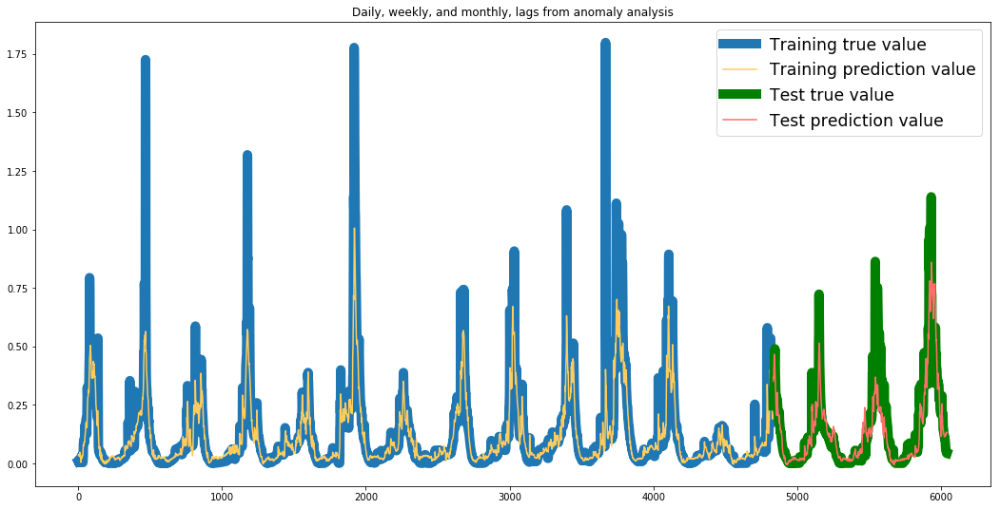

In [24]:
# train and test
TE_test_pred = TE_Anom_SVR_coarse.predict(test_X)
TE_train_pred = TE_Anom_SVR_coarse.predict(train_X)

# compute error
RMSE = np.sqrt(metrics.mean_squared_error(test_y, TE_test_pred))
EVS = metrics.explained_variance_score(test_y, TE_test_pred)
R2 = metrics.r2_score(test_y, TE_test_pred)

# plot
plt.figure(figsize=(18,9))
plt.plot(np.arange(train_length), train_y, label='Training true value', lw=10)
plt.plot(np.arange(train_length), TE_train_pred, label='Training prediction value', color='#ffcc5c')
plt.plot(np.arange(train_length,total_withlag), test_y, label='Test true value', lw=10, c='g')
plt.plot(np.arange(train_length,total_withlag), TE_test_pred, label='Test prediction value', color='#ff6f69')
plt.title('Daily, weekly, and monthly, lags from anomaly analysis')
plt.legend(fontsize='xx-large')
print('RMSE:', RMSE)
print('EVS:', EVS)
print('R2:', R2)

In [25]:
# now look at best parameters and setup fine search
BestCoarseC = TE_Anom_SVR_coarse.best_params_['C']
BestCoarseE = TE_Anom_SVR_coarse.best_params_['epsilon']
BestCoarseG = TE_Anom_SVR_coarse.best_params_['gamma']

# space at 1/10 of the coarse interval .5 -> .05 (in log2 space)C_list_fine = list(np.logspace(np.log2(BestCoarseC)-0.45, np.log2(BestCoarseC)+0.45, num=19, endpoint=True, base=2.0, dtype=None))
C_list_fine = list(np.logspace(np.log2(BestCoarseC)-0.45, np.log2(BestCoarseC)+0.45, num=19, endpoint=True, base=2.0, dtype=None))
E_list_fine = list(np.logspace(np.log2(BestCoarseE)-0.45, np.log2(BestCoarseE)+0.45, num=19, endpoint=True, base=2.0, dtype=None))
G_list_fine = list(np.logspace(np.log2(BestCoarseG)-0.45, np.log2(BestCoarseG)+0.45, num=19, endpoint=True, base=2.0, dtype=None))
SVR_params = {'C':C_list_fine, 'epsilon':E_list_fine, 'gamma':G_list_fine}

In [ ]:
# perform fine parameter space search
# GridSearchCV(estimator, param_grid, scoring=None, fit_params=None, n_jobs=None, iid=’warn’, refit=True, cv=’warn’, verbose=0, pre_dispatch=‘2*n_jobs’, error_score=’raise-deprecating’, return_train_score=’warn’)
TE_Anom_SVR_fine = GridSearchCV(TE_Anom_SVR, SVR_params, cv=nFold, n_jobs=nJobs, refit=True, verbose=3, return_train_score=True)
TE_Anom_SVR_fine.fit(train_X, train_y)

Fitting 5 folds for each of 6859 candidates, totalling 34295 fits
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.6748672635543319, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18301071199320315 


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s remaining:    0.0s


[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.5529979074699252, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18301071199320315 


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    1.3s remaining:    0.0s


[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.8420148288258753, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.7110990285904201, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.8607031305966671, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18946457081379972 
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18946457081379972, score=0.6745866339202837, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18946457081379972 
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.18946457081379972, score=0.5523034942603453, total=   0.4s
[CV] C=0.12940811548017217, ep

[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.5482971667589303, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.850036599021748, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.7167797376684741, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.860094981524073, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.25 .
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.25, score=0.6744494526773142, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gam

[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.5475983998801199, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.31864015682981556 
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.8502648708620737, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.31864015682981556 
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.7137395208517014, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.31864015682981556 
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.859841644913896, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.32987697769322355 
[CV]  C=0.12940811548017217, epsilon=0.022876338999150394, gamma=0.32987697769322355, score=0.670763753839343, total=   0.3s
[CV] C=0.12940811548017217, epsi

[CV]  C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.6752675206271994, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.217637640824031 
[CV]  C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.5505967637074766, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.217637640824031 
[CV]  C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.8486616986079567, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.217637640824031 
[CV]  C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.7155101402795114, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.217637640824031 
[CV]  C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.8604467915186398, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.0236830713

[CV]  C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.6743862697652034, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.2871745887492587 
[CV]  C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.5471872887617173, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.2871745887492587 
[CV]  C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.8517000529926608, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.2871745887492587 
[CV]  C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.714982646825232, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.2871745887492587 
[CV]  C=0.12940811548017217, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.8608495050553799, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.02

[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.6740441769738275, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.19614602447418766 
[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.5524507347730603, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.19614602447418766 
[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.8446076356965487, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.19614602447418766 
[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.7130842762460075, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.19614602447418766 
[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.8606846585510076, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.25881623096034434, score=0.5482493592052179, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.25881623096034434 
[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.25881623096034434, score=0.8504370477198475, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.25881623096034434 
[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.25881623096034434, score=0.717397835560075, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.25881623096034434 
[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.25881623096034434, score=0.8614003627534569, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.2679433656340733 
[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.2679433656340733, score=0.6731854369179795, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.0245

[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.34151006418859886, score=0.5498153937974996, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.34151006418859886 
[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.34151006418859886, score=0.8520977806039243, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.34151006418859886 
[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.34151006418859886, score=0.7129563728848223, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.34151006418859886 
[CV]  C=0.12940811548017217, epsilon=0.02451825305927345, gamma=0.34151006418859886, score=0.8569810527093844, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.18301071199320315, score=0.6719233585007607, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0

[CV]  C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.550218099073136, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.23325824788420185 
[CV]  C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.8501172580160267, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.23325824788420185 
[CV]  C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.7167141787719411, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.23325824788420185 
[CV]  C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.8602903859382983, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.24148408223121134, score=0.6721758117233188, total=   0.3s
[CV] C=0.12940811548017217, eps

[CV]  C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.5487574809007744, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.307786103336229 
[CV]  C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.851207954053473, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.307786103336229 
[CV]  C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.7145407810114508, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.307786103336229 
[CV]  C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.8589483264310624, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.31864015682981556 
[CV]  C=0.12940811548017217, epsilon=0.025382887386132362, gamma=0.31864015682981556, score=0.6686217484981993, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.0253828

[CV]  C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.6724332091115259, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.21022410381342863 
[CV]  C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.5524045163694928, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.21022410381342863 
[CV]  C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.8477402380711199, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.21022410381342863 
[CV]  C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.7163786121790681, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.21022410381342863 
[CV]  C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.8597434867751989, total=   0.4s
[CV] C=0.12940811548017217, ep

[CV]  C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.6709788517207236, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.2773923680169612 
[CV]  C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.5497074512720082, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.2773923680169612 
[CV]  C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.8517073925709698, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.2773923680169612 
[CV]  C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.7165868114574805, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.2773923680169612 
[CV]  C=0.12940811548017217, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.8608537168173558, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.6710355662497844, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.18946457081379972 
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.5541233125375717, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.18946457081379972 
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.8447078418579891, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.18946457081379972 
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.7139895541538315, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.18946457081379972 
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.8584491027807888, total=   0.4s
[CV] C=0.12940811548017217, ep

[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.24148408223121134, score=0.860209602817669, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.25 .
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.25, score=0.6710006040577818, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.25 .
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.25, score=0.5515236582420124, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.25 .
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.25, score=0.851316618293498, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.25 .
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.25, score=0.7183725935546061, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.25 .
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.25, score=

[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.31864015682981556, score=0.8565049220750787, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.32987697769322355 
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.6660138781799174, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.32987697769322355 
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.5539417418191981, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.32987697769322355 
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.8523898232167958, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.32987697769322355 
[CV]  C=0.12940811548017217, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.7145451206951601, total=   0.3s
[CV] C=0.12940811548017217, ep

[CV]  C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.217637640824031, score=0.7166441454044568, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.217637640824031 
[CV]  C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.217637640824031, score=0.8588534968438146, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.6696462386870714, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.55151777642263, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.8505376213076626, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.028164

[CV]  C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.2871745887492587, score=0.716339118105561, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.2871745887492587 
[CV]  C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.2871745887492587, score=0.8583495150902681, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.29730177875068026 
[CV]  C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.6659684633009626, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.29730177875068026 
[CV]  C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.5533988596387649, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.29730177875068026 
[CV]  C=0.12940811548017217, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.8528183502108164, total=   0.4s
[CV] C=0.12940811548017217, epsilo

[CV]  C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.19614602447418766, score=0.7158124611604462, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.19614602447418766 
[CV]  C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.19614602447418766, score=0.8577232819230891, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.20306309908905884 
[CV]  C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.6678348710873208, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.20306309908905884 
[CV]  C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.5529060645656736, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.20306309908905884 
[CV]  C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.8498937536414678, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.25881623096034434, score=0.8593155666625073, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.2679433656340733 
[CV]  C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.2679433656340733, score=0.6685951834951034, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.2679433656340733 
[CV]  C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.2679433656340733, score=0.5525465139195822, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.2679433656340733 
[CV]  C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.2679433656340733, score=0.8514563692757219, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.2679433656340733 
[CV]  C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.2679433656340733, score=0.7177828730979605, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.029157280

[CV]  C=0.12940811548017217, epsilon=0.02915728098552524, gamma=0.34151006418859886, score=0.8516316538028034, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.18301071199320315, score=0.6653416289615919, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.18301071199320315, score=0.5544487022351836, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.18301071199320315, score=0.8483988007252763, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.18301071199320315, score=0.7149956126098909, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.23325824788420185, score=0.8594421008443576, total=   0.4s
[CV] C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.24148408223121134, score=0.666521097180322, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.24148408223121134, score=0.5545722390901039, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.24148408223121134, score=0.8533713742400122, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.24148408223121134, score=0.7187639411483147, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03

[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.31864015682981556, score=0.6643831910606341, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.31864015682981556 
[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.31864015682981556, score=0.5566401249039274, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.31864015682981556 
[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.31864015682981556, score=0.8532412346433657, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.31864015682981556 
[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.31864015682981556, score=0.7157589163057687, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.31864015682981556 
[CV]  C=0.12940811548017217, epsilon=0.03018551027890143, gamma=0.31864015682981556, score=0.8527316456398129, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.12940811548017217, epsilon=0.03125, gamma=0.217637640824031, score=0.7182682398349199, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03125, gamma=0.217637640824031 .
[CV]  C=0.12940811548017217, epsilon=0.03125, gamma=0.217637640824031, score=0.8577058473213737, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03125, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.03125, gamma=0.2253126156527075, score=0.6649368412369376, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03125, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.03125, gamma=0.2253126156527075, score=0.5538536308469699, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03125, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.03125, gamma=0.2253126156527075, score=0.8520987792326521, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03125, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.03125, gamma=0.2253126156527075, score=0.7190195

[CV]  C=0.12940811548017217, epsilon=0.03125, gamma=0.29730177875068026, score=0.7173133262844243, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03125, gamma=0.29730177875068026 
[CV]  C=0.12940811548017217, epsilon=0.03125, gamma=0.29730177875068026, score=0.853558949542097, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03125, gamma=0.307786103336229 .
[CV]  C=0.12940811548017217, epsilon=0.03125, gamma=0.307786103336229, score=0.6636177551103526, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03125, gamma=0.307786103336229 .
[CV]  C=0.12940811548017217, epsilon=0.03125, gamma=0.307786103336229, score=0.5560577203842048, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03125, gamma=0.307786103336229 .
[CV]  C=0.12940811548017217, epsilon=0.03125, gamma=0.307786103336229, score=0.8525397493839206, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03125, gamma=0.307786103336229 .
[CV]  C=0.12940811548017217, epsilon=0.03125, gamma=0.307786103336229, score=0.7166697

[CV]  C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.21022410381342863, score=0.6628790816472387, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.21022410381342863 
[CV]  C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.21022410381342863, score=0.5552835321917966, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.21022410381342863 
[CV]  C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.21022410381342863, score=0.8510649183233863, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.21022410381342863 
[CV]  C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.21022410381342863, score=0.7178342541830365, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.21022410381342863 
[CV]  C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.21022410381342863, score=0.8571428874584952, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.2773923680169612, score=0.5553708056652317, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.2773923680169612 
[CV]  C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.2773923680169612, score=0.8520902965942939, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.2773923680169612 
[CV]  C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.2773923680169612, score=0.717940692614032, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.2773923680169612 
[CV]  C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.2773923680169612, score=0.8538239996026369, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.2871745887492587 
[CV]  C=0.12940811548017217, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.6626476411009031, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03235202887

[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.18946457081379972, score=0.5530438387588157, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.18946457081379972 
[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.18946457081379972, score=0.8503664600741206, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.18946457081379972 
[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.18946457081379972, score=0.7169469891198552, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.18946457081379972 
[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.18946457081379972, score=0.8558724626611048, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.19614602447418766 
[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.6597780949442036, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.25, score=0.5537595554643718, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.25 ..
[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.25, score=0.8530226236321969, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.25 ..
[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.25, score=0.719308664054808, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.25 ..
[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.25, score=0.8563688045398425, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.25881623096034434 
[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.25881623096034434, score=0.6607263175542022, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.25881623096034434 
[CV]  C=0.12940811548017217, epsilon=0.0334929207042591

[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.5579289874498863, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.32987697769322355 
[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.8510728028851305, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.32987697769322355 
[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.7143847199604758, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.32987697769322355 
[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.8472807996957269, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.34151006418859886 
[CV]  C=0.12940811548017217, epsilon=0.03349292070425915, gamma=0.34151006418859886, score=0.6594691049544872, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.2253126156527075, score=0.5536818464397639, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.2253126156527075, score=0.8536905635417568, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.2253126156527075, score=0.7200895819368205, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.2253126156527075, score=0.8573820457813206, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.23325824788420185 
[CV]  C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.23325824788420185, score=0.6597601465351992, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0

[CV]  C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.5574277834869821, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.29730177875068026 
[CV]  C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.8524862530846506, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.29730177875068026 
[CV]  C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.7166673277328781, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.29730177875068026 
[CV]  C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.8499517657793831, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.307786103336229 
[CV]  C=0.12940811548017217, epsilon=0.034674046002120165, gamma=0.307786103336229, score=0.6584873328946992, total=   0.2s
[CV] C=0.12940811548017217, epsilo

[CV]  C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.5511096062051752, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.20306309908905884 
[CV]  C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.8533332406251986, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.20306309908905884 
[CV]  C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.7191256725397994, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.20306309908905884 
[CV]  C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.8562142331004955, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.21022410381342863 
[CV]  C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.21022410381342863, score=0.6573125157509909, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.2679433656340733, score=0.8534588539379411, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.2679433656340733 
[CV]  C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.2679433656340733, score=0.7183423308721102, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.2679433656340733 
[CV]  C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.2679433656340733, score=0.8518354359368248, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.2773923680169612 
[CV]  C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.2773923680169612, score=0.6565656502502878, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.2773923680169612 
[CV]  C=0.12940811548017217, epsilon=0.03589682359365735, gamma=0.2773923680169612, score=0.5565356027346986, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.0358968235

[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.18301071199320315, score=0.851228998320107, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.18301071199320315, score=0.718286350900707, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.18301071199320315, score=0.8551440195869383, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.18946457081379972 
[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.18946457081379972, score=0.6565561890859275, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.18946457081379972 
[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.18946457081379972, score=0.5510642268741841, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.037

[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.24148408223121134, score=0.8532461132287331, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.24148408223121134, score=0.7204240628221728, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.24148408223121134, score=0.8535888165601139, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.25 ..
[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.25, score=0.6535947498191921, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.25 ..
[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.25, score=0.5548141579900666, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.25 ..
[CV]  C=0.12940811548017

[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.31864015682981556, score=0.7142241579804112, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.31864015682981556 
[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.31864015682981556, score=0.8451319848632804, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.32987697769322355 
[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.32987697769322355, score=0.6537523354488044, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.32987697769322355 
[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.32987697769322355, score=0.5572211712995387, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.32987697769322355 
[CV]  C=0.12940811548017217, epsilon=0.03716272234383503, gamma=0.32987697769322355, score=0.8485893509019746, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.217637640824031, score=0.7205538968448103, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.217637640824031 
[CV]  C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.217637640824031, score=0.8546186104770078, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.2253126156527075, score=0.6550877764913445, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.2253126156527075, score=0.5506082535983747, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.2253126156527075 
[CV]  C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.2253126156527075, score=0.8521682065816351, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.0384732629170

[CV]  C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.2871745887492587, score=0.846971842260446, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.29730177875068026 
[CV]  C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.29730177875068026, score=0.6528802191885006, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.29730177875068026 
[CV]  C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.29730177875068026, score=0.5565391477690256, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.29730177875068026 
[CV]  C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.29730177875068026, score=0.8498648490262561, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.29730177875068026 
[CV]  C=0.12940811548017217, epsilon=0.03847326291702863, gamma=0.29730177875068026, score=0.7156214638974985, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.038

[CV]  C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.19614602447418766, score=0.853934908221895, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.20306309908905884 
[CV]  C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.20306309908905884, score=0.6542426106818776, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.20306309908905884 
[CV]  C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.20306309908905884, score=0.5478603866512886, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.20306309908905884 
[CV]  C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.20306309908905884, score=0.8512195474132351, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.20306309908905884 
[CV]  C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.20306309908905884, score=0.7198879891601397, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03

[CV]  C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.6505902140306682, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.2679433656340733 
[CV]  C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.5543792536386596, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.2679433656340733 
[CV]  C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.850356320469594, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.2679433656340733 
[CV]  C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.7174752846439114, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.2679433656340733 
[CV]  C=0.12940811548017217, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.8481073214032333, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.03983001960

[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.6486509719406959, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.547539747473397, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.8485758037963821, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.7182616647987528, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.18301071199320315 
[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.8527191990273739, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.04

[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.6475583618095355, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.5512727015039052, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.8488332051947165, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.7193308637157361, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.24148408223121134 
[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.8489316707400743, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.5567256123811091, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.31864015682981556 
[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.8451275791564126, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.31864015682981556 
[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.7139429111106501, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.31864015682981556 
[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.8412268355857173, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.32987697769322355 
[CV]  C=0.12940811548017217, epsilon=0.04123462221165296, gamma=0.32987697769322355, score=0.6445884925437972, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.6446000094092011, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.217637640824031 
[CV]  C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.5464086249857352, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.217637640824031 
[CV]  C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.8473423783874312, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.217637640824031 
[CV]  C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.7192493714667472, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.217637640824031 
[CV]  C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.8501928050368187, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.0426887580

[CV]  C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.6451312942808726, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.2871745887492587 
[CV]  C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.5540998682962235, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.2871745887492587 
[CV]  C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.8444164043781917, total=   0.3s
[CV] C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.2871745887492587 
[CV]  C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.7146931065903539, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.2871745887492587 
[CV]  C=0.12940811548017217, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.8428850978327618, total=   0.2s
[CV] C=0.12940811548017217, epsilon=0.0

[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.6751820570310851, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.5510099569978109, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.8451823411406563, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.7130715032961111, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.861345111085102, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.022

[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.25881623096034434, score=0.5455138628485551, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.25881623096034434, score=0.8497983910182269, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.25881623096034434, score=0.7164156564127211, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.25881623096034434, score=0.8609682822545567, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.2679433656340733 
[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.675521551452722, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02287

[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.34151006418859886, score=0.547983383468655, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.34151006418859886, score=0.8512895569950649, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.34151006418859886, score=0.7114161793137055, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.022876338999150394, gamma=0.34151006418859886, score=0.8579090972089919, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.18301071199320315 
[CV]  C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.674344348653596, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.0236

[CV]  C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.23325824788420185, score=0.5481269202154488, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.23325824788420185 
[CV]  C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.23325824788420185, score=0.8494475005706877, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.23325824788420185 
[CV]  C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.23325824788420185, score=0.7167878855267726, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.23325824788420185 
[CV]  C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.23325824788420185, score=0.8602507398513901, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.24148408223121134 
[CV]  C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.24148408223121134, score=0.6737387214266028, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02

[CV]  C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.307786103336229, score=0.8508729415925077, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.307786103336229 
[CV]  C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.307786103336229, score=0.7144560746571561, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.307786103336229 
[CV]  C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.307786103336229, score=0.8599223447872513, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.31864015682981556 
[CV]  C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.31864015682981556, score=0.6714060711018975, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.31864015682981556 
[CV]  C=0.1339716828170366, epsilon=0.023683071351724965, gamma=0.31864015682981556, score=0.54814263922468, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02368307135172

[CV]  C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.21022410381342863, score=0.8479031513408886, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.21022410381342863 
[CV]  C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.21022410381342863, score=0.7154806301177656, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.21022410381342863 
[CV]  C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.21022410381342863, score=0.860433065150241, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.217637640824031 
[CV]  C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.217637640824031, score=0.6739322621534897, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.217637640824031 
[CV]  C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.217637640824031, score=0.5508568104093003, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.02451825305927345, g

[CV]  C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.2773923680169612, score=0.7157956651030238, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.2773923680169612 
[CV]  C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.2773923680169612, score=0.8611273696808167, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.2871745887492587 
[CV]  C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.2871745887492587, score=0.6729935379905432, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.2871745887492587 
[CV]  C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.2871745887492587, score=0.5483998834892387, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.2871745887492587 
[CV]  C=0.1339716828170366, epsilon=0.02451825305927345, gamma=0.2871745887492587, score=0.8509470260337986, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.02451825305927345, g

[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.18946457081379972, score=0.7142660000303922, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.18946457081379972 
[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.18946457081379972, score=0.8602536363075335, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.19614602447418766, score=0.67323023831145, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.19614602447418766, score=0.5526168357797052, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.19614602447418766, score=0.8441893019483033, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.0253

[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.25, score=0.7178982092329276, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.25 ..
[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.25, score=0.8613371528079194, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.25881623096034434, score=0.6719796512306, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.25881623096034434, score=0.5494078641380532, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.25881623096034434, score=0.8509453023909415, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.25881623096034434 
[

[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.32987697769322355, score=0.7136603786878614, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.32987697769322355 
[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.32987697769322355, score=0.8570294779082833, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.34151006418859886, score=0.668078012009933, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.34151006418859886, score=0.5510760782387968, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.025382887386132362, gamma=0.34151006418859886, score=0.8521729431013534, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.025

[CV]  C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.2253126156527075, score=0.7172918615025388, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.2253126156527075 
[CV]  C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.2253126156527075, score=0.8603406140531371, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.23325824788420185 
[CV]  C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.23325824788420185, score=0.6725702528161317, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.23325824788420185 
[CV]  C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.23325824788420185, score=0.5500718242895344, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.23325824788420185 
[CV]  C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.23325824788420185, score=0.8497053680758836, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.02627

[CV]  C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.29730177875068026, score=0.8590412008565933, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.307786103336229 
[CV]  C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.307786103336229, score=0.6682126248453574, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.307786103336229 
[CV]  C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.307786103336229, score=0.5502685199510589, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.307786103336229 
[CV]  C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.307786103336229, score=0.8520889016746322, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.307786103336229 
[CV]  C=0.1339716828170366, epsilon=0.026278012976678578, gamma=0.307786103336229, score=0.7149981810693926, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.026278012976678578

[CV]  C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.20306309908905884, score=0.8594403477014503, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.21022410381342863 
[CV]  C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.21022410381342863, score=0.6717907010298377, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.21022410381342863 
[CV]  C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.21022410381342863, score=0.552214503521748, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.21022410381342863 
[CV]  C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.21022410381342863, score=0.8498316906940885, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.21022410381342863 
[CV]  C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.21022410381342863, score=0.7167247083130421, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.027

[CV]  C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.2773923680169612, score=0.6689996570773697, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.2773923680169612 
[CV]  C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.2773923680169612, score=0.5510844867834916, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.2773923680169612 
[CV]  C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.2773923680169612, score=0.8521125003416362, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.2773923680169612 
[CV]  C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.2773923680169612, score=0.7163081422311272, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.2773923680169612 
[CV]  C=0.1339716828170366, epsilon=0.027204705103003875, gamma=0.2773923680169612, score=0.8594370065948069, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.02720470510

[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.18946457081379972, score=0.6690141921793801, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.18946457081379972 
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.18946457081379972, score=0.5542553856879836, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.18946457081379972 
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.18946457081379972, score=0.846767615276031, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.18946457081379972 
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.18946457081379972, score=0.7158800994720164, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.18946457081379972 
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.18946457081379972, score=0.8577700631645744, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.028

[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.25, score=0.6699535237835357, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.25 ..
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.25, score=0.5520417567568525, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.25 ..
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.25, score=0.8522884318487589, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.25 ..
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.25, score=0.7184972504215026, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.25 ..
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.25, score=0.8600422907422346, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.2588162309603443

[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.32987697769322355, score=0.5550070110079348, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.32987697769322355 
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.32987697769322355, score=0.8541728248764529, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.32987697769322355 
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.32987697769322355, score=0.713930496499499, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.32987697769322355 
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.32987697769322355, score=0.8534781777046264, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.028164076956588437, gamma=0.34151006418859886, score=0.6651119554207474, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.028

[CV]  C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.2253126156527075, score=0.5522051900541278, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.2253126156527075 
[CV]  C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.2253126156527075, score=0.8515019078905018, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.2253126156527075 
[CV]  C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.2253126156527075, score=0.718307898097428, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.2253126156527075 
[CV]  C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.2253126156527075, score=0.8592384948705101, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.23325824788420185 
[CV]  C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.23325824788420185, score=0.6681135888626218, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02915728098552524, 

[CV]  C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.29730177875068026, score=0.852503254562483, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.29730177875068026 
[CV]  C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.29730177875068026, score=0.7170138601460154, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.29730177875068026 
[CV]  C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.29730177875068026, score=0.8559833201474478, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.307786103336229 
[CV]  C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.307786103336229, score=0.6655037416531304, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.307786103336229 
[CV]  C=0.1339716828170366, epsilon=0.02915728098552524, gamma=0.307786103336229, score=0.5561783092168993, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.02915728098552524, g

[CV]  C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.20306309908905884, score=0.8506529720599085, total=   0.4s
[CV] C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.20306309908905884 
[CV]  C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.20306309908905884, score=0.716926601708838, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.20306309908905884 
[CV]  C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.20306309908905884, score=0.8578724728217179, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.21022410381342863 
[CV]  C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.21022410381342863, score=0.666381305782928, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.21022410381342863 
[CV]  C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.21022410381342863, score=0.5538144795074693, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.0301855102789

[CV]  C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.2679433656340733, score=0.7170826914183047, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.2679433656340733 
[CV]  C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.2679433656340733, score=0.8574923889561672, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.2773923680169612 
[CV]  C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.2773923680169612, score=0.6672000651297587, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.2773923680169612 
[CV]  C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.2773923680169612, score=0.5542108491711114, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.2773923680169612 
[CV]  C=0.1339716828170366, epsilon=0.03018551027890143, gamma=0.2773923680169612, score=0.8523847870015114, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03018551027890143, g

[CV]  C=0.1339716828170366, epsilon=0.03125, gamma=0.18301071199320315, score=0.8556420873660873, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03125, gamma=0.18946457081379972 
[CV]  C=0.1339716828170366, epsilon=0.03125, gamma=0.18946457081379972, score=0.6633004581468338, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03125, gamma=0.18946457081379972 
[CV]  C=0.1339716828170366, epsilon=0.03125, gamma=0.18946457081379972, score=0.553272313288448, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03125, gamma=0.18946457081379972 
[CV]  C=0.1339716828170366, epsilon=0.03125, gamma=0.18946457081379972, score=0.8500099540936203, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03125, gamma=0.18946457081379972 
[CV]  C=0.1339716828170366, epsilon=0.03125, gamma=0.18946457081379972, score=0.7164380738260778, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03125, gamma=0.18946457081379972 
[CV]  C=0.1339716828170366, epsilon=0.03125, gamma=0.18946457081379972, score=0.856406

[CV]  C=0.1339716828170366, epsilon=0.03125, gamma=0.25881623096034434, score=0.6659674997788305, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03125, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.03125, gamma=0.25881623096034434, score=0.5536454269289539, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03125, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.03125, gamma=0.25881623096034434, score=0.852083079371159, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03125, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.03125, gamma=0.25881623096034434, score=0.7175647817632498, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03125, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.03125, gamma=0.25881623096034434, score=0.8568925813897716, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03125, gamma=0.2679433656340733 .
[CV]  C=0.1339716828170366, epsilon=0.03125, gamma=0.2679433656340733, score=0.6657104

[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.18301071199320315, score=0.6623915165124247, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.18301071199320315 
[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.18301071199320315, score=0.5538798838729471, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.18301071199320315 
[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.18301071199320315, score=0.8488942659372845, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.18301071199320315 
[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.18301071199320315, score=0.7160777075364586, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.18301071199320315 
[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.18301071199320315, score=0.8552008386436786, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887

[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.24148408223121134, score=0.6633263531899654, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.24148408223121134 
[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.24148408223121134, score=0.5546757592255858, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.24148408223121134 
[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.24148408223121134, score=0.8512052752271019, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.24148408223121134 
[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.24148408223121134, score=0.7187157923546292, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.24148408223121134 
[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.24148408223121134, score=0.8570681735310519, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887

[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.31864015682981556, score=0.5585578186738367, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.31864015682981556 
[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.31864015682981556, score=0.8525878253102216, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.31864015682981556 
[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.31864015682981556, score=0.7146764104771016, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.31864015682981556 
[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.31864015682981556, score=0.8489516621148415, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.32987697769322355 
[CV]  C=0.1339716828170366, epsilon=0.03235202887004304, gamma=0.32987697769322355, score=0.6636689398822602, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03235202887

[CV]  C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.217637640824031, score=0.5541735460067766, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.217637640824031 
[CV]  C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.217637640824031, score=0.8534934361630663, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.217637640824031 
[CV]  C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.217637640824031, score=0.7194380261077915, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.217637640824031 
[CV]  C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.217637640824031, score=0.8575592166846103, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.2253126156527075 
[CV]  C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.2253126156527075, score=0.6618742033099132, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.

[CV]  C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.2871745887492587, score=0.8535614604011628, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.2871745887492587 
[CV]  C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.2871745887492587, score=0.7173240148520448, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.2871745887492587 
[CV]  C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.2871745887492587, score=0.8514477215147336, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.29730177875068026 
[CV]  C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.29730177875068026, score=0.6610001651826019, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.29730177875068026 
[CV]  C=0.1339716828170366, epsilon=0.03349292070425915, gamma=0.29730177875068026, score=0.5577493040930716, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.0334929207042591

[CV]  C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.19614602447418766, score=0.8524437859158845, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.19614602447418766, score=0.7187200514342784, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.19614602447418766, score=0.8567015372791326, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.20306309908905884 
[CV]  C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.20306309908905884, score=0.659114404839473, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.20306309908905884 
[CV]  C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.20306309908905884, score=0.5534365311020246, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.034

[CV]  C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.25881623096034434, score=0.7191019819602227, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.25881623096034434, score=0.8544246499133324, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.2679433656340733 
[CV]  C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.2679433656340733, score=0.6583241046090555, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.2679433656340733 
[CV]  C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.2679433656340733, score=0.5571021951211708, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.2679433656340733 
[CV]  C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.2679433656340733, score=0.8534495261064028, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03467404

[CV]  C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.34151006418859886, score=0.7105461792731695, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.034674046002120165, gamma=0.34151006418859886, score=0.8447538280919753, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.18301071199320315 
[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.18301071199320315, score=0.6586654715434496, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.18301071199320315 
[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.18301071199320315, score=0.55109621209888, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.18301071199320315 
[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.18301071199320315, score=0.851711577868027, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03589682359

[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.23325824788420185, score=0.7206138319243074, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.23325824788420185 
[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.23325824788420185, score=0.8560545295299441, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.24148408223121134 
[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.24148408223121134, score=0.6575020152215056, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.24148408223121134 
[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.24148408223121134, score=0.5555437546855359, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.24148408223121134 
[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.24148408223121134, score=0.8539168807249244, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03589682359

[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.307786103336229, score=0.8470204327991712, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.31864015682981556 
[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.31864015682981556, score=0.6573388492547652, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.31864015682981556 
[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.31864015682981556, score=0.5581261989224633, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.31864015682981556 
[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.31864015682981556, score=0.8505000806199499, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.31864015682981556 
[CV]  C=0.1339716828170366, epsilon=0.03589682359365735, gamma=0.31864015682981556, score=0.7140765469409521, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.0358968235936

[CV]  C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.21022410381342863, score=0.8562094098816485, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.217637640824031 
[CV]  C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.217637640824031, score=0.6582303583917521, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.217637640824031 
[CV]  C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.217637640824031, score=0.5516416162289453, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.217637640824031 
[CV]  C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.217637640824031, score=0.8546317400475305, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.217637640824031 
[CV]  C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.217637640824031, score=0.7209137254200894, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.

[CV]  C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.2871745887492587, score=0.6563235707346274, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.2871745887492587 
[CV]  C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.2871745887492587, score=0.5572850766999238, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.2871745887492587 
[CV]  C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.2871745887492587, score=0.8511688390660385, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.2871745887492587 
[CV]  C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.2871745887492587, score=0.716927445340923, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.2871745887492587 
[CV]  C=0.1339716828170366, epsilon=0.03716272234383503, gamma=0.2871745887492587, score=0.8479669875258427, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03716272234383503, ga

[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.19614602447418766, score=0.6567841210663681, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.19614602447418766, score=0.5494140332380221, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.19614602447418766, score=0.8526007721725424, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.19614602447418766, score=0.7198775082282591, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.19614602447418766, score=0.8554512776412677, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03847326291

[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.25881623096034434, score=0.5559292851260829, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.25881623096034434, score=0.8523295526312167, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.25881623096034434, score=0.717904078784236, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.25881623096034434, score=0.8502075557856317, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.2679433656340733 
[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.2679433656340733, score=0.6534991010216985, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03847326291702

[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.34151006418859886, score=0.5594391832688261, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.34151006418859886, score=0.8482007589729128, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.34151006418859886, score=0.7117415117320507, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.03847326291702863, gamma=0.34151006418859886, score=0.841476737714636, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.18301071199320315 
[CV]  C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.18301071199320315, score=0.6534920446628635, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.039830019603

[CV]  C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.23325824788420185, score=0.5523855548511556, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.23325824788420185 
[CV]  C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.23325824788420185, score=0.8500089781555458, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.23325824788420185 
[CV]  C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.23325824788420185, score=0.7197162342027933, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.23325824788420185 
[CV]  C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.23325824788420185, score=0.8514106704005237, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.24148408223121134 
[CV]  C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.24148408223121134, score=0.6518406270738963, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03983001960

[CV]  C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.307786103336229, score=0.8471700392343988, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.307786103336229 
[CV]  C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.307786103336229, score=0.7147938563280811, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.307786103336229 
[CV]  C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.307786103336229, score=0.8430809450262948, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.31864015682981556 
[CV]  C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.31864015682981556, score=0.6495410224558377, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.31864015682981556 
[CV]  C=0.1339716828170366, epsilon=0.03983001960372693, gamma=0.31864015682981556, score=0.5583065351047398, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.03983001960372693, ga

[CV]  C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.21022410381342863, score=0.8500936110033073, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.21022410381342863 
[CV]  C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.21022410381342863, score=0.7196734614363568, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.21022410381342863 
[CV]  C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.21022410381342863, score=0.852314418662087, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.217637640824031 
[CV]  C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.217637640824031, score=0.6490631196537441, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.217637640824031 
[CV]  C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.217637640824031, score=0.5480121360345129, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.04123462221165296, g

[CV]  C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.2773923680169612, score=0.7157464613946825, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.2773923680169612 
[CV]  C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.2773923680169612, score=0.8455158684214278, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.2871745887492587 
[CV]  C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.2871745887492587, score=0.6477073666116138, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.2871745887492587 
[CV]  C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.2871745887492587, score=0.5554756190354689, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.2871745887492587 
[CV]  C=0.1339716828170366, epsilon=0.04123462221165296, gamma=0.2871745887492587, score=0.8461594502736525, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.04123462221165296, g

[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.18946457081379972, score=0.718830054386028, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.18946457081379972 
[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.18946457081379972, score=0.8530240364521267, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.19614602447418766, score=0.6475084592105511, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.19614602447418766, score=0.5466787074554007, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.19614602447418766 
[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.19614602447418766, score=0.8485355809710521, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.042

[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.25, score=0.7180127484727149, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.25 ..
[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.25, score=0.8474467516587786, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.25881623096034434, score=0.646174218071239, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.25881623096034434, score=0.552638861554007, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.25881623096034434 
[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.25881623096034434, score=0.8458059690917077, total=   0.3s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.25881623096034434 


[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.32987697769322355, score=0.7118700022902056, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.32987697769322355 
[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.32987697769322355, score=0.8380824739848042, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.34151006418859886, score=0.6393271444344273, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.34151006418859886, score=0.5595104190639584, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.34151006418859886 
[CV]  C=0.1339716828170366, epsilon=0.042688758023574865, gamma=0.34151006418859886, score=0.8424995695552179, total=   0.2s
[CV] C=0.1339716828170366, epsilon=0.04

[CV]  C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.2253126156527075, score=0.7167098537011458, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.2253126156527075 
[CV]  C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.2253126156527075, score=0.8600578930672219, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.23325824788420185, score=0.6752591845465508, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.23325824788420185, score=0.5470391798968266, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.23325824788420185, score=0.8493343199878226, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02287

[CV]  C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.29730177875068026, score=0.8606266568898435, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.307786103336229, score=0.6734256400030232, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.307786103336229, score=0.5471171534692828, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.307786103336229, score=0.8495862618960943, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.022876338999150394, gamma=0.307786103336229, score=0.7142730057368912, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.022876338999150394

[CV]  C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.20306309908905884, score=0.8608825939566903, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.21022410381342863 
[CV]  C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.21022410381342863, score=0.6752020287177533, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.21022410381342863 
[CV]  C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.21022410381342863, score=0.5504421647812141, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.21022410381342863 
[CV]  C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.21022410381342863, score=0.8486920802591685, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.21022410381342863 
[CV]  C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.21022410381342863, score=0.7161203657905637, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.02

[CV]  C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.2773923680169612, score=0.6749178434083596, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.2773923680169612 
[CV]  C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.2773923680169612, score=0.5479527932821945, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.2773923680169612 
[CV]  C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.2773923680169612, score=0.8505355987796288, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.2773923680169612 
[CV]  C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.2773923680169612, score=0.7154477803532266, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.2773923680169612 
[CV]  C=0.1386961840084806, epsilon=0.023683071351724965, gamma=0.2773923680169612, score=0.8609475917098386, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02368307135

[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.18946457081379972, score=0.674238756410303, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.18946457081379972 
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.18946457081379972, score=0.5522411655256725, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.18946457081379972 
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.18946457081379972, score=0.8434203622714055, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.18946457081379972 
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.18946457081379972, score=0.7137193862727327, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.18946457081379972 
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.18946457081379972, score=0.8609553120224545, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.024518253059

[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.25, score=0.6735126980591555, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.25 ...
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.25, score=0.5477747576055763, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.25 ...
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.25, score=0.8502185859978735, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.25 ...
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.25, score=0.7173303689783015, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.25 ...
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.25, score=0.8617860499810309, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.25881623096034434 
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.25881623096034434, scor

[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.32987697769322355, score=0.550029290307319, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.32987697769322355 
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.32987697769322355, score=0.851616912784843, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.32987697769322355 
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.32987697769322355, score=0.7121238927439877, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.32987697769322355 
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.32987697769322355, score=0.8573141956645237, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.34151006418859886 
[CV]  C=0.1386961840084806, epsilon=0.02451825305927345, gamma=0.34151006418859886, score=0.6693074057533345, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.0245182530592

[CV]  C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.2253126156527075, score=0.5495172535609306, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.2253126156527075 
[CV]  C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.2253126156527075, score=0.849519290064842, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.2253126156527075 
[CV]  C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.2253126156527075, score=0.7171440850272701, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.2253126156527075 
[CV]  C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.2253126156527075, score=0.860305783378238, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.6730762974729404, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.02538288738

[CV]  C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.29730177875068026, score=0.8511154024811339, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.29730177875068026 
[CV]  C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.29730177875068026, score=0.7151628560881347, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.29730177875068026 
[CV]  C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.29730177875068026, score=0.8588791771868919, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.670629927612873, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.5495181853723022, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02538288738

[CV]  C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.20306309908905884, score=0.848156903880972, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.20306309908905884 
[CV]  C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.20306309908905884, score=0.7169309134098183, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.20306309908905884 
[CV]  C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.20306309908905884, score=0.8599291469327622, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.21022410381342863 
[CV]  C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.6727963472528657, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.21022410381342863 
[CV]  C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.5515060715131879, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.026

[CV]  C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.2679433656340733, score=0.7166405078241969, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.2679433656340733 
[CV]  C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.2679433656340733, score=0.860478848685704, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.2773923680169612 
[CV]  C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.6707300310654281, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.2773923680169612 
[CV]  C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.5495267519677036, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.2773923680169612 
[CV]  C=0.1386961840084806, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.8511281957631466, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.026278012976

[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.18301071199320315, score=0.7154374912338654, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.18301071199320315 
[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.18301071199320315, score=0.8589229950364831, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.18946457081379972 
[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.6708240765198803, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.18946457081379972 
[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.5533045863396959, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.18946457081379972 
[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.8454358373338393, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02

[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.24148408223121134, score=0.718641927527918, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.24148408223121134 
[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.24148408223121134, score=0.8609358939317489, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.25 ..
[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.25, score=0.6715266550404277, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.25 ..
[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.25, score=0.5512581845140389, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.25 ..
[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.25, score=0.8521172004177698, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.25 ..
[CV]  C=0.1386961840084806, epsilon=0.027204705103003

[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.31864015682981556, score=0.8559823236860218, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.32987697769322355 
[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.6669266329139751, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.32987697769322355 
[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.5534598741628607, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.32987697769322355 
[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.8536384519671458, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.32987697769322355 
[CV]  C=0.1386961840084806, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.7123743017597162, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.02

[CV]  C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.217637640824031, score=0.8594959703197873, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.2253126156527075 
[CV]  C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.6700648914699272, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.2253126156527075 
[CV]  C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.5509776203175333, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.2253126156527075 
[CV]  C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.8508155853898133, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.2253126156527075 
[CV]  C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.7182832616278978, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.028164076956

[CV]  C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.666673628944909, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.29730177875068026 
[CV]  C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.5543904859673117, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.29730177875068026 
[CV]  C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.8525845479582043, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.29730177875068026 
[CV]  C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.7168403117111755, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.29730177875068026 
[CV]  C=0.1386961840084806, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.8565614072486427, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.028

[CV]  C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.6688944285299749, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.20306309908905884 
[CV]  C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.5531143837113339, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.20306309908905884 
[CV]  C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.8504814218009621, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.20306309908905884 
[CV]  C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.7169762302838416, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.20306309908905884 
[CV]  C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.8583199595910238, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02915728098

[CV]  C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.2679433656340733, score=0.5534140279532318, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.2679433656340733 
[CV]  C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.2679433656340733, score=0.8525056087522731, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.2679433656340733 
[CV]  C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.2679433656340733, score=0.7171320309484763, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.2679433656340733 
[CV]  C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.2679433656340733, score=0.8576203189423179, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.2773923680169612 
[CV]  C=0.1386961840084806, epsilon=0.02915728098552524, gamma=0.2773923680169612, score=0.6675076519125489, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.02915728098552524, g

[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.18301071199320315, score=0.5532598171531136, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.18301071199320315 
[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.18301071199320315, score=0.8488875417188548, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.18301071199320315 
[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.18301071199320315, score=0.7162558951921258, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.18301071199320315 
[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.18301071199320315, score=0.8563410757402843, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.18946457081379972 
[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.18946457081379972, score=0.6663032448027146, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03018551027

[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.24148408223121134, score=0.553626352541694, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.24148408223121134 
[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.24148408223121134, score=0.8525774935936683, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.24148408223121134 
[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.24148408223121134, score=0.7188521535614061, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.24148408223121134 
[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.24148408223121134, score=0.8587785536525452, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.25 ...
[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.25, score=0.6679794489954327, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.25 ...
[CV] 

[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.31864015682981556, score=0.8549276026964006, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.31864015682981556 
[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.31864015682981556, score=0.7138190980080377, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.31864015682981556 
[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.31864015682981556, score=0.8509278890736403, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.32987697769322355 
[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.32987697769322355, score=0.6659867058611784, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.32987697769322355 
[CV]  C=0.1386961840084806, epsilon=0.03018551027890143, gamma=0.32987697769322355, score=0.5557685453444374, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03018551027

[CV]  C=0.1386961840084806, epsilon=0.03125, gamma=0.2253126156527075, score=0.5545507156936192, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03125, gamma=0.2253126156527075 .
[CV]  C=0.1386961840084806, epsilon=0.03125, gamma=0.2253126156527075, score=0.8530356432105596, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03125, gamma=0.2253126156527075 .
[CV]  C=0.1386961840084806, epsilon=0.03125, gamma=0.2253126156527075, score=0.7195006411279461, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03125, gamma=0.2253126156527075 .
[CV]  C=0.1386961840084806, epsilon=0.03125, gamma=0.2253126156527075, score=0.8584268810231721, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03125, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.03125, gamma=0.23325824788420185, score=0.6648802389388344, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03125, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.03125, gamma=0.23325824788420185, score=0.554397847

[CV]  C=0.1386961840084806, epsilon=0.03125, gamma=0.307786103336229, score=0.8537971188885158, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03125, gamma=0.307786103336229 ..
[CV]  C=0.1386961840084806, epsilon=0.03125, gamma=0.307786103336229, score=0.715604740447199, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03125, gamma=0.307786103336229 ..
[CV]  C=0.1386961840084806, epsilon=0.03125, gamma=0.307786103336229, score=0.8508558131568078, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03125, gamma=0.31864015682981556 
[CV]  C=0.1386961840084806, epsilon=0.03125, gamma=0.31864015682981556, score=0.6653401628658485, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03125, gamma=0.31864015682981556 
[CV]  C=0.1386961840084806, epsilon=0.03125, gamma=0.31864015682981556, score=0.5574139536894869, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03125, gamma=0.31864015682981556 
[CV]  C=0.1386961840084806, epsilon=0.03125, gamma=0.31864015682981556, score=0.853815057016

[CV]  C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.21022410381342863, score=0.8575497727043327, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.217637640824031 
[CV]  C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.217637640824031, score=0.6642892175602497, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.217637640824031 
[CV]  C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.217637640824031, score=0.5548522698537808, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.217637640824031 
[CV]  C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.217637640824031, score=0.8533761481125502, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.217637640824031 
[CV]  C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.217637640824031, score=0.7196889446438057, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.

[CV]  C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.6642213472015388, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.2871745887492587 
[CV]  C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.5570367946856782, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.2871745887492587 
[CV]  C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.8533702516057342, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.2871745887492587 
[CV]  C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.7175540839635342, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.2871745887492587 
[CV]  C=0.1386961840084806, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.8519930665378321, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03235202887004304, g

[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.6611174769031176, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.19614602447418766 
[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.5546141617586593, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.19614602447418766 
[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.8515088327038073, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.19614602447418766 
[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.7184078553594021, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.19614602447418766 
[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.8572312169944946, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03349292070

[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.25881623096034434, score=0.5564423972943711, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.25881623096034434 
[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.25881623096034434, score=0.8534771756593743, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.25881623096034434 
[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.25881623096034434, score=0.7190431011489891, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.25881623096034434 
[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.25881623096034434, score=0.8546040423598125, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.2679433656340733 
[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.2679433656340733, score=0.6622848615765676, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.0334929207042

[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.34151006418859886, score=0.5584687294420214, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.34151006418859886 
[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.34151006418859886, score=0.8508014913475104, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.34151006418859886 
[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.34151006418859886, score=0.7101820499637315, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.34151006418859886 
[CV]  C=0.1386961840084806, epsilon=0.03349292070425915, gamma=0.34151006418859886, score=0.8459053361370307, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.18301071199320315 
[CV]  C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.18301071199320315, score=0.660301455616247, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.0346740460

[CV]  C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.23325824788420185, score=0.5547088020731594, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.23325824788420185, score=0.8539231926461872, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.23325824788420185, score=0.7198820058175801, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.23325824788420185, score=0.856827177709679, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.24148408223121134 
[CV]  C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.24148408223121134, score=0.6599371091152111, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.034

[CV]  C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.307786103336229, score=0.8515089965056288, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.307786103336229, score=0.7150766561229298, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.307786103336229, score=0.8472902859323124, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.31864015682981556 
[CV]  C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.31864015682981556, score=0.6605169308712275, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.31864015682981556 
[CV]  C=0.1386961840084806, epsilon=0.034674046002120165, gamma=0.31864015682981556, score=0.5594134422952761, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.034674046002

[CV]  C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.21022410381342863, score=0.8554780261255851, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.21022410381342863 
[CV]  C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.21022410381342863, score=0.7206116372280413, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.21022410381342863 
[CV]  C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.21022410381342863, score=0.8569397211508325, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.217637640824031 
[CV]  C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.217637640824031, score=0.6593077287709956, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.217637640824031 
[CV]  C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.217637640824031, score=0.5535467804860079, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03589682359365735, 

[CV]  C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.2773923680169612, score=0.7174949317487792, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.2773923680169612 
[CV]  C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.2773923680169612, score=0.8502878895944752, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.2871745887492587 
[CV]  C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.2871745887492587, score=0.6585592343226616, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.2871745887492587 
[CV]  C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.2871745887492587, score=0.5581858825092901, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.2871745887492587 
[CV]  C=0.1386961840084806, epsilon=0.03589682359365735, gamma=0.2871745887492587, score=0.8518150247575771, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03589682359365735, g

[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.18946457081379972, score=0.7194336954237962, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.18946457081379972 
[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.18946457081379972, score=0.8562232416072698, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.19614602447418766 
[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.19614602447418766, score=0.6588923638895281, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.19614602447418766 
[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.19614602447418766, score=0.5496162466570248, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.19614602447418766 
[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.19614602447418766, score=0.853823901224203, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.037162722343

[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.25, score=0.8519888792910779, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.25881623096034434 
[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.25881623096034434, score=0.6563538498188102, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.25881623096034434 
[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.25881623096034434, score=0.5572956599877772, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.25881623096034434 
[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.25881623096034434, score=0.8529117278288267, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.25881623096034434 
[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.25881623096034434, score=0.7179161736522697, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0

[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.32987697769322355, score=0.8431731331910346, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.34151006418859886 
[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.34151006418859886, score=0.6541423179301384, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.34151006418859886 
[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.34151006418859886, score=0.5607666351427949, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.34151006418859886 
[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.34151006418859886, score=0.8492337573507025, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.34151006418859886 
[CV]  C=0.1386961840084806, epsilon=0.03716272234383503, gamma=0.34151006418859886, score=0.7121194306143235, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.03716272234

[CV]  C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.2253126156527075, score=0.8534219591215606, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.23325824788420185, score=0.6548416471348817, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.23325824788420185, score=0.5546447790793205, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.23325824788420185, score=0.8522155745955671, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.23325824788420185, score=0.7198046274917725, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.038473262917

[CV]  C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.307786103336229, score=0.6534000734153155, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.307786103336229, score=0.5595100388349288, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.307786103336229, score=0.8497192767140396, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.307786103336229, score=0.7142674783751547, total=   0.2s
[CV] C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.307786103336229, score=0.8438373844000894, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03847326291702863, gamma=0.31

[CV]  C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.21022410381342863, score=0.6551970404026093, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.21022410381342863 
[CV]  C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.21022410381342863, score=0.5503426594759628, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.21022410381342863 
[CV]  C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.21022410381342863, score=0.8506946508417669, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.21022410381342863 
[CV]  C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.21022410381342863, score=0.7203869864803243, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.21022410381342863 
[CV]  C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.21022410381342863, score=0.8536196693522561, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.03983001960

[CV]  C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.2773923680169612, score=0.5573698615841686, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.2773923680169612 
[CV]  C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.2773923680169612, score=0.848946341328935, total=   0.6s
[CV] C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.2773923680169612 
[CV]  C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.2773923680169612, score=0.7164836421055255, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.2773923680169612 
[CV]  C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.2773923680169612, score=0.84619897997546, total=   0.6s
[CV] C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.2871745887492587 
[CV]  C=0.1386961840084806, epsilon=0.03983001960372693, gamma=0.2871745887492587, score=0.6513430632110795, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.03983001960372693, gamm

[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.18946457081379972, score=0.5479773170006577, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.18946457081379972 
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.18946457081379972, score=0.8500345363383971, total=   0.6s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.18946457081379972 
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.18946457081379972, score=0.7190196768722639, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.18946457081379972 
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.18946457081379972, score=0.8530385139883958, total=   0.6s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.19614602447418766 
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.19614602447418766, score=0.6513281699501512, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.04123462221

[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.25, score=0.5543981424491716, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.25 ...
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.25, score=0.8488570770599271, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.25 ...
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.25, score=0.7179470048568599, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.25 ...
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.25, score=0.848303807320488, total=   0.6s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.25881623096034434 
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.25881623096034434, score=0.6494385473987774, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.25881623096034434 
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma

[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.32987697769322355, score=0.846323081750844, total=   0.6s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.32987697769322355 
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.32987697769322355, score=0.7130094646022385, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.32987697769322355 
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.32987697769322355, score=0.8394830893913594, total=   0.6s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.34151006418859886 
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.34151006418859886, score=0.6430530501306729, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.34151006418859886 
[CV]  C=0.1386961840084806, epsilon=0.04123462221165296, gamma=0.34151006418859886, score=0.5607616676137206, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.041234622211

[CV]  C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.2253126156527075, score=0.8478794169892765, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.2253126156527075 
[CV]  C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.2253126156527075, score=0.7198805593033825, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.2253126156527075 
[CV]  C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.2253126156527075, score=0.8486135508270598, total=   0.5s
[CV] C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.23325824788420185, score=0.6472718010544338, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.23325824788420185 
[CV]  C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.23325824788420185, score=0.5518679239347959, total=   0.4s
[CV] C=0.1386961840084806, epsilon=0.0426887

[CV]  C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.29730177875068026, score=0.7146122537436344, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.29730177875068026 
[CV]  C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.29730177875068026, score=0.8420378045792128, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.307786103336229, score=0.643649890558422, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.307786103336229, score=0.5582803691221325, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.307786103336229 
[CV]  C=0.1386961840084806, epsilon=0.042688758023574865, gamma=0.307786103336229, score=0.8443228542704793, total=   0.3s
[CV] C=0.1386961840084806, epsilon=0.042688758023574

[CV]  C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.20306309908905884, score=0.7159322691921266, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.20306309908905884 
[CV]  C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.20306309908905884, score=0.8614132468376707, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.21022410381342863, score=0.6757310781064021, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.21022410381342863, score=0.5494302363277899, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.21022410381342863, score=0.8483893569126741, total=   0.5s
[CV] C=0.14358729437462936, ep

[CV]  C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.7152699988014835, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.2679433656340733 
[CV]  C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.8613226406955, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.2773923680169612, score=0.6758742745545334, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.2773923680169612, score=0.5479110584042665, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.022876338999150394, gamma=0.2773923680169612, score=0.8500246361519475, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.0228

[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.713430578450198, total=   0.7s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.18301071199320315 
[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.8611689729776361, total=   0.8s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.18946457081379972, score=0.6748942906452717, total=   0.7s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.18946457081379972, score=0.5501489836355694, total=   0.7s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.18946457081379972, score=0.8434612512248685, total=   0.8s
[CV] C=0.14358729437462936, eps

[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.24148408223121134, score=0.7174935693262867, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.24148408223121134 
[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.24148408223121134, score=0.8608693016723594, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.25 .
[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.25, score=0.67533287971445, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.25 .
[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.25, score=0.5470255149612484, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.25 .
[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.25, score=0.850039868274326, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.25 .
[CV]  C=0.14358729437462936, epsilon=0.0236830713

[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.31864015682981556, score=0.7122061080345806, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.31864015682981556 
[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.31864015682981556, score=0.8587925170752403, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.32987697769322355 
[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.32987697769322355, score=0.6713620624810129, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.32987697769322355 
[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.32987697769322355, score=0.5479941957227085, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.32987697769322355 
[CV]  C=0.14358729437462936, epsilon=0.023683071351724965, gamma=0.32987697769322355, score=0.851788585004359, total=   0.6s
[CV] C=0.14358729437462936, eps

[CV]  C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.217637640824031, score=0.7166123704186989, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.217637640824031 
[CV]  C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.217637640824031, score=0.8600037031282546, total=   0.8s
[CV] C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.2253126156527075 
[CV]  C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.2253126156527075, score=0.6741595732923384, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.2253126156527075 
[CV]  C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.2253126156527075, score=0.5488096408376022, total=   0.7s
[CV] C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.2253126156527075 
[CV]  C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.2253126156527075, score=0.8485717256627311, total=   0.8s
[CV] C=0.14358729437462936, epsilon=0.0245182530592

[CV]  C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.2871745887492587, score=0.8600378071723902, total=   0.7s
[CV] C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.29730177875068026 
[CV]  C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.29730177875068026, score=0.6730705382836806, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.29730177875068026 
[CV]  C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.29730177875068026, score=0.5483881468055839, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.29730177875068026 
[CV]  C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.29730177875068026, score=0.8503536126812417, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.29730177875068026 
[CV]  C=0.14358729437462936, epsilon=0.02451825305927345, gamma=0.29730177875068026, score=0.7148711963171797, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.02

[CV]  C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.19614602447418766, score=0.8602654614873397, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.20306309908905884 
[CV]  C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.20306309908905884, score=0.674216970306004, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.20306309908905884 
[CV]  C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.20306309908905884, score=0.551074373392327, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.20306309908905884 
[CV]  C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.20306309908905884, score=0.8484381535574733, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.20306309908905884 
[CV]  C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.20306309908905884, score=0.7162561100373878, total=   0.5s
[CV] C=0.14358729437462936, epsi

[CV]  C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.25881623096034434, score=0.8611149142746496, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.2679433656340733 
[CV]  C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.2679433656340733, score=0.6734569369815706, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.2679433656340733 
[CV]  C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.2679433656340733, score=0.5486773942240815, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.2679433656340733 
[CV]  C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.2679433656340733, score=0.8503995120794792, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.2679433656340733 
[CV]  C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.2679433656340733, score=0.7161709961926792, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.

[CV]  C=0.14358729437462936, epsilon=0.025382887386132362, gamma=0.34151006418859886, score=0.8554045208965785, total=   0.7s
[CV] C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.18301071199320315 
[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.18301071199320315, score=0.673202154436642, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.18301071199320315 
[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.18301071199320315, score=0.5535870296038119, total=   0.7s
[CV] C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.18301071199320315 
[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.18301071199320315, score=0.843698610238971, total=   0.8s
[CV] C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.18301071199320315 
[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.18301071199320315, score=0.7163674047470425, total=   0.6s
[CV] C=0.14358729437462936, epsi

[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.23325824788420185, score=0.7183887205736595, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.23325824788420185 
[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.23325824788420185, score=0.8612137907504746, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.24148408223121134 
[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.24148408223121134, score=0.6731705084566951, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.24148408223121134 
[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.24148408223121134, score=0.5502617586817296, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.24148408223121134 
[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.24148408223121134, score=0.8510537868149821, total=   0.6s
[CV] C=0.14358729437462936, ep

[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.307786103336229, score=0.7144983570513083, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.307786103336229 
[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.307786103336229, score=0.8577277803227878, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.31864015682981556 
[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.31864015682981556, score=0.6692338808954554, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.31864015682981556 
[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.31864015682981556, score=0.553063405321834, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.31864015682981556 
[CV]  C=0.14358729437462936, epsilon=0.026278012976678578, gamma=0.31864015682981556, score=0.85205320366517, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.0

[CV]  C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.21022410381342863, score=0.8494488919543419, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.21022410381342863, score=0.7176835352070812, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.21022410381342863, score=0.8598607870554904, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.217637640824031 
[CV]  C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.217637640824031, score=0.6727171797633287, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.217637640824031 
[CV]  C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.217637640824031, score=0.5495469570276883, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.

[CV]  C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.2773923680169612, score=0.8514956180339408, total=   0.7s
[CV] C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.2773923680169612, score=0.7164884530844684, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.2773923680169612, score=0.8589646429137916, total=   0.7s
[CV] C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.2871745887492587 
[CV]  C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.2871745887492587, score=0.6691258373680449, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.2871745887492587 
[CV]  C=0.14358729437462936, epsilon=0.027204705103003875, gamma=0.2871745887492587, score=0.5520788239168347, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.0

[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.18946457081379972, score=0.8487296757129557, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.18946457081379972, score=0.7168204171094806, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.18946457081379972, score=0.8583731682881264, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.19614602447418766 
[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.19614602447418766, score=0.6711128972140532, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.19614602447418766 
[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.19614602447418766, score=0.5519777436400968, total=   0.5s
[CV] C=0.14358729437462936, ep

[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.25, score=0.8520234863097196, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.25 .
[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.25, score=0.7173894590437957, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.25 .
[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.25, score=0.8598676646147754, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.25881623096034434, score=0.6706620414526524, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.25881623096034434, score=0.5525380788821765, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.25881623096034434 
[CV]  C=0.14358729

[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.32987697769322355, score=0.8549934533381597, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.32987697769322355 
[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.32987697769322355, score=0.7095824954742718, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.32987697769322355 
[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.32987697769322355, score=0.8528514820056449, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.34151006418859886 
[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.34151006418859886, score=0.6675861150016428, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.34151006418859886 
[CV]  C=0.14358729437462936, epsilon=0.028164076956588437, gamma=0.34151006418859886, score=0.553559021470486, total=   0.5s
[CV] C=0.14358729437462936, eps

[CV]  C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.2253126156527075, score=0.8523655258673875, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.2253126156527075 
[CV]  C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.2253126156527075, score=0.718975069611569, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.2253126156527075 
[CV]  C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.2253126156527075, score=0.8596543951857804, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.23325824788420185 
[CV]  C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.23325824788420185, score=0.6693578570658496, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.23325824788420185 
[CV]  C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.23325824788420185, score=0.5527949794820901, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.0291572

[CV]  C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.29730177875068026, score=0.71663960302102, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.29730177875068026 
[CV]  C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.29730177875068026, score=0.8546859818496799, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.307786103336229 
[CV]  C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.307786103336229, score=0.6672248326297645, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.307786103336229 
[CV]  C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.307786103336229, score=0.5561625437256364, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.307786103336229 
[CV]  C=0.14358729437462936, epsilon=0.02915728098552524, gamma=0.307786103336229, score=0.8544723022121334, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.029157280985525

[CV]  C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.20306309908905884, score=0.7186662121000972, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.20306309908905884 
[CV]  C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.20306309908905884, score=0.8581966007454437, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.21022410381342863, score=0.6674022827909023, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.21022410381342863, score=0.5528970685299455, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.21022410381342863, score=0.8520955089981973, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.0

[CV]  C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.2679433656340733, score=0.8561599767305128, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.2773923680169612, score=0.667861419095588, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.2773923680169612, score=0.5556816352506486, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.2773923680169612, score=0.8526580629806224, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.03018551027890143, gamma=0.2773923680169612, score=0.717889827188849, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.030185510278

[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.18301071199320315, score=0.8560531619291621, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.03125, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.18946457081379972, score=0.6643051247861536, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03125, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.18946457081379972, score=0.55392783027303, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03125, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.18946457081379972, score=0.8501756271776317, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.03125, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.18946457081379972, score=0.717517320251905, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03125, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.18946457081379972, score

[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.25, score=0.8568268038361401, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03125, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.25881623096034434, score=0.6679047457894167, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03125, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.25881623096034434, score=0.5548758405267139, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03125, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.25881623096034434, score=0.8521304026715728, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03125, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.25881623096034434, score=0.7181350550220471, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03125, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.25881623096034434, score=0.855723151

[CV]  C=0.14358729437462936, epsilon=0.03125, gamma=0.34151006418859886, score=0.8480385528676428, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.18301071199320315 
[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.18301071199320315, score=0.6625634366822988, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.18301071199320315 
[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.18301071199320315, score=0.5536967846581242, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.18301071199320315 
[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.18301071199320315, score=0.8502892974164893, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.18301071199320315 
[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.18301071199320315, score=0.7174716181632961, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.0323520288700

[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.23325824788420185, score=0.857093984325735, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.24148408223121134 
[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.24148408223121134, score=0.6650226519584445, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.24148408223121134 
[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.24148408223121134, score=0.5545786321565466, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.24148408223121134 
[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.24148408223121134, score=0.852315641849778, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.24148408223121134 
[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.24148408223121134, score=0.7184559120805318, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.032

[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.31864015682981556, score=0.6654644138671392, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.31864015682981556 
[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.31864015682981556, score=0.5582153864149948, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.31864015682981556 
[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.31864015682981556, score=0.853076845673437, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.31864015682981556 
[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.31864015682981556, score=0.7115016908076144, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.31864015682981556 
[CV]  C=0.14358729437462936, epsilon=0.03235202887004304, gamma=0.31864015682981556, score=0.8487003765496487, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.03

[CV]  C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.217637640824031, score=0.6625913006485424, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.217637640824031 
[CV]  C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.217637640824031, score=0.5558620034822446, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.217637640824031 
[CV]  C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.217637640824031, score=0.8526815544562363, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.217637640824031 
[CV]  C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.217637640824031, score=0.7203852932164515, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.217637640824031 
[CV]  C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.217637640824031, score=0.8575026681951587, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03349292070425915, 

[CV]  C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.2871745887492587, score=0.5599295923093267, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.2871745887492587 
[CV]  C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.2871745887492587, score=0.8526394594677007, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.2871745887492587 
[CV]  C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.2871745887492587, score=0.7171973568266616, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.2871745887492587 
[CV]  C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.2871745887492587, score=0.85016854087828, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.29730177875068026 
[CV]  C=0.14358729437462936, epsilon=0.03349292070425915, gamma=0.29730177875068026, score=0.6638011374407702, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.0334929207

[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.19614602447418766, score=0.5537179320898467, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.19614602447418766 
[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.19614602447418766, score=0.8536435693972304, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.19614602447418766 
[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.19614602447418766, score=0.7197215818006826, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.19614602447418766 
[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.19614602447418766, score=0.8577734697716031, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.20306309908905884 
[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.20306309908905884, score=0.6609166652048664, total=   0.5s
[CV] C=0.14358729437462936, ep

[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.25881623096034434, score=0.5582149025846423, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.25881623096034434, score=0.8532824575407375, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.25881623096034434, score=0.7188465853086408, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.25881623096034434, score=0.8529578686759951, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.2679433656340733 
[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.2679433656340733, score=0.6606887649342605, total=   0.5s
[CV] C=0.14358729437462936, epsi

[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.34151006418859886, score=0.5599453466491784, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.34151006418859886 
[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.34151006418859886, score=0.8509060240813769, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.34151006418859886 
[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.34151006418859886, score=0.711525673865119, total=   0.3s
[CV] C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.34151006418859886 
[CV]  C=0.14358729437462936, epsilon=0.034674046002120165, gamma=0.34151006418859886, score=0.8442475444315943, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.18301071199320315 
[CV]  C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.18301071199320315, score=0.6590386449340393, total=   0.4s
[CV] C=0.14358729437462936, epsil

[CV]  C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.23325824788420185, score=0.5571313843569345, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.23325824788420185 
[CV]  C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.23325824788420185, score=0.8543733847272383, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.23325824788420185 
[CV]  C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.23325824788420185, score=0.719702239204265, total=   0.3s
[CV] C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.23325824788420185 
[CV]  C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.23325824788420185, score=0.8548507319856573, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.24148408223121134 
[CV]  C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.24148408223121134, score=0.6591289270822673, total=   0.3s
[CV] C=0.14358729437462936, epsilon=0.03

[CV]  C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.307786103336229, score=0.8510358559496157, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.307786103336229 
[CV]  C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.307786103336229, score=0.7138392882085067, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.307786103336229 
[CV]  C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.307786103336229, score=0.8458633074152831, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.31864015682981556 
[CV]  C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.31864015682981556, score=0.659261088493033, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.31864015682981556 
[CV]  C=0.14358729437462936, epsilon=0.03589682359365735, gamma=0.31864015682981556, score=0.5605400120893755, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.035896823593

[CV]  C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.21022410381342863, score=0.8545969254112029, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.21022410381342863, score=0.7210043179381284, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.21022410381342863, score=0.8559571025031667, total=   0.6s
[CV] C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.217637640824031 
[CV]  C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.217637640824031, score=0.6585447690278512, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.217637640824031 
[CV]  C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.217637640824031, score=0.5534428910310455, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.037162722

[CV]  C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.2773923680169612, score=0.7172953900286476, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.2773923680169612, score=0.8484067295532183, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.2871745887492587 
[CV]  C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.2871745887492587, score=0.6572421539043454, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.2871745887492587 
[CV]  C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.2871745887492587, score=0.5579060237760558, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.2871745887492587 
[CV]  C=0.14358729437462936, epsilon=0.03716272234383503, gamma=0.2871745887492587, score=0.8514979420116718, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.0371627223

[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.18946457081379972, score=0.7201110355430673, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.18946457081379972, score=0.8559095835816064, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.19614602447418766 
[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.19614602447418766, score=0.6575437303950498, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.19614602447418766 
[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.19614602447418766, score=0.5509686429692623, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.19614602447418766 
[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.19614602447418766, score=0.8527552235960776, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.0

[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.25, score=0.7177962217303073, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.25 ..
[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.25, score=0.8507239701637802, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.25881623096034434, score=0.6556756092268274, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.25881623096034434, score=0.558236730502677, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.25881623096034434, score=0.8521728119558503, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.25881623096034434 

[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.32987697769322355, score=0.713193204222881, total=   0.3s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.32987697769322355 
[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.32987697769322355, score=0.8419414762045162, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.34151006418859886 
[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.34151006418859886, score=0.6506525938989305, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.34151006418859886 
[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.34151006418859886, score=0.5615335479463711, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.34151006418859886 
[CV]  C=0.14358729437462936, epsilon=0.03847326291702863, gamma=0.34151006418859886, score=0.849311512286007, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.038

[CV]  C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.2253126156527075, score=0.719696887678799, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.2253126156527075 
[CV]  C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.2253126156527075, score=0.851436642974878, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.23325824788420185 
[CV]  C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.23325824788420185, score=0.6540068905823475, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.23325824788420185 
[CV]  C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.23325824788420185, score=0.5547718124229302, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.23325824788420185 
[CV]  C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.23325824788420185, score=0.8513330542552122, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.039830

[CV]  C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.29730177875068026, score=0.8435107013123152, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.307786103336229 
[CV]  C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.307786103336229, score=0.6506947352213135, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.307786103336229 
[CV]  C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.307786103336229, score=0.5594458088447365, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.307786103336229 
[CV]  C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.307786103336229, score=0.8482869706617484, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.307786103336229 
[CV]  C=0.14358729437462936, epsilon=0.03983001960372693, gamma=0.307786103336229, score=0.7138557440266682, total=   0.3s
[CV] C=0.14358729437462936, epsilon=0.03983001960372693

[CV]  C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.20306309908905884, score=0.85263542790089, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.21022410381342863, score=0.6500612049158856, total=   0.3s
[CV] C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.21022410381342863, score=0.5502688058432681, total=   0.3s
[CV] C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.21022410381342863, score=0.8492711457017106, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.21022410381342863 
[CV]  C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.21022410381342863, score=0.7200538779869323, total=   0.3s
[CV] C=0.14358729437462936, epsilon=0.041

[CV]  C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.2773923680169612, score=0.6491365098121047, total=   0.3s
[CV] C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.2773923680169612, score=0.5579149155032666, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.2773923680169612, score=0.8474313643524026, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.2773923680169612, score=0.7163581654370978, total=   0.3s
[CV] C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.2773923680169612 
[CV]  C=0.14358729437462936, epsilon=0.04123462221165296, gamma=0.2773923680169612, score=0.8449366550844222, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.0412346222

[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.18946457081379972, score=0.647923083093868, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.18946457081379972, score=0.5477760301176657, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.18946457081379972, score=0.8485286646437562, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.18946457081379972, score=0.7194093539147248, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.18946457081379972 
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.18946457081379972, score=0.8528876580519686, total=   0.4s
[CV] C=0.14358729437462936, eps

[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.25, score=0.6478920344159287, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.25 .
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.25, score=0.5540066191389823, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.25 .
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.25, score=0.84710688606, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.25 .
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.25, score=0.7170929112772875, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.25 .
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.25, score=0.8478180386484807, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.25881623096034434 
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.25881623096034

[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.32987697769322355, score=0.641764588854783, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.32987697769322355 
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.32987697769322355, score=0.5608084394721797, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.32987697769322355 
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.32987697769322355, score=0.8432035447130124, total=   0.5s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.32987697769322355 
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.32987697769322355, score=0.7129713355425746, total=   0.4s
[CV] C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.32987697769322355 
[CV]  C=0.14358729437462936, epsilon=0.042688758023574865, gamma=0.32987697769322355, score=0.8370788135702752, total=   0.5s
[CV] C=0.14358729437462936, eps

[CV]  C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.217637640824031, score=0.8604359112124504, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.2253126156527075, score=0.67565988172955, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.2253126156527075, score=0.5462274574310158, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.2253126156527075, score=0.8487433150436485, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.2253126156527075, score=0.7169417255242421, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.0228

[CV]  C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.2871745887492587, score=0.8607292895380962, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.29730177875068026, score=0.6758513196695857, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.29730177875068026, score=0.5474159503954896, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.29730177875068026, score=0.848824118654812, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.022876338999150394, gamma=0.29730177875068026, score=0.7138467013288401, total=   0.5s
[CV] C=0.14865088937534013, epsi

[CV]  C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.19614602447418766, score=0.7162474928919869, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.19614602447418766 
[CV]  C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.19614602447418766, score=0.8608445180431833, total=   0.7s
[CV] C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.20306309908905884, score=0.6755107489511759, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.20306309908905884, score=0.5498076171374126, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.20306309908905884, score=0.8482592740674357, total=   0.7s
[CV] C=0.14865088937534013, ep

[CV]  C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.25881623096034434, score=0.716226649833861, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.25881623096034434 
[CV]  C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.25881623096034434, score=0.8610671564157193, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.2679433656340733 
[CV]  C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.2679433656340733, score=0.6756478910748946, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.2679433656340733 
[CV]  C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.2679433656340733, score=0.54904552755707, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.2679433656340733 
[CV]  C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.2679433656340733, score=0.849957947362953, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.02

[CV]  C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.34151006418859886, score=0.7061550603586064, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.34151006418859886 
[CV]  C=0.14865088937534013, epsilon=0.023683071351724965, gamma=0.34151006418859886, score=0.856483252098706, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.18301071199320315 
[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.18301071199320315, score=0.674454239401026, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.18301071199320315 
[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.18301071199320315, score=0.5512656268525042, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.18301071199320315 
[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.18301071199320315, score=0.8430037214674586, total=   0.7s
[CV] C=0.14865088937534013, epsilon=0.

[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.23325824788420185, score=0.7178900690753459, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.23325824788420185 
[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.23325824788420185, score=0.8610039053264488, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.24148408223121134 
[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.24148408223121134, score=0.6746386442926928, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.24148408223121134 
[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.24148408223121134, score=0.5480059436982991, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.24148408223121134 
[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.24148408223121134, score=0.8495707424637726, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.0

[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.307786103336229, score=0.8586904955654151, total=   0.8s
[CV] C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.31864015682981556 
[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.31864015682981556, score=0.672230690219906, total=   0.7s
[CV] C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.31864015682981556 
[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.31864015682981556, score=0.5494004850882882, total=   0.7s
[CV] C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.31864015682981556 
[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.31864015682981556, score=0.852032569981862, total=   0.7s
[CV] C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.31864015682981556 
[CV]  C=0.14865088937534013, epsilon=0.02451825305927345, gamma=0.31864015682981556, score=0.7105887471949031, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.02451

[CV]  C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.21022410381342863, score=0.8598338593540242, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.217637640824031 
[CV]  C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.217637640824031, score=0.6742927554266116, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.217637640824031 
[CV]  C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.217637640824031, score=0.5489850645706567, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.217637640824031 
[CV]  C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.217637640824031, score=0.8489875491888625, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.217637640824031 
[CV]  C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.217637640824031, score=0.7176150267988184, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.02538288

[CV]  C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.2773923680169612, score=0.8597785663433228, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.2871745887492587 
[CV]  C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.2871745887492587, score=0.6730060951984056, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.2871745887492587 
[CV]  C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.2871745887492587, score=0.5490879851265855, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.2871745887492587 
[CV]  C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.2871745887492587, score=0.8495132979802946, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.2871745887492587 
[CV]  C=0.14865088937534013, epsilon=0.025382887386132362, gamma=0.2871745887492587, score=0.715541752994078, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.02

[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.18946457081379972, score=0.717161131456389, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.18946457081379972 
[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.18946457081379972, score=0.8598890764392795, total=   0.7s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.19614602447418766 
[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.19614602447418766, score=0.6742770675460206, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.19614602447418766 
[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.19614602447418766, score=0.5510531784394639, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.19614602447418766 
[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.19614602447418766, score=0.8485696579152335, total=   0.7s
[CV] C=0.14865088937534013, eps

[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.25, score=0.7173337812410562, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.25 .
[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.25, score=0.8610889463327729, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.25881623096034434 
[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.25881623096034434, score=0.6726520089774033, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.25881623096034434 
[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.25881623096034434, score=0.5497129909985458, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.25881623096034434 
[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.25881623096034434, score=0.8506042071023612, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.25881623

[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.32987697769322355, score=0.7081189238612013, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.32987697769322355 
[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.32987697769322355, score=0.8550766747740178, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.34151006418859886 
[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.34151006418859886, score=0.6697679036856363, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.34151006418859886 
[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.34151006418859886, score=0.5504455436084623, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.34151006418859886 
[CV]  C=0.14865088937534013, epsilon=0.026278012976678578, gamma=0.34151006418859886, score=0.8542418860856932, total=   0.5s
[CV] C=0.14865088937534013, ep

[CV]  C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.2253126156527075, score=0.8502744562954028, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.2253126156527075, score=0.7186959258189733, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.2253126156527075, score=0.8607645782879249, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.23325824788420185 
[CV]  C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.23325824788420185, score=0.6729276049202149, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.23325824788420185 
[CV]  C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.23325824788420185, score=0.5507934575014757, total=   0.5s
[CV] C=0.14865088937534013, epsilon

[CV]  C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.29730177875068026, score=0.8520179306150457, total=   0.7s
[CV] C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.29730177875068026, score=0.7151534338728474, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.29730177875068026, score=0.8568440339909412, total=   0.7s
[CV] C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.307786103336229 
[CV]  C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.307786103336229, score=0.6692832768849122, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.307786103336229 
[CV]  C=0.14865088937534013, epsilon=0.027204705103003875, gamma=0.307786103336229, score=0.5544230593536033, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.

[CV]  C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.20306309908905884, score=0.5512953713704509, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.20306309908905884, score=0.8503847043765669, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.20306309908905884, score=0.7180253248248842, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.20306309908905884, score=0.8589818625190847, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.21022410381342863 
[CV]  C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.21022410381342863, score=0.6708597615287677, total=   0.4s
[CV] C=0.14865088937534013, ep

[CV]  C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.2679433656340733, score=0.5529620025725759, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.2679433656340733 
[CV]  C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.2679433656340733, score=0.8524857477456567, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.2679433656340733 
[CV]  C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.2679433656340733, score=0.7175081484042847, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.2679433656340733 
[CV]  C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.2679433656340733, score=0.8580638377766067, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.2773923680169612 
[CV]  C=0.14865088937534013, epsilon=0.028164076956588437, gamma=0.2773923680169612, score=0.6693576968475745, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.0

[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.18301071199320315, score=0.5516927970395162, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.18301071199320315 
[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.18301071199320315, score=0.8491049700074489, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.18301071199320315 
[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.18301071199320315, score=0.7172517751349767, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.18301071199320315 
[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.18301071199320315, score=0.8578300449208458, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.18946457081379972 
[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.18946457081379972, score=0.6688592752286526, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.0

[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.24148408223121134, score=0.5529156452750319, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.24148408223121134 
[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.24148408223121134, score=0.8521055581485801, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.24148408223121134 
[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.24148408223121134, score=0.7183217663197033, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.24148408223121134 
[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.24148408223121134, score=0.85892523515718, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.25 ..
[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.25, score=0.6706465424358691, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.25 .

[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.31864015682981556, score=0.8555543074715812, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.31864015682981556 
[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.31864015682981556, score=0.7101412680795227, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.31864015682981556 
[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.31864015682981556, score=0.8516694816263592, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.32987697769322355 
[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.32987697769322355, score=0.6683515788385751, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.32987697769322355 
[CV]  C=0.14865088937534013, epsilon=0.02915728098552524, gamma=0.32987697769322355, score=0.5537180490606943, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.0

[CV]  C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.217637640824031, score=0.8525392957729278, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.217637640824031 
[CV]  C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.217637640824031, score=0.719587439047592, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.217637640824031 
[CV]  C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.217637640824031, score=0.8586537328806949, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.2253126156527075, score=0.667794755909562, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.2253126156527075, score=0.5531404983243735, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03018551027890143

[CV]  C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.2871745887492587, score=0.7167386888519791, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.2871745887492587 
[CV]  C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.2871745887492587, score=0.8537830635594108, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.29730177875068026, score=0.6684977631022047, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.29730177875068026, score=0.5568059253035875, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.03018551027890143, gamma=0.29730177875068026, score=0.8545734166254542, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.0301

[CV]  C=0.14865088937534013, epsilon=0.03125, gamma=0.19614602447418766, score=0.8569954591081606, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.03125, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.03125, gamma=0.20306309908905884, score=0.6651660584207582, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03125, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.03125, gamma=0.20306309908905884, score=0.5541732452169716, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03125, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.03125, gamma=0.20306309908905884, score=0.8519492869881915, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.03125, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.03125, gamma=0.20306309908905884, score=0.7198385057785521, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03125, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.03125, gamma=0.20306309908905884, sc

[CV]  C=0.14865088937534013, epsilon=0.03125, gamma=0.2679433656340733, score=0.8542094459683457, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03125, gamma=0.2773923680169612 
[CV]  C=0.14865088937534013, epsilon=0.03125, gamma=0.2773923680169612, score=0.6677150201878603, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03125, gamma=0.2773923680169612 
[CV]  C=0.14865088937534013, epsilon=0.03125, gamma=0.2773923680169612, score=0.5580000003353537, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03125, gamma=0.2773923680169612 
[CV]  C=0.14865088937534013, epsilon=0.03125, gamma=0.2773923680169612, score=0.8532805457190158, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03125, gamma=0.2773923680169612 
[CV]  C=0.14865088937534013, epsilon=0.03125, gamma=0.2773923680169612, score=0.7182742405020066, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03125, gamma=0.2773923680169612 
[CV]  C=0.14865088937534013, epsilon=0.03125, gamma=0.2773923680169612, score=0.85339

[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.18946457081379972, score=0.7187438932729195, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.18946457081379972 
[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.18946457081379972, score=0.8568575342053405, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.19614602447418766 
[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.19614602447418766, score=0.6640058140183418, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.19614602447418766 
[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.19614602447418766, score=0.55436788056785, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.19614602447418766 
[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.19614602447418766, score=0.8518430436899537, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.032

[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.25, score=0.7188224914383488, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.25 ..
[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.25, score=0.85439603605084, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.25881623096034434 
[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.25881623096034434, score=0.6661002171189556, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.25881623096034434 
[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.25881623096034434, score=0.5559416961039427, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.25881623096034434 
[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.25881623096034434, score=0.853061374219323, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.25881623096034434 
[

[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.32987697769322355, score=0.7103853359692218, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.32987697769322355 
[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.32987697769322355, score=0.8474008080479227, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.34151006418859886 
[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.34151006418859886, score=0.6638664102760349, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.34151006418859886 
[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.34151006418859886, score=0.5577979107529881, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.34151006418859886 
[CV]  C=0.14865088937534013, epsilon=0.03235202887004304, gamma=0.34151006418859886, score=0.8527697196348428, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.0

[CV]  C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.2253126156527075, score=0.7196284961418751, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.2253126156527075, score=0.8572146141932342, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.23325824788420185 
[CV]  C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.23325824788420185, score=0.664196137738517, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.23325824788420185 
[CV]  C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.23325824788420185, score=0.5552248439395622, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.23325824788420185 
[CV]  C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.23325824788420185, score=0.8529079779405263, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03349

[CV]  C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.29730177875068026, score=0.8482145646143351, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.307786103336229 
[CV]  C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.307786103336229, score=0.6644722375697842, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.307786103336229 
[CV]  C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.307786103336229, score=0.5597267835338748, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.307786103336229 
[CV]  C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.307786103336229, score=0.8519943858964636, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.307786103336229 
[CV]  C=0.14865088937534013, epsilon=0.03349292070425915, gamma=0.307786103336229, score=0.7119375920314475, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.03349292070425915

[CV]  C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.20306309908905884, score=0.8578859145717375, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.21022410381342863 
[CV]  C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.21022410381342863, score=0.6618642634844155, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.21022410381342863 
[CV]  C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.21022410381342863, score=0.5555258553383323, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.21022410381342863 
[CV]  C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.21022410381342863, score=0.8538667696802397, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.21022410381342863 
[CV]  C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.21022410381342863, score=0.7206774270513787, total=   0.4s
[CV] C=0.14865088937534013, ep

[CV]  C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.2679433656340733, score=0.8515665735105429, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.2773923680169612 
[CV]  C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.2773923680169612, score=0.6618374799125414, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.2773923680169612 
[CV]  C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.2773923680169612, score=0.5601071494102865, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.2773923680169612 
[CV]  C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.2773923680169612, score=0.8522188694655981, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.2773923680169612 
[CV]  C=0.14865088937534013, epsilon=0.034674046002120165, gamma=0.2773923680169612, score=0.7176381400530998, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.0

[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.18301071199320315, score=0.8568491964728551, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.18946457081379972 
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.18946457081379972, score=0.6592059627729179, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.18946457081379972 
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.18946457081379972, score=0.5521147559873605, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.18946457081379972 
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.18946457081379972, score=0.8540497327333323, total=   0.6s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.18946457081379972 
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.18946457081379972, score=0.7200443828042823, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.0

[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.24148408223121134, score=0.8532854238032879, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.25 ..
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.25, score=0.659060562528631, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.25 ..
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.25, score=0.5594404600735338, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.25 ..
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.25, score=0.8531372400342945, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.25 ..
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.25, score=0.7188302028539691, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.25 ..
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.25, score=0.852

[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.32987697769322355, score=0.6591549070625706, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.32987697769322355 
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.32987697769322355, score=0.5607078677812414, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.32987697769322355 
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.32987697769322355, score=0.8506821735738183, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.32987697769322355 
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.32987697769322355, score=0.7127594858223775, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.32987697769322355 
[CV]  C=0.14865088937534013, epsilon=0.03589682359365735, gamma=0.32987697769322355, score=0.8435797310330391, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.0

[CV]  C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.2253126156527075, score=0.6578506645925684, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.2253126156527075, score=0.5573595330764081, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.2253126156527075, score=0.8542238880636653, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.2253126156527075, score=0.7201497212720624, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.2253126156527075, score=0.8539648090066236, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.0371627223

[CV]  C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.29730177875068026, score=0.5599003734008332, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.29730177875068026, score=0.8511718673023037, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.29730177875068026, score=0.7141487070611918, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.29730177875068026, score=0.8452916468627424, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.307786103336229 
[CV]  C=0.14865088937534013, epsilon=0.03716272234383503, gamma=0.307786103336229, score=0.6575029486728365, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03716

[CV]  C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.20306309908905884, score=0.5523170194938457, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.20306309908905884, score=0.8521873636724736, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.20306309908905884, score=0.7208911210332869, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.20306309908905884, score=0.8550478002232973, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.21022410381342863 
[CV]  C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.21022410381342863, score=0.6578736251744788, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.0

[CV]  C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.2679433656340733, score=0.8512857372333296, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.2679433656340733 
[CV]  C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.2679433656340733, score=0.7174937388760139, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.2679433656340733 
[CV]  C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.2679433656340733, score=0.848146402493322, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.2773923680169612 
[CV]  C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.2773923680169612, score=0.6551425010418204, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.2773923680169612 
[CV]  C=0.14865088937534013, epsilon=0.03847326291702863, gamma=0.2773923680169612, score=0.5588759369074981, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03847326291

[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.18301071199320315, score=0.8511635628728491, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.18301071199320315 
[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.18301071199320315, score=0.7194865691462573, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.18301071199320315 
[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.18301071199320315, score=0.8546884166323436, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.18946457081379972 
[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.18946457081379972, score=0.6559508247536576, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.18946457081379972 
[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.18946457081379972, score=0.550465034137534, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03

[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.24148408223121134, score=0.8514365079811973, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.24148408223121134 
[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.24148408223121134, score=0.7181928673909377, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.24148408223121134 
[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.24148408223121134, score=0.8502675338381777, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.25 ..
[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.25, score=0.6539286345788724, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.25 ..
[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.25, score=0.5566591398247133, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.25 ..
[CV]  C=0.14865088937534

[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.31864015682981556, score=0.7142255559829641, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.31864015682981556 
[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.31864015682981556, score=0.8417191695720702, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.32987697769322355 
[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.32987697769322355, score=0.6498127627897555, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.32987697769322355 
[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.32987697769322355, score=0.5616990058471603, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.32987697769322355 
[CV]  C=0.14865088937534013, epsilon=0.03983001960372693, gamma=0.32987697769322355, score=0.8484730355911901, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.0

[CV]  C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.217637640824031, score=0.719658362919539, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.217637640824031 
[CV]  C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.217637640824031, score=0.850524230219829, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.2253126156527075, score=0.6526514934119939, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.2253126156527075, score=0.5541792242069301, total=   0.4s
[CV] C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.2253126156527075 
[CV]  C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.2253126156527075, score=0.8501609413931407, total=   0.5s
[CV] C=0.14865088937534013, epsilon=0.041234622211652

[CV]  C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.2871745887492587, score=0.8439788309286279, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.29730177875068026, score=0.6486239097425164, total=   0.2s
[CV] C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.29730177875068026, score=0.559310815043295, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.29730177875068026, score=0.8476413598645856, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.29730177875068026 
[CV]  C=0.14865088937534013, epsilon=0.04123462221165296, gamma=0.29730177875068026, score=0.7142039626595544, total=   0.2s
[CV] C=0.14865088937534013, epsilon=0.041

[CV]  C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.19614602447418766, score=0.8517934810136127, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.20306309908905884, score=0.6478817630608386, total=   0.2s
[CV] C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.20306309908905884, score=0.5499201186575793, total=   0.2s
[CV] C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.20306309908905884, score=0.8475537559501428, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.20306309908905884 
[CV]  C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.20306309908905884, score=0.7198027710722222, total=   0.2s
[CV] C=0.14865088937534013, ep

[CV]  C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.25881623096034434, score=0.8461380026739462, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.2679433656340733 
[CV]  C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.2679433656340733, score=0.6467721609817896, total=   0.2s
[CV] C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.2679433656340733 
[CV]  C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.2679433656340733, score=0.5568757494855204, total=   0.2s
[CV] C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.2679433656340733 
[CV]  C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.2679433656340733, score=0.8461756746052977, total=   0.3s
[CV] C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.2679433656340733 
[CV]  C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.2679433656340733, score=0.7167229842183269, total=   0.2s
[CV] C=0.14865088937534013, epsilon=0.

[CV]  C=0.14865088937534013, epsilon=0.042688758023574865, gamma=0.34151006418859886, score=0.835419588223417, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.6751188424821416, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.5483584169943285, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.8434168050282069, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.7146291891265844, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02

[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.23325824788420185, score=0.8609903577311018, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.6771236463301218, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.5466119900569777, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.8493317594734348, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.7166569628663131, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02

[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.6749171266080832, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.5461216957314465, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.85106113382684, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.7088073123474044, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.8585847557141426, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.0228

[CV]  C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.675867185123513, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.5467982407682715, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.848106866477465, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.71719846147425, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.8603943486732726, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.023683071351724965, gamm

[CV]  C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.5476394944243266, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.2871745887492587 
[CV]  C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.8484639573002458, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.2871745887492587 
[CV]  C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.7142146141730166, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.2871745887492587 
[CV]  C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.8599494088785675, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.29730177875068026 
[CV]  C=0.1538930516681145, epsilon=0.023683071351724965, gamma=0.29730177875068026, score=0.6755846197980451, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.023683071

[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.5500275705671078, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.19614602447418766 
[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.8482206642582342, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.19614602447418766 
[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.7164318844932475, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.19614602447418766 
[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.8603056375401557, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.20306309908905884 
[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.20306309908905884, score=0.6754171622112581, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02451825305

[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.25881623096034434, score=0.8495224898877518, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.25881623096034434 
[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.25881623096034434, score=0.7165770523604456, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.25881623096034434 
[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.25881623096034434, score=0.860762027968961, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.2679433656340733 
[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.2679433656340733, score=0.6751386289804844, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.2679433656340733 
[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.2679433656340733, score=0.5492930852518072, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.0245182530592734

[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.34151006418859886, score=0.8537651050553783, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.34151006418859886 
[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.34151006418859886, score=0.7058997244663747, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.34151006418859886 
[CV]  C=0.1538930516681145, epsilon=0.02451825305927345, gamma=0.34151006418859886, score=0.8555531388284385, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.18301071199320315, score=0.6740923831988441, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.18301071199320315, score=0.5509486449653719, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.0253828

[CV]  C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.8497923515291262, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.23325824788420185 
[CV]  C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.7181127149100865, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.23325824788420185 
[CV]  C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.8615166027856874, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.24148408223121134, score=0.6747607094997734, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.24148408223121134, score=0.549307750734937, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.025

[CV]  C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.7107374037202645, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.307786103336229 
[CV]  C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.8575026197969357, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.31864015682981556, score=0.6730265720843965, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.31864015682981556, score=0.5504842026384743, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.025382887386132362, gamma=0.31864015682981556, score=0.8523168322613138, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02538288

[CV]  C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.7181025480517944, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.21022410381342863 
[CV]  C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.8604672094519439, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.217637640824031, score=0.6741190317948292, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.217637640824031, score=0.5504875580295744, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.217637640824031, score=0.8495501845216481, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02627801297667

[CV]  C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.8591842620234831, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.2871745887492587 
[CV]  C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.6718505945092598, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.2871745887492587 
[CV]  C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.5514664290018279, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.2871745887492587 
[CV]  C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.8505673219436244, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.2871745887492587 
[CV]  C=0.1538930516681145, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.7151292064264132, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02627801297

[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.8590481892259144, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.6725247310916553, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.5505771501998689, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.8489308949748479, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.717435726980021, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.027

[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.25, score=0.8599840323298928, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.25881623096034434 
[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.25881623096034434, score=0.6719650311882883, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.25881623096034434 
[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.25881623096034434, score=0.5514191655435734, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.25881623096034434 
[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.25881623096034434, score=0.8508425851054633, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.25881623096034434 
[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.25881623096034434, score=0.7172665256122306, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02720470510300387

[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.8535254136018475, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.34151006418859886 
[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.34151006418859886, score=0.6691635991735712, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.34151006418859886 
[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.34151006418859886, score=0.5515379678576762, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.34151006418859886 
[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.34151006418859886, score=0.8556466470463274, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.34151006418859886 
[CV]  C=0.1538930516681145, epsilon=0.027204705103003875, gamma=0.34151006418859886, score=0.7065644176169595, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02

[CV]  C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.8604943662773153, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.23325824788420185 
[CV]  C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.23325824788420185, score=0.6720788468048362, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.23325824788420185 
[CV]  C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.23325824788420185, score=0.5524916006425546, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.23325824788420185 
[CV]  C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.23325824788420185, score=0.8516423506214823, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.23325824788420185 
[CV]  C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.23325824788420185, score=0.7182020289861613, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.028

[CV]  C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.307786103336229, score=0.6698788383395964, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.307786103336229 
[CV]  C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.307786103336229, score=0.5548336522595501, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.307786103336229 
[CV]  C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.307786103336229, score=0.8546681095896963, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.307786103336229 
[CV]  C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.307786103336229, score=0.710591076847221, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.307786103336229 
[CV]  C=0.1538930516681145, epsilon=0.028164076956588437, gamma=0.307786103336229, score=0.8538579856228491, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.028164076956588437, g

[CV]  C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.21022410381342863, score=0.6696628761027736, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.21022410381342863 
[CV]  C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.21022410381342863, score=0.5522770017097067, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.21022410381342863 
[CV]  C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.21022410381342863, score=0.8517376311286233, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.21022410381342863 
[CV]  C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.21022410381342863, score=0.7191926912386157, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.21022410381342863 
[CV]  C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.21022410381342863, score=0.8592660410755527, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02915728098

[CV]  C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.2773923680169612, score=0.5555132357834645, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.2773923680169612 
[CV]  C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.2773923680169612, score=0.8531502064525948, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.2773923680169612 
[CV]  C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.2773923680169612, score=0.7174718132258364, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.2773923680169612 
[CV]  C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.2773923680169612, score=0.8554867432916481, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.2871745887492587 
[CV]  C=0.1538930516681145, epsilon=0.02915728098552524, gamma=0.2871745887492587, score=0.6692603145568068, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.02915728098552524, g

[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.18946457081379972, score=0.5524468988261351, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.18946457081379972 
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.18946457081379972, score=0.8505027592748176, total=   0.4s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.18946457081379972 
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.18946457081379972, score=0.7183396302060988, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.18946457081379972 
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.18946457081379972, score=0.857552593277677, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.19614602447418766 
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.19614602447418766, score=0.6680042849673617, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.030185510278

[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.25, score=0.5542923167265138, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.25 ...
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.25, score=0.852762644763329, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.25 ...
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.25, score=0.7182796858796512, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.25 ...
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.25, score=0.8570160203364613, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.25881623096034434 
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.25881623096034434, score=0.6703535468718163, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.25881623096034434 
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma

[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.32987697769322355, score=0.8555469209171553, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.32987697769322355 
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.32987697769322355, score=0.7089157678008163, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.32987697769322355 
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.32987697769322355, score=0.848911765418631, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.34151006418859886 
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.34151006418859886, score=0.6665084288135359, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.34151006418859886 
[CV]  C=0.1538930516681145, epsilon=0.03018551027890143, gamma=0.34151006418859886, score=0.5550796266204104, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.030185510278

[CV]  C=0.1538930516681145, epsilon=0.03125, gamma=0.23325824788420185, score=0.5543593591376117, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03125, gamma=0.23325824788420185 
[CV]  C=0.1538930516681145, epsilon=0.03125, gamma=0.23325824788420185, score=0.8517324838581242, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03125, gamma=0.23325824788420185 
[CV]  C=0.1538930516681145, epsilon=0.03125, gamma=0.23325824788420185, score=0.7185437110594807, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03125, gamma=0.23325824788420185 
[CV]  C=0.1538930516681145, epsilon=0.03125, gamma=0.23325824788420185, score=0.8569723252070733, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03125, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.03125, gamma=0.24148408223121134, score=0.6699816712263752, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03125, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.03125, gamma=0.24148408223121134, score=0.55467

[CV]  C=0.1538930516681145, epsilon=0.03125, gamma=0.31864015682981556, score=0.8543302153248271, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03125, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.03125, gamma=0.31864015682981556, score=0.7101489269773713, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03125, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.03125, gamma=0.31864015682981556, score=0.8484648299073763, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03125, gamma=0.32987697769322355 
[CV]  C=0.1538930516681145, epsilon=0.03125, gamma=0.32987697769322355, score=0.6667131602952684, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03125, gamma=0.32987697769322355 
[CV]  C=0.1538930516681145, epsilon=0.03125, gamma=0.32987697769322355, score=0.5564631906615689, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03125, gamma=0.32987697769322355 
[CV]  C=0.1538930516681145, epsilon=0.03125, gamma=0.32987697769322355, score=0.85405

[CV]  C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.217637640824031, score=0.8570922915817754, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.2253126156527075 
[CV]  C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.2253126156527075, score=0.6660248904672887, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.2253126156527075 
[CV]  C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.2253126156527075, score=0.5549530317846032, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.2253126156527075 
[CV]  C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.2253126156527075, score=0.8516396046318444, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.2253126156527075 
[CV]  C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.2253126156527075, score=0.7191728700808747, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03235202887004304, ga

[CV]  C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.29730177875068026, score=0.6673490047268786, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.29730177875068026 
[CV]  C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.29730177875068026, score=0.5587259268798119, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.29730177875068026 
[CV]  C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.29730177875068026, score=0.8533875899120872, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.29730177875068026 
[CV]  C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.29730177875068026, score=0.7121570120320287, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.29730177875068026 
[CV]  C=0.1538930516681145, epsilon=0.03235202887004304, gamma=0.29730177875068026, score=0.849029527466991, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.032352028870

[CV]  C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.20306309908905884, score=0.6638718053450661, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.20306309908905884 
[CV]  C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.20306309908905884, score=0.5550993673942035, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.20306309908905884 
[CV]  C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.20306309908905884, score=0.8526921108789239, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.20306309908905884 
[CV]  C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.20306309908905884, score=0.7204771475738534, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.20306309908905884 
[CV]  C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.20306309908905884, score=0.8574902811474099, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03349292070

[CV]  C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.2679433656340733, score=0.5597875784645643, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.2679433656340733 
[CV]  C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.2679433656340733, score=0.8524735706261797, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.2679433656340733 
[CV]  C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.2679433656340733, score=0.7187388512017341, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.2679433656340733 
[CV]  C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.2679433656340733, score=0.8512276983231076, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.2773923680169612 
[CV]  C=0.1538930516681145, epsilon=0.03349292070425915, gamma=0.2773923680169612, score=0.6647770432613549, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03349292070425915, g

[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.18301071199320315, score=0.5536099445002076, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.18301071199320315, score=0.8526326693186372, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.18301071199320315, score=0.7197295795074601, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.18301071199320315, score=0.8571889025252664, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.18946457081379972 
[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.18946457081379972, score=0.6611804131486896, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03

[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.24148408223121134, score=0.5580016170868792, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.24148408223121134, score=0.8529632284164621, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.24148408223121134, score=0.71976373573147, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.24148408223121134, score=0.8535698392730933, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.25 ..
[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.25, score=0.6622277405418097, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.25 .

[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.31864015682981556, score=0.851813493778104, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.31864015682981556, score=0.7128857960313066, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.31864015682981556, score=0.8452600365121337, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.32987697769322355 
[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.32987697769322355, score=0.6618217782579585, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.32987697769322355 
[CV]  C=0.1538930516681145, epsilon=0.034674046002120165, gamma=0.32987697769322355, score=0.5601966494566906, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.034

[CV]  C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.217637640824031, score=0.8546685739220556, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.217637640824031, score=0.7202530176844103, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.217637640824031, score=0.8558288775088573, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.2253126156527075 
[CV]  C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.2253126156527075, score=0.6603889830494059, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.2253126156527075 
[CV]  C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.2253126156527075, score=0.5581513231369091, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03589682359365735, gamma=

[CV]  C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.2871745887492587, score=0.7147205963967798, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.2871745887492587 
[CV]  C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.2871745887492587, score=0.8474856997398738, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.29730177875068026 
[CV]  C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.29730177875068026, score=0.6614189995162432, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.29730177875068026 
[CV]  C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.29730177875068026, score=0.5613734290373058, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.29730177875068026 
[CV]  C=0.1538930516681145, epsilon=0.03589682359365735, gamma=0.29730177875068026, score=0.8518058118529892, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03589682359365

[CV]  C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.19614602447418766, score=0.7211704305043929, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.19614602447418766 
[CV]  C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.19614602447418766, score=0.85659710212675, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.20306309908905884 
[CV]  C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.20306309908905884, score=0.6606077214286422, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.20306309908905884 
[CV]  C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.20306309908905884, score=0.5532538838201031, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.20306309908905884 
[CV]  C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.20306309908905884, score=0.8545466150774197, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.0371627223438

[CV]  C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.25881623096034434, score=0.8502990109048627, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.2679433656340733 
[CV]  C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.2679433656340733, score=0.6590665556896251, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.2679433656340733 
[CV]  C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.2679433656340733, score=0.5589168105620781, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.2679433656340733 
[CV]  C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.2679433656340733, score=0.8523050181149976, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.2679433656340733 
[CV]  C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.2679433656340733, score=0.7176323699420484, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03716272234383503, 

[CV]  C=0.1538930516681145, epsilon=0.03716272234383503, gamma=0.34151006418859886, score=0.8419662085323962, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.18301071199320315, score=0.657864426724361, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.18301071199320315, score=0.5513333400413014, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.18301071199320315, score=0.8529116132299699, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.18301071199320315, score=0.7203028500683424, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.038473262917

[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.23325824788420185, score=0.8517904443364407, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.24148408223121134, score=0.6571680076879403, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.24148408223121134, score=0.5585451384826547, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.24148408223121134, score=0.853046557959658, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.24148408223121134, score=0.7182347080566018, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.038473262917

[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.31864015682981556, score=0.6538433337030856, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.31864015682981556, score=0.561867434671953, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.31864015682981556, score=0.8498396869267769, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.31864015682981556, score=0.7143734672653114, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.03847326291702863, gamma=0.31864015682981556, score=0.8424840091786977, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.038473262917

[CV]  C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.217637640824031, score=0.6556960289171809, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.217637640824031, score=0.5544516005528368, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.217637640824031, score=0.8512412813827379, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.217637640824031, score=0.7193057871470199, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.217637640824031 
[CV]  C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.217637640824031, score=0.8515039728422841, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.22

[CV]  C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.2871745887492587, score=0.5590601194114138, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.2871745887492587 
[CV]  C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.2871745887492587, score=0.8498805253821635, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.2871745887492587 
[CV]  C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.2871745887492587, score=0.7150236281174559, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.2871745887492587 
[CV]  C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.2871745887492587, score=0.8443579482599878, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.29730177875068026 
[CV]  C=0.1538930516681145, epsilon=0.03983001960372693, gamma=0.29730177875068026, score=0.6522652391154304, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.03983001960372693,

[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.19614602447418766, score=0.5501299582027729, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.19614602447418766 
[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.19614602447418766, score=0.8494162157918258, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.19614602447418766 
[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.19614602447418766, score=0.7199739943629418, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.19614602447418766 
[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.19614602447418766, score=0.8529605591512746, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.20306309908905884 
[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.20306309908905884, score=0.6519299764891618, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.04123462221

[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.25881623096034434, score=0.8489600778492914, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.25881623096034434 
[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.25881623096034434, score=0.7173895837305991, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.25881623096034434 
[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.25881623096034434, score=0.8470665314562362, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.2679433656340733 
[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.2679433656340733, score=0.6495204551493147, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.2679433656340733 
[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.2679433656340733, score=0.5578779477651172, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.041234622211652

[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.34151006418859886, score=0.844235052876626, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.34151006418859886 
[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.34151006418859886, score=0.7090690330937053, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.34151006418859886 
[CV]  C=0.1538930516681145, epsilon=0.04123462221165296, gamma=0.34151006418859886, score=0.837105476012862, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.18301071199320315, score=0.6488658792275357, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.18301071199320315 
[CV]  C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.18301071199320315, score=0.5482804843259532, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.042688758

[CV]  C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.23325824788420185, score=0.8487289991831126, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.23325824788420185 
[CV]  C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.23325824788420185, score=0.7179724816578779, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.23325824788420185 
[CV]  C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.23325824788420185, score=0.8487554792925223, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.24148408223121134, score=0.649260721294067, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.24148408223121134 
[CV]  C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.24148408223121134, score=0.5548093607091424, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.042

[CV]  C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.307786103336229, score=0.7141963442149415, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.307786103336229 
[CV]  C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.307786103336229, score=0.8396073285459937, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.31864015682981556, score=0.6442390166154158, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.31864015682981556, score=0.5624719215266898, total=   0.2s
[CV] C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.31864015682981556 
[CV]  C=0.1538930516681145, epsilon=0.042688758023574865, gamma=0.31864015682981556, score=0.8441082278665852, total=   0.3s
[CV] C=0.1538930516681145, epsilon=0.04268875

[CV]  C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.21022410381342863, score=0.7170183941430546, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.21022410381342863 
[CV]  C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.21022410381342863, score=0.8605687250833288, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.217637640824031, score=0.6765417779750804, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.217637640824031, score=0.5447140866642981, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.217637640824031, score=0.8477602117438584, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.0228

[CV]  C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.2773923680169612, score=0.7142890080604625, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.2773923680169612 
[CV]  C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.2773923680169612, score=0.8606209657221545, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.2871745887492587 
[CV]  C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.2871745887492587, score=0.6781787884929776, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.2871745887492587 
[CV]  C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.2871745887492587, score=0.547214405342973, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.2871745887492587 
[CV]  C=0.15932007841490778, epsilon=0.022876338999150394, gamma=0.2871745887492587, score=0.8478458233847789, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.02

[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.18946457081379972, score=0.716577255009764, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.18946457081379972 
[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.18946457081379972, score=0.8609486282372227, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.19614602447418766, score=0.6761173276598786, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.19614602447418766, score=0.5490609586629536, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.19614602447418766, score=0.847119493374803, total=   0.4s
[CV] C=0.15932007841490778, epsi

[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.25, score=0.7164759545901819, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.25 .
[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.25, score=0.8611936530550347, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.25881623096034434 
[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.25881623096034434, score=0.6767263038391012, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.25881623096034434 
[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.25881623096034434, score=0.5488130033443555, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.25881623096034434 
[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.25881623096034434, score=0.8488529390616046, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.25881623

[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.32987697769322355, score=0.7059945523868227, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.32987697769322355 
[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.32987697769322355, score=0.8568279544763993, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.34151006418859886 
[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.34151006418859886, score=0.6728049035024293, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.34151006418859886 
[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.34151006418859886, score=0.5460522257193188, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.34151006418859886 
[CV]  C=0.15932007841490778, epsilon=0.023683071351724965, gamma=0.34151006418859886, score=0.8537796007628419, total=   0.4s
[CV] C=0.15932007841490778, ep

[CV]  C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.2253126156527075, score=0.7179696435186289, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.2253126156527075 
[CV]  C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.2253126156527075, score=0.8610689118417876, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.23325824788420185 
[CV]  C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.23325824788420185, score=0.6761372458373506, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.23325824788420185 
[CV]  C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.23325824788420185, score=0.5481919671450861, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.23325824788420185 
[CV]  C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.23325824788420185, score=0.8487017500354056, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.0245

[CV]  C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.29730177875068026, score=0.8586057878533594, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.307786103336229 
[CV]  C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.307786103336229, score=0.6748154724557291, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.307786103336229 
[CV]  C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.307786103336229, score=0.5490235148145877, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.307786103336229 
[CV]  C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.307786103336229, score=0.8517379668286652, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.307786103336229 
[CV]  C=0.15932007841490778, epsilon=0.02451825305927345, gamma=0.307786103336229, score=0.7087971899082571, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02451825305927345

[CV]  C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.20306309908905884, score=0.8602221607721946, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.21022410381342863 
[CV]  C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.21022410381342863, score=0.6744884533694906, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.21022410381342863 
[CV]  C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.21022410381342863, score=0.5488828322729236, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.21022410381342863 
[CV]  C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.21022410381342863, score=0.8479306549806606, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.21022410381342863 
[CV]  C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.21022410381342863, score=0.7181060295150103, total=   0.3s
[CV] C=0.15932007841490778, ep

[CV]  C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.2679433656340733, score=0.8595336240859138, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.2773923680169612 
[CV]  C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.2773923680169612, score=0.6742914570054486, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.2773923680169612 
[CV]  C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.2773923680169612, score=0.5491864444517904, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.2773923680169612 
[CV]  C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.2773923680169612, score=0.8493976385340041, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.2773923680169612 
[CV]  C=0.15932007841490778, epsilon=0.025382887386132362, gamma=0.2773923680169612, score=0.7148900766419766, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.0

[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.18301071199320315, score=0.8600355908519014, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.18946457081379972 
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.18946457081379972, score=0.6742309345186531, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.18946457081379972 
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.18946457081379972, score=0.5498121588289757, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.18946457081379972 
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.18946457081379972, score=0.847712850365629, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.18946457081379972 
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.18946457081379972, score=0.7172613980180162, total=   0.3s
[CV] C=0.15932007841490778, eps

[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.24148408223121134, score=0.8607683566588635, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.25 .
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.25, score=0.673647235780559, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.25 .
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.25, score=0.5496173785098915, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.25 .
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.25, score=0.8501206139316568, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.25 .
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.25, score=0.7171299462129399, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.25 .
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.25, score

[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.31864015682981556, score=0.8550310557409861, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.32987697769322355 
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.32987697769322355, score=0.6716332373669374, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.32987697769322355 
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.32987697769322355, score=0.5508150549805304, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.32987697769322355 
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.32987697769322355, score=0.8546140744849928, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.32987697769322355 
[CV]  C=0.15932007841490778, epsilon=0.026278012976678578, gamma=0.32987697769322355, score=0.7068149182670171, total=   0.3s
[CV] C=0.15932007841490778, ep

[CV]  C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.217637640824031, score=0.7190517741168907, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.217637640824031, score=0.8610452560888557, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.2253126156527075 
[CV]  C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.2253126156527075, score=0.6739256454489473, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.2253126156527075 
[CV]  C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.2253126156527075, score=0.5502383857555374, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.2253126156527075 
[CV]  C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.2253126156527075, score=0.8504361613554178, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.0272

[CV]  C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.2871745887492587, score=0.7142378500862753, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.2871745887492587 
[CV]  C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.2871745887492587, score=0.8571846465534152, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.29730177875068026 
[CV]  C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.29730177875068026, score=0.6715956938578036, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.29730177875068026 
[CV]  C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.29730177875068026, score=0.5539840783109755, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.29730177875068026 
[CV]  C=0.15932007841490778, epsilon=0.027204705103003875, gamma=0.29730177875068026, score=0.8532339984819862, total=   0.4s
[CV] C=0.15932007841490778, epsil

[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.19614602447418766, score=0.8500701980002413, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.19614602447418766, score=0.7183352562965227, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.19614602447418766, score=0.858717639773605, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.20306309908905884 
[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.20306309908905884, score=0.6715555845078485, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.20306309908905884 
[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.20306309908905884, score=0.5496563191971446, total=   0.3s
[CV] C=0.15932007841490778, eps

[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.25881623096034434, score=0.8515599073798793, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.25881623096034434 
[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.25881623096034434, score=0.7180147184142374, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.25881623096034434 
[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.25881623096034434, score=0.8579666064125057, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.2679433656340733, score=0.6715922766504798, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.2679433656340733, score=0.5533926779103093, total=   0.4s
[CV] C=0.15932007841490778, epsilo

[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.34151006418859886, score=0.8554093440849075, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.34151006418859886 
[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.34151006418859886, score=0.7066215958640525, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.34151006418859886 
[CV]  C=0.15932007841490778, epsilon=0.028164076956588437, gamma=0.34151006418859886, score=0.8505586744056182, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.18301071199320315 
[CV]  C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.18301071199320315, score=0.6699958232474521, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.18301071199320315 
[CV]  C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.18301071199320315, score=0.5510580608413745, total=   0.3s
[CV] C=0.15932007841490778, epsilo

[CV]  C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.23325824788420185, score=0.8520369089034207, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.23325824788420185 
[CV]  C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.23325824788420185, score=0.7185994448130366, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.23325824788420185 
[CV]  C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.23325824788420185, score=0.8587811534201935, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.24148408223121134 
[CV]  C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.24148408223121134, score=0.672275478532603, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.24148408223121134 
[CV]  C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.24148408223121134, score=0.5535723642769739, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02

[CV]  C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.307786103336229, score=0.7093716614116663, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.307786103336229 
[CV]  C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.307786103336229, score=0.8517935892109225, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.31864015682981556 
[CV]  C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.31864015682981556, score=0.6702355477059609, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.31864015682981556 
[CV]  C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.31864015682981556, score=0.554042194510997, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.31864015682981556 
[CV]  C=0.15932007841490778, epsilon=0.02915728098552524, gamma=0.31864015682981556, score=0.8559711563416506, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.02915728

[CV]  C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.21022410381342863, score=0.7198529441541792, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.21022410381342863 
[CV]  C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.21022410381342863, score=0.8587571516433007, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.217637640824031, score=0.6687245783116514, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.217637640824031, score=0.5530989622167819, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.217637640824031, score=0.8516118010974725, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.0301855102789

[CV]  C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.2773923680169612, score=0.8532180496030581, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.2871745887492587 
[CV]  C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.2871745887492587, score=0.6709765841225381, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.2871745887492587 
[CV]  C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.2871745887492587, score=0.5565952664988838, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.2871745887492587 
[CV]  C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.2871745887492587, score=0.8549766370245782, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.2871745887492587 
[CV]  C=0.15932007841490778, epsilon=0.03018551027890143, gamma=0.2871745887492587, score=0.7136277875211385, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.0301855102

[CV]  C=0.15932007841490778, epsilon=0.03125, gamma=0.19614602447418766, score=0.6659283445958724, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03125, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.03125, gamma=0.19614602447418766, score=0.5538114738576044, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03125, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.03125, gamma=0.19614602447418766, score=0.8525115867325689, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03125, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.03125, gamma=0.19614602447418766, score=0.7200665278504114, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03125, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.03125, gamma=0.19614602447418766, score=0.8570116199821344, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03125, gamma=0.20306309908905884 
[CV]  C=0.15932007841490778, epsilon=0.03125, gamma=0.20306309908905884, sc

[CV]  C=0.15932007841490778, epsilon=0.03125, gamma=0.2679433656340733, score=0.6700762591606781, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03125, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.03125, gamma=0.2679433656340733, score=0.5576541103322417, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03125, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.03125, gamma=0.2679433656340733, score=0.8531050081436578, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03125, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.03125, gamma=0.2679433656340733, score=0.7174539994716157, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03125, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.03125, gamma=0.2679433656340733, score=0.852871501985378, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03125, gamma=0.2773923680169612 
[CV]  C=0.15932007841490778, epsilon=0.03125, gamma=0.2773923680169612, score=0.669920

[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.18301071199320315, score=0.8562042925132967, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.18946457081379972 
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.18946457081379972, score=0.665221160813062, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.18946457081379972 
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.18946457081379972, score=0.5547055721417424, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.18946457081379972 
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.18946457081379972, score=0.8517071640840945, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.18946457081379972 
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.18946457081379972, score=0.7199877202396376, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03

[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.24148408223121134, score=0.8542126728351699, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.25 ..
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.25, score=0.6679227950994073, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.25 ..
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.25, score=0.5566266762123022, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.25 ..
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.25, score=0.8530792236772415, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.25 ..
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.25, score=0.7195918881269199, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.25 ..
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.25, score=0.85

[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.32987697769322355, score=0.6652412364430679, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.32987697769322355 
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.32987697769322355, score=0.5584361584542414, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.32987697769322355 
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.32987697769322355, score=0.8538983512475846, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.32987697769322355 
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.32987697769322355, score=0.7109255879011427, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.32987697769322355 
[CV]  C=0.15932007841490778, epsilon=0.03235202887004304, gamma=0.32987697769322355, score=0.8464911592648751, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.0

[CV]  C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.2253126156527075, score=0.6653121349811726, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.2253126156527075 
[CV]  C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.2253126156527075, score=0.5558315725974294, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.2253126156527075 
[CV]  C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.2253126156527075, score=0.8532201347555474, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.2253126156527075 
[CV]  C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.2253126156527075, score=0.7195212128609159, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.2253126156527075 
[CV]  C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.2253126156527075, score=0.8558100146779706, total=   0.4s
[CV] C=0.15932007841490778, epsilon=0.0334929207

[CV]  C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.29730177875068026, score=0.560570866799746, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.29730177875068026 
[CV]  C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.29730177875068026, score=0.852621197535739, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.29730177875068026 
[CV]  C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.29730177875068026, score=0.7120287293093942, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.29730177875068026 
[CV]  C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.29730177875068026, score=0.847135693276761, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.307786103336229 
[CV]  C=0.15932007841490778, epsilon=0.03349292070425915, gamma=0.307786103336229, score=0.6664745024486876, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03349292

[CV]  C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.20306309908905884, score=0.555191219103722, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.20306309908905884 
[CV]  C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.20306309908905884, score=0.853614447093545, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.20306309908905884 
[CV]  C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.20306309908905884, score=0.7209390169532106, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.20306309908905884 
[CV]  C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.20306309908905884, score=0.8579937863680934, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.21022410381342863 
[CV]  C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.21022410381342863, score=0.663163216727864, total=   0.3s
[CV] C=0.15932007841490778, epsil

[CV]  C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.2679433656340733, score=0.5611637701197888, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.2679433656340733, score=0.8524424201180424, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.2679433656340733, score=0.7171170277655412, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.2679433656340733, score=0.8499804788978916, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.2773923680169612 
[CV]  C=0.15932007841490778, epsilon=0.034674046002120165, gamma=0.2773923680169612, score=0.6638300080126025, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.0

[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.18301071199320315, score=0.5532992336030642, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.18301071199320315 
[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.18301071199320315, score=0.8529361905435731, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.18301071199320315 
[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.18301071199320315, score=0.7207611670007342, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.18301071199320315 
[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.18301071199320315, score=0.8574535619515071, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.18946457081379972 
[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.18946457081379972, score=0.6602690839926957, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.0

[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.24148408223121134, score=0.5596660465226332, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.24148408223121134 
[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.24148408223121134, score=0.8528175074041211, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.24148408223121134 
[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.24148408223121134, score=0.7193581179839665, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.24148408223121134 
[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.24148408223121134, score=0.8520026027350412, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.25 ..
[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.25, score=0.661563175926478, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.25 

[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.31864015682981556, score=0.8514970078529379, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.31864015682981556 
[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.31864015682981556, score=0.7138905112664357, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.31864015682981556 
[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.31864015682981556, score=0.8442854714203246, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.32987697769322355 
[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.32987697769322355, score=0.6587191336035176, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.32987697769322355 
[CV]  C=0.15932007841490778, epsilon=0.03589682359365735, gamma=0.32987697769322355, score=0.56114623004151, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.035

[CV]  C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.217637640824031, score=0.8543940007454635, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.217637640824031, score=0.7197613502311617, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.217637640824031, score=0.8538588296242958, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.2253126156527075 
[CV]  C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.2253126156527075, score=0.6594216176839515, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.2253126156527075 
[CV]  C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.2253126156527075, score=0.558680160603497, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.0371627223438350

[CV]  C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.2871745887492587, score=0.7145420892101543, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.2871745887492587 
[CV]  C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.2871745887492587, score=0.845703098035447, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.29730177875068026 
[CV]  C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.29730177875068026, score=0.6591222148553579, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.29730177875068026 
[CV]  C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.29730177875068026, score=0.5608431664042883, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.29730177875068026 
[CV]  C=0.15932007841490778, epsilon=0.03716272234383503, gamma=0.29730177875068026, score=0.8516767738102067, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03716

[CV]  C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.19614602447418766, score=0.7207592950335391, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.19614602447418766, score=0.8552102483718645, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.20306309908905884 
[CV]  C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.20306309908905884, score=0.6586719814786806, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.20306309908905884 
[CV]  C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.20306309908905884, score=0.554688160766842, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.20306309908905884 
[CV]  C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.20306309908905884, score=0.8519228964674479, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03

[CV]  C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.25881623096034434, score=0.8487687760718285, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.2679433656340733, score=0.6558789839525174, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.2679433656340733, score=0.5586040695843164, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.2679433656340733, score=0.8523585927396263, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.2679433656340733, score=0.71629688256193, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03847326291

[CV]  C=0.15932007841490778, epsilon=0.03847326291702863, gamma=0.34151006418859886, score=0.8399502395776693, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.18301071199320315 
[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.18301071199320315, score=0.6566115352596865, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.18301071199320315 
[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.18301071199320315, score=0.5512385802785791, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.18301071199320315 
[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.18301071199320315, score=0.8496456331917189, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.18301071199320315 
[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.18301071199320315, score=0.7201710916310308, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.0

[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.23325824788420185, score=0.8503647463593268, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.24148408223121134 
[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.24148408223121134, score=0.6548469716454098, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.24148408223121134 
[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.24148408223121134, score=0.5575532152421522, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.24148408223121134 
[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.24148408223121134, score=0.8505964084430708, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.24148408223121134 
[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.24148408223121134, score=0.718304047179629, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03

[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.31864015682981556, score=0.6508235194669743, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.31864015682981556 
[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.31864015682981556, score=0.5624146765989229, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.31864015682981556 
[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.31864015682981556, score=0.8484306360224116, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.31864015682981556 
[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.31864015682981556, score=0.7130154076997637, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.31864015682981556 
[CV]  C=0.15932007841490778, epsilon=0.03983001960372693, gamma=0.31864015682981556, score=0.8405096426503198, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.0

[CV]  C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.217637640824031, score=0.6542254293629077, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.217637640824031, score=0.5548762355103338, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.217637640824031, score=0.8503840766560649, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.217637640824031, score=0.7192758326919269, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.217637640824031 
[CV]  C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.217637640824031, score=0.851385051154124, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.04123462221165296, g

[CV]  C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.2871745887492587, score=0.5598250166856993, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.2871745887492587 
[CV]  C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.2871745887492587, score=0.8481763267886162, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.2871745887492587 
[CV]  C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.2871745887492587, score=0.7155395359091989, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.2871745887492587 
[CV]  C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.2871745887492587, score=0.84325416362225, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.29730177875068026 
[CV]  C=0.15932007841490778, epsilon=0.04123462221165296, gamma=0.29730177875068026, score=0.6494452184637417, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.0412346222

[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.19614602447418766, score=0.5510039994141134, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.19614602447418766, score=0.8481667823653785, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.19614602447418766, score=0.7198577033237699, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.19614602447418766 
[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.19614602447418766, score=0.8509205070029912, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.20306309908905884 
[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.20306309908905884, score=0.6502546972787098, total=   0.2s
[CV] C=0.15932007841490778, ep

[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.25881623096034434, score=0.5578377013507445, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.25881623096034434 
[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.25881623096034434, score=0.8464936615286864, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.25881623096034434 
[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.25881623096034434, score=0.7171045066544524, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.25881623096034434 
[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.25881623096034434, score=0.8458684554427744, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.2679433656340733 
[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.2679433656340733, score=0.6472494535273765, total=   0.2s
[CV] C=0.15932007841490778, epsi

[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.34151006418859886, score=0.5613300730285337, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.34151006418859886 
[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.34151006418859886, score=0.8407848479552915, total=   0.3s
[CV] C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.34151006418859886 
[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.34151006418859886, score=0.7048417740883743, total=   0.2s
[CV] C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.34151006418859886 
[CV]  C=0.15932007841490778, epsilon=0.042688758023574865, gamma=0.34151006418859886, score=0.8348134593378238, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.18301071199320315 
[CV]  C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.6759927675450148, total=   0.4s
[CV] C=0.16493848884661177, ep

[CV]  C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.23325824788420185, score=0.6784490138785472, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.23325824788420185, score=0.5466194375838935, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.23325824788420185, score=0.8480240166500935, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.23325824788420185, score=0.7166693291861448, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.23325824788420185, score=0.8609767255223272, total=   0.4s
[CV] C=0.16493848884661177, ep

[CV]  C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.307786103336229, score=0.6772396912593467, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.307786103336229, score=0.5448547458444726, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.307786103336229, score=0.8507033192703606, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.307786103336229, score=0.7073248560842826, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.022876338999150394, gamma=0.307786103336229, score=0.8587427466261501, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.0228763389

[CV]  C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.20306309908905884, score=0.8602978291563192, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.21022410381342863, score=0.6760325645710052, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.21022410381342863, score=0.5455794103470633, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.21022410381342863, score=0.8475748255949096, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.21022410381342863, score=0.7173715890085878, total=   0.3s
[CV] C=0.16493848884661177, ep

[CV]  C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.2679433656340733, score=0.8606751654451146, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.2773923680169612 
[CV]  C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.2773923680169612, score=0.6773553576833351, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.2773923680169612 
[CV]  C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.2773923680169612, score=0.5473502091075368, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.2773923680169612 
[CV]  C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.2773923680169612, score=0.8479584752207727, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.2773923680169612 
[CV]  C=0.16493848884661177, epsilon=0.023683071351724965, gamma=0.2773923680169612, score=0.7134848822501471, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.0

[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.18301071199320315, score=0.8605856609846229, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.18946457081379972 
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.18946457081379972, score=0.6751428176657048, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.18946457081379972 
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.18946457081379972, score=0.5492183939911669, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.18946457081379972 
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.18946457081379972, score=0.847135944831161, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.18946457081379972 
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.18946457081379972, score=0.7165792250984033, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02

[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.24148408223121134, score=0.8611003719395856, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.25 ..
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.25, score=0.6765107439779607, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.25 ..
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.25, score=0.5493561137007812, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.25 ..
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.25, score=0.8488277036721908, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.25 ..
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.25, score=0.7169227970445317, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.25 ..
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.25, score=0.86

[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.32987697769322355, score=0.6740643798530227, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.32987697769322355 
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.32987697769322355, score=0.547155149287024, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.32987697769322355 
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.32987697769322355, score=0.8540494961515388, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.32987697769322355 
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.32987697769322355, score=0.7061796551080035, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.32987697769322355 
[CV]  C=0.16493848884661177, epsilon=0.02451825305927345, gamma=0.32987697769322355, score=0.8556552988519535, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02

[CV]  C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.2253126156527075, score=0.6762368286169063, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.2253126156527075 
[CV]  C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.2253126156527075, score=0.5483362170779547, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.2253126156527075 
[CV]  C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.2253126156527075, score=0.848424479203295, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.2253126156527075 
[CV]  C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.2253126156527075, score=0.7182449080943087, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.2253126156527075 
[CV]  C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.2253126156527075, score=0.8614681215597952, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02

[CV]  C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.29730177875068026, score=0.6754348585501158, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.29730177875068026 
[CV]  C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.29730177875068026, score=0.5501490493701638, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.29730177875068026 
[CV]  C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.29730177875068026, score=0.8514257944612967, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.29730177875068026 
[CV]  C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.29730177875068026, score=0.7098057540050065, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.29730177875068026 
[CV]  C=0.16493848884661177, epsilon=0.025382887386132362, gamma=0.29730177875068026, score=0.8573271681050233, total=   0.4s
[CV] C=0.16493848884661177, ep

[CV]  C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.19614602447418766, score=0.8599519286438007, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.20306309908905884 
[CV]  C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.20306309908905884, score=0.6745243101320184, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.20306309908905884 
[CV]  C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.20306309908905884, score=0.5497219471391582, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.20306309908905884 
[CV]  C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.20306309908905884, score=0.8484559065870256, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.20306309908905884 
[CV]  C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.20306309908905884, score=0.7183901237330729, total=   0.3s
[CV] C=0.16493848884661177, ep

[CV]  C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.25881623096034434, score=0.8592240066077577, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.2679433656340733 
[CV]  C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.2679433656340733, score=0.6739378792947084, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.2679433656340733 
[CV]  C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.2679433656340733, score=0.5500826998453883, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.2679433656340733 
[CV]  C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.2679433656340733, score=0.8495507519713655, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.2679433656340733 
[CV]  C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.2679433656340733, score=0.7156297282068564, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.

[CV]  C=0.16493848884661177, epsilon=0.026278012976678578, gamma=0.34151006418859886, score=0.8527406024346657, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.18301071199320315 
[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.18301071199320315, score=0.672614539394804, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.18301071199320315 
[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.18301071199320315, score=0.5496481945123961, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.18301071199320315 
[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.18301071199320315, score=0.8479677506988362, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.18301071199320315 
[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.18301071199320315, score=0.7175640570545713, total=   0.3s
[CV] C=0.16493848884661177, eps

[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.23325824788420185, score=0.7178069272155081, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.23325824788420185, score=0.8606020395283387, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.24148408223121134 
[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.24148408223121134, score=0.674231785429342, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.24148408223121134 
[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.24148408223121134, score=0.5514173339586129, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.24148408223121134 
[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.24148408223121134, score=0.8504419869423643, total=   0.4s
[CV] C=0.16493848884661177, eps

[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.307786103336229, score=0.7082591570323591, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.307786103336229, score=0.854090876070908, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.31864015682981556 
[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.31864015682981556, score=0.6723701156225019, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.31864015682981556 
[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.31864015682981556, score=0.5514956910928274, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.31864015682981556 
[CV]  C=0.16493848884661177, epsilon=0.027204705103003875, gamma=0.31864015682981556, score=0.8552435054613245, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0

[CV]  C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.21022410381342863, score=0.8499380698740608, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.21022410381342863, score=0.7193779118289862, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.21022410381342863, score=0.860137620832848, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.217637640824031 
[CV]  C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.217637640824031, score=0.6729068498109818, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.217637640824031 
[CV]  C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.217637640824031, score=0.5519574351231171, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.0

[CV]  C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.2773923680169612, score=0.8530162911358831, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.2773923680169612 
[CV]  C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.2773923680169612, score=0.7148441920202779, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.2773923680169612 
[CV]  C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.2773923680169612, score=0.8562664208960307, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.2871745887492587 
[CV]  C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.2871745887492587, score=0.6718928926166967, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.2871745887492587 
[CV]  C=0.16493848884661177, epsilon=0.028164076956588437, gamma=0.2871745887492587, score=0.5543544857661094, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.0

[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.18946457081379972, score=0.850406707928866, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.18946457081379972 
[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.18946457081379972, score=0.7187373144414135, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.18946457081379972 
[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.18946457081379972, score=0.8578834370800076, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.19614602447418766 
[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.19614602447418766, score=0.6699401295354117, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.19614602447418766 
[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.19614602447418766, score=0.5518118260353679, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02

[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.25, score=0.8523548850841697, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.25 ..
[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.25, score=0.7183123089712324, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.25 ..
[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.25, score=0.8571374369447619, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.25881623096034434 
[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.25881623096034434, score=0.6717120458380872, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.25881623096034434 
[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.25881623096034434, score=0.554531281131952, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.25881623096034434 
[CV]  C=0.16493848884661177

[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.32987697769322355, score=0.8554598312786681, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.32987697769322355 
[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.32987697769322355, score=0.7076538534869852, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.32987697769322355 
[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.32987697769322355, score=0.849568243535582, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.34151006418859886 
[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.34151006418859886, score=0.6685744173249978, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.34151006418859886 
[CV]  C=0.16493848884661177, epsilon=0.02915728098552524, gamma=0.34151006418859886, score=0.5541431656507202, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.02

[CV]  C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.2253126156527075, score=0.8519844123778311, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.2253126156527075 
[CV]  C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.2253126156527075, score=0.7189940623519561, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.2253126156527075 
[CV]  C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.2253126156527075, score=0.8575608352832075, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.23325824788420185, score=0.671889788821353, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.23325824788420185, score=0.5540298765552176, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.0301855

[CV]  C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.29730177875068026, score=0.7101380469663843, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.29730177875068026 
[CV]  C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.29730177875068026, score=0.8506117285073242, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.307786103336229, score=0.6708337963561476, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.307786103336229, score=0.5544059800262502, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.03018551027890143, gamma=0.307786103336229, score=0.8555406590232654, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.0301855102789

[CV]  C=0.16493848884661177, epsilon=0.03125, gamma=0.21022410381342863, score=0.6673249961738313, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03125, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.03125, gamma=0.21022410381342863, score=0.5530806526135345, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03125, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.03125, gamma=0.21022410381342863, score=0.8506394859709177, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03125, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.03125, gamma=0.21022410381342863, score=0.719497034873666, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03125, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.03125, gamma=0.21022410381342863, score=0.8574982379918658, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03125, gamma=0.217637640824031 .
[CV]  C=0.16493848884661177, epsilon=0.03125, gamma=0.217637640824031, score=

[CV]  C=0.16493848884661177, epsilon=0.03125, gamma=0.2871745887492587, score=0.5573258013494218, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03125, gamma=0.2871745887492587 
[CV]  C=0.16493848884661177, epsilon=0.03125, gamma=0.2871745887492587, score=0.8538578682213871, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03125, gamma=0.2871745887492587 
[CV]  C=0.16493848884661177, epsilon=0.03125, gamma=0.2871745887492587, score=0.7113188601146323, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03125, gamma=0.2871745887492587 
[CV]  C=0.16493848884661177, epsilon=0.03125, gamma=0.2871745887492587, score=0.8500142280500937, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03125, gamma=0.29730177875068026 
[CV]  C=0.16493848884661177, epsilon=0.03125, gamma=0.29730177875068026, score=0.6710748943233795, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03125, gamma=0.29730177875068026 
[CV]  C=0.16493848884661177, epsilon=0.03125, gamma=0.29730177875068026, score=0.5

[CV]  C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.19614602447418766, score=0.8566599584114818, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.20306309908905884 
[CV]  C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.20306309908905884, score=0.6660384540271558, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.20306309908905884 
[CV]  C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.20306309908905884, score=0.554910467366414, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.20306309908905884 
[CV]  C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.20306309908905884, score=0.850781513083259, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.20306309908905884 
[CV]  C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.20306309908905884, score=0.7199995294184639, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.032

[CV]  C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.2679433656340733, score=0.6691023394046305, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.2679433656340733 
[CV]  C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.2679433656340733, score=0.5588623702241841, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.2679433656340733 
[CV]  C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.2679433656340733, score=0.8522705797021323, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.2679433656340733 
[CV]  C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.2679433656340733, score=0.715713289530999, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.2679433656340733 
[CV]  C=0.16493848884661177, epsilon=0.03235202887004304, gamma=0.2679433656340733, score=0.8500120987257835, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.03235202887

[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.18301071199320315, score=0.6641394448994545, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.18301071199320315 
[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.18301071199320315, score=0.5551873729356416, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.18301071199320315 
[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.18301071199320315, score=0.8519957776038529, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.18301071199320315 
[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.18301071199320315, score=0.7201813464111237, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.18301071199320315 
[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.18301071199320315, score=0.8569123488204121, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.0

[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.24148408223121134, score=0.6664023606352474, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.24148408223121134 
[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.24148408223121134, score=0.5575224720137151, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.24148408223121134 
[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.24148408223121134, score=0.8532186491100088, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.24148408223121134 
[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.24148408223121134, score=0.7203358437834009, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.24148408223121134 
[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.24148408223121134, score=0.8527281178950994, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.0

[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.31864015682981556, score=0.559888160199147, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.31864015682981556 
[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.31864015682981556, score=0.853579859976288, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.31864015682981556 
[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.31864015682981556, score=0.7117850068921897, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.31864015682981556 
[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.31864015682981556, score=0.8456886865018405, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.32987697769322355 
[CV]  C=0.16493848884661177, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.6634066952944703, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.033

[CV]  C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.217637640824031, score=0.6630255242476017, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.217637640824031 
[CV]  C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.217637640824031, score=0.5568719459654956, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.217637640824031 
[CV]  C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.217637640824031, score=0.8532690480911111, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.217637640824031 
[CV]  C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.217637640824031, score=0.7199842544042856, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.217637640824031 
[CV]  C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.217637640824031, score=0.855133063303787, total=   0.4s
[CV] C=0.16493848884661177, epsilon=0.03467404600

[CV]  C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.2871745887492587, score=0.6650535706984538, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.2871745887492587 
[CV]  C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.2871745887492587, score=0.5611536703698852, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.2871745887492587 
[CV]  C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.2871745887492587, score=0.8521245377887533, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.2871745887492587 
[CV]  C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.2871745887492587, score=0.7135393223957152, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.2871745887492587 
[CV]  C=0.16493848884661177, epsilon=0.034674046002120165, gamma=0.2871745887492587, score=0.8469499213043911, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.0

[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.19614602447418766, score=0.6623209367710423, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.19614602447418766 
[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.19614602447418766, score=0.5551016827223654, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.19614602447418766 
[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.19614602447418766, score=0.854345909297704, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.19614602447418766 
[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.19614602447418766, score=0.7209148327110464, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.19614602447418766 
[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.19614602447418766, score=0.8569432206887555, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03

[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.25881623096034434, score=0.5601745457203512, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.25881623096034434 
[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.25881623096034434, score=0.8522452076493001, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.25881623096034434 
[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.25881623096034434, score=0.7173253008273384, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.25881623096034434 
[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.25881623096034434, score=0.8499895390790405, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.2679433656340733 
[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.2679433656340733, score=0.6627689749325425, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.035

[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.34151006418859886, score=0.561431053883671, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.34151006418859886 
[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.34151006418859886, score=0.8493423776818096, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.34151006418859886 
[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.34151006418859886, score=0.7069316875949161, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.34151006418859886 
[CV]  C=0.16493848884661177, epsilon=0.03589682359365735, gamma=0.34151006418859886, score=0.8425034415896135, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.18301071199320315 
[CV]  C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.18301071199320315, score=0.6601350846753591, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03

[CV]  C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.23325824788420185, score=0.5585242998198755, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.23325824788420185, score=0.8532261635073242, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.23325824788420185, score=0.7191083021138274, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.23325824788420185, score=0.8521540648894219, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.24148408223121134 
[CV]  C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.24148408223121134, score=0.6599653900304299, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.0

[CV]  C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.307786103336229, score=0.8504163346889956, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.307786103336229, score=0.7146648755901608, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.307786103336229, score=0.8438684032771946, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.31864015682981556 
[CV]  C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.31864015682981556, score=0.6571192828397652, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.31864015682981556 
[CV]  C=0.16493848884661177, epsilon=0.03716272234383503, gamma=0.31864015682981556, score=0.5617981459349861, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03716272234

[CV]  C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.21022410381342863, score=0.8532021605056264, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.21022410381342863, score=0.7196433159416249, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.21022410381342863, score=0.8533380438339918, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.217637640824031 
[CV]  C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.217637640824031, score=0.6579224577526199, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.217637640824031 
[CV]  C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.217637640824031, score=0.558235581841894, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.0384732629

[CV]  C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.2773923680169612, score=0.7157368598303793, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.2773923680169612 
[CV]  C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.2773923680169612, score=0.8452276877836069, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.2871745887492587 
[CV]  C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.2871745887492587, score=0.6562981234141952, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.2871745887492587 
[CV]  C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.2871745887492587, score=0.5602688391312556, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.2871745887492587 
[CV]  C=0.16493848884661177, epsilon=0.03847326291702863, gamma=0.2871745887492587, score=0.8510726684611822, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.0384732629

[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.18946457081379972, score=0.7207449072964864, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.18946457081379972 
[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.18946457081379972, score=0.8546407918748455, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.19614602447418766 
[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.19614602447418766, score=0.6563506220160712, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.19614602447418766 
[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.19614602447418766, score=0.5536854205440078, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.19614602447418766 
[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.19614602447418766, score=0.8506889156603193, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.0

[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.25, score=0.7181122681023099, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.25 ..
[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.25, score=0.848147804314322, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.25881623096034434 
[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.25881623096034434, score=0.6537226929806471, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.25881623096034434 
[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.25881623096034434, score=0.5586328741022557, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.25881623096034434 
[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.25881623096034434, score=0.8513226478695821, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.25881623096034434 

[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.32987697769322355, score=0.7070186581611944, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.32987697769322355 
[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.32987697769322355, score=0.8387485529405376, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.34151006418859886 
[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.34151006418859886, score=0.6514792456782423, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.34151006418859886 
[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.34151006418859886, score=0.5610447138783128, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.34151006418859886 
[CV]  C=0.16493848884661177, epsilon=0.03983001960372693, gamma=0.34151006418859886, score=0.8453824083452743, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.0

[CV]  C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.2253126156527075, score=0.7185114866953376, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.2253126156527075 
[CV]  C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.2253126156527075, score=0.8503859797872819, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.23325824788420185, score=0.6531127484621884, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.23325824788420185, score=0.5561576696607992, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.23325824788420185 
[CV]  C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.23325824788420185, score=0.8502154920485859, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.0412

[CV]  C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.29730177875068026, score=0.8414906547512242, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.307786103336229, score=0.6486642181375464, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.307786103336229, score=0.5622027077813158, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.307786103336229, score=0.8463514090436904, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.307786103336229 
[CV]  C=0.16493848884661177, epsilon=0.04123462221165296, gamma=0.307786103336229, score=0.7126466673856057, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.04123462221165296

[CV]  C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.20306309908905884, score=0.8503917621044834, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.21022410381342863, score=0.6523621634955014, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.21022410381342863, score=0.5536019373478445, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.21022410381342863, score=0.8486153425000453, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.21022410381342863 
[CV]  C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.21022410381342863, score=0.7194459325131244, total=   0.2s
[CV] C=0.16493848884661177, ep

[CV]  C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.2679433656340733, score=0.8443143412267071, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.2773923680169612 
[CV]  C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.2773923680169612, score=0.6467894562919919, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.2773923680169612 
[CV]  C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.2773923680169612, score=0.5605662938620243, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.2773923680169612 
[CV]  C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.2773923680169612, score=0.8457778230964879, total=   0.3s
[CV] C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.2773923680169612 
[CV]  C=0.16493848884661177, epsilon=0.042688758023574865, gamma=0.2773923680169612, score=0.7152059648112215, total=   0.2s
[CV] C=0.16493848884661177, epsilon=0.0

[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.8610087542416295, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.18946457081379972, score=0.6762632719139949, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.18946457081379972, score=0.546721692444526, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.18946457081379972, score=0.8464047324326859, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.18946457081379972, score=0.7171970461069024, total=   0.4s
[CV] C=0.17075503209429946, eps

[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.860641537268415, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.25 .
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.25, score=0.6791543824442664, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.25 .
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.25, score=0.5471524149398611, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.25 .
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.25, score=0.8475133337206342, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.25 .
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.25, score=0.7152968563392986, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.25 .
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.25, score

[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.8574913998086112, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.32987697769322355, score=0.6757774200256643, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.32987697769322355, score=0.5434664475424379, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.32987697769322355, score=0.8530052505141772, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.022876338999150394, gamma=0.32987697769322355, score=0.70481554537474, total=   0.3s
[CV] C=0.17075503209429946, epsi

[CV]  C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.7178917375315101, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.217637640824031 
[CV]  C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.8608268115342972, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.2253126156527075, score=0.6784134405435576, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.2253126156527075, score=0.5477323652009721, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.2253126156527075, score=0.8474204622135643, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.0236

[CV]  C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.7100906634289267, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.2871745887492587 
[CV]  C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.8592849945361797, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.29730177875068026 
[CV]  C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.29730177875068026, score=0.6778800759007926, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.29730177875068026 
[CV]  C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.29730177875068026, score=0.5468855097121103, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.29730177875068026 
[CV]  C=0.17075503209429946, epsilon=0.023683071351724965, gamma=0.29730177875068026, score=0.8509621756141805, total=   0.4s
[CV] C=0.17075503209429946, epsil

[CV]  C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.71702422084957, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.19614602447418766 
[CV]  C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.8601981714373632, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.20306309908905884 
[CV]  C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.20306309908905884, score=0.6755780448031962, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.20306309908905884 
[CV]  C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.20306309908905884, score=0.5468804227801101, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.20306309908905884 
[CV]  C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.20306309908905884, score=0.8469244964636145, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.024

[CV]  C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.25881623096034434, score=0.8600159920887277, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.2679433656340733 
[CV]  C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.2679433656340733, score=0.6768423458252186, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.2679433656340733 
[CV]  C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.2679433656340733, score=0.5479324270408124, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.2679433656340733 
[CV]  C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.2679433656340733, score=0.8481660155628857, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.2679433656340733 
[CV]  C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.2679433656340733, score=0.7142670536824429, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.024518253

[CV]  C=0.17075503209429946, epsilon=0.02451825305927345, gamma=0.34151006418859886, score=0.854503584841274, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.18301071199320315 
[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.18301071199320315, score=0.6746941457104204, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.18301071199320315 
[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.18301071199320315, score=0.5485105877679383, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.18301071199320315 
[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.18301071199320315, score=0.8464110707204646, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.18301071199320315 
[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.18301071199320315, score=0.7169842708980361, total=   0.3s
[CV] C=0.17075503209429946, epsi

[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.7170170973444917, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.23325824788420185 
[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.860420309983892, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.24148408223121134 
[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.24148408223121134, score=0.6766631766300409, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.24148408223121134 
[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.24148408223121134, score=0.5492236289910675, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.24148408223121134 
[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.24148408223121134, score=0.8480904270568456, total=   0.4s
[CV] C=0.17075503209429946, eps

[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.7076438895572885, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.307786103336229 
[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.8560428242604519, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.31864015682981556 
[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.31864015682981556, score=0.674545162668724, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.31864015682981556 
[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.31864015682981556, score=0.5489086594369895, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.31864015682981556 
[CV]  C=0.17075503209429946, epsilon=0.025382887386132362, gamma=0.31864015682981556, score=0.8541292034745523, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0

[CV]  C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.8492392182148386, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.21022410381342863 
[CV]  C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.7184639262541627, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.21022410381342863 
[CV]  C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.8613717258784428, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.217637640824031 
[CV]  C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.217637640824031, score=0.6760984655676807, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.217637640824031 
[CV]  C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.217637640824031, score=0.5488571196641907, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.

[CV]  C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.8509237602516899, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.2773923680169612 
[CV]  C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.7128829694680143, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.2773923680169612 
[CV]  C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.8579549268856101, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.2871745887492587 
[CV]  C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.6753227163276267, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.2871745887492587 
[CV]  C=0.17075503209429946, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.5510940830209754, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.0

[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.848693102757065, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.7182072595722735, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.8593483490431817, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.673964085518581, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.5490026828882173, total=   0.4s
[CV] C=0.17075503209429946, epsi

[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.25, score=0.8498495654803425, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.25 .
[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.25, score=0.7174358292291259, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.25 .
[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.25, score=0.8587798485171488, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.25881623096034434 
[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.25881623096034434, score=0.6742199452240409, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.25881623096034434 
[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.25881623096034434, score=0.5519231326127846, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.25881623096034434 
[CV]  C=0.17075503

[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.8549882852099397, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.705514716886759, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.8518944720298639, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.34151006418859886 
[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.34151006418859886, score=0.6717291413243345, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.34151006418859886 
[CV]  C=0.17075503209429946, epsilon=0.027204705103003875, gamma=0.34151006418859886, score=0.5510400630895613, total=   0.3s
[CV] C=0.17075503209429946, eps

[CV]  C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.5522636463684507, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.8515111856644657, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.7183475862321131, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.8595476511331008, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.23325824788420185 
[CV]  C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.23325824788420185, score=0.6749289161646672, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0

[CV]  C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.553494080430743, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.29730177875068026 
[CV]  C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.8552306717932209, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.29730177875068026 
[CV]  C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.7091836869643393, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.29730177875068026 
[CV]  C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.8533206906498345, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.307786103336229 
[CV]  C=0.17075503209429946, epsilon=0.028164076956588437, gamma=0.307786103336229, score=0.6729747397335337, total=   0.3s
[CV] C=0.17075503209429946, epsilon

[CV]  C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.5520351269148854, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.20306309908905884 
[CV]  C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.850103105698016, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.20306309908905884 
[CV]  C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.7200511246735654, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.20306309908905884 
[CV]  C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.859305362917087, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.21022410381342863 
[CV]  C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.21022410381342863, score=0.6718997622946306, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.029

[CV]  C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.2679433656340733, score=0.8539910036011106, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.2679433656340733 
[CV]  C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.2679433656340733, score=0.7151518603317121, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.2679433656340733 
[CV]  C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.2679433656340733, score=0.8550972195184405, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.2773923680169612 
[CV]  C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.2773923680169612, score=0.6725443760863067, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.2773923680169612 
[CV]  C=0.17075503209429946, epsilon=0.02915728098552524, gamma=0.2773923680169612, score=0.5552175076026102, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.0291572809

[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.18301071199320315, score=0.8506557858827882, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.18301071199320315 
[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.18301071199320315, score=0.7194013626508347, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.18301071199320315 
[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.18301071199320315, score=0.8570343782458034, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.18946457081379972, score=0.6686493345853166, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.18946457081379972, score=0.5528472433043743, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.0

[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.24148408223121134, score=0.8521756220937998, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.24148408223121134 
[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.24148408223121134, score=0.7189481004704571, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.24148408223121134 
[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.24148408223121134, score=0.8564068855442244, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.25 ..
[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.25, score=0.6728611378308234, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.25 ..
[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.25, score=0.5549766398426481, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.25 ..
[CV]  C=0.17075503209429

[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.31864015682981556, score=0.7085576543583635, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.31864015682981556 
[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.31864015682981556, score=0.8484064137259039, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.32987697769322355, score=0.6693257150182932, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.32987697769322355, score=0.5556799779002087, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.03018551027890143, gamma=0.32987697769322355, score=0.8549051399620579, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.0

[CV]  C=0.17075503209429946, epsilon=0.03125, gamma=0.2253126156527075, score=0.5544263809505073, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03125, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.03125, gamma=0.2253126156527075, score=0.8510866543276405, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03125, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.03125, gamma=0.2253126156527075, score=0.7192949792845174, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03125, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.03125, gamma=0.2253126156527075, score=0.8556599283748821, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03125, gamma=0.23325824788420185 
[CV]  C=0.17075503209429946, epsilon=0.03125, gamma=0.23325824788420185, score=0.672444533086404, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03125, gamma=0.23325824788420185 
[CV]  C=0.17075503209429946, epsilon=0.03125, gamma=0.23325824788420185, score=0.55

[CV]  C=0.17075503209429946, epsilon=0.03125, gamma=0.307786103336229, score=0.557013475810886, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03125, gamma=0.307786103336229 .
[CV]  C=0.17075503209429946, epsilon=0.03125, gamma=0.307786103336229, score=0.8543291368500192, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03125, gamma=0.307786103336229 .
[CV]  C=0.17075503209429946, epsilon=0.03125, gamma=0.307786103336229, score=0.710613751461636, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03125, gamma=0.307786103336229 .
[CV]  C=0.17075503209429946, epsilon=0.03125, gamma=0.307786103336229, score=0.847993433931606, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03125, gamma=0.31864015682981556 
[CV]  C=0.17075503209429946, epsilon=0.03125, gamma=0.31864015682981556, score=0.6689299512411441, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03125, gamma=0.31864015682981556 
[CV]  C=0.17075503209429946, epsilon=0.03125, gamma=0.31864015682981556, score=0.55798861

[CV]  C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.21022410381342863, score=0.719829456028132, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.21022410381342863 
[CV]  C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.21022410381342863, score=0.85599884664158, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.217637640824031 
[CV]  C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.217637640824031, score=0.6689959919732917, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.217637640824031 
[CV]  C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.217637640824031, score=0.5546644499671788, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.217637640824031 
[CV]  C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.217637640824031, score=0.8516564703733038, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.0323520288700430

[CV]  C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.2773923680169612, score=0.8486922117941339, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.2871745887492587 
[CV]  C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.670389140824486, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.2871745887492587 
[CV]  C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.5587720185354899, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.2871745887492587 
[CV]  C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.8533533497423115, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.2871745887492587 
[CV]  C=0.17075503209429946, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.7119529057341354, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03235202887

[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.18946457081379972, score=0.85687610250434, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.19614602447418766 
[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.664733572920807, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.19614602447418766 
[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.5553312457219854, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.19614602447418766 
[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.8513121271817586, total=   0.4s
[CV] C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.19614602447418766 
[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.7206134173142802, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.0334

[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.25, score=0.8507682624460257, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.25881623096034434 
[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.25881623096034434, score=0.6680217839832223, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.25881623096034434 
[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.25881623096034434, score=0.5604126648128147, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.25881623096034434 
[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.25881623096034434, score=0.8518812759557285, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.25881623096034434 
[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.25881623096034434, score=0.7166304564868089, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.0334929207042591

[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.8445343988245281, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.34151006418859886 
[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.34151006418859886, score=0.6625514570510499, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.34151006418859886 
[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.34151006418859886, score=0.5609642003489681, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.34151006418859886 
[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.34151006418859886, score=0.8509377770839934, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.34151006418859886 
[CV]  C=0.17075503209429946, epsilon=0.03349292070425915, gamma=0.34151006418859886, score=0.7042277067048441, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.0

[CV]  C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.2253126156527075, score=0.8532031111208852, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.23325824788420185 
[CV]  C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.23325824788420185, score=0.6644982212219239, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.23325824788420185 
[CV]  C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.23325824788420185, score=0.5581250966494926, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.23325824788420185 
[CV]  C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.23325824788420185, score=0.8525169949648422, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.23325824788420185 
[CV]  C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.23325824788420185, score=0.7201932725900373, total=   0.2s
[CV] C=0.17075503209429946, eps

[CV]  C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.8458213900006719, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.307786103336229 
[CV]  C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.307786103336229, score=0.6637797257176206, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.307786103336229 
[CV]  C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.307786103336229, score=0.5609509125497327, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.307786103336229 
[CV]  C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.307786103336229, score=0.8530085922954161, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.307786103336229 
[CV]  C=0.17075503209429946, epsilon=0.034674046002120165, gamma=0.307786103336229, score=0.7128906977008189, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03467404

[CV]  C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.8557512856774383, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.21022410381342863 
[CV]  C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.21022410381342863, score=0.6611554517820264, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.21022410381342863 
[CV]  C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.21022410381342863, score=0.5591294417077128, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.21022410381342863 
[CV]  C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.21022410381342863, score=0.8537413776770025, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.21022410381342863 
[CV]  C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.21022410381342863, score=0.7199542169322788, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.0

[CV]  C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.2773923680169612, score=0.6631755282824826, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.2773923680169612 
[CV]  C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.2773923680169612, score=0.5614176845055387, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.2773923680169612 
[CV]  C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.2773923680169612, score=0.852469041302883, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.2773923680169612 
[CV]  C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.2773923680169612, score=0.7145883865045721, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.2773923680169612 
[CV]  C=0.17075503209429946, epsilon=0.03589682359365735, gamma=0.2773923680169612, score=0.8465885946379472, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03589682359

[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.18946457081379972, score=0.6617794666391964, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.18946457081379972, score=0.5546086969285484, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.18946457081379972, score=0.8538047270324163, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.18946457081379972, score=0.7207307544874335, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.18946457081379972, score=0.8563977777023697, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.0

[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.25, score=0.6609667979169482, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.25 ..
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.25, score=0.5589397911213503, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.25 ..
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.25, score=0.85265379096628, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.25 ..
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.25, score=0.7174397751914416, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.25 ..
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.25, score=0.8496630733683264, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.25881623096034434 
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.25881623096034434,

[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.32987697769322355, score=0.5619862774159268, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.32987697769322355, score=0.8484962842732332, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.32987697769322355, score=0.7064888584368512, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.32987697769322355, score=0.8413037694403136, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.34151006418859886 
[CV]  C=0.17075503209429946, epsilon=0.03716272234383503, gamma=0.34151006418859886, score=0.6565480238922912, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.0

[CV]  C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.2253126156527075, score=0.5587184001611332, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.2253126156527075, score=0.852529511743831, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.2253126156527075, score=0.718972208313343, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.2253126156527075, score=0.8517712957143649, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.23325824788420185 
[CV]  C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.23325824788420185, score=0.6576283844913748, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.0384732629

[CV]  C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.29730177875068026, score=0.850111620046021, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.29730177875068026 
[CV]  C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.29730177875068026, score=0.7147274285778766, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.29730177875068026 
[CV]  C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.29730177875068026, score=0.843236594025763, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.307786103336229 
[CV]  C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.307786103336229, score=0.6553687006553905, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.307786103336229 
[CV]  C=0.17075503209429946, epsilon=0.03847326291702863, gamma=0.307786103336229, score=0.561983663037217, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.038473262917

[CV]  C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.20306309908905884, score=0.8509670696421459, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.20306309908905884 
[CV]  C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.20306309908905884, score=0.7195099990596141, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.20306309908905884 
[CV]  C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.20306309908905884, score=0.8532857266104699, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.21022410381342863 
[CV]  C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.21022410381342863, score=0.6575464048705755, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.21022410381342863 
[CV]  C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.21022410381342863, score=0.5572973184728232, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.0

[CV]  C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.7163685551813246, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.2679433656340733 
[CV]  C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.8456065668279682, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.2773923680169612 
[CV]  C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.2773923680169612, score=0.6543741161115455, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.2773923680169612 
[CV]  C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.2773923680169612, score=0.5595940986999183, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.2773923680169612 
[CV]  C=0.17075503209429946, epsilon=0.03983001960372693, gamma=0.2773923680169612, score=0.8498240487026358, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.0398300196

[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.7202981863507214, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.18301071199320315 
[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.8532880465478685, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.18946457081379972, score=0.6535937864262533, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.18946457081379972, score=0.5527223339582159, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.18946457081379972 
[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.18946457081379972, score=0.8493012911552452, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.0

[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.717963002390194, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.24148408223121134 
[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.8481567491266208, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.25 ..
[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.25, score=0.651943744284299, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.25 ..
[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.25, score=0.5578732911779161, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.25 ..
[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.25, score=0.8496078553579851, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.25 ..
[CV]  C=0.17075503209429946, epsilon=0.041234622211652

[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.8390240797725637, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.32987697769322355, score=0.6500672883946963, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.32987697769322355, score=0.5610280242925265, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.32987697769322355, score=0.8435987180806259, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.32987697769322355 
[CV]  C=0.17075503209429946, epsilon=0.04123462221165296, gamma=0.32987697769322355, score=0.7032507195797255, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.0

[CV]  C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.8500259974599977, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.2253126156527075, score=0.6514077045387732, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.2253126156527075, score=0.5552534397928082, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.2253126156527075, score=0.8494571315452504, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.2253126156527075 
[CV]  C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.2253126156527075, score=0.718404295429095, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.042

[CV]  C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.8412521418704388, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.29730177875068026 
[CV]  C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.29730177875068026, score=0.6465527057244733, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.29730177875068026 
[CV]  C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.29730177875068026, score=0.5626429468102759, total=   0.2s
[CV] C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.29730177875068026 
[CV]  C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.29730177875068026, score=0.8443587801217943, total=   0.3s
[CV] C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.29730177875068026 
[CV]  C=0.17075503209429946, epsilon=0.042688758023574865, gamma=0.29730177875068026, score=0.7119700252165786, total=   0.2s
[CV] C=0.17075503209429946, eps

[CV]  C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.8608904852070842, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.20306309908905884, score=0.6774580285492762, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.20306309908905884, score=0.5435503524309911, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.20306309908905884, score=0.8460257736543775, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.20306309908905884, score=0.7167719211817603, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02

[CV]  C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.6797668346904724, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.5464686169020097, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.8461400659256157, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.7120090798483514, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.8602540508309812, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02287633899

[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.6759202562671489, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.18301071199320315 
[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.5467999316836611, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.18301071199320315 
[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.8454856431824737, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.18301071199320315 
[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.7170012066424498, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.18301071199320315 
[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.8606503356949241, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02

[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.24148408223121134, score=0.6785235052611354, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.24148408223121134 
[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.24148408223121134, score=0.5479801702266828, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.24148408223121134 
[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.24148408223121134, score=0.8470874528522868, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.24148408223121134 
[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.24148408223121134, score=0.7158551423099904, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.24148408223121134 
[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.24148408223121134, score=0.8606212951349407, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02

[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.31864015682981556, score=0.5450540153492627, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.31864015682981556 
[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.31864015682981556, score=0.8524332732246063, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.31864015682981556 
[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.31864015682981556, score=0.7055593681636236, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.31864015682981556 
[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.31864015682981556, score=0.8562177639922488, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.32987697769322355 
[CV]  C=0.1767766952966369, epsilon=0.023683071351724965, gamma=0.32987697769322355, score=0.6749861487671374, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02

[CV]  C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.217637640824031, score=0.5473921243871205, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.217637640824031 
[CV]  C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.217637640824031, score=0.8470938916662238, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.217637640824031 
[CV]  C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.217637640824031, score=0.7179208309885139, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.217637640824031 
[CV]  C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.217637640824031, score=0.8609901878973776, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.2253126156527075 
[CV]  C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.2253126156527075, score=0.678516404524353, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.2

[CV]  C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.2871745887492587, score=0.8500467765490066, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.2871745887492587 
[CV]  C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.2871745887492587, score=0.7078893554055739, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.2871745887492587 
[CV]  C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.2871745887492587, score=0.858428655767081, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.29730177875068026 
[CV]  C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.29730177875068026, score=0.677305301173438, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.29730177875068026 
[CV]  C=0.1767766952966369, epsilon=0.02451825305927345, gamma=0.29730177875068026, score=0.5473986048209278, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02451825305927345,

[CV]  C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.19614602447418766, score=0.8464275629718453, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.19614602447418766 
[CV]  C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.19614602447418766, score=0.7182219152817486, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.19614602447418766 
[CV]  C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.19614602447418766, score=0.860909857373381, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.20306309908905884, score=0.6753968656557727, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.20306309908905884, score=0.5476161686783961, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.025

[CV]  C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.25881623096034434, score=0.7146716571372129, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.25881623096034434 
[CV]  C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.25881623096034434, score=0.8593710906183406, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.2679433656340733, score=0.6760828830036285, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.2679433656340733, score=0.5488728230304143, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.2679433656340733, score=0.8490625089747061, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02538288

[CV]  C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.34151006418859886, score=0.7007887231503351, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.34151006418859886 
[CV]  C=0.1767766952966369, epsilon=0.025382887386132362, gamma=0.34151006418859886, score=0.8528887467368503, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.18301071199320315 
[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.18301071199320315, score=0.6742390025646495, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.18301071199320315 
[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.18301071199320315, score=0.5483282296715537, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.18301071199320315 
[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.18301071199320315, score=0.8472552090824984, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02

[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.23325824788420185, score=0.7174521034769339, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.23325824788420185 
[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.23325824788420185, score=0.8598919138030082, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.24148408223121134 
[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.24148408223121134, score=0.6768216733249368, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.24148408223121134 
[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.24148408223121134, score=0.5505831239506171, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.24148408223121134 
[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.24148408223121134, score=0.8489480810140124, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02

[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.307786103336229, score=0.8543356419048447, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.31864015682981556 
[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.31864015682981556, score=0.6744777798410635, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.31864015682981556 
[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.31864015682981556, score=0.5495005386653156, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.31864015682981556 
[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.31864015682981556, score=0.8540904908224454, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.31864015682981556 
[CV]  C=0.1767766952966369, epsilon=0.026278012976678578, gamma=0.31864015682981556, score=0.7062459903676322, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.0262

[CV]  C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.21022410381342863, score=0.8608404369266419, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.217637640824031 
[CV]  C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.217637640824031, score=0.6761053563889523, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.217637640824031 
[CV]  C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.217637640824031, score=0.5508738732642202, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.217637640824031 
[CV]  C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.217637640824031, score=0.8499149159870912, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.217637640824031 
[CV]  C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.217637640824031, score=0.7180181430375887, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.027204705103003875

[CV]  C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.2871745887492587, score=0.6750313904863514, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.2871745887492587 
[CV]  C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.2871745887492587, score=0.5523231698594928, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.2871745887492587 
[CV]  C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.2871745887492587, score=0.8533810306182884, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.2871745887492587 
[CV]  C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.2871745887492587, score=0.7092797998893209, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.2871745887492587 
[CV]  C=0.1767766952966369, epsilon=0.027204705103003875, gamma=0.2871745887492587, score=0.8550380010801515, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02720470510

[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.19614602447418766, score=0.6732077075299556, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.19614602447418766 
[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.19614602447418766, score=0.5506850509738628, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.19614602447418766 
[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.19614602447418766, score=0.8491441856702829, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.19614602447418766 
[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.19614602447418766, score=0.7192029645534948, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.19614602447418766 
[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.19614602447418766, score=0.8600184280994704, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02

[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.25881623096034434, score=0.5524795361043038, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.25881623096034434 
[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.25881623096034434, score=0.8519665354093418, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.25881623096034434 
[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.25881623096034434, score=0.7158151469936282, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.25881623096034434 
[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.25881623096034434, score=0.8570056625776015, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.2679433656340733, score=0.6744147302704717, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.0281

[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.34151006418859886, score=0.5536022263945986, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.34151006418859886 
[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.34151006418859886, score=0.8546739231051057, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.34151006418859886 
[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.34151006418859886, score=0.7007461322688883, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.34151006418859886 
[CV]  C=0.1767766952966369, epsilon=0.028164076956588437, gamma=0.34151006418859886, score=0.849253677788589, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.18301071199320315 
[CV]  C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.18301071199320315, score=0.6706030251906224, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02915

[CV]  C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.23325824788420185, score=0.5534621337596731, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.23325824788420185 
[CV]  C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.23325824788420185, score=0.8514571640433592, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.23325824788420185 
[CV]  C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.23325824788420185, score=0.7187864873250006, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.23325824788420185 
[CV]  C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.23325824788420185, score=0.857662828859227, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.24148408223121134 
[CV]  C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.24148408223121134, score=0.6739081825532977, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.029157280985

[CV]  C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.307786103336229, score=0.855433969052967, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.307786103336229 
[CV]  C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.307786103336229, score=0.7087536072401092, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.307786103336229 
[CV]  C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.307786103336229, score=0.8504082841061394, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.31864015682981556 
[CV]  C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.31864015682981556, score=0.6720330873320027, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.31864015682981556 
[CV]  C=0.1767766952966369, epsilon=0.02915728098552524, gamma=0.31864015682981556, score=0.5537075693765368, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.02915728098552524, gam

[CV]  C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.21022410381342863, score=0.8512363239081605, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.21022410381342863 
[CV]  C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.21022410381342863, score=0.7194194085937642, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.21022410381342863 
[CV]  C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.21022410381342863, score=0.8578202433445732, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.217637640824031 
[CV]  C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.217637640824031, score=0.6724604104604075, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.217637640824031 
[CV]  C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.217637640824031, score=0.5542383749024579, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03018551027890143, 

[CV]  C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.2773923680169612, score=0.7106268005391608, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.2773923680169612 
[CV]  C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.2773923680169612, score=0.8516663699010398, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.2871745887492587 
[CV]  C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.2871745887492587, score=0.6741378310589767, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.2871745887492587 
[CV]  C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.2871745887492587, score=0.5544113601791227, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.2871745887492587 
[CV]  C=0.1767766952966369, epsilon=0.03018551027890143, gamma=0.2871745887492587, score=0.8550584777702855, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03018551027890143, g

[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.18946457081379972, score=0.8572978288545172, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.19614602447418766 
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.19614602447418766, score=0.6672577810100944, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.19614602447418766 
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.19614602447418766, score=0.552615741373901, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.19614602447418766 
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.19614602447418766, score=0.8498486100210578, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.19614602447418766 
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.19614602447418766, score=0.720082106983759, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.19614602447418766 
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.19614602447418766, score=0.8575933

[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.2679433656340733, score=0.6726777864497264, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.2679433656340733 .
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.2679433656340733, score=0.5568634006411671, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.2679433656340733 .
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.2679433656340733, score=0.8536684424442162, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.2679433656340733 .
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.2679433656340733, score=0.712323751961105, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.2679433656340733 .
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.2679433656340733, score=0.8503872077877964, total=   0.4s
[CV] C=0.1767766952966369, epsilon=0.03125, gamma=0.2773923680169612 .
[CV]  C=0.1767766952966369, epsilon=0.03125, gamma=0.2773923680169612, score=0.673342072464

[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.18946457081379972, score=0.6656810577260426, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.18946457081379972 
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.18946457081379972, score=0.5536176555154733, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.18946457081379972 
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.18946457081379972, score=0.8505679358110071, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.18946457081379972 
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.18946457081379972, score=0.7207891134052538, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.18946457081379972 
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.18946457081379972, score=0.8570923818370675, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887

[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.25, score=0.6709425215947962, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.25 ...
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.25, score=0.5580066934201067, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.25 ...
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.25, score=0.8521122012392082, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.25 ...
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.25, score=0.716857835453186, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.25 ...
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.25, score=0.8510329161473775, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.25881623096034434 
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.25881623096034434, score

[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.32987697769322355, score=0.5598183200356779, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.32987697769322355 
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.32987697769322355, score=0.8526455093466545, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.32987697769322355 
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.32987697769322355, score=0.7041865817544286, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.32987697769322355 
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.32987697769322355, score=0.8453152300593643, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.34151006418859886 
[CV]  C=0.1767766952966369, epsilon=0.03235202887004304, gamma=0.34151006418859886, score=0.6644742110366164, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03235202887

[CV]  C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.2253126156527075, score=0.5560624386710462, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.2253126156527075 
[CV]  C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.2253126156527075, score=0.852644024006736, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.2253126156527075 
[CV]  C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.2253126156527075, score=0.7207443799448099, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.2253126156527075 
[CV]  C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.2253126156527075, score=0.8534016153637689, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.23325824788420185 
[CV]  C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.23325824788420185, score=0.6677546187981911, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03349292070425915, 

[CV]  C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.29730177875068026, score=0.853727717757688, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.29730177875068026 
[CV]  C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.29730177875068026, score=0.7128949846568995, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.29730177875068026 
[CV]  C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.29730177875068026, score=0.8456843502970556, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.307786103336229 
[CV]  C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.307786103336229, score=0.6668885915898963, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.307786103336229 
[CV]  C=0.1767766952966369, epsilon=0.03349292070425915, gamma=0.307786103336229, score=0.560680663700321, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03349292070425915, ga

[CV]  C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.20306309908905884, score=0.8525049111147308, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.20306309908905884, score=0.7202899677475327, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.20306309908905884, score=0.8554943185793131, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.21022410381342863 
[CV]  C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.21022410381342863, score=0.6638135127187392, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.21022410381342863 
[CV]  C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.21022410381342863, score=0.5572097795244378, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03

[CV]  C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.2679433656340733, score=0.7137177050250854, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.2679433656340733, score=0.8479163755438079, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.2773923680169612 
[CV]  C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.2773923680169612, score=0.6660020017205162, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.2773923680169612 
[CV]  C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.2773923680169612, score=0.5613512072449897, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.2773923680169612 
[CV]  C=0.1767766952966369, epsilon=0.034674046002120165, gamma=0.2773923680169612, score=0.8521127549839966, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03467404600

[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.18301071199320315, score=0.7214239752481669, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.18301071199320315 
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.18301071199320315, score=0.8573158466404739, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.18946457081379972 
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.18946457081379972, score=0.6633452169147054, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.18946457081379972 
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.18946457081379972, score=0.5568179819035672, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.18946457081379972 
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.18946457081379972, score=0.8533710927339917, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03589682359

[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.24148408223121134, score=0.718228032281516, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.24148408223121134 
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.24148408223121134, score=0.8507414514118982, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.25 ...
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.25, score=0.6635998344242651, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.25 ...
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.25, score=0.5605839652628464, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.25 ...
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.25, score=0.8516062332680323, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.25 ...
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, ga

[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.31864015682981556, score=0.8433952808579037, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.32987697769322355 
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.32987697769322355, score=0.6598991226432178, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.32987697769322355 
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.32987697769322355, score=0.5615388037824693, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.32987697769322355 
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.32987697769322355, score=0.8487399424641842, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.32987697769322355 
[CV]  C=0.1767766952966369, epsilon=0.03589682359365735, gamma=0.32987697769322355, score=0.7041285778142952, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03589682359

[CV]  C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.217637640824031, score=0.8528213491040288, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.2253126156527075 
[CV]  C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.2253126156527075, score=0.6614000268414727, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.2253126156527075 
[CV]  C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.2253126156527075, score=0.5582416509925793, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.2253126156527075 
[CV]  C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.2253126156527075, score=0.8524486914939978, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.2253126156527075 
[CV]  C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.2253126156527075, score=0.7196055357984505, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03716272234383503, ga

[CV]  C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.29730177875068026, score=0.6587950764251815, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.29730177875068026 
[CV]  C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.29730177875068026, score=0.5611682284307147, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.29730177875068026 
[CV]  C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.29730177875068026, score=0.8503093277409164, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.29730177875068026 
[CV]  C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.29730177875068026, score=0.7130140929850307, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.29730177875068026 
[CV]  C=0.1767766952966369, epsilon=0.03716272234383503, gamma=0.29730177875068026, score=0.8439319585388352, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03716272234

[CV]  C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.20306309908905884, score=0.6591408538573962, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.20306309908905884, score=0.5583750577909817, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.20306309908905884, score=0.8525119351704775, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.20306309908905884, score=0.7195496927308876, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.20306309908905884, score=0.8534743426889295, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03847326291

[CV]  C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.2679433656340733, score=0.5594742714089422, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.2679433656340733, score=0.8515899197300499, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.2679433656340733, score=0.7162869811015069, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.2679433656340733, score=0.845616857232593, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.2773923680169612 
[CV]  C=0.1767766952966369, epsilon=0.03847326291702863, gamma=0.2773923680169612, score=0.6579509624901483, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03847326291702863, ga

[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.18301071199320315, score=0.5535930857924787, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.18301071199320315 
[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.18301071199320315, score=0.8498518044178743, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.18301071199320315 
[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.18301071199320315, score=0.7204405622664929, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.18301071199320315 
[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.18301071199320315, score=0.854596309357341, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.18946457081379972 
[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.18946457081379972, score=0.656924379663645, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.0398300196037

[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.24148408223121134, score=0.5586336919729495, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.24148408223121134 
[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.24148408223121134, score=0.852168925790683, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.24148408223121134 
[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.24148408223121134, score=0.7174296786816239, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.24148408223121134 
[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.24148408223121134, score=0.8483959721724149, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.25 ...
[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.25, score=0.6545053555459164, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.25 ...
[CV] 

[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.31864015682981556, score=0.8461912974733107, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.31864015682981556 
[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.31864015682981556, score=0.7046911922055694, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.31864015682981556 
[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.31864015682981556, score=0.8386690289263353, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.32987697769322355 
[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.32987697769322355, score=0.6536233394881223, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.32987697769322355 
[CV]  C=0.1767766952966369, epsilon=0.03983001960372693, gamma=0.32987697769322355, score=0.5610355559274178, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.03983001960

[CV]  C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.217637640824031, score=0.8508689191478649, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.217637640824031 
[CV]  C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.217637640824031, score=0.7190807245849349, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.217637640824031 
[CV]  C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.217637640824031, score=0.8509133524612598, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.2253126156527075 
[CV]  C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.2253126156527075, score=0.6542589589756032, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.2253126156527075 
[CV]  C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.2253126156527075, score=0.556554051463378, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0

[CV]  C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.2871745887492587, score=0.7134116807717239, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.2871745887492587 
[CV]  C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.2871745887492587, score=0.8417186674003165, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.29730177875068026 
[CV]  C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.29730177875068026, score=0.6501523887844428, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.29730177875068026 
[CV]  C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.29730177875068026, score=0.5625939633805326, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.29730177875068026 
[CV]  C=0.1767766952966369, epsilon=0.04123462221165296, gamma=0.29730177875068026, score=0.8465470510727081, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.04123462221165

[CV]  C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.19614602447418766, score=0.7195233823723404, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.19614602447418766 
[CV]  C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.19614602447418766, score=0.85105064868007, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.20306309908905884, score=0.6527401717731134, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.20306309908905884, score=0.5541984773395936, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.20306309908905884 
[CV]  C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.20306309908905884, score=0.8492928311912307, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.0426

[CV]  C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.25881623096034434, score=0.8449691018475867, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.2679433656340733, score=0.6477766187145231, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.2679433656340733, score=0.5615323991531758, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.2679433656340733, score=0.8453487222410938, total=   0.3s
[CV] C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.2679433656340733 
[CV]  C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.2679433656340733, score=0.7155379215053087, total=   0.2s
[CV] C=0.1767766952966369, epsilon=0.0426887580

[CV]  C=0.1767766952966369, epsilon=0.042688758023574865, gamma=0.34151006418859886, score=0.8322480234224904, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.6765267534163156, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.5445992023663104, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.8452381367122215, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.18301071199320315, score=0.7172802281068948, total=   0.4s
[CV] C=0.18301071199320315, eps

[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.23325824788420185, score=0.8604065063082976, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.6808973286646168, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.546315208560638, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.8463006208910017, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.24148408223121134, score=0.7145925061784484, total=   0.4s
[CV] C=0.18301071199320315, eps

[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.307786103336229, score=0.8572979250693514, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.6768316550864579, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.5432866058684451, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.8520024545001506, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.022876338999150394, gamma=0.31864015682981556, score=0.7047243108150465, total=   0.3s
[CV] C=0.18301071199320315, epsi

[CV]  C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.21022410381342863, score=0.7177707827828579, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.21022410381342863 
[CV]  C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.21022410381342863, score=0.8609909303311051, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.6795755182085521, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.5467752555493589, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.217637640824031, score=0.8468151444111017, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.0236

[CV]  C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.2773923680169612, score=0.7084213953237888, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.2773923680169612 
[CV]  C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.2773923680169612, score=0.8591287357578392, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.2871745887492587 
[CV]  C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.6792294505477985, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.2871745887492587 
[CV]  C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.54488242187775, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.2871745887492587 
[CV]  C=0.18301071199320315, epsilon=0.023683071351724965, gamma=0.2871745887492587, score=0.8493883010160991, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.023

[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.18946457081379972, score=0.7176286198999707, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.18946457081379972 
[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.18946457081379972, score=0.860196428673831, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.19614602447418766 
[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.6763658191680612, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.19614602447418766 
[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.5460020623821376, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.19614602447418766 
[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.19614602447418766, score=0.8458557858246607, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.02

[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.25, score=0.7145961077489476, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.25 ..
[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.25, score=0.8599172555456481, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.25881623096034434 
[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.25881623096034434, score=0.6773959516700134, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.25881623096034434 
[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.25881623096034434, score=0.5479096198793877, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.25881623096034434 
[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.25881623096034434, score=0.8470242241435753, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.25881623096034434

[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.32987697769322355, score=0.7010826948803304, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.32987697769322355 
[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.32987697769322355, score=0.85385808146915, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.34151006418859886 
[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.34151006418859886, score=0.6735479708415868, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.34151006418859886 
[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.34151006418859886, score=0.546512317536167, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.34151006418859886 
[CV]  C=0.18301071199320315, epsilon=0.02451825305927345, gamma=0.34151006418859886, score=0.8523989471376135, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.0245

[CV]  C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.2253126156527075, score=0.7169729158022069, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.2253126156527075 
[CV]  C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.2253126156527075, score=0.8603786703697872, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.23325824788420185 
[CV]  C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.6783194319902934, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.23325824788420185 
[CV]  C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.5488269625573517, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.23325824788420185 
[CV]  C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.23325824788420185, score=0.8474230682708215, total=   0.4s
[CV] C=0.18301071199320315, epsil

[CV]  C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.29730177875068026, score=0.7080977070997181, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.29730177875068026 
[CV]  C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.29730177875068026, score=0.8558108042883181, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.307786103336229 
[CV]  C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.6761936042207923, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.307786103336229 
[CV]  C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.5482492326601345, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.307786103336229 
[CV]  C=0.18301071199320315, epsilon=0.025382887386132362, gamma=0.307786103336229, score=0.8528565887557044, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.0253

[CV]  C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.20306309908905884, score=0.8490050904575992, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.20306309908905884 
[CV]  C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.20306309908905884, score=0.7184084894746546, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.20306309908905884 
[CV]  C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.20306309908905884, score=0.8610693620448044, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.21022410381342863 
[CV]  C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.6767101531517539, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.21022410381342863 
[CV]  C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.21022410381342863, score=0.5481085476178542, total=   0.4s
[CV] C=0.18301071199320315, ep

[CV]  C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.2679433656340733, score=0.850200097688028, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.2679433656340733 
[CV]  C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.2679433656340733, score=0.7120704592775092, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.2679433656340733 
[CV]  C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.2679433656340733, score=0.8575357094103045, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.2773923680169612 
[CV]  C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.6775891668962691, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.2773923680169612 
[CV]  C=0.18301071199320315, epsilon=0.026278012976678578, gamma=0.2773923680169612, score=0.5506289624433924, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02

[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.18301071199320315, score=0.8476836678134444, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.18301071199320315, score=0.7183454462326144, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.18301071199320315, score=0.8591900616791561, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.18946457081379972 
[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.6746026827042354, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.18946457081379972 
[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.18946457081379972, score=0.5486853138077495, total=   0.3s
[CV] C=0.18301071199320315, ep

[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.24148408223121134, score=0.5513398969380465, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.24148408223121134, score=0.8492244593572247, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.24148408223121134, score=0.7169732090978045, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.24148408223121134, score=0.8587452210260406, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.25 .
[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.25, score=0.6755449521796237, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, g

[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.31864015682981556, score=0.5502501051244306, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.31864015682981556, score=0.8543054888988661, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.31864015682981556, score=0.7031567090924972, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.31864015682981556, score=0.8518339397964194, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.32987697769322355 
[CV]  C=0.18301071199320315, epsilon=0.027204705103003875, gamma=0.32987697769322355, score=0.6733010014918569, total=   0.3s
[CV] C=0.18301071199320315, ep

[CV]  C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.217637640824031, score=0.6759023872671958, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.217637640824031, score=0.552118245118227, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.217637640824031, score=0.8509848368645353, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.217637640824031, score=0.7186435202674222, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.217637640824031, score=0.8594520185387928, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.02816407695

[CV]  C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.2871745887492587, score=0.6751488695517205, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.2871745887492587 
[CV]  C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.2871745887492587, score=0.5527585656671548, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.2871745887492587 
[CV]  C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.2871745887492587, score=0.8546879582611331, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.2871745887492587 
[CV]  C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.2871745887492587, score=0.709334710330323, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.2871745887492587 
[CV]  C=0.18301071199320315, epsilon=0.028164076956588437, gamma=0.2871745887492587, score=0.8536060376649062, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.02

[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.19614602447418766, score=0.6722802037723077, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.19614602447418766 
[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.19614602447418766, score=0.5515859392070535, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.19614602447418766 
[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.19614602447418766, score=0.8492489169327374, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.19614602447418766 
[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.19614602447418766, score=0.7200522999642267, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.19614602447418766 
[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.19614602447418766, score=0.8593667768480795, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.0

[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.25881623096034434, score=0.5539000819652093, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.25881623096034434 
[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.25881623096034434, score=0.8536182396790178, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.25881623096034434 
[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.25881623096034434, score=0.7140380406292565, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.25881623096034434 
[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.25881623096034434, score=0.8548956471905385, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.2679433656340733 
[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.2679433656340733, score=0.6744350548211893, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.029

[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.34151006418859886, score=0.5547338214136479, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.34151006418859886 
[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.34151006418859886, score=0.8536821811096515, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.34151006418859886 
[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.34151006418859886, score=0.6983493502404776, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.34151006418859886 
[CV]  C=0.18301071199320315, epsilon=0.02915728098552524, gamma=0.34151006418859886, score=0.8476856381733403, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.18301071199320315, score=0.6689605466950089, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.0

[CV]  C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.23325824788420185, score=0.5536012732724122, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.23325824788420185 
[CV]  C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.23325824788420185, score=0.851885268640146, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.23325824788420185 
[CV]  C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.23325824788420185, score=0.7185773073886067, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.23325824788420185 
[CV]  C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.23325824788420185, score=0.8557503987814328, total=   0.4s
[CV] C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.24148408223121134, score=0.6740054177486077, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03

[CV]  C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.307786103336229, score=0.8548741932920471, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.307786103336229 
[CV]  C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.307786103336229, score=0.7071729563435489, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.307786103336229 
[CV]  C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.307786103336229, score=0.8485909448504869, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.31864015682981556, score=0.6712004705344508, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.03018551027890143, gamma=0.31864015682981556, score=0.555931513754149, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.030185510278

[CV]  C=0.18301071199320315, epsilon=0.03125, gamma=0.217637640824031, score=0.6729193687404154, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03125, gamma=0.217637640824031 .
[CV]  C=0.18301071199320315, epsilon=0.03125, gamma=0.217637640824031, score=0.5544482089052076, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03125, gamma=0.217637640824031 .
[CV]  C=0.18301071199320315, epsilon=0.03125, gamma=0.217637640824031, score=0.8506087995962749, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03125, gamma=0.217637640824031 .
[CV]  C=0.18301071199320315, epsilon=0.03125, gamma=0.217637640824031, score=0.7198998215301995, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03125, gamma=0.217637640824031 .
[CV]  C=0.18301071199320315, epsilon=0.03125, gamma=0.217637640824031, score=0.8553802870324467, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03125, gamma=0.2253126156527075 
[CV]  C=0.18301071199320315, epsilon=0.03125, gamma=0.2253126156527075, score=0.6735840355

[CV]  C=0.18301071199320315, epsilon=0.03125, gamma=0.29730177875068026, score=0.5572409201364537, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03125, gamma=0.29730177875068026 
[CV]  C=0.18301071199320315, epsilon=0.03125, gamma=0.29730177875068026, score=0.8541766161377521, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03125, gamma=0.29730177875068026 
[CV]  C=0.18301071199320315, epsilon=0.03125, gamma=0.29730177875068026, score=0.7101838916972629, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03125, gamma=0.29730177875068026 
[CV]  C=0.18301071199320315, epsilon=0.03125, gamma=0.29730177875068026, score=0.8481954312296797, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03125, gamma=0.307786103336229 .
[CV]  C=0.18301071199320315, epsilon=0.03125, gamma=0.307786103336229, score=0.6711716197189639, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03125, gamma=0.307786103336229 .
[CV]  C=0.18301071199320315, epsilon=0.03125, gamma=0.307786103336229, score=0.

[CV]  C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.20306309908905884, score=0.7203263250574666, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.20306309908905884 
[CV]  C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.20306309908905884, score=0.8553581124476689, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.21022410381342863 
[CV]  C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.21022410381342863, score=0.6700974724091704, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.21022410381342863 
[CV]  C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.21022410381342863, score=0.5547431080367572, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.21022410381342863 
[CV]  C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.21022410381342863, score=0.8507737346665012, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.0

[CV]  C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.2679433656340733, score=0.8484778631631927, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.2773923680169612 
[CV]  C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.2773923680169612, score=0.6724308620407051, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.2773923680169612 
[CV]  C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.2773923680169612, score=0.5590323677124043, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.2773923680169612 
[CV]  C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.2773923680169612, score=0.8532659247023722, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.2773923680169612 
[CV]  C=0.18301071199320315, epsilon=0.03235202887004304, gamma=0.2773923680169612, score=0.7127325692523071, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.0323520288

[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.18301071199320315, score=0.8570002804437303, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.18946457081379972 
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.18946457081379972, score=0.665028822627464, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.18946457081379972 
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.18946457081379972, score=0.5549870765015229, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.18946457081379972 
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.18946457081379972, score=0.8504513758633254, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.18946457081379972 
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.18946457081379972, score=0.720757811302029, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.033

[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.24148408223121134, score=0.8506431619347623, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.25 ..
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.25, score=0.669404797770081, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.25 ..
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.25, score=0.5595785223312059, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.25 ..
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.25, score=0.8519450160322735, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.25 ..
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.25, score=0.7153783755338905, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.25 ..
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.25, score=0.849

[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.665077212901494, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.32987697769322355 
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.5606875022812248, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.32987697769322355 
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.8502414916967175, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.32987697769322355 
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.7007555498993054, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.32987697769322355 
[CV]  C=0.18301071199320315, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.844081334642132, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.033

[CV]  C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.2253126156527075, score=0.6661521372274184, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.2253126156527075 
[CV]  C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.2253126156527075, score=0.558724743077422, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.2253126156527075 
[CV]  C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.2253126156527075, score=0.8520266896673484, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.2253126156527075 
[CV]  C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.2253126156527075, score=0.7205215936971161, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.2253126156527075 
[CV]  C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.2253126156527075, score=0.8519724304085298, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03

[CV]  C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.6646159100200614, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.29730177875068026 
[CV]  C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.5610757680622087, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.29730177875068026 
[CV]  C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.8522951694479617, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.29730177875068026 
[CV]  C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.710599744585753, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.29730177875068026 
[CV]  C=0.18301071199320315, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.8448080771809284, total=   0.3s
[CV] C=0.18301071199320315, eps

[CV]  C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.662317196293561, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.20306309908905884 
[CV]  C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.5590542168374633, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.20306309908905884 
[CV]  C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.8521085100124176, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.20306309908905884 
[CV]  C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.7200368032119642, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.20306309908905884 
[CV]  C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.8539086988315931, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03

[CV]  C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.2679433656340733, score=0.5611745400590463, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.2679433656340733 
[CV]  C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.2679433656340733, score=0.8518059262214192, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.2679433656340733 
[CV]  C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.2679433656340733, score=0.7148818008725122, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.2679433656340733 
[CV]  C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.2679433656340733, score=0.8463684629065958, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.2773923680169612 
[CV]  C=0.18301071199320315, epsilon=0.03589682359365735, gamma=0.2773923680169612, score=0.6639441102673755, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.0358968235

[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.18301071199320315, score=0.5557331154585341, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.18301071199320315, score=0.8530038468134489, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.18301071199320315, score=0.7203054211482705, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.18301071199320315, score=0.855837426729507, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.18946457081379972 
[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.18946457081379972, score=0.6615340258835606, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03

[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.24148408223121134, score=0.5590591303565644, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.24148408223121134, score=0.8520413299899491, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.24148408223121134, score=0.7164079058305164, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.24148408223121134, score=0.8493130225404892, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.25 ..
[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.25, score=0.6619104401757939, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.25

[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.31864015682981556, score=0.8476293971599802, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.31864015682981556, score=0.703826255703524, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.31864015682981556, score=0.841482686061711, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.32987697769322355 
[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.32987697769322355, score=0.6588654853555891, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.32987697769322355 
[CV]  C=0.18301071199320315, epsilon=0.03716272234383503, gamma=0.32987697769322355, score=0.5611590786765264, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.037

[CV]  C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.217637640824031, score=0.8519723230009324, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.217637640824031, score=0.7197748559672019, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.217637640824031, score=0.8517968650608407, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.2253126156527075 
[CV]  C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.2253126156527075, score=0.658830283099012, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.2253126156527075 
[CV]  C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.2253126156527075, score=0.5573228860280252, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.0384732629170286

[CV]  C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.2871745887492587, score=0.7129189839250321, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.2871745887492587 
[CV]  C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.2871745887492587, score=0.8433332702476954, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.29730177875068026 
[CV]  C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.29730177875068026, score=0.6569610718628991, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.29730177875068026 
[CV]  C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.29730177875068026, score=0.5621396353888195, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.29730177875068026 
[CV]  C=0.18301071199320315, epsilon=0.03847326291702863, gamma=0.29730177875068026, score=0.8491071154238113, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.0384

[CV]  C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.19614602447418766, score=0.7192817441714794, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.19614602447418766 
[CV]  C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.19614602447418766, score=0.8535632319096701, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.20306309908905884 
[CV]  C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.20306309908905884, score=0.6573322757290585, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.20306309908905884 
[CV]  C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.20306309908905884, score=0.5575952679575806, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.20306309908905884 
[CV]  C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.20306309908905884, score=0.8523667905486333, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.0

[CV]  C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.25881623096034434, score=0.8456025305312539, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.2679433656340733 
[CV]  C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.6557413517357857, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.2679433656340733 
[CV]  C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.5599194698949801, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.2679433656340733 
[CV]  C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.8495587802476467, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.2679433656340733 
[CV]  C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.7164091082832003, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.039830019

[CV]  C=0.18301071199320315, epsilon=0.03983001960372693, gamma=0.34151006418859886, score=0.8358623392844313, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.654560278881242, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.5540805298530231, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.8489922321783714, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.18301071199320315 
[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.7197984204271146, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.04

[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.23325824788420185, score=0.8480255047562264, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.6527327526080413, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.5578291504219486, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.8497622627783951, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.24148408223121134 
[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.7160518311194208, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.0

[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.6531238810261326, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.5616807299819198, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.8430343976543091, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.7001370486932994, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.31864015682981556 
[CV]  C=0.18301071199320315, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.837039263078462, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.04

[CV]  C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.21022410381342863, score=0.8505203230064978, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.6528326633955825, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.5558709184490662, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.8493847041699824, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.217637640824031 
[CV]  C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.7184287697897062, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.04268875

[CV]  C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.2773923680169612, score=0.8413956196184932, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.2871745887492587 
[CV]  C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.6481986259561365, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.2871745887492587 
[CV]  C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.5627218547102493, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.2871745887492587 
[CV]  C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.8439900904168324, total=   0.3s
[CV] C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.2871745887492587 
[CV]  C=0.18301071199320315, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.7097913359892425, total=   0.2s
[CV] C=0.18301071199320315, epsilon=0.0

[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.18946457081379972, score=0.7167732785416527, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.18946457081379972 
[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.18946457081379972, score=0.8607010771264689, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.6789233984129869, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.5424328154419422, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.8450179382547108, total=   0.4s
[CV] C=0.18946457081379978, ep

[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.25, score=0.7122530329063999, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.25 .
[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.25, score=0.8603432961978413, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.25881623096034434, score=0.6804902039046892, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.25881623096034434, score=0.5444938884970633, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.25881623096034434, score=0.8449142423526227, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.25881623

[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.32987697769322355, score=0.6992432609836616, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.32987697769322355 
[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.32987697769322355, score=0.8546415142401299, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.34151006418859886, score=0.6761254933900818, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.34151006418859886, score=0.5433367497171371, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.022876338999150394, gamma=0.34151006418859886, score=0.8520343599062385, total=   0.4s
[CV] C=0.18946457081379978, ep

[CV]  C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.2253126156527075, score=0.8464906515758395, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.2253126156527075 
[CV]  C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.2253126156527075, score=0.715729120382125, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.2253126156527075 
[CV]  C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.2253126156527075, score=0.8601133445032555, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.23325824788420185, score=0.6803415108931758, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.23325824788420185, score=0.5471788825657402, total=   0.4s
[CV] C=0.18946457081379978, epsilon=

[CV]  C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.29730177875068026, score=0.850338696498667, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.29730177875068026 
[CV]  C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.29730177875068026, score=0.7068497160012799, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.29730177875068026 
[CV]  C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.29730177875068026, score=0.8571500696217844, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.307786103336229 
[CV]  C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.307786103336229, score=0.677663633905121, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.307786103336229 
[CV]  C=0.18946457081379978, epsilon=0.023683071351724965, gamma=0.307786103336229, score=0.5444930298167119, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.02

[CV]  C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.20306309908905884, score=0.8457403901078504, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.20306309908905884 
[CV]  C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.20306309908905884, score=0.7177607188034103, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.20306309908905884 
[CV]  C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.20306309908905884, score=0.8606842944897379, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.21022410381342863 
[CV]  C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.21022410381342863, score=0.6798519790888907, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.21022410381342863 
[CV]  C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.21022410381342863, score=0.5474281649857033, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.0

[CV]  C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.2679433656340733, score=0.7090610856710362, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.2679433656340733 
[CV]  C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.2679433656340733, score=0.858947009312193, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.2773923680169612 
[CV]  C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.2773923680169612, score=0.6790473621402905, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.2773923680169612 
[CV]  C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.2773923680169612, score=0.5466712574514847, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.2773923680169612 
[CV]  C=0.18946457081379978, epsilon=0.02451825305927345, gamma=0.2773923680169612, score=0.8489545210080636, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.02451825305

[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.18301071199320315, score=0.7178486404632214, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.18301071199320315 
[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.18301071199320315, score=0.8601010028468877, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.18946457081379972 
[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.18946457081379972, score=0.6765180622061623, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.18946457081379972 
[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.18946457081379972, score=0.5468658100063821, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.18946457081379972 
[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.18946457081379972, score=0.8457177831772107, total=   0.4s
[CV] C=0.18946457081379978, ep

[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.24148408223121134, score=0.8472276100323762, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.24148408223121134 
[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.24148408223121134, score=0.7151173232513905, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.24148408223121134 
[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.24148408223121134, score=0.859451865457378, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.25 .
[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.25, score=0.6774169597169324, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.25 .
[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.25, score=0.5484738003470258, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.25 .
[CV]  C=0.18946457

[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.31864015682981556, score=0.8516931035752149, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.31864015682981556 
[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.31864015682981556, score=0.7008861476493249, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.31864015682981556 
[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.31864015682981556, score=0.8536387302875827, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.32987697769322355 
[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.32987697769322355, score=0.6749877812532323, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.32987697769322355 
[CV]  C=0.18946457081379978, epsilon=0.025382887386132362, gamma=0.32987697769322355, score=0.5479847910535218, total=   0.3s
[CV] C=0.18946457081379978, ep

[CV]  C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.217637640824031, score=0.5489125496938728, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.217637640824031 
[CV]  C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.217637640824031, score=0.8481579629501937, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.217637640824031 
[CV]  C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.217637640824031, score=0.7174707014309168, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.217637640824031 
[CV]  C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.217637640824031, score=0.8600576640052509, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.2253126156527075 
[CV]  C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.2253126156527075, score=0.6785816907313782, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.02627801

[CV]  C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.5501367564369812, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.2871745887492587 
[CV]  C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.8520820217196778, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.2871745887492587 
[CV]  C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.7089190700386361, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.2871745887492587 
[CV]  C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.8549610035316528, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.29730177875068026 
[CV]  C=0.18946457081379978, epsilon=0.026278012976678578, gamma=0.29730177875068026, score=0.6772015810497092, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0

[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.6758768696024531, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.5486549562317898, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.8488561074625953, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.7188283614684787, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.8607124652665635, total=   0.4s
[CV] C=0.18946457081379978, ep

[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.25881623096034434, score=0.6771979381510187, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.25881623096034434, score=0.5507327603987413, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.25881623096034434, score=0.8504675244888069, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.25881623096034434, score=0.7124386058940064, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.25881623096034434, score=0.8566967957118524, total=   0.4s
[CV] C=0.18946457081379978, ep

[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.34151006418859886, score=0.6720574771639141, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.34151006418859886, score=0.5509747811514354, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.34151006418859886, score=0.852348798643492, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.34151006418859886, score=0.6952929016404475, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.027204705103003875, gamma=0.34151006418859886, score=0.8491538468439711, total=   0.4s
[CV] C=0.18946457081379978, eps

[CV]  C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.2253126156527075, score=0.8585379456472533, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.23325824788420185, score=0.6763894207403853, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.23325824788420185, score=0.5522852843837744, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.23325824788420185, score=0.8496871391394895, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.23325824788420185, score=0.7176101926977485, total=   0.3s
[CV] C=0.18946457081379978, eps

[CV]  C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.29730177875068026, score=0.851692227731121, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.307786103336229 
[CV]  C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.307786103336229, score=0.6752299668483316, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.307786103336229 
[CV]  C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.307786103336229, score=0.5513998305114256, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.307786103336229 
[CV]  C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.307786103336229, score=0.8542081649551905, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.307786103336229 
[CV]  C=0.18946457081379978, epsilon=0.028164076956588437, gamma=0.307786103336229, score=0.7035903500298026, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.028164076

[CV]  C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.20306309908905884, score=0.8587376567339468, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.21022410381342863 
[CV]  C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.21022410381342863, score=0.6751015653167197, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.21022410381342863 
[CV]  C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.21022410381342863, score=0.5532079027111577, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.21022410381342863 
[CV]  C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.21022410381342863, score=0.850746581835867, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.21022410381342863 
[CV]  C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.21022410381342863, score=0.7192593032432287, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.02

[CV]  C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.2773923680169612, score=0.6758357804535844, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.2773923680169612 
[CV]  C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.2773923680169612, score=0.5532967309850472, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.2773923680169612 
[CV]  C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.2773923680169612, score=0.8542668519311304, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.2773923680169612 
[CV]  C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.2773923680169612, score=0.7102384205213121, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.2773923680169612 
[CV]  C=0.18946457081379978, epsilon=0.02915728098552524, gamma=0.2773923680169612, score=0.8521046167615771, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.0291572809

[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.18946457081379972, score=0.6703488117446995, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.18946457081379972 
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.18946457081379972, score=0.5519071087572942, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.18946457081379972 
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.18946457081379972, score=0.8491516103638298, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.18946457081379972 
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.18946457081379972, score=0.7201942847554746, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.18946457081379972 
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.18946457081379972, score=0.8583222275333635, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.0

[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.25, score=0.6755505202597081, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.25 ..
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.25, score=0.5547266027608444, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.25 ..
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.25, score=0.8536616855271693, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.25 ..
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.25, score=0.7138443576032912, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.25 ..
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.25, score=0.8532346470568322, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.2588162309603443

[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.32987697769322355, score=0.5564141319695859, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.32987697769322355 
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.32987697769322355, score=0.8532164689496984, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.32987697769322355 
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.32987697769322355, score=0.6980554060006554, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.32987697769322355 
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.32987697769322355, score=0.8471587434183142, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.03018551027890143, gamma=0.34151006418859886, score=0.6677912979877125, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.0

[CV]  C=0.18946457081379978, epsilon=0.03125, gamma=0.23325824788420185, score=0.6735663022903509, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03125, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.03125, gamma=0.23325824788420185, score=0.5547040782191507, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03125, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.03125, gamma=0.23325824788420185, score=0.8517000124096759, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.03125, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.03125, gamma=0.23325824788420185, score=0.7176850012601151, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03125, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.03125, gamma=0.23325824788420185, score=0.8534792102702843, total=   0.4s
[CV] C=0.18946457081379978, epsilon=0.03125, gamma=0.24148408223121134 
[CV]  C=0.18946457081379978, epsilon=0.03125, gamma=0.24148408223121134, sc

[CV]  C=0.18946457081379978, epsilon=0.03125, gamma=0.31864015682981556, score=0.6696299802358338, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03125, gamma=0.31864015682981556 
[CV]  C=0.18946457081379978, epsilon=0.03125, gamma=0.31864015682981556, score=0.5584466645327224, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03125, gamma=0.31864015682981556 
[CV]  C=0.18946457081379978, epsilon=0.03125, gamma=0.31864015682981556, score=0.8535482827184994, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03125, gamma=0.31864015682981556 
[CV]  C=0.18946457081379978, epsilon=0.03125, gamma=0.31864015682981556, score=0.7013804217724122, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03125, gamma=0.31864015682981556 
[CV]  C=0.18946457081379978, epsilon=0.03125, gamma=0.31864015682981556, score=0.8465930794503969, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03125, gamma=0.32987697769322355 
[CV]  C=0.18946457081379978, epsilon=0.03125, gamma=0.32987697769322355, sc

[CV]  C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.217637640824031, score=0.5544386760193383, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.217637640824031 
[CV]  C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.217637640824031, score=0.8515129795806391, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.217637640824031 
[CV]  C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.217637640824031, score=0.7207479983235925, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.217637640824031 
[CV]  C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.217637640824031, score=0.8536874941228871, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.2253126156527075 
[CV]  C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.2253126156527075, score=0.6715421570250435, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03235202887004304

[CV]  C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.8537037425077226, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.2871745887492587 
[CV]  C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.7112263422671997, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.2871745887492587 
[CV]  C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.2871745887492587, score=0.8468874616560865, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.29730177875068026 
[CV]  C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.29730177875068026, score=0.6705864307748756, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.29730177875068026 
[CV]  C=0.18946457081379978, epsilon=0.03235202887004304, gamma=0.29730177875068026, score=0.5594971657949839, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.032352

[CV]  C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.8509071117749802, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.7206774009847453, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.19614602447418766, score=0.8555480777877336, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.20306309908905884 
[CV]  C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.20306309908905884, score=0.6671286962574934, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.20306309908905884 
[CV]  C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.20306309908905884, score=0.5556799911333823, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.0

[CV]  C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.25881623096034434, score=0.713746310812782, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.25881623096034434, score=0.8479951222848918, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.2679433656340733 
[CV]  C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.2679433656340733, score=0.6710876055536871, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.2679433656340733 
[CV]  C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.2679433656340733, score=0.5603931371115438, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.2679433656340733 
[CV]  C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.2679433656340733, score=0.8525059564162548, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03349292

[CV]  C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.34151006418859886, score=0.6938939544590852, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.03349292070425915, gamma=0.34151006418859886, score=0.8423502205452109, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.18301071199320315 
[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.18301071199320315, score=0.6644197775487297, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.18301071199320315 
[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.18301071199320315, score=0.5562787996217453, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.18301071199320315 
[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.18301071199320315, score=0.8511941407487663, total=   0.3s
[CV] C=0.18946457081379978, epsil

[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.23325824788420185, score=0.7178903928560982, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.23325824788420185, score=0.8505451186106644, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.24148408223121134 
[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.24148408223121134, score=0.6675436447039084, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.24148408223121134 
[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.24148408223121134, score=0.5599130925035587, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.24148408223121134 
[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.24148408223121134, score=0.8518934768817534, total=   0.3s
[CV] C=0.18946457081379978, ep

[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.307786103336229, score=0.7049675204098416, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.307786103336229 
[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.307786103336229, score=0.8434897217784993, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.31864015682981556 
[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.31864015682981556, score=0.6646630323608262, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.31864015682981556 
[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.31864015682981556, score=0.5609371303925731, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.31864015682981556 
[CV]  C=0.18946457081379978, epsilon=0.034674046002120165, gamma=0.31864015682981556, score=0.8488707320914259, total=   0.3s
[CV] C=0.18946457081379978, epsilon=

[CV]  C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.21022410381342863, score=0.7204325573041728, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.21022410381342863 
[CV]  C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.21022410381342863, score=0.8528145538917873, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.217637640824031 
[CV]  C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.217637640824031, score=0.6643200371230883, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.217637640824031 
[CV]  C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.217637640824031, score=0.5579021404196851, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.217637640824031 
[CV]  C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.217637640824031, score=0.8517317988228484, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.0358968235936

[CV]  C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.2773923680169612, score=0.8449210331425548, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.2871745887492587 
[CV]  C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.2871745887492587, score=0.6623035684376894, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.2871745887492587 
[CV]  C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.2871745887492587, score=0.561349212431749, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.2871745887492587 
[CV]  C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.2871745887492587, score=0.8504759007085275, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.2871745887492587 
[CV]  C=0.18946457081379978, epsilon=0.03589682359365735, gamma=0.2871745887492587, score=0.7114183283602842, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03589682359

[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.18946457081379972, score=0.8545322407365454, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.19614602447418766, score=0.6608298797071399, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.19614602447418766, score=0.5583715806521106, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.19614602447418766, score=0.8519043154233401, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.19614602447418766, score=0.7198589113925499, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.0

[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.25, score=0.8463842109583858, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.25881623096034434, score=0.662141862490101, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.25881623096034434, score=0.5604367057200823, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.25881623096034434, score=0.8513632841164497, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.25881623096034434, score=0.715866526450454, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503,

[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.32987697769322355, score=0.8396538364048511, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.34151006418859886, score=0.6587349906395081, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.34151006418859886, score=0.5622260955101483, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.34151006418859886, score=0.8467641808617903, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.03716272234383503, gamma=0.34151006418859886, score=0.6911030341685723, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.0

[CV]  C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.2253126156527075, score=0.8503182279785534, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.23325824788420185, score=0.6586967397136595, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.23325824788420185, score=0.5582194229139208, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.23325824788420185, score=0.8523157615890177, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.23325824788420185, score=0.7168462006895899, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.03

[CV]  C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.307786103336229, score=0.6582770855071775, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.307786103336229 
[CV]  C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.307786103336229, score=0.5616499536230201, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.307786103336229 
[CV]  C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.307786103336229, score=0.8472393134086699, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.307786103336229 
[CV]  C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.307786103336229, score=0.7032921575122244, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.307786103336229 
[CV]  C=0.18946457081379978, epsilon=0.03847326291702863, gamma=0.307786103336229, score=0.8403668448209132, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03847326291702863, 

[CV]  C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.21022410381342863, score=0.657628199715439, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.21022410381342863 
[CV]  C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.21022410381342863, score=0.5566353659782539, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.21022410381342863 
[CV]  C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.21022410381342863, score=0.8513101346496551, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.21022410381342863 
[CV]  C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.21022410381342863, score=0.7198236283685564, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.21022410381342863 
[CV]  C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.21022410381342863, score=0.8515216162608354, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03

[CV]  C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.2773923680169612, score=0.5613012817298119, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.2773923680169612 
[CV]  C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.2773923680169612, score=0.8480464339380162, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.2773923680169612 
[CV]  C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.2773923680169612, score=0.7126392961306511, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.2773923680169612 
[CV]  C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.2773923680169612, score=0.842776803474349, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.2871745887492587 
[CV]  C=0.18946457081379978, epsilon=0.03983001960372693, gamma=0.2871745887492587, score=0.6552646868407992, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.03983001960

[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.18946457081379972, score=0.555371119542327, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.18946457081379972 
[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.18946457081379972, score=0.8503712292539516, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.18946457081379972 
[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.18946457081379972, score=0.7191649005518189, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.18946457081379972 
[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.18946457081379972, score=0.8532829337266606, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.19614602447418766 
[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.19614602447418766, score=0.6570642705455513, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.04

[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.25, score=0.5591106161227083, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.25 ..
[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.25, score=0.8482385910599775, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.25 ..
[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.25, score=0.7162676909903631, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.25 ..
[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.25, score=0.8455461035202188, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.25881623096034434, score=0.6527890473535386, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.25881623096034434 
[CV]  C=0.18946457081379978, epsilon=0.041234622211652

[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.32987697769322355, score=0.5636604889883996, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.32987697769322355 
[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.32987697769322355, score=0.84087260424344, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.32987697769322355 
[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.32987697769322355, score=0.691876307018278, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.32987697769322355 
[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.32987697769322355, score=0.8347860621399886, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.34151006418859886 
[CV]  C=0.18946457081379978, epsilon=0.04123462221165296, gamma=0.34151006418859886, score=0.6533530086917214, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.0412

[CV]  C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.2253126156527075, score=0.5570564927410645, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.2253126156527075 
[CV]  C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.2253126156527075, score=0.8479385044325328, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.2253126156527075 
[CV]  C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.2253126156527075, score=0.7179209408251475, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.2253126156527075 
[CV]  C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.2253126156527075, score=0.8483245302882523, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.23325824788420185 
[CV]  C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.23325824788420185, score=0.6496659328984852, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0

[CV]  C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.29730177875068026, score=0.5623440457108204, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.29730177875068026 
[CV]  C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.29730177875068026, score=0.8413407155836565, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.29730177875068026 
[CV]  C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.29730177875068026, score=0.7029770199442495, total=   0.2s
[CV] C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.29730177875068026 
[CV]  C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.29730177875068026, score=0.8382719797136935, total=   0.3s
[CV] C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.307786103336229 
[CV]  C=0.18946457081379978, epsilon=0.042688758023574865, gamma=0.307786103336229, score=0.6515298922166337, total=   0.2s
[CV] C=0.18946457081379978, epsilo

[CV]  C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.20306309908905884, score=0.6812023517658232, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.20306309908905884, score=0.5438725562548847, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.20306309908905884, score=0.8443448802542242, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.20306309908905884, score=0.7171437447586293, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.20306309908905884, score=0.8608812571039357, total=   0.4s
[CV] C=0.19614602447418766, ep

[CV]  C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.6810592382713961, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.5429784015448951, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.8453268590591838, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.7079325299549297, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.022876338999150394, gamma=0.2679433656340733, score=0.8598789636748063, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.0

[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.676276492466267, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.5434162412454286, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.8443754774070801, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.7173348242913162, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.18301071199320315, score=0.8603916679966302, total=   0.4s
[CV] C=0.19614602447418766, eps

[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.23325824788420185, score=0.8604297041598443, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.24148408223121134 
[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.24148408223121134, score=0.6805178786060099, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.24148408223121134 
[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.24148408223121134, score=0.5462439836158877, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.24148408223121134 
[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.24148408223121134, score=0.8448168325686535, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.24148408223121134 
[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.24148408223121134, score=0.7130621518013158, total=   0.3s
[CV] C=0.19614602447418766, ep

[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.307786103336229, score=0.8553435882434187, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.31864015682981556 
[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.31864015682981556, score=0.6776307285943066, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.31864015682981556 
[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.31864015682981556, score=0.5440762224464408, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.31864015682981556 
[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.31864015682981556, score=0.8512621518351606, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.31864015682981556 
[CV]  C=0.19614602447418766, epsilon=0.023683071351724965, gamma=0.31864015682981556, score=0.6987640980049654, total=   0.3s
[CV] C=0.19614602447418766, epsi

[CV]  C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.21022410381342863, score=0.8604696068916704, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.217637640824031 
[CV]  C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.217637640824031, score=0.6801624375239317, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.217637640824031 
[CV]  C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.217637640824031, score=0.5464749514629534, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.217637640824031 
[CV]  C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.217637640824031, score=0.8461874468928199, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.217637640824031 
[CV]  C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.217637640824031, score=0.7158880020833764, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.02451825305927345

[CV]  C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.2871745887492587, score=0.6788063447906321, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.2871745887492587 
[CV]  C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.2871745887492587, score=0.546084873046323, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.2871745887492587 
[CV]  C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.2871745887492587, score=0.849835399116075, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.2871745887492587 
[CV]  C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.2871745887492587, score=0.7075925152822864, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.2871745887492587 
[CV]  C=0.19614602447418766, epsilon=0.02451825305927345, gamma=0.2871745887492587, score=0.8563891252416271, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.024518253059

[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.19614602447418766, score=0.6784743561947072, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.19614602447418766 
[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.19614602447418766, score=0.5460250935614832, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.19614602447418766 
[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.19614602447418766, score=0.8458329009644594, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.19614602447418766 
[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.19614602447418766, score=0.7178126670429206, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.19614602447418766 
[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.19614602447418766, score=0.8609689806982641, total=   0.4s
[CV] C=0.19614602447418766, ep

[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.25881623096034434, score=0.6792669577862704, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.25881623096034434 
[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.25881623096034434, score=0.5482287901490352, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.25881623096034434 
[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.25881623096034434, score=0.8475806354497691, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.25881623096034434 
[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.25881623096034434, score=0.709999457862805, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.25881623096034434 
[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.25881623096034434, score=0.8583798459241394, total=   0.4s
[CV] C=0.19614602447418766, eps

[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.34151006418859886, score=0.6746601821962357, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.34151006418859886 
[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.34151006418859886, score=0.5490165200708197, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.34151006418859886 
[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.34151006418859886, score=0.8505355116597673, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.34151006418859886 
[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.34151006418859886, score=0.6923923189223826, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.34151006418859886 
[CV]  C=0.19614602447418766, epsilon=0.025382887386132362, gamma=0.34151006418859886, score=0.8506269618087093, total=   0.4s
[CV] C=0.19614602447418766, ep

[CV]  C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.2253126156527075, score=0.8595538020298772, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.23325824788420185 
[CV]  C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.23325824788420185, score=0.6786413352870124, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.23325824788420185 
[CV]  C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.23325824788420185, score=0.5490480450224046, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.23325824788420185 
[CV]  C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.23325824788420185, score=0.8473316035549248, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.23325824788420185 
[CV]  C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.23325824788420185, score=0.715919716254916, total=   0.3s
[CV] C=0.19614602447418766, epsi

[CV]  C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.29730177875068026, score=0.8536339235293285, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.307786103336229 
[CV]  C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.307786103336229, score=0.6768909228770026, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.307786103336229 
[CV]  C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.307786103336229, score=0.5485617454834623, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.307786103336229 
[CV]  C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.307786103336229, score=0.8518222598596903, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.307786103336229 
[CV]  C=0.19614602447418766, epsilon=0.026278012976678578, gamma=0.307786103336229, score=0.7013364809105147, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.02627801

[CV]  C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.20306309908905884, score=0.7183194740712902, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.20306309908905884, score=0.8601257925942898, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.21022410381342863 
[CV]  C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.21022410381342863, score=0.6780341885869923, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.21022410381342863 
[CV]  C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.21022410381342863, score=0.5502150779526794, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.21022410381342863 
[CV]  C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.21022410381342863, score=0.8485270348515082, total=   0.4s
[CV] C=0.19614602447418766, ep

[CV]  C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.2679433656340733, score=0.7102654102351211, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.2679433656340733, score=0.85507067394615, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.2773923680169612 
[CV]  C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.2773923680169612, score=0.6772380401877354, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.2773923680169612 
[CV]  C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.2773923680169612, score=0.5509256789740703, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.2773923680169612 
[CV]  C=0.19614602447418766, epsilon=0.027204705103003875, gamma=0.2773923680169612, score=0.8526162131980256, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.027

[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.18301071199320315, score=0.7193350054644956, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.18301071199320315, score=0.8595878367888538, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.18946457081379972 
[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.18946457081379972, score=0.674972734396696, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.18946457081379972 
[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.18946457081379972, score=0.5489880475497672, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.18946457081379972 
[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.18946457081379972, score=0.8478206563774302, total=   0.4s
[CV] C=0.19614602447418766, eps

[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.24148408223121134, score=0.8507170526500093, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.24148408223121134 
[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.24148408223121134, score=0.7148955665962358, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.24148408223121134 
[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.24148408223121134, score=0.8568949781347558, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.25 .
[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.25, score=0.6776735295937314, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.25 .
[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.25, score=0.5514555987129681, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.25 .
[CV]  C=0.1961460

[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.31864015682981556, score=0.8529108807307182, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.31864015682981556 
[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.31864015682981556, score=0.6980099773479478, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.31864015682981556 
[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.31864015682981556, score=0.8495203970971855, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.32987697769322355 
[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.32987697769322355, score=0.671582535192557, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.32987697769322355 
[CV]  C=0.19614602447418766, epsilon=0.028164076956588437, gamma=0.32987697769322355, score=0.5518673816367214, total=   0.3s
[CV] C=0.19614602447418766, eps

[CV]  C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.217637640824031, score=0.8498405557055142, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.217637640824031 
[CV]  C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.217637640824031, score=0.7189456027436489, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.217637640824031 
[CV]  C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.217637640824031, score=0.8574882746388418, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.2253126156527075 
[CV]  C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.2253126156527075, score=0.6762265423114262, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.2253126156527075 
[CV]  C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.2253126156527075, score=0.5523479462440706, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.029157280985525

[CV]  C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.2871745887492587, score=0.7077990512209988, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.2871745887492587 
[CV]  C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.2871745887492587, score=0.8504497304703427, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.29730177875068026 
[CV]  C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.29730177875068026, score=0.6755834488580595, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.29730177875068026 
[CV]  C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.29730177875068026, score=0.5523263345420373, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.29730177875068026 
[CV]  C=0.19614602447418766, epsilon=0.02915728098552524, gamma=0.29730177875068026, score=0.8540404817263408, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.0291

[CV]  C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.19614602447418766, score=0.7199816006649695, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.19614602447418766 
[CV]  C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.19614602447418766, score=0.8570366482788538, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.20306309908905884, score=0.673075267440207, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.20306309908905884, score=0.5534836439229185, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.20306309908905884, score=0.8497665758955882, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03

[CV]  C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.25881623096034434, score=0.851744230425499, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.2679433656340733, score=0.6760793013210495, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.2679433656340733, score=0.5546677260230034, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.2679433656340733, score=0.8539348318765124, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.2679433656340733, score=0.7107557637312474, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.0301855102

[CV]  C=0.19614602447418766, epsilon=0.03018551027890143, gamma=0.34151006418859886, score=0.8456882596213324, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.18301071199320315, score=0.667876681546528, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.18301071199320315, score=0.5512898112430575, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.18301071199320315, score=0.8480954682650206, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.18301071199320315, score=0.7203748517650698, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.1830107119

[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.24148408223121134, score=0.8514325717215872, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.25 ..............
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.25, score=0.6754222918806988, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.25 ..............
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.25, score=0.5561785899675604, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.25 ..............
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.25, score=0.8533118104121782, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.25 ..............
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.25, score=0.7122442075267756, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.25 ..............
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.25, score=0.8500905077156338, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.0312

[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.32987697769322355, score=0.8452333332807029, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.34151006418859886 
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.34151006418859886, score=0.666224442861412, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.34151006418859886 
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.34151006418859886, score=0.557500051396427, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.34151006418859886 
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.34151006418859886, score=0.8497315942954586, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.34151006418859886 
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.34151006418859886, score=0.6910824363136763, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03125, gamma=0.34151006418859886 
[CV]  C=0.19614602447418766, epsilon=0.03125, gamma=0.34151006418859886, scor

[CV]  C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.2253126156527075, score=0.8521580304108359, total=   0.4s
[CV] C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.23325824788420185 
[CV]  C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.23325824788420185, score=0.6727278930866158, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.23325824788420185 
[CV]  C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.23325824788420185, score=0.556931171804142, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.23325824788420185 
[CV]  C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.23325824788420185, score=0.8514588781009957, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.23325824788420185 
[CV]  C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.23325824788420185, score=0.7165610984725204, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.032

[CV]  C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.307786103336229, score=0.6693382768363654, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.307786103336229 
[CV]  C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.307786103336229, score=0.560044756837245, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.307786103336229 
[CV]  C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.307786103336229, score=0.8518419081122046, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.307786103336229 
[CV]  C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.307786103336229, score=0.7015602460891377, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.307786103336229 
[CV]  C=0.19614602447418766, epsilon=0.03235202887004304, gamma=0.307786103336229, score=0.8457692219616848, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03235202887004304, g

[CV]  C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.21022410381342863, score=0.6693157509291969, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.21022410381342863 
[CV]  C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.21022410381342863, score=0.5553440356552188, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.21022410381342863 
[CV]  C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.21022410381342863, score=0.8516149765381742, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.21022410381342863 
[CV]  C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.21022410381342863, score=0.7209104673360084, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.21022410381342863 
[CV]  C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.21022410381342863, score=0.8532503133976889, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.0

[CV]  C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.2773923680169612, score=0.5603599464651595, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.2773923680169612 
[CV]  C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.2773923680169612, score=0.8528927728732567, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.2773923680169612 
[CV]  C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.2773923680169612, score=0.7118156984401431, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.2773923680169612 
[CV]  C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.2773923680169612, score=0.8451490717200278, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.2871745887492587 
[CV]  C=0.19614602447418766, epsilon=0.03349292070425915, gamma=0.2871745887492587, score=0.6689042989992519, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.0334929207

[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.18946457081379972, score=0.5572758219955366, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.18946457081379972 
[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.18946457081379972, score=0.8509723376679068, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.18946457081379972 
[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.18946457081379972, score=0.720799243585052, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.18946457081379972 
[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.18946457081379972, score=0.854866280640829, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.19614602447418766 
[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.19614602447418766, score=0.6655348487005643, total=   0.3s
[CV] C=0.19614602447418766, epsi

[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.25, score=0.5612911386131934, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.25 .
[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.25, score=0.8512926509169554, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.25 .
[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.25, score=0.7147122284953038, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.25 .
[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.25, score=0.8478147962654026, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.25881623096034434 
[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.25881623096034434, score=0.6682585300489057, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.25881623096034434 
[CV]  C=0.19614602447418766, epsilon=0.03467404

[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.32987697769322355, score=0.5605879950207961, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.32987697769322355 
[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.32987697769322355, score=0.8478105266144942, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.32987697769322355 
[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.32987697769322355, score=0.6933592069521962, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.32987697769322355 
[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.32987697769322355, score=0.8417584210002308, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.34151006418859886 
[CV]  C=0.19614602447418766, epsilon=0.034674046002120165, gamma=0.34151006418859886, score=0.6630254650168503, total=   0.3s
[CV] C=0.19614602447418766, ep

[CV]  C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.2253126156527075, score=0.5592352988485415, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.2253126156527075 
[CV]  C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.2253126156527075, score=0.8526747684958002, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.2253126156527075 
[CV]  C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.2253126156527075, score=0.7177546670202073, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.2253126156527075 
[CV]  C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.2253126156527075, score=0.8502896951425654, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.23325824788420185 
[CV]  C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.23325824788420185, score=0.6656637477302253, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03589682

[CV]  C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.29730177875068026, score=0.8485791233013195, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.29730177875068026 
[CV]  C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.29730177875068026, score=0.7052908135409591, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.29730177875068026 
[CV]  C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.29730177875068026, score=0.8433267818164528, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.307786103336229 
[CV]  C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.307786103336229, score=0.6639451184457108, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.307786103336229 
[CV]  C=0.19614602447418766, epsilon=0.03589682359365735, gamma=0.307786103336229, score=0.5613698519994051, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.035896823

[CV]  C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.20306309908905884, score=0.8520272602476895, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.20306309908905884, score=0.7205922299287398, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.20306309908905884, score=0.8527154444471347, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.21022410381342863 
[CV]  C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.21022410381342863, score=0.6628048464589512, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.21022410381342863 
[CV]  C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.21022410381342863, score=0.556867771492947, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03

[CV]  C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.2679433656340733, score=0.7142911409193686, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.2679433656340733, score=0.8444923182410727, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.2773923680169612 
[CV]  C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.2773923680169612, score=0.6609031389055124, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.2773923680169612 
[CV]  C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.2773923680169612, score=0.5613624182508261, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.2773923680169612 
[CV]  C=0.19614602447418766, epsilon=0.03716272234383503, gamma=0.2773923680169612, score=0.8491591127485174, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.0371627223

[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.18301071199320315, score=0.7197588201790295, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.18301071199320315, score=0.8542540356370636, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.18946457081379972 
[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.18946457081379972, score=0.6603866961908265, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.18946457081379972 
[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.18946457081379972, score=0.5578718986467504, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.18946457081379972 
[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.18946457081379972, score=0.8517215091726071, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.0

[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.24148408223121134, score=0.7161777700213066, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.24148408223121134 
[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.24148408223121134, score=0.846688850532507, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.25 ..
[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.25, score=0.6597231822344816, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.25 ..
[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.25, score=0.5598167873610004, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.25 ..
[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.25, score=0.8506663198228155, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.25 ..
[CV]  C=0.19614602447418766, epsilon=0.03847326291702

[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.31864015682981556, score=0.8386619529523627, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.32987697769322355 
[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.32987697769322355, score=0.6586767699714264, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.32987697769322355 
[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.32987697769322355, score=0.5627064342650157, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.32987697769322355 
[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.32987697769322355, score=0.8452013097516834, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.32987697769322355 
[CV]  C=0.19614602447418766, epsilon=0.03847326291702863, gamma=0.32987697769322355, score=0.6902044303592686, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.0

[CV]  C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.217637640824031, score=0.8501016415469077, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.2253126156527075 
[CV]  C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.2253126156527075, score=0.6575261855998723, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.2253126156527075 
[CV]  C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.2253126156527075, score=0.5576100746117398, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.2253126156527075 
[CV]  C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.2253126156527075, score=0.8518813964520134, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.2253126156527075 
[CV]  C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.2253126156527075, score=0.7168502382154864, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03983001960

[CV]  C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.29730177875068026, score=0.656282088585817, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.29730177875068026 
[CV]  C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.29730177875068026, score=0.5611673438036899, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.29730177875068026 
[CV]  C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.29730177875068026, score=0.8456271940636487, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.29730177875068026 
[CV]  C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.29730177875068026, score=0.7027651474021175, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.29730177875068026 
[CV]  C=0.19614602447418766, epsilon=0.03983001960372693, gamma=0.29730177875068026, score=0.8398295999706565, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.03

[CV]  C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.20306309908905884, score=0.6565955432826264, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.20306309908905884, score=0.5556269180780913, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.20306309908905884, score=0.8507415257591582, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.20306309908905884, score=0.719602064032247, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.20306309908905884 
[CV]  C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.20306309908905884, score=0.851821596286806, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.041

[CV]  C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.2679433656340733, score=0.5614738688058707, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.2679433656340733, score=0.845959493711484, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.2679433656340733, score=0.7120593524616244, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.2679433656340733 
[CV]  C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.2679433656340733, score=0.842824788542645, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.2773923680169612 
[CV]  C=0.19614602447418766, epsilon=0.04123462221165296, gamma=0.2773923680169612, score=0.6517364768287973, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.041234622211

[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.18301071199320315, score=0.5536603843416559, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.18301071199320315, score=0.8489122369597288, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.18301071199320315, score=0.7193354079712394, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.18301071199320315 
[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.18301071199320315, score=0.8520505264257416, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.18946457081379972 
[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.18946457081379972, score=0.6537609258284945, total=   0.2s
[CV] C=0.19614602447418766, ep

[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.24148408223121134, score=0.6496743189333044, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.24148408223121134 
[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.24148408223121134, score=0.5606565938947534, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.24148408223121134 
[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.24148408223121134, score=0.845684587794286, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.24148408223121134 
[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.24148408223121134, score=0.7158941442880437, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.24148408223121134 
[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.24148408223121134, score=0.8456200835886891, total=   0.3s
[CV] C=0.19614602447418766, eps

[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.31864015682981556, score=0.65353952353595, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.31864015682981556 
[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.31864015682981556, score=0.565156480946477, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.31864015682981556 
[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.31864015682981556, score=0.8382391172802823, total=   0.3s
[CV] C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.31864015682981556 
[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.31864015682981556, score=0.6910857383513663, total=   0.2s
[CV] C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.31864015682981556 
[CV]  C=0.19614602447418766, epsilon=0.042688758023574865, gamma=0.31864015682981556, score=0.8338251541202715, total=   0.3s
[CV] C=0.19614602447418766, epsil

[CV]  C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.217637640824031, score=0.6821553236180901, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.217637640824031, score=0.5443298963321601, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.217637640824031, score=0.8446762609567875, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.217637640824031, score=0.7142369426153914, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.217637640824031, score=0.8599229231151884, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.022876338999150394, 

[CV]  C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.2871745887492587, score=0.5424949563489387, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.2871745887492587, score=0.8475927638877578, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.2871745887492587, score=0.7059973641507009, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.2871745887492587, score=0.8572772046823077, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.29730177875068026 
[CV]  C=0.2030630990890589, epsilon=0.022876338999150394, gamma=0.29730177875068026, score=0.6798363000363017, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.022876338

[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.19614602447418766, score=0.5440706181315791, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.19614602447418766 
[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.19614602447418766, score=0.8437241821200392, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.19614602447418766 
[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.19614602447418766, score=0.717447879854627, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.19614602447418766 
[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.19614602447418766, score=0.8605427316656493, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.20306309908905884 
[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.20306309908905884, score=0.681066314393336, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.0236

[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.25881623096034434, score=0.8450285638654743, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.25881623096034434 
[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.25881623096034434, score=0.7087723095396962, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.25881623096034434 
[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.25881623096034434, score=0.8594173845635265, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.2679433656340733 
[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.2679433656340733, score=0.6811483378388247, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.2679433656340733 
[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.2679433656340733, score=0.5436451139226435, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.023683

[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.34151006418859886, score=0.849640790241545, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.34151006418859886 
[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.34151006418859886, score=0.6895798228184291, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.34151006418859886 
[CV]  C=0.2030630990890589, epsilon=0.023683071351724965, gamma=0.34151006418859886, score=0.8511445782621998, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.18301071199320315 
[CV]  C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.18301071199320315, score=0.6773803851013235, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.18301071199320315 
[CV]  C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.18301071199320315, score=0.5441016489075918, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.0245182

[CV]  C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.23325824788420185, score=0.8449963145242537, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.23325824788420185 
[CV]  C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.23325824788420185, score=0.713859411680227, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.23325824788420185 
[CV]  C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.23325824788420185, score=0.8594319156912247, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.24148408223121134 
[CV]  C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.24148408223121134, score=0.6799738505089189, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.24148408223121134 
[CV]  C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.24148408223121134, score=0.5466776996113998, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.024518253059

[CV]  C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.307786103336229, score=0.6990550352072906, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.307786103336229 
[CV]  C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.307786103336229, score=0.853549527194114, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.31864015682981556 
[CV]  C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.31864015682981556, score=0.6777967447253592, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.31864015682981556 
[CV]  C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.31864015682981556, score=0.545800056048799, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.31864015682981556 
[CV]  C=0.2030630990890589, epsilon=0.02451825305927345, gamma=0.31864015682981556, score=0.8504411051309919, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02451825305927345, 

[CV]  C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.21022410381342863, score=0.7162206168737533, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.21022410381342863 
[CV]  C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.21022410381342863, score=0.859734924545515, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.217637640824031, score=0.6797125860599386, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.217637640824031, score=0.5476042329731405, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.217637640824031, score=0.845466957523138, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.0253828873861323

[CV]  C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.2773923680169612, score=0.8558090875947093, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.2871745887492587, score=0.6791899203734448, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.2871745887492587, score=0.547374681390125, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.2871745887492587, score=0.8510029261925378, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.025382887386132362, gamma=0.2871745887492587, score=0.7061602990994154, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.025382887386

[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.18946457081379972, score=0.8612091351175042, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.19614602447418766 
[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.19614602447418766, score=0.6779094712819727, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.19614602447418766 
[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.19614602447418766, score=0.5463819249571963, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.19614602447418766 
[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.19614602447418766, score=0.8458545646229139, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.19614602447418766 
[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.19614602447418766, score=0.7180321733987006, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02

[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.25, score=0.8573051084217821, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.25881623096034434 
[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.25881623096034434, score=0.6801409535081115, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.25881623096034434 
[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.25881623096034434, score=0.5496073716526612, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.25881623096034434 
[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.25881623096034434, score=0.8491234618782207, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.25881623096034434 
[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.25881623096034434, score=0.7105853845695946, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02627801297667857

[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.32987697769322355, score=0.8498603962982249, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.34151006418859886 
[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.34151006418859886, score=0.6741937702634017, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.34151006418859886 
[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.34151006418859886, score=0.5499386528770753, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.34151006418859886 
[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.34151006418859886, score=0.849568223755581, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.34151006418859886 
[CV]  C=0.2030630990890589, epsilon=0.026278012976678578, gamma=0.34151006418859886, score=0.6888999823263708, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.026

[CV]  C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.2253126156527075, score=0.8587445183852099, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.23325824788420185 
[CV]  C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.23325824788420185, score=0.6785185831568668, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.23325824788420185 
[CV]  C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.23325824788420185, score=0.5503576902813365, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.23325824788420185 
[CV]  C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.23325824788420185, score=0.8480535593588383, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.23325824788420185 
[CV]  C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.23325824788420185, score=0.7155808604804361, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.027

[CV]  C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.307786103336229, score=0.6768158521864232, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.307786103336229 
[CV]  C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.307786103336229, score=0.5493209885083534, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.307786103336229 
[CV]  C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.307786103336229, score=0.8516015802537171, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.307786103336229 
[CV]  C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.307786103336229, score=0.6977698966474607, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.307786103336229 
[CV]  C=0.2030630990890589, epsilon=0.027204705103003875, gamma=0.307786103336229, score=0.8508045388433246, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.027204705103003875, 

[CV]  C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.21022410381342863, score=0.6773803125733497, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.21022410381342863 
[CV]  C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.21022410381342863, score=0.5515169412582955, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.21022410381342863 
[CV]  C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.21022410381342863, score=0.8480464119903749, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.21022410381342863 
[CV]  C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.21022410381342863, score=0.7184448332843623, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.21022410381342863 
[CV]  C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.21022410381342863, score=0.8585635596058304, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02

[CV]  C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.2773923680169612, score=0.55121008275799, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.2773923680169612 
[CV]  C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.2773923680169612, score=0.8530466958543447, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.2773923680169612 
[CV]  C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.2773923680169612, score=0.7086134898391019, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.2773923680169612 
[CV]  C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.2773923680169612, score=0.8520883351853779, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.028164076956588437, gamma=0.2871745887492587, score=0.6782815854829702, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.0281640769565

[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.18946457081379972, score=0.5503211131076278, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.18946457081379972 
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.18946457081379972, score=0.8488056600157583, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.18946457081379972 
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.18946457081379972, score=0.7200707666397255, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.18946457081379972 
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.18946457081379972, score=0.8583478291144131, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.19614602447418766 
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.19614602447418766, score=0.6751056488010472, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02915728098

[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.25, score=0.5527172130829764, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.25 ...
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.25, score=0.85334460296439, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.25 ...
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.25, score=0.7117455225449076, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.25 ...
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.25, score=0.8537833145054952, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.25881623096034434 
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.25881623096034434, score=0.6775812947042809, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.25881623096034434 
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=

[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.32987697769322355, score=0.8512277793886266, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.32987697769322355 
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.32987697769322355, score=0.6915511434606509, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.32987697769322355 
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.32987697769322355, score=0.8472243424601213, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.34151006418859886 
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.34151006418859886, score=0.6689281753517857, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.34151006418859886 
[CV]  C=0.2030630990890589, epsilon=0.02915728098552524, gamma=0.34151006418859886, score=0.5539004041030182, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.02915728098

[CV]  C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.2253126156527075, score=0.8514249848135885, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.2253126156527075 
[CV]  C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.2253126156527075, score=0.7165479439988021, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.2253126156527075 
[CV]  C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.2253126156527075, score=0.8550549463922028, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.23325824788420185 
[CV]  C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.23325824788420185, score=0.6765159581391286, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.23325824788420185 
[CV]  C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.23325824788420185, score=0.5534087579166443, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.0301855102789014

[CV]  C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.29730177875068026, score=0.7021544981885025, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.29730177875068026 
[CV]  C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.29730177875068026, score=0.848149085279869, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.307786103336229 
[CV]  C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.307786103336229, score=0.6726135650809978, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.307786103336229 
[CV]  C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.307786103336229, score=0.5553260737494927, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.307786103336229 
[CV]  C=0.2030630990890589, epsilon=0.03018551027890143, gamma=0.307786103336229, score=0.8529863501926365, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03018551027890143, gamma

[CV]  C=0.2030630990890589, epsilon=0.03125, gamma=0.21022410381342863, score=0.5531371500554347, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03125, gamma=0.21022410381342863 
[CV]  C=0.2030630990890589, epsilon=0.03125, gamma=0.21022410381342863, score=0.8503996927672779, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03125, gamma=0.21022410381342863 
[CV]  C=0.2030630990890589, epsilon=0.03125, gamma=0.21022410381342863, score=0.7199327549405445, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03125, gamma=0.21022410381342863 
[CV]  C=0.2030630990890589, epsilon=0.03125, gamma=0.21022410381342863, score=0.8548737098946232, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03125, gamma=0.217637640824031 ..
[CV]  C=0.2030630990890589, epsilon=0.03125, gamma=0.217637640824031, score=0.6749982870276316, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03125, gamma=0.217637640824031 ..
[CV]  C=0.2030630990890589, epsilon=0.03125, gamma=0.217637640824031, score=0.553495961

[CV]  C=0.2030630990890589, epsilon=0.03125, gamma=0.2871745887492587, score=0.8533358154913395, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03125, gamma=0.2871745887492587 .
[CV]  C=0.2030630990890589, epsilon=0.03125, gamma=0.2871745887492587, score=0.7061077345050759, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03125, gamma=0.2871745887492587 .
[CV]  C=0.2030630990890589, epsilon=0.03125, gamma=0.2871745887492587, score=0.8478192010025267, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03125, gamma=0.29730177875068026 
[CV]  C=0.2030630990890589, epsilon=0.03125, gamma=0.29730177875068026, score=0.6725680774881813, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03125, gamma=0.29730177875068026 
[CV]  C=0.2030630990890589, epsilon=0.03125, gamma=0.29730177875068026, score=0.557624376836029, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03125, gamma=0.29730177875068026 
[CV]  C=0.2030630990890589, epsilon=0.03125, gamma=0.29730177875068026, score=0.852989493

[CV]  C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.20306309908905884, score=0.6723372405712198, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.20306309908905884 
[CV]  C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.20306309908905884, score=0.5541839758425648, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.20306309908905884 
[CV]  C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.20306309908905884, score=0.850177770666086, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.20306309908905884 
[CV]  C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.20306309908905884, score=0.7208979196722047, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.20306309908905884 
[CV]  C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.20306309908905884, score=0.8542624798550036, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.032352028870

[CV]  C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.2679433656340733, score=0.5591436267528286, total=   0.5s
[CV] C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.2679433656340733 
[CV]  C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.2679433656340733, score=0.8529186818975305, total=   0.6s
[CV] C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.2679433656340733 
[CV]  C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.2679433656340733, score=0.7118014484864456, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.2679433656340733 
[CV]  C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.2679433656340733, score=0.8471908730691899, total=   0.5s
[CV] C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.2773923680169612 
[CV]  C=0.2030630990890589, epsilon=0.03235202887004304, gamma=0.2773923680169612, score=0.6730550552863332, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03235202887004304, g

[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.18301071199320315, score=0.5550078100926287, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.18301071199320315 
[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.18301071199320315, score=0.8493525179594721, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.18301071199320315 
[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.18301071199320315, score=0.7208445710071255, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.18301071199320315 
[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.18301071199320315, score=0.8552979180946836, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.18946457081379972 
[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.18946457081379972, score=0.6667338869650685, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03349292070

[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.24148408223121134, score=0.559342981503206, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.24148408223121134 
[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.24148408223121134, score=0.8518046694902944, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.24148408223121134 
[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.24148408223121134, score=0.7138324104511219, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.24148408223121134 
[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.24148408223121134, score=0.848585438388342, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.25 ...
[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.25, score=0.6728260967573112, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.25 ...
[CV]  

[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.31864015682981556, score=0.8479711664384038, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.31864015682981556 
[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.31864015682981556, score=0.6935318124782834, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.31864015682981556 
[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.31864015682981556, score=0.8431111261751711, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.32987697769322355 
[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.6662726245823127, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.32987697769322355 
[CV]  C=0.2030630990890589, epsilon=0.03349292070425915, gamma=0.32987697769322355, score=0.5593563832958305, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03349292070

[CV]  C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.217637640824031, score=0.8521080752725524, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.217637640824031, score=0.7191323152522785, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.217637640824031, score=0.8510092637343377, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.2253126156527075 
[CV]  C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.2253126156527075, score=0.6676691261506447, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.2253126156527075 
[CV]  C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.2253126156527075, score=0.5591208757303303, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.0346740460021201

[CV]  C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.2871745887492587, score=0.7060050025538297, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.2871745887492587, score=0.8434860525164989, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.29730177875068026 
[CV]  C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.6664830908679981, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.29730177875068026 
[CV]  C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.5613816807188039, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.29730177875068026 
[CV]  C=0.2030630990890589, epsilon=0.034674046002120165, gamma=0.29730177875068026, score=0.848732515922399, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.034674

[CV]  C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.19614602447418766, score=0.7203584981814288, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.19614602447418766 
[CV]  C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.19614602447418766, score=0.8527624161800422, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.20306309908905884 
[CV]  C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.6652962642216828, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.20306309908905884 
[CV]  C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.5570688927808669, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.20306309908905884 
[CV]  C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.20306309908905884, score=0.8503906545888754, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03589682359

[CV]  C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.25881623096034434, score=0.845386637922091, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.2679433656340733 
[CV]  C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.2679433656340733, score=0.6644322674597898, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.2679433656340733 
[CV]  C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.2679433656340733, score=0.5614404784880409, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.2679433656340733 
[CV]  C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.2679433656340733, score=0.850391711431115, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.2679433656340733 
[CV]  C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.2679433656340733, score=0.7119115591995717, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03589682359365735, ga

[CV]  C=0.2030630990890589, epsilon=0.03589682359365735, gamma=0.34151006418859886, score=0.8383546033107622, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.18301071199320315 
[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.18301071199320315, score=0.6622027833068987, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.18301071199320315 
[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.18301071199320315, score=0.5580225290429088, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.18301071199320315 
[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.18301071199320315, score=0.8510281114440714, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.18301071199320315 
[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.18301071199320315, score=0.7198650283822294, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03716272234

[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.23325824788420185, score=0.8477685771017829, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.24148408223121134 
[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.24148408223121134, score=0.6635891312144022, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.24148408223121134 
[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.24148408223121134, score=0.5602714880015356, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.24148408223121134 
[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.24148408223121134, score=0.8500811675327635, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.24148408223121134 
[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.24148408223121134, score=0.7159098882457751, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03716272234

[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.31864015682981556, score=0.6621563132757089, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.31864015682981556 
[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.31864015682981556, score=0.5607966834331952, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.31864015682981556 
[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.31864015682981556, score=0.8458029195683557, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.31864015682981556 
[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.31864015682981556, score=0.6915357902952084, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.31864015682981556 
[CV]  C=0.2030630990890589, epsilon=0.03716272234383503, gamma=0.31864015682981556, score=0.8394120557517788, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03716272234

[CV]  C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.217637640824031, score=0.6596928249516938, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.217637640824031, score=0.5574837606148912, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.217637640824031, score=0.8527064888483669, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.217637640824031, score=0.7176297767093152, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.217637640824031, score=0.8503196233413111, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.22

[CV]  C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.2871745887492587, score=0.5616323059044237, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.2871745887492587, score=0.8464514182393984, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.2871745887492587, score=0.7044486131758287, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.2871745887492587, score=0.8414495443393142, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.29730177875068026 
[CV]  C=0.2030630990890589, epsilon=0.03847326291702863, gamma=0.29730177875068026, score=0.6601529778129639, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03847326291702863,

[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.19614602447418766, score=0.55637431035323, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.19614602447418766 
[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.19614602447418766, score=0.851494934128184, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.19614602447418766 
[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.19614602447418766, score=0.7201630702113353, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.19614602447418766 
[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.19614602447418766, score=0.8526950079538496, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.20306309908905884 
[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.20306309908905884, score=0.6587611684095213, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03983001960372

[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.25881623096034434, score=0.8475870605646731, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.25881623096034434 
[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.25881623096034434, score=0.7135512113924389, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.25881623096034434 
[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.25881623096034434, score=0.8437784483629883, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.2679433656340733 
[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.6563555019959746, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.2679433656340733 
[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.2679433656340733, score=0.5608462606578994, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.039830019603726

[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.34151006418859886, score=0.8415900910009928, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.34151006418859886 
[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.34151006418859886, score=0.6882551639162215, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.34151006418859886 
[CV]  C=0.2030630990890589, epsilon=0.03983001960372693, gamma=0.34151006418859886, score=0.8333729234758558, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.18301071199320315 
[CV]  C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.6567585295285703, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.18301071199320315 
[CV]  C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.18301071199320315, score=0.5554837428043848, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.04123462221

[CV]  C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.23325824788420185, score=0.8476655867980476, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.23325824788420185 
[CV]  C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.23325824788420185, score=0.7161236767417836, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.23325824788420185 
[CV]  C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.23325824788420185, score=0.8464725981130122, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.24148408223121134 
[CV]  C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.6547573295989, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.24148408223121134 
[CV]  C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.24148408223121134, score=0.5600023571133729, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.04123462221165

[CV]  C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.307786103336229, score=0.6926548563473609, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.307786103336229 
[CV]  C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.307786103336229, score=0.8366688105026953, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.31864015682981556 
[CV]  C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.656419019237717, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.31864015682981556 
[CV]  C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.5639861041193863, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.31864015682981556 
[CV]  C=0.2030630990890589, epsilon=0.04123462221165296, gamma=0.31864015682981556, score=0.8405722835847405, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.04123462221165296,

[CV]  C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.21022410381342863, score=0.7180448703717632, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.21022410381342863 
[CV]  C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.21022410381342863, score=0.849560054447704, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.6511399419513456, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.5573939899939325, total=   0.2s
[CV] C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.217637640824031 
[CV]  C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.217637640824031, score=0.847842183073007, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.0426887580235748

[CV]  C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.2773923680169612, score=0.8404036500976027, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.6518852130874697, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.5623448517080192, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.8397857306796409, total=   0.4s
[CV] C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.2871745887492587 
[CV]  C=0.2030630990890589, epsilon=0.042688758023574865, gamma=0.2871745887492587, score=0.7003812196943191, total=   0.3s
[CV] C=0.2030630990890589, epsilon=0.04268875802

[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.18946457081379972, score=0.8603327517307691, total=   0.6s
[CV] C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.19614602447418766 
[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.6820924177133305, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.19614602447418766 
[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.5425933522916713, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.19614602447418766 
[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.8427323012244099, total=   0.6s
[CV] C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.19614602447418766 
[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.19614602447418766, score=0.7168125149145779, total=   0.5s
[CV] C=0.21022410381342863, ep

[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.25, score=0.8600879624165022, total=   0.6s
[CV] C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.25881623096034434 
[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.25881623096034434, score=0.6820285805888895, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.25881623096034434 
[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.25881623096034434, score=0.5413864556769183, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.25881623096034434 
[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.25881623096034434, score=0.8441667293045246, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.25881623096034434 
[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.25881623096034434, score=0.7082071145264287, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.0228763

[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.32987697769322355, score=0.85240200500836, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.34151006418859886 
[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.34151006418859886, score=0.6769215166397309, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.34151006418859886 
[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.34151006418859886, score=0.5432152082753638, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.34151006418859886 
[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.34151006418859886, score=0.848810188731996, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.34151006418859886 
[CV]  C=0.21022410381342863, epsilon=0.022876338999150394, gamma=0.34151006418859886, score=0.6882692460566524, total=   0.4s
[CV] C=0.21022410381342863, epsil

[CV]  C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.2253126156527075, score=0.7128809346694461, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.2253126156527075 
[CV]  C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.2253126156527075, score=0.8602234394139915, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.23325824788420185 
[CV]  C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.23325824788420185, score=0.6811591962946124, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.23325824788420185 
[CV]  C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.23325824788420185, score=0.5454419626967622, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.23325824788420185 
[CV]  C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.23325824788420185, score=0.8430204709003307, total=   0.5s
[CV] C=0.21022410381342863, epsil

[CV]  C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.29730177875068026, score=0.7001184634230941, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.29730177875068026 
[CV]  C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.29730177875068026, score=0.8548731933040243, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.307786103336229 
[CV]  C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.307786103336229, score=0.6794116294767185, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.307786103336229 
[CV]  C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.307786103336229, score=0.5435023823353036, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.307786103336229 
[CV]  C=0.21022410381342863, epsilon=0.023683071351724965, gamma=0.307786103336229, score=0.8501753291304814, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.0236

[CV]  C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.20306309908905884, score=0.716000283386222, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.20306309908905884 
[CV]  C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.20306309908905884, score=0.8597237515309111, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.21022410381342863 
[CV]  C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.21022410381342863, score=0.6805422707570501, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.21022410381342863 
[CV]  C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.21022410381342863, score=0.5455913230186309, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.21022410381342863 
[CV]  C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.21022410381342863, score=0.8447046326665258, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.02

[CV]  C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.2679433656340733, score=0.8572216575678359, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.2773923680169612 
[CV]  C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.2773923680169612, score=0.6800662869848114, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.2773923680169612 
[CV]  C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.2773923680169612, score=0.5453521861949857, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.2773923680169612 
[CV]  C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.2773923680169612, score=0.848254772078916, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.2773923680169612 
[CV]  C=0.21022410381342863, epsilon=0.02451825305927345, gamma=0.2773923680169612, score=0.7071214833380565, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.02451825305

[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.18301071199320315, score=0.8607475366460916, total=   0.6s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.18946457081379972 
[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.18946457081379972, score=0.6791817112159043, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.18946457081379972 
[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.18946457081379972, score=0.5453609201460959, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.18946457081379972 
[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.18946457081379972, score=0.8443540479430027, total=   0.6s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.18946457081379972 
[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.18946457081379972, score=0.7177567745841977, total=   0.5s
[CV] C=0.21022410381342863, ep

[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.24148408223121134, score=0.7110481954598229, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.24148408223121134 
[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.24148408223121134, score=0.8583505711072528, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.25 .
[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.25, score=0.6803359546759883, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.25 .
[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.25, score=0.5470565704873971, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.25 .
[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.25, score=0.8466883771435868, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.25 .
[CV]  C=0.21022410381342863, epsilon=0.0253828

[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.31864015682981556, score=0.6920347979480075, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.31864015682981556 
[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.31864015682981556, score=0.8510905255358335, total=   0.5s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.32987697769322355 
[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.32987697769322355, score=0.676756153460749, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.32987697769322355 
[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.32987697769322355, score=0.5480145221955661, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.32987697769322355 
[CV]  C=0.21022410381342863, epsilon=0.025382887386132362, gamma=0.32987697769322355, score=0.8491115929135783, total=   0.5s
[CV] C=0.21022410381342863, eps

[CV]  C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.217637640824031, score=0.8459437751025999, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.217637640824031 
[CV]  C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.217637640824031, score=0.7158124679226514, total=   0.3s
[CV] C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.217637640824031 
[CV]  C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.217637640824031, score=0.8592819430100341, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.2253126156527075 
[CV]  C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.2253126156527075, score=0.6793412570063367, total=   0.3s
[CV] C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.2253126156527075 
[CV]  C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.2253126156527075, score=0.5484155729323309, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.026278

[CV]  C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.8510639170955453, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.2871745887492587 
[CV]  C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.7023535456593413, total=   0.3s
[CV] C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.2871745887492587 
[CV]  C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.2871745887492587, score=0.8531269214342669, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.29730177875068026 
[CV]  C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.29730177875068026, score=0.6784560114652481, total=   0.3s
[CV] C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.29730177875068026 
[CV]  C=0.21022410381342863, epsilon=0.026278012976678578, gamma=0.29730177875068026, score=0.5477400951916576, total=   0.4s
[CV] C=0.21022410381342863, epsilon

[CV]  C=0.21022410381342863, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.5483680886024467, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.21022410381342863, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.8467560528897168, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.21022410381342863, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.7183656916450052, total=   0.3s
[CV] C=0.21022410381342863, epsilon=0.027204705103003875, gamma=0.19614602447418766 
[CV]  C=0.21022410381342863, epsilon=0.027204705103003875, gamma=0.19614602447418766, score=0.8595432249920273, total=   0.4s
[CV] C=0.21022410381342863, epsilon=0.027204705103003875, gamma=0.20306309908905884 
[CV]  C=0.21022410381342863, epsilon=0.027204705103003875, gamma=0.20306309908905884, score=0.6786389940284951, total=   0.3s
[CV] C=0.21022410381342863, ep

In [ ]:
# train and test
TE_test_pred = TE_Anom_SVR_fine.predict(test_X)
TE_train_pred = TE_Anom_SVR_fine.predict(train_X)

# eliminate negative predictions
TE_train_pred_copy = TE_train_pred.copy()
TE_test_pred_copy = TE_test_pred.copy()
TE_test_pred[TE_test_pred<0] = 0
TE_test_pred[TE_test_pred<0] = 0

# compute error
RMSE = np.sqrt(metrics.mean_squared_error(test_y, TE_test_pred))
EVS = metrics.explained_variance_score(test_y, TE_test_pred)
R2 = metrics.r2_score(test_y, TE_test_pred)

# plot
plt.figure(figsize=(18,9))
plt.plot(np.arange(train_length), train_y, label='Training true value', lw=10)
plt.plot(np.arange(train_length), TE_train_pred, label='Training prediction value', color='#ffcc5c')
plt.plot(np.arange(train_length,total_withlag), test_y, label='Test true value', lw=10, c='g')
plt.plot(np.arange(train_length,total_withlag), TE_test_pred, label='Test prediction value', color='#ff6f69')
plt.title('Daily, weekly, and monthly, lags from anomaly analysis')
plt.legend(fontsize='xx-large')
print('RMSE:', RMSE)
print('EVS:', EVS)
print('R2:', R2)

In [ ]:
BestFineC = TE_Anom_SVR_coarse.best_params_['C']
BestFineE = TE_Anom_SVR_coarse.best_params_['epsilon']
BestFineG = TE_Anom_SVR_coarse.best_params_['gamma']

In [ ]:
def logNS(o,s):
    """
    Nash Sutcliffe efficiency coefficient
    input:
        s: simulated
        o: observed
    output:
        ns: Nash Sutcliffe efficient coefficient
    """
    eps = 1e-5
    return 1 - sum((np.log(s+eps)-np.log(o+eps))**2)/sum((np.log(o+eps)-np.mean(np.log(o+eps)))**2) 

print('NS:', logNS(test_y, TE_test_pred))

In [ ]:
test_y